In [1]:

import xarray as xr
import pandas as pd


ds_sat = xr.open_dataset('LGMR_data/LGMR_SAT_climo.nc')
ds_sat.info()

df_pre = pd.read_csv(r"D:\VScode\Inso_LGMR\inso_data\pre.csv")

xarray.Dataset {
dimensions:
	lat = 96 ;
	lon = 144 ;
	age = 120 ;

variables:
	float32 lat(lat) ;
		lat:FillValue = 9.969209968386869e+36 ;
		lat:long_name = vector latitudes ;
		lat:units = degrees_north ;
	float32 lon(lon) ;
		lon:FillValue = 9.969209968386869e+36 ;
		lon:long_name = vector of longitudes ;
		lon:units = degrees_east ;
	float32 age(age) ;
		age:long_name = reconstruction bin mid-point (years BP) ;
	float32 sat(age, lat, lon) ;
		sat:FillValue = 9.969209968386869e+36 ;
		sat:long_name = ENSEMBLE MEAN (n = 500) mean annual temperature at reference height ;
		sat:units = degrees Celsius ;
	float32 sat_std(age, lat, lon) ;
		sat_std:FillValue = 9.969209968386869e+36 ;
		sat_std:long_name = ENSEMBLE STANDARD DEVIATION (n = 500) mean annual temperature at reference height ;
		sat_std:units = degrees Celsius ;

// global attributes:
}

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


In [ ]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pyEDM import CCM

# Cartopy imports
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_ccm_map(ds_sat, df_pre, E, tau, Tp,v_rage='auto'):
    """
    Compute and plot a global map of CCM skill using pyEDM's CCM.
    
    Parameters:
        E (int): Embedding dimension for CCM.
        tau (int): Time delay.
        Tp (int): Prediction horizon.
    
        ds_sat: xarray Dataset containing "sat", "lat", "lon", and "age".
        df_pre: pandas DataFrame with column "pre".
    """
    
    # Make sure the time series lengths match
    assert len(df_pre) == ds_sat.sizes["age"], "Timeseries length mismatch"

    # ------------------------------------------------
    # Prepare the grid and output array
    # ------------------------------------------------
    nlat = ds_sat.sizes["lat"]
    nlon = ds_sat.sizes["lon"]
    ages = ds_sat["age"].values
    rho_map = np.full((nlat, nlon), np.nan)
    
    # CCM parameter: library sizes (this could also be made an input if desired)
    libSizes = "10 20 30 40 50 60 70"
    
    # ------------------------------------------------
    # Loop over all lat/lon grid points and compute CCM skill
    # ------------------------------------------------
    for iLat in range(nlat):
        for iLon in range(nlon):
            # Extract the local "sat" time series
            sat_ts = ds_sat["sat"].isel(lat=iLat, lon=iLon).values

            # Build temporary DataFrame for CCM (predicting "X" using "Y")
            temp_df = pd.DataFrame({
                "Time": ages,
                "X": df_pre["pre"],  # target (what we want to predict)
                "Y": sat_ts,         # predictor
            })

            # Run CCM (Y -> X)
            ccm_out = CCM(
                dataFrame   = temp_df,
                E           = E,
                tau         = tau,
                columns     = "Y",
                target      = "X",
                libSizes    = libSizes,
                sample      = 10,
                random      = True,
                replacement = False,
                Tp          = Tp
            )

            # Extract the mean CCM skill at the largest library size
            largest_L = ccm_out["LibSize"].max()
            mask_last = ccm_out["LibSize"] == largest_L
            rho_at_largest = ccm_out.loc[mask_last, "Y:X"].mean()
            rho_map[iLat, iLon] = rho_at_largest

    # ------------------------------------------------
    # Plot the global map using Cartopy (Robinson projection)
    # ------------------------------------------------
    lats = ds_sat["lat"].values
    lons = ds_sat["lon"].values
    # lats = np.array(ds_sat["lat"].values, dtype=np.float64)
    # lons = np.array(ds_sat["lon"].values, dtype=np.float64)


    fig = plt.figure(figsize=(11, 6))
    ax = plt.axes(projection=ccrs.Robinson())
    pcm = ax.pcolormesh(
        lons, lats, rho_map,
        transform=ccrs.PlateCarree(),  # data in lat/lon
        shading="auto"
    )
    ax.coastlines()
    
    if v_rage == 'auto':
        vmin, vmax = np.nanmin(rho_map), np.nanmax(rho_map)
    else:
        vmin, vmax = v_rage
    
    pcm.set_clim(vmin, vmax)
    cb = plt.colorbar(pcm, orientation="horizontal", pad=0.07, shrink=0.8)
    cb.set_label(r"CCM skill $\rho$ (\hat{Pre}$|$M_{sat})")

    
    plt.show()
    return

# Example usage:
# plot_ccm_map(E=3, tau=5, Tp=0)


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

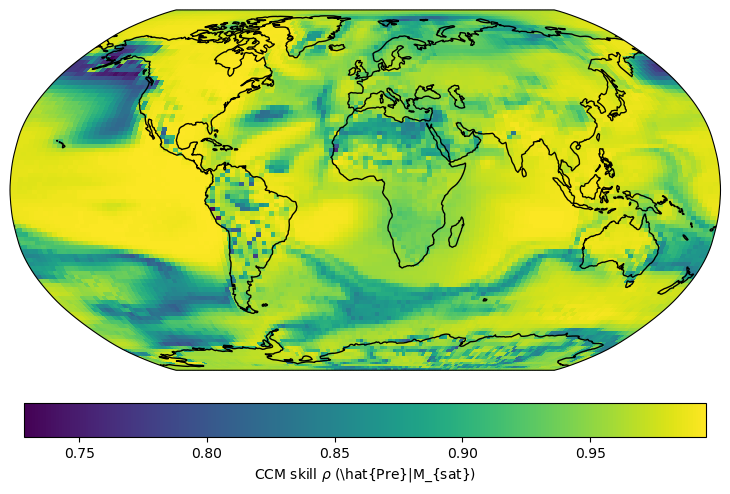

In [3]:
plot_ccm_map(ds_sat=ds_sat, df_pre= df_pre, E=4, tau=3, Tp=0)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

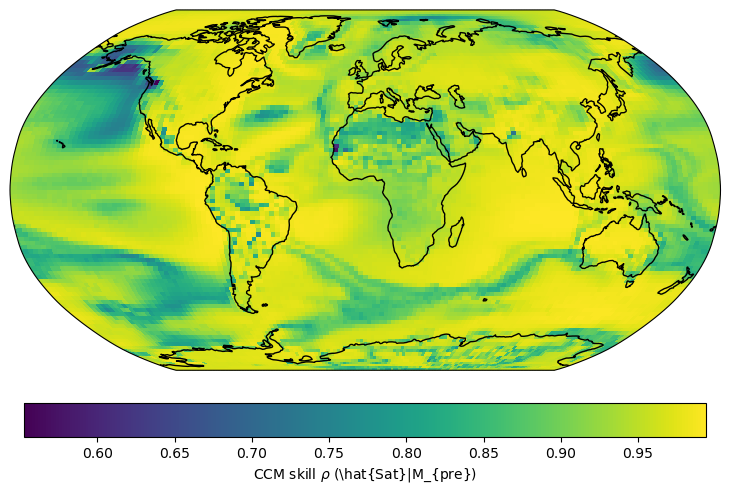

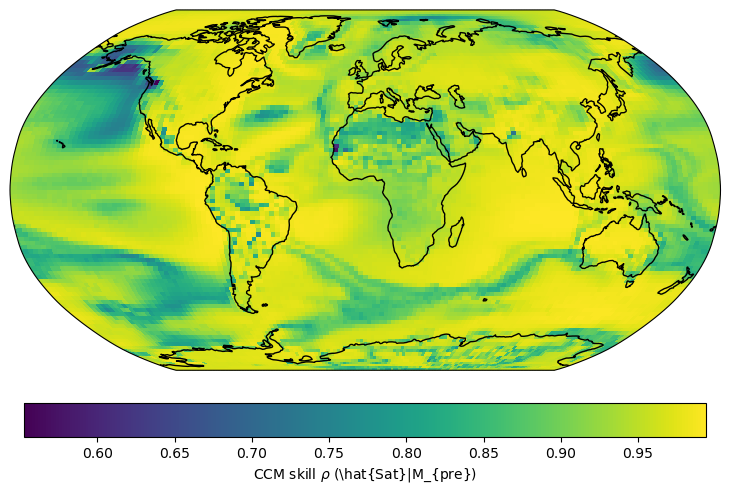

In [8]:
plot_ccm_map(E=4, tau=3, Tp=5)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

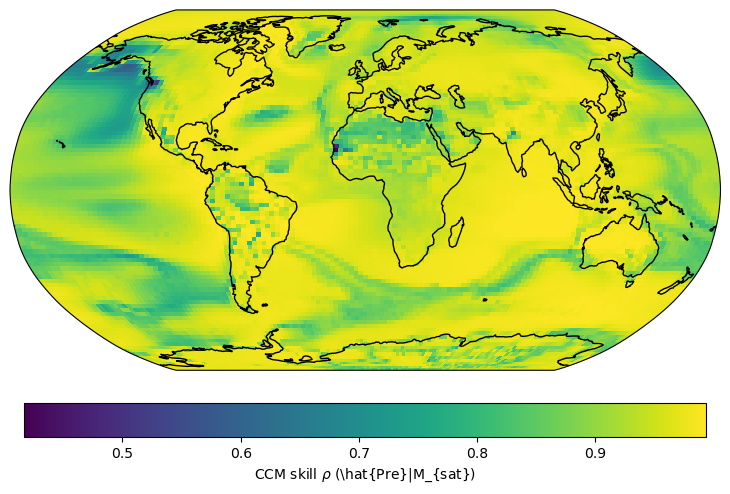

In [12]:
plot_ccm_map(E=4, tau=3, Tp=7)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

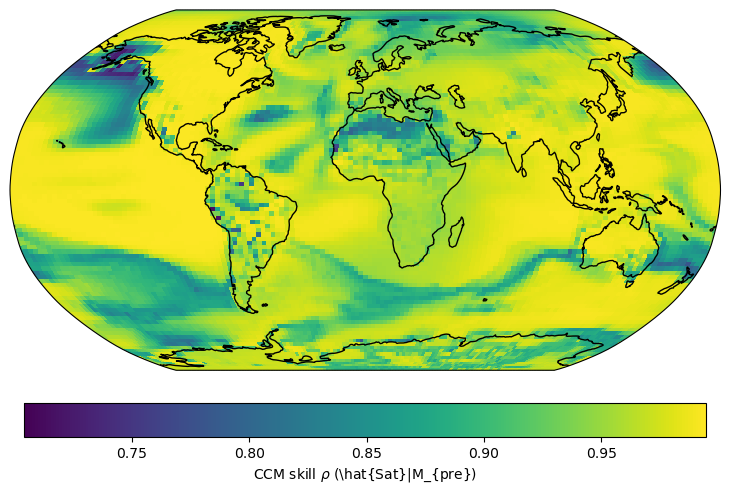

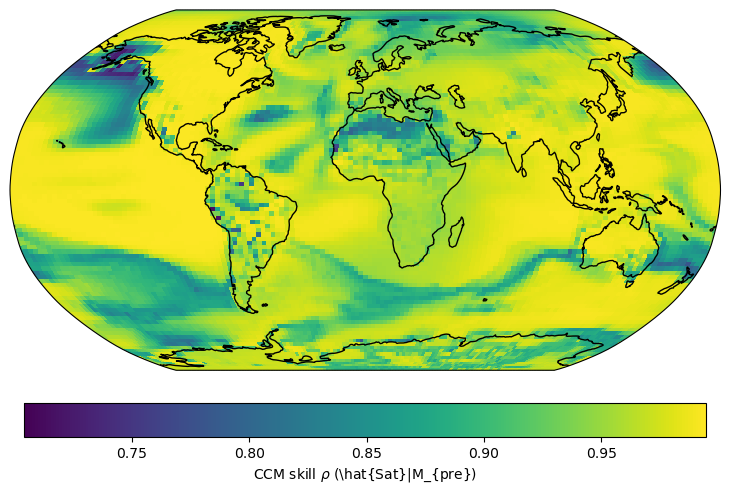

In [9]:
plot_ccm_map(E=3, tau=5, Tp=0)

# Test how Tp that corresponds to max rho distribute

In [4]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pyEDM import CCM
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_optimal_Tp_map(ds_sat, df_pre, E, tau, Tp_min=1, Tp_max=10, 
                          libSizes="10 20 30 40 50 60 70", show_figures=True):
    """
    Loop over all grid points and for each, test Tp values from Tp_min to Tp_max.
    For each grid point, the Tp value that yields the highest CCM skill (Y:X) is stored.
    A global map is then plotted to show the optimal Tp for each grid point.

    Parameters:
        ds_sat      : xarray.Dataset
                      Dataset with mean SAT data (requires variables "sat", "lat", "lon", "age").
        df_pre      : pandas.DataFrame
                      DataFrame with column "pre" and an "age" coordinate.
        E           : int
                      Embedding dimension.
        tau         : int
                      Time delay.
        Tp_min      : int, optional
                      Minimum Tp value to test (default is 1).
        Tp_max      : int, optional
                      Maximum Tp value to test (default is 10).
        libSizes    : str, optional
                      Library sizes for CCM (default is "10 20 30 40 50 60 70").
        show_figures: bool, optional
                      If True, plot the global map (default is True).

    Returns:
        optimum_Tp_map : 2D numpy array (shape: [nlat, nlon]) containing the optimal Tp at each grid point.
    """
    nlat = ds_sat.sizes["lat"]
    nlon = ds_sat.sizes["lon"]
    ages = ds_sat["age"].values
    optimum_Tp_map = np.full((nlat, nlon), np.nan)
    
    # Loop over grid points
    for iLat in range(nlat):
        for iLon in range(nlon):
            # Extract the local SAT time series for this grid point
            sat_ts = ds_sat["sat"].isel(lat=iLat, lon=iLon).values
            # Build temporary DataFrame for CCM (predicting pre from SAT)
            temp_df = pd.DataFrame({
                "Time": ages,
                "X": df_pre["pre"],  # pre series to be predicted
                "Y": sat_ts          # SAT (predictor)
            })
            
            best_rho = -np.inf
            best_Tp = np.nan
            # Loop over Tp values from Tp_min to Tp_max (inclusive)
            for Tp in range(Tp_min, Tp_max+1):
                ccm_out = CCM(
                    dataFrame   = temp_df,
                    E           = E,
                    tau         = tau,
                    columns     = "Y",   # using SAT to build the manifold
                    target      = "X",   # predicting pre
                    libSizes    = libSizes,
                    sample      = 10,
                    random      = True,
                    replacement = False,
                    Tp          = Tp
                )
                # Use the CCM skill at the largest library size
                largest_L = ccm_out["LibSize"].max()
                mask_last = ccm_out["LibSize"] == largest_L
                rho_at_largest = ccm_out.loc[mask_last, "Y:X"].mean()
                
                if rho_at_largest > best_rho:
                    best_rho = rho_at_largest
                    best_Tp = Tp
            
            optimum_Tp_map[iLat, iLon] = best_Tp
            print(f"Grid point (lat idx {iLat}, lon idx {iLon}): Optimal Tp = {best_Tp}, CCM rho = {best_rho}")
    
    # Plot global map of optimal Tp values
    if show_figures:
        lats = ds_sat["lat"].values
        lons = ds_sat["lon"].values
        lon_grid, lat_grid = np.meshgrid(lons, lats)
    
        fig = plt.figure(figsize=(11, 6))
        ax = plt.axes(projection=ccrs.Robinson())
        ax.coastlines()
        # Using "plasma" colormap to represent different Tp values
        pcm = ax.pcolormesh(lon_grid, lat_grid, optimum_Tp_map,
                            transform=ccrs.PlateCarree(), shading="auto", cmap="plasma")
        cb = plt.colorbar(pcm, orientation="horizontal", pad=0.07, shrink=0.8)
        cb.set_label("Optimal Tp (Prediction Horizon)")
        ax.set_title("Global Map of Optimal Tp for Highest CCM Skill")
        plt.show()
    
    return optimum_Tp_map

# Example usage:
# optimum_Tp = plot_optimal_Tp_map(ds_sat=ds_sat, df_pre=df_pre, E=4, tau=3, Tp_min=1, Tp_max=10)


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 0): Optimal Tp = 9, CCM rho = 0.9708770893705185
Grid point (lat idx 0, lon idx 1): Optimal Tp = 10, CCM rho = 0.9723295809102716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 2): Optimal Tp = 10, CCM rho = 0.9720016015949801
Grid point (lat idx 0, lon idx 3): Optimal Tp = 10, CCM rho = 0.971359070631889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 4): Optimal Tp = 10, CCM rho = 0.9719506138163698
Grid point (lat idx 0, lon idx 5): Optimal Tp = 10, CCM rho = 0.974156902546609


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 6): Optimal Tp = 10, CCM rho = 0.9739481146289547
Grid point (lat idx 0, lon idx 7): Optimal Tp = 9, CCM rho = 0.9703463418339897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 8): Optimal Tp = 10, CCM rho = 0.9738573140290091
Grid point (lat idx 0, lon idx 9): Optimal Tp = 10, CCM rho = 0.9721298093208632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 10): Optimal Tp = 10, CCM rho = 0.9723608745443995
Grid point (lat idx 0, lon idx 11): Optimal Tp = 10, CCM rho = 0.9721539963326558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 12): Optimal Tp = 10, CCM rho = 0.9738476660038071
Grid point (lat idx 0, lon idx 13): Optimal Tp = 10, CCM rho = 0.9717165278593074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 14): Optimal Tp = 10, CCM rho = 0.9721522268252425
Grid point (lat idx 0, lon idx 15): Optimal Tp = 10, CCM rho = 0.9741900784149964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 16): Optimal Tp = 10, CCM rho = 0.9723578555347366
Grid point (lat idx 0, lon idx 17): Optimal Tp = 10, CCM rho = 0.9714093938399685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 18): Optimal Tp = 10, CCM rho = 0.9712318002779254
Grid point (lat idx 0, lon idx 19): Optimal Tp = 9, CCM rho = 0.9710875698891606
Grid point (lat idx 0, lon idx 20): Optimal Tp = 10, CCM rho = 0.9726187120293842
Grid point (lat idx 0, lon idx 21): Optimal Tp = 10, CCM rho = 0.9722870970791397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 22): Optimal Tp = 10, CCM rho = 0.9717774498518116
Grid point (lat idx 0, lon idx 23): Optimal Tp = 10, CCM rho = 0.9726331848920022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 24): Optimal Tp = 10, CCM rho = 0.9726993131489046
Grid point (lat idx 0, lon idx 25): Optimal Tp = 10, CCM rho = 0.974065109527886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 26): Optimal Tp = 10, CCM rho = 0.9716496758785148
Grid point (lat idx 0, lon idx 27): Optimal Tp = 10, CCM rho = 0.9740052739560827


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 28): Optimal Tp = 10, CCM rho = 0.97385979975984
Grid point (lat idx 0, lon idx 29): Optimal Tp = 10, CCM rho = 0.9717175690695861
Grid point (lat idx 0, lon idx 30): Optimal Tp = 10, CCM rho = 0.9715488582848048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 31): Optimal Tp = 10, CCM rho = 0.9735836144154512
Grid point (lat idx 0, lon idx 32): Optimal Tp = 10, CCM rho = 0.971241273289345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 33): Optimal Tp = 10, CCM rho = 0.9742099629254009
Grid point (lat idx 0, lon idx 34): Optimal Tp = 10, CCM rho = 0.9708523382030421


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 35): Optimal Tp = 10, CCM rho = 0.9727962524138531
Grid point (lat idx 0, lon idx 36): Optimal Tp = 10, CCM rho = 0.9737729038387286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 37): Optimal Tp = 10, CCM rho = 0.9733428683550974
Grid point (lat idx 0, lon idx 38): Optimal Tp = 10, CCM rho = 0.970866442996634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 39): Optimal Tp = 10, CCM rho = 0.9728058723561753
Grid point (lat idx 0, lon idx 40): Optimal Tp = 10, CCM rho = 0.9724484289844479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 41): Optimal Tp = 10, CCM rho = 0.9723647277983609
Grid point (lat idx 0, lon idx 42): Optimal Tp = 10, CCM rho = 0.9717924839331268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 43): Optimal Tp = 10, CCM rho = 0.9713509372427357
Grid point (lat idx 0, lon idx 44): Optimal Tp = 10, CCM rho = 0.9708982841447309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 45): Optimal Tp = 10, CCM rho = 0.9717327198615582
Grid point (lat idx 0, lon idx 46): Optimal Tp = 10, CCM rho = 0.9720065546737959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 47): Optimal Tp = 9, CCM rho = 0.9717509974366516
Grid point (lat idx 0, lon idx 48): Optimal Tp = 10, CCM rho = 0.9717795458799043


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 49): Optimal Tp = 10, CCM rho = 0.9723023934386618
Grid point (lat idx 0, lon idx 50): Optimal Tp = 10, CCM rho = 0.9741821500626561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 51): Optimal Tp = 10, CCM rho = 0.9704102474533363
Grid point (lat idx 0, lon idx 52): Optimal Tp = 10, CCM rho = 0.9711629046976045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 53): Optimal Tp = 10, CCM rho = 0.9717519049070649
Grid point (lat idx 0, lon idx 54): Optimal Tp = 10, CCM rho = 0.9721674577925867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 55): Optimal Tp = 10, CCM rho = 0.9742554241449689
Grid point (lat idx 0, lon idx 56): Optimal Tp = 10, CCM rho = 0.971804902401001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 57): Optimal Tp = 10, CCM rho = 0.9703916151068528
Grid point (lat idx 0, lon idx 58): Optimal Tp = 10, CCM rho = 0.9750716606448121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 59): Optimal Tp = 10, CCM rho = 0.9742560494006266
Grid point (lat idx 0, lon idx 60): Optimal Tp = 10, CCM rho = 0.9720841818470596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 61): Optimal Tp = 10, CCM rho = 0.9721466050954366
Grid point (lat idx 0, lon idx 62): Optimal Tp = 10, CCM rho = 0.9719776317310054


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 63): Optimal Tp = 10, CCM rho = 0.9720099094619687
Grid point (lat idx 0, lon idx 64): Optimal Tp = 10, CCM rho = 0.9722297318659094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 65): Optimal Tp = 10, CCM rho = 0.9727041417235466
Grid point (lat idx 0, lon idx 66): Optimal Tp = 10, CCM rho = 0.9717284093413694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 67): Optimal Tp = 10, CCM rho = 0.9724404270838376
Grid point (lat idx 0, lon idx 68): Optimal Tp = 10, CCM rho = 0.971811899616756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 69): Optimal Tp = 10, CCM rho = 0.9739921635838675
Grid point (lat idx 0, lon idx 70): Optimal Tp = 10, CCM rho = 0.9706575233091435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 71): Optimal Tp = 10, CCM rho = 0.9743463729501348
Grid point (lat idx 0, lon idx 72): Optimal Tp = 10, CCM rho = 0.9718346306778438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 73): Optimal Tp = 10, CCM rho = 0.9726454884915675
Grid point (lat idx 0, lon idx 74): Optimal Tp = 10, CCM rho = 0.9737230415092265
Grid point (lat idx 0, lon idx 75): Optimal Tp = 10, CCM rho = 0.9720374036719461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 76): Optimal Tp = 10, CCM rho = 0.9726683130799454
Grid point (lat idx 0, lon idx 77): Optimal Tp = 10, CCM rho = 0.9708090299093397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 78): Optimal Tp = 10, CCM rho = 0.9707907798457013
Grid point (lat idx 0, lon idx 79): Optimal Tp = 10, CCM rho = 0.9723285246040035


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 80): Optimal Tp = 10, CCM rho = 0.9716823111145632
Grid point (lat idx 0, lon idx 81): Optimal Tp = 10, CCM rho = 0.9747996126915124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 82): Optimal Tp = 10, CCM rho = 0.9713175053653991
Grid point (lat idx 0, lon idx 83): Optimal Tp = 10, CCM rho = 0.97312367938737
Grid point (lat idx 0, lon idx 84): Optimal Tp = 10, CCM rho = 0.971706137198543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 85): Optimal Tp = 10, CCM rho = 0.9721120486569245
Grid point (lat idx 0, lon idx 86): Optimal Tp = 10, CCM rho = 0.9720309750477117
Grid point (lat idx 0, lon idx 87): Optimal Tp = 10, CCM rho = 0.9717787457180016
Grid point (lat idx 0, lon idx 88): Optimal Tp = 10, CCM rho = 0.9721166480118935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 0, lon idx 89): Optimal Tp = 10, CCM rho = 0.9722731615850954
Grid point (lat idx 0, lon idx 90): Optimal Tp = 10, CCM rho = 0.9717716776507672
Grid point (lat idx 0, lon idx 91): Optimal Tp = 10, CCM rho = 0.9725920906655539
Grid point (lat idx 0, lon idx 92): Optimal Tp = 9, CCM rho = 0.9718783274457741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 93): Optimal Tp = 10, CCM rho = 0.9725647171695329
Grid point (lat idx 0, lon idx 94): Optimal Tp = 10, CCM rho = 0.9717737154780697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 95): Optimal Tp = 10, CCM rho = 0.9719514273020847
Grid point (lat idx 0, lon idx 96): Optimal Tp = 10, CCM rho = 0.9741451548291232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 97): Optimal Tp = 10, CCM rho = 0.9724202147922961
Grid point (lat idx 0, lon idx 98): Optimal Tp = 10, CCM rho = 0.9718987619873947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 99): Optimal Tp = 10, CCM rho = 0.9742662270322073
Grid point (lat idx 0, lon idx 100): Optimal Tp = 10, CCM rho = 0.9712079082180425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 101): Optimal Tp = 10, CCM rho = 0.9729102932061208
Grid point (lat idx 0, lon idx 102): Optimal Tp = 10, CCM rho = 0.9739825594080471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 103): Optimal Tp = 10, CCM rho = 0.970984713046105
Grid point (lat idx 0, lon idx 104): Optimal Tp = 10, CCM rho = 0.9738232469477032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 105): Optimal Tp = 10, CCM rho = 0.9720202305590483
Grid point (lat idx 0, lon idx 106): Optimal Tp = 10, CCM rho = 0.9743578345446158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 107): Optimal Tp = 10, CCM rho = 0.9730358443648935
Grid point (lat idx 0, lon idx 108): Optimal Tp = 10, CCM rho = 0.971445674726817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 109): Optimal Tp = 10, CCM rho = 0.9716632173242885
Grid point (lat idx 0, lon idx 110): Optimal Tp = 10, CCM rho = 0.973448124607567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 111): Optimal Tp = 10, CCM rho = 0.970959246733333
Grid point (lat idx 0, lon idx 112): Optimal Tp = 10, CCM rho = 0.9721556303641739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 113): Optimal Tp = 9, CCM rho = 0.9713883206844175
Grid point (lat idx 0, lon idx 114): Optimal Tp = 10, CCM rho = 0.9719103928050217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 115): Optimal Tp = 10, CCM rho = 0.9738210040093997
Grid point (lat idx 0, lon idx 116): Optimal Tp = 10, CCM rho = 0.971307755680186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 117): Optimal Tp = 10, CCM rho = 0.9720247988346667
Grid point (lat idx 0, lon idx 118): Optimal Tp = 10, CCM rho = 0.9733129340312591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 119): Optimal Tp = 10, CCM rho = 0.9721695061646388
Grid point (lat idx 0, lon idx 120): Optimal Tp = 10, CCM rho = 0.9710074155315581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 121): Optimal Tp = 10, CCM rho = 0.9716263676874746
Grid point (lat idx 0, lon idx 122): Optimal Tp = 9, CCM rho = 0.9720567142884864


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 123): Optimal Tp = 10, CCM rho = 0.9717283812006885
Grid point (lat idx 0, lon idx 124): Optimal Tp = 10, CCM rho = 0.9742923688297148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 125): Optimal Tp = 10, CCM rho = 0.972099147843215
Grid point (lat idx 0, lon idx 126): Optimal Tp = 10, CCM rho = 0.9729139027239352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 127): Optimal Tp = 10, CCM rho = 0.9725388653999236
Grid point (lat idx 0, lon idx 128): Optimal Tp = 10, CCM rho = 0.972303398071704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 129): Optimal Tp = 10, CCM rho = 0.9751217404205874
Grid point (lat idx 0, lon idx 130): Optimal Tp = 10, CCM rho = 0.9705530495614907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 131): Optimal Tp = 10, CCM rho = 0.9739659915526053
Grid point (lat idx 0, lon idx 132): Optimal Tp = 10, CCM rho = 0.9711369594923461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 133): Optimal Tp = 10, CCM rho = 0.9720071058144821
Grid point (lat idx 0, lon idx 134): Optimal Tp = 10, CCM rho = 0.972354132997441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 135): Optimal Tp = 10, CCM rho = 0.9725358738378794
Grid point (lat idx 0, lon idx 136): Optimal Tp = 10, CCM rho = 0.971220186809191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 137): Optimal Tp = 10, CCM rho = 0.9723147092975621
Grid point (lat idx 0, lon idx 138): Optimal Tp = 10, CCM rho = 0.9703120313249226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 139): Optimal Tp = 10, CCM rho = 0.9728174188421231
Grid point (lat idx 0, lon idx 140): Optimal Tp = 10, CCM rho = 0.974674339625496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 141): Optimal Tp = 10, CCM rho = 0.9720081343766711
Grid point (lat idx 0, lon idx 142): Optimal Tp = 10, CCM rho = 0.9712586524342649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 0, lon idx 143): Optimal Tp = 10, CCM rho = 0.9731443928249496
Grid point (lat idx 1, lon idx 0): Optimal Tp = 10, CCM rho = 0.8619246894679191
Grid point (lat idx 1, lon idx 1): Optimal Tp = 10, CCM rho = 0.8571356467992637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 2): Optimal Tp = 9, CCM rho = 0.8667253319477141
Grid point (lat idx 1, lon idx 3): Optimal Tp = 9, CCM rho = 0.8442133480001015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 4): Optimal Tp = 9, CCM rho = 0.8434680584713531
Grid point (lat idx 1, lon idx 5): Optimal Tp = 1, CCM rho = 0.8919015526624768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 6): Optimal Tp = 10, CCM rho = 0.8502878920162338
Grid point (lat idx 1, lon idx 7): Optimal Tp = 10, CCM rho = 0.8621346732454456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 8): Optimal Tp = 10, CCM rho = 0.8382270982161545
Grid point (lat idx 1, lon idx 9): Optimal Tp = 9, CCM rho = 0.819006486542843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 10): Optimal Tp = 2, CCM rho = 0.9084251895981674
Grid point (lat idx 1, lon idx 11): Optimal Tp = 10, CCM rho = 0.8513285872907748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 12): Optimal Tp = 10, CCM rho = 0.8470670764556092
Grid point (lat idx 1, lon idx 13): Optimal Tp = 1, CCM rho = 0.8928635803605394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 14): Optimal Tp = 10, CCM rho = 0.8581392893383036
Grid point (lat idx 1, lon idx 15): Optimal Tp = 10, CCM rho = 0.8461913422729346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 16): Optimal Tp = 10, CCM rho = 0.86811470403199
Grid point (lat idx 1, lon idx 17): Optimal Tp = 10, CCM rho = 0.8655616371488193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 18): Optimal Tp = 10, CCM rho = 0.8584068131692053
Grid point (lat idx 1, lon idx 19): Optimal Tp = 10, CCM rho = 0.8530902434591591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 20): Optimal Tp = 10, CCM rho = 0.8447721749461934
Grid point (lat idx 1, lon idx 21): Optimal Tp = 10, CCM rho = 0.8704726034417668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 22): Optimal Tp = 10, CCM rho = 0.8736792064249329
Grid point (lat idx 1, lon idx 23): Optimal Tp = 10, CCM rho = 0.9011562609393394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 24): Optimal Tp = 10, CCM rho = 0.8699188425588437
Grid point (lat idx 1, lon idx 25): Optimal Tp = 10, CCM rho = 0.8706126564556353


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 26): Optimal Tp = 10, CCM rho = 0.8677214922563982
Grid point (lat idx 1, lon idx 27): Optimal Tp = 10, CCM rho = 0.88332248713622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 28): Optimal Tp = 10, CCM rho = 0.8755060340582682
Grid point (lat idx 1, lon idx 29): Optimal Tp = 10, CCM rho = 0.9243045824150575


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 30): Optimal Tp = 9, CCM rho = 0.9104109389965741
Grid point (lat idx 1, lon idx 31): Optimal Tp = 10, CCM rho = 0.8822503042977697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 32): Optimal Tp = 10, CCM rho = 0.9588857903626776
Grid point (lat idx 1, lon idx 33): Optimal Tp = 9, CCM rho = 0.9297003266655457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 34): Optimal Tp = 9, CCM rho = 0.9201102546688589
Grid point (lat idx 1, lon idx 35): Optimal Tp = 10, CCM rho = 0.9563554187912569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 36): Optimal Tp = 8, CCM rho = 0.9489062182683922
Grid point (lat idx 1, lon idx 37): Optimal Tp = 10, CCM rho = 0.9545480623000466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 38): Optimal Tp = 10, CCM rho = 0.9354410663840829
Grid point (lat idx 1, lon idx 39): Optimal Tp = 9, CCM rho = 0.9514649795227615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 40): Optimal Tp = 10, CCM rho = 0.9391030591705615
Grid point (lat idx 1, lon idx 41): Optimal Tp = 10, CCM rho = 0.9561101289703092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 42): Optimal Tp = 10, CCM rho = 0.9567181120503807
Grid point (lat idx 1, lon idx 43): Optimal Tp = 10, CCM rho = 0.9611928621748657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 44): Optimal Tp = 9, CCM rho = 0.9491440225278962
Grid point (lat idx 1, lon idx 45): Optimal Tp = 10, CCM rho = 0.9624437235810438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 46): Optimal Tp = 9, CCM rho = 0.9566886997380308
Grid point (lat idx 1, lon idx 47): Optimal Tp = 10, CCM rho = 0.947867815376419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 48): Optimal Tp = 10, CCM rho = 0.9592090806477607
Grid point (lat idx 1, lon idx 49): Optimal Tp = 10, CCM rho = 0.9579953131365866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 50): Optimal Tp = 10, CCM rho = 0.9355986187340187
Grid point (lat idx 1, lon idx 51): Optimal Tp = 10, CCM rho = 0.9623426270838726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 52): Optimal Tp = 10, CCM rho = 0.9595077003003037
Grid point (lat idx 1, lon idx 53): Optimal Tp = 10, CCM rho = 0.9624880763736066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 54): Optimal Tp = 10, CCM rho = 0.9658517774129114
Grid point (lat idx 1, lon idx 55): Optimal Tp = 10, CCM rho = 0.9658505443591207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 56): Optimal Tp = 10, CCM rho = 0.9657020699439892
Grid point (lat idx 1, lon idx 57): Optimal Tp = 10, CCM rho = 0.9662440039138506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 58): Optimal Tp = 10, CCM rho = 0.9650595199672489
Grid point (lat idx 1, lon idx 59): Optimal Tp = 10, CCM rho = 0.9680074869817104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 60): Optimal Tp = 10, CCM rho = 0.9695398587977154
Grid point (lat idx 1, lon idx 61): Optimal Tp = 10, CCM rho = 0.9703060717966785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 62): Optimal Tp = 10, CCM rho = 0.9760661599373164
Grid point (lat idx 1, lon idx 63): Optimal Tp = 10, CCM rho = 0.973893893950121
Grid point (lat idx 1, lon idx 64): Optimal Tp = 10, CCM rho = 0.9778216240844287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 65): Optimal Tp = 10, CCM rho = 0.975423735485978
Grid point (lat idx 1, lon idx 66): Optimal Tp = 10, CCM rho = 0.9755596122850093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 67): Optimal Tp = 10, CCM rho = 0.9785279103951714
Grid point (lat idx 1, lon idx 68): Optimal Tp = 10, CCM rho = 0.9801644811788824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 69): Optimal Tp = 10, CCM rho = 0.978787081420448
Grid point (lat idx 1, lon idx 70): Optimal Tp = 10, CCM rho = 0.9783411623819587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 71): Optimal Tp = 10, CCM rho = 0.9763236243868028
Grid point (lat idx 1, lon idx 72): Optimal Tp = 10, CCM rho = 0.9780422919140188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 73): Optimal Tp = 10, CCM rho = 0.9798559027978182
Grid point (lat idx 1, lon idx 74): Optimal Tp = 10, CCM rho = 0.9800467316627719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 75): Optimal Tp = 10, CCM rho = 0.9804372047839962
Grid point (lat idx 1, lon idx 76): Optimal Tp = 10, CCM rho = 0.9806111070435669
Grid point (lat idx 1, lon idx 77): Optimal Tp = 10, CCM rho = 0.9809356586136119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 78): Optimal Tp = 10, CCM rho = 0.9799407014080039
Grid point (lat idx 1, lon idx 79): Optimal Tp = 10, CCM rho = 0.9815541258317848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 80): Optimal Tp = 10, CCM rho = 0.980016702282866
Grid point (lat idx 1, lon idx 81): Optimal Tp = 10, CCM rho = 0.981064675969425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 82): Optimal Tp = 10, CCM rho = 0.9798024718957299
Grid point (lat idx 1, lon idx 83): Optimal Tp = 10, CCM rho = 0.9808945235527761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 84): Optimal Tp = 10, CCM rho = 0.9822063670582866
Grid point (lat idx 1, lon idx 85): Optimal Tp = 10, CCM rho = 0.9810268945620745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 86): Optimal Tp = 10, CCM rho = 0.9822722525355733
Grid point (lat idx 1, lon idx 87): Optimal Tp = 10, CCM rho = 0.9822704986995203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 88): Optimal Tp = 10, CCM rho = 0.9810682096541166
Grid point (lat idx 1, lon idx 89): Optimal Tp = 10, CCM rho = 0.9824007374212499


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 90): Optimal Tp = 10, CCM rho = 0.9834035164704888
Grid point (lat idx 1, lon idx 91): Optimal Tp = 10, CCM rho = 0.9819450358542785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 92): Optimal Tp = 10, CCM rho = 0.9816975110737861
Grid point (lat idx 1, lon idx 93): Optimal Tp = 10, CCM rho = 0.9833022137092244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 94): Optimal Tp = 10, CCM rho = 0.982016154071415
Grid point (lat idx 1, lon idx 95): Optimal Tp = 10, CCM rho = 0.9831302621261526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 96): Optimal Tp = 10, CCM rho = 0.9820434818294155
Grid point (lat idx 1, lon idx 97): Optimal Tp = 10, CCM rho = 0.9818324279076878


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 98): Optimal Tp = 10, CCM rho = 0.9821420367797516
Grid point (lat idx 1, lon idx 99): Optimal Tp = 10, CCM rho = 0.9819786097111498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 100): Optimal Tp = 10, CCM rho = 0.981769663915089
Grid point (lat idx 1, lon idx 101): Optimal Tp = 10, CCM rho = 0.9834038739317895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 102): Optimal Tp = 10, CCM rho = 0.9819298531038878
Grid point (lat idx 1, lon idx 103): Optimal Tp = 10, CCM rho = 0.9828448448953742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 104): Optimal Tp = 10, CCM rho = 0.9817437394443269
Grid point (lat idx 1, lon idx 105): Optimal Tp = 10, CCM rho = 0.9810476744641248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 106): Optimal Tp = 10, CCM rho = 0.9834301961942404
Grid point (lat idx 1, lon idx 107): Optimal Tp = 10, CCM rho = 0.9816605833909131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 108): Optimal Tp = 10, CCM rho = 0.9793670684597442
Grid point (lat idx 1, lon idx 109): Optimal Tp = 10, CCM rho = 0.9816312579307954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 110): Optimal Tp = 10, CCM rho = 0.9816156592958076
Grid point (lat idx 1, lon idx 111): Optimal Tp = 10, CCM rho = 0.981294516748099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 112): Optimal Tp = 9, CCM rho = 0.9799555004645374
Grid point (lat idx 1, lon idx 113): Optimal Tp = 10, CCM rho = 0.9811381625276578
Grid point (lat idx 1, lon idx 114): Optimal Tp = 10, CCM rho = 0.9794089283608504
Grid point (lat idx 1, lon idx 115): Optimal Tp = 10, CCM rho = 0.9785720557316206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 116): Optimal Tp = 10, CCM rho = 0.9788771938250159
Grid point (lat idx 1, lon idx 117): Optimal Tp = 10, CCM rho = 0.9780145966131467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 118): Optimal Tp = 10, CCM rho = 0.9791047139353491
Grid point (lat idx 1, lon idx 119): Optimal Tp = 10, CCM rho = 0.9784522998472444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 120): Optimal Tp = 10, CCM rho = 0.9766131552254131
Grid point (lat idx 1, lon idx 121): Optimal Tp = 10, CCM rho = 0.9761937701338546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 122): Optimal Tp = 10, CCM rho = 0.9763939672216286
Grid point (lat idx 1, lon idx 123): Optimal Tp = 10, CCM rho = 0.9777737529575875


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 124): Optimal Tp = 10, CCM rho = 0.972916120379477
Grid point (lat idx 1, lon idx 125): Optimal Tp = 10, CCM rho = 0.9687908974670861
Grid point (lat idx 1, lon idx 126): Optimal Tp = 10, CCM rho = 0.9674411562600984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 127): Optimal Tp = 10, CCM rho = 0.9678488875520734
Grid point (lat idx 1, lon idx 128): Optimal Tp = 10, CCM rho = 0.9607162491498775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 129): Optimal Tp = 10, CCM rho = 0.9522730133885894
Grid point (lat idx 1, lon idx 130): Optimal Tp = 10, CCM rho = 0.9206740454093015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 131): Optimal Tp = 10, CCM rho = 0.9330837161270258
Grid point (lat idx 1, lon idx 132): Optimal Tp = 10, CCM rho = 0.9136433748545745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 133): Optimal Tp = 10, CCM rho = 0.8694885682133581
Grid point (lat idx 1, lon idx 134): Optimal Tp = 10, CCM rho = 0.8670619039406932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 135): Optimal Tp = 10, CCM rho = 0.8543548797796273
Grid point (lat idx 1, lon idx 136): Optimal Tp = 10, CCM rho = 0.8570347711532665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 137): Optimal Tp = 10, CCM rho = 0.8558165577700455
Grid point (lat idx 1, lon idx 138): Optimal Tp = 10, CCM rho = 0.8547519171385467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 139): Optimal Tp = 10, CCM rho = 0.8451850026208865
Grid point (lat idx 1, lon idx 140): Optimal Tp = 10, CCM rho = 0.8547159810424283
Grid point (lat idx 1, lon idx 141): Optimal Tp = 9, CCM rho = 0.863493668295394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 1, lon idx 142): Optimal Tp = 10, CCM rho = 0.8560230778294964
Grid point (lat idx 1, lon idx 143): Optimal Tp = 10, CCM rho = 0.8508445899831993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 0): Optimal Tp = 1, CCM rho = 0.8933088071251181
Grid point (lat idx 2, lon idx 1): Optimal Tp = 1, CCM rho = 0.8731640531827514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 2): Optimal Tp = 1, CCM rho = 0.9035794081466733
Grid point (lat idx 2, lon idx 3): Optimal Tp = 1, CCM rho = 0.8971300714019665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 4): Optimal Tp = 2, CCM rho = 0.8868312040152407
Grid point (lat idx 2, lon idx 5): Optimal Tp = 10, CCM rho = 0.8726153022630205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 6): Optimal Tp = 10, CCM rho = 0.8743093514745176
Grid point (lat idx 2, lon idx 7): Optimal Tp = 10, CCM rho = 0.8636666256165668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 8): Optimal Tp = 10, CCM rho = 0.8656278160506886
Grid point (lat idx 2, lon idx 9): Optimal Tp = 10, CCM rho = 0.870285822639123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 10): Optimal Tp = 1, CCM rho = 0.8833554929142092
Grid point (lat idx 2, lon idx 11): Optimal Tp = 1, CCM rho = 0.8788911167736483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 12): Optimal Tp = 1, CCM rho = 0.893606628445419
Grid point (lat idx 2, lon idx 13): Optimal Tp = 1, CCM rho = 0.8786609837789314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 14): Optimal Tp = 1, CCM rho = 0.9154193509622646
Grid point (lat idx 2, lon idx 15): Optimal Tp = 1, CCM rho = 0.8914924204058805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 16): Optimal Tp = 1, CCM rho = 0.9309410494664387
Grid point (lat idx 2, lon idx 17): Optimal Tp = 1, CCM rho = 0.9435043731772087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 18): Optimal Tp = 1, CCM rho = 0.9308127170750276
Grid point (lat idx 2, lon idx 19): Optimal Tp = 1, CCM rho = 0.9466642666640845
Grid point (lat idx 2, lon idx 20): Optimal Tp = 1, CCM rho = 0.8978000554288492
Grid point (lat idx 2, lon idx 21): Optimal Tp = 9, CCM rho = 0.9711564370475019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 22): Optimal Tp = 9, CCM rho = 0.9748235386058482
Grid point (lat idx 2, lon idx 23): Optimal Tp = 9, CCM rho = 0.9708102972644921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 24): Optimal Tp = 1, CCM rho = 0.9377956085488828
Grid point (lat idx 2, lon idx 25): Optimal Tp = 1, CCM rho = 0.9328181452809421


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 26): Optimal Tp = 1, CCM rho = 0.9444524399772385
Grid point (lat idx 2, lon idx 27): Optimal Tp = 1, CCM rho = 0.9427107954121567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 28): Optimal Tp = 1, CCM rho = 0.9216214965310474
Grid point (lat idx 2, lon idx 29): Optimal Tp = 1, CCM rho = 0.8901099196101392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 30): Optimal Tp = 1, CCM rho = 0.9298083674072984
Grid point (lat idx 2, lon idx 31): Optimal Tp = 1, CCM rho = 0.900360965785884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 32): Optimal Tp = 1, CCM rho = 0.9373576430300679
Grid point (lat idx 2, lon idx 33): Optimal Tp = 1, CCM rho = 0.9075018229530359


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 34): Optimal Tp = 9, CCM rho = 0.8397323526545947
Grid point (lat idx 2, lon idx 35): Optimal Tp = 10, CCM rho = 0.873701371509816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 36): Optimal Tp = 10, CCM rho = 0.8455089436294004
Grid point (lat idx 2, lon idx 37): Optimal Tp = 10, CCM rho = 0.8687769608802529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 38): Optimal Tp = 9, CCM rho = 0.8543631283952035
Grid point (lat idx 2, lon idx 39): Optimal Tp = 9, CCM rho = 0.8589073087514514
Grid point (lat idx 2, lon idx 40): Optimal Tp = 10, CCM rho = 0.928622019494014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 41): Optimal Tp = 10, CCM rho = 0.8743132472994531
Grid point (lat idx 2, lon idx 42): Optimal Tp = 10, CCM rho = 0.9374566341094093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 43): Optimal Tp = 9, CCM rho = 0.9260906365699249
Grid point (lat idx 2, lon idx 44): Optimal Tp = 10, CCM rho = 0.9068746042837524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 45): Optimal Tp = 10, CCM rho = 0.9566264329474989
Grid point (lat idx 2, lon idx 46): Optimal Tp = 8, CCM rho = 0.9296228154846465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 47): Optimal Tp = 10, CCM rho = 0.9281219019069873
Grid point (lat idx 2, lon idx 48): Optimal Tp = 10, CCM rho = 0.8924486387506179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 49): Optimal Tp = 10, CCM rho = 0.926399717995588
Grid point (lat idx 2, lon idx 50): Optimal Tp = 10, CCM rho = 0.9324317063285095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 51): Optimal Tp = 10, CCM rho = 0.9181955595758279
Grid point (lat idx 2, lon idx 52): Optimal Tp = 10, CCM rho = 0.8888804041101983
Grid point (lat idx 2, lon idx 53): Optimal Tp = 10, CCM rho = 0.8975286873709105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 54): Optimal Tp = 9, CCM rho = 0.8444014751894084
Grid point (lat idx 2, lon idx 55): Optimal Tp = 9, CCM rho = 0.8494445770883494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 56): Optimal Tp = 10, CCM rho = 0.8857342144516227
Grid point (lat idx 2, lon idx 57): Optimal Tp = 10, CCM rho = 0.8701787365615694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 58): Optimal Tp = 10, CCM rho = 0.8845613634732092
Grid point (lat idx 2, lon idx 59): Optimal Tp = 10, CCM rho = 0.9334007112767096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 60): Optimal Tp = 8, CCM rho = 0.9580256759636961
Grid point (lat idx 2, lon idx 61): Optimal Tp = 10, CCM rho = 0.9703893798914333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 62): Optimal Tp = 10, CCM rho = 0.9718380006367575
Grid point (lat idx 2, lon idx 63): Optimal Tp = 10, CCM rho = 0.968788008869868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 64): Optimal Tp = 10, CCM rho = 0.9787008203522533
Grid point (lat idx 2, lon idx 65): Optimal Tp = 10, CCM rho = 0.9808418098250036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 66): Optimal Tp = 10, CCM rho = 0.9791995835172023
Grid point (lat idx 2, lon idx 67): Optimal Tp = 10, CCM rho = 0.9801132810139377


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 68): Optimal Tp = 10, CCM rho = 0.9718625812410917
Grid point (lat idx 2, lon idx 69): Optimal Tp = 10, CCM rho = 0.9730783243881165
Grid point (lat idx 2, lon idx 70): Optimal Tp = 10, CCM rho = 0.9688919812594932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 71): Optimal Tp = 10, CCM rho = 0.9634051277043019
Grid point (lat idx 2, lon idx 72): Optimal Tp = 10, CCM rho = 0.9647409223477466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 73): Optimal Tp = 10, CCM rho = 0.9748320152412792
Grid point (lat idx 2, lon idx 74): Optimal Tp = 10, CCM rho = 0.9792658245120004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 75): Optimal Tp = 10, CCM rho = 0.9795545318926264
Grid point (lat idx 2, lon idx 76): Optimal Tp = 10, CCM rho = 0.9818233311238036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 77): Optimal Tp = 10, CCM rho = 0.9824373792802186
Grid point (lat idx 2, lon idx 78): Optimal Tp = 10, CCM rho = 0.9843507131105327
Grid point (lat idx 2, lon idx 79): Optimal Tp = 10, CCM rho = 0.983340754320705
Grid point (lat idx 2, lon idx 80): Optimal Tp = 10, CCM rho = 0.9842511753702299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 81): Optimal Tp = 10, CCM rho = 0.9842084941883906
Grid point (lat idx 2, lon idx 82): Optimal Tp = 10, CCM rho = 0.9830448632685203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 83): Optimal Tp = 10, CCM rho = 0.9822563165788178
Grid point (lat idx 2, lon idx 84): Optimal Tp = 10, CCM rho = 0.9815507673227517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 85): Optimal Tp = 10, CCM rho = 0.9810708808410012
Grid point (lat idx 2, lon idx 86): Optimal Tp = 10, CCM rho = 0.980835691916969


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 87): Optimal Tp = 10, CCM rho = 0.9822023265177042
Grid point (lat idx 2, lon idx 88): Optimal Tp = 10, CCM rho = 0.9801700494259471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 89): Optimal Tp = 10, CCM rho = 0.9803363825476467
Grid point (lat idx 2, lon idx 90): Optimal Tp = 10, CCM rho = 0.9800553145558825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 91): Optimal Tp = 10, CCM rho = 0.9811722435026153
Grid point (lat idx 2, lon idx 92): Optimal Tp = 10, CCM rho = 0.9793868305674934
Grid point (lat idx 2, lon idx 93): Optimal Tp = 10, CCM rho = 0.9814576300245161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 94): Optimal Tp = 10, CCM rho = 0.9791859079252301
Grid point (lat idx 2, lon idx 95): Optimal Tp = 10, CCM rho = 0.979893476240217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 96): Optimal Tp = 10, CCM rho = 0.9830816995431766
Grid point (lat idx 2, lon idx 97): Optimal Tp = 10, CCM rho = 0.9804933959126096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 98): Optimal Tp = 10, CCM rho = 0.9834885644627966
Grid point (lat idx 2, lon idx 99): Optimal Tp = 10, CCM rho = 0.9817190426870008


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 100): Optimal Tp = 10, CCM rho = 0.9829434112599846
Grid point (lat idx 2, lon idx 101): Optimal Tp = 10, CCM rho = 0.982332413983958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 102): Optimal Tp = 10, CCM rho = 0.9819331526443298
Grid point (lat idx 2, lon idx 103): Optimal Tp = 10, CCM rho = 0.9818951091016871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 104): Optimal Tp = 10, CCM rho = 0.9815751008668923
Grid point (lat idx 2, lon idx 105): Optimal Tp = 10, CCM rho = 0.9816295600441268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 106): Optimal Tp = 10, CCM rho = 0.9832273314161141
Grid point (lat idx 2, lon idx 107): Optimal Tp = 10, CCM rho = 0.9813035114622316


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 108): Optimal Tp = 10, CCM rho = 0.9811626823643215
Grid point (lat idx 2, lon idx 109): Optimal Tp = 10, CCM rho = 0.9828652302253271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 110): Optimal Tp = 10, CCM rho = 0.9807578386754795
Grid point (lat idx 2, lon idx 111): Optimal Tp = 10, CCM rho = 0.9806480298277773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 112): Optimal Tp = 10, CCM rho = 0.9804266197141731
Grid point (lat idx 2, lon idx 113): Optimal Tp = 10, CCM rho = 0.9802497321252677


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 114): Optimal Tp = 10, CCM rho = 0.9803824578524468
Grid point (lat idx 2, lon idx 115): Optimal Tp = 10, CCM rho = 0.9803713527705348


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 116): Optimal Tp = 10, CCM rho = 0.9807055803504191
Grid point (lat idx 2, lon idx 117): Optimal Tp = 10, CCM rho = 0.9816218620372446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 118): Optimal Tp = 10, CCM rho = 0.9835026926035386
Grid point (lat idx 2, lon idx 119): Optimal Tp = 10, CCM rho = 0.9818276234113219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 120): Optimal Tp = 10, CCM rho = 0.9835437673733196
Grid point (lat idx 2, lon idx 121): Optimal Tp = 10, CCM rho = 0.9813773769783547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 122): Optimal Tp = 10, CCM rho = 0.9790162633940012
Grid point (lat idx 2, lon idx 123): Optimal Tp = 10, CCM rho = 0.9748939431949569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 124): Optimal Tp = 10, CCM rho = 0.9614146582813632
Grid point (lat idx 2, lon idx 125): Optimal Tp = 10, CCM rho = 0.9443086298027061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 126): Optimal Tp = 10, CCM rho = 0.9257087544908786
Grid point (lat idx 2, lon idx 127): Optimal Tp = 10, CCM rho = 0.9064411788693894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 128): Optimal Tp = 10, CCM rho = 0.8918580259342738
Grid point (lat idx 2, lon idx 129): Optimal Tp = 10, CCM rho = 0.8865886042147093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 130): Optimal Tp = 9, CCM rho = 0.882214439110925
Grid point (lat idx 2, lon idx 131): Optimal Tp = 10, CCM rho = 0.8844926185437234


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 132): Optimal Tp = 10, CCM rho = 0.8876761644095199
Grid point (lat idx 2, lon idx 133): Optimal Tp = 10, CCM rho = 0.8887440659215988
Grid point (lat idx 2, lon idx 134): Optimal Tp = 10, CCM rho = 0.8905003640663909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 135): Optimal Tp = 10, CCM rho = 0.8805685243319731
Grid point (lat idx 2, lon idx 136): Optimal Tp = 10, CCM rho = 0.8723729216723175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 137): Optimal Tp = 10, CCM rho = 0.8645325198717897
Grid point (lat idx 2, lon idx 138): Optimal Tp = 10, CCM rho = 0.854981798551124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 139): Optimal Tp = 10, CCM rho = 0.844360828509943
Grid point (lat idx 2, lon idx 140): Optimal Tp = 1, CCM rho = 0.8304195742565031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 141): Optimal Tp = 10, CCM rho = 0.8575861624848639
Grid point (lat idx 2, lon idx 142): Optimal Tp = 1, CCM rho = 0.861889163258143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 2, lon idx 143): Optimal Tp = 1, CCM rho = 0.8712009712101147
Grid point (lat idx 3, lon idx 0): Optimal Tp = 1, CCM rho = 0.9414510228909847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 1): Optimal Tp = 9, CCM rho = 0.9506889319504508
Grid point (lat idx 3, lon idx 2): Optimal Tp = 9, CCM rho = 0.9638040947984392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 3): Optimal Tp = 9, CCM rho = 0.9645628426402428
Grid point (lat idx 3, lon idx 4): Optimal Tp = 9, CCM rho = 0.9594783327402112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 5): Optimal Tp = 9, CCM rho = 0.9622302974745878
Grid point (lat idx 3, lon idx 6): Optimal Tp = 9, CCM rho = 0.9545293262208073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 7): Optimal Tp = 9, CCM rho = 0.9612871132105033
Grid point (lat idx 3, lon idx 8): Optimal Tp = 9, CCM rho = 0.9625192087144825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 9): Optimal Tp = 10, CCM rho = 0.9647352484457962
Grid point (lat idx 3, lon idx 10): Optimal Tp = 9, CCM rho = 0.9540126988625323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 11): Optimal Tp = 9, CCM rho = 0.9653829305801473
Grid point (lat idx 3, lon idx 12): Optimal Tp = 9, CCM rho = 0.9752502313734188
Grid point (lat idx 3, lon idx 13): Optimal Tp = 9, CCM rho = 0.9736932796845066
Grid point (lat idx 3, lon idx 14): Optimal Tp = 9, CCM rho = 0.9764067013538653
Grid point (lat idx 3, lon idx 15): Optimal Tp = 10, CCM rho = 0.9772755890534366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 16): Optimal Tp = 9, CCM rho = 0.9770297939124744
Grid point (lat idx 3, lon idx 17): Optimal Tp = 10, CCM rho = 0.9789049795082686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 18): Optimal Tp = 9, CCM rho = 0.9775219480836161
Grid point (lat idx 3, lon idx 19): Optimal Tp = 9, CCM rho = 0.9707605315096736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 20): Optimal Tp = 8, CCM rho = 0.97574418114974
Grid point (lat idx 3, lon idx 21): Optimal Tp = 10, CCM rho = 0.9765650320027955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 22): Optimal Tp = 1, CCM rho = 0.9331697930212804
Grid point (lat idx 3, lon idx 23): Optimal Tp = 1, CCM rho = 0.944430051194648
Grid point (lat idx 3, lon idx 24): Optimal Tp = 1, CCM rho = 0.8705954595228178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 25): Optimal Tp = 1, CCM rho = 0.9051894788928403
Grid point (lat idx 3, lon idx 26): Optimal Tp = 1, CCM rho = 0.9061531851466945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 27): Optimal Tp = 9, CCM rho = 0.9520212314642265
Grid point (lat idx 3, lon idx 28): Optimal Tp = 9, CCM rho = 0.8497546271310157
Grid point (lat idx 3, lon idx 29): Optimal Tp = 10, CCM rho = 0.8547143204219323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 30): Optimal Tp = 1, CCM rho = 0.8997018967418574
Grid point (lat idx 3, lon idx 31): Optimal Tp = 4, CCM rho = 0.9423689722966359


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 32): Optimal Tp = 10, CCM rho = 0.8565060034162938
Grid point (lat idx 3, lon idx 33): Optimal Tp = 1, CCM rho = 0.9263502352345961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 34): Optimal Tp = 9, CCM rho = 0.9411232831947833
Grid point (lat idx 3, lon idx 35): Optimal Tp = 10, CCM rho = 0.8702690275204661
Grid point (lat idx 3, lon idx 36): Optimal Tp = 10, CCM rho = 0.8450610971479126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 37): Optimal Tp = 1, CCM rho = 0.8899556563416514
Grid point (lat idx 3, lon idx 38): Optimal Tp = 1, CCM rho = 0.9068350541939634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 39): Optimal Tp = 1, CCM rho = 0.8831176348754528
Grid point (lat idx 3, lon idx 40): Optimal Tp = 9, CCM rho = 0.8866204318675861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 41): Optimal Tp = 10, CCM rho = 0.8679485656906903
Grid point (lat idx 3, lon idx 42): Optimal Tp = 10, CCM rho = 0.9100632184113924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 43): Optimal Tp = 10, CCM rho = 0.870111359793591
Grid point (lat idx 3, lon idx 44): Optimal Tp = 10, CCM rho = 0.8969706951561409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 45): Optimal Tp = 10, CCM rho = 0.860119709535143
Grid point (lat idx 3, lon idx 46): Optimal Tp = 10, CCM rho = 0.8626827206601414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 47): Optimal Tp = 10, CCM rho = 0.9156435419367381
Grid point (lat idx 3, lon idx 48): Optimal Tp = 9, CCM rho = 0.9253972014755691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 49): Optimal Tp = 10, CCM rho = 0.9475997006594165
Grid point (lat idx 3, lon idx 50): Optimal Tp = 10, CCM rho = 0.9520416475874429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 51): Optimal Tp = 10, CCM rho = 0.9580743241934387
Grid point (lat idx 3, lon idx 52): Optimal Tp = 10, CCM rho = 0.9593523477704483
Grid point (lat idx 3, lon idx 53): Optimal Tp = 10, CCM rho = 0.9566062956575132


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 54): Optimal Tp = 10, CCM rho = 0.963092938371687
Grid point (lat idx 3, lon idx 55): Optimal Tp = 10, CCM rho = 0.9583663174782945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 56): Optimal Tp = 10, CCM rho = 0.961029263824279
Grid point (lat idx 3, lon idx 57): Optimal Tp = 10, CCM rho = 0.9600983173602881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 58): Optimal Tp = 10, CCM rho = 0.9566136936087263
Grid point (lat idx 3, lon idx 59): Optimal Tp = 9, CCM rho = 0.9632600943398776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 60): Optimal Tp = 10, CCM rho = 0.9649960637836841
Grid point (lat idx 3, lon idx 61): Optimal Tp = 10, CCM rho = 0.9672716513378201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 62): Optimal Tp = 10, CCM rho = 0.9705734221994085
Grid point (lat idx 3, lon idx 63): Optimal Tp = 10, CCM rho = 0.9719058742869677


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 64): Optimal Tp = 10, CCM rho = 0.9727215395606301
Grid point (lat idx 3, lon idx 65): Optimal Tp = 10, CCM rho = 0.975518230491128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 66): Optimal Tp = 10, CCM rho = 0.9754828645722318
Grid point (lat idx 3, lon idx 67): Optimal Tp = 10, CCM rho = 0.9806687319402592


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 68): Optimal Tp = 10, CCM rho = 0.9814408263589683
Grid point (lat idx 3, lon idx 69): Optimal Tp = 10, CCM rho = 0.9817523186950566
Grid point (lat idx 3, lon idx 70): Optimal Tp = 10, CCM rho = 0.9837374954384639
Grid point (lat idx 3, lon idx 71): Optimal Tp = 10, CCM rho = 0.9836666267761072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 72): Optimal Tp = 10, CCM rho = 0.9821458964617467
Grid point (lat idx 3, lon idx 73): Optimal Tp = 10, CCM rho = 0.9832390835298762
Grid point (lat idx 3, lon idx 74): Optimal Tp = 10, CCM rho = 0.9830466119174716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 3, lon idx 75): Optimal Tp = 10, CCM rho = 0.9826173714569357
Grid point (lat idx 3, lon idx 76): Optimal Tp = 10, CCM rho = 0.9827975511730325
Grid point (lat idx 3, lon idx 77): Optimal Tp = 10, CCM rho = 0.9825575947966625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 78): Optimal Tp = 10, CCM rho = 0.9844163202724694
Grid point (lat idx 3, lon idx 79): Optimal Tp = 10, CCM rho = 0.9846229329512604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 80): Optimal Tp = 10, CCM rho = 0.9829172459209478
Grid point (lat idx 3, lon idx 81): Optimal Tp = 10, CCM rho = 0.9825612303791195


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 82): Optimal Tp = 10, CCM rho = 0.9826358346668902
Grid point (lat idx 3, lon idx 83): Optimal Tp = 10, CCM rho = 0.9818229922823921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 84): Optimal Tp = 10, CCM rho = 0.9780719351888696
Grid point (lat idx 3, lon idx 85): Optimal Tp = 10, CCM rho = 0.966310653723849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 86): Optimal Tp = 10, CCM rho = 0.9512648231499204
Grid point (lat idx 3, lon idx 87): Optimal Tp = 10, CCM rho = 0.9536117824208704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 88): Optimal Tp = 10, CCM rho = 0.9727050550463533
Grid point (lat idx 3, lon idx 89): Optimal Tp = 10, CCM rho = 0.979286392711131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 90): Optimal Tp = 10, CCM rho = 0.9812917719124128
Grid point (lat idx 3, lon idx 91): Optimal Tp = 10, CCM rho = 0.9804926992243095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 92): Optimal Tp = 10, CCM rho = 0.9818904880617938
Grid point (lat idx 3, lon idx 93): Optimal Tp = 10, CCM rho = 0.9826160968967018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 94): Optimal Tp = 10, CCM rho = 0.9827015630908951
Grid point (lat idx 3, lon idx 95): Optimal Tp = 10, CCM rho = 0.9827089492906446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 96): Optimal Tp = 10, CCM rho = 0.9826323921883502
Grid point (lat idx 3, lon idx 97): Optimal Tp = 10, CCM rho = 0.9829932624132202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 98): Optimal Tp = 10, CCM rho = 0.9833141070295668
Grid point (lat idx 3, lon idx 99): Optimal Tp = 10, CCM rho = 0.983478797398835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 100): Optimal Tp = 10, CCM rho = 0.9825733405888701
Grid point (lat idx 3, lon idx 101): Optimal Tp = 10, CCM rho = 0.981469649606745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 102): Optimal Tp = 10, CCM rho = 0.9812729119315661
Grid point (lat idx 3, lon idx 103): Optimal Tp = 10, CCM rho = 0.9802798926301485
Grid point (lat idx 3, lon idx 104): Optimal Tp = 10, CCM rho = 0.9784596853395913


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 105): Optimal Tp = 10, CCM rho = 0.9667040415993011
Grid point (lat idx 3, lon idx 106): Optimal Tp = 10, CCM rho = 0.9402733547269084
Grid point (lat idx 3, lon idx 107): Optimal Tp = 10, CCM rho = 0.9496823577667909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 108): Optimal Tp = 9, CCM rho = 0.9635159212777846
Grid point (lat idx 3, lon idx 109): Optimal Tp = 9, CCM rho = 0.973551883743404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 110): Optimal Tp = 10, CCM rho = 0.9784985690862523
Grid point (lat idx 3, lon idx 111): Optimal Tp = 10, CCM rho = 0.9818290124598696


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 112): Optimal Tp = 10, CCM rho = 0.9805690628969306
Grid point (lat idx 3, lon idx 113): Optimal Tp = 10, CCM rho = 0.9798983266894201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 114): Optimal Tp = 10, CCM rho = 0.9796488325162583
Grid point (lat idx 3, lon idx 115): Optimal Tp = 10, CCM rho = 0.9767705865559199
Grid point (lat idx 3, lon idx 116): Optimal Tp = 10, CCM rho = 0.9630911875906669


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 117): Optimal Tp = 10, CCM rho = 0.9541891752026824
Grid point (lat idx 3, lon idx 118): Optimal Tp = 9, CCM rho = 0.97886225173896


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 119): Optimal Tp = 8, CCM rho = 0.9699270174523897
Grid point (lat idx 3, lon idx 120): Optimal Tp = 10, CCM rho = 0.9358341274461823


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 121): Optimal Tp = 10, CCM rho = 0.9275576582807327
Grid point (lat idx 3, lon idx 122): Optimal Tp = 10, CCM rho = 0.924508532796852


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 123): Optimal Tp = 10, CCM rho = 0.9296150586489722
Grid point (lat idx 3, lon idx 124): Optimal Tp = 10, CCM rho = 0.9366742876716592
Grid point (lat idx 3, lon idx 125): Optimal Tp = 10, CCM rho = 0.9491761342630737


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 126): Optimal Tp = 10, CCM rho = 0.9634618395962115
Grid point (lat idx 3, lon idx 127): Optimal Tp = 9, CCM rho = 0.9658727114418143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 128): Optimal Tp = 10, CCM rho = 0.9665173640667033
Grid point (lat idx 3, lon idx 129): Optimal Tp = 10, CCM rho = 0.9662141526743284


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 130): Optimal Tp = 10, CCM rho = 0.9622988762381611
Grid point (lat idx 3, lon idx 131): Optimal Tp = 9, CCM rho = 0.9469147901866417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 132): Optimal Tp = 10, CCM rho = 0.9245531967573208
Grid point (lat idx 3, lon idx 133): Optimal Tp = 9, CCM rho = 0.8689571109916665
Grid point (lat idx 3, lon idx 134): Optimal Tp = 10, CCM rho = 0.8401739669895589
Grid point (lat idx 3, lon idx 135): Optimal Tp = 2, CCM rho = 0.8957591973982572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 136): Optimal Tp = 2, CCM rho = 0.9421193170173255
Grid point (lat idx 3, lon idx 137): Optimal Tp = 9, CCM rho = 0.9547384726221925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 138): Optimal Tp = 8, CCM rho = 0.9561170914578317
Grid point (lat idx 3, lon idx 139): Optimal Tp = 1, CCM rho = 0.9532246988524417
Grid point (lat idx 3, lon idx 140): Optimal Tp = 1, CCM rho = 0.9497282842589465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 141): Optimal Tp = 1, CCM rho = 0.9490622106349887
Grid point (lat idx 3, lon idx 142): Optimal Tp = 1, CCM rho = 0.9441258815097149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 3, lon idx 143): Optimal Tp = 1, CCM rho = 0.9434726043206648
Grid point (lat idx 4, lon idx 0): Optimal Tp = 10, CCM rho = 0.9378146204308784
Grid point (lat idx 4, lon idx 1): Optimal Tp = 10, CCM rho = 0.9407869353027845


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 2): Optimal Tp = 10, CCM rho = 0.9025158913162066
Grid point (lat idx 4, lon idx 3): Optimal Tp = 10, CCM rho = 0.8771845709834363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 4): Optimal Tp = 10, CCM rho = 0.8441695623720589
Grid point (lat idx 4, lon idx 5): Optimal Tp = 10, CCM rho = 0.8677702827072935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 6): Optimal Tp = 9, CCM rho = 0.9023245881233743
Grid point (lat idx 4, lon idx 7): Optimal Tp = 1, CCM rho = 0.8865047022584257


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 8): Optimal Tp = 1, CCM rho = 0.9362637136903222
Grid point (lat idx 4, lon idx 9): Optimal Tp = 10, CCM rho = 0.9684033870978059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 10): Optimal Tp = 9, CCM rho = 0.9742998527168923
Grid point (lat idx 4, lon idx 11): Optimal Tp = 9, CCM rho = 0.9769128181558996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 12): Optimal Tp = 10, CCM rho = 0.9791134478889354
Grid point (lat idx 4, lon idx 13): Optimal Tp = 9, CCM rho = 0.9775863334919448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 14): Optimal Tp = 10, CCM rho = 0.9791046285576768
Grid point (lat idx 4, lon idx 15): Optimal Tp = 10, CCM rho = 0.9800387736877754
Grid point (lat idx 4, lon idx 16): Optimal Tp = 10, CCM rho = 0.9817114497194772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 17): Optimal Tp = 10, CCM rho = 0.9752162237845792
Grid point (lat idx 4, lon idx 18): Optimal Tp = 10, CCM rho = 0.9759542123217362
Grid point (lat idx 4, lon idx 19): Optimal Tp = 9, CCM rho = 0.9777908587889961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 20): Optimal Tp = 1, CCM rho = 0.941012296374628
Grid point (lat idx 4, lon idx 21): Optimal Tp = 1, CCM rho = 0.9287439789538571


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 22): Optimal Tp = 9, CCM rho = 0.9723425923915942
Grid point (lat idx 4, lon idx 23): Optimal Tp = 2, CCM rho = 0.9283153003942777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 24): Optimal Tp = 1, CCM rho = 0.9189116179296495
Grid point (lat idx 4, lon idx 25): Optimal Tp = 1, CCM rho = 0.9134064826730871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 26): Optimal Tp = 1, CCM rho = 0.922490247741036
Grid point (lat idx 4, lon idx 27): Optimal Tp = 9, CCM rho = 0.9530953691454999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 28): Optimal Tp = 1, CCM rho = 0.9358790342160678
Grid point (lat idx 4, lon idx 29): Optimal Tp = 1, CCM rho = 0.929551517745056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 30): Optimal Tp = 9, CCM rho = 0.9615091494110477
Grid point (lat idx 4, lon idx 31): Optimal Tp = 1, CCM rho = 0.9265230778391326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 32): Optimal Tp = 1, CCM rho = 0.9372245182067465
Grid point (lat idx 4, lon idx 33): Optimal Tp = 1, CCM rho = 0.8959206437291648


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 34): Optimal Tp = 2, CCM rho = 0.9215871880515056
Grid point (lat idx 4, lon idx 35): Optimal Tp = 1, CCM rho = 0.9238003961277302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 36): Optimal Tp = 1, CCM rho = 0.9279525567824651
Grid point (lat idx 4, lon idx 37): Optimal Tp = 1, CCM rho = 0.9491381086241505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 38): Optimal Tp = 1, CCM rho = 0.9426203530072366
Grid point (lat idx 4, lon idx 39): Optimal Tp = 2, CCM rho = 0.9412982324879626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 40): Optimal Tp = 10, CCM rho = 0.9648553403176882
Grid point (lat idx 4, lon idx 41): Optimal Tp = 9, CCM rho = 0.9496888096266659


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 42): Optimal Tp = 9, CCM rho = 0.9070558344677899
Grid point (lat idx 4, lon idx 43): Optimal Tp = 1, CCM rho = 0.9375502353825296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 44): Optimal Tp = 9, CCM rho = 0.9547818220508371
Grid point (lat idx 4, lon idx 45): Optimal Tp = 9, CCM rho = 0.923014860856979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 46): Optimal Tp = 10, CCM rho = 0.8499787579075807
Grid point (lat idx 4, lon idx 47): Optimal Tp = 1, CCM rho = 0.8545439069677034


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 48): Optimal Tp = 9, CCM rho = 0.836030993961075
Grid point (lat idx 4, lon idx 49): Optimal Tp = 10, CCM rho = 0.8584960831504892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 50): Optimal Tp = 10, CCM rho = 0.8937363697145688
Grid point (lat idx 4, lon idx 51): Optimal Tp = 10, CCM rho = 0.9337732765580468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 52): Optimal Tp = 10, CCM rho = 0.9541273949042729
Grid point (lat idx 4, lon idx 53): Optimal Tp = 10, CCM rho = 0.9675983674569476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 54): Optimal Tp = 10, CCM rho = 0.969731368072645
Grid point (lat idx 4, lon idx 55): Optimal Tp = 10, CCM rho = 0.9737964595180573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 56): Optimal Tp = 10, CCM rho = 0.9769976831303977
Grid point (lat idx 4, lon idx 57): Optimal Tp = 10, CCM rho = 0.9751124979175361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 58): Optimal Tp = 10, CCM rho = 0.9756177259930503
Grid point (lat idx 4, lon idx 59): Optimal Tp = 10, CCM rho = 0.9754811151498266
Grid point (lat idx 4, lon idx 60): Optimal Tp = 10, CCM rho = 0.9756821356864901


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 61): Optimal Tp = 10, CCM rho = 0.9757339914283529
Grid point (lat idx 4, lon idx 62): Optimal Tp = 10, CCM rho = 0.9743454849565915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 63): Optimal Tp = 10, CCM rho = 0.9724989451721993
Grid point (lat idx 4, lon idx 64): Optimal Tp = 10, CCM rho = 0.9723410666897909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 65): Optimal Tp = 10, CCM rho = 0.9761487718250136
Grid point (lat idx 4, lon idx 66): Optimal Tp = 10, CCM rho = 0.9794905796851578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 67): Optimal Tp = 10, CCM rho = 0.9822545523880143
Grid point (lat idx 4, lon idx 68): Optimal Tp = 9, CCM rho = 0.9787934907135751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 69): Optimal Tp = 9, CCM rho = 0.9611425443806377
Grid point (lat idx 4, lon idx 70): Optimal Tp = 10, CCM rho = 0.9621854380914637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 71): Optimal Tp = 10, CCM rho = 0.9797356737510686
Grid point (lat idx 4, lon idx 72): Optimal Tp = 10, CCM rho = 0.9759076239061475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 73): Optimal Tp = 9, CCM rho = 0.980266324647244
Grid point (lat idx 4, lon idx 74): Optimal Tp = 9, CCM rho = 0.976260423073858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 75): Optimal Tp = 10, CCM rho = 0.9661134728629233
Grid point (lat idx 4, lon idx 76): Optimal Tp = 10, CCM rho = 0.9522704265023381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 77): Optimal Tp = 9, CCM rho = 0.9395664297464332
Grid point (lat idx 4, lon idx 78): Optimal Tp = 10, CCM rho = 0.913166820536645


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 79): Optimal Tp = 10, CCM rho = 0.8907581879103047
Grid point (lat idx 4, lon idx 80): Optimal Tp = 9, CCM rho = 0.9700894887049216


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 81): Optimal Tp = 9, CCM rho = 0.9882939244885062
Grid point (lat idx 4, lon idx 82): Optimal Tp = 9, CCM rho = 0.9887715845468321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 83): Optimal Tp = 9, CCM rho = 0.9924117688219072
Grid point (lat idx 4, lon idx 84): Optimal Tp = 9, CCM rho = 0.992603857676429
Grid point (lat idx 4, lon idx 85): Optimal Tp = 9, CCM rho = 0.992620567612923
Grid point (lat idx 4, lon idx 86): Optimal Tp = 9, CCM rho = 0.9926863906033233
Grid point (lat idx 4, lon idx 87): Optimal Tp = 9, CCM rho = 0.992806222922162


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 88): Optimal Tp = 9, CCM rho = 0.9879637578885321
Grid point (lat idx 4, lon idx 89): Optimal Tp = 9, CCM rho = 0.9858294482944909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 90): Optimal Tp = 9, CCM rho = 0.9059160751190112
Grid point (lat idx 4, lon idx 91): Optimal Tp = 10, CCM rho = 0.9809004476764228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 92): Optimal Tp = 10, CCM rho = 0.9812068786604773
Grid point (lat idx 4, lon idx 93): Optimal Tp = 10, CCM rho = 0.9825138501528334


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 94): Optimal Tp = 10, CCM rho = 0.983077530625725
Grid point (lat idx 4, lon idx 95): Optimal Tp = 10, CCM rho = 0.9834668942298688
Grid point (lat idx 4, lon idx 96): Optimal Tp = 10, CCM rho = 0.9840522305969394
Grid point (lat idx 4, lon idx 97): Optimal Tp = 10, CCM rho = 0.984059250187151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 98): Optimal Tp = 10, CCM rho = 0.9842113629830319
Grid point (lat idx 4, lon idx 99): Optimal Tp = 10, CCM rho = 0.9846852724182295
Grid point (lat idx 4, lon idx 100): Optimal Tp = 10, CCM rho = 0.983673516753371


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 101): Optimal Tp = 10, CCM rho = 0.9835370541429764
Grid point (lat idx 4, lon idx 102): Optimal Tp = 10, CCM rho = 0.9819703946778248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 103): Optimal Tp = 10, CCM rho = 0.9819175677260393
Grid point (lat idx 4, lon idx 104): Optimal Tp = 10, CCM rho = 0.9827982569985089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 105): Optimal Tp = 10, CCM rho = 0.9804678826860436
Grid point (lat idx 4, lon idx 106): Optimal Tp = 10, CCM rho = 0.9813064757075077


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 107): Optimal Tp = 10, CCM rho = 0.9832231034293886
Grid point (lat idx 4, lon idx 108): Optimal Tp = 10, CCM rho = 0.9846445515012936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 109): Optimal Tp = 10, CCM rho = 0.984393942892822
Grid point (lat idx 4, lon idx 110): Optimal Tp = 10, CCM rho = 0.9831328670445959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 111): Optimal Tp = 10, CCM rho = 0.9832329031084169
Grid point (lat idx 4, lon idx 112): Optimal Tp = 10, CCM rho = 0.9849560700373601
Grid point (lat idx 4, lon idx 113): Optimal Tp = 10, CCM rho = 0.9837760890756663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 114): Optimal Tp = 10, CCM rho = 0.9841534995722523
Grid point (lat idx 4, lon idx 115): Optimal Tp = 10, CCM rho = 0.9845983187868447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 116): Optimal Tp = 10, CCM rho = 0.9848632054711107
Grid point (lat idx 4, lon idx 117): Optimal Tp = 10, CCM rho = 0.9795881009237405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 118): Optimal Tp = 9, CCM rho = 0.8406626754632892
Grid point (lat idx 4, lon idx 119): Optimal Tp = 10, CCM rho = 0.8503183384924675


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 120): Optimal Tp = 10, CCM rho = 0.9677575033707069
Grid point (lat idx 4, lon idx 121): Optimal Tp = 10, CCM rho = 0.9789223593408393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 122): Optimal Tp = 10, CCM rho = 0.9823858722026308
Grid point (lat idx 4, lon idx 123): Optimal Tp = 10, CCM rho = 0.9828950776618978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 124): Optimal Tp = 10, CCM rho = 0.9832664607330651
Grid point (lat idx 4, lon idx 125): Optimal Tp = 10, CCM rho = 0.9836641517464418
Grid point (lat idx 4, lon idx 126): Optimal Tp = 10, CCM rho = 0.9839522365728699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 127): Optimal Tp = 10, CCM rho = 0.9835027420761342
Grid point (lat idx 4, lon idx 128): Optimal Tp = 10, CCM rho = 0.9808250318652861
Grid point (lat idx 4, lon idx 129): Optimal Tp = 9, CCM rho = 0.976585182732952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 130): Optimal Tp = 9, CCM rho = 0.9510163947759699
Grid point (lat idx 4, lon idx 131): Optimal Tp = 10, CCM rho = 0.9251415446054001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 132): Optimal Tp = 10, CCM rho = 0.8636330796538783
Grid point (lat idx 4, lon idx 133): Optimal Tp = 9, CCM rho = 0.8847941158926625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 134): Optimal Tp = 10, CCM rho = 0.9324122183116603
Grid point (lat idx 4, lon idx 135): Optimal Tp = 10, CCM rho = 0.9312094257343425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 136): Optimal Tp = 10, CCM rho = 0.8938578963888736
Grid point (lat idx 4, lon idx 137): Optimal Tp = 9, CCM rho = 0.8606699128909403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 138): Optimal Tp = 9, CCM rho = 0.8856650477341306
Grid point (lat idx 4, lon idx 139): Optimal Tp = 10, CCM rho = 0.913971523555346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 140): Optimal Tp = 10, CCM rho = 0.9298864314765837
Grid point (lat idx 4, lon idx 141): Optimal Tp = 10, CCM rho = 0.9331904826627972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 4, lon idx 142): Optimal Tp = 10, CCM rho = 0.9486593993345988
Grid point (lat idx 4, lon idx 143): Optimal Tp = 10, CCM rho = 0.9422817798422389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 0): Optimal Tp = 10, CCM rho = 0.8975257286757493
Grid point (lat idx 5, lon idx 1): Optimal Tp = 10, CCM rho = 0.9342645469336611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 2): Optimal Tp = 7, CCM rho = 0.9393942029264093
Grid point (lat idx 5, lon idx 3): Optimal Tp = 10, CCM rho = 0.9402092120957978
Grid point (lat idx 5, lon idx 4): Optimal Tp = 10, CCM rho = 0.9392620704088209
Grid point (lat idx 5, lon idx 5): Optimal Tp = 10, CCM rho = 0.924069373658179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 6): Optimal Tp = 10, CCM rho = 0.8769789653919592
Grid point (lat idx 5, lon idx 7): Optimal Tp = 10, CCM rho = 0.8390775434182023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 8): Optimal Tp = 1, CCM rho = 0.9171051025686845
Grid point (lat idx 5, lon idx 9): Optimal Tp = 9, CCM rho = 0.9696420337589574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 10): Optimal Tp = 8, CCM rho = 0.9706295025347252
Grid point (lat idx 5, lon idx 11): Optimal Tp = 9, CCM rho = 0.9742651189979942


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 12): Optimal Tp = 9, CCM rho = 0.9780567760065418
Grid point (lat idx 5, lon idx 13): Optimal Tp = 10, CCM rho = 0.9831887864878462


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 14): Optimal Tp = 9, CCM rho = 0.9830661275476377
Grid point (lat idx 5, lon idx 15): Optimal Tp = 10, CCM rho = 0.9768400048926591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 16): Optimal Tp = 8, CCM rho = 0.9775129926777384
Grid point (lat idx 5, lon idx 17): Optimal Tp = 9, CCM rho = 0.9791256632232809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 18): Optimal Tp = 9, CCM rho = 0.9782762096160245
Grid point (lat idx 5, lon idx 19): Optimal Tp = 9, CCM rho = 0.9667991448429445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 20): Optimal Tp = 1, CCM rho = 0.9538870888121618
Grid point (lat idx 5, lon idx 21): Optimal Tp = 1, CCM rho = 0.7994955350502064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 22): Optimal Tp = 2, CCM rho = 0.8726401904215482
Grid point (lat idx 5, lon idx 23): Optimal Tp = 1, CCM rho = 0.8397273306793099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 24): Optimal Tp = 1, CCM rho = 0.8883295828196871
Grid point (lat idx 5, lon idx 25): Optimal Tp = 2, CCM rho = 0.9501884572899805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 26): Optimal Tp = 9, CCM rho = 0.9703665299633135
Grid point (lat idx 5, lon idx 27): Optimal Tp = 2, CCM rho = 0.9449165652194799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 28): Optimal Tp = 9, CCM rho = 0.9756188335297056
Grid point (lat idx 5, lon idx 29): Optimal Tp = 9, CCM rho = 0.9766733818322282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 30): Optimal Tp = 9, CCM rho = 0.9698199421972415
Grid point (lat idx 5, lon idx 31): Optimal Tp = 9, CCM rho = 0.9577675739247875


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 32): Optimal Tp = 10, CCM rho = 0.9776534974796626
Grid point (lat idx 5, lon idx 33): Optimal Tp = 8, CCM rho = 0.9776633514027729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 34): Optimal Tp = 9, CCM rho = 0.9753031096580367
Grid point (lat idx 5, lon idx 35): Optimal Tp = 10, CCM rho = 0.9754167970155692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 36): Optimal Tp = 9, CCM rho = 0.9752393981131187
Grid point (lat idx 5, lon idx 37): Optimal Tp = 9, CCM rho = 0.9589966716580044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 38): Optimal Tp = 9, CCM rho = 0.9631702198907904
Grid point (lat idx 5, lon idx 39): Optimal Tp = 9, CCM rho = 0.9500943866008329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 40): Optimal Tp = 1, CCM rho = 0.9348027638257577
Grid point (lat idx 5, lon idx 41): Optimal Tp = 1, CCM rho = 0.9249112597368081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 42): Optimal Tp = 1, CCM rho = 0.9241824394477428
Grid point (lat idx 5, lon idx 43): Optimal Tp = 1, CCM rho = 0.9227535389342101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 44): Optimal Tp = 10, CCM rho = 0.8699192231430303
Grid point (lat idx 5, lon idx 45): Optimal Tp = 2, CCM rho = 0.9198449780354743


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 46): Optimal Tp = 10, CCM rho = 0.8435185422349434
Grid point (lat idx 5, lon idx 47): Optimal Tp = 1, CCM rho = 0.9106118106900084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 48): Optimal Tp = 1, CCM rho = 0.8989367684622713
Grid point (lat idx 5, lon idx 49): Optimal Tp = 2, CCM rho = 0.8907938389200876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 50): Optimal Tp = 9, CCM rho = 0.8265256350432807
Grid point (lat idx 5, lon idx 51): Optimal Tp = 10, CCM rho = 0.836476903609193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 52): Optimal Tp = 10, CCM rho = 0.8570383211879886
Grid point (lat idx 5, lon idx 53): Optimal Tp = 10, CCM rho = 0.9116166041790044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 54): Optimal Tp = 10, CCM rho = 0.9474140944173453
Grid point (lat idx 5, lon idx 55): Optimal Tp = 10, CCM rho = 0.9582559785818006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 56): Optimal Tp = 10, CCM rho = 0.9620022089893803
Grid point (lat idx 5, lon idx 57): Optimal Tp = 10, CCM rho = 0.9664162448772455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 58): Optimal Tp = 10, CCM rho = 0.9657792157126005
Grid point (lat idx 5, lon idx 59): Optimal Tp = 10, CCM rho = 0.968512036597059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 60): Optimal Tp = 10, CCM rho = 0.9705876322709159
Grid point (lat idx 5, lon idx 61): Optimal Tp = 10, CCM rho = 0.969932602535985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 62): Optimal Tp = 10, CCM rho = 0.9679201897912277
Grid point (lat idx 5, lon idx 63): Optimal Tp = 10, CCM rho = 0.9702773174725641


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 64): Optimal Tp = 10, CCM rho = 0.9727670431093566
Grid point (lat idx 5, lon idx 65): Optimal Tp = 10, CCM rho = 0.9748378651281904


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 66): Optimal Tp = 10, CCM rho = 0.9736240291627073
Grid point (lat idx 5, lon idx 67): Optimal Tp = 10, CCM rho = 0.9668858188062057
Grid point (lat idx 5, lon idx 68): Optimal Tp = 10, CCM rho = 0.9435561655453977


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 69): Optimal Tp = 10, CCM rho = 0.880575407884842
Grid point (lat idx 5, lon idx 70): Optimal Tp = 9, CCM rho = 0.9560768914665289
Grid point (lat idx 5, lon idx 71): Optimal Tp = 10, CCM rho = 0.9742615549051887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 72): Optimal Tp = 9, CCM rho = 0.972800823203167
Grid point (lat idx 5, lon idx 73): Optimal Tp = 9, CCM rho = 0.9578969081285524
Grid point (lat idx 5, lon idx 74): Optimal Tp = 9, CCM rho = 0.9524530521426018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 75): Optimal Tp = 10, CCM rho = 0.9507748401056837
Grid point (lat idx 5, lon idx 76): Optimal Tp = 10, CCM rho = 0.9501766088921852


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 77): Optimal Tp = 9, CCM rho = 0.9603949803979595
Grid point (lat idx 5, lon idx 78): Optimal Tp = 10, CCM rho = 0.9758568361949118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 79): Optimal Tp = 9, CCM rho = 0.9864829639015931
Grid point (lat idx 5, lon idx 80): Optimal Tp = 9, CCM rho = 0.9896262566346856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 81): Optimal Tp = 9, CCM rho = 0.9905001763446922
Grid point (lat idx 5, lon idx 82): Optimal Tp = 9, CCM rho = 0.9902045131997841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 83): Optimal Tp = 9, CCM rho = 0.9881498068057372
Grid point (lat idx 5, lon idx 84): Optimal Tp = 9, CCM rho = 0.9804135283876546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 85): Optimal Tp = 9, CCM rho = 0.9582307749502583
Grid point (lat idx 5, lon idx 86): Optimal Tp = 10, CCM rho = 0.91334267578094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 87): Optimal Tp = 10, CCM rho = 0.9015772776433613
Grid point (lat idx 5, lon idx 88): Optimal Tp = 10, CCM rho = 0.9598547112845945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 89): Optimal Tp = 10, CCM rho = 0.9792635289567022
Grid point (lat idx 5, lon idx 90): Optimal Tp = 10, CCM rho = 0.9819956921975095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 91): Optimal Tp = 10, CCM rho = 0.9815423053463428
Grid point (lat idx 5, lon idx 92): Optimal Tp = 10, CCM rho = 0.9832850560197434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 93): Optimal Tp = 10, CCM rho = 0.9827165671546151
Grid point (lat idx 5, lon idx 94): Optimal Tp = 10, CCM rho = 0.9848061366385281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 95): Optimal Tp = 10, CCM rho = 0.9842277681794401
Grid point (lat idx 5, lon idx 96): Optimal Tp = 10, CCM rho = 0.9853255046471958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 97): Optimal Tp = 10, CCM rho = 0.984820418823617
Grid point (lat idx 5, lon idx 98): Optimal Tp = 10, CCM rho = 0.9855924331510814
Grid point (lat idx 5, lon idx 99): Optimal Tp = 10, CCM rho = 0.984846335395883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 100): Optimal Tp = 10, CCM rho = 0.9843394465113539
Grid point (lat idx 5, lon idx 101): Optimal Tp = 10, CCM rho = 0.9836217582607857
Grid point (lat idx 5, lon idx 102): Optimal Tp = 10, CCM rho = 0.9828284844533007


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 103): Optimal Tp = 10, CCM rho = 0.9837290245561995
Grid point (lat idx 5, lon idx 104): Optimal Tp = 10, CCM rho = 0.9843522974917207
Grid point (lat idx 5, lon idx 105): Optimal Tp = 10, CCM rho = 0.9855073112372317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 106): Optimal Tp = 10, CCM rho = 0.9845616296283153
Grid point (lat idx 5, lon idx 107): Optimal Tp = 10, CCM rho = 0.9858005516144089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 108): Optimal Tp = 10, CCM rho = 0.9845267123761975
Grid point (lat idx 5, lon idx 109): Optimal Tp = 10, CCM rho = 0.9846797313191951


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 110): Optimal Tp = 10, CCM rho = 0.9847658081270454
Grid point (lat idx 5, lon idx 111): Optimal Tp = 10, CCM rho = 0.9849545607974758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 112): Optimal Tp = 10, CCM rho = 0.985315968290751
Grid point (lat idx 5, lon idx 113): Optimal Tp = 10, CCM rho = 0.9853391705004884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 114): Optimal Tp = 10, CCM rho = 0.9853606296415368
Grid point (lat idx 5, lon idx 115): Optimal Tp = 10, CCM rho = 0.9855352794135405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 116): Optimal Tp = 10, CCM rho = 0.9853595272324149
Grid point (lat idx 5, lon idx 117): Optimal Tp = 10, CCM rho = 0.9660191443329115


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 118): Optimal Tp = 10, CCM rho = 0.8876055118972097
Grid point (lat idx 5, lon idx 119): Optimal Tp = 10, CCM rho = 0.9109426023962925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 120): Optimal Tp = 10, CCM rho = 0.9724801726454295
Grid point (lat idx 5, lon idx 121): Optimal Tp = 10, CCM rho = 0.9812633038978416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 122): Optimal Tp = 10, CCM rho = 0.9830599561336013
Grid point (lat idx 5, lon idx 123): Optimal Tp = 10, CCM rho = 0.9839545003126204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 124): Optimal Tp = 10, CCM rho = 0.9841225596014584
Grid point (lat idx 5, lon idx 125): Optimal Tp = 10, CCM rho = 0.9843976149427475
Grid point (lat idx 5, lon idx 126): Optimal Tp = 10, CCM rho = 0.9847201392961477
Grid point (lat idx 5, lon idx 127): Optimal Tp = 10, CCM rho = 0.9860652888965807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 128): Optimal Tp = 10, CCM rho = 0.980514747320248
Grid point (lat idx 5, lon idx 129): Optimal Tp = 10, CCM rho = 0.9514520557805619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 130): Optimal Tp = 10, CCM rho = 0.8975216054079367
Grid point (lat idx 5, lon idx 131): Optimal Tp = 1, CCM rho = 0.8818942167775553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 132): Optimal Tp = 2, CCM rho = 0.9226880270056347
Grid point (lat idx 5, lon idx 133): Optimal Tp = 1, CCM rho = 0.9372851325195919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 134): Optimal Tp = 9, CCM rho = 0.9422137137330573
Grid point (lat idx 5, lon idx 135): Optimal Tp = 9, CCM rho = 0.9477701638246094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 136): Optimal Tp = 9, CCM rho = 0.9480301566936562
Grid point (lat idx 5, lon idx 137): Optimal Tp = 8, CCM rho = 0.9462360542520118
Grid point (lat idx 5, lon idx 138): Optimal Tp = 9, CCM rho = 0.9470697037580917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 139): Optimal Tp = 9, CCM rho = 0.9447922425389235
Grid point (lat idx 5, lon idx 140): Optimal Tp = 9, CCM rho = 0.9325452222080622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 141): Optimal Tp = 9, CCM rho = 0.9204103188045675
Grid point (lat idx 5, lon idx 142): Optimal Tp = 1, CCM rho = 0.8599604601865938


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 5, lon idx 143): Optimal Tp = 10, CCM rho = 0.8536317030639917
Grid point (lat idx 6, lon idx 0): Optimal Tp = 10, CCM rho = 0.9498821368206676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 1): Optimal Tp = 10, CCM rho = 0.922102936723539
Grid point (lat idx 6, lon idx 2): Optimal Tp = 10, CCM rho = 0.8882778364428031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 3): Optimal Tp = 1, CCM rho = 0.8590571613778474
Grid point (lat idx 6, lon idx 4): Optimal Tp = 9, CCM rho = 0.9276455837869573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 5): Optimal Tp = 10, CCM rho = 0.9418797374019409
Grid point (lat idx 6, lon idx 6): Optimal Tp = 9, CCM rho = 0.9641842651057398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 7): Optimal Tp = 9, CCM rho = 0.9731752115111203
Grid point (lat idx 6, lon idx 8): Optimal Tp = 10, CCM rho = 0.9717854708766618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 9): Optimal Tp = 10, CCM rho = 0.974860607807132
Grid point (lat idx 6, lon idx 10): Optimal Tp = 10, CCM rho = 0.9738735191602791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 11): Optimal Tp = 10, CCM rho = 0.9782976931888776
Grid point (lat idx 6, lon idx 12): Optimal Tp = 9, CCM rho = 0.9830810700252617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 13): Optimal Tp = 9, CCM rho = 0.9787078734265611
Grid point (lat idx 6, lon idx 14): Optimal Tp = 9, CCM rho = 0.9768443048644956


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 15): Optimal Tp = 9, CCM rho = 0.9751215919657634
Grid point (lat idx 6, lon idx 16): Optimal Tp = 10, CCM rho = 0.9795416613132772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 17): Optimal Tp = 9, CCM rho = 0.9772674095211121
Grid point (lat idx 6, lon idx 18): Optimal Tp = 10, CCM rho = 0.975732639620054


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 19): Optimal Tp = 9, CCM rho = 0.9613339474100208
Grid point (lat idx 6, lon idx 20): Optimal Tp = 1, CCM rho = 0.9359546167723393
Grid point (lat idx 6, lon idx 21): Optimal Tp = 10, CCM rho = 0.841692272277674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 22): Optimal Tp = 1, CCM rho = 0.8336757903718282
Grid point (lat idx 6, lon idx 23): Optimal Tp = 10, CCM rho = 0.9143172863655039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 24): Optimal Tp = 1, CCM rho = 0.8580343927740852
Grid point (lat idx 6, lon idx 25): Optimal Tp = 1, CCM rho = 0.9123650824237067


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 26): Optimal Tp = 1, CCM rho = 0.8787129549376796
Grid point (lat idx 6, lon idx 27): Optimal Tp = 1, CCM rho = 0.8994683942117347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 28): Optimal Tp = 1, CCM rho = 0.9287326760831126
Grid point (lat idx 6, lon idx 29): Optimal Tp = 9, CCM rho = 0.9227969975337549
Grid point (lat idx 6, lon idx 30): Optimal Tp = 1, CCM rho = 0.9254994006657599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 31): Optimal Tp = 1, CCM rho = 0.9500133180269673
Grid point (lat idx 6, lon idx 32): Optimal Tp = 1, CCM rho = 0.9371040995455273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 33): Optimal Tp = 3, CCM rho = 0.8931002743540756
Grid point (lat idx 6, lon idx 34): Optimal Tp = 1, CCM rho = 0.8704820045541947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 35): Optimal Tp = 6, CCM rho = 0.9568145269747337
Grid point (lat idx 6, lon idx 36): Optimal Tp = 1, CCM rho = 0.8886407249532153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 37): Optimal Tp = 1, CCM rho = 0.9217688701236375
Grid point (lat idx 6, lon idx 38): Optimal Tp = 2, CCM rho = 0.9160735332722997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 39): Optimal Tp = 1, CCM rho = 0.9076387840059524
Grid point (lat idx 6, lon idx 40): Optimal Tp = 1, CCM rho = 0.9491632576412311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 41): Optimal Tp = 1, CCM rho = 0.9036253280490906
Grid point (lat idx 6, lon idx 42): Optimal Tp = 1, CCM rho = 0.9331092666271754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 43): Optimal Tp = 10, CCM rho = 0.8273016322294235
Grid point (lat idx 6, lon idx 44): Optimal Tp = 9, CCM rho = 0.9341050752087738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 45): Optimal Tp = 9, CCM rho = 0.9521401025421673
Grid point (lat idx 6, lon idx 46): Optimal Tp = 9, CCM rho = 0.9413616957902511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 47): Optimal Tp = 9, CCM rho = 0.9469267233298748
Grid point (lat idx 6, lon idx 48): Optimal Tp = 9, CCM rho = 0.9425311398350427


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 49): Optimal Tp = 10, CCM rho = 0.8332112255594636
Grid point (lat idx 6, lon idx 50): Optimal Tp = 10, CCM rho = 0.8593415738604806


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 51): Optimal Tp = 10, CCM rho = 0.8901698723559113
Grid point (lat idx 6, lon idx 52): Optimal Tp = 10, CCM rho = 0.8768717192515252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 53): Optimal Tp = 10, CCM rho = 0.9280265959278597
Grid point (lat idx 6, lon idx 54): Optimal Tp = 10, CCM rho = 0.9365007638878797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 55): Optimal Tp = 10, CCM rho = 0.9534775613790478
Grid point (lat idx 6, lon idx 56): Optimal Tp = 10, CCM rho = 0.9606240365799332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 57): Optimal Tp = 10, CCM rho = 0.9641635835351898
Grid point (lat idx 6, lon idx 58): Optimal Tp = 10, CCM rho = 0.9661782403306847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 59): Optimal Tp = 10, CCM rho = 0.9704889661976106
Grid point (lat idx 6, lon idx 60): Optimal Tp = 10, CCM rho = 0.9717325862962125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 61): Optimal Tp = 10, CCM rho = 0.9719503238880225
Grid point (lat idx 6, lon idx 62): Optimal Tp = 9, CCM rho = 0.9632503899953992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 63): Optimal Tp = 9, CCM rho = 0.9533525868715962
Grid point (lat idx 6, lon idx 64): Optimal Tp = 10, CCM rho = 0.9513719077223095
Grid point (lat idx 6, lon idx 65): Optimal Tp = 10, CCM rho = 0.9549243683701099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 66): Optimal Tp = 9, CCM rho = 0.941976111271382
Grid point (lat idx 6, lon idx 67): Optimal Tp = 10, CCM rho = 0.9109160281304712


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 68): Optimal Tp = 10, CCM rho = 0.8635838456759004
Grid point (lat idx 6, lon idx 69): Optimal Tp = 10, CCM rho = 0.899855231499685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 70): Optimal Tp = 9, CCM rho = 0.9532041996849017
Grid point (lat idx 6, lon idx 71): Optimal Tp = 9, CCM rho = 0.9790403421337459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 72): Optimal Tp = 9, CCM rho = 0.9820897609056536
Grid point (lat idx 6, lon idx 73): Optimal Tp = 9, CCM rho = 0.9757417115890673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 74): Optimal Tp = 10, CCM rho = 0.943894447468233
Grid point (lat idx 6, lon idx 75): Optimal Tp = 10, CCM rho = 0.9461670948361618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 76): Optimal Tp = 9, CCM rho = 0.9592542280064933
Grid point (lat idx 6, lon idx 77): Optimal Tp = 9, CCM rho = 0.9790900250637957


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 78): Optimal Tp = 9, CCM rho = 0.9545545706277057
Grid point (lat idx 6, lon idx 79): Optimal Tp = 9, CCM rho = 0.9704859903237848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 80): Optimal Tp = 9, CCM rho = 0.9897995241989712
Grid point (lat idx 6, lon idx 81): Optimal Tp = 9, CCM rho = 0.990405746629292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 82): Optimal Tp = 9, CCM rho = 0.989902645494422
Grid point (lat idx 6, lon idx 83): Optimal Tp = 9, CCM rho = 0.9865494369446555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 84): Optimal Tp = 1, CCM rho = 0.9245134771177428
Grid point (lat idx 6, lon idx 85): Optimal Tp = 10, CCM rho = 0.9150427405318201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 86): Optimal Tp = 10, CCM rho = 0.9726727718414997
Grid point (lat idx 6, lon idx 87): Optimal Tp = 10, CCM rho = 0.9837143521861202
Grid point (lat idx 6, lon idx 88): Optimal Tp = 10, CCM rho = 0.9846033750355412
Grid point (lat idx 6, lon idx 89): Optimal Tp = 10, CCM rho = 0.984722832651547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 90): Optimal Tp = 10, CCM rho = 0.9847756071652638
Grid point (lat idx 6, lon idx 91): Optimal Tp = 10, CCM rho = 0.9847685895193712
Grid point (lat idx 6, lon idx 92): Optimal Tp = 10, CCM rho = 0.9853449333008912


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 93): Optimal Tp = 10, CCM rho = 0.9842962663811864
Grid point (lat idx 6, lon idx 94): Optimal Tp = 10, CCM rho = 0.9847085481292265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 95): Optimal Tp = 10, CCM rho = 0.9838650221619553
Grid point (lat idx 6, lon idx 96): Optimal Tp = 10, CCM rho = 0.9831067111014967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 97): Optimal Tp = 10, CCM rho = 0.9822277187498164
Grid point (lat idx 6, lon idx 98): Optimal Tp = 10, CCM rho = 0.9827548399901156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 99): Optimal Tp = 10, CCM rho = 0.9840328104668876
Grid point (lat idx 6, lon idx 100): Optimal Tp = 10, CCM rho = 0.9844388738317216


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 101): Optimal Tp = 10, CCM rho = 0.9854903886058389
Grid point (lat idx 6, lon idx 102): Optimal Tp = 10, CCM rho = 0.9848340403151002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 103): Optimal Tp = 10, CCM rho = 0.9850355960168414
Grid point (lat idx 6, lon idx 104): Optimal Tp = 10, CCM rho = 0.98526841484515


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 105): Optimal Tp = 10, CCM rho = 0.9850663458941927
Grid point (lat idx 6, lon idx 106): Optimal Tp = 10, CCM rho = 0.9854005045658554


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 107): Optimal Tp = 10, CCM rho = 0.9855698217627772
Grid point (lat idx 6, lon idx 108): Optimal Tp = 10, CCM rho = 0.9865860609649537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 109): Optimal Tp = 10, CCM rho = 0.9856598375742278
Grid point (lat idx 6, lon idx 110): Optimal Tp = 10, CCM rho = 0.9858821333669608


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 111): Optimal Tp = 10, CCM rho = 0.9866992052024631
Grid point (lat idx 6, lon idx 112): Optimal Tp = 10, CCM rho = 0.9855773030537982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 113): Optimal Tp = 10, CCM rho = 0.9854680544695205
Grid point (lat idx 6, lon idx 114): Optimal Tp = 10, CCM rho = 0.98542570420255
Grid point (lat idx 6, lon idx 115): Optimal Tp = 10, CCM rho = 0.9856100948368673
Grid point (lat idx 6, lon idx 116): Optimal Tp = 10, CCM rho = 0.9858551775838429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 117): Optimal Tp = 10, CCM rho = 0.9869080732585577
Grid point (lat idx 6, lon idx 118): Optimal Tp = 10, CCM rho = 0.9851622506416648
Grid point (lat idx 6, lon idx 119): Optimal Tp = 10, CCM rho = 0.9827908047599742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 6, lon idx 120): Optimal Tp = 10, CCM rho = 0.9818227853971357
Grid point (lat idx 6, lon idx 121): Optimal Tp = 9, CCM rho = 0.9825778423787052
Grid point (lat idx 6, lon idx 122): Optimal Tp = 9, CCM rho = 0.9827670575637415
Grid point (lat idx 6, lon idx 123): Optimal Tp = 10, CCM rho = 0.9839965391621511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 124): Optimal Tp = 10, CCM rho = 0.9841389776240781
Grid point (lat idx 6, lon idx 125): Optimal Tp = 10, CCM rho = 0.9846426374390413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 126): Optimal Tp = 10, CCM rho = 0.9859477616651098
Grid point (lat idx 6, lon idx 127): Optimal Tp = 9, CCM rho = 0.986296955352817
Grid point (lat idx 6, lon idx 128): Optimal Tp = 9, CCM rho = 0.9770395227442338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 129): Optimal Tp = 10, CCM rho = 0.9562527727569667
Grid point (lat idx 6, lon idx 130): Optimal Tp = 10, CCM rho = 0.9357618025065996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 131): Optimal Tp = 10, CCM rho = 0.9376409489083916
Grid point (lat idx 6, lon idx 132): Optimal Tp = 10, CCM rho = 0.9539887781075074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 133): Optimal Tp = 9, CCM rho = 0.969606974456499
Grid point (lat idx 6, lon idx 134): Optimal Tp = 10, CCM rho = 0.9813432509476072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 135): Optimal Tp = 9, CCM rho = 0.9822142431554864
Grid point (lat idx 6, lon idx 136): Optimal Tp = 10, CCM rho = 0.9843665165108761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 137): Optimal Tp = 10, CCM rho = 0.982513898163203
Grid point (lat idx 6, lon idx 138): Optimal Tp = 10, CCM rho = 0.9844724318611814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 139): Optimal Tp = 10, CCM rho = 0.9824311548243199
Grid point (lat idx 6, lon idx 140): Optimal Tp = 10, CCM rho = 0.9805416379629384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 141): Optimal Tp = 10, CCM rho = 0.9815906350499161
Grid point (lat idx 6, lon idx 142): Optimal Tp = 10, CCM rho = 0.9790064635218849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 6, lon idx 143): Optimal Tp = 10, CCM rho = 0.9675329359962955
Grid point (lat idx 7, lon idx 0): Optimal Tp = 9, CCM rho = 0.9520778373580476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 1): Optimal Tp = 10, CCM rho = 0.9068876094478607
Grid point (lat idx 7, lon idx 2): Optimal Tp = 1, CCM rho = 0.8612725249204493


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 3): Optimal Tp = 9, CCM rho = 0.9435124011048222
Grid point (lat idx 7, lon idx 4): Optimal Tp = 9, CCM rho = 0.9649392562755154
Grid point (lat idx 7, lon idx 5): Optimal Tp = 9, CCM rho = 0.9718555497361704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 6): Optimal Tp = 10, CCM rho = 0.9763462757596628
Grid point (lat idx 7, lon idx 7): Optimal Tp = 9, CCM rho = 0.977722301077948


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 8): Optimal Tp = 10, CCM rho = 0.9786124113588446
Grid point (lat idx 7, lon idx 9): Optimal Tp = 10, CCM rho = 0.9695384715307961
Grid point (lat idx 7, lon idx 10): Optimal Tp = 9, CCM rho = 0.9198210618029039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 11): Optimal Tp = 9, CCM rho = 0.9638524702712447
Grid point (lat idx 7, lon idx 12): Optimal Tp = 1, CCM rho = 0.8870070605118341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 13): Optimal Tp = 9, CCM rho = 0.9564000194127924
Grid point (lat idx 7, lon idx 14): Optimal Tp = 9, CCM rho = 0.9546001295331621


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 15): Optimal Tp = 9, CCM rho = 0.9654712332092024
Grid point (lat idx 7, lon idx 16): Optimal Tp = 9, CCM rho = 0.9667825615565405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 17): Optimal Tp = 1, CCM rho = 0.9336879736800437
Grid point (lat idx 7, lon idx 18): Optimal Tp = 1, CCM rho = 0.8821291616809379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 19): Optimal Tp = 9, CCM rho = 0.9747291450729699
Grid point (lat idx 7, lon idx 20): Optimal Tp = 9, CCM rho = 0.9689947277563442
Grid point (lat idx 7, lon idx 21): Optimal Tp = 1, CCM rho = 0.8871452552493919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 22): Optimal Tp = 10, CCM rho = 0.9013199299048174
Grid point (lat idx 7, lon idx 23): Optimal Tp = 10, CCM rho = 0.9353098596980198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 24): Optimal Tp = 10, CCM rho = 0.952060711893143
Grid point (lat idx 7, lon idx 25): Optimal Tp = 10, CCM rho = 0.9642517888878247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 26): Optimal Tp = 9, CCM rho = 0.9828139104325004
Grid point (lat idx 7, lon idx 27): Optimal Tp = 9, CCM rho = 0.9208990767568841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 28): Optimal Tp = 10, CCM rho = 0.9516631111082579
Grid point (lat idx 7, lon idx 29): Optimal Tp = 9, CCM rho = 0.9505375800103089
Grid point (lat idx 7, lon idx 30): Optimal Tp = 10, CCM rho = 0.9340661459920744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 31): Optimal Tp = 10, CCM rho = 0.8997951252591001
Grid point (lat idx 7, lon idx 32): Optimal Tp = 1, CCM rho = 0.9067136324535975


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 33): Optimal Tp = 10, CCM rho = 0.9582390827847178
Grid point (lat idx 7, lon idx 34): Optimal Tp = 1, CCM rho = 0.9443466398177855
Grid point (lat idx 7, lon idx 35): Optimal Tp = 9, CCM rho = 0.9638930985137242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 36): Optimal Tp = 1, CCM rho = 0.9232500459308877
Grid point (lat idx 7, lon idx 37): Optimal Tp = 1, CCM rho = 0.9319147982997059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 38): Optimal Tp = 1, CCM rho = 0.8884366982596925
Grid point (lat idx 7, lon idx 39): Optimal Tp = 1, CCM rho = 0.9337688156202061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 40): Optimal Tp = 1, CCM rho = 0.9268016040594705
Grid point (lat idx 7, lon idx 41): Optimal Tp = 10, CCM rho = 0.9735153785443093
Grid point (lat idx 7, lon idx 42): Optimal Tp = 9, CCM rho = 0.9654597651262613
Grid point (lat idx 7, lon idx 43): Optimal Tp = 9, CCM rho = 0.962402786754299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 44): Optimal Tp = 10, CCM rho = 0.869905208658207
Grid point (lat idx 7, lon idx 45): Optimal Tp = 9, CCM rho = 0.9349301979090263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 46): Optimal Tp = 2, CCM rho = 0.8899989608053842
Grid point (lat idx 7, lon idx 47): Optimal Tp = 9, CCM rho = 0.8893800873521007


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 48): Optimal Tp = 6, CCM rho = 0.943527164487176
Grid point (lat idx 7, lon idx 49): Optimal Tp = 9, CCM rho = 0.9426744372160432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 50): Optimal Tp = 9, CCM rho = 0.9126391336374897
Grid point (lat idx 7, lon idx 51): Optimal Tp = 9, CCM rho = 0.8986472361709057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 52): Optimal Tp = 10, CCM rho = 0.8718677532618061
Grid point (lat idx 7, lon idx 53): Optimal Tp = 10, CCM rho = 0.8695567237042259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 54): Optimal Tp = 10, CCM rho = 0.8594998702260245
Grid point (lat idx 7, lon idx 55): Optimal Tp = 10, CCM rho = 0.9089514736045871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 56): Optimal Tp = 10, CCM rho = 0.952912141782196
Grid point (lat idx 7, lon idx 57): Optimal Tp = 10, CCM rho = 0.9655600819079236


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 58): Optimal Tp = 10, CCM rho = 0.9655815400420481
Grid point (lat idx 7, lon idx 59): Optimal Tp = 10, CCM rho = 0.9663668384259883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 60): Optimal Tp = 10, CCM rho = 0.9699870708850998
Grid point (lat idx 7, lon idx 61): Optimal Tp = 10, CCM rho = 0.9736837750720019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 62): Optimal Tp = 10, CCM rho = 0.970574171299553
Grid point (lat idx 7, lon idx 63): Optimal Tp = 10, CCM rho = 0.9532134852077192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 64): Optimal Tp = 10, CCM rho = 0.9534878674985567
Grid point (lat idx 7, lon idx 65): Optimal Tp = 10, CCM rho = 0.8987790586415197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 66): Optimal Tp = 1, CCM rho = 0.894909549703604
Grid point (lat idx 7, lon idx 67): Optimal Tp = 1, CCM rho = 0.9413424397956675


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 68): Optimal Tp = 9, CCM rho = 0.9681890799217399
Grid point (lat idx 7, lon idx 69): Optimal Tp = 9, CCM rho = 0.957009176174596
Grid point (lat idx 7, lon idx 70): Optimal Tp = 9, CCM rho = 0.9538193428180246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 71): Optimal Tp = 9, CCM rho = 0.8983378693325321
Grid point (lat idx 7, lon idx 72): Optimal Tp = 10, CCM rho = 0.8818097366420741
Grid point (lat idx 7, lon idx 73): Optimal Tp = 10, CCM rho = 0.8472152928537685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 74): Optimal Tp = 10, CCM rho = 0.8890980682291427
Grid point (lat idx 7, lon idx 75): Optimal Tp = 10, CCM rho = 0.8732068878866368
Grid point (lat idx 7, lon idx 76): Optimal Tp = 10, CCM rho = 0.8604450744895145


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 7, lon idx 77): Optimal Tp = 9, CCM rho = 0.8747338367470665
Grid point (lat idx 7, lon idx 78): Optimal Tp = 10, CCM rho = 0.9438594979712519
Grid point (lat idx 7, lon idx 79): Optimal Tp = 9, CCM rho = 0.9530840776279952
Grid point (lat idx 7, lon idx 80): Optimal Tp = 9, CCM rho = 0.9748279488963941


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 81): Optimal Tp = 10, CCM rho = 0.976907552377529
Grid point (lat idx 7, lon idx 82): Optimal Tp = 9, CCM rho = 0.9805842823841029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 83): Optimal Tp = 9, CCM rho = 0.9806105761597829
Grid point (lat idx 7, lon idx 84): Optimal Tp = 9, CCM rho = 0.9814294344684757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 85): Optimal Tp = 9, CCM rho = 0.9720899938029858
Grid point (lat idx 7, lon idx 86): Optimal Tp = 10, CCM rho = 0.8941603931750322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 87): Optimal Tp = 10, CCM rho = 0.910337213551963
Grid point (lat idx 7, lon idx 88): Optimal Tp = 10, CCM rho = 0.9684928823799099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 89): Optimal Tp = 10, CCM rho = 0.9825511804844076
Grid point (lat idx 7, lon idx 90): Optimal Tp = 10, CCM rho = 0.9851779022595197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 91): Optimal Tp = 10, CCM rho = 0.9848095007982387
Grid point (lat idx 7, lon idx 92): Optimal Tp = 10, CCM rho = 0.9839161580785605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 93): Optimal Tp = 10, CCM rho = 0.9843254065384389
Grid point (lat idx 7, lon idx 94): Optimal Tp = 10, CCM rho = 0.9834794416423037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 95): Optimal Tp = 10, CCM rho = 0.9829272141145431
Grid point (lat idx 7, lon idx 96): Optimal Tp = 10, CCM rho = 0.9829461600905709


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 97): Optimal Tp = 10, CCM rho = 0.9832682000091969
Grid point (lat idx 7, lon idx 98): Optimal Tp = 10, CCM rho = 0.9835831436505036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 99): Optimal Tp = 10, CCM rho = 0.9848322014088078
Grid point (lat idx 7, lon idx 100): Optimal Tp = 10, CCM rho = 0.9844962023482997
Grid point (lat idx 7, lon idx 101): Optimal Tp = 10, CCM rho = 0.9849330574875352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 7, lon idx 102): Optimal Tp = 10, CCM rho = 0.9841000748600571
Grid point (lat idx 7, lon idx 103): Optimal Tp = 10, CCM rho = 0.9841293372724864
Grid point (lat idx 7, lon idx 104): Optimal Tp = 10, CCM rho = 0.9851899292643356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 105): Optimal Tp = 10, CCM rho = 0.9848608898976963
Grid point (lat idx 7, lon idx 106): Optimal Tp = 10, CCM rho = 0.9858844183503341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 107): Optimal Tp = 10, CCM rho = 0.9850570230654867
Grid point (lat idx 7, lon idx 108): Optimal Tp = 10, CCM rho = 0.9855110352767502
Grid point (lat idx 7, lon idx 109): Optimal Tp = 10, CCM rho = 0.9856806248193081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 110): Optimal Tp = 10, CCM rho = 0.9856751374352004
Grid point (lat idx 7, lon idx 111): Optimal Tp = 10, CCM rho = 0.9856883354880533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 112): Optimal Tp = 10, CCM rho = 0.9866148272880814
Grid point (lat idx 7, lon idx 113): Optimal Tp = 10, CCM rho = 0.9857915281079197
Grid point (lat idx 7, lon idx 114): Optimal Tp = 10, CCM rho = 0.9859006784536909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 115): Optimal Tp = 10, CCM rho = 0.9861209688663471
Grid point (lat idx 7, lon idx 116): Optimal Tp = 10, CCM rho = 0.9862718595579981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 117): Optimal Tp = 10, CCM rho = 0.9863157836512488
Grid point (lat idx 7, lon idx 118): Optimal Tp = 10, CCM rho = 0.9877841017849948
Grid point (lat idx 7, lon idx 119): Optimal Tp = 9, CCM rho = 0.9864381044986578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 120): Optimal Tp = 10, CCM rho = 0.987598453804023
Grid point (lat idx 7, lon idx 121): Optimal Tp = 10, CCM rho = 0.9851113501816521
Grid point (lat idx 7, lon idx 122): Optimal Tp = 9, CCM rho = 0.9845608502510895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 123): Optimal Tp = 10, CCM rho = 0.9535741321517074
Grid point (lat idx 7, lon idx 124): Optimal Tp = 10, CCM rho = 0.9870972740532127


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 125): Optimal Tp = 10, CCM rho = 0.9853925642516799
Grid point (lat idx 7, lon idx 126): Optimal Tp = 10, CCM rho = 0.9862700719614595


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 127): Optimal Tp = 10, CCM rho = 0.9879932680807245
Grid point (lat idx 7, lon idx 128): Optimal Tp = 9, CCM rho = 0.9860765601542927


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 129): Optimal Tp = 8, CCM rho = 0.9774902770147529
Grid point (lat idx 7, lon idx 130): Optimal Tp = 10, CCM rho = 0.9473957996985869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 131): Optimal Tp = 1, CCM rho = 0.8644239210960523
Grid point (lat idx 7, lon idx 132): Optimal Tp = 2, CCM rho = 0.8805328349702414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 133): Optimal Tp = 10, CCM rho = 0.9488365842775437
Grid point (lat idx 7, lon idx 134): Optimal Tp = 10, CCM rho = 0.954003325295032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 135): Optimal Tp = 10, CCM rho = 0.9837682449036669
Grid point (lat idx 7, lon idx 136): Optimal Tp = 10, CCM rho = 0.9833648132661118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 137): Optimal Tp = 10, CCM rho = 0.9822112334146837
Grid point (lat idx 7, lon idx 138): Optimal Tp = 9, CCM rho = 0.9812113747386174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 139): Optimal Tp = 10, CCM rho = 0.9805419234955206
Grid point (lat idx 7, lon idx 140): Optimal Tp = 10, CCM rho = 0.9811955848933096
Grid point (lat idx 7, lon idx 141): Optimal Tp = 9, CCM rho = 0.9827291881953057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 7, lon idx 142): Optimal Tp = 8, CCM rho = 0.9810743761554065
Grid point (lat idx 7, lon idx 143): Optimal Tp = 9, CCM rho = 0.9736070425339474


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 0): Optimal Tp = 9, CCM rho = 0.9320598170183814
Grid point (lat idx 8, lon idx 1): Optimal Tp = 10, CCM rho = 0.9168855128975315


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 2): Optimal Tp = 9, CCM rho = 0.8920566007250386
Grid point (lat idx 8, lon idx 3): Optimal Tp = 9, CCM rho = 0.9026775277933107


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 4): Optimal Tp = 9, CCM rho = 0.9363928267776448
Grid point (lat idx 8, lon idx 5): Optimal Tp = 10, CCM rho = 0.937204458912617
Grid point (lat idx 8, lon idx 6): Optimal Tp = 9, CCM rho = 0.9477925084695202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 7): Optimal Tp = 9, CCM rho = 0.9469518236688442
Grid point (lat idx 8, lon idx 8): Optimal Tp = 9, CCM rho = 0.9364217295968948


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 9): Optimal Tp = 1, CCM rho = 0.8800520444264816
Grid point (lat idx 8, lon idx 10): Optimal Tp = 9, CCM rho = 0.8994357426636197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 11): Optimal Tp = 9, CCM rho = 0.8891494256600723
Grid point (lat idx 8, lon idx 12): Optimal Tp = 10, CCM rho = 0.9066490020875697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 13): Optimal Tp = 1, CCM rho = 0.8788853335523396
Grid point (lat idx 8, lon idx 14): Optimal Tp = 9, CCM rho = 0.8783418550609972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 15): Optimal Tp = 1, CCM rho = 0.8888298071373594
Grid point (lat idx 8, lon idx 16): Optimal Tp = 1, CCM rho = 0.8700014435389208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 17): Optimal Tp = 9, CCM rho = 0.8288155279258745
Grid point (lat idx 8, lon idx 18): Optimal Tp = 10, CCM rho = 0.8483268143350863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 19): Optimal Tp = 1, CCM rho = 0.9024311871420329
Grid point (lat idx 8, lon idx 20): Optimal Tp = 10, CCM rho = 0.8560120157400117


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 21): Optimal Tp = 10, CCM rho = 0.858093122488387
Grid point (lat idx 8, lon idx 22): Optimal Tp = 9, CCM rho = 0.932727607960777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 23): Optimal Tp = 10, CCM rho = 0.9657400382870376
Grid point (lat idx 8, lon idx 24): Optimal Tp = 10, CCM rho = 0.9203415898891517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 25): Optimal Tp = 10, CCM rho = 0.8462346591420926
Grid point (lat idx 8, lon idx 26): Optimal Tp = 10, CCM rho = 0.9164329310675562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 27): Optimal Tp = 9, CCM rho = 0.9437369570757161
Grid point (lat idx 8, lon idx 28): Optimal Tp = 10, CCM rho = 0.9692219944193443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 29): Optimal Tp = 10, CCM rho = 0.971273665241332
Grid point (lat idx 8, lon idx 30): Optimal Tp = 10, CCM rho = 0.955041187621898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 31): Optimal Tp = 9, CCM rho = 0.9080685296453126
Grid point (lat idx 8, lon idx 32): Optimal Tp = 1, CCM rho = 0.9149706640212184
Grid point (lat idx 8, lon idx 33): Optimal Tp = 8, CCM rho = 0.9698620487075249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 34): Optimal Tp = 9, CCM rho = 0.9775332245861212
Grid point (lat idx 8, lon idx 35): Optimal Tp = 9, CCM rho = 0.9685874115173657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 36): Optimal Tp = 9, CCM rho = 0.9779871583016936
Grid point (lat idx 8, lon idx 37): Optimal Tp = 9, CCM rho = 0.9753635467943482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 38): Optimal Tp = 1, CCM rho = 0.9291561389148401
Grid point (lat idx 8, lon idx 39): Optimal Tp = 9, CCM rho = 0.977532424355139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 40): Optimal Tp = 1, CCM rho = 0.9100431498470428
Grid point (lat idx 8, lon idx 41): Optimal Tp = 9, CCM rho = 0.9503738183885858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 42): Optimal Tp = 1, CCM rho = 0.9268918207198608
Grid point (lat idx 8, lon idx 43): Optimal Tp = 1, CCM rho = 0.8898584831191043
Grid point (lat idx 8, lon idx 44): Optimal Tp = 1, CCM rho = 0.9427889838270666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 8, lon idx 45): Optimal Tp = 10, CCM rho = 0.8329600235717798
Grid point (lat idx 8, lon idx 46): Optimal Tp = 1, CCM rho = 0.8740197261119093
Grid point (lat idx 8, lon idx 47): Optimal Tp = 9, CCM rho = 0.8438145049374806
Grid point (lat idx 8, lon idx 48): Optimal Tp = 10, CCM rho = 0.9018078058225457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 49): Optimal Tp = 1, CCM rho = 0.8807629080381572
Grid point (lat idx 8, lon idx 50): Optimal Tp = 10, CCM rho = 0.8459837579857507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 51): Optimal Tp = 10, CCM rho = 0.886817390510912
Grid point (lat idx 8, lon idx 52): Optimal Tp = 10, CCM rho = 0.8469060927669586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 53): Optimal Tp = 10, CCM rho = 0.8726664162776501
Grid point (lat idx 8, lon idx 54): Optimal Tp = 10, CCM rho = 0.8693380832345611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 55): Optimal Tp = 10, CCM rho = 0.9202234938081169
Grid point (lat idx 8, lon idx 56): Optimal Tp = 10, CCM rho = 0.9024631157403181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 57): Optimal Tp = 10, CCM rho = 0.9082658999167197
Grid point (lat idx 8, lon idx 58): Optimal Tp = 10, CCM rho = 0.9226111022115022
Grid point (lat idx 8, lon idx 59): Optimal Tp = 10, CCM rho = 0.905088850005451


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 60): Optimal Tp = 10, CCM rho = 0.9186945409206372
Grid point (lat idx 8, lon idx 61): Optimal Tp = 9, CCM rho = 0.9471940597574309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 62): Optimal Tp = 10, CCM rho = 0.9747085600907253
Grid point (lat idx 8, lon idx 63): Optimal Tp = 10, CCM rho = 0.9773271147382878
Grid point (lat idx 8, lon idx 64): Optimal Tp = 10, CCM rho = 0.9650824412935863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 65): Optimal Tp = 10, CCM rho = 0.9016744756635665
Grid point (lat idx 8, lon idx 66): Optimal Tp = 10, CCM rho = 0.8668342542462151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 67): Optimal Tp = 10, CCM rho = 0.8752742791937459
Grid point (lat idx 8, lon idx 68): Optimal Tp = 9, CCM rho = 0.9270459440037812
Grid point (lat idx 8, lon idx 69): Optimal Tp = 9, CCM rho = 0.9162590861161076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 70): Optimal Tp = 10, CCM rho = 0.8758137765161367
Grid point (lat idx 8, lon idx 71): Optimal Tp = 10, CCM rho = 0.8483628645932741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 72): Optimal Tp = 10, CCM rho = 0.8436019715010327
Grid point (lat idx 8, lon idx 73): Optimal Tp = 10, CCM rho = 0.8842534881799328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 74): Optimal Tp = 10, CCM rho = 0.9412869307828926
Grid point (lat idx 8, lon idx 75): Optimal Tp = 10, CCM rho = 0.9514992459183349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 76): Optimal Tp = 9, CCM rho = 0.9501870339915156
Grid point (lat idx 8, lon idx 77): Optimal Tp = 9, CCM rho = 0.9462195731316465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 78): Optimal Tp = 9, CCM rho = 0.9417536846143022
Grid point (lat idx 8, lon idx 79): Optimal Tp = 9, CCM rho = 0.9406867240759997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 80): Optimal Tp = 9, CCM rho = 0.9508176973475561
Grid point (lat idx 8, lon idx 81): Optimal Tp = 9, CCM rho = 0.9627998419573739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 82): Optimal Tp = 10, CCM rho = 0.9716637218443189
Grid point (lat idx 8, lon idx 83): Optimal Tp = 10, CCM rho = 0.9744305467273267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 84): Optimal Tp = 10, CCM rho = 0.9763238294902445
Grid point (lat idx 8, lon idx 85): Optimal Tp = 10, CCM rho = 0.9772746193877946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 86): Optimal Tp = 10, CCM rho = 0.9782705734052941
Grid point (lat idx 8, lon idx 87): Optimal Tp = 10, CCM rho = 0.9782061176761643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 88): Optimal Tp = 10, CCM rho = 0.9755720539514486
Grid point (lat idx 8, lon idx 89): Optimal Tp = 10, CCM rho = 0.9574848979251132


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 90): Optimal Tp = 9, CCM rho = 0.8792838491918138
Grid point (lat idx 8, lon idx 91): Optimal Tp = 10, CCM rho = 0.891079159073309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 92): Optimal Tp = 10, CCM rho = 0.9517922679867284
Grid point (lat idx 8, lon idx 93): Optimal Tp = 10, CCM rho = 0.9814220550728793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 94): Optimal Tp = 10, CCM rho = 0.9847807592310375
Grid point (lat idx 8, lon idx 95): Optimal Tp = 10, CCM rho = 0.9851301649710706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 96): Optimal Tp = 10, CCM rho = 0.9855580874981827
Grid point (lat idx 8, lon idx 97): Optimal Tp = 10, CCM rho = 0.9855919782270484


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 98): Optimal Tp = 10, CCM rho = 0.9853913983093794
Grid point (lat idx 8, lon idx 99): Optimal Tp = 10, CCM rho = 0.9821054740095463
Grid point (lat idx 8, lon idx 100): Optimal Tp = 10, CCM rho = 0.9756804372923881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 101): Optimal Tp = 10, CCM rho = 0.9540710432153711
Grid point (lat idx 8, lon idx 102): Optimal Tp = 10, CCM rho = 0.9061222180209902
Grid point (lat idx 8, lon idx 103): Optimal Tp = 10, CCM rho = 0.9821321464791899
Grid point (lat idx 8, lon idx 104): Optimal Tp = 10, CCM rho = 0.9857828598855084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 105): Optimal Tp = 10, CCM rho = 0.9850193510975451
Grid point (lat idx 8, lon idx 106): Optimal Tp = 10, CCM rho = 0.984905738838419
Grid point (lat idx 8, lon idx 107): Optimal Tp = 10, CCM rho = 0.9848490128896741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 108): Optimal Tp = 10, CCM rho = 0.9857304373590745
Grid point (lat idx 8, lon idx 109): Optimal Tp = 10, CCM rho = 0.9851805888284112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 110): Optimal Tp = 10, CCM rho = 0.9856912702040284
Grid point (lat idx 8, lon idx 111): Optimal Tp = 10, CCM rho = 0.9859423558143465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 112): Optimal Tp = 10, CCM rho = 0.9859639490533041
Grid point (lat idx 8, lon idx 113): Optimal Tp = 10, CCM rho = 0.9862526110941335
Grid point (lat idx 8, lon idx 114): Optimal Tp = 10, CCM rho = 0.9861108170794802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 115): Optimal Tp = 10, CCM rho = 0.9861266143777472
Grid point (lat idx 8, lon idx 116): Optimal Tp = 10, CCM rho = 0.9863022823822132
Grid point (lat idx 8, lon idx 117): Optimal Tp = 10, CCM rho = 0.9880193995684461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 118): Optimal Tp = 10, CCM rho = 0.9865385735178596
Grid point (lat idx 8, lon idx 119): Optimal Tp = 9, CCM rho = 0.986577953421445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 120): Optimal Tp = 10, CCM rho = 0.9619919282854275
Grid point (lat idx 8, lon idx 121): Optimal Tp = 1, CCM rho = 0.9410807742269334


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 122): Optimal Tp = 9, CCM rho = 0.9730591905163155
Grid point (lat idx 8, lon idx 123): Optimal Tp = 9, CCM rho = 0.9815224807651568


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 124): Optimal Tp = 9, CCM rho = 0.9753347093067415
Grid point (lat idx 8, lon idx 125): Optimal Tp = 10, CCM rho = 0.9712500763143513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 126): Optimal Tp = 9, CCM rho = 0.9303810908544425
Grid point (lat idx 8, lon idx 127): Optimal Tp = 1, CCM rho = 0.9148651248365244
Grid point (lat idx 8, lon idx 128): Optimal Tp = 1, CCM rho = 0.9045119568042075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 129): Optimal Tp = 10, CCM rho = 0.9077000718801257
Grid point (lat idx 8, lon idx 130): Optimal Tp = 2, CCM rho = 0.896365953545013


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 131): Optimal Tp = 10, CCM rho = 0.9711904029178667
Grid point (lat idx 8, lon idx 132): Optimal Tp = 9, CCM rho = 0.9760980653766496
Grid point (lat idx 8, lon idx 133): Optimal Tp = 10, CCM rho = 0.9527526029372035


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 134): Optimal Tp = 9, CCM rho = 0.9802162704862803
Grid point (lat idx 8, lon idx 135): Optimal Tp = 9, CCM rho = 0.9604804450346218


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 136): Optimal Tp = 10, CCM rho = 0.9252230172459562
Grid point (lat idx 8, lon idx 137): Optimal Tp = 9, CCM rho = 0.974315904177281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 138): Optimal Tp = 10, CCM rho = 0.985818296056269
Grid point (lat idx 8, lon idx 139): Optimal Tp = 9, CCM rho = 0.9850816557652881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 140): Optimal Tp = 9, CCM rho = 0.9833782775750068
Grid point (lat idx 8, lon idx 141): Optimal Tp = 9, CCM rho = 0.9819609279418282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 8, lon idx 142): Optimal Tp = 10, CCM rho = 0.9679490001952846
Grid point (lat idx 8, lon idx 143): Optimal Tp = 8, CCM rho = 0.9451453664011978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 0): Optimal Tp = 10, CCM rho = 0.9288847421112733
Grid point (lat idx 9, lon idx 1): Optimal Tp = 10, CCM rho = 0.922026841905996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 2): Optimal Tp = 9, CCM rho = 0.8949655795850775
Grid point (lat idx 9, lon idx 3): Optimal Tp = 9, CCM rho = 0.9458828597465887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 4): Optimal Tp = 10, CCM rho = 0.9416002284166838
Grid point (lat idx 9, lon idx 5): Optimal Tp = 9, CCM rho = 0.9154848912020036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 6): Optimal Tp = 9, CCM rho = 0.9167015742066461
Grid point (lat idx 9, lon idx 7): Optimal Tp = 9, CCM rho = 0.9420517729125951
Grid point (lat idx 9, lon idx 8): Optimal Tp = 8, CCM rho = 0.940108141470243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 9): Optimal Tp = 10, CCM rho = 0.9349734618575667
Grid point (lat idx 9, lon idx 10): Optimal Tp = 9, CCM rho = 0.9288798236871212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 11): Optimal Tp = 1, CCM rho = 0.8667037245275973
Grid point (lat idx 9, lon idx 12): Optimal Tp = 9, CCM rho = 0.9242884923065123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 13): Optimal Tp = 9, CCM rho = 0.9316324906867482
Grid point (lat idx 9, lon idx 14): Optimal Tp = 10, CCM rho = 0.9266820190377109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 15): Optimal Tp = 9, CCM rho = 0.9276184577501286
Grid point (lat idx 9, lon idx 16): Optimal Tp = 8, CCM rho = 0.943134636383018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 17): Optimal Tp = 10, CCM rho = 0.9613786572100326
Grid point (lat idx 9, lon idx 18): Optimal Tp = 8, CCM rho = 0.9484885039830872
Grid point (lat idx 9, lon idx 19): Optimal Tp = 10, CCM rho = 0.9360086575517285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 20): Optimal Tp = 10, CCM rho = 0.9162233130535405
Grid point (lat idx 9, lon idx 21): Optimal Tp = 10, CCM rho = 0.9131884799974858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 22): Optimal Tp = 10, CCM rho = 0.9215919664881129
Grid point (lat idx 9, lon idx 23): Optimal Tp = 10, CCM rho = 0.9309155804050544
Grid point (lat idx 9, lon idx 24): Optimal Tp = 10, CCM rho = 0.921171443180886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 25): Optimal Tp = 10, CCM rho = 0.9070732415620997
Grid point (lat idx 9, lon idx 26): Optimal Tp = 1, CCM rho = 0.8475173396586684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 27): Optimal Tp = 9, CCM rho = 0.7998369935555528
Grid point (lat idx 9, lon idx 28): Optimal Tp = 10, CCM rho = 0.9626812975697409
Grid point (lat idx 9, lon idx 29): Optimal Tp = 10, CCM rho = 0.971754553746757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 30): Optimal Tp = 10, CCM rho = 0.967444961530718
Grid point (lat idx 9, lon idx 31): Optimal Tp = 10, CCM rho = 0.9601853035115594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 32): Optimal Tp = 10, CCM rho = 0.9218023150908478
Grid point (lat idx 9, lon idx 33): Optimal Tp = 10, CCM rho = 0.8838202072814918


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 34): Optimal Tp = 9, CCM rho = 0.9334967359725465
Grid point (lat idx 9, lon idx 35): Optimal Tp = 9, CCM rho = 0.9632197644955065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 36): Optimal Tp = 9, CCM rho = 0.9617539283963937
Grid point (lat idx 9, lon idx 37): Optimal Tp = 9, CCM rho = 0.955868793382759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 38): Optimal Tp = 1, CCM rho = 0.9385138255969059
Grid point (lat idx 9, lon idx 39): Optimal Tp = 1, CCM rho = 0.8999801752468333
Grid point (lat idx 9, lon idx 40): Optimal Tp = 1, CCM rho = 0.8467556332216095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 9, lon idx 41): Optimal Tp = 2, CCM rho = 0.9247906155689213
Grid point (lat idx 9, lon idx 42): Optimal Tp = 1, CCM rho = 0.945500236786363
Grid point (lat idx 9, lon idx 43): Optimal Tp = 1, CCM rho = 0.9485094920516748
Grid point (lat idx 9, lon idx 44): Optimal Tp = 10, CCM rho = 0.8475574732477265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 45): Optimal Tp = 10, CCM rho = 0.9635004044236766
Grid point (lat idx 9, lon idx 46): Optimal Tp = 10, CCM rho = 0.9573753143808356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 47): Optimal Tp = 10, CCM rho = 0.9526371084336237
Grid point (lat idx 9, lon idx 48): Optimal Tp = 10, CCM rho = 0.9270385368328599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 49): Optimal Tp = 10, CCM rho = 0.8886439907659025
Grid point (lat idx 9, lon idx 50): Optimal Tp = 10, CCM rho = 0.9219098299378082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 51): Optimal Tp = 10, CCM rho = 0.8745716580675207
Grid point (lat idx 9, lon idx 52): Optimal Tp = 10, CCM rho = 0.886660612890025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 53): Optimal Tp = 9, CCM rho = 0.8750453697912102
Grid point (lat idx 9, lon idx 54): Optimal Tp = 9, CCM rho = 0.8836586076570697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 55): Optimal Tp = 9, CCM rho = 0.8838840441705754
Grid point (lat idx 9, lon idx 56): Optimal Tp = 10, CCM rho = 0.8816917194278868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 57): Optimal Tp = 10, CCM rho = 0.8851866398586962
Grid point (lat idx 9, lon idx 58): Optimal Tp = 9, CCM rho = 0.8887493754799687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 59): Optimal Tp = 9, CCM rho = 0.9023115840257759
Grid point (lat idx 9, lon idx 60): Optimal Tp = 9, CCM rho = 0.9402864967645916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 61): Optimal Tp = 10, CCM rho = 0.9547984332015418
Grid point (lat idx 9, lon idx 62): Optimal Tp = 10, CCM rho = 0.9749306342696922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 63): Optimal Tp = 10, CCM rho = 0.9779402760970118
Grid point (lat idx 9, lon idx 64): Optimal Tp = 10, CCM rho = 0.9682728274820629


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 65): Optimal Tp = 10, CCM rho = 0.9374572150677702
Grid point (lat idx 9, lon idx 66): Optimal Tp = 10, CCM rho = 0.8869986387840892
Grid point (lat idx 9, lon idx 67): Optimal Tp = 9, CCM rho = 0.9556902404743047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 68): Optimal Tp = 9, CCM rho = 0.9667821712234538
Grid point (lat idx 9, lon idx 69): Optimal Tp = 10, CCM rho = 0.9118634085168231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 70): Optimal Tp = 9, CCM rho = 0.8494630513064658
Grid point (lat idx 9, lon idx 71): Optimal Tp = 10, CCM rho = 0.8534903633190078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 72): Optimal Tp = 10, CCM rho = 0.9036122962539004
Grid point (lat idx 9, lon idx 73): Optimal Tp = 1, CCM rho = 0.9604558450293468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 74): Optimal Tp = 9, CCM rho = 0.9702216863777622
Grid point (lat idx 9, lon idx 75): Optimal Tp = 9, CCM rho = 0.9715119900884208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 76): Optimal Tp = 9, CCM rho = 0.9691683187824485
Grid point (lat idx 9, lon idx 77): Optimal Tp = 9, CCM rho = 0.9630188338854833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 78): Optimal Tp = 9, CCM rho = 0.9564022763279534
Grid point (lat idx 9, lon idx 79): Optimal Tp = 9, CCM rho = 0.9521759721434397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 80): Optimal Tp = 9, CCM rho = 0.9451825383224361
Grid point (lat idx 9, lon idx 81): Optimal Tp = 9, CCM rho = 0.9355756063766816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 82): Optimal Tp = 10, CCM rho = 0.9211453694773433
Grid point (lat idx 9, lon idx 83): Optimal Tp = 10, CCM rho = 0.9111802600879477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 84): Optimal Tp = 9, CCM rho = 0.9004736486691497
Grid point (lat idx 9, lon idx 85): Optimal Tp = 10, CCM rho = 0.8958356996651642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 86): Optimal Tp = 10, CCM rho = 0.9033505074177872
Grid point (lat idx 9, lon idx 87): Optimal Tp = 10, CCM rho = 0.9213809534408055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 88): Optimal Tp = 10, CCM rho = 0.9454003452742169
Grid point (lat idx 9, lon idx 89): Optimal Tp = 10, CCM rho = 0.9543509839246432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 90): Optimal Tp = 10, CCM rho = 0.9616331444235751
Grid point (lat idx 9, lon idx 91): Optimal Tp = 10, CCM rho = 0.9636179693344926
Grid point (lat idx 9, lon idx 92): Optimal Tp = 10, CCM rho = 0.9623642033156848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 93): Optimal Tp = 10, CCM rho = 0.9350132924830726
Grid point (lat idx 9, lon idx 94): Optimal Tp = 10, CCM rho = 0.8519122058931075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 95): Optimal Tp = 10, CCM rho = 0.8812297144711512
Grid point (lat idx 9, lon idx 96): Optimal Tp = 10, CCM rho = 0.8822112963692044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 97): Optimal Tp = 10, CCM rho = 0.8798340540120664
Grid point (lat idx 9, lon idx 98): Optimal Tp = 10, CCM rho = 0.8752738796121065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 99): Optimal Tp = 10, CCM rho = 0.8888959478689593
Grid point (lat idx 9, lon idx 100): Optimal Tp = 9, CCM rho = 0.9663486008074272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 101): Optimal Tp = 10, CCM rho = 0.9794341366809807
Grid point (lat idx 9, lon idx 102): Optimal Tp = 10, CCM rho = 0.9822449382640366
Grid point (lat idx 9, lon idx 103): Optimal Tp = 10, CCM rho = 0.9390379110732138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 104): Optimal Tp = 9, CCM rho = 0.8745757662324353
Grid point (lat idx 9, lon idx 105): Optimal Tp = 10, CCM rho = 0.9225988649389587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 106): Optimal Tp = 10, CCM rho = 0.903564376241679
Grid point (lat idx 9, lon idx 107): Optimal Tp = 10, CCM rho = 0.8976013479888907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 108): Optimal Tp = 10, CCM rho = 0.9035069009190559
Grid point (lat idx 9, lon idx 109): Optimal Tp = 10, CCM rho = 0.907431485489439


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 110): Optimal Tp = 8, CCM rho = 0.9044921910612235
Grid point (lat idx 9, lon idx 111): Optimal Tp = 10, CCM rho = 0.9161588290358876
Grid point (lat idx 9, lon idx 112): Optimal Tp = 10, CCM rho = 0.9134889031768584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 113): Optimal Tp = 10, CCM rho = 0.9791962014688167
Grid point (lat idx 9, lon idx 114): Optimal Tp = 10, CCM rho = 0.985480445136426
Grid point (lat idx 9, lon idx 115): Optimal Tp = 9, CCM rho = 0.9835791191443342
Grid point (lat idx 9, lon idx 116): Optimal Tp = 10, CCM rho = 0.9872023789079686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 117): Optimal Tp = 10, CCM rho = 0.9863358430996929
Grid point (lat idx 9, lon idx 118): Optimal Tp = 10, CCM rho = 0.9861253021449153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 119): Optimal Tp = 10, CCM rho = 0.985430580500644
Grid point (lat idx 9, lon idx 120): Optimal Tp = 10, CCM rho = 0.8951599032600905
Grid point (lat idx 9, lon idx 121): Optimal Tp = 9, CCM rho = 0.9739237130170263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 9, lon idx 122): Optimal Tp = 10, CCM rho = 0.9830366518077851
Grid point (lat idx 9, lon idx 123): Optimal Tp = 9, CCM rho = 0.9790637616080777
Grid point (lat idx 9, lon idx 124): Optimal Tp = 10, CCM rho = 0.9791221881726495
Grid point (lat idx 9, lon idx 125): Optimal Tp = 9, CCM rho = 0.9722347391594841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 126): Optimal Tp = 1, CCM rho = 0.9449152647412979
Grid point (lat idx 9, lon idx 127): Optimal Tp = 1, CCM rho = 0.9369876728041782


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 128): Optimal Tp = 2, CCM rho = 0.9338064672759041
Grid point (lat idx 9, lon idx 129): Optimal Tp = 1, CCM rho = 0.9427823240688248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 130): Optimal Tp = 10, CCM rho = 0.9546188154303963
Grid point (lat idx 9, lon idx 131): Optimal Tp = 9, CCM rho = 0.9692709548853866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 132): Optimal Tp = 10, CCM rho = 0.9740407464066042
Grid point (lat idx 9, lon idx 133): Optimal Tp = 9, CCM rho = 0.9756229213648204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 134): Optimal Tp = 9, CCM rho = 0.9791539119729038
Grid point (lat idx 9, lon idx 135): Optimal Tp = 9, CCM rho = 0.9798186500750757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 136): Optimal Tp = 9, CCM rho = 0.978955169033938
Grid point (lat idx 9, lon idx 137): Optimal Tp = 10, CCM rho = 0.97427157176881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 138): Optimal Tp = 9, CCM rho = 0.8798750960316438
Grid point (lat idx 9, lon idx 139): Optimal Tp = 10, CCM rho = 0.8953995722445824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 140): Optimal Tp = 10, CCM rho = 0.924855327704295
Grid point (lat idx 9, lon idx 141): Optimal Tp = 10, CCM rho = 0.9255689260124352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 9, lon idx 142): Optimal Tp = 10, CCM rho = 0.9284647367309379
Grid point (lat idx 9, lon idx 143): Optimal Tp = 10, CCM rho = 0.929996059689665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 0): Optimal Tp = 9, CCM rho = 0.8777110451651501
Grid point (lat idx 10, lon idx 1): Optimal Tp = 10, CCM rho = 0.9232123361720224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 2): Optimal Tp = 10, CCM rho = 0.964063680860917
Grid point (lat idx 10, lon idx 3): Optimal Tp = 9, CCM rho = 0.9688926476128941
Grid point (lat idx 10, lon idx 4): Optimal Tp = 9, CCM rho = 0.9671963707608308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 5): Optimal Tp = 9, CCM rho = 0.9638173227544682
Grid point (lat idx 10, lon idx 6): Optimal Tp = 9, CCM rho = 0.9799964721536897
Grid point (lat idx 10, lon idx 7): Optimal Tp = 10, CCM rho = 0.9801216547549547
Grid point (lat idx 10, lon idx 8): Optimal Tp = 10, CCM rho = 0.9802640589403084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 9): Optimal Tp = 10, CCM rho = 0.9804664058041059
Grid point (lat idx 10, lon idx 10): Optimal Tp = 9, CCM rho = 0.9795167639243578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 11): Optimal Tp = 9, CCM rho = 0.9807601771778833
Grid point (lat idx 10, lon idx 12): Optimal Tp = 9, CCM rho = 0.9803613119276366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 13): Optimal Tp = 9, CCM rho = 0.9800245130221888
Grid point (lat idx 10, lon idx 14): Optimal Tp = 9, CCM rho = 0.9771882036175155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 15): Optimal Tp = 1, CCM rho = 0.947938401624168
Grid point (lat idx 10, lon idx 16): Optimal Tp = 10, CCM rho = 0.9005374586894863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 17): Optimal Tp = 8, CCM rho = 0.9570993697093144
Grid point (lat idx 10, lon idx 18): Optimal Tp = 10, CCM rho = 0.9735332468435509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 19): Optimal Tp = 9, CCM rho = 0.9717893077230562
Grid point (lat idx 10, lon idx 20): Optimal Tp = 10, CCM rho = 0.970931573112785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 21): Optimal Tp = 10, CCM rho = 0.9769948047852957
Grid point (lat idx 10, lon idx 22): Optimal Tp = 10, CCM rho = 0.9752875365648819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 23): Optimal Tp = 9, CCM rho = 0.9745377476920607
Grid point (lat idx 10, lon idx 24): Optimal Tp = 10, CCM rho = 0.9673972058890612
Grid point (lat idx 10, lon idx 25): Optimal Tp = 10, CCM rho = 0.9526890976992322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 26): Optimal Tp = 7, CCM rho = 0.9504467298334387
Grid point (lat idx 10, lon idx 27): Optimal Tp = 10, CCM rho = 0.9589190864397914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 28): Optimal Tp = 10, CCM rho = 0.9799774966905932
Grid point (lat idx 10, lon idx 29): Optimal Tp = 10, CCM rho = 0.9745484863311431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 30): Optimal Tp = 10, CCM rho = 0.9713581237055628
Grid point (lat idx 10, lon idx 31): Optimal Tp = 10, CCM rho = 0.9588251333336254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 32): Optimal Tp = 8, CCM rho = 0.944866361375815
Grid point (lat idx 10, lon idx 33): Optimal Tp = 10, CCM rho = 0.9467198141622368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 34): Optimal Tp = 10, CCM rho = 0.9514675868756605
Grid point (lat idx 10, lon idx 35): Optimal Tp = 10, CCM rho = 0.9556266328666172


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 36): Optimal Tp = 10, CCM rho = 0.9543870269396661
Grid point (lat idx 10, lon idx 37): Optimal Tp = 10, CCM rho = 0.9485586011493936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 38): Optimal Tp = 8, CCM rho = 0.9484861932926364
Grid point (lat idx 10, lon idx 39): Optimal Tp = 10, CCM rho = 0.9495798755585007


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 40): Optimal Tp = 9, CCM rho = 0.9595192791243076
Grid point (lat idx 10, lon idx 41): Optimal Tp = 10, CCM rho = 0.954466853321218


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 42): Optimal Tp = 10, CCM rho = 0.9308311905017288
Grid point (lat idx 10, lon idx 43): Optimal Tp = 10, CCM rho = 0.9215981348251259
Grid point (lat idx 10, lon idx 44): Optimal Tp = 10, CCM rho = 0.97062010730081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 45): Optimal Tp = 10, CCM rho = 0.9844309259841418
Grid point (lat idx 10, lon idx 46): Optimal Tp = 10, CCM rho = 0.9846948247410084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 47): Optimal Tp = 10, CCM rho = 0.9815754179167202
Grid point (lat idx 10, lon idx 48): Optimal Tp = 10, CCM rho = 0.9788299098027651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 49): Optimal Tp = 10, CCM rho = 0.9730679191809
Grid point (lat idx 10, lon idx 50): Optimal Tp = 10, CCM rho = 0.9587313238794988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 51): Optimal Tp = 8, CCM rho = 0.9490520768765274
Grid point (lat idx 10, lon idx 52): Optimal Tp = 10, CCM rho = 0.934610642548258
Grid point (lat idx 10, lon idx 53): Optimal Tp = 10, CCM rho = 0.924609780912047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 54): Optimal Tp = 10, CCM rho = 0.9381340317141758
Grid point (lat idx 10, lon idx 55): Optimal Tp = 10, CCM rho = 0.9442909265850788


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 56): Optimal Tp = 9, CCM rho = 0.9477078907801417
Grid point (lat idx 10, lon idx 57): Optimal Tp = 10, CCM rho = 0.9162928732506395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 58): Optimal Tp = 10, CCM rho = 0.8879981102394814
Grid point (lat idx 10, lon idx 59): Optimal Tp = 9, CCM rho = 0.881215868943962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 60): Optimal Tp = 10, CCM rho = 0.9165387604669991
Grid point (lat idx 10, lon idx 61): Optimal Tp = 10, CCM rho = 0.9482501499588192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 62): Optimal Tp = 10, CCM rho = 0.940166517512299
Grid point (lat idx 10, lon idx 63): Optimal Tp = 9, CCM rho = 0.865198964151362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 64): Optimal Tp = 10, CCM rho = 0.869323537352361
Grid point (lat idx 10, lon idx 65): Optimal Tp = 10, CCM rho = 0.8851616722104045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 66): Optimal Tp = 10, CCM rho = 0.9310749248185172
Grid point (lat idx 10, lon idx 67): Optimal Tp = 10, CCM rho = 0.9505000046217935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 68): Optimal Tp = 10, CCM rho = 0.9028186608080402
Grid point (lat idx 10, lon idx 69): Optimal Tp = 10, CCM rho = 0.8676126001592894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 70): Optimal Tp = 10, CCM rho = 0.873759415184675
Grid point (lat idx 10, lon idx 71): Optimal Tp = 10, CCM rho = 0.8650071755824215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 72): Optimal Tp = 8, CCM rho = 0.9600711671121817
Grid point (lat idx 10, lon idx 73): Optimal Tp = 8, CCM rho = 0.9688037939126624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 74): Optimal Tp = 10, CCM rho = 0.9801927174415217
Grid point (lat idx 10, lon idx 75): Optimal Tp = 9, CCM rho = 0.9822448226724362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 76): Optimal Tp = 9, CCM rho = 0.9802863649582424
Grid point (lat idx 10, lon idx 77): Optimal Tp = 9, CCM rho = 0.9786688147493845


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 78): Optimal Tp = 10, CCM rho = 0.9756790185497154
Grid point (lat idx 10, lon idx 79): Optimal Tp = 10, CCM rho = 0.9738456265451283


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 80): Optimal Tp = 10, CCM rho = 0.9709724952626008
Grid point (lat idx 10, lon idx 81): Optimal Tp = 10, CCM rho = 0.9659130746252453


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 82): Optimal Tp = 10, CCM rho = 0.9643651264012829
Grid point (lat idx 10, lon idx 83): Optimal Tp = 9, CCM rho = 0.9537246543583521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 84): Optimal Tp = 10, CCM rho = 0.9421478131513223
Grid point (lat idx 10, lon idx 85): Optimal Tp = 10, CCM rho = 0.9124614775941907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 86): Optimal Tp = 10, CCM rho = 0.8762196624954803
Grid point (lat idx 10, lon idx 87): Optimal Tp = 10, CCM rho = 0.8396875124634349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 88): Optimal Tp = 10, CCM rho = 0.8343879794911224
Grid point (lat idx 10, lon idx 89): Optimal Tp = 10, CCM rho = 0.8300523940957121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 90): Optimal Tp = 10, CCM rho = 0.8297724367018668
Grid point (lat idx 10, lon idx 91): Optimal Tp = 10, CCM rho = 0.8251078509238929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 92): Optimal Tp = 10, CCM rho = 0.8314132011449654
Grid point (lat idx 10, lon idx 93): Optimal Tp = 10, CCM rho = 0.8305898181892724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 94): Optimal Tp = 10, CCM rho = 0.8308054455078155
Grid point (lat idx 10, lon idx 95): Optimal Tp = 10, CCM rho = 0.8348273011436337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 96): Optimal Tp = 10, CCM rho = 0.8413548705544128
Grid point (lat idx 10, lon idx 97): Optimal Tp = 9, CCM rho = 0.8542991451554347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 98): Optimal Tp = 10, CCM rho = 0.8638416970336541
Grid point (lat idx 10, lon idx 99): Optimal Tp = 10, CCM rho = 0.8803431890484095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 100): Optimal Tp = 10, CCM rho = 0.9001795869339141
Grid point (lat idx 10, lon idx 101): Optimal Tp = 10, CCM rho = 0.907346818171628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 102): Optimal Tp = 10, CCM rho = 0.903602228522859
Grid point (lat idx 10, lon idx 103): Optimal Tp = 10, CCM rho = 0.8777938411681117


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 104): Optimal Tp = 10, CCM rho = 0.8618275459877112
Grid point (lat idx 10, lon idx 105): Optimal Tp = 1, CCM rho = 0.8604119335624082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 106): Optimal Tp = 10, CCM rho = 0.9460634909732727
Grid point (lat idx 10, lon idx 107): Optimal Tp = 10, CCM rho = 0.9769117456668635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 108): Optimal Tp = 10, CCM rho = 0.9808395174631578
Grid point (lat idx 10, lon idx 109): Optimal Tp = 10, CCM rho = 0.9814586250129647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 110): Optimal Tp = 10, CCM rho = 0.9799120865875075
Grid point (lat idx 10, lon idx 111): Optimal Tp = 10, CCM rho = 0.9790657606474893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 112): Optimal Tp = 10, CCM rho = 0.9858031093989682
Grid point (lat idx 10, lon idx 113): Optimal Tp = 9, CCM rho = 0.9850932202946249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 114): Optimal Tp = 1, CCM rho = 0.8946266129307242
Grid point (lat idx 10, lon idx 115): Optimal Tp = 1, CCM rho = 0.8780053665930477
Grid point (lat idx 10, lon idx 116): Optimal Tp = 10, CCM rho = 0.9516873136776882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 117): Optimal Tp = 10, CCM rho = 0.9795057037249532
Grid point (lat idx 10, lon idx 118): Optimal Tp = 10, CCM rho = 0.9834728598597595


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 119): Optimal Tp = 10, CCM rho = 0.9826363935850673
Grid point (lat idx 10, lon idx 120): Optimal Tp = 10, CCM rho = 0.9182152356439843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 121): Optimal Tp = 1, CCM rho = 0.9254371645000555
Grid point (lat idx 10, lon idx 122): Optimal Tp = 1, CCM rho = 0.9350500392644395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 123): Optimal Tp = 2, CCM rho = 0.9206313001814481
Grid point (lat idx 10, lon idx 124): Optimal Tp = 1, CCM rho = 0.921119264382267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 125): Optimal Tp = 1, CCM rho = 0.9247962617659067
Grid point (lat idx 10, lon idx 126): Optimal Tp = 1, CCM rho = 0.9281801958458956


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 127): Optimal Tp = 1, CCM rho = 0.9338215511596231
Grid point (lat idx 10, lon idx 128): Optimal Tp = 1, CCM rho = 0.9426013645671029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 129): Optimal Tp = 1, CCM rho = 0.9435434969968597
Grid point (lat idx 10, lon idx 130): Optimal Tp = 9, CCM rho = 0.9526570965881073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 131): Optimal Tp = 9, CCM rho = 0.9654598200533391
Grid point (lat idx 10, lon idx 132): Optimal Tp = 10, CCM rho = 0.9720864608369393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 133): Optimal Tp = 9, CCM rho = 0.9752516841914168
Grid point (lat idx 10, lon idx 134): Optimal Tp = 10, CCM rho = 0.9789047310346606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 135): Optimal Tp = 9, CCM rho = 0.978380807762216
Grid point (lat idx 10, lon idx 136): Optimal Tp = 9, CCM rho = 0.9772558063186221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 137): Optimal Tp = 9, CCM rho = 0.974292858907846
Grid point (lat idx 10, lon idx 138): Optimal Tp = 9, CCM rho = 0.9737992035980619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 139): Optimal Tp = 9, CCM rho = 0.9729484862308692
Grid point (lat idx 10, lon idx 140): Optimal Tp = 9, CCM rho = 0.9761105654718373
Grid point (lat idx 10, lon idx 141): Optimal Tp = 10, CCM rho = 0.9796930106339664


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 10, lon idx 142): Optimal Tp = 10, CCM rho = 0.9788772948955341
Grid point (lat idx 10, lon idx 143): Optimal Tp = 9, CCM rho = 0.9321980496715844


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 0): Optimal Tp = 10, CCM rho = 0.9642293047542392
Grid point (lat idx 11, lon idx 1): Optimal Tp = 10, CCM rho = 0.9729199580983412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 2): Optimal Tp = 10, CCM rho = 0.9730964102954939
Grid point (lat idx 11, lon idx 3): Optimal Tp = 9, CCM rho = 0.9730237728215595
Grid point (lat idx 11, lon idx 4): Optimal Tp = 9, CCM rho = 0.9719139922529514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 5): Optimal Tp = 10, CCM rho = 0.9695929304052584
Grid point (lat idx 11, lon idx 6): Optimal Tp = 10, CCM rho = 0.9609794115316788


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 7): Optimal Tp = 10, CCM rho = 0.9391504430646945
Grid point (lat idx 11, lon idx 8): Optimal Tp = 10, CCM rho = 0.9470342594429951


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 9): Optimal Tp = 10, CCM rho = 0.9277668918239638
Grid point (lat idx 11, lon idx 10): Optimal Tp = 10, CCM rho = 0.9207668576805853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 11): Optimal Tp = 10, CCM rho = 0.9113101774303137
Grid point (lat idx 11, lon idx 12): Optimal Tp = 10, CCM rho = 0.9095156135541934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 13): Optimal Tp = 10, CCM rho = 0.9392459046285874
Grid point (lat idx 11, lon idx 14): Optimal Tp = 10, CCM rho = 0.9452822543422899


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 15): Optimal Tp = 9, CCM rho = 0.9742305607324393
Grid point (lat idx 11, lon idx 16): Optimal Tp = 10, CCM rho = 0.9797093715357686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 17): Optimal Tp = 9, CCM rho = 0.9792356783387657
Grid point (lat idx 11, lon idx 18): Optimal Tp = 2, CCM rho = 0.8860742796163423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 19): Optimal Tp = 10, CCM rho = 0.9530170223913004
Grid point (lat idx 11, lon idx 20): Optimal Tp = 10, CCM rho = 0.975333045406624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 21): Optimal Tp = 10, CCM rho = 0.9778164573830029
Grid point (lat idx 11, lon idx 22): Optimal Tp = 10, CCM rho = 0.9772279445682613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 23): Optimal Tp = 9, CCM rho = 0.9749223990094424
Grid point (lat idx 11, lon idx 24): Optimal Tp = 10, CCM rho = 0.9646433583993014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 25): Optimal Tp = 1, CCM rho = 0.8890077142623906
Grid point (lat idx 11, lon idx 26): Optimal Tp = 9, CCM rho = 0.9537683152919998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 27): Optimal Tp = 10, CCM rho = 0.8133372180130267
Grid point (lat idx 11, lon idx 28): Optimal Tp = 10, CCM rho = 0.980982885998016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 29): Optimal Tp = 10, CCM rho = 0.9153900418303558
Grid point (lat idx 11, lon idx 30): Optimal Tp = 1, CCM rho = 0.916015004520925
Grid point (lat idx 11, lon idx 31): Optimal Tp = 1, CCM rho = 0.94978272462819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 32): Optimal Tp = 2, CCM rho = 0.8966651879951455
Grid point (lat idx 11, lon idx 33): Optimal Tp = 10, CCM rho = 0.950702409569919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 34): Optimal Tp = 10, CCM rho = 0.9762360499353637
Grid point (lat idx 11, lon idx 35): Optimal Tp = 10, CCM rho = 0.9775375468690696


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 36): Optimal Tp = 10, CCM rho = 0.978011236465953
Grid point (lat idx 11, lon idx 37): Optimal Tp = 10, CCM rho = 0.9788176512627091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 38): Optimal Tp = 9, CCM rho = 0.9818066115327493
Grid point (lat idx 11, lon idx 39): Optimal Tp = 10, CCM rho = 0.9841794464366199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 40): Optimal Tp = 10, CCM rho = 0.9854105550647192
Grid point (lat idx 11, lon idx 41): Optimal Tp = 10, CCM rho = 0.9811631871549285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 42): Optimal Tp = 10, CCM rho = 0.9709156769541478
Grid point (lat idx 11, lon idx 43): Optimal Tp = 9, CCM rho = 0.9640289548807237
Grid point (lat idx 11, lon idx 44): Optimal Tp = 10, CCM rho = 0.9806540459700195


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 45): Optimal Tp = 10, CCM rho = 0.9848868330359503
Grid point (lat idx 11, lon idx 46): Optimal Tp = 10, CCM rho = 0.9850931369288769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 47): Optimal Tp = 10, CCM rho = 0.9852338511618971
Grid point (lat idx 11, lon idx 48): Optimal Tp = 10, CCM rho = 0.9843102600029423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 49): Optimal Tp = 10, CCM rho = 0.9853502603765276
Grid point (lat idx 11, lon idx 50): Optimal Tp = 10, CCM rho = 0.9798863233136006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 51): Optimal Tp = 10, CCM rho = 0.9795933944209105
Grid point (lat idx 11, lon idx 52): Optimal Tp = 10, CCM rho = 0.9771748830582114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 53): Optimal Tp = 10, CCM rho = 0.97327252297703
Grid point (lat idx 11, lon idx 54): Optimal Tp = 10, CCM rho = 0.9670479446238843
Grid point (lat idx 11, lon idx 55): Optimal Tp = 10, CCM rho = 0.9574874950090783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 56): Optimal Tp = 10, CCM rho = 0.9505696894902412
Grid point (lat idx 11, lon idx 57): Optimal Tp = 10, CCM rho = 0.933359337114841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 58): Optimal Tp = 10, CCM rho = 0.8831663275889177
Grid point (lat idx 11, lon idx 59): Optimal Tp = 9, CCM rho = 0.9416587582444718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 60): Optimal Tp = 9, CCM rho = 0.9681495373421678
Grid point (lat idx 11, lon idx 61): Optimal Tp = 10, CCM rho = 0.9446736043488929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 62): Optimal Tp = 10, CCM rho = 0.8753405545478866
Grid point (lat idx 11, lon idx 63): Optimal Tp = 10, CCM rho = 0.8737856133315253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 64): Optimal Tp = 10, CCM rho = 0.8896672751460202
Grid point (lat idx 11, lon idx 65): Optimal Tp = 10, CCM rho = 0.9016135403106063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 66): Optimal Tp = 10, CCM rho = 0.8965785153628885
Grid point (lat idx 11, lon idx 67): Optimal Tp = 10, CCM rho = 0.8904732108007428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 68): Optimal Tp = 10, CCM rho = 0.8857086322701878
Grid point (lat idx 11, lon idx 69): Optimal Tp = 10, CCM rho = 0.8846257159261535
Grid point (lat idx 11, lon idx 70): Optimal Tp = 10, CCM rho = 0.8614658564923149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 71): Optimal Tp = 10, CCM rho = 0.9286138755259483
Grid point (lat idx 11, lon idx 72): Optimal Tp = 9, CCM rho = 0.9484846687024662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 73): Optimal Tp = 9, CCM rho = 0.9703437355762212
Grid point (lat idx 11, lon idx 74): Optimal Tp = 9, CCM rho = 0.9790058649392247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 75): Optimal Tp = 9, CCM rho = 0.9795982123600696
Grid point (lat idx 11, lon idx 76): Optimal Tp = 10, CCM rho = 0.9797944748888059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 77): Optimal Tp = 10, CCM rho = 0.9791876420456476
Grid point (lat idx 11, lon idx 78): Optimal Tp = 10, CCM rho = 0.9775345862479229
Grid point (lat idx 11, lon idx 79): Optimal Tp = 10, CCM rho = 0.9763993064402412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 80): Optimal Tp = 10, CCM rho = 0.9746688586072617
Grid point (lat idx 11, lon idx 81): Optimal Tp = 10, CCM rho = 0.9720352665187859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 82): Optimal Tp = 10, CCM rho = 0.9691578783362118
Grid point (lat idx 11, lon idx 83): Optimal Tp = 10, CCM rho = 0.9615410116389373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 84): Optimal Tp = 10, CCM rho = 0.9532371682791373
Grid point (lat idx 11, lon idx 85): Optimal Tp = 10, CCM rho = 0.9380638016687278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 86): Optimal Tp = 10, CCM rho = 0.9193514714934754
Grid point (lat idx 11, lon idx 87): Optimal Tp = 9, CCM rho = 0.8990825755812357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 88): Optimal Tp = 9, CCM rho = 0.8669290869971675
Grid point (lat idx 11, lon idx 89): Optimal Tp = 10, CCM rho = 0.8460646811919281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 90): Optimal Tp = 9, CCM rho = 0.8362594341433869
Grid point (lat idx 11, lon idx 91): Optimal Tp = 10, CCM rho = 0.8364426475952262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 92): Optimal Tp = 10, CCM rho = 0.8369003768517164
Grid point (lat idx 11, lon idx 93): Optimal Tp = 10, CCM rho = 0.8375113189530057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 94): Optimal Tp = 9, CCM rho = 0.8393856993467228
Grid point (lat idx 11, lon idx 95): Optimal Tp = 10, CCM rho = 0.840536768271064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 96): Optimal Tp = 10, CCM rho = 0.8372897803979175
Grid point (lat idx 11, lon idx 97): Optimal Tp = 10, CCM rho = 0.8473535472996012
Grid point (lat idx 11, lon idx 98): Optimal Tp = 10, CCM rho = 0.860836973147514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 99): Optimal Tp = 10, CCM rho = 0.8754980540813817
Grid point (lat idx 11, lon idx 100): Optimal Tp = 10, CCM rho = 0.8828450875779034


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 101): Optimal Tp = 10, CCM rho = 0.8812473838469931
Grid point (lat idx 11, lon idx 102): Optimal Tp = 9, CCM rho = 0.8705251404738398
Grid point (lat idx 11, lon idx 103): Optimal Tp = 9, CCM rho = 0.8452520610425645


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 104): Optimal Tp = 10, CCM rho = 0.8501812160006053
Grid point (lat idx 11, lon idx 105): Optimal Tp = 9, CCM rho = 0.849255352365352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 106): Optimal Tp = 9, CCM rho = 0.8751491128209794
Grid point (lat idx 11, lon idx 107): Optimal Tp = 10, CCM rho = 0.9173814683490337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 108): Optimal Tp = 10, CCM rho = 0.9524163089231846
Grid point (lat idx 11, lon idx 109): Optimal Tp = 10, CCM rho = 0.9684307601848939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 110): Optimal Tp = 10, CCM rho = 0.9737912320588759
Grid point (lat idx 11, lon idx 111): Optimal Tp = 10, CCM rho = 0.9778627456238942


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 112): Optimal Tp = 10, CCM rho = 0.9820775994012033
Grid point (lat idx 11, lon idx 113): Optimal Tp = 10, CCM rho = 0.9834112866525293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 114): Optimal Tp = 9, CCM rho = 0.9831014656933302
Grid point (lat idx 11, lon idx 115): Optimal Tp = 10, CCM rho = 0.9826692726053464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 116): Optimal Tp = 10, CCM rho = 0.9597417306512023
Grid point (lat idx 11, lon idx 117): Optimal Tp = 10, CCM rho = 0.8955329511583017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 118): Optimal Tp = 10, CCM rho = 0.9804663788279727
Grid point (lat idx 11, lon idx 119): Optimal Tp = 10, CCM rho = 0.9763580915798341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 120): Optimal Tp = 9, CCM rho = 0.9802236674665595
Grid point (lat idx 11, lon idx 121): Optimal Tp = 8, CCM rho = 0.8958885320073564
Grid point (lat idx 11, lon idx 122): Optimal Tp = 10, CCM rho = 0.8923250373337037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 123): Optimal Tp = 9, CCM rho = 0.8959648714347119
Grid point (lat idx 11, lon idx 124): Optimal Tp = 1, CCM rho = 0.8929528431589293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 125): Optimal Tp = 1, CCM rho = 0.8972131316167445
Grid point (lat idx 11, lon idx 126): Optimal Tp = 2, CCM rho = 0.8961390629135927


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 127): Optimal Tp = 1, CCM rho = 0.8941194006877785
Grid point (lat idx 11, lon idx 128): Optimal Tp = 1, CCM rho = 0.9061503755662146
Grid point (lat idx 11, lon idx 129): Optimal Tp = 1, CCM rho = 0.9114261546897853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 130): Optimal Tp = 1, CCM rho = 0.9318433552893033
Grid point (lat idx 11, lon idx 131): Optimal Tp = 9, CCM rho = 0.9475801344244961
Grid point (lat idx 11, lon idx 132): Optimal Tp = 9, CCM rho = 0.9648440706843433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 11, lon idx 133): Optimal Tp = 9, CCM rho = 0.9713525182099201
Grid point (lat idx 11, lon idx 134): Optimal Tp = 9, CCM rho = 0.9742860696524543
Grid point (lat idx 11, lon idx 135): Optimal Tp = 10, CCM rho = 0.9763185327638378
Grid point (lat idx 11, lon idx 136): Optimal Tp = 10, CCM rho = 0.9766915998476134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 137): Optimal Tp = 10, CCM rho = 0.9767329948639538
Grid point (lat idx 11, lon idx 138): Optimal Tp = 10, CCM rho = 0.973929335074858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 139): Optimal Tp = 10, CCM rho = 0.9724004811435197
Grid point (lat idx 11, lon idx 140): Optimal Tp = 10, CCM rho = 0.9711383953330406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 141): Optimal Tp = 10, CCM rho = 0.9687734909448444
Grid point (lat idx 11, lon idx 142): Optimal Tp = 10, CCM rho = 0.9496731946545518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 11, lon idx 143): Optimal Tp = 10, CCM rho = 0.9246986270623306
Grid point (lat idx 12, lon idx 0): Optimal Tp = 10, CCM rho = 0.9756865523300879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 1): Optimal Tp = 10, CCM rho = 0.9762938777757018
Grid point (lat idx 12, lon idx 2): Optimal Tp = 10, CCM rho = 0.9762150412915271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 3): Optimal Tp = 10, CCM rho = 0.9763466852305707
Grid point (lat idx 12, lon idx 4): Optimal Tp = 9, CCM rho = 0.9772132933501105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 5): Optimal Tp = 9, CCM rho = 0.977081735519503
Grid point (lat idx 12, lon idx 6): Optimal Tp = 10, CCM rho = 0.977093964925891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 7): Optimal Tp = 9, CCM rho = 0.9775261031918523
Grid point (lat idx 12, lon idx 8): Optimal Tp = 9, CCM rho = 0.9778621986093251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 9): Optimal Tp = 9, CCM rho = 0.9779751419810164
Grid point (lat idx 12, lon idx 10): Optimal Tp = 9, CCM rho = 0.9778124037500767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 11): Optimal Tp = 10, CCM rho = 0.9709181387839486
Grid point (lat idx 12, lon idx 12): Optimal Tp = 10, CCM rho = 0.95461095970065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 13): Optimal Tp = 10, CCM rho = 0.9303347471975429
Grid point (lat idx 12, lon idx 14): Optimal Tp = 10, CCM rho = 0.9390857345073009


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 15): Optimal Tp = 10, CCM rho = 0.9459913405084119
Grid point (lat idx 12, lon idx 16): Optimal Tp = 10, CCM rho = 0.9497032482874896


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 17): Optimal Tp = 10, CCM rho = 0.9467513340268688
Grid point (lat idx 12, lon idx 18): Optimal Tp = 10, CCM rho = 0.9640628970187525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 19): Optimal Tp = 9, CCM rho = 0.9780476009419182
Grid point (lat idx 12, lon idx 20): Optimal Tp = 9, CCM rho = 0.9779512960219128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 21): Optimal Tp = 1, CCM rho = 0.8789284899563553
Grid point (lat idx 12, lon idx 22): Optimal Tp = 9, CCM rho = 0.8833470018482596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 23): Optimal Tp = 9, CCM rho = 0.9707160538408592
Grid point (lat idx 12, lon idx 24): Optimal Tp = 9, CCM rho = 0.9758650740791589


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 25): Optimal Tp = 9, CCM rho = 0.9739077021462157
Grid point (lat idx 12, lon idx 26): Optimal Tp = 10, CCM rho = 0.9755061358510819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 27): Optimal Tp = 9, CCM rho = 0.9728396003624142
Grid point (lat idx 12, lon idx 28): Optimal Tp = 1, CCM rho = 0.9223569462074941


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 29): Optimal Tp = 1, CCM rho = 0.9333106229860793
Grid point (lat idx 12, lon idx 30): Optimal Tp = 1, CCM rho = 0.9574826547245132


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 31): Optimal Tp = 9, CCM rho = 0.9577569223523155
Grid point (lat idx 12, lon idx 32): Optimal Tp = 9, CCM rho = 0.9632658234325527


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 33): Optimal Tp = 1, CCM rho = 0.9303775946468521
Grid point (lat idx 12, lon idx 34): Optimal Tp = 10, CCM rho = 0.8631134062270149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 35): Optimal Tp = 8, CCM rho = 0.9399167635909205
Grid point (lat idx 12, lon idx 36): Optimal Tp = 10, CCM rho = 0.953341743958036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 37): Optimal Tp = 10, CCM rho = 0.9706818822329861
Grid point (lat idx 12, lon idx 38): Optimal Tp = 10, CCM rho = 0.979930787299008


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 39): Optimal Tp = 10, CCM rho = 0.9821781415881603
Grid point (lat idx 12, lon idx 40): Optimal Tp = 10, CCM rho = 0.9841901436625518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 41): Optimal Tp = 10, CCM rho = 0.9856913691102515
Grid point (lat idx 12, lon idx 42): Optimal Tp = 10, CCM rho = 0.9845253677975233


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 43): Optimal Tp = 10, CCM rho = 0.9678745004118584
Grid point (lat idx 12, lon idx 44): Optimal Tp = 9, CCM rho = 0.9545309883754317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 45): Optimal Tp = 10, CCM rho = 0.9633101053025523
Grid point (lat idx 12, lon idx 46): Optimal Tp = 10, CCM rho = 0.975973147004966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 47): Optimal Tp = 10, CCM rho = 0.9323847734692314
Grid point (lat idx 12, lon idx 48): Optimal Tp = 10, CCM rho = 0.9272394633561671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 49): Optimal Tp = 10, CCM rho = 0.9495094083484824
Grid point (lat idx 12, lon idx 50): Optimal Tp = 10, CCM rho = 0.9721749341003614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 51): Optimal Tp = 10, CCM rho = 0.9657926650954638
Grid point (lat idx 12, lon idx 52): Optimal Tp = 10, CCM rho = 0.961481495963939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 53): Optimal Tp = 9, CCM rho = 0.9680853839372899
Grid point (lat idx 12, lon idx 54): Optimal Tp = 10, CCM rho = 0.9658551985175412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 55): Optimal Tp = 10, CCM rho = 0.9539150522993349
Grid point (lat idx 12, lon idx 56): Optimal Tp = 10, CCM rho = 0.8791904485849814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 57): Optimal Tp = 10, CCM rho = 0.8651916210556685
Grid point (lat idx 12, lon idx 58): Optimal Tp = 10, CCM rho = 0.8607097932775385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 59): Optimal Tp = 10, CCM rho = 0.8590085640690445
Grid point (lat idx 12, lon idx 60): Optimal Tp = 10, CCM rho = 0.8903259055834056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 61): Optimal Tp = 10, CCM rho = 0.865358735955961
Grid point (lat idx 12, lon idx 62): Optimal Tp = 9, CCM rho = 0.8803416442069741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 63): Optimal Tp = 10, CCM rho = 0.88597513074139
Grid point (lat idx 12, lon idx 64): Optimal Tp = 10, CCM rho = 0.8969289766756242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 65): Optimal Tp = 10, CCM rho = 0.9077789491421981
Grid point (lat idx 12, lon idx 66): Optimal Tp = 10, CCM rho = 0.9004743222122358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 67): Optimal Tp = 10, CCM rho = 0.9032142205404146
Grid point (lat idx 12, lon idx 68): Optimal Tp = 10, CCM rho = 0.8856666118803542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 69): Optimal Tp = 10, CCM rho = 0.8754514440926675
Grid point (lat idx 12, lon idx 70): Optimal Tp = 10, CCM rho = 0.9171694943508355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 71): Optimal Tp = 9, CCM rho = 0.9359000863049104
Grid point (lat idx 12, lon idx 72): Optimal Tp = 9, CCM rho = 0.9518842469037354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 73): Optimal Tp = 10, CCM rho = 0.9694184122621806
Grid point (lat idx 12, lon idx 74): Optimal Tp = 10, CCM rho = 0.9755757154435678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 75): Optimal Tp = 10, CCM rho = 0.9763683033521288
Grid point (lat idx 12, lon idx 76): Optimal Tp = 10, CCM rho = 0.9767778441165167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 77): Optimal Tp = 10, CCM rho = 0.9771731942300341
Grid point (lat idx 12, lon idx 78): Optimal Tp = 10, CCM rho = 0.9773717140361995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 79): Optimal Tp = 10, CCM rho = 0.977052198190331
Grid point (lat idx 12, lon idx 80): Optimal Tp = 10, CCM rho = 0.9761162350143502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 81): Optimal Tp = 10, CCM rho = 0.97425500464959
Grid point (lat idx 12, lon idx 82): Optimal Tp = 10, CCM rho = 0.9718408321086528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 83): Optimal Tp = 10, CCM rho = 0.9663281326281302
Grid point (lat idx 12, lon idx 84): Optimal Tp = 10, CCM rho = 0.952989634069978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 85): Optimal Tp = 10, CCM rho = 0.934629811021448
Grid point (lat idx 12, lon idx 86): Optimal Tp = 10, CCM rho = 0.916870601338484


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 87): Optimal Tp = 10, CCM rho = 0.9022876280591501
Grid point (lat idx 12, lon idx 88): Optimal Tp = 10, CCM rho = 0.8882062237190318


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 89): Optimal Tp = 9, CCM rho = 0.8722799127599622
Grid point (lat idx 12, lon idx 90): Optimal Tp = 10, CCM rho = 0.8558557193016842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 91): Optimal Tp = 10, CCM rho = 0.8457601851491579
Grid point (lat idx 12, lon idx 92): Optimal Tp = 10, CCM rho = 0.8445113370247649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 93): Optimal Tp = 10, CCM rho = 0.84577044851492
Grid point (lat idx 12, lon idx 94): Optimal Tp = 10, CCM rho = 0.8525771925978818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 95): Optimal Tp = 10, CCM rho = 0.859619295987882
Grid point (lat idx 12, lon idx 96): Optimal Tp = 10, CCM rho = 0.8734152353625108


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 97): Optimal Tp = 10, CCM rho = 0.879787837946275
Grid point (lat idx 12, lon idx 98): Optimal Tp = 10, CCM rho = 0.8915596339235077


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 99): Optimal Tp = 10, CCM rho = 0.9032019092656899
Grid point (lat idx 12, lon idx 100): Optimal Tp = 10, CCM rho = 0.9116569523557306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 101): Optimal Tp = 10, CCM rho = 0.9205210703520595
Grid point (lat idx 12, lon idx 102): Optimal Tp = 9, CCM rho = 0.9183594513652867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 103): Optimal Tp = 10, CCM rho = 0.922667624608579
Grid point (lat idx 12, lon idx 104): Optimal Tp = 10, CCM rho = 0.9196953394724225


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 105): Optimal Tp = 10, CCM rho = 0.9178345834568271
Grid point (lat idx 12, lon idx 106): Optimal Tp = 10, CCM rho = 0.9210905306120812


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 107): Optimal Tp = 10, CCM rho = 0.9286374520926568
Grid point (lat idx 12, lon idx 108): Optimal Tp = 10, CCM rho = 0.943890293848092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 109): Optimal Tp = 10, CCM rho = 0.9570739549842753
Grid point (lat idx 12, lon idx 110): Optimal Tp = 10, CCM rho = 0.9665845109466306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 111): Optimal Tp = 10, CCM rho = 0.9723934734419887
Grid point (lat idx 12, lon idx 112): Optimal Tp = 10, CCM rho = 0.9761119347583564


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 113): Optimal Tp = 10, CCM rho = 0.9794916955325924
Grid point (lat idx 12, lon idx 114): Optimal Tp = 9, CCM rho = 0.98227071758795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 115): Optimal Tp = 10, CCM rho = 0.9835382738123911
Grid point (lat idx 12, lon idx 116): Optimal Tp = 10, CCM rho = 0.9814499052910163


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 117): Optimal Tp = 10, CCM rho = 0.9140402707435248
Grid point (lat idx 12, lon idx 118): Optimal Tp = 10, CCM rho = 0.9632685022277496
Grid point (lat idx 12, lon idx 119): Optimal Tp = 10, CCM rho = 0.9755024712300738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 120): Optimal Tp = 10, CCM rho = 0.9841293198533337
Grid point (lat idx 12, lon idx 121): Optimal Tp = 10, CCM rho = 0.9814428463852467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 122): Optimal Tp = 10, CCM rho = 0.9706593095430854
Grid point (lat idx 12, lon idx 123): Optimal Tp = 10, CCM rho = 0.9567566861180096
Grid point (lat idx 12, lon idx 124): Optimal Tp = 10, CCM rho = 0.9364833764831596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 125): Optimal Tp = 10, CCM rho = 0.9180813867500166
Grid point (lat idx 12, lon idx 126): Optimal Tp = 10, CCM rho = 0.9084346421636367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 127): Optimal Tp = 1, CCM rho = 0.9042555994303283
Grid point (lat idx 12, lon idx 128): Optimal Tp = 1, CCM rho = 0.8975926269422466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 129): Optimal Tp = 1, CCM rho = 0.889720548228736
Grid point (lat idx 12, lon idx 130): Optimal Tp = 1, CCM rho = 0.89395785790803


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 131): Optimal Tp = 2, CCM rho = 0.901739030056997
Grid point (lat idx 12, lon idx 132): Optimal Tp = 9, CCM rho = 0.9248824986844815
Grid point (lat idx 12, lon idx 133): Optimal Tp = 10, CCM rho = 0.9531689402723325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 134): Optimal Tp = 9, CCM rho = 0.9635338189791275
Grid point (lat idx 12, lon idx 135): Optimal Tp = 10, CCM rho = 0.9709196798748685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 136): Optimal Tp = 10, CCM rho = 0.9745013969148404
Grid point (lat idx 12, lon idx 137): Optimal Tp = 10, CCM rho = 0.9742442617471747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 138): Optimal Tp = 10, CCM rho = 0.975802942627632
Grid point (lat idx 12, lon idx 139): Optimal Tp = 9, CCM rho = 0.9753682572362171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 140): Optimal Tp = 10, CCM rho = 0.9754893039132831
Grid point (lat idx 12, lon idx 141): Optimal Tp = 10, CCM rho = 0.9746261884743943


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 12, lon idx 142): Optimal Tp = 10, CCM rho = 0.9743085853784358
Grid point (lat idx 12, lon idx 143): Optimal Tp = 10, CCM rho = 0.9751686757893465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 0): Optimal Tp = 10, CCM rho = 0.9757985997605353
Grid point (lat idx 13, lon idx 1): Optimal Tp = 10, CCM rho = 0.9755501887865552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 2): Optimal Tp = 10, CCM rho = 0.9760182419994706
Grid point (lat idx 13, lon idx 3): Optimal Tp = 10, CCM rho = 0.9758632903733014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 4): Optimal Tp = 10, CCM rho = 0.9759486495599127
Grid point (lat idx 13, lon idx 5): Optimal Tp = 10, CCM rho = 0.976298005308716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 6): Optimal Tp = 10, CCM rho = 0.9777028521313665
Grid point (lat idx 13, lon idx 7): Optimal Tp = 9, CCM rho = 0.9781494405234474


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 8): Optimal Tp = 9, CCM rho = 0.9780999621937096
Grid point (lat idx 13, lon idx 9): Optimal Tp = 9, CCM rho = 0.9781483486329862


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 10): Optimal Tp = 9, CCM rho = 0.9785354202930991
Grid point (lat idx 13, lon idx 11): Optimal Tp = 9, CCM rho = 0.9787108934199921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 12): Optimal Tp = 10, CCM rho = 0.9791300342979582
Grid point (lat idx 13, lon idx 13): Optimal Tp = 10, CCM rho = 0.9751950756001394
Grid point (lat idx 13, lon idx 14): Optimal Tp = 10, CCM rho = 0.9702649397217235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 15): Optimal Tp = 10, CCM rho = 0.9675565100665657
Grid point (lat idx 13, lon idx 16): Optimal Tp = 10, CCM rho = 0.9640527861966275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 17): Optimal Tp = 10, CCM rho = 0.9650980870659701
Grid point (lat idx 13, lon idx 18): Optimal Tp = 10, CCM rho = 0.9707006594417372
Grid point (lat idx 13, lon idx 19): Optimal Tp = 9, CCM rho = 0.9804702526878376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 13, lon idx 20): Optimal Tp = 10, CCM rho = 0.980193938502933
Grid point (lat idx 13, lon idx 21): Optimal Tp = 9, CCM rho = 0.9807701821044693
Grid point (lat idx 13, lon idx 22): Optimal Tp = 9, CCM rho = 0.9816746075235022
Grid point (lat idx 13, lon idx 23): Optimal Tp = 10, CCM rho = 0.9824533535072737
Grid point (lat idx 13, lon idx 24): Optimal Tp = 10, CCM rho = 0.9821256301994936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 25): Optimal Tp = 10, CCM rho = 0.983133891479768
Grid point (lat idx 13, lon idx 26): Optimal Tp = 9, CCM rho = 0.9818510663660307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 27): Optimal Tp = 9, CCM rho = 0.9777564069957897
Grid point (lat idx 13, lon idx 28): Optimal Tp = 1, CCM rho = 0.9494589788690501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 29): Optimal Tp = 2, CCM rho = 0.9315265113012161
Grid point (lat idx 13, lon idx 30): Optimal Tp = 1, CCM rho = 0.9098072274712029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 31): Optimal Tp = 1, CCM rho = 0.8901282276959261
Grid point (lat idx 13, lon idx 32): Optimal Tp = 1, CCM rho = 0.8905451183420038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 33): Optimal Tp = 1, CCM rho = 0.9165943394269244
Grid point (lat idx 13, lon idx 34): Optimal Tp = 9, CCM rho = 0.9452599299289821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 35): Optimal Tp = 9, CCM rho = 0.9644354962864613
Grid point (lat idx 13, lon idx 36): Optimal Tp = 10, CCM rho = 0.9605673055652397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 37): Optimal Tp = 9, CCM rho = 0.9450287851529021
Grid point (lat idx 13, lon idx 38): Optimal Tp = 10, CCM rho = 0.9365120717922414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 39): Optimal Tp = 9, CCM rho = 0.9445345151357992
Grid point (lat idx 13, lon idx 40): Optimal Tp = 10, CCM rho = 0.9651885525265967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 41): Optimal Tp = 9, CCM rho = 0.9598751594421714
Grid point (lat idx 13, lon idx 42): Optimal Tp = 9, CCM rho = 0.973613631948853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 43): Optimal Tp = 9, CCM rho = 0.9763376377609336
Grid point (lat idx 13, lon idx 44): Optimal Tp = 10, CCM rho = 0.9723121212441999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 45): Optimal Tp = 9, CCM rho = 0.9550695068172464
Grid point (lat idx 13, lon idx 46): Optimal Tp = 9, CCM rho = 0.929435858927772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 47): Optimal Tp = 10, CCM rho = 0.9630475546447925
Grid point (lat idx 13, lon idx 48): Optimal Tp = 10, CCM rho = 0.9629236742349414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 49): Optimal Tp = 10, CCM rho = 0.9222621076991352
Grid point (lat idx 13, lon idx 50): Optimal Tp = 1, CCM rho = 0.8336715744788039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 51): Optimal Tp = 10, CCM rho = 0.8422109380007514
Grid point (lat idx 13, lon idx 52): Optimal Tp = 10, CCM rho = 0.8385303622862459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 53): Optimal Tp = 10, CCM rho = 0.8492153510184683
Grid point (lat idx 13, lon idx 54): Optimal Tp = 10, CCM rho = 0.8687027016081605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 55): Optimal Tp = 10, CCM rho = 0.8889388188789933
Grid point (lat idx 13, lon idx 56): Optimal Tp = 10, CCM rho = 0.8782984866925355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 57): Optimal Tp = 10, CCM rho = 0.8871684386727994
Grid point (lat idx 13, lon idx 58): Optimal Tp = 10, CCM rho = 0.901097087953346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 59): Optimal Tp = 10, CCM rho = 0.9029595452774493
Grid point (lat idx 13, lon idx 60): Optimal Tp = 9, CCM rho = 0.9034908968421662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 61): Optimal Tp = 10, CCM rho = 0.9033284506960264
Grid point (lat idx 13, lon idx 62): Optimal Tp = 10, CCM rho = 0.8973935387082104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 63): Optimal Tp = 10, CCM rho = 0.8773555526923292
Grid point (lat idx 13, lon idx 64): Optimal Tp = 10, CCM rho = 0.8808821018919989
Grid point (lat idx 13, lon idx 65): Optimal Tp = 10, CCM rho = 0.8967500338428136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 66): Optimal Tp = 10, CCM rho = 0.9073194253305145
Grid point (lat idx 13, lon idx 67): Optimal Tp = 10, CCM rho = 0.9206709130771324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 68): Optimal Tp = 10, CCM rho = 0.9357815093827682
Grid point (lat idx 13, lon idx 69): Optimal Tp = 10, CCM rho = 0.9399881389646627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 70): Optimal Tp = 10, CCM rho = 0.9476877154035712
Grid point (lat idx 13, lon idx 71): Optimal Tp = 10, CCM rho = 0.9629907550429702
Grid point (lat idx 13, lon idx 72): Optimal Tp = 10, CCM rho = 0.971513796196444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 73): Optimal Tp = 10, CCM rho = 0.9739778111886617
Grid point (lat idx 13, lon idx 74): Optimal Tp = 10, CCM rho = 0.9745051066468771


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 75): Optimal Tp = 10, CCM rho = 0.974487525714868
Grid point (lat idx 13, lon idx 76): Optimal Tp = 10, CCM rho = 0.9751709337018333
Grid point (lat idx 13, lon idx 77): Optimal Tp = 10, CCM rho = 0.9759118040138535


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 78): Optimal Tp = 10, CCM rho = 0.9766870898103619
Grid point (lat idx 13, lon idx 79): Optimal Tp = 10, CCM rho = 0.9764561695220582


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 80): Optimal Tp = 9, CCM rho = 0.9748191756982487
Grid point (lat idx 13, lon idx 81): Optimal Tp = 10, CCM rho = 0.9738953068469616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 82): Optimal Tp = 10, CCM rho = 0.9733737955334872
Grid point (lat idx 13, lon idx 83): Optimal Tp = 10, CCM rho = 0.9663546468344173


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 84): Optimal Tp = 10, CCM rho = 0.9537288456999358
Grid point (lat idx 13, lon idx 85): Optimal Tp = 10, CCM rho = 0.9294457330875945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 86): Optimal Tp = 10, CCM rho = 0.9037200581463518
Grid point (lat idx 13, lon idx 87): Optimal Tp = 9, CCM rho = 0.8941000356414419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 88): Optimal Tp = 10, CCM rho = 0.8935802299033041
Grid point (lat idx 13, lon idx 89): Optimal Tp = 10, CCM rho = 0.8795759511619103


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 90): Optimal Tp = 7, CCM rho = 0.869197286688412
Grid point (lat idx 13, lon idx 91): Optimal Tp = 10, CCM rho = 0.8795506124837533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 92): Optimal Tp = 10, CCM rho = 0.8853179004242613
Grid point (lat idx 13, lon idx 93): Optimal Tp = 9, CCM rho = 0.8937850158515804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 94): Optimal Tp = 10, CCM rho = 0.9065626933461569
Grid point (lat idx 13, lon idx 95): Optimal Tp = 8, CCM rho = 0.9059582585494246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 96): Optimal Tp = 10, CCM rho = 0.9215551502705462
Grid point (lat idx 13, lon idx 97): Optimal Tp = 10, CCM rho = 0.9314985892247301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 98): Optimal Tp = 10, CCM rho = 0.9376566534056519
Grid point (lat idx 13, lon idx 99): Optimal Tp = 9, CCM rho = 0.9414736136648048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 100): Optimal Tp = 10, CCM rho = 0.9484154449709219
Grid point (lat idx 13, lon idx 101): Optimal Tp = 10, CCM rho = 0.9503862375363987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 102): Optimal Tp = 10, CCM rho = 0.9522321260497326
Grid point (lat idx 13, lon idx 103): Optimal Tp = 10, CCM rho = 0.9542706179041558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 104): Optimal Tp = 9, CCM rho = 0.9520723470233212
Grid point (lat idx 13, lon idx 105): Optimal Tp = 10, CCM rho = 0.9585687774361142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 106): Optimal Tp = 10, CCM rho = 0.9596497786504161
Grid point (lat idx 13, lon idx 107): Optimal Tp = 10, CCM rho = 0.9613926792241267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 108): Optimal Tp = 10, CCM rho = 0.9628230125607086
Grid point (lat idx 13, lon idx 109): Optimal Tp = 9, CCM rho = 0.9646596939091587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 110): Optimal Tp = 10, CCM rho = 0.9705517710021127
Grid point (lat idx 13, lon idx 111): Optimal Tp = 10, CCM rho = 0.971920205529044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 112): Optimal Tp = 10, CCM rho = 0.9744445169234094
Grid point (lat idx 13, lon idx 113): Optimal Tp = 9, CCM rho = 0.9760527612204124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 114): Optimal Tp = 10, CCM rho = 0.9803539990953205
Grid point (lat idx 13, lon idx 115): Optimal Tp = 10, CCM rho = 0.9825857342089372


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 116): Optimal Tp = 10, CCM rho = 0.9827726384341366
Grid point (lat idx 13, lon idx 117): Optimal Tp = 10, CCM rho = 0.9771762035661287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 118): Optimal Tp = 10, CCM rho = 0.9423536494997048
Grid point (lat idx 13, lon idx 119): Optimal Tp = 10, CCM rho = 0.8948615039634914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 120): Optimal Tp = 10, CCM rho = 0.9837708908692788
Grid point (lat idx 13, lon idx 121): Optimal Tp = 10, CCM rho = 0.9840663082759356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 122): Optimal Tp = 10, CCM rho = 0.9823793386468042
Grid point (lat idx 13, lon idx 123): Optimal Tp = 10, CCM rho = 0.9641645036404037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 124): Optimal Tp = 10, CCM rho = 0.9490873144372314
Grid point (lat idx 13, lon idx 125): Optimal Tp = 10, CCM rho = 0.9266326240612972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 126): Optimal Tp = 10, CCM rho = 0.9189306303023541
Grid point (lat idx 13, lon idx 127): Optimal Tp = 10, CCM rho = 0.908307146503258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 128): Optimal Tp = 10, CCM rho = 0.8861654792185591
Grid point (lat idx 13, lon idx 129): Optimal Tp = 1, CCM rho = 0.8681931955500575


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 130): Optimal Tp = 2, CCM rho = 0.8669814141989299
Grid point (lat idx 13, lon idx 131): Optimal Tp = 1, CCM rho = 0.8836316411916192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 132): Optimal Tp = 1, CCM rho = 0.8914761243071097
Grid point (lat idx 13, lon idx 133): Optimal Tp = 10, CCM rho = 0.9011763228702933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 134): Optimal Tp = 10, CCM rho = 0.9236241331413604
Grid point (lat idx 13, lon idx 135): Optimal Tp = 10, CCM rho = 0.9459830804979414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 136): Optimal Tp = 10, CCM rho = 0.9562626121102247
Grid point (lat idx 13, lon idx 137): Optimal Tp = 10, CCM rho = 0.966294666876351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 138): Optimal Tp = 10, CCM rho = 0.9700537309784518
Grid point (lat idx 13, lon idx 139): Optimal Tp = 10, CCM rho = 0.9718776862499162


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 140): Optimal Tp = 10, CCM rho = 0.9742018825942174
Grid point (lat idx 13, lon idx 141): Optimal Tp = 10, CCM rho = 0.974792785176974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 13, lon idx 142): Optimal Tp = 10, CCM rho = 0.9744303876247755
Grid point (lat idx 13, lon idx 143): Optimal Tp = 10, CCM rho = 0.9748609039530779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 0): Optimal Tp = 10, CCM rho = 0.9715605987440972
Grid point (lat idx 14, lon idx 1): Optimal Tp = 10, CCM rho = 0.9721345311884647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 2): Optimal Tp = 10, CCM rho = 0.9724854080808953
Grid point (lat idx 14, lon idx 3): Optimal Tp = 10, CCM rho = 0.9728254153187628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 4): Optimal Tp = 10, CCM rho = 0.9745105020274918
Grid point (lat idx 14, lon idx 5): Optimal Tp = 10, CCM rho = 0.9746224878391452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 6): Optimal Tp = 10, CCM rho = 0.9744955379716064
Grid point (lat idx 14, lon idx 7): Optimal Tp = 9, CCM rho = 0.976447867254187


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 8): Optimal Tp = 10, CCM rho = 0.9764939126726107
Grid point (lat idx 14, lon idx 9): Optimal Tp = 10, CCM rho = 0.9764335780647773
Grid point (lat idx 14, lon idx 10): Optimal Tp = 10, CCM rho = 0.9764766814461812


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 11): Optimal Tp = 9, CCM rho = 0.9772794160453998
Grid point (lat idx 14, lon idx 12): Optimal Tp = 9, CCM rho = 0.9780239013056811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 13): Optimal Tp = 9, CCM rho = 0.9763042891458975
Grid point (lat idx 14, lon idx 14): Optimal Tp = 10, CCM rho = 0.9711887832041114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 15): Optimal Tp = 9, CCM rho = 0.9671209822242064
Grid point (lat idx 14, lon idx 16): Optimal Tp = 10, CCM rho = 0.965286412107724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 17): Optimal Tp = 10, CCM rho = 0.9656317291319223
Grid point (lat idx 14, lon idx 18): Optimal Tp = 10, CCM rho = 0.970439175620942


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 19): Optimal Tp = 9, CCM rho = 0.9751780933573105
Grid point (lat idx 14, lon idx 20): Optimal Tp = 9, CCM rho = 0.9809089365034719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 21): Optimal Tp = 9, CCM rho = 0.9810698070598798
Grid point (lat idx 14, lon idx 22): Optimal Tp = 10, CCM rho = 0.9812172436992979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 23): Optimal Tp = 9, CCM rho = 0.982090850943964
Grid point (lat idx 14, lon idx 24): Optimal Tp = 10, CCM rho = 0.9837964033245011


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 25): Optimal Tp = 9, CCM rho = 0.9847639445147177
Grid point (lat idx 14, lon idx 26): Optimal Tp = 10, CCM rho = 0.985502817014479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 27): Optimal Tp = 9, CCM rho = 0.9832391952206821
Grid point (lat idx 14, lon idx 28): Optimal Tp = 9, CCM rho = 0.9773374478513922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 29): Optimal Tp = 9, CCM rho = 0.9715431590575969
Grid point (lat idx 14, lon idx 30): Optimal Tp = 9, CCM rho = 0.9608064377915169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 31): Optimal Tp = 9, CCM rho = 0.9525386511494911
Grid point (lat idx 14, lon idx 32): Optimal Tp = 9, CCM rho = 0.9512071592075693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 33): Optimal Tp = 7, CCM rho = 0.9590512212727124
Grid point (lat idx 14, lon idx 34): Optimal Tp = 9, CCM rho = 0.9738504848191296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 35): Optimal Tp = 10, CCM rho = 0.978398637958829
Grid point (lat idx 14, lon idx 36): Optimal Tp = 9, CCM rho = 0.9806833390323917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 37): Optimal Tp = 9, CCM rho = 0.9816583758952564
Grid point (lat idx 14, lon idx 38): Optimal Tp = 10, CCM rho = 0.9805123775043334


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 39): Optimal Tp = 9, CCM rho = 0.9805274861494944
Grid point (lat idx 14, lon idx 40): Optimal Tp = 9, CCM rho = 0.9801654716186528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 41): Optimal Tp = 9, CCM rho = 0.9796093786129261
Grid point (lat idx 14, lon idx 42): Optimal Tp = 9, CCM rho = 0.9799992757398126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 43): Optimal Tp = 9, CCM rho = 0.9777907316400581
Grid point (lat idx 14, lon idx 44): Optimal Tp = 9, CCM rho = 0.9745026170034075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 45): Optimal Tp = 9, CCM rho = 0.9724563186630603
Grid point (lat idx 14, lon idx 46): Optimal Tp = 10, CCM rho = 0.9707539382263771


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 47): Optimal Tp = 10, CCM rho = 0.9720380395301484
Grid point (lat idx 14, lon idx 48): Optimal Tp = 10, CCM rho = 0.9700980534314698


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 49): Optimal Tp = 10, CCM rho = 0.9688217093738777
Grid point (lat idx 14, lon idx 50): Optimal Tp = 10, CCM rho = 0.9592215562233987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 51): Optimal Tp = 10, CCM rho = 0.9423337405164924
Grid point (lat idx 14, lon idx 52): Optimal Tp = 10, CCM rho = 0.9244677310787136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 53): Optimal Tp = 10, CCM rho = 0.888350452046821
Grid point (lat idx 14, lon idx 54): Optimal Tp = 10, CCM rho = 0.8547320093270849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 55): Optimal Tp = 10, CCM rho = 0.852664739002765
Grid point (lat idx 14, lon idx 56): Optimal Tp = 9, CCM rho = 0.8510888187272542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 57): Optimal Tp = 10, CCM rho = 0.872119554253211
Grid point (lat idx 14, lon idx 58): Optimal Tp = 10, CCM rho = 0.8949908147447431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 59): Optimal Tp = 10, CCM rho = 0.8978963370907795
Grid point (lat idx 14, lon idx 60): Optimal Tp = 10, CCM rho = 0.8992261143278297
Grid point (lat idx 14, lon idx 61): Optimal Tp = 10, CCM rho = 0.9001560945519312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 62): Optimal Tp = 10, CCM rho = 0.9298789238863543
Grid point (lat idx 14, lon idx 63): Optimal Tp = 10, CCM rho = 0.9556850927782282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 64): Optimal Tp = 10, CCM rho = 0.9597904639849866
Grid point (lat idx 14, lon idx 65): Optimal Tp = 9, CCM rho = 0.9621549332623065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 66): Optimal Tp = 9, CCM rho = 0.9659374709609416
Grid point (lat idx 14, lon idx 67): Optimal Tp = 9, CCM rho = 0.9696894950550801


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 68): Optimal Tp = 8, CCM rho = 0.9732086670322637
Grid point (lat idx 14, lon idx 69): Optimal Tp = 9, CCM rho = 0.9769936316400887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 70): Optimal Tp = 10, CCM rho = 0.977156766552471
Grid point (lat idx 14, lon idx 71): Optimal Tp = 10, CCM rho = 0.9759521387420446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 72): Optimal Tp = 10, CCM rho = 0.9773423107830354
Grid point (lat idx 14, lon idx 73): Optimal Tp = 10, CCM rho = 0.9769204790629642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 74): Optimal Tp = 10, CCM rho = 0.9723967994745459
Grid point (lat idx 14, lon idx 75): Optimal Tp = 9, CCM rho = 0.9735181512527624
Grid point (lat idx 14, lon idx 76): Optimal Tp = 10, CCM rho = 0.9753513590656311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 77): Optimal Tp = 10, CCM rho = 0.976265263344801
Grid point (lat idx 14, lon idx 78): Optimal Tp = 10, CCM rho = 0.976274574199857


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 79): Optimal Tp = 10, CCM rho = 0.9737301626855384
Grid point (lat idx 14, lon idx 80): Optimal Tp = 9, CCM rho = 0.9740814298474663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 81): Optimal Tp = 10, CCM rho = 0.9745430906415071
Grid point (lat idx 14, lon idx 82): Optimal Tp = 9, CCM rho = 0.9702734746392012


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 83): Optimal Tp = 10, CCM rho = 0.9678066449915166
Grid point (lat idx 14, lon idx 84): Optimal Tp = 9, CCM rho = 0.9523935891076558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 85): Optimal Tp = 10, CCM rho = 0.9339848268859254
Grid point (lat idx 14, lon idx 86): Optimal Tp = 10, CCM rho = 0.9123137695814677
Grid point (lat idx 14, lon idx 87): Optimal Tp = 9, CCM rho = 0.904747478672534


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 88): Optimal Tp = 8, CCM rho = 0.9026711443863101
Grid point (lat idx 14, lon idx 89): Optimal Tp = 10, CCM rho = 0.9108037005014189
Grid point (lat idx 14, lon idx 90): Optimal Tp = 9, CCM rho = 0.9040497116019102


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 14, lon idx 91): Optimal Tp = 10, CCM rho = 0.9109675334130569
Grid point (lat idx 14, lon idx 92): Optimal Tp = 10, CCM rho = 0.9221983093651808
Grid point (lat idx 14, lon idx 93): Optimal Tp = 9, CCM rho = 0.9304816941105012
Grid point (lat idx 14, lon idx 94): Optimal Tp = 8, CCM rho = 0.9315814317778026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 95): Optimal Tp = 9, CCM rho = 0.9416884099596878
Grid point (lat idx 14, lon idx 96): Optimal Tp = 10, CCM rho = 0.9477371926837769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 97): Optimal Tp = 9, CCM rho = 0.9490539260552294
Grid point (lat idx 14, lon idx 98): Optimal Tp = 10, CCM rho = 0.9566930280025939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 99): Optimal Tp = 10, CCM rho = 0.9577628775201749
Grid point (lat idx 14, lon idx 100): Optimal Tp = 10, CCM rho = 0.959121127515403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 101): Optimal Tp = 10, CCM rho = 0.9611739588068268
Grid point (lat idx 14, lon idx 102): Optimal Tp = 10, CCM rho = 0.9624599550421934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 103): Optimal Tp = 9, CCM rho = 0.9604902866996927
Grid point (lat idx 14, lon idx 104): Optimal Tp = 10, CCM rho = 0.9649921530039938


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 105): Optimal Tp = 10, CCM rho = 0.9661057321138461
Grid point (lat idx 14, lon idx 106): Optimal Tp = 10, CCM rho = 0.9669501293956785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 107): Optimal Tp = 9, CCM rho = 0.9652104885354931
Grid point (lat idx 14, lon idx 108): Optimal Tp = 9, CCM rho = 0.9664935833346192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 109): Optimal Tp = 10, CCM rho = 0.9719977141404449
Grid point (lat idx 14, lon idx 110): Optimal Tp = 10, CCM rho = 0.9733698454886481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 111): Optimal Tp = 10, CCM rho = 0.97366623749851
Grid point (lat idx 14, lon idx 112): Optimal Tp = 10, CCM rho = 0.97432899556395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 113): Optimal Tp = 10, CCM rho = 0.9760542275635832
Grid point (lat idx 14, lon idx 114): Optimal Tp = 10, CCM rho = 0.9787183802989757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 115): Optimal Tp = 10, CCM rho = 0.9810020433451868
Grid point (lat idx 14, lon idx 116): Optimal Tp = 10, CCM rho = 0.9828014616183035


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 117): Optimal Tp = 10, CCM rho = 0.9826679052096352
Grid point (lat idx 14, lon idx 118): Optimal Tp = 10, CCM rho = 0.9797410130061918


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 119): Optimal Tp = 10, CCM rho = 0.963487823553303
Grid point (lat idx 14, lon idx 120): Optimal Tp = 1, CCM rho = 0.8902756247228192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 121): Optimal Tp = 8, CCM rho = 0.9093651119329657
Grid point (lat idx 14, lon idx 122): Optimal Tp = 10, CCM rho = 0.9680153458289527


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 123): Optimal Tp = 10, CCM rho = 0.9494825173859207
Grid point (lat idx 14, lon idx 124): Optimal Tp = 9, CCM rho = 0.926724631919669


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 125): Optimal Tp = 10, CCM rho = 0.9199299430023238
Grid point (lat idx 14, lon idx 126): Optimal Tp = 10, CCM rho = 0.9069809934112307
Grid point (lat idx 14, lon idx 127): Optimal Tp = 9, CCM rho = 0.8909978038964352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 128): Optimal Tp = 1, CCM rho = 0.8636207749192829
Grid point (lat idx 14, lon idx 129): Optimal Tp = 2, CCM rho = 0.8537872352678857
Grid point (lat idx 14, lon idx 130): Optimal Tp = 3, CCM rho = 0.8531493920254496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 131): Optimal Tp = 1, CCM rho = 0.8712120447686578
Grid point (lat idx 14, lon idx 132): Optimal Tp = 1, CCM rho = 0.8841496042101842
Grid point (lat idx 14, lon idx 133): Optimal Tp = 10, CCM rho = 0.894517950409511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 134): Optimal Tp = 10, CCM rho = 0.9009132518666322
Grid point (lat idx 14, lon idx 135): Optimal Tp = 9, CCM rho = 0.9082124659179
Grid point (lat idx 14, lon idx 136): Optimal Tp = 9, CCM rho = 0.9220670716798315
Grid point (lat idx 14, lon idx 137): Optimal Tp = 10, CCM rho = 0.9372507700327605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 138): Optimal Tp = 9, CCM rho = 0.9453833046033002
Grid point (lat idx 14, lon idx 139): Optimal Tp = 10, CCM rho = 0.9548303149443402
Grid point (lat idx 14, lon idx 140): Optimal Tp = 10, CCM rho = 0.9612794814543435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 141): Optimal Tp = 10, CCM rho = 0.9667438133416372
Grid point (lat idx 14, lon idx 142): Optimal Tp = 10, CCM rho = 0.9681817437456088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 14, lon idx 143): Optimal Tp = 10, CCM rho = 0.9702374263568657
Grid point (lat idx 15, lon idx 0): Optimal Tp = 10, CCM rho = 0.9465548754958698
Grid point (lat idx 15, lon idx 1): Optimal Tp = 10, CCM rho = 0.9493374566334989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 2): Optimal Tp = 9, CCM rho = 0.9517013920510514
Grid point (lat idx 15, lon idx 3): Optimal Tp = 10, CCM rho = 0.9601748425284932
Grid point (lat idx 15, lon idx 4): Optimal Tp = 10, CCM rho = 0.9634639962140824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 5): Optimal Tp = 10, CCM rho = 0.9682094812348214
Grid point (lat idx 15, lon idx 6): Optimal Tp = 10, CCM rho = 0.9696661012702374


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 7): Optimal Tp = 10, CCM rho = 0.9718135152605509
Grid point (lat idx 15, lon idx 8): Optimal Tp = 10, CCM rho = 0.9729491018634358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 9): Optimal Tp = 10, CCM rho = 0.974391793709319
Grid point (lat idx 15, lon idx 10): Optimal Tp = 10, CCM rho = 0.974618736350289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 11): Optimal Tp = 10, CCM rho = 0.9739558382376708
Grid point (lat idx 15, lon idx 12): Optimal Tp = 10, CCM rho = 0.9754793282210457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 13): Optimal Tp = 10, CCM rho = 0.9756064855941139
Grid point (lat idx 15, lon idx 14): Optimal Tp = 10, CCM rho = 0.9726724312105907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 15): Optimal Tp = 10, CCM rho = 0.9731978368859879
Grid point (lat idx 15, lon idx 16): Optimal Tp = 10, CCM rho = 0.9736264904690742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 17): Optimal Tp = 9, CCM rho = 0.9738531709036028
Grid point (lat idx 15, lon idx 18): Optimal Tp = 9, CCM rho = 0.9744401147657328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 19): Optimal Tp = 9, CCM rho = 0.9745570266340385
Grid point (lat idx 15, lon idx 20): Optimal Tp = 10, CCM rho = 0.9754990885097804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 21): Optimal Tp = 9, CCM rho = 0.9778963550463147
Grid point (lat idx 15, lon idx 22): Optimal Tp = 10, CCM rho = 0.9800586709574832
Grid point (lat idx 15, lon idx 23): Optimal Tp = 9, CCM rho = 0.9793229706338625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 24): Optimal Tp = 9, CCM rho = 0.9807962710923303
Grid point (lat idx 15, lon idx 25): Optimal Tp = 9, CCM rho = 0.980814533012833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 26): Optimal Tp = 9, CCM rho = 0.9830066970392097
Grid point (lat idx 15, lon idx 27): Optimal Tp = 10, CCM rho = 0.9852030160275062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 28): Optimal Tp = 9, CCM rho = 0.9860760491315469
Grid point (lat idx 15, lon idx 29): Optimal Tp = 9, CCM rho = 0.9852172865284861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 30): Optimal Tp = 9, CCM rho = 0.9826602928762357
Grid point (lat idx 15, lon idx 31): Optimal Tp = 9, CCM rho = 0.9807466354382282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 32): Optimal Tp = 9, CCM rho = 0.9800236079005735
Grid point (lat idx 15, lon idx 33): Optimal Tp = 9, CCM rho = 0.9810390615624023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 34): Optimal Tp = 9, CCM rho = 0.9827905978682784
Grid point (lat idx 15, lon idx 35): Optimal Tp = 9, CCM rho = 0.9845218923050805
Grid point (lat idx 15, lon idx 36): Optimal Tp = 10, CCM rho = 0.9861304835118159


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 37): Optimal Tp = 10, CCM rho = 0.9866107140332654
Grid point (lat idx 15, lon idx 38): Optimal Tp = 9, CCM rho = 0.986597679664046


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 39): Optimal Tp = 9, CCM rho = 0.9865991243372033
Grid point (lat idx 15, lon idx 40): Optimal Tp = 10, CCM rho = 0.986064149890532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 41): Optimal Tp = 9, CCM rho = 0.9860435840223264
Grid point (lat idx 15, lon idx 42): Optimal Tp = 9, CCM rho = 0.9857504842841337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 43): Optimal Tp = 10, CCM rho = 0.9846455586117097
Grid point (lat idx 15, lon idx 44): Optimal Tp = 9, CCM rho = 0.984371559151637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 45): Optimal Tp = 9, CCM rho = 0.9835956880733073
Grid point (lat idx 15, lon idx 46): Optimal Tp = 9, CCM rho = 0.9825374608372238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 47): Optimal Tp = 9, CCM rho = 0.9825443878825707
Grid point (lat idx 15, lon idx 48): Optimal Tp = 9, CCM rho = 0.9819920162131593


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 49): Optimal Tp = 9, CCM rho = 0.9819662223946336
Grid point (lat idx 15, lon idx 50): Optimal Tp = 9, CCM rho = 0.9817353039070511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 51): Optimal Tp = 9, CCM rho = 0.9816828351618232
Grid point (lat idx 15, lon idx 52): Optimal Tp = 9, CCM rho = 0.9817683135493164
Grid point (lat idx 15, lon idx 53): Optimal Tp = 9, CCM rho = 0.9825156260618988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 54): Optimal Tp = 7, CCM rho = 0.9794278065137515
Grid point (lat idx 15, lon idx 55): Optimal Tp = 9, CCM rho = 0.9790804067109784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 56): Optimal Tp = 9, CCM rho = 0.9794017806292283
Grid point (lat idx 15, lon idx 57): Optimal Tp = 9, CCM rho = 0.9816892085785167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 58): Optimal Tp = 9, CCM rho = 0.9823006993462521
Grid point (lat idx 15, lon idx 59): Optimal Tp = 9, CCM rho = 0.9784081032720217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 60): Optimal Tp = 10, CCM rho = 0.9704771735625766
Grid point (lat idx 15, lon idx 61): Optimal Tp = 9, CCM rho = 0.9679249559485988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 62): Optimal Tp = 10, CCM rho = 0.9655114717150672
Grid point (lat idx 15, lon idx 63): Optimal Tp = 9, CCM rho = 0.9668135268549864


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 64): Optimal Tp = 9, CCM rho = 0.9720984072015973
Grid point (lat idx 15, lon idx 65): Optimal Tp = 9, CCM rho = 0.9789421461062375
Grid point (lat idx 15, lon idx 66): Optimal Tp = 8, CCM rho = 0.9801244653475466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 67): Optimal Tp = 10, CCM rho = 0.9814753102158514
Grid point (lat idx 15, lon idx 68): Optimal Tp = 9, CCM rho = 0.9829265765598324
Grid point (lat idx 15, lon idx 69): Optimal Tp = 9, CCM rho = 0.982896843278794


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 15, lon idx 70): Optimal Tp = 9, CCM rho = 0.9823795816345843
Grid point (lat idx 15, lon idx 71): Optimal Tp = 9, CCM rho = 0.9819925999152146
Grid point (lat idx 15, lon idx 72): Optimal Tp = 9, CCM rho = 0.9809199818467104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 73): Optimal Tp = 9, CCM rho = 0.9797337182327841
Grid point (lat idx 15, lon idx 74): Optimal Tp = 10, CCM rho = 0.9780419931103266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 75): Optimal Tp = 10, CCM rho = 0.9767143232979448
Grid point (lat idx 15, lon idx 76): Optimal Tp = 10, CCM rho = 0.9762539533101601


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 77): Optimal Tp = 9, CCM rho = 0.9744959954772965
Grid point (lat idx 15, lon idx 78): Optimal Tp = 9, CCM rho = 0.9731309862448532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 79): Optimal Tp = 10, CCM rho = 0.9709939015176999
Grid point (lat idx 15, lon idx 80): Optimal Tp = 10, CCM rho = 0.9678065704652365


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 81): Optimal Tp = 10, CCM rho = 0.9661868199295329
Grid point (lat idx 15, lon idx 82): Optimal Tp = 10, CCM rho = 0.9647254982286764
Grid point (lat idx 15, lon idx 83): Optimal Tp = 10, CCM rho = 0.9588024506925847
Grid point (lat idx 15, lon idx 84): Optimal Tp = 10, CCM rho = 0.9459089867469164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 85): Optimal Tp = 10, CCM rho = 0.9193016126227643
Grid point (lat idx 15, lon idx 86): Optimal Tp = 1, CCM rho = 0.8736782273926968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 87): Optimal Tp = 1, CCM rho = 0.8723657449500948
Grid point (lat idx 15, lon idx 88): Optimal Tp = 10, CCM rho = 0.8826124933992603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 89): Optimal Tp = 10, CCM rho = 0.8906770134093787
Grid point (lat idx 15, lon idx 90): Optimal Tp = 10, CCM rho = 0.8915527352699562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 91): Optimal Tp = 9, CCM rho = 0.9045675010828615
Grid point (lat idx 15, lon idx 92): Optimal Tp = 9, CCM rho = 0.9172475717514693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 93): Optimal Tp = 10, CCM rho = 0.9358307491480161
Grid point (lat idx 15, lon idx 94): Optimal Tp = 10, CCM rho = 0.948799855935742
Grid point (lat idx 15, lon idx 95): Optimal Tp = 10, CCM rho = 0.9540065915467789
Grid point (lat idx 15, lon idx 96): Optimal Tp = 10, CCM rho = 0.9585873942069897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 97): Optimal Tp = 10, CCM rho = 0.9590578099119
Grid point (lat idx 15, lon idx 98): Optimal Tp = 10, CCM rho = 0.9600228763669906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 99): Optimal Tp = 10, CCM rho = 0.9604948813278933
Grid point (lat idx 15, lon idx 100): Optimal Tp = 10, CCM rho = 0.9628913163790461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 101): Optimal Tp = 10, CCM rho = 0.964518454155019
Grid point (lat idx 15, lon idx 102): Optimal Tp = 10, CCM rho = 0.9658659593422912


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 103): Optimal Tp = 8, CCM rho = 0.9613879467706467
Grid point (lat idx 15, lon idx 104): Optimal Tp = 10, CCM rho = 0.9698472868383673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 105): Optimal Tp = 10, CCM rho = 0.9714028856357381
Grid point (lat idx 15, lon idx 106): Optimal Tp = 10, CCM rho = 0.9725233558291547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 107): Optimal Tp = 10, CCM rho = 0.9741305282675212
Grid point (lat idx 15, lon idx 108): Optimal Tp = 10, CCM rho = 0.9755523188201588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 109): Optimal Tp = 9, CCM rho = 0.974789160742237
Grid point (lat idx 15, lon idx 110): Optimal Tp = 10, CCM rho = 0.9754745373986442


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 111): Optimal Tp = 10, CCM rho = 0.977147366591978
Grid point (lat idx 15, lon idx 112): Optimal Tp = 10, CCM rho = 0.9776078681780973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 113): Optimal Tp = 9, CCM rho = 0.9778347320225296
Grid point (lat idx 15, lon idx 114): Optimal Tp = 10, CCM rho = 0.9790452268161207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 115): Optimal Tp = 10, CCM rho = 0.9797123729583628
Grid point (lat idx 15, lon idx 116): Optimal Tp = 10, CCM rho = 0.9810071855867344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 117): Optimal Tp = 10, CCM rho = 0.9820612934088315
Grid point (lat idx 15, lon idx 118): Optimal Tp = 10, CCM rho = 0.9835474821975405
Grid point (lat idx 15, lon idx 119): Optimal Tp = 10, CCM rho = 0.9815973103502694
Grid point (lat idx 15, lon idx 120): Optimal Tp = 9, CCM rho = 0.9630807653190308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 121): Optimal Tp = 10, CCM rho = 0.9273983541147599
Grid point (lat idx 15, lon idx 122): Optimal Tp = 1, CCM rho = 0.8689567856599296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 123): Optimal Tp = 1, CCM rho = 0.8440804382839335
Grid point (lat idx 15, lon idx 124): Optimal Tp = 1, CCM rho = 0.8561711487844168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 125): Optimal Tp = 1, CCM rho = 0.8632466556435672
Grid point (lat idx 15, lon idx 126): Optimal Tp = 2, CCM rho = 0.8549934269528666
Grid point (lat idx 15, lon idx 127): Optimal Tp = 1, CCM rho = 0.8596407136994373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 128): Optimal Tp = 1, CCM rho = 0.8587828750665008
Grid point (lat idx 15, lon idx 129): Optimal Tp = 1, CCM rho = 0.8571551187634923


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 130): Optimal Tp = 1, CCM rho = 0.860069082058752
Grid point (lat idx 15, lon idx 131): Optimal Tp = 1, CCM rho = 0.8698525308714311
Grid point (lat idx 15, lon idx 132): Optimal Tp = 10, CCM rho = 0.8829769026427685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 133): Optimal Tp = 10, CCM rho = 0.9017807377934988
Grid point (lat idx 15, lon idx 134): Optimal Tp = 10, CCM rho = 0.906455825834543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 135): Optimal Tp = 10, CCM rho = 0.9059654234659084
Grid point (lat idx 15, lon idx 136): Optimal Tp = 10, CCM rho = 0.9067400411336528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 137): Optimal Tp = 9, CCM rho = 0.9059024992030811
Grid point (lat idx 15, lon idx 138): Optimal Tp = 7, CCM rho = 0.9015015224596518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 139): Optimal Tp = 10, CCM rho = 0.9155716967814792
Grid point (lat idx 15, lon idx 140): Optimal Tp = 10, CCM rho = 0.9190496443524113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 141): Optimal Tp = 10, CCM rho = 0.9265749428775747
Grid point (lat idx 15, lon idx 142): Optimal Tp = 10, CCM rho = 0.9390074316297892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 15, lon idx 143): Optimal Tp = 10, CCM rho = 0.942171091589317
Grid point (lat idx 16, lon idx 0): Optimal Tp = 9, CCM rho = 0.8870431956621543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 1): Optimal Tp = 8, CCM rho = 0.88831832065033
Grid point (lat idx 16, lon idx 2): Optimal Tp = 10, CCM rho = 0.8992608804750116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 3): Optimal Tp = 10, CCM rho = 0.9042797635119575
Grid point (lat idx 16, lon idx 4): Optimal Tp = 10, CCM rho = 0.9148697741916226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 5): Optimal Tp = 10, CCM rho = 0.9269186704286329
Grid point (lat idx 16, lon idx 6): Optimal Tp = 10, CCM rho = 0.9424986141586066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 7): Optimal Tp = 10, CCM rho = 0.9544047614154622
Grid point (lat idx 16, lon idx 8): Optimal Tp = 10, CCM rho = 0.9630863631032952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 9): Optimal Tp = 10, CCM rho = 0.9681167229853506
Grid point (lat idx 16, lon idx 10): Optimal Tp = 9, CCM rho = 0.9698689477411448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 11): Optimal Tp = 10, CCM rho = 0.9713264680340975
Grid point (lat idx 16, lon idx 12): Optimal Tp = 10, CCM rho = 0.9736232367996879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 13): Optimal Tp = 10, CCM rho = 0.9753964237742743
Grid point (lat idx 16, lon idx 14): Optimal Tp = 10, CCM rho = 0.9769241673554507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 15): Optimal Tp = 10, CCM rho = 0.9754083274241161
Grid point (lat idx 16, lon idx 16): Optimal Tp = 9, CCM rho = 0.9736370173993929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 17): Optimal Tp = 10, CCM rho = 0.9720027735775612
Grid point (lat idx 16, lon idx 18): Optimal Tp = 10, CCM rho = 0.9717692599854711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 19): Optimal Tp = 10, CCM rho = 0.9707367314710404
Grid point (lat idx 16, lon idx 20): Optimal Tp = 9, CCM rho = 0.9723042513832997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 21): Optimal Tp = 10, CCM rho = 0.9697709194487671
Grid point (lat idx 16, lon idx 22): Optimal Tp = 8, CCM rho = 0.9699186930243571


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 23): Optimal Tp = 10, CCM rho = 0.9746656366554605
Grid point (lat idx 16, lon idx 24): Optimal Tp = 8, CCM rho = 0.9743469585286368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 25): Optimal Tp = 10, CCM rho = 0.9793671396854231
Grid point (lat idx 16, lon idx 26): Optimal Tp = 8, CCM rho = 0.9804777731476964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 27): Optimal Tp = 9, CCM rho = 0.9829897539959888
Grid point (lat idx 16, lon idx 28): Optimal Tp = 9, CCM rho = 0.9856269582304835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 29): Optimal Tp = 9, CCM rho = 0.9854220610248507
Grid point (lat idx 16, lon idx 30): Optimal Tp = 9, CCM rho = 0.9857258927122867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 31): Optimal Tp = 9, CCM rho = 0.9861893440391547
Grid point (lat idx 16, lon idx 32): Optimal Tp = 9, CCM rho = 0.986735117965933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 33): Optimal Tp = 9, CCM rho = 0.9871397474887041
Grid point (lat idx 16, lon idx 34): Optimal Tp = 9, CCM rho = 0.9865946078429266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 35): Optimal Tp = 10, CCM rho = 0.9870718194731672
Grid point (lat idx 16, lon idx 36): Optimal Tp = 9, CCM rho = 0.9865153921628667


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 37): Optimal Tp = 9, CCM rho = 0.986732888307456
Grid point (lat idx 16, lon idx 38): Optimal Tp = 9, CCM rho = 0.9871147328907226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 39): Optimal Tp = 9, CCM rho = 0.9876208325234066
Grid point (lat idx 16, lon idx 40): Optimal Tp = 9, CCM rho = 0.9878677645168047
Grid point (lat idx 16, lon idx 41): Optimal Tp = 9, CCM rho = 0.9877321347636672
Grid point (lat idx 16, lon idx 42): Optimal Tp = 10, CCM rho = 0.9878534611987982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 43): Optimal Tp = 9, CCM rho = 0.9881675714375987
Grid point (lat idx 16, lon idx 44): Optimal Tp = 9, CCM rho = 0.9889079995644339


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 45): Optimal Tp = 9, CCM rho = 0.9890784786062928
Grid point (lat idx 16, lon idx 46): Optimal Tp = 9, CCM rho = 0.9893451070526881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 47): Optimal Tp = 9, CCM rho = 0.9897650682453412
Grid point (lat idx 16, lon idx 48): Optimal Tp = 9, CCM rho = 0.990216154492801


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 49): Optimal Tp = 9, CCM rho = 0.9903470737785506
Grid point (lat idx 16, lon idx 50): Optimal Tp = 9, CCM rho = 0.9905782957728672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 51): Optimal Tp = 9, CCM rho = 0.9910497918764545
Grid point (lat idx 16, lon idx 52): Optimal Tp = 9, CCM rho = 0.9912360054439965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 53): Optimal Tp = 9, CCM rho = 0.9914339154887559
Grid point (lat idx 16, lon idx 54): Optimal Tp = 7, CCM rho = 0.9905757670833661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 55): Optimal Tp = 9, CCM rho = 0.9917200658258449
Grid point (lat idx 16, lon idx 56): Optimal Tp = 9, CCM rho = 0.9913341823713477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 57): Optimal Tp = 9, CCM rho = 0.9911803024581747
Grid point (lat idx 16, lon idx 58): Optimal Tp = 10, CCM rho = 0.9893541449938772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 59): Optimal Tp = 9, CCM rho = 0.9887699827391339
Grid point (lat idx 16, lon idx 60): Optimal Tp = 9, CCM rho = 0.9864105042463068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 61): Optimal Tp = 10, CCM rho = 0.9844082349586515
Grid point (lat idx 16, lon idx 62): Optimal Tp = 9, CCM rho = 0.9851081456850024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 63): Optimal Tp = 9, CCM rho = 0.9860660506591816
Grid point (lat idx 16, lon idx 64): Optimal Tp = 9, CCM rho = 0.9874224307462182


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 65): Optimal Tp = 9, CCM rho = 0.9884403389554336
Grid point (lat idx 16, lon idx 66): Optimal Tp = 9, CCM rho = 0.9883292339404235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 67): Optimal Tp = 8, CCM rho = 0.986615678904046
Grid point (lat idx 16, lon idx 68): Optimal Tp = 8, CCM rho = 0.9859040466482781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 69): Optimal Tp = 9, CCM rho = 0.9867367198662688
Grid point (lat idx 16, lon idx 70): Optimal Tp = 8, CCM rho = 0.9849395715036625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 71): Optimal Tp = 9, CCM rho = 0.9854726966767806
Grid point (lat idx 16, lon idx 72): Optimal Tp = 9, CCM rho = 0.9831660928128795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 73): Optimal Tp = 9, CCM rho = 0.9825368629677765
Grid point (lat idx 16, lon idx 74): Optimal Tp = 9, CCM rho = 0.9813827547441256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 75): Optimal Tp = 9, CCM rho = 0.9798896706661161
Grid point (lat idx 16, lon idx 76): Optimal Tp = 10, CCM rho = 0.9787554168244379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 77): Optimal Tp = 10, CCM rho = 0.9771218792201015
Grid point (lat idx 16, lon idx 78): Optimal Tp = 10, CCM rho = 0.9742459710995967
Grid point (lat idx 16, lon idx 79): Optimal Tp = 10, CCM rho = 0.9671101474054862


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 16, lon idx 80): Optimal Tp = 9, CCM rho = 0.9559771163406869
Grid point (lat idx 16, lon idx 81): Optimal Tp = 10, CCM rho = 0.9473874533223533
Grid point (lat idx 16, lon idx 82): Optimal Tp = 10, CCM rho = 0.9522871065693309
Grid point (lat idx 16, lon idx 83): Optimal Tp = 9, CCM rho = 0.9486093597509321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 84): Optimal Tp = 10, CCM rho = 0.9319171841146332
Grid point (lat idx 16, lon idx 85): Optimal Tp = 1, CCM rho = 0.8658227092124955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 86): Optimal Tp = 1, CCM rho = 0.8626855056866038
Grid point (lat idx 16, lon idx 87): Optimal Tp = 10, CCM rho = 0.8628317117351229


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 88): Optimal Tp = 8, CCM rho = 0.8453250419803601
Grid point (lat idx 16, lon idx 89): Optimal Tp = 10, CCM rho = 0.850476755417737


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 90): Optimal Tp = 1, CCM rho = 0.8496146423662692
Grid point (lat idx 16, lon idx 91): Optimal Tp = 2, CCM rho = 0.8457969810173557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 92): Optimal Tp = 10, CCM rho = 0.871359110371486
Grid point (lat idx 16, lon idx 93): Optimal Tp = 10, CCM rho = 0.9063769124566242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 94): Optimal Tp = 8, CCM rho = 0.9341187059644807
Grid point (lat idx 16, lon idx 95): Optimal Tp = 10, CCM rho = 0.9455889556774555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 96): Optimal Tp = 9, CCM rho = 0.9440376818149646
Grid point (lat idx 16, lon idx 97): Optimal Tp = 10, CCM rho = 0.9428059934460453


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 98): Optimal Tp = 9, CCM rho = 0.9435687086447133
Grid point (lat idx 16, lon idx 99): Optimal Tp = 9, CCM rho = 0.9485311608365874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 100): Optimal Tp = 9, CCM rho = 0.9543177077038898
Grid point (lat idx 16, lon idx 101): Optimal Tp = 10, CCM rho = 0.962270244270752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 102): Optimal Tp = 10, CCM rho = 0.9662444038266991
Grid point (lat idx 16, lon idx 103): Optimal Tp = 9, CCM rho = 0.9677088845095068
Grid point (lat idx 16, lon idx 104): Optimal Tp = 10, CCM rho = 0.9728372111675437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 105): Optimal Tp = 10, CCM rho = 0.9748876654042565
Grid point (lat idx 16, lon idx 106): Optimal Tp = 10, CCM rho = 0.9762502322112349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 107): Optimal Tp = 10, CCM rho = 0.978100371055646
Grid point (lat idx 16, lon idx 108): Optimal Tp = 9, CCM rho = 0.9774117026305594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 109): Optimal Tp = 10, CCM rho = 0.9804962251900058
Grid point (lat idx 16, lon idx 110): Optimal Tp = 10, CCM rho = 0.9821648468315267
Grid point (lat idx 16, lon idx 111): Optimal Tp = 9, CCM rho = 0.9818725614931634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 112): Optimal Tp = 10, CCM rho = 0.982837760823059
Grid point (lat idx 16, lon idx 113): Optimal Tp = 10, CCM rho = 0.9828376688898597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 114): Optimal Tp = 10, CCM rho = 0.9828234001626918
Grid point (lat idx 16, lon idx 115): Optimal Tp = 10, CCM rho = 0.9823519504823357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 116): Optimal Tp = 10, CCM rho = 0.980582562718084
Grid point (lat idx 16, lon idx 117): Optimal Tp = 10, CCM rho = 0.9822681536208941


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 118): Optimal Tp = 10, CCM rho = 0.9849988808314487
Grid point (lat idx 16, lon idx 119): Optimal Tp = 10, CCM rho = 0.985497817397676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 120): Optimal Tp = 10, CCM rho = 0.9845205953447824
Grid point (lat idx 16, lon idx 121): Optimal Tp = 10, CCM rho = 0.980743727183226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 122): Optimal Tp = 10, CCM rho = 0.9728324527417825
Grid point (lat idx 16, lon idx 123): Optimal Tp = 10, CCM rho = 0.9568524650526559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 124): Optimal Tp = 8, CCM rho = 0.9351736576074664
Grid point (lat idx 16, lon idx 125): Optimal Tp = 10, CCM rho = 0.9258501936952286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 126): Optimal Tp = 10, CCM rho = 0.9167452628702634
Grid point (lat idx 16, lon idx 127): Optimal Tp = 10, CCM rho = 0.9125939725753008
Grid point (lat idx 16, lon idx 128): Optimal Tp = 10, CCM rho = 0.8960695937572817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 129): Optimal Tp = 3, CCM rho = 0.8737593400739391
Grid point (lat idx 16, lon idx 130): Optimal Tp = 1, CCM rho = 0.8786896524789656
Grid point (lat idx 16, lon idx 131): Optimal Tp = 10, CCM rho = 0.8808467483833835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 132): Optimal Tp = 10, CCM rho = 0.8918499839508526
Grid point (lat idx 16, lon idx 133): Optimal Tp = 10, CCM rho = 0.9012875686845561
Grid point (lat idx 16, lon idx 134): Optimal Tp = 10, CCM rho = 0.9032882088747461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 135): Optimal Tp = 8, CCM rho = 0.8988078873469094
Grid point (lat idx 16, lon idx 136): Optimal Tp = 10, CCM rho = 0.8965598486136909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 137): Optimal Tp = 10, CCM rho = 0.895582554256919
Grid point (lat idx 16, lon idx 138): Optimal Tp = 10, CCM rho = 0.8995373286679038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 139): Optimal Tp = 10, CCM rho = 0.8956123912689972
Grid point (lat idx 16, lon idx 140): Optimal Tp = 8, CCM rho = 0.8855475333414132


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 141): Optimal Tp = 10, CCM rho = 0.8857707301436285
Grid point (lat idx 16, lon idx 142): Optimal Tp = 10, CCM rho = 0.8874975195521614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 16, lon idx 143): Optimal Tp = 10, CCM rho = 0.8882710841669077
Grid point (lat idx 17, lon idx 0): Optimal Tp = 9, CCM rho = 0.8630508477718161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 1): Optimal Tp = 10, CCM rho = 0.8684824104442344
Grid point (lat idx 17, lon idx 2): Optimal Tp = 8, CCM rho = 0.8708013496403455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 3): Optimal Tp = 10, CCM rho = 0.8832239533339978
Grid point (lat idx 17, lon idx 4): Optimal Tp = 10, CCM rho = 0.8863626794402268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 5): Optimal Tp = 10, CCM rho = 0.8858172430995248
Grid point (lat idx 17, lon idx 6): Optimal Tp = 9, CCM rho = 0.8897151567630288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 7): Optimal Tp = 10, CCM rho = 0.8989582058949246
Grid point (lat idx 17, lon idx 8): Optimal Tp = 10, CCM rho = 0.9068343400928047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 9): Optimal Tp = 10, CCM rho = 0.9208893244367236
Grid point (lat idx 17, lon idx 10): Optimal Tp = 10, CCM rho = 0.9399701051282993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 11): Optimal Tp = 8, CCM rho = 0.9459313366818586
Grid point (lat idx 17, lon idx 12): Optimal Tp = 10, CCM rho = 0.9605996999367801


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 13): Optimal Tp = 10, CCM rho = 0.9645834266060518
Grid point (lat idx 17, lon idx 14): Optimal Tp = 10, CCM rho = 0.9688796911613947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 15): Optimal Tp = 10, CCM rho = 0.9705767149483533
Grid point (lat idx 17, lon idx 16): Optimal Tp = 10, CCM rho = 0.9707132223946371


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 17): Optimal Tp = 10, CCM rho = 0.9704532946177267
Grid point (lat idx 17, lon idx 18): Optimal Tp = 10, CCM rho = 0.9660494559058878


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 19): Optimal Tp = 10, CCM rho = 0.9638102163729265
Grid point (lat idx 17, lon idx 20): Optimal Tp = 10, CCM rho = 0.963183843134433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 21): Optimal Tp = 10, CCM rho = 0.9563839301851116
Grid point (lat idx 17, lon idx 22): Optimal Tp = 10, CCM rho = 0.9565404814990908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 23): Optimal Tp = 10, CCM rho = 0.9578026317842342
Grid point (lat idx 17, lon idx 24): Optimal Tp = 10, CCM rho = 0.9554604976785859
Grid point (lat idx 17, lon idx 25): Optimal Tp = 9, CCM rho = 0.9637947655262016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 26): Optimal Tp = 9, CCM rho = 0.97071346684273
Grid point (lat idx 17, lon idx 27): Optimal Tp = 10, CCM rho = 0.9725521342619686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 28): Optimal Tp = 9, CCM rho = 0.9796560370977287
Grid point (lat idx 17, lon idx 29): Optimal Tp = 9, CCM rho = 0.9826959257915548
Grid point (lat idx 17, lon idx 30): Optimal Tp = 9, CCM rho = 0.9834663714215985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 31): Optimal Tp = 9, CCM rho = 0.9839868315341166
Grid point (lat idx 17, lon idx 32): Optimal Tp = 9, CCM rho = 0.9849328577351626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 33): Optimal Tp = 9, CCM rho = 0.9842075467640367
Grid point (lat idx 17, lon idx 34): Optimal Tp = 9, CCM rho = 0.9839080644552671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 35): Optimal Tp = 10, CCM rho = 0.9856661373784699
Grid point (lat idx 17, lon idx 36): Optimal Tp = 9, CCM rho = 0.9834940279718835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 37): Optimal Tp = 9, CCM rho = 0.9844393446769338
Grid point (lat idx 17, lon idx 38): Optimal Tp = 10, CCM rho = 0.9865380566061258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 39): Optimal Tp = 9, CCM rho = 0.9867439988387712
Grid point (lat idx 17, lon idx 40): Optimal Tp = 9, CCM rho = 0.9880887028028263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 41): Optimal Tp = 10, CCM rho = 0.988977947274227
Grid point (lat idx 17, lon idx 42): Optimal Tp = 10, CCM rho = 0.9894478151455445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 43): Optimal Tp = 9, CCM rho = 0.9895876300115057
Grid point (lat idx 17, lon idx 44): Optimal Tp = 9, CCM rho = 0.990645817419003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 45): Optimal Tp = 9, CCM rho = 0.9909879138031206
Grid point (lat idx 17, lon idx 46): Optimal Tp = 9, CCM rho = 0.9915719535056121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 47): Optimal Tp = 9, CCM rho = 0.9917295973420645
Grid point (lat idx 17, lon idx 48): Optimal Tp = 7, CCM rho = 0.9909464015233131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 49): Optimal Tp = 8, CCM rho = 0.9912278514256503
Grid point (lat idx 17, lon idx 50): Optimal Tp = 9, CCM rho = 0.9919660793524215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 51): Optimal Tp = 9, CCM rho = 0.9920322086380109
Grid point (lat idx 17, lon idx 52): Optimal Tp = 9, CCM rho = 0.9920897878713454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 53): Optimal Tp = 9, CCM rho = 0.9921457325741831
Grid point (lat idx 17, lon idx 54): Optimal Tp = 9, CCM rho = 0.9922392535627015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 55): Optimal Tp = 9, CCM rho = 0.9922707389316188
Grid point (lat idx 17, lon idx 56): Optimal Tp = 9, CCM rho = 0.9923587786112387


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 57): Optimal Tp = 9, CCM rho = 0.9924994066936315
Grid point (lat idx 17, lon idx 58): Optimal Tp = 9, CCM rho = 0.9921879505493278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 59): Optimal Tp = 7, CCM rho = 0.9902870158446506
Grid point (lat idx 17, lon idx 60): Optimal Tp = 9, CCM rho = 0.9906482592319149
Grid point (lat idx 17, lon idx 61): Optimal Tp = 9, CCM rho = 0.989922847455073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 62): Optimal Tp = 9, CCM rho = 0.9896388411780297
Grid point (lat idx 17, lon idx 63): Optimal Tp = 9, CCM rho = 0.9895856783947299
Grid point (lat idx 17, lon idx 64): Optimal Tp = 9, CCM rho = 0.9895478051944089
Grid point (lat idx 17, lon idx 65): Optimal Tp = 9, CCM rho = 0.990011769930262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 66): Optimal Tp = 9, CCM rho = 0.9892987863216813
Grid point (lat idx 17, lon idx 67): Optimal Tp = 9, CCM rho = 0.988143806662684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 68): Optimal Tp = 9, CCM rho = 0.9875698642731706
Grid point (lat idx 17, lon idx 69): Optimal Tp = 9, CCM rho = 0.9877819543012748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 70): Optimal Tp = 9, CCM rho = 0.9878329224351781
Grid point (lat idx 17, lon idx 71): Optimal Tp = 9, CCM rho = 0.987074866339921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 72): Optimal Tp = 9, CCM rho = 0.9858393512406755
Grid point (lat idx 17, lon idx 73): Optimal Tp = 10, CCM rho = 0.983253620274585


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 74): Optimal Tp = 8, CCM rho = 0.9827144907843737
Grid point (lat idx 17, lon idx 75): Optimal Tp = 10, CCM rho = 0.9813952808801357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 76): Optimal Tp = 9, CCM rho = 0.9806377998855847
Grid point (lat idx 17, lon idx 77): Optimal Tp = 9, CCM rho = 0.9781337995252294


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 78): Optimal Tp = 10, CCM rho = 0.9757506542760981
Grid point (lat idx 17, lon idx 79): Optimal Tp = 10, CCM rho = 0.9696245728525721
Grid point (lat idx 17, lon idx 80): Optimal Tp = 10, CCM rho = 0.957528601405563


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 81): Optimal Tp = 10, CCM rho = 0.9412278600770486
Grid point (lat idx 17, lon idx 82): Optimal Tp = 10, CCM rho = 0.9153488242003052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 83): Optimal Tp = 10, CCM rho = 0.9225835136598215
Grid point (lat idx 17, lon idx 84): Optimal Tp = 9, CCM rho = 0.9176920369209496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 85): Optimal Tp = 2, CCM rho = 0.8682128375950183
Grid point (lat idx 17, lon idx 86): Optimal Tp = 1, CCM rho = 0.8463046110398379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 87): Optimal Tp = 10, CCM rho = 0.8544139608627214
Grid point (lat idx 17, lon idx 88): Optimal Tp = 10, CCM rho = 0.8475159712102058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 89): Optimal Tp = 10, CCM rho = 0.8561062754897556
Grid point (lat idx 17, lon idx 90): Optimal Tp = 10, CCM rho = 0.8508898862622594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 91): Optimal Tp = 10, CCM rho = 0.8513924390534061
Grid point (lat idx 17, lon idx 92): Optimal Tp = 10, CCM rho = 0.8622174252435911


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 93): Optimal Tp = 10, CCM rho = 0.838905137252115
Grid point (lat idx 17, lon idx 94): Optimal Tp = 9, CCM rho = 0.87558571354432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 95): Optimal Tp = 9, CCM rho = 0.8937392341091283
Grid point (lat idx 17, lon idx 96): Optimal Tp = 9, CCM rho = 0.9011081111670695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 97): Optimal Tp = 9, CCM rho = 0.9010278698343746
Grid point (lat idx 17, lon idx 98): Optimal Tp = 9, CCM rho = 0.9009340302439875
Grid point (lat idx 17, lon idx 99): Optimal Tp = 10, CCM rho = 0.9093676116761049


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 100): Optimal Tp = 8, CCM rho = 0.9228726223293406
Grid point (lat idx 17, lon idx 101): Optimal Tp = 10, CCM rho = 0.9437203133183738
Grid point (lat idx 17, lon idx 102): Optimal Tp = 10, CCM rho = 0.9542013407880084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 103): Optimal Tp = 9, CCM rho = 0.9607997461979572
Grid point (lat idx 17, lon idx 104): Optimal Tp = 9, CCM rho = 0.9663431844746612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 105): Optimal Tp = 10, CCM rho = 0.9718401936704861
Grid point (lat idx 17, lon idx 106): Optimal Tp = 9, CCM rho = 0.9739008599378618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 107): Optimal Tp = 10, CCM rho = 0.9772624700087956
Grid point (lat idx 17, lon idx 108): Optimal Tp = 10, CCM rho = 0.9785346360158205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 109): Optimal Tp = 10, CCM rho = 0.9795126169807112
Grid point (lat idx 17, lon idx 110): Optimal Tp = 10, CCM rho = 0.9791401507392156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 111): Optimal Tp = 10, CCM rho = 0.9801781698712635
Grid point (lat idx 17, lon idx 112): Optimal Tp = 10, CCM rho = 0.9824311609881586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 113): Optimal Tp = 9, CCM rho = 0.9828802449541127
Grid point (lat idx 17, lon idx 114): Optimal Tp = 10, CCM rho = 0.9829568648093954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 115): Optimal Tp = 10, CCM rho = 0.9811527220835987
Grid point (lat idx 17, lon idx 116): Optimal Tp = 10, CCM rho = 0.9806677618840116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 117): Optimal Tp = 10, CCM rho = 0.981445328366387
Grid point (lat idx 17, lon idx 118): Optimal Tp = 10, CCM rho = 0.9839030885560286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 119): Optimal Tp = 10, CCM rho = 0.9850043250989096
Grid point (lat idx 17, lon idx 120): Optimal Tp = 10, CCM rho = 0.9861698517558206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 121): Optimal Tp = 10, CCM rho = 0.9853549542925641
Grid point (lat idx 17, lon idx 122): Optimal Tp = 10, CCM rho = 0.9845892643886112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 123): Optimal Tp = 9, CCM rho = 0.9811874878175258
Grid point (lat idx 17, lon idx 124): Optimal Tp = 10, CCM rho = 0.9774458891917821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 125): Optimal Tp = 10, CCM rho = 0.9719650776815151
Grid point (lat idx 17, lon idx 126): Optimal Tp = 10, CCM rho = 0.9661870256914042


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 127): Optimal Tp = 9, CCM rho = 0.9572077658511897
Grid point (lat idx 17, lon idx 128): Optimal Tp = 10, CCM rho = 0.9450004921421437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 129): Optimal Tp = 10, CCM rho = 0.9336289763740891
Grid point (lat idx 17, lon idx 130): Optimal Tp = 10, CCM rho = 0.9222941120716323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 131): Optimal Tp = 10, CCM rho = 0.9123099326826682
Grid point (lat idx 17, lon idx 132): Optimal Tp = 9, CCM rho = 0.9084999146563264


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 133): Optimal Tp = 10, CCM rho = 0.9124856101753848
Grid point (lat idx 17, lon idx 134): Optimal Tp = 9, CCM rho = 0.9123515715670457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 135): Optimal Tp = 8, CCM rho = 0.9066435074662195
Grid point (lat idx 17, lon idx 136): Optimal Tp = 10, CCM rho = 0.9103830907763723
Grid point (lat idx 17, lon idx 137): Optimal Tp = 9, CCM rho = 0.9044378778573237


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 138): Optimal Tp = 10, CCM rho = 0.8958695440373541
Grid point (lat idx 17, lon idx 139): Optimal Tp = 1, CCM rho = 0.877169725289104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 140): Optimal Tp = 1, CCM rho = 0.8672342288372115
Grid point (lat idx 17, lon idx 141): Optimal Tp = 1, CCM rho = 0.8579996506601569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 17, lon idx 142): Optimal Tp = 2, CCM rho = 0.8534853724324482
Grid point (lat idx 17, lon idx 143): Optimal Tp = 1, CCM rho = 0.8601740891743639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 0): Optimal Tp = 1, CCM rho = 0.8640446877799173
Grid point (lat idx 18, lon idx 1): Optimal Tp = 10, CCM rho = 0.8602453350202005


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 2): Optimal Tp = 1, CCM rho = 0.8638365305937181
Grid point (lat idx 18, lon idx 3): Optimal Tp = 9, CCM rho = 0.8660313007485569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 4): Optimal Tp = 10, CCM rho = 0.8707500541449598
Grid point (lat idx 18, lon idx 5): Optimal Tp = 9, CCM rho = 0.878653923672967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 6): Optimal Tp = 10, CCM rho = 0.8855227379856461
Grid point (lat idx 18, lon idx 7): Optimal Tp = 10, CCM rho = 0.8905979819357757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 8): Optimal Tp = 9, CCM rho = 0.8978373917085951
Grid point (lat idx 18, lon idx 9): Optimal Tp = 10, CCM rho = 0.9025531958757098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 10): Optimal Tp = 10, CCM rho = 0.9143897055013903
Grid point (lat idx 18, lon idx 11): Optimal Tp = 10, CCM rho = 0.9318917897514757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 12): Optimal Tp = 10, CCM rho = 0.9459469151514279
Grid point (lat idx 18, lon idx 13): Optimal Tp = 10, CCM rho = 0.9530670501146197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 14): Optimal Tp = 10, CCM rho = 0.9594259979668613
Grid point (lat idx 18, lon idx 15): Optimal Tp = 10, CCM rho = 0.9623562597490632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 16): Optimal Tp = 10, CCM rho = 0.963265715565735
Grid point (lat idx 18, lon idx 17): Optimal Tp = 10, CCM rho = 0.9631877073232346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 18): Optimal Tp = 10, CCM rho = 0.9613272488932155
Grid point (lat idx 18, lon idx 19): Optimal Tp = 10, CCM rho = 0.9593218873839129


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 20): Optimal Tp = 10, CCM rho = 0.953063094736633
Grid point (lat idx 18, lon idx 21): Optimal Tp = 10, CCM rho = 0.9493930932086097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 22): Optimal Tp = 10, CCM rho = 0.9520460533789009
Grid point (lat idx 18, lon idx 23): Optimal Tp = 10, CCM rho = 0.9473832139547026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 24): Optimal Tp = 10, CCM rho = 0.9473837173835754
Grid point (lat idx 18, lon idx 25): Optimal Tp = 10, CCM rho = 0.9523672684412785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 26): Optimal Tp = 10, CCM rho = 0.9523158732770529
Grid point (lat idx 18, lon idx 27): Optimal Tp = 10, CCM rho = 0.95385149859721


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 28): Optimal Tp = 10, CCM rho = 0.9588700209421461
Grid point (lat idx 18, lon idx 29): Optimal Tp = 10, CCM rho = 0.9568258605214416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 30): Optimal Tp = 10, CCM rho = 0.9579254357803784
Grid point (lat idx 18, lon idx 31): Optimal Tp = 9, CCM rho = 0.973989098406744
Grid point (lat idx 18, lon idx 32): Optimal Tp = 9, CCM rho = 0.9760401598639696
Grid point (lat idx 18, lon idx 33): Optimal Tp = 9, CCM rho = 0.9766898016648826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 34): Optimal Tp = 8, CCM rho = 0.9731736049261464
Grid point (lat idx 18, lon idx 35): Optimal Tp = 8, CCM rho = 0.9753626712361019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 36): Optimal Tp = 9, CCM rho = 0.9799943084821313
Grid point (lat idx 18, lon idx 37): Optimal Tp = 9, CCM rho = 0.979908139668552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 38): Optimal Tp = 10, CCM rho = 0.9813896132739808
Grid point (lat idx 18, lon idx 39): Optimal Tp = 9, CCM rho = 0.9835508281331293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 40): Optimal Tp = 8, CCM rho = 0.9838968121064754
Grid point (lat idx 18, lon idx 41): Optimal Tp = 9, CCM rho = 0.9865794482134408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 42): Optimal Tp = 9, CCM rho = 0.9875551962118218
Grid point (lat idx 18, lon idx 43): Optimal Tp = 10, CCM rho = 0.9863280844388752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 44): Optimal Tp = 10, CCM rho = 0.9866332712097599
Grid point (lat idx 18, lon idx 45): Optimal Tp = 9, CCM rho = 0.9875718499006009


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 46): Optimal Tp = 10, CCM rho = 0.9869248829780799
Grid point (lat idx 18, lon idx 47): Optimal Tp = 10, CCM rho = 0.9871166439939382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 48): Optimal Tp = 9, CCM rho = 0.9883312916774303
Grid point (lat idx 18, lon idx 49): Optimal Tp = 9, CCM rho = 0.9884862227457253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 50): Optimal Tp = 9, CCM rho = 0.9886860134316946
Grid point (lat idx 18, lon idx 51): Optimal Tp = 9, CCM rho = 0.9893849982645575


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 52): Optimal Tp = 9, CCM rho = 0.9896800009075157
Grid point (lat idx 18, lon idx 53): Optimal Tp = 9, CCM rho = 0.9905209668104616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 54): Optimal Tp = 9, CCM rho = 0.9909477898787864
Grid point (lat idx 18, lon idx 55): Optimal Tp = 7, CCM rho = 0.9908603436713106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 56): Optimal Tp = 9, CCM rho = 0.9917345202475583
Grid point (lat idx 18, lon idx 57): Optimal Tp = 9, CCM rho = 0.9919980153906751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 58): Optimal Tp = 7, CCM rho = 0.9918600670080799
Grid point (lat idx 18, lon idx 59): Optimal Tp = 9, CCM rho = 0.9920492466057687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 60): Optimal Tp = 9, CCM rho = 0.9920073660468305
Grid point (lat idx 18, lon idx 61): Optimal Tp = 9, CCM rho = 0.9913745639346164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 62): Optimal Tp = 9, CCM rho = 0.9905008839379583
Grid point (lat idx 18, lon idx 63): Optimal Tp = 9, CCM rho = 0.9897186424956812


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 64): Optimal Tp = 9, CCM rho = 0.9893920571808543
Grid point (lat idx 18, lon idx 65): Optimal Tp = 9, CCM rho = 0.9891669362541726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 66): Optimal Tp = 8, CCM rho = 0.9877684013375845
Grid point (lat idx 18, lon idx 67): Optimal Tp = 9, CCM rho = 0.9868981684108835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 68): Optimal Tp = 9, CCM rho = 0.9852360523321284
Grid point (lat idx 18, lon idx 69): Optimal Tp = 9, CCM rho = 0.9853391550536292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 70): Optimal Tp = 9, CCM rho = 0.9853135779600691
Grid point (lat idx 18, lon idx 71): Optimal Tp = 8, CCM rho = 0.983849957524572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 72): Optimal Tp = 8, CCM rho = 0.9834630440020755
Grid point (lat idx 18, lon idx 73): Optimal Tp = 9, CCM rho = 0.9836694435479088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 74): Optimal Tp = 10, CCM rho = 0.9813245143593174
Grid point (lat idx 18, lon idx 75): Optimal Tp = 9, CCM rho = 0.9800328827511772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 76): Optimal Tp = 10, CCM rho = 0.9772267470222881
Grid point (lat idx 18, lon idx 77): Optimal Tp = 10, CCM rho = 0.9761021796337277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 78): Optimal Tp = 10, CCM rho = 0.9692388234019269
Grid point (lat idx 18, lon idx 79): Optimal Tp = 10, CCM rho = 0.9550037018999298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 80): Optimal Tp = 10, CCM rho = 0.9250610206554708
Grid point (lat idx 18, lon idx 81): Optimal Tp = 9, CCM rho = 0.8814785362902265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 82): Optimal Tp = 10, CCM rho = 0.8517209665779676
Grid point (lat idx 18, lon idx 83): Optimal Tp = 9, CCM rho = 0.8448457338052385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 84): Optimal Tp = 9, CCM rho = 0.8478882418559349
Grid point (lat idx 18, lon idx 85): Optimal Tp = 1, CCM rho = 0.8463436584320471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 86): Optimal Tp = 10, CCM rho = 0.8380322439985901
Grid point (lat idx 18, lon idx 87): Optimal Tp = 10, CCM rho = 0.8313755587338921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 88): Optimal Tp = 10, CCM rho = 0.880872607619634
Grid point (lat idx 18, lon idx 89): Optimal Tp = 10, CCM rho = 0.8991763204609171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 90): Optimal Tp = 10, CCM rho = 0.9028435086198872
Grid point (lat idx 18, lon idx 91): Optimal Tp = 10, CCM rho = 0.8765247969905599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 92): Optimal Tp = 10, CCM rho = 0.8260260400152124
Grid point (lat idx 18, lon idx 93): Optimal Tp = 1, CCM rho = 0.8258482029912692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 94): Optimal Tp = 1, CCM rho = 0.8255262129140624
Grid point (lat idx 18, lon idx 95): Optimal Tp = 9, CCM rho = 0.8353373590951062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 96): Optimal Tp = 10, CCM rho = 0.8411692784914623
Grid point (lat idx 18, lon idx 97): Optimal Tp = 9, CCM rho = 0.8358552256299958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 98): Optimal Tp = 9, CCM rho = 0.8379859783883481
Grid point (lat idx 18, lon idx 99): Optimal Tp = 9, CCM rho = 0.8394381350246978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 100): Optimal Tp = 10, CCM rho = 0.8639102577629588
Grid point (lat idx 18, lon idx 101): Optimal Tp = 10, CCM rho = 0.8973845937393324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 102): Optimal Tp = 10, CCM rho = 0.9269323980667542
Grid point (lat idx 18, lon idx 103): Optimal Tp = 10, CCM rho = 0.9464211722990715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 104): Optimal Tp = 10, CCM rho = 0.9576992863959981
Grid point (lat idx 18, lon idx 105): Optimal Tp = 9, CCM rho = 0.9623082527120704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 106): Optimal Tp = 9, CCM rho = 0.9671465572714361
Grid point (lat idx 18, lon idx 107): Optimal Tp = 10, CCM rho = 0.9714123722773271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 108): Optimal Tp = 10, CCM rho = 0.9737945114731135
Grid point (lat idx 18, lon idx 109): Optimal Tp = 10, CCM rho = 0.9749482991828051


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 110): Optimal Tp = 10, CCM rho = 0.9753253683788552
Grid point (lat idx 18, lon idx 111): Optimal Tp = 10, CCM rho = 0.9758281079908677


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 112): Optimal Tp = 10, CCM rho = 0.9755393671234884
Grid point (lat idx 18, lon idx 113): Optimal Tp = 10, CCM rho = 0.9753633598944935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 114): Optimal Tp = 10, CCM rho = 0.9731602988100269
Grid point (lat idx 18, lon idx 115): Optimal Tp = 10, CCM rho = 0.9747664922455727


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 116): Optimal Tp = 10, CCM rho = 0.9747501257654182
Grid point (lat idx 18, lon idx 117): Optimal Tp = 9, CCM rho = 0.9756181894396276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 118): Optimal Tp = 9, CCM rho = 0.9819958640487967
Grid point (lat idx 18, lon idx 119): Optimal Tp = 10, CCM rho = 0.9857209947943254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 120): Optimal Tp = 10, CCM rho = 0.9866734392946986
Grid point (lat idx 18, lon idx 121): Optimal Tp = 10, CCM rho = 0.9866192353580827


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 122): Optimal Tp = 10, CCM rho = 0.9861760842091882
Grid point (lat idx 18, lon idx 123): Optimal Tp = 10, CCM rho = 0.9861079498805161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 124): Optimal Tp = 9, CCM rho = 0.9838554371126917
Grid point (lat idx 18, lon idx 125): Optimal Tp = 9, CCM rho = 0.9819188702988262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 126): Optimal Tp = 10, CCM rho = 0.9781183849525789
Grid point (lat idx 18, lon idx 127): Optimal Tp = 10, CCM rho = 0.9749016527994584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 128): Optimal Tp = 9, CCM rho = 0.9702414603643271
Grid point (lat idx 18, lon idx 129): Optimal Tp = 10, CCM rho = 0.9646174465665037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 130): Optimal Tp = 9, CCM rho = 0.9528393303545508
Grid point (lat idx 18, lon idx 131): Optimal Tp = 10, CCM rho = 0.9461788308107059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 132): Optimal Tp = 10, CCM rho = 0.9413020178585547
Grid point (lat idx 18, lon idx 133): Optimal Tp = 10, CCM rho = 0.9345351953480552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 134): Optimal Tp = 10, CCM rho = 0.9331750919772117
Grid point (lat idx 18, lon idx 135): Optimal Tp = 9, CCM rho = 0.9317262082263215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 136): Optimal Tp = 10, CCM rho = 0.9296992362616203
Grid point (lat idx 18, lon idx 137): Optimal Tp = 10, CCM rho = 0.9192463525504602
Grid point (lat idx 18, lon idx 138): Optimal Tp = 10, CCM rho = 0.901274554356408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 139): Optimal Tp = 1, CCM rho = 0.876909629957624
Grid point (lat idx 18, lon idx 140): Optimal Tp = 1, CCM rho = 0.8579799469839899
Grid point (lat idx 18, lon idx 141): Optimal Tp = 1, CCM rho = 0.8591464454835641


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 18, lon idx 142): Optimal Tp = 1, CCM rho = 0.8597253632606643
Grid point (lat idx 18, lon idx 143): Optimal Tp = 1, CCM rho = 0.8617786805515706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 0): Optimal Tp = 9, CCM rho = 0.864933876646521
Grid point (lat idx 19, lon idx 1): Optimal Tp = 1, CCM rho = 0.8655160262938063
Grid point (lat idx 19, lon idx 2): Optimal Tp = 1, CCM rho = 0.8670641143433293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 3): Optimal Tp = 1, CCM rho = 0.8685712727074779
Grid point (lat idx 19, lon idx 4): Optimal Tp = 1, CCM rho = 0.8652226341998931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 5): Optimal Tp = 1, CCM rho = 0.8691840572288646
Grid point (lat idx 19, lon idx 6): Optimal Tp = 9, CCM rho = 0.8800229242381175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 7): Optimal Tp = 9, CCM rho = 0.8875300449545993
Grid point (lat idx 19, lon idx 8): Optimal Tp = 9, CCM rho = 0.896850382844536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 9): Optimal Tp = 10, CCM rho = 0.8996093347000599
Grid point (lat idx 19, lon idx 10): Optimal Tp = 10, CCM rho = 0.8999244975254879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 11): Optimal Tp = 10, CCM rho = 0.9106047665065489
Grid point (lat idx 19, lon idx 12): Optimal Tp = 10, CCM rho = 0.9299347481176833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 13): Optimal Tp = 8, CCM rho = 0.9383954324642166
Grid point (lat idx 19, lon idx 14): Optimal Tp = 10, CCM rho = 0.9508024785751967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 15): Optimal Tp = 10, CCM rho = 0.9533120405464709
Grid point (lat idx 19, lon idx 16): Optimal Tp = 10, CCM rho = 0.9566014114044433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 17): Optimal Tp = 10, CCM rho = 0.9574165591872463
Grid point (lat idx 19, lon idx 18): Optimal Tp = 10, CCM rho = 0.9571125628208585
Grid point (lat idx 19, lon idx 19): Optimal Tp = 10, CCM rho = 0.9558427268021532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 20): Optimal Tp = 10, CCM rho = 0.9495946669882948
Grid point (lat idx 19, lon idx 21): Optimal Tp = 10, CCM rho = 0.9439582278894809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 22): Optimal Tp = 10, CCM rho = 0.9410690661423347
Grid point (lat idx 19, lon idx 23): Optimal Tp = 10, CCM rho = 0.9407269144928876
Grid point (lat idx 19, lon idx 24): Optimal Tp = 10, CCM rho = 0.9326306516592429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 25): Optimal Tp = 10, CCM rho = 0.9389820165225495
Grid point (lat idx 19, lon idx 26): Optimal Tp = 10, CCM rho = 0.9417009985402945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 27): Optimal Tp = 10, CCM rho = 0.9417561447274423
Grid point (lat idx 19, lon idx 28): Optimal Tp = 10, CCM rho = 0.9397615349609237


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 29): Optimal Tp = 10, CCM rho = 0.9337675689213164
Grid point (lat idx 19, lon idx 30): Optimal Tp = 9, CCM rho = 0.9245391916692614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 31): Optimal Tp = 10, CCM rho = 0.9371910372610956
Grid point (lat idx 19, lon idx 32): Optimal Tp = 10, CCM rho = 0.9514180580061387


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 33): Optimal Tp = 10, CCM rho = 0.9568883590884184
Grid point (lat idx 19, lon idx 34): Optimal Tp = 10, CCM rho = 0.9531514303989613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 35): Optimal Tp = 10, CCM rho = 0.9686373070732305
Grid point (lat idx 19, lon idx 36): Optimal Tp = 9, CCM rho = 0.9768637509339687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 37): Optimal Tp = 9, CCM rho = 0.9779505125362549
Grid point (lat idx 19, lon idx 38): Optimal Tp = 9, CCM rho = 0.9774418306444008
Grid point (lat idx 19, lon idx 39): Optimal Tp = 10, CCM rho = 0.9778644909968406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 40): Optimal Tp = 10, CCM rho = 0.9793431450955369
Grid point (lat idx 19, lon idx 41): Optimal Tp = 9, CCM rho = 0.9806316964833888
Grid point (lat idx 19, lon idx 42): Optimal Tp = 9, CCM rho = 0.9823568950036385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 43): Optimal Tp = 9, CCM rho = 0.9834621758643329
Grid point (lat idx 19, lon idx 44): Optimal Tp = 9, CCM rho = 0.9846230527503845
Grid point (lat idx 19, lon idx 45): Optimal Tp = 9, CCM rho = 0.9857528130522644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 46): Optimal Tp = 9, CCM rho = 0.9856672697620891
Grid point (lat idx 19, lon idx 47): Optimal Tp = 9, CCM rho = 0.9866026709469962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 48): Optimal Tp = 9, CCM rho = 0.9878192862553441
Grid point (lat idx 19, lon idx 49): Optimal Tp = 9, CCM rho = 0.9885279974771966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 50): Optimal Tp = 10, CCM rho = 0.9883609452804478
Grid point (lat idx 19, lon idx 51): Optimal Tp = 7, CCM rho = 0.9894310976743732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 52): Optimal Tp = 9, CCM rho = 0.991468132102853
Grid point (lat idx 19, lon idx 53): Optimal Tp = 9, CCM rho = 0.9919210401360609


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 54): Optimal Tp = 9, CCM rho = 0.9922039478236323
Grid point (lat idx 19, lon idx 55): Optimal Tp = 9, CCM rho = 0.9921068282871628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 56): Optimal Tp = 9, CCM rho = 0.9923337648256971
Grid point (lat idx 19, lon idx 57): Optimal Tp = 9, CCM rho = 0.9923652622551646
Grid point (lat idx 19, lon idx 58): Optimal Tp = 9, CCM rho = 0.9921699880601178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 19, lon idx 59): Optimal Tp = 9, CCM rho = 0.9918958057078054
Grid point (lat idx 19, lon idx 60): Optimal Tp = 7, CCM rho = 0.9902912871678644
Grid point (lat idx 19, lon idx 61): Optimal Tp = 9, CCM rho = 0.9895328582536397
Grid point (lat idx 19, lon idx 62): Optimal Tp = 9, CCM rho = 0.9891738402267789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 63): Optimal Tp = 8, CCM rho = 0.9877619202703825
Grid point (lat idx 19, lon idx 64): Optimal Tp = 9, CCM rho = 0.9881936446070197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 65): Optimal Tp = 9, CCM rho = 0.9880745790061614
Grid point (lat idx 19, lon idx 66): Optimal Tp = 9, CCM rho = 0.9874948228758461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 67): Optimal Tp = 9, CCM rho = 0.9857820255221907
Grid point (lat idx 19, lon idx 68): Optimal Tp = 9, CCM rho = 0.9848197558693105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 69): Optimal Tp = 9, CCM rho = 0.9840686237933829
Grid point (lat idx 19, lon idx 70): Optimal Tp = 9, CCM rho = 0.9813007200395958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 71): Optimal Tp = 9, CCM rho = 0.9810863292429826
Grid point (lat idx 19, lon idx 72): Optimal Tp = 9, CCM rho = 0.9803480123429884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 73): Optimal Tp = 9, CCM rho = 0.9786850810318313
Grid point (lat idx 19, lon idx 74): Optimal Tp = 10, CCM rho = 0.9772516816534079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 75): Optimal Tp = 10, CCM rho = 0.9767038782158901
Grid point (lat idx 19, lon idx 76): Optimal Tp = 10, CCM rho = 0.9738858437336946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 77): Optimal Tp = 10, CCM rho = 0.9696033069852363
Grid point (lat idx 19, lon idx 78): Optimal Tp = 10, CCM rho = 0.9583445904151306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 79): Optimal Tp = 10, CCM rho = 0.923433218110803
Grid point (lat idx 19, lon idx 80): Optimal Tp = 10, CCM rho = 0.9114010041090215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 81): Optimal Tp = 1, CCM rho = 0.8313239377090929
Grid point (lat idx 19, lon idx 82): Optimal Tp = 1, CCM rho = 0.8138431263174406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 83): Optimal Tp = 1, CCM rho = 0.8237150833621103
Grid point (lat idx 19, lon idx 84): Optimal Tp = 10, CCM rho = 0.8466517367239673
Grid point (lat idx 19, lon idx 85): Optimal Tp = 10, CCM rho = 0.8592866520690647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 86): Optimal Tp = 10, CCM rho = 0.9069987489765596
Grid point (lat idx 19, lon idx 87): Optimal Tp = 10, CCM rho = 0.9094427134617465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 88): Optimal Tp = 10, CCM rho = 0.8617006053067863
Grid point (lat idx 19, lon idx 89): Optimal Tp = 1, CCM rho = 0.8310584130887838
Grid point (lat idx 19, lon idx 90): Optimal Tp = 1, CCM rho = 0.8417429008557102


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 19, lon idx 91): Optimal Tp = 1, CCM rho = 0.8509732487735903
Grid point (lat idx 19, lon idx 92): Optimal Tp = 1, CCM rho = 0.8190644755616757
Grid point (lat idx 19, lon idx 93): Optimal Tp = 1, CCM rho = 0.8286283865967521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 94): Optimal Tp = 1, CCM rho = 0.8291369026389888
Grid point (lat idx 19, lon idx 95): Optimal Tp = 1, CCM rho = 0.8174053340112103
Grid point (lat idx 19, lon idx 96): Optimal Tp = 1, CCM rho = 0.8164842037686226
Grid point (lat idx 19, lon idx 97): Optimal Tp = 9, CCM rho = 0.8083862907508707


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 98): Optimal Tp = 1, CCM rho = 0.8118798047740322
Grid point (lat idx 19, lon idx 99): Optimal Tp = 1, CCM rho = 0.8120694385200968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 100): Optimal Tp = 1, CCM rho = 0.8211587244313984
Grid point (lat idx 19, lon idx 101): Optimal Tp = 8, CCM rho = 0.843907769113432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 102): Optimal Tp = 10, CCM rho = 0.8817516892136016
Grid point (lat idx 19, lon idx 103): Optimal Tp = 10, CCM rho = 0.9150713808584321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 104): Optimal Tp = 10, CCM rho = 0.934206621029072
Grid point (lat idx 19, lon idx 105): Optimal Tp = 10, CCM rho = 0.9449757318409441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 106): Optimal Tp = 10, CCM rho = 0.9529121866023142
Grid point (lat idx 19, lon idx 107): Optimal Tp = 10, CCM rho = 0.9582916077942498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 108): Optimal Tp = 9, CCM rho = 0.959626026831865
Grid point (lat idx 19, lon idx 109): Optimal Tp = 10, CCM rho = 0.9636805922249294
Grid point (lat idx 19, lon idx 110): Optimal Tp = 10, CCM rho = 0.9653728573213067


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 111): Optimal Tp = 10, CCM rho = 0.9639674822028208
Grid point (lat idx 19, lon idx 112): Optimal Tp = 10, CCM rho = 0.9611614423916265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 113): Optimal Tp = 10, CCM rho = 0.9606848503147015
Grid point (lat idx 19, lon idx 114): Optimal Tp = 10, CCM rho = 0.9670980766943883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 115): Optimal Tp = 1, CCM rho = 0.8924958964646145
Grid point (lat idx 19, lon idx 116): Optimal Tp = 2, CCM rho = 0.8946606802426782


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 117): Optimal Tp = 10, CCM rho = 0.9715599007620034
Grid point (lat idx 19, lon idx 118): Optimal Tp = 10, CCM rho = 0.980514084101622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 119): Optimal Tp = 10, CCM rho = 0.9852852164260705
Grid point (lat idx 19, lon idx 120): Optimal Tp = 10, CCM rho = 0.9865705852496678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 121): Optimal Tp = 9, CCM rho = 0.9862722420961847
Grid point (lat idx 19, lon idx 122): Optimal Tp = 10, CCM rho = 0.9864826969204301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 123): Optimal Tp = 10, CCM rho = 0.9854550746045998
Grid point (lat idx 19, lon idx 124): Optimal Tp = 9, CCM rho = 0.9842258656665995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 125): Optimal Tp = 10, CCM rho = 0.9843020960340393
Grid point (lat idx 19, lon idx 126): Optimal Tp = 10, CCM rho = 0.9834279496554016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 127): Optimal Tp = 10, CCM rho = 0.9802705675099759
Grid point (lat idx 19, lon idx 128): Optimal Tp = 10, CCM rho = 0.9791102705929383
Grid point (lat idx 19, lon idx 129): Optimal Tp = 10, CCM rho = 0.9773147108282346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 130): Optimal Tp = 10, CCM rho = 0.9726758081270349
Grid point (lat idx 19, lon idx 131): Optimal Tp = 10, CCM rho = 0.9674486622851809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 132): Optimal Tp = 10, CCM rho = 0.9626052889471154
Grid point (lat idx 19, lon idx 133): Optimal Tp = 10, CCM rho = 0.954668286078413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 134): Optimal Tp = 10, CCM rho = 0.951829430238751
Grid point (lat idx 19, lon idx 135): Optimal Tp = 9, CCM rho = 0.9502453193004735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 136): Optimal Tp = 9, CCM rho = 0.9456875982368164
Grid point (lat idx 19, lon idx 137): Optimal Tp = 10, CCM rho = 0.928140039532574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 138): Optimal Tp = 10, CCM rho = 0.9000630473555592
Grid point (lat idx 19, lon idx 139): Optimal Tp = 9, CCM rho = 0.8602006284479048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 140): Optimal Tp = 1, CCM rho = 0.8511865420737406
Grid point (lat idx 19, lon idx 141): Optimal Tp = 1, CCM rho = 0.8552001167023212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 19, lon idx 142): Optimal Tp = 10, CCM rho = 0.8635273334717157
Grid point (lat idx 19, lon idx 143): Optimal Tp = 9, CCM rho = 0.8665861734382018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 0): Optimal Tp = 10, CCM rho = 0.8890844501150015
Grid point (lat idx 20, lon idx 1): Optimal Tp = 10, CCM rho = 0.8783770588286728


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 2): Optimal Tp = 8, CCM rho = 0.8720637995654752
Grid point (lat idx 20, lon idx 3): Optimal Tp = 9, CCM rho = 0.8735400084142139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 4): Optimal Tp = 10, CCM rho = 0.8694492637383217
Grid point (lat idx 20, lon idx 5): Optimal Tp = 10, CCM rho = 0.8721628230826027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 6): Optimal Tp = 10, CCM rho = 0.8841671356422995
Grid point (lat idx 20, lon idx 7): Optimal Tp = 9, CCM rho = 0.8889307839030638


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 8): Optimal Tp = 10, CCM rho = 0.8957023430897528
Grid point (lat idx 20, lon idx 9): Optimal Tp = 10, CCM rho = 0.9020592571993531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 10): Optimal Tp = 10, CCM rho = 0.8998661389758595
Grid point (lat idx 20, lon idx 11): Optimal Tp = 10, CCM rho = 0.9005394108945411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 12): Optimal Tp = 10, CCM rho = 0.9134703080480048
Grid point (lat idx 20, lon idx 13): Optimal Tp = 10, CCM rho = 0.9208136401903797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 14): Optimal Tp = 9, CCM rho = 0.9285043521713463
Grid point (lat idx 20, lon idx 15): Optimal Tp = 10, CCM rho = 0.934010865435242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 16): Optimal Tp = 10, CCM rho = 0.9448381352634116
Grid point (lat idx 20, lon idx 17): Optimal Tp = 10, CCM rho = 0.9532173339026174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 18): Optimal Tp = 10, CCM rho = 0.9565917423830339
Grid point (lat idx 20, lon idx 19): Optimal Tp = 10, CCM rho = 0.9584231016421138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 20): Optimal Tp = 10, CCM rho = 0.9585573899272962
Grid point (lat idx 20, lon idx 21): Optimal Tp = 9, CCM rho = 0.9537155899604179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 22): Optimal Tp = 10, CCM rho = 0.9519360627060454
Grid point (lat idx 20, lon idx 23): Optimal Tp = 10, CCM rho = 0.9456999257092313


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 24): Optimal Tp = 10, CCM rho = 0.9439883850140991
Grid point (lat idx 20, lon idx 25): Optimal Tp = 10, CCM rho = 0.9475901802124973
Grid point (lat idx 20, lon idx 26): Optimal Tp = 10, CCM rho = 0.9521038074171777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 27): Optimal Tp = 10, CCM rho = 0.9519614752385046
Grid point (lat idx 20, lon idx 28): Optimal Tp = 10, CCM rho = 0.9466320935620791
Grid point (lat idx 20, lon idx 29): Optimal Tp = 10, CCM rho = 0.9445631799253311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 30): Optimal Tp = 10, CCM rho = 0.947426031784216
Grid point (lat idx 20, lon idx 31): Optimal Tp = 9, CCM rho = 0.9553335939186756
Grid point (lat idx 20, lon idx 32): Optimal Tp = 10, CCM rho = 0.9486179439769087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 33): Optimal Tp = 10, CCM rho = 0.9444437848958218
Grid point (lat idx 20, lon idx 34): Optimal Tp = 10, CCM rho = 0.9504441818430924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 35): Optimal Tp = 10, CCM rho = 0.9672524510555751
Grid point (lat idx 20, lon idx 36): Optimal Tp = 9, CCM rho = 0.9744208541249751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 37): Optimal Tp = 10, CCM rho = 0.9759438394111655
Grid point (lat idx 20, lon idx 38): Optimal Tp = 9, CCM rho = 0.9776079161106178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 39): Optimal Tp = 9, CCM rho = 0.9813651220556299
Grid point (lat idx 20, lon idx 40): Optimal Tp = 10, CCM rho = 0.9819975940414987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 41): Optimal Tp = 9, CCM rho = 0.984592999384267
Grid point (lat idx 20, lon idx 42): Optimal Tp = 8, CCM rho = 0.9843102877218293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 43): Optimal Tp = 10, CCM rho = 0.9867074724368511
Grid point (lat idx 20, lon idx 44): Optimal Tp = 9, CCM rho = 0.9879900597154924
Grid point (lat idx 20, lon idx 45): Optimal Tp = 9, CCM rho = 0.9890840833121566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 46): Optimal Tp = 9, CCM rho = 0.9898623760442924
Grid point (lat idx 20, lon idx 47): Optimal Tp = 10, CCM rho = 0.9896021762739323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 48): Optimal Tp = 9, CCM rho = 0.9912996552327987
Grid point (lat idx 20, lon idx 49): Optimal Tp = 9, CCM rho = 0.9916796860591891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 50): Optimal Tp = 9, CCM rho = 0.9919069163966459
Grid point (lat idx 20, lon idx 51): Optimal Tp = 9, CCM rho = 0.992146970700299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 52): Optimal Tp = 9, CCM rho = 0.9921525060104507
Grid point (lat idx 20, lon idx 53): Optimal Tp = 9, CCM rho = 0.9919500959757869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 54): Optimal Tp = 8, CCM rho = 0.9909465695551501
Grid point (lat idx 20, lon idx 55): Optimal Tp = 10, CCM rho = 0.9909609648467237


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 56): Optimal Tp = 9, CCM rho = 0.9918421648215576
Grid point (lat idx 20, lon idx 57): Optimal Tp = 8, CCM rho = 0.9909840322335274


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 58): Optimal Tp = 9, CCM rho = 0.9915137482238963
Grid point (lat idx 20, lon idx 59): Optimal Tp = 9, CCM rho = 0.9903381849549626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 60): Optimal Tp = 9, CCM rho = 0.9894902684977765
Grid point (lat idx 20, lon idx 61): Optimal Tp = 9, CCM rho = 0.9892049613099496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 62): Optimal Tp = 9, CCM rho = 0.9885618369672713
Grid point (lat idx 20, lon idx 63): Optimal Tp = 8, CCM rho = 0.9868892868443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 64): Optimal Tp = 8, CCM rho = 0.9868829021355754
Grid point (lat idx 20, lon idx 65): Optimal Tp = 9, CCM rho = 0.9871118140081627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 66): Optimal Tp = 9, CCM rho = 0.9863087774805454
Grid point (lat idx 20, lon idx 67): Optimal Tp = 9, CCM rho = 0.9854456261711444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 68): Optimal Tp = 9, CCM rho = 0.9841306811436492
Grid point (lat idx 20, lon idx 69): Optimal Tp = 9, CCM rho = 0.9829160758273744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 70): Optimal Tp = 9, CCM rho = 0.9789854104616914
Grid point (lat idx 20, lon idx 71): Optimal Tp = 10, CCM rho = 0.9772609422326546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 72): Optimal Tp = 10, CCM rho = 0.9764208615734111
Grid point (lat idx 20, lon idx 73): Optimal Tp = 10, CCM rho = 0.9752739154173591
Grid point (lat idx 20, lon idx 74): Optimal Tp = 10, CCM rho = 0.9748521396547416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 75): Optimal Tp = 10, CCM rho = 0.9742298257799646
Grid point (lat idx 20, lon idx 76): Optimal Tp = 10, CCM rho = 0.9691816043899534


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 77): Optimal Tp = 10, CCM rho = 0.9667609119513025
Grid point (lat idx 20, lon idx 78): Optimal Tp = 10, CCM rho = 0.9504830962576776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 79): Optimal Tp = 9, CCM rho = 0.9200378422736442
Grid point (lat idx 20, lon idx 80): Optimal Tp = 10, CCM rho = 0.8884731676112665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 81): Optimal Tp = 1, CCM rho = 0.8506886007639947
Grid point (lat idx 20, lon idx 82): Optimal Tp = 1, CCM rho = 0.8428157507583103


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 83): Optimal Tp = 1, CCM rho = 0.8385214626736562
Grid point (lat idx 20, lon idx 84): Optimal Tp = 2, CCM rho = 0.8694103029414814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 85): Optimal Tp = 1, CCM rho = 0.8972881736691933
Grid point (lat idx 20, lon idx 86): Optimal Tp = 1, CCM rho = 0.8703454986278836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 87): Optimal Tp = 1, CCM rho = 0.8325091989785115
Grid point (lat idx 20, lon idx 88): Optimal Tp = 1, CCM rho = 0.867091985177989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 89): Optimal Tp = 1, CCM rho = 0.8874855246640546
Grid point (lat idx 20, lon idx 90): Optimal Tp = 1, CCM rho = 0.8884265523410407
Grid point (lat idx 20, lon idx 91): Optimal Tp = 1, CCM rho = 0.8809809878890432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 92): Optimal Tp = 1, CCM rho = 0.8684947663202719
Grid point (lat idx 20, lon idx 93): Optimal Tp = 1, CCM rho = 0.8548644419819915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 94): Optimal Tp = 2, CCM rho = 0.8563423873981408
Grid point (lat idx 20, lon idx 95): Optimal Tp = 2, CCM rho = 0.8379827011450004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 96): Optimal Tp = 1, CCM rho = 0.8220532820591291
Grid point (lat idx 20, lon idx 97): Optimal Tp = 1, CCM rho = 0.8111799824986967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 98): Optimal Tp = 1, CCM rho = 0.7934709866489505
Grid point (lat idx 20, lon idx 99): Optimal Tp = 1, CCM rho = 0.8085684381815655


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 100): Optimal Tp = 1, CCM rho = 0.8141380596152329
Grid point (lat idx 20, lon idx 101): Optimal Tp = 1, CCM rho = 0.8264379244325945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 102): Optimal Tp = 10, CCM rho = 0.8423806251149241
Grid point (lat idx 20, lon idx 103): Optimal Tp = 10, CCM rho = 0.8821061542809066
Grid point (lat idx 20, lon idx 104): Optimal Tp = 10, CCM rho = 0.9008736453190623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 105): Optimal Tp = 10, CCM rho = 0.9126146881691783
Grid point (lat idx 20, lon idx 106): Optimal Tp = 10, CCM rho = 0.9205628208666405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 107): Optimal Tp = 10, CCM rho = 0.9253696954014037
Grid point (lat idx 20, lon idx 108): Optimal Tp = 10, CCM rho = 0.9281099224711085


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 109): Optimal Tp = 10, CCM rho = 0.9306986530995216
Grid point (lat idx 20, lon idx 110): Optimal Tp = 10, CCM rho = 0.9306954547665971


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 111): Optimal Tp = 10, CCM rho = 0.9262162499189168
Grid point (lat idx 20, lon idx 112): Optimal Tp = 10, CCM rho = 0.927136364833259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 113): Optimal Tp = 10, CCM rho = 0.9457808716769488
Grid point (lat idx 20, lon idx 114): Optimal Tp = 9, CCM rho = 0.9666802034713158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 115): Optimal Tp = 1, CCM rho = 0.9409138337428763
Grid point (lat idx 20, lon idx 116): Optimal Tp = 10, CCM rho = 0.9711386877236915
Grid point (lat idx 20, lon idx 117): Optimal Tp = 10, CCM rho = 0.9795417117489965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 118): Optimal Tp = 10, CCM rho = 0.9853084762831621
Grid point (lat idx 20, lon idx 119): Optimal Tp = 10, CCM rho = 0.9861996448299678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 120): Optimal Tp = 10, CCM rho = 0.9828008452094223
Grid point (lat idx 20, lon idx 121): Optimal Tp = 10, CCM rho = 0.9862269528071709


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 122): Optimal Tp = 10, CCM rho = 0.9853259986312792
Grid point (lat idx 20, lon idx 123): Optimal Tp = 10, CCM rho = 0.98377767724001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 124): Optimal Tp = 9, CCM rho = 0.9826458538221672
Grid point (lat idx 20, lon idx 125): Optimal Tp = 9, CCM rho = 0.9831475765029932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 126): Optimal Tp = 10, CCM rho = 0.9841376468450515
Grid point (lat idx 20, lon idx 127): Optimal Tp = 10, CCM rho = 0.9845838063260859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 128): Optimal Tp = 10, CCM rho = 0.9848008479376931
Grid point (lat idx 20, lon idx 129): Optimal Tp = 10, CCM rho = 0.9830699834392471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 130): Optimal Tp = 10, CCM rho = 0.980199683114035
Grid point (lat idx 20, lon idx 131): Optimal Tp = 10, CCM rho = 0.9770209532509939
Grid point (lat idx 20, lon idx 132): Optimal Tp = 10, CCM rho = 0.9690544306855517
Grid point (lat idx 20, lon idx 133): Optimal Tp = 10, CCM rho = 0.9634743262634478


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 134): Optimal Tp = 10, CCM rho = 0.9650347815138355
Grid point (lat idx 20, lon idx 135): Optimal Tp = 10, CCM rho = 0.9630288172286814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 136): Optimal Tp = 10, CCM rho = 0.951403599423059
Grid point (lat idx 20, lon idx 137): Optimal Tp = 10, CCM rho = 0.930948559823755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 138): Optimal Tp = 10, CCM rho = 0.900263486439734
Grid point (lat idx 20, lon idx 139): Optimal Tp = 10, CCM rho = 0.8849496971856079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 140): Optimal Tp = 9, CCM rho = 0.8829708748726496
Grid point (lat idx 20, lon idx 141): Optimal Tp = 10, CCM rho = 0.8954979352039482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 20, lon idx 142): Optimal Tp = 9, CCM rho = 0.8954822194967551
Grid point (lat idx 20, lon idx 143): Optimal Tp = 10, CCM rho = 0.8953944751752279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 0): Optimal Tp = 10, CCM rho = 0.8909918065283048
Grid point (lat idx 21, lon idx 1): Optimal Tp = 10, CCM rho = 0.8929176203172002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 2): Optimal Tp = 10, CCM rho = 0.8907028209687701
Grid point (lat idx 21, lon idx 3): Optimal Tp = 10, CCM rho = 0.8949221725234858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 4): Optimal Tp = 10, CCM rho = 0.8735349327603193
Grid point (lat idx 21, lon idx 5): Optimal Tp = 1, CCM rho = 0.8633290595969738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 6): Optimal Tp = 9, CCM rho = 0.8759670517601592
Grid point (lat idx 21, lon idx 7): Optimal Tp = 10, CCM rho = 0.8866042399961314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 8): Optimal Tp = 10, CCM rho = 0.9036040034904655
Grid point (lat idx 21, lon idx 9): Optimal Tp = 9, CCM rho = 0.8939735072320778


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 10): Optimal Tp = 10, CCM rho = 0.8947322377998932
Grid point (lat idx 21, lon idx 11): Optimal Tp = 9, CCM rho = 0.8911249582033621


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 12): Optimal Tp = 10, CCM rho = 0.8945422675454923
Grid point (lat idx 21, lon idx 13): Optimal Tp = 10, CCM rho = 0.8991909145250204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 14): Optimal Tp = 10, CCM rho = 0.9040639277985557
Grid point (lat idx 21, lon idx 15): Optimal Tp = 10, CCM rho = 0.9062890878496006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 16): Optimal Tp = 10, CCM rho = 0.9154137997798859
Grid point (lat idx 21, lon idx 17): Optimal Tp = 9, CCM rho = 0.9227703446530378


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 18): Optimal Tp = 10, CCM rho = 0.9379915014755124
Grid point (lat idx 21, lon idx 19): Optimal Tp = 9, CCM rho = 0.9453552632940916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 20): Optimal Tp = 10, CCM rho = 0.9559236385416463
Grid point (lat idx 21, lon idx 21): Optimal Tp = 10, CCM rho = 0.9598058925309843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 22): Optimal Tp = 10, CCM rho = 0.9625021596967607
Grid point (lat idx 21, lon idx 23): Optimal Tp = 10, CCM rho = 0.9598228932561611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 24): Optimal Tp = 10, CCM rho = 0.9601143176545323
Grid point (lat idx 21, lon idx 25): Optimal Tp = 10, CCM rho = 0.9645907901941578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 26): Optimal Tp = 10, CCM rho = 0.9641751259527782
Grid point (lat idx 21, lon idx 27): Optimal Tp = 10, CCM rho = 0.9638593562756406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 28): Optimal Tp = 10, CCM rho = 0.9603176135059803
Grid point (lat idx 21, lon idx 29): Optimal Tp = 10, CCM rho = 0.9649638984053697
Grid point (lat idx 21, lon idx 30): Optimal Tp = 10, CCM rho = 0.971598817159283


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 31): Optimal Tp = 10, CCM rho = 0.9271889594058049
Grid point (lat idx 21, lon idx 32): Optimal Tp = 10, CCM rho = 0.9588397635125545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 33): Optimal Tp = 10, CCM rho = 0.971567918578095
Grid point (lat idx 21, lon idx 34): Optimal Tp = 10, CCM rho = 0.9756772997563219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 35): Optimal Tp = 10, CCM rho = 0.9668448764292839
Grid point (lat idx 21, lon idx 36): Optimal Tp = 10, CCM rho = 0.9715897721325716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 37): Optimal Tp = 10, CCM rho = 0.9738632774944683
Grid point (lat idx 21, lon idx 38): Optimal Tp = 8, CCM rho = 0.9803315798349708
Grid point (lat idx 21, lon idx 39): Optimal Tp = 8, CCM rho = 0.9818194545549705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 40): Optimal Tp = 10, CCM rho = 0.984913108587814
Grid point (lat idx 21, lon idx 41): Optimal Tp = 9, CCM rho = 0.9857363632912653


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 42): Optimal Tp = 10, CCM rho = 0.9859627804847761
Grid point (lat idx 21, lon idx 43): Optimal Tp = 9, CCM rho = 0.987729125843337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 44): Optimal Tp = 9, CCM rho = 0.9882003091052389
Grid point (lat idx 21, lon idx 45): Optimal Tp = 10, CCM rho = 0.9893491475996721


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 46): Optimal Tp = 10, CCM rho = 0.9897817312765864
Grid point (lat idx 21, lon idx 47): Optimal Tp = 9, CCM rho = 0.9907845653511844
Grid point (lat idx 21, lon idx 48): Optimal Tp = 10, CCM rho = 0.9906099724983897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 49): Optimal Tp = 9, CCM rho = 0.9915823872059997
Grid point (lat idx 21, lon idx 50): Optimal Tp = 10, CCM rho = 0.9910001184673609


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 51): Optimal Tp = 10, CCM rho = 0.9904095618979596
Grid point (lat idx 21, lon idx 52): Optimal Tp = 9, CCM rho = 0.9911610549649108


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 53): Optimal Tp = 9, CCM rho = 0.9912143440289822
Grid point (lat idx 21, lon idx 54): Optimal Tp = 8, CCM rho = 0.9906744757998152
Grid point (lat idx 21, lon idx 55): Optimal Tp = 9, CCM rho = 0.9915222352384673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 56): Optimal Tp = 9, CCM rho = 0.990847135220686
Grid point (lat idx 21, lon idx 57): Optimal Tp = 9, CCM rho = 0.9894455055678943


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 58): Optimal Tp = 9, CCM rho = 0.9892462254666905
Grid point (lat idx 21, lon idx 59): Optimal Tp = 9, CCM rho = 0.9890895481709432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 60): Optimal Tp = 8, CCM rho = 0.9877496944415339
Grid point (lat idx 21, lon idx 61): Optimal Tp = 8, CCM rho = 0.9875971218088463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 62): Optimal Tp = 9, CCM rho = 0.9878622632349234
Grid point (lat idx 21, lon idx 63): Optimal Tp = 9, CCM rho = 0.9876113226071901


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 64): Optimal Tp = 8, CCM rho = 0.9864977094444825
Grid point (lat idx 21, lon idx 65): Optimal Tp = 9, CCM rho = 0.9869788694603734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 66): Optimal Tp = 7, CCM rho = 0.9855111478533883
Grid point (lat idx 21, lon idx 67): Optimal Tp = 9, CCM rho = 0.9853879390696623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 68): Optimal Tp = 9, CCM rho = 0.9847784987525007
Grid point (lat idx 21, lon idx 69): Optimal Tp = 9, CCM rho = 0.9840191402080674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 70): Optimal Tp = 9, CCM rho = 0.9818897953039043
Grid point (lat idx 21, lon idx 71): Optimal Tp = 9, CCM rho = 0.977649995736494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 72): Optimal Tp = 9, CCM rho = 0.9759812190550496
Grid point (lat idx 21, lon idx 73): Optimal Tp = 10, CCM rho = 0.9737907805677045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 74): Optimal Tp = 10, CCM rho = 0.9733179677407275
Grid point (lat idx 21, lon idx 75): Optimal Tp = 10, CCM rho = 0.9717204272750297


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 76): Optimal Tp = 10, CCM rho = 0.9700337736661592
Grid point (lat idx 21, lon idx 77): Optimal Tp = 10, CCM rho = 0.9644910838518197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 78): Optimal Tp = 10, CCM rho = 0.9577557394572503
Grid point (lat idx 21, lon idx 79): Optimal Tp = 10, CCM rho = 0.9324452713023955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 80): Optimal Tp = 9, CCM rho = 0.9303715899754778
Grid point (lat idx 21, lon idx 81): Optimal Tp = 10, CCM rho = 0.9254311465829064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 82): Optimal Tp = 1, CCM rho = 0.9036637708325707
Grid point (lat idx 21, lon idx 83): Optimal Tp = 1, CCM rho = 0.8920652578567083
Grid point (lat idx 21, lon idx 84): Optimal Tp = 1, CCM rho = 0.8882847643997733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 85): Optimal Tp = 2, CCM rho = 0.8782681170103634
Grid point (lat idx 21, lon idx 86): Optimal Tp = 1, CCM rho = 0.8947147865116432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 87): Optimal Tp = 10, CCM rho = 0.9235923826616783
Grid point (lat idx 21, lon idx 88): Optimal Tp = 10, CCM rho = 0.9446994526316068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 89): Optimal Tp = 10, CCM rho = 0.9435704021595764
Grid point (lat idx 21, lon idx 90): Optimal Tp = 10, CCM rho = 0.9328092373499034


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 91): Optimal Tp = 10, CCM rho = 0.9178379794129323
Grid point (lat idx 21, lon idx 92): Optimal Tp = 1, CCM rho = 0.9025610499504895
Grid point (lat idx 21, lon idx 93): Optimal Tp = 1, CCM rho = 0.8819555234051382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 94): Optimal Tp = 1, CCM rho = 0.8731228258681124
Grid point (lat idx 21, lon idx 95): Optimal Tp = 1, CCM rho = 0.8655809297708565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 96): Optimal Tp = 1, CCM rho = 0.8527153273567638
Grid point (lat idx 21, lon idx 97): Optimal Tp = 1, CCM rho = 0.8344402114488979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 98): Optimal Tp = 1, CCM rho = 0.8270451638465273
Grid point (lat idx 21, lon idx 99): Optimal Tp = 1, CCM rho = 0.8214537426652097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 100): Optimal Tp = 1, CCM rho = 0.8179894915126532
Grid point (lat idx 21, lon idx 101): Optimal Tp = 1, CCM rho = 0.816128510176749


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 102): Optimal Tp = 1, CCM rho = 0.8182299058393928
Grid point (lat idx 21, lon idx 103): Optimal Tp = 1, CCM rho = 0.8201760308573169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 104): Optimal Tp = 1, CCM rho = 0.8313204392695853
Grid point (lat idx 21, lon idx 105): Optimal Tp = 10, CCM rho = 0.8458637648422377


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 106): Optimal Tp = 10, CCM rho = 0.8552616475935236
Grid point (lat idx 21, lon idx 107): Optimal Tp = 10, CCM rho = 0.8638894180398194


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 108): Optimal Tp = 10, CCM rho = 0.8680956644553603
Grid point (lat idx 21, lon idx 109): Optimal Tp = 10, CCM rho = 0.8642544789392623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 110): Optimal Tp = 10, CCM rho = 0.8561929659659896
Grid point (lat idx 21, lon idx 111): Optimal Tp = 10, CCM rho = 0.8419391089910698


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 112): Optimal Tp = 10, CCM rho = 0.8586237911206464
Grid point (lat idx 21, lon idx 113): Optimal Tp = 10, CCM rho = 0.9312089543751567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 114): Optimal Tp = 10, CCM rho = 0.9666478763168133
Grid point (lat idx 21, lon idx 115): Optimal Tp = 10, CCM rho = 0.9812683334871487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 116): Optimal Tp = 10, CCM rho = 0.9719344335471358
Grid point (lat idx 21, lon idx 117): Optimal Tp = 10, CCM rho = 0.9772389796213783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 118): Optimal Tp = 10, CCM rho = 0.986480243010844
Grid point (lat idx 21, lon idx 119): Optimal Tp = 10, CCM rho = 0.9865572696990104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 120): Optimal Tp = 10, CCM rho = 0.9881065318169548
Grid point (lat idx 21, lon idx 121): Optimal Tp = 10, CCM rho = 0.9854927581502061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 122): Optimal Tp = 9, CCM rho = 0.9836255023107
Grid point (lat idx 21, lon idx 123): Optimal Tp = 10, CCM rho = 0.9833693258438299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 124): Optimal Tp = 10, CCM rho = 0.9842161820430964
Grid point (lat idx 21, lon idx 125): Optimal Tp = 10, CCM rho = 0.985570143062259
Grid point (lat idx 21, lon idx 126): Optimal Tp = 10, CCM rho = 0.9856458173125073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 127): Optimal Tp = 10, CCM rho = 0.9857311815997363
Grid point (lat idx 21, lon idx 128): Optimal Tp = 10, CCM rho = 0.9867910192949279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 129): Optimal Tp = 10, CCM rho = 0.9842387294060103
Grid point (lat idx 21, lon idx 130): Optimal Tp = 10, CCM rho = 0.9782137432230245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 131): Optimal Tp = 10, CCM rho = 0.9756677472608342
Grid point (lat idx 21, lon idx 132): Optimal Tp = 10, CCM rho = 0.9698290328614373
Grid point (lat idx 21, lon idx 133): Optimal Tp = 10, CCM rho = 0.9540848012392026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 21, lon idx 134): Optimal Tp = 10, CCM rho = 0.9619136573624234
Grid point (lat idx 21, lon idx 135): Optimal Tp = 10, CCM rho = 0.9592594160058162
Grid point (lat idx 21, lon idx 136): Optimal Tp = 10, CCM rho = 0.9486865854165364
Grid point (lat idx 21, lon idx 137): Optimal Tp = 9, CCM rho = 0.9332185431284807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 138): Optimal Tp = 9, CCM rho = 0.9132809084393785
Grid point (lat idx 21, lon idx 139): Optimal Tp = 10, CCM rho = 0.9213546807906704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 140): Optimal Tp = 10, CCM rho = 0.9086159246220135
Grid point (lat idx 21, lon idx 141): Optimal Tp = 10, CCM rho = 0.9043304066004045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 21, lon idx 142): Optimal Tp = 10, CCM rho = 0.9000947106924253
Grid point (lat idx 21, lon idx 143): Optimal Tp = 10, CCM rho = 0.8839882797831302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 0): Optimal Tp = 10, CCM rho = 0.8870120287042365
Grid point (lat idx 22, lon idx 1): Optimal Tp = 10, CCM rho = 0.8936926943946195


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 2): Optimal Tp = 9, CCM rho = 0.8995912937596924
Grid point (lat idx 22, lon idx 3): Optimal Tp = 10, CCM rho = 0.9087035687740347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 4): Optimal Tp = 9, CCM rho = 0.8931091088426568
Grid point (lat idx 22, lon idx 5): Optimal Tp = 10, CCM rho = 0.8746261755553297
Grid point (lat idx 22, lon idx 6): Optimal Tp = 10, CCM rho = 0.8889460983742424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 7): Optimal Tp = 9, CCM rho = 0.9014286568090462
Grid point (lat idx 22, lon idx 8): Optimal Tp = 9, CCM rho = 0.9070495926056148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 9): Optimal Tp = 10, CCM rho = 0.9059694556807889
Grid point (lat idx 22, lon idx 10): Optimal Tp = 10, CCM rho = 0.903497775473746


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 11): Optimal Tp = 10, CCM rho = 0.897791046425454
Grid point (lat idx 22, lon idx 12): Optimal Tp = 10, CCM rho = 0.8975647355831772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 13): Optimal Tp = 10, CCM rho = 0.8930997382648236
Grid point (lat idx 22, lon idx 14): Optimal Tp = 9, CCM rho = 0.8912578827308332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 15): Optimal Tp = 10, CCM rho = 0.8882410299198051
Grid point (lat idx 22, lon idx 16): Optimal Tp = 10, CCM rho = 0.8937299071301086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 17): Optimal Tp = 10, CCM rho = 0.900184830767549
Grid point (lat idx 22, lon idx 18): Optimal Tp = 10, CCM rho = 0.9105012102627346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 19): Optimal Tp = 10, CCM rho = 0.9197531532126352
Grid point (lat idx 22, lon idx 20): Optimal Tp = 10, CCM rho = 0.9296982298561989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 21): Optimal Tp = 9, CCM rho = 0.9409066655517766
Grid point (lat idx 22, lon idx 22): Optimal Tp = 10, CCM rho = 0.9531828624560307
Grid point (lat idx 22, lon idx 23): Optimal Tp = 10, CCM rho = 0.9641122031346605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 24): Optimal Tp = 10, CCM rho = 0.9644932654546501
Grid point (lat idx 22, lon idx 25): Optimal Tp = 10, CCM rho = 0.9260605119553562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 26): Optimal Tp = 10, CCM rho = 0.9191098440952168
Grid point (lat idx 22, lon idx 27): Optimal Tp = 10, CCM rho = 0.9572524240940234


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 28): Optimal Tp = 9, CCM rho = 0.9623047038608957
Grid point (lat idx 22, lon idx 29): Optimal Tp = 10, CCM rho = 0.967171186249522
Grid point (lat idx 22, lon idx 30): Optimal Tp = 10, CCM rho = 0.9665383726916025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 31): Optimal Tp = 10, CCM rho = 0.96739244009333
Grid point (lat idx 22, lon idx 32): Optimal Tp = 10, CCM rho = 0.9737871949288627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 33): Optimal Tp = 9, CCM rho = 0.9801009494807458
Grid point (lat idx 22, lon idx 34): Optimal Tp = 10, CCM rho = 0.980617390102012


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 35): Optimal Tp = 9, CCM rho = 0.9806813611181541
Grid point (lat idx 22, lon idx 36): Optimal Tp = 9, CCM rho = 0.9806739821380257


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 37): Optimal Tp = 9, CCM rho = 0.9828526696352456
Grid point (lat idx 22, lon idx 38): Optimal Tp = 9, CCM rho = 0.9813429772240498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 39): Optimal Tp = 9, CCM rho = 0.9839009653669948
Grid point (lat idx 22, lon idx 40): Optimal Tp = 8, CCM rho = 0.983855062282738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 41): Optimal Tp = 9, CCM rho = 0.9840245274698944
Grid point (lat idx 22, lon idx 42): Optimal Tp = 9, CCM rho = 0.9854771214817214


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 43): Optimal Tp = 9, CCM rho = 0.9870175490301575
Grid point (lat idx 22, lon idx 44): Optimal Tp = 9, CCM rho = 0.9879320613245381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 45): Optimal Tp = 9, CCM rho = 0.9888064593320356
Grid point (lat idx 22, lon idx 46): Optimal Tp = 9, CCM rho = 0.9892415934994471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 47): Optimal Tp = 9, CCM rho = 0.9896123487613613
Grid point (lat idx 22, lon idx 48): Optimal Tp = 9, CCM rho = 0.990064044907017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 49): Optimal Tp = 9, CCM rho = 0.9904213164124288
Grid point (lat idx 22, lon idx 50): Optimal Tp = 10, CCM rho = 0.99027156771854


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 51): Optimal Tp = 9, CCM rho = 0.9908115980708475
Grid point (lat idx 22, lon idx 52): Optimal Tp = 8, CCM rho = 0.9897408340194517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 53): Optimal Tp = 9, CCM rho = 0.9909466572221544
Grid point (lat idx 22, lon idx 54): Optimal Tp = 10, CCM rho = 0.9904163012129222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 55): Optimal Tp = 9, CCM rho = 0.9909902131445426
Grid point (lat idx 22, lon idx 56): Optimal Tp = 9, CCM rho = 0.989510198701405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 57): Optimal Tp = 9, CCM rho = 0.9885250366034685
Grid point (lat idx 22, lon idx 58): Optimal Tp = 9, CCM rho = 0.9884657015499119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 59): Optimal Tp = 9, CCM rho = 0.9882385424155814
Grid point (lat idx 22, lon idx 60): Optimal Tp = 9, CCM rho = 0.987853170422864


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 61): Optimal Tp = 8, CCM rho = 0.9871410901498011
Grid point (lat idx 22, lon idx 62): Optimal Tp = 9, CCM rho = 0.9875850805525268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 63): Optimal Tp = 8, CCM rho = 0.9865772803089257
Grid point (lat idx 22, lon idx 64): Optimal Tp = 9, CCM rho = 0.9869032504365446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 65): Optimal Tp = 9, CCM rho = 0.9868742628774634
Grid point (lat idx 22, lon idx 66): Optimal Tp = 9, CCM rho = 0.9870392411681854


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 67): Optimal Tp = 9, CCM rho = 0.9867835247022313
Grid point (lat idx 22, lon idx 68): Optimal Tp = 9, CCM rho = 0.9863013357783735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 69): Optimal Tp = 9, CCM rho = 0.9855812841110948
Grid point (lat idx 22, lon idx 70): Optimal Tp = 8, CCM rho = 0.9830140877197641


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 71): Optimal Tp = 9, CCM rho = 0.9827620778273426
Grid point (lat idx 22, lon idx 72): Optimal Tp = 9, CCM rho = 0.9804818862220468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 73): Optimal Tp = 9, CCM rho = 0.9803800396849548
Grid point (lat idx 22, lon idx 74): Optimal Tp = 9, CCM rho = 0.9786861148306742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 75): Optimal Tp = 9, CCM rho = 0.9753471491719123
Grid point (lat idx 22, lon idx 76): Optimal Tp = 10, CCM rho = 0.9745829167518336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 77): Optimal Tp = 10, CCM rho = 0.9730218390929464
Grid point (lat idx 22, lon idx 78): Optimal Tp = 10, CCM rho = 0.9688792672654838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 79): Optimal Tp = 10, CCM rho = 0.9569891664535815
Grid point (lat idx 22, lon idx 80): Optimal Tp = 10, CCM rho = 0.9533979969360502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 81): Optimal Tp = 10, CCM rho = 0.9512975912005752
Grid point (lat idx 22, lon idx 82): Optimal Tp = 10, CCM rho = 0.9534021721194688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 83): Optimal Tp = 10, CCM rho = 0.955429798780304
Grid point (lat idx 22, lon idx 84): Optimal Tp = 10, CCM rho = 0.9550537607880415


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 85): Optimal Tp = 9, CCM rho = 0.9548304826791509
Grid point (lat idx 22, lon idx 86): Optimal Tp = 10, CCM rho = 0.9572710711781814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 87): Optimal Tp = 9, CCM rho = 0.9556843364587806
Grid point (lat idx 22, lon idx 88): Optimal Tp = 10, CCM rho = 0.9558730460735256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 89): Optimal Tp = 10, CCM rho = 0.9483930484115419
Grid point (lat idx 22, lon idx 90): Optimal Tp = 10, CCM rho = 0.9357216988026666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 91): Optimal Tp = 10, CCM rho = 0.9273365587647824
Grid point (lat idx 22, lon idx 92): Optimal Tp = 1, CCM rho = 0.9160155893618389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 93): Optimal Tp = 2, CCM rho = 0.8981142463632977
Grid point (lat idx 22, lon idx 94): Optimal Tp = 1, CCM rho = 0.8916571098813622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 95): Optimal Tp = 2, CCM rho = 0.8797618563216139
Grid point (lat idx 22, lon idx 96): Optimal Tp = 1, CCM rho = 0.8673423844672671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 97): Optimal Tp = 1, CCM rho = 0.8522222066617278
Grid point (lat idx 22, lon idx 98): Optimal Tp = 2, CCM rho = 0.8361282629415289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 99): Optimal Tp = 2, CCM rho = 0.8285086161966392
Grid point (lat idx 22, lon idx 100): Optimal Tp = 1, CCM rho = 0.825067630616578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 101): Optimal Tp = 1, CCM rho = 0.8255599231710521
Grid point (lat idx 22, lon idx 102): Optimal Tp = 1, CCM rho = 0.829878077558201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 103): Optimal Tp = 1, CCM rho = 0.825982969806827
Grid point (lat idx 22, lon idx 104): Optimal Tp = 1, CCM rho = 0.822408827771165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 105): Optimal Tp = 1, CCM rho = 0.8177017637538647
Grid point (lat idx 22, lon idx 106): Optimal Tp = 1, CCM rho = 0.8100641311907362
Grid point (lat idx 22, lon idx 107): Optimal Tp = 1, CCM rho = 0.8149389887277103
Grid point (lat idx 22, lon idx 108): Optimal Tp = 1, CCM rho = 0.8183093000596446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 109): Optimal Tp = 1, CCM rho = 0.8167607941040625
Grid point (lat idx 22, lon idx 110): Optimal Tp = 1, CCM rho = 0.8245596283261143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 111): Optimal Tp = 2, CCM rho = 0.8220236129820636
Grid point (lat idx 22, lon idx 112): Optimal Tp = 1, CCM rho = 0.8193160774902101
Grid point (lat idx 22, lon idx 113): Optimal Tp = 10, CCM rho = 0.9069395411344013


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 114): Optimal Tp = 10, CCM rho = 0.9698545391820576
Grid point (lat idx 22, lon idx 115): Optimal Tp = 10, CCM rho = 0.9749541350332642
Grid point (lat idx 22, lon idx 116): Optimal Tp = 10, CCM rho = 0.9735117093144188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 117): Optimal Tp = 10, CCM rho = 0.9678644882597431
Grid point (lat idx 22, lon idx 118): Optimal Tp = 10, CCM rho = 0.9858893418504314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 119): Optimal Tp = 10, CCM rho = 0.9871558828396537
Grid point (lat idx 22, lon idx 120): Optimal Tp = 10, CCM rho = 0.9851665925638141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 121): Optimal Tp = 10, CCM rho = 0.9833028874886592
Grid point (lat idx 22, lon idx 122): Optimal Tp = 10, CCM rho = 0.9833994156761003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 123): Optimal Tp = 10, CCM rho = 0.9829399457065859
Grid point (lat idx 22, lon idx 124): Optimal Tp = 10, CCM rho = 0.9844488431011433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 125): Optimal Tp = 10, CCM rho = 0.9841289365165263
Grid point (lat idx 22, lon idx 126): Optimal Tp = 10, CCM rho = 0.9835118054134385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 127): Optimal Tp = 10, CCM rho = 0.9838654721437587
Grid point (lat idx 22, lon idx 128): Optimal Tp = 10, CCM rho = 0.9832396806317993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 129): Optimal Tp = 10, CCM rho = 0.9810902986302537
Grid point (lat idx 22, lon idx 130): Optimal Tp = 9, CCM rho = 0.975805771529951


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 131): Optimal Tp = 10, CCM rho = 0.9733181416589612
Grid point (lat idx 22, lon idx 132): Optimal Tp = 10, CCM rho = 0.9661744038266683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 133): Optimal Tp = 10, CCM rho = 0.9592667874463293
Grid point (lat idx 22, lon idx 134): Optimal Tp = 10, CCM rho = 0.9666839193368528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 135): Optimal Tp = 10, CCM rho = 0.9596414913275941
Grid point (lat idx 22, lon idx 136): Optimal Tp = 10, CCM rho = 0.9635736787781471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 137): Optimal Tp = 8, CCM rho = 0.9586998568824855
Grid point (lat idx 22, lon idx 138): Optimal Tp = 10, CCM rho = 0.9716858718829344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 139): Optimal Tp = 10, CCM rho = 0.9724373976294401
Grid point (lat idx 22, lon idx 140): Optimal Tp = 10, CCM rho = 0.9499460542372118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 141): Optimal Tp = 10, CCM rho = 0.8997215512767675
Grid point (lat idx 22, lon idx 142): Optimal Tp = 10, CCM rho = 0.8840449616923666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 22, lon idx 143): Optimal Tp = 10, CCM rho = 0.8831286202510074
Grid point (lat idx 23, lon idx 0): Optimal Tp = 10, CCM rho = 0.8970026386846776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 1): Optimal Tp = 10, CCM rho = 0.9050303840522075
Grid point (lat idx 23, lon idx 2): Optimal Tp = 10, CCM rho = 0.91576259123385
Grid point (lat idx 23, lon idx 3): Optimal Tp = 10, CCM rho = 0.9200191965253905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 4): Optimal Tp = 10, CCM rho = 0.9047675977539656
Grid point (lat idx 23, lon idx 5): Optimal Tp = 10, CCM rho = 0.899284598639181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 6): Optimal Tp = 10, CCM rho = 0.8986176632542715
Grid point (lat idx 23, lon idx 7): Optimal Tp = 9, CCM rho = 0.8924919293131837


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 8): Optimal Tp = 10, CCM rho = 0.8882970340362976
Grid point (lat idx 23, lon idx 9): Optimal Tp = 9, CCM rho = 0.8857819260237777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 10): Optimal Tp = 9, CCM rho = 0.8771274471757181
Grid point (lat idx 23, lon idx 11): Optimal Tp = 1, CCM rho = 0.8750059509891326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 12): Optimal Tp = 1, CCM rho = 0.8678599761994755
Grid point (lat idx 23, lon idx 13): Optimal Tp = 1, CCM rho = 0.8689295592544747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 14): Optimal Tp = 10, CCM rho = 0.8659930571280027
Grid point (lat idx 23, lon idx 15): Optimal Tp = 9, CCM rho = 0.8715035190442084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 16): Optimal Tp = 10, CCM rho = 0.8811917683294647
Grid point (lat idx 23, lon idx 17): Optimal Tp = 10, CCM rho = 0.8836368081349171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 18): Optimal Tp = 10, CCM rho = 0.8851988647985033
Grid point (lat idx 23, lon idx 19): Optimal Tp = 10, CCM rho = 0.8902231047910358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 20): Optimal Tp = 10, CCM rho = 0.8924618165264103
Grid point (lat idx 23, lon idx 21): Optimal Tp = 9, CCM rho = 0.8988504348742741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 22): Optimal Tp = 9, CCM rho = 0.9221981048728886
Grid point (lat idx 23, lon idx 23): Optimal Tp = 10, CCM rho = 0.9383947770947861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 24): Optimal Tp = 10, CCM rho = 0.941210647980351
Grid point (lat idx 23, lon idx 25): Optimal Tp = 9, CCM rho = 0.9248947802208114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 26): Optimal Tp = 10, CCM rho = 0.8748141596903961
Grid point (lat idx 23, lon idx 27): Optimal Tp = 1, CCM rho = 0.8572688863251285
Grid point (lat idx 23, lon idx 28): Optimal Tp = 1, CCM rho = 0.8838128373587878


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 29): Optimal Tp = 1, CCM rho = 0.8949379309583376
Grid point (lat idx 23, lon idx 30): Optimal Tp = 10, CCM rho = 0.9128487488574839


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 31): Optimal Tp = 10, CCM rho = 0.9269592461770104
Grid point (lat idx 23, lon idx 32): Optimal Tp = 10, CCM rho = 0.942468643285521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 33): Optimal Tp = 10, CCM rho = 0.9576199233267386
Grid point (lat idx 23, lon idx 34): Optimal Tp = 10, CCM rho = 0.9748672492883813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 35): Optimal Tp = 10, CCM rho = 0.9811098245460084
Grid point (lat idx 23, lon idx 36): Optimal Tp = 9, CCM rho = 0.9837528383678587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 37): Optimal Tp = 10, CCM rho = 0.9837654123710676
Grid point (lat idx 23, lon idx 38): Optimal Tp = 10, CCM rho = 0.985712911615256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 39): Optimal Tp = 10, CCM rho = 0.9858195212522769
Grid point (lat idx 23, lon idx 40): Optimal Tp = 9, CCM rho = 0.9854754588626674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 41): Optimal Tp = 9, CCM rho = 0.9861362088585347
Grid point (lat idx 23, lon idx 42): Optimal Tp = 10, CCM rho = 0.9880694200002953


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 43): Optimal Tp = 9, CCM rho = 0.9870240087513734
Grid point (lat idx 23, lon idx 44): Optimal Tp = 9, CCM rho = 0.9876964786935882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 45): Optimal Tp = 9, CCM rho = 0.9883340714317617
Grid point (lat idx 23, lon idx 46): Optimal Tp = 10, CCM rho = 0.9883660277775613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 47): Optimal Tp = 10, CCM rho = 0.9886223089855424
Grid point (lat idx 23, lon idx 48): Optimal Tp = 10, CCM rho = 0.9889308715272274


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 49): Optimal Tp = 9, CCM rho = 0.9896406664024475
Grid point (lat idx 23, lon idx 50): Optimal Tp = 9, CCM rho = 0.9898008004306437
Grid point (lat idx 23, lon idx 51): Optimal Tp = 9, CCM rho = 0.9896058512056894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 23, lon idx 52): Optimal Tp = 9, CCM rho = 0.9893639944737556
Grid point (lat idx 23, lon idx 53): Optimal Tp = 9, CCM rho = 0.9892169637232872
Grid point (lat idx 23, lon idx 54): Optimal Tp = 9, CCM rho = 0.9885547671454397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 55): Optimal Tp = 9, CCM rho = 0.9883020271214475
Grid point (lat idx 23, lon idx 56): Optimal Tp = 9, CCM rho = 0.9881402501712554
Grid point (lat idx 23, lon idx 57): Optimal Tp = 9, CCM rho = 0.9882827944550744
Grid point (lat idx 23, lon idx 58): Optimal Tp = 9, CCM rho = 0.9881723377968379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 59): Optimal Tp = 8, CCM rho = 0.988279694534269
Grid point (lat idx 23, lon idx 60): Optimal Tp = 9, CCM rho = 0.9891579050507204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 61): Optimal Tp = 9, CCM rho = 0.9886720824274008
Grid point (lat idx 23, lon idx 62): Optimal Tp = 9, CCM rho = 0.9877159392818475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 63): Optimal Tp = 9, CCM rho = 0.9870382480152202
Grid point (lat idx 23, lon idx 64): Optimal Tp = 9, CCM rho = 0.9865422048847623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 65): Optimal Tp = 9, CCM rho = 0.986560575470189
Grid point (lat idx 23, lon idx 66): Optimal Tp = 9, CCM rho = 0.9868325083518146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 67): Optimal Tp = 9, CCM rho = 0.9827652361751206
Grid point (lat idx 23, lon idx 68): Optimal Tp = 9, CCM rho = 0.9812628403759343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 69): Optimal Tp = 8, CCM rho = 0.9838122951911334
Grid point (lat idx 23, lon idx 70): Optimal Tp = 8, CCM rho = 0.9836010417973842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 71): Optimal Tp = 9, CCM rho = 0.9836471523921034
Grid point (lat idx 23, lon idx 72): Optimal Tp = 9, CCM rho = 0.9841644656454624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 73): Optimal Tp = 9, CCM rho = 0.9840969349108144
Grid point (lat idx 23, lon idx 74): Optimal Tp = 9, CCM rho = 0.9831667063346143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 75): Optimal Tp = 10, CCM rho = 0.9803228745425866
Grid point (lat idx 23, lon idx 76): Optimal Tp = 9, CCM rho = 0.9793653419669685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 77): Optimal Tp = 10, CCM rho = 0.9766466040426792
Grid point (lat idx 23, lon idx 78): Optimal Tp = 10, CCM rho = 0.9735971060893167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 79): Optimal Tp = 10, CCM rho = 0.9689309492440179
Grid point (lat idx 23, lon idx 80): Optimal Tp = 10, CCM rho = 0.9634052762714221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 81): Optimal Tp = 10, CCM rho = 0.9608507835453917
Grid point (lat idx 23, lon idx 82): Optimal Tp = 10, CCM rho = 0.9595610899464002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 83): Optimal Tp = 10, CCM rho = 0.9606498300392717
Grid point (lat idx 23, lon idx 84): Optimal Tp = 9, CCM rho = 0.9620839529297112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 85): Optimal Tp = 10, CCM rho = 0.9627348978084942
Grid point (lat idx 23, lon idx 86): Optimal Tp = 10, CCM rho = 0.9612959561659654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 87): Optimal Tp = 8, CCM rho = 0.9570052537510522
Grid point (lat idx 23, lon idx 88): Optimal Tp = 10, CCM rho = 0.9537814661981704
Grid point (lat idx 23, lon idx 89): Optimal Tp = 1, CCM rho = 0.9433543370015764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 23, lon idx 90): Optimal Tp = 10, CCM rho = 0.9367350002640071
Grid point (lat idx 23, lon idx 91): Optimal Tp = 1, CCM rho = 0.9270199596883035
Grid point (lat idx 23, lon idx 92): Optimal Tp = 1, CCM rho = 0.9136542971790437
Grid point (lat idx 23, lon idx 93): Optimal Tp = 1, CCM rho = 0.899504631879252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 94): Optimal Tp = 1, CCM rho = 0.8932953232771996
Grid point (lat idx 23, lon idx 95): Optimal Tp = 1, CCM rho = 0.8818914973612362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 96): Optimal Tp = 1, CCM rho = 0.8725117330862728
Grid point (lat idx 23, lon idx 97): Optimal Tp = 1, CCM rho = 0.8615121270395829


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 98): Optimal Tp = 2, CCM rho = 0.846634188766696
Grid point (lat idx 23, lon idx 99): Optimal Tp = 1, CCM rho = 0.8497171008493682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 100): Optimal Tp = 1, CCM rho = 0.8433489427503649
Grid point (lat idx 23, lon idx 101): Optimal Tp = 1, CCM rho = 0.8409823572508215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 102): Optimal Tp = 1, CCM rho = 0.8407032896933165
Grid point (lat idx 23, lon idx 103): Optimal Tp = 1, CCM rho = 0.8435846161673407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 104): Optimal Tp = 1, CCM rho = 0.8374836661077273
Grid point (lat idx 23, lon idx 105): Optimal Tp = 1, CCM rho = 0.83531353502177


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 106): Optimal Tp = 1, CCM rho = 0.8438623899873285
Grid point (lat idx 23, lon idx 107): Optimal Tp = 1, CCM rho = 0.8465577049328401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 108): Optimal Tp = 1, CCM rho = 0.8474241107052221
Grid point (lat idx 23, lon idx 109): Optimal Tp = 1, CCM rho = 0.8441280799722669


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 110): Optimal Tp = 1, CCM rho = 0.848749551241637
Grid point (lat idx 23, lon idx 111): Optimal Tp = 1, CCM rho = 0.8486656177151298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 112): Optimal Tp = 1, CCM rho = 0.8381343424366043
Grid point (lat idx 23, lon idx 113): Optimal Tp = 10, CCM rho = 0.8717004952884798


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 114): Optimal Tp = 10, CCM rho = 0.9718369611407935
Grid point (lat idx 23, lon idx 115): Optimal Tp = 10, CCM rho = 0.9738305593166459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 116): Optimal Tp = 10, CCM rho = 0.9796997312729658
Grid point (lat idx 23, lon idx 117): Optimal Tp = 10, CCM rho = 0.9740967534436941


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 118): Optimal Tp = 10, CCM rho = 0.9872071751308308
Grid point (lat idx 23, lon idx 119): Optimal Tp = 10, CCM rho = 0.9868278623911152


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 120): Optimal Tp = 10, CCM rho = 0.9849456331117142
Grid point (lat idx 23, lon idx 121): Optimal Tp = 10, CCM rho = 0.9824764109818138
Grid point (lat idx 23, lon idx 122): Optimal Tp = 10, CCM rho = 0.9838898416466714
Grid point (lat idx 23, lon idx 123): Optimal Tp = 10, CCM rho = 0.9838054552561456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 124): Optimal Tp = 10, CCM rho = 0.982358099447197
Grid point (lat idx 23, lon idx 125): Optimal Tp = 10, CCM rho = 0.9828333096138937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 126): Optimal Tp = 10, CCM rho = 0.9820589913046233
Grid point (lat idx 23, lon idx 127): Optimal Tp = 10, CCM rho = 0.9826102126471546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 128): Optimal Tp = 10, CCM rho = 0.981209071273853
Grid point (lat idx 23, lon idx 129): Optimal Tp = 10, CCM rho = 0.9811569572135946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 130): Optimal Tp = 10, CCM rho = 0.9799427466978882
Grid point (lat idx 23, lon idx 131): Optimal Tp = 10, CCM rho = 0.9782951263702481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 132): Optimal Tp = 10, CCM rho = 0.9772968743011289
Grid point (lat idx 23, lon idx 133): Optimal Tp = 10, CCM rho = 0.9777951846018056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 134): Optimal Tp = 10, CCM rho = 0.976606492992093
Grid point (lat idx 23, lon idx 135): Optimal Tp = 10, CCM rho = 0.9766671126033325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 136): Optimal Tp = 10, CCM rho = 0.9765262724107302
Grid point (lat idx 23, lon idx 137): Optimal Tp = 10, CCM rho = 0.9793369492717329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 138): Optimal Tp = 10, CCM rho = 0.9813459485556759
Grid point (lat idx 23, lon idx 139): Optimal Tp = 10, CCM rho = 0.9798812056319413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 140): Optimal Tp = 10, CCM rho = 0.9494340018274328
Grid point (lat idx 23, lon idx 141): Optimal Tp = 10, CCM rho = 0.9061019469512225
Grid point (lat idx 23, lon idx 142): Optimal Tp = 10, CCM rho = 0.8825220812566007


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 23, lon idx 143): Optimal Tp = 10, CCM rho = 0.8881670703439353
Grid point (lat idx 24, lon idx 0): Optimal Tp = 10, CCM rho = 0.9274033613343272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 1): Optimal Tp = 10, CCM rho = 0.9298731379254237
Grid point (lat idx 24, lon idx 2): Optimal Tp = 10, CCM rho = 0.9287903239117121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 3): Optimal Tp = 10, CCM rho = 0.9158211840788656
Grid point (lat idx 24, lon idx 4): Optimal Tp = 9, CCM rho = 0.8956971714816498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 5): Optimal Tp = 1, CCM rho = 0.8834763016305095
Grid point (lat idx 24, lon idx 6): Optimal Tp = 7, CCM rho = 0.8787671220392262
Grid point (lat idx 24, lon idx 7): Optimal Tp = 1, CCM rho = 0.8796846048486124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 8): Optimal Tp = 1, CCM rho = 0.8839229241612305
Grid point (lat idx 24, lon idx 9): Optimal Tp = 1, CCM rho = 0.8884420406146724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 10): Optimal Tp = 1, CCM rho = 0.8942854452070911
Grid point (lat idx 24, lon idx 11): Optimal Tp = 1, CCM rho = 0.9007750572451894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 12): Optimal Tp = 1, CCM rho = 0.9031900728137197
Grid point (lat idx 24, lon idx 13): Optimal Tp = 1, CCM rho = 0.9050106712914465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 14): Optimal Tp = 1, CCM rho = 0.894105380742998
Grid point (lat idx 24, lon idx 15): Optimal Tp = 2, CCM rho = 0.8818884805655539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 16): Optimal Tp = 1, CCM rho = 0.877284133007754
Grid point (lat idx 24, lon idx 17): Optimal Tp = 1, CCM rho = 0.8829056997495828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 18): Optimal Tp = 1, CCM rho = 0.8870881610201012
Grid point (lat idx 24, lon idx 19): Optimal Tp = 1, CCM rho = 0.8844893915410671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 20): Optimal Tp = 1, CCM rho = 0.8853859487352137
Grid point (lat idx 24, lon idx 21): Optimal Tp = 3, CCM rho = 0.867160604753107
Grid point (lat idx 24, lon idx 22): Optimal Tp = 1, CCM rho = 0.8637463404703155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 23): Optimal Tp = 1, CCM rho = 0.8697375435623437
Grid point (lat idx 24, lon idx 24): Optimal Tp = 9, CCM rho = 0.8889503215435652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 25): Optimal Tp = 1, CCM rho = 0.8868631879321395
Grid point (lat idx 24, lon idx 26): Optimal Tp = 1, CCM rho = 0.8651983535069198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 27): Optimal Tp = 2, CCM rho = 0.8600805715539401
Grid point (lat idx 24, lon idx 28): Optimal Tp = 2, CCM rho = 0.8415424894982942
Grid point (lat idx 24, lon idx 29): Optimal Tp = 2, CCM rho = 0.8440452955864217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 30): Optimal Tp = 1, CCM rho = 0.8539563742167922
Grid point (lat idx 24, lon idx 31): Optimal Tp = 2, CCM rho = 0.8741153776344628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 32): Optimal Tp = 1, CCM rho = 0.9015870662781962
Grid point (lat idx 24, lon idx 33): Optimal Tp = 10, CCM rho = 0.9256222118855575
Grid point (lat idx 24, lon idx 34): Optimal Tp = 10, CCM rho = 0.9493606322325878


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 35): Optimal Tp = 10, CCM rho = 0.9683655535029771
Grid point (lat idx 24, lon idx 36): Optimal Tp = 10, CCM rho = 0.9787046077200152


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 37): Optimal Tp = 10, CCM rho = 0.9836121041822657
Grid point (lat idx 24, lon idx 38): Optimal Tp = 10, CCM rho = 0.9846084428351732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 39): Optimal Tp = 10, CCM rho = 0.9857883460421565
Grid point (lat idx 24, lon idx 40): Optimal Tp = 9, CCM rho = 0.9867401714117061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 41): Optimal Tp = 10, CCM rho = 0.9875639002512827
Grid point (lat idx 24, lon idx 42): Optimal Tp = 10, CCM rho = 0.9871117148986768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 43): Optimal Tp = 9, CCM rho = 0.9876989574914651
Grid point (lat idx 24, lon idx 44): Optimal Tp = 9, CCM rho = 0.987651852416192
Grid point (lat idx 24, lon idx 45): Optimal Tp = 9, CCM rho = 0.9881219081497654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 46): Optimal Tp = 9, CCM rho = 0.9881260283272532
Grid point (lat idx 24, lon idx 47): Optimal Tp = 9, CCM rho = 0.9879304475099859
Grid point (lat idx 24, lon idx 48): Optimal Tp = 9, CCM rho = 0.9880687203485504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 49): Optimal Tp = 9, CCM rho = 0.9882064606396745
Grid point (lat idx 24, lon idx 50): Optimal Tp = 9, CCM rho = 0.9882637245066432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 51): Optimal Tp = 9, CCM rho = 0.9873554818285246
Grid point (lat idx 24, lon idx 52): Optimal Tp = 9, CCM rho = 0.9859547942173645


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 53): Optimal Tp = 9, CCM rho = 0.982981781859294
Grid point (lat idx 24, lon idx 54): Optimal Tp = 9, CCM rho = 0.983080257948256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 55): Optimal Tp = 9, CCM rho = 0.9855036937758174
Grid point (lat idx 24, lon idx 56): Optimal Tp = 8, CCM rho = 0.9862097239090231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 57): Optimal Tp = 7, CCM rho = 0.9863007566310694
Grid point (lat idx 24, lon idx 58): Optimal Tp = 9, CCM rho = 0.9871410416661701


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 59): Optimal Tp = 9, CCM rho = 0.9884143763502127
Grid point (lat idx 24, lon idx 60): Optimal Tp = 9, CCM rho = 0.9906099336960391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 61): Optimal Tp = 8, CCM rho = 0.9884582985742293
Grid point (lat idx 24, lon idx 62): Optimal Tp = 7, CCM rho = 0.9873882549061234


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 63): Optimal Tp = 9, CCM rho = 0.9864683115790882
Grid point (lat idx 24, lon idx 64): Optimal Tp = 9, CCM rho = 0.9857596307715524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 65): Optimal Tp = 9, CCM rho = 0.9857208132328396
Grid point (lat idx 24, lon idx 66): Optimal Tp = 9, CCM rho = 0.9857749501276063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 67): Optimal Tp = 8, CCM rho = 0.9856448879216038
Grid point (lat idx 24, lon idx 68): Optimal Tp = 8, CCM rho = 0.9827042385568797
Grid point (lat idx 24, lon idx 69): Optimal Tp = 9, CCM rho = 0.9704305335852611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 70): Optimal Tp = 9, CCM rho = 0.9816858335361532
Grid point (lat idx 24, lon idx 71): Optimal Tp = 9, CCM rho = 0.9819599141707684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 72): Optimal Tp = 9, CCM rho = 0.9812459492794023
Grid point (lat idx 24, lon idx 73): Optimal Tp = 9, CCM rho = 0.9796944213774152


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 74): Optimal Tp = 9, CCM rho = 0.9789980424725915
Grid point (lat idx 24, lon idx 75): Optimal Tp = 9, CCM rho = 0.9770764969321191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 76): Optimal Tp = 9, CCM rho = 0.9756920429413874
Grid point (lat idx 24, lon idx 77): Optimal Tp = 10, CCM rho = 0.9726213669568354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 78): Optimal Tp = 10, CCM rho = 0.9703517189327833
Grid point (lat idx 24, lon idx 79): Optimal Tp = 10, CCM rho = 0.9669379257494889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 80): Optimal Tp = 9, CCM rho = 0.9586354638118765
Grid point (lat idx 24, lon idx 81): Optimal Tp = 10, CCM rho = 0.9601874310495747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 82): Optimal Tp = 10, CCM rho = 0.9600213471605553
Grid point (lat idx 24, lon idx 83): Optimal Tp = 9, CCM rho = 0.9608368014310182


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 84): Optimal Tp = 9, CCM rho = 0.9625441088301179
Grid point (lat idx 24, lon idx 85): Optimal Tp = 10, CCM rho = 0.9627136025314508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 86): Optimal Tp = 10, CCM rho = 0.9619173796527859
Grid point (lat idx 24, lon idx 87): Optimal Tp = 10, CCM rho = 0.956310278877383


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 88): Optimal Tp = 10, CCM rho = 0.9505797667477335
Grid point (lat idx 24, lon idx 89): Optimal Tp = 1, CCM rho = 0.9441037555853622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 90): Optimal Tp = 1, CCM rho = 0.9348222009204237
Grid point (lat idx 24, lon idx 91): Optimal Tp = 1, CCM rho = 0.9254975084603148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 92): Optimal Tp = 2, CCM rho = 0.9081454179801811
Grid point (lat idx 24, lon idx 93): Optimal Tp = 2, CCM rho = 0.8949105175784553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 94): Optimal Tp = 1, CCM rho = 0.8893105169059943
Grid point (lat idx 24, lon idx 95): Optimal Tp = 1, CCM rho = 0.8802626479666807
Grid point (lat idx 24, lon idx 96): Optimal Tp = 2, CCM rho = 0.8673700715420063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 97): Optimal Tp = 1, CCM rho = 0.8664762886832567
Grid point (lat idx 24, lon idx 98): Optimal Tp = 1, CCM rho = 0.8621723866549411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 99): Optimal Tp = 1, CCM rho = 0.8544203497305413
Grid point (lat idx 24, lon idx 100): Optimal Tp = 1, CCM rho = 0.8478620118597886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 101): Optimal Tp = 1, CCM rho = 0.8460805565830045
Grid point (lat idx 24, lon idx 102): Optimal Tp = 1, CCM rho = 0.8401907973227386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 103): Optimal Tp = 1, CCM rho = 0.8487658265202691
Grid point (lat idx 24, lon idx 104): Optimal Tp = 1, CCM rho = 0.8523243243039513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 105): Optimal Tp = 1, CCM rho = 0.8567837947604886
Grid point (lat idx 24, lon idx 106): Optimal Tp = 1, CCM rho = 0.8562257868284858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 107): Optimal Tp = 1, CCM rho = 0.8649751775612888
Grid point (lat idx 24, lon idx 108): Optimal Tp = 1, CCM rho = 0.8674184184811876
Grid point (lat idx 24, lon idx 109): Optimal Tp = 1, CCM rho = 0.8680628954749408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 110): Optimal Tp = 1, CCM rho = 0.8674827897704137
Grid point (lat idx 24, lon idx 111): Optimal Tp = 1, CCM rho = 0.870824395680436


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 112): Optimal Tp = 1, CCM rho = 0.8648125162794935
Grid point (lat idx 24, lon idx 113): Optimal Tp = 10, CCM rho = 0.8189353542369193
Grid point (lat idx 24, lon idx 114): Optimal Tp = 10, CCM rho = 0.9770533825162018
Grid point (lat idx 24, lon idx 115): Optimal Tp = 10, CCM rho = 0.9574500670784181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 116): Optimal Tp = 10, CCM rho = 0.9856717927054699
Grid point (lat idx 24, lon idx 117): Optimal Tp = 10, CCM rho = 0.9845479849363958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 118): Optimal Tp = 10, CCM rho = 0.9879491461414492
Grid point (lat idx 24, lon idx 119): Optimal Tp = 10, CCM rho = 0.9872784570474993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 120): Optimal Tp = 10, CCM rho = 0.9758131900322373
Grid point (lat idx 24, lon idx 121): Optimal Tp = 10, CCM rho = 0.9747161448371751
Grid point (lat idx 24, lon idx 122): Optimal Tp = 10, CCM rho = 0.9796697204477404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 123): Optimal Tp = 10, CCM rho = 0.9815150052715624
Grid point (lat idx 24, lon idx 124): Optimal Tp = 10, CCM rho = 0.9812414961233259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 125): Optimal Tp = 10, CCM rho = 0.9841556306105159
Grid point (lat idx 24, lon idx 126): Optimal Tp = 10, CCM rho = 0.9834147648466551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 127): Optimal Tp = 10, CCM rho = 0.9834438901967346
Grid point (lat idx 24, lon idx 128): Optimal Tp = 10, CCM rho = 0.98324501078868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 129): Optimal Tp = 10, CCM rho = 0.9832731809590868
Grid point (lat idx 24, lon idx 130): Optimal Tp = 10, CCM rho = 0.9832567457188999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 131): Optimal Tp = 10, CCM rho = 0.982805883787614
Grid point (lat idx 24, lon idx 132): Optimal Tp = 10, CCM rho = 0.9830069386784558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 133): Optimal Tp = 10, CCM rho = 0.9820751030966444
Grid point (lat idx 24, lon idx 134): Optimal Tp = 10, CCM rho = 0.9798368728857119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 135): Optimal Tp = 10, CCM rho = 0.9795780585051815
Grid point (lat idx 24, lon idx 136): Optimal Tp = 10, CCM rho = 0.97804087339524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 137): Optimal Tp = 10, CCM rho = 0.9801704445658522
Grid point (lat idx 24, lon idx 138): Optimal Tp = 10, CCM rho = 0.9790249052238913


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 139): Optimal Tp = 10, CCM rho = 0.9591407544591692
Grid point (lat idx 24, lon idx 140): Optimal Tp = 10, CCM rho = 0.9275812925082674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 141): Optimal Tp = 10, CCM rho = 0.8968596070290955
Grid point (lat idx 24, lon idx 142): Optimal Tp = 10, CCM rho = 0.8935850230047219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 24, lon idx 143): Optimal Tp = 10, CCM rho = 0.9111480459607803
Grid point (lat idx 25, lon idx 0): Optimal Tp = 10, CCM rho = 0.9206454144768494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 1): Optimal Tp = 9, CCM rho = 0.8975851754801022
Grid point (lat idx 25, lon idx 2): Optimal Tp = 10, CCM rho = 0.893246114934084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 3): Optimal Tp = 9, CCM rho = 0.8833257247985788
Grid point (lat idx 25, lon idx 4): Optimal Tp = 1, CCM rho = 0.8821162894601186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 5): Optimal Tp = 1, CCM rho = 0.8913854670473409
Grid point (lat idx 25, lon idx 6): Optimal Tp = 1, CCM rho = 0.9015326760318745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 7): Optimal Tp = 1, CCM rho = 0.908680404381611
Grid point (lat idx 25, lon idx 8): Optimal Tp = 9, CCM rho = 0.9268311142997355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 9): Optimal Tp = 9, CCM rho = 0.9519465114702376
Grid point (lat idx 25, lon idx 10): Optimal Tp = 8, CCM rho = 0.9597025391892593
Grid point (lat idx 25, lon idx 11): Optimal Tp = 10, CCM rho = 0.9669826458716091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 12): Optimal Tp = 10, CCM rho = 0.9760889339207299
Grid point (lat idx 25, lon idx 13): Optimal Tp = 10, CCM rho = 0.9780418377171228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 14): Optimal Tp = 9, CCM rho = 0.9668573903136434
Grid point (lat idx 25, lon idx 15): Optimal Tp = 1, CCM rho = 0.9328240571209561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 16): Optimal Tp = 1, CCM rho = 0.9226170015341267
Grid point (lat idx 25, lon idx 17): Optimal Tp = 10, CCM rho = 0.9777305756278247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 18): Optimal Tp = 10, CCM rho = 0.9882905508116492
Grid point (lat idx 25, lon idx 19): Optimal Tp = 9, CCM rho = 0.9861049464774506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 20): Optimal Tp = 9, CCM rho = 0.9842379219859637
Grid point (lat idx 25, lon idx 21): Optimal Tp = 9, CCM rho = 0.9743721567837325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 22): Optimal Tp = 1, CCM rho = 0.9481245099569084
Grid point (lat idx 25, lon idx 23): Optimal Tp = 2, CCM rho = 0.9368408722500483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 24): Optimal Tp = 1, CCM rho = 0.91769686146401
Grid point (lat idx 25, lon idx 25): Optimal Tp = 1, CCM rho = 0.9023026566651128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 26): Optimal Tp = 2, CCM rho = 0.9192235220081575
Grid point (lat idx 25, lon idx 27): Optimal Tp = 1, CCM rho = 0.9295471532771877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 28): Optimal Tp = 1, CCM rho = 0.898863992500241
Grid point (lat idx 25, lon idx 29): Optimal Tp = 5, CCM rho = 0.8781549414160125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 30): Optimal Tp = 2, CCM rho = 0.864913740160224
Grid point (lat idx 25, lon idx 31): Optimal Tp = 1, CCM rho = 0.8532679254052029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 32): Optimal Tp = 1, CCM rho = 0.8621254647226803
Grid point (lat idx 25, lon idx 33): Optimal Tp = 1, CCM rho = 0.8890101228766959
Grid point (lat idx 25, lon idx 34): Optimal Tp = 10, CCM rho = 0.9104912099521749


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 35): Optimal Tp = 10, CCM rho = 0.945613363544117
Grid point (lat idx 25, lon idx 36): Optimal Tp = 10, CCM rho = 0.9662967662239481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 37): Optimal Tp = 10, CCM rho = 0.9774865436270177
Grid point (lat idx 25, lon idx 38): Optimal Tp = 10, CCM rho = 0.9821939737426477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 39): Optimal Tp = 10, CCM rho = 0.9841170498053711
Grid point (lat idx 25, lon idx 40): Optimal Tp = 10, CCM rho = 0.9855065315141489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 41): Optimal Tp = 9, CCM rho = 0.9866221566439654
Grid point (lat idx 25, lon idx 42): Optimal Tp = 10, CCM rho = 0.9870959237643767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 43): Optimal Tp = 9, CCM rho = 0.9876187219820307
Grid point (lat idx 25, lon idx 44): Optimal Tp = 10, CCM rho = 0.9882090592815679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 45): Optimal Tp = 9, CCM rho = 0.9873675208697781
Grid point (lat idx 25, lon idx 46): Optimal Tp = 9, CCM rho = 0.9874614360073591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 47): Optimal Tp = 9, CCM rho = 0.9871831294559407
Grid point (lat idx 25, lon idx 48): Optimal Tp = 10, CCM rho = 0.9868654690881302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 49): Optimal Tp = 9, CCM rho = 0.9856462242466515
Grid point (lat idx 25, lon idx 50): Optimal Tp = 9, CCM rho = 0.9833606218918021


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 51): Optimal Tp = 9, CCM rho = 0.9808132003644564
Grid point (lat idx 25, lon idx 52): Optimal Tp = 10, CCM rho = 0.9775355504277213


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 53): Optimal Tp = 10, CCM rho = 0.9741110647501061
Grid point (lat idx 25, lon idx 54): Optimal Tp = 9, CCM rho = 0.9752088554348287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 55): Optimal Tp = 9, CCM rho = 0.9797125298239109
Grid point (lat idx 25, lon idx 56): Optimal Tp = 8, CCM rho = 0.9831241426389559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 57): Optimal Tp = 9, CCM rho = 0.983833082336508
Grid point (lat idx 25, lon idx 58): Optimal Tp = 9, CCM rho = 0.9802566181186189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 59): Optimal Tp = 9, CCM rho = 0.9807982600375938
Grid point (lat idx 25, lon idx 60): Optimal Tp = 7, CCM rho = 0.9878994823903879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 61): Optimal Tp = 9, CCM rho = 0.9885341640379703
Grid point (lat idx 25, lon idx 62): Optimal Tp = 9, CCM rho = 0.9868801874772266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 63): Optimal Tp = 9, CCM rho = 0.9841431493389301
Grid point (lat idx 25, lon idx 64): Optimal Tp = 9, CCM rho = 0.9833059794957768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 65): Optimal Tp = 8, CCM rho = 0.9827802930478452
Grid point (lat idx 25, lon idx 66): Optimal Tp = 8, CCM rho = 0.9830405160416168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 67): Optimal Tp = 8, CCM rho = 0.980377547241177
Grid point (lat idx 25, lon idx 68): Optimal Tp = 7, CCM rho = 0.9798847058304405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 69): Optimal Tp = 9, CCM rho = 0.9678532044654412
Grid point (lat idx 25, lon idx 70): Optimal Tp = 9, CCM rho = 0.9670399562021632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 71): Optimal Tp = 9, CCM rho = 0.9675993171941955
Grid point (lat idx 25, lon idx 72): Optimal Tp = 9, CCM rho = 0.9698207715539482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 73): Optimal Tp = 10, CCM rho = 0.9693565183482991
Grid point (lat idx 25, lon idx 74): Optimal Tp = 9, CCM rho = 0.9692757411791451


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 75): Optimal Tp = 10, CCM rho = 0.9689923127150666
Grid point (lat idx 25, lon idx 76): Optimal Tp = 10, CCM rho = 0.966582008633023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 77): Optimal Tp = 9, CCM rho = 0.9618445271545083
Grid point (lat idx 25, lon idx 78): Optimal Tp = 10, CCM rho = 0.9582704439838452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 79): Optimal Tp = 10, CCM rho = 0.9523755728120642
Grid point (lat idx 25, lon idx 80): Optimal Tp = 10, CCM rho = 0.953360030164333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 81): Optimal Tp = 10, CCM rho = 0.9560944330557322
Grid point (lat idx 25, lon idx 82): Optimal Tp = 10, CCM rho = 0.9575261171610971


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 83): Optimal Tp = 10, CCM rho = 0.9606138050519247
Grid point (lat idx 25, lon idx 84): Optimal Tp = 10, CCM rho = 0.9618174521960151
Grid point (lat idx 25, lon idx 85): Optimal Tp = 10, CCM rho = 0.9608590844390615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 86): Optimal Tp = 1, CCM rho = 0.9555921983118554
Grid point (lat idx 25, lon idx 87): Optimal Tp = 1, CCM rho = 0.9531739143498994


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 88): Optimal Tp = 1, CCM rho = 0.9485543291845738
Grid point (lat idx 25, lon idx 89): Optimal Tp = 1, CCM rho = 0.9404701371891729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 90): Optimal Tp = 1, CCM rho = 0.9349573773032847
Grid point (lat idx 25, lon idx 91): Optimal Tp = 1, CCM rho = 0.9271561417565668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 92): Optimal Tp = 1, CCM rho = 0.9109358424287455
Grid point (lat idx 25, lon idx 93): Optimal Tp = 1, CCM rho = 0.8980692865010468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 94): Optimal Tp = 1, CCM rho = 0.8942711538291659
Grid point (lat idx 25, lon idx 95): Optimal Tp = 1, CCM rho = 0.8772940327429739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 96): Optimal Tp = 1, CCM rho = 0.8710909607467613
Grid point (lat idx 25, lon idx 97): Optimal Tp = 1, CCM rho = 0.8634069211821837


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 98): Optimal Tp = 1, CCM rho = 0.8579096219395247
Grid point (lat idx 25, lon idx 99): Optimal Tp = 1, CCM rho = 0.8550071418269555
Grid point (lat idx 25, lon idx 100): Optimal Tp = 1, CCM rho = 0.84997208063879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 101): Optimal Tp = 1, CCM rho = 0.8505327693027862
Grid point (lat idx 25, lon idx 102): Optimal Tp = 1, CCM rho = 0.8506749948773976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 103): Optimal Tp = 1, CCM rho = 0.852403832240784
Grid point (lat idx 25, lon idx 104): Optimal Tp = 1, CCM rho = 0.8546800380841784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 105): Optimal Tp = 1, CCM rho = 0.8650787008713074
Grid point (lat idx 25, lon idx 106): Optimal Tp = 1, CCM rho = 0.8720090795935649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 107): Optimal Tp = 1, CCM rho = 0.8784344590954423
Grid point (lat idx 25, lon idx 108): Optimal Tp = 1, CCM rho = 0.8821074345088965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 109): Optimal Tp = 1, CCM rho = 0.8867350208586451
Grid point (lat idx 25, lon idx 110): Optimal Tp = 1, CCM rho = 0.8911747734968953


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 111): Optimal Tp = 1, CCM rho = 0.8969070720617605
Grid point (lat idx 25, lon idx 112): Optimal Tp = 1, CCM rho = 0.8998964418543295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 113): Optimal Tp = 1, CCM rho = 0.8780475917246907
Grid point (lat idx 25, lon idx 114): Optimal Tp = 10, CCM rho = 0.8743880291736342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 115): Optimal Tp = 10, CCM rho = 0.9790896517795211
Grid point (lat idx 25, lon idx 116): Optimal Tp = 10, CCM rho = 0.9847384960964982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 117): Optimal Tp = 10, CCM rho = 0.9860037424315993
Grid point (lat idx 25, lon idx 118): Optimal Tp = 10, CCM rho = 0.9869242251848895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 119): Optimal Tp = 10, CCM rho = 0.9900338720651947
Grid point (lat idx 25, lon idx 120): Optimal Tp = 10, CCM rho = 0.9781470978623055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 121): Optimal Tp = 10, CCM rho = 0.9832640546966207
Grid point (lat idx 25, lon idx 122): Optimal Tp = 10, CCM rho = 0.983603189940409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 123): Optimal Tp = 10, CCM rho = 0.9835750128578656
Grid point (lat idx 25, lon idx 124): Optimal Tp = 10, CCM rho = 0.9834018526595154
Grid point (lat idx 25, lon idx 125): Optimal Tp = 10, CCM rho = 0.9835435837948276
Grid point (lat idx 25, lon idx 126): Optimal Tp = 10, CCM rho = 0.983764867765663
Grid point (lat idx 25, lon idx 127): Optimal Tp = 10, CCM rho = 0.9834582354789431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 128): Optimal Tp = 10, CCM rho = 0.9838345530646224
Grid point (lat idx 25, lon idx 129): Optimal Tp = 10, CCM rho = 0.9840313662000367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 130): Optimal Tp = 10, CCM rho = 0.9840761737949201
Grid point (lat idx 25, lon idx 131): Optimal Tp = 10, CCM rho = 0.9840001134208082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 132): Optimal Tp = 10, CCM rho = 0.9829681803379164
Grid point (lat idx 25, lon idx 133): Optimal Tp = 9, CCM rho = 0.9803625398746425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 134): Optimal Tp = 10, CCM rho = 0.9789450555123637
Grid point (lat idx 25, lon idx 135): Optimal Tp = 9, CCM rho = 0.9665160457535101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 136): Optimal Tp = 10, CCM rho = 0.9563909187483622
Grid point (lat idx 25, lon idx 137): Optimal Tp = 10, CCM rho = 0.9611702942547329
Grid point (lat idx 25, lon idx 138): Optimal Tp = 10, CCM rho = 0.9592819208987777
Grid point (lat idx 25, lon idx 139): Optimal Tp = 10, CCM rho = 0.9156489625353965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 140): Optimal Tp = 9, CCM rho = 0.8923759627901917
Grid point (lat idx 25, lon idx 141): Optimal Tp = 10, CCM rho = 0.9054072978953174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 25, lon idx 142): Optimal Tp = 9, CCM rho = 0.920940790955342
Grid point (lat idx 25, lon idx 143): Optimal Tp = 10, CCM rho = 0.9334902072366889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 0): Optimal Tp = 1, CCM rho = 0.8878612408661463
Grid point (lat idx 26, lon idx 1): Optimal Tp = 1, CCM rho = 0.8941980374215959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 2): Optimal Tp = 1, CCM rho = 0.893095784631153
Grid point (lat idx 26, lon idx 3): Optimal Tp = 1, CCM rho = 0.9024569001568578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 4): Optimal Tp = 9, CCM rho = 0.9246911002019538
Grid point (lat idx 26, lon idx 5): Optimal Tp = 10, CCM rho = 0.9569465891785314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 6): Optimal Tp = 10, CCM rho = 0.9722481712813609
Grid point (lat idx 26, lon idx 7): Optimal Tp = 10, CCM rho = 0.979446221816594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 8): Optimal Tp = 10, CCM rho = 0.9823651986097008
Grid point (lat idx 26, lon idx 9): Optimal Tp = 10, CCM rho = 0.9840836330961634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 10): Optimal Tp = 10, CCM rho = 0.9844514617845499
Grid point (lat idx 26, lon idx 11): Optimal Tp = 10, CCM rho = 0.9853845629924205
Grid point (lat idx 26, lon idx 12): Optimal Tp = 10, CCM rho = 0.9867478159859626
Grid point (lat idx 26, lon idx 13): Optimal Tp = 9, CCM rho = 0.9873961151536189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 14): Optimal Tp = 10, CCM rho = 0.9894068948129995
Grid point (lat idx 26, lon idx 15): Optimal Tp = 10, CCM rho = 0.9890744736793342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 16): Optimal Tp = 10, CCM rho = 0.9895827266413836
Grid point (lat idx 26, lon idx 17): Optimal Tp = 9, CCM rho = 0.9892481472866951


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 18): Optimal Tp = 9, CCM rho = 0.9898220215325436
Grid point (lat idx 26, lon idx 19): Optimal Tp = 9, CCM rho = 0.9881677817411058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 20): Optimal Tp = 10, CCM rho = 0.9899839980408421
Grid point (lat idx 26, lon idx 21): Optimal Tp = 9, CCM rho = 0.9887277840176256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 22): Optimal Tp = 9, CCM rho = 0.9867077218199135
Grid point (lat idx 26, lon idx 23): Optimal Tp = 10, CCM rho = 0.9733148362939306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 24): Optimal Tp = 1, CCM rho = 0.9500162259288123
Grid point (lat idx 26, lon idx 25): Optimal Tp = 1, CCM rho = 0.938796969172276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 26): Optimal Tp = 1, CCM rho = 0.9470218739198515
Grid point (lat idx 26, lon idx 27): Optimal Tp = 1, CCM rho = 0.9594233392030572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 28): Optimal Tp = 1, CCM rho = 0.9512761131484927
Grid point (lat idx 26, lon idx 29): Optimal Tp = 1, CCM rho = 0.9275732262044987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 30): Optimal Tp = 1, CCM rho = 0.9031644822663958
Grid point (lat idx 26, lon idx 31): Optimal Tp = 1, CCM rho = 0.8777345640218688
Grid point (lat idx 26, lon idx 32): Optimal Tp = 3, CCM rho = 0.8469069429306295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 33): Optimal Tp = 2, CCM rho = 0.8569583939617467
Grid point (lat idx 26, lon idx 34): Optimal Tp = 2, CCM rho = 0.8887898452398248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 35): Optimal Tp = 10, CCM rho = 0.9234602189302784
Grid point (lat idx 26, lon idx 36): Optimal Tp = 10, CCM rho = 0.950515690506003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 37): Optimal Tp = 10, CCM rho = 0.9670553803965827
Grid point (lat idx 26, lon idx 38): Optimal Tp = 10, CCM rho = 0.975102879982437
Grid point (lat idx 26, lon idx 39): Optimal Tp = 10, CCM rho = 0.9811059219780557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 40): Optimal Tp = 9, CCM rho = 0.9835595311177368
Grid point (lat idx 26, lon idx 41): Optimal Tp = 10, CCM rho = 0.9858496202988309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 42): Optimal Tp = 10, CCM rho = 0.9864175977448196
Grid point (lat idx 26, lon idx 43): Optimal Tp = 9, CCM rho = 0.9870746138570627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 44): Optimal Tp = 10, CCM rho = 0.986727019376989
Grid point (lat idx 26, lon idx 45): Optimal Tp = 10, CCM rho = 0.9868854187423161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 46): Optimal Tp = 10, CCM rho = 0.9864625897823757
Grid point (lat idx 26, lon idx 47): Optimal Tp = 10, CCM rho = 0.9852186934799709


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 48): Optimal Tp = 10, CCM rho = 0.982656923214148
Grid point (lat idx 26, lon idx 49): Optimal Tp = 10, CCM rho = 0.9809121134117106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 50): Optimal Tp = 10, CCM rho = 0.9787523636849282
Grid point (lat idx 26, lon idx 51): Optimal Tp = 10, CCM rho = 0.9742563524522174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 52): Optimal Tp = 9, CCM rho = 0.9702365967241231
Grid point (lat idx 26, lon idx 53): Optimal Tp = 9, CCM rho = 0.9685800132626167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 54): Optimal Tp = 10, CCM rho = 0.9697471551037371
Grid point (lat idx 26, lon idx 55): Optimal Tp = 9, CCM rho = 0.9757902318539383


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 56): Optimal Tp = 9, CCM rho = 0.9805000550683584
Grid point (lat idx 26, lon idx 57): Optimal Tp = 8, CCM rho = 0.9773801368701485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 58): Optimal Tp = 10, CCM rho = 0.9189639466141906
Grid point (lat idx 26, lon idx 59): Optimal Tp = 10, CCM rho = 0.8432058383987645


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 60): Optimal Tp = 9, CCM rho = 0.9869690169000382
Grid point (lat idx 26, lon idx 61): Optimal Tp = 8, CCM rho = 0.9866259893163309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 62): Optimal Tp = 9, CCM rho = 0.98355492251093
Grid point (lat idx 26, lon idx 63): Optimal Tp = 9, CCM rho = 0.9797045600178939
Grid point (lat idx 26, lon idx 64): Optimal Tp = 9, CCM rho = 0.9772671468586942


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 65): Optimal Tp = 9, CCM rho = 0.9779174471629366
Grid point (lat idx 26, lon idx 66): Optimal Tp = 9, CCM rho = 0.977854947903095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 67): Optimal Tp = 9, CCM rho = 0.9767836765952639
Grid point (lat idx 26, lon idx 68): Optimal Tp = 9, CCM rho = 0.970959480947279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 69): Optimal Tp = 8, CCM rho = 0.942989098737687
Grid point (lat idx 26, lon idx 70): Optimal Tp = 10, CCM rho = 0.9246808597548023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 71): Optimal Tp = 9, CCM rho = 0.9459083794317854
Grid point (lat idx 26, lon idx 72): Optimal Tp = 9, CCM rho = 0.9494432671054008


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 73): Optimal Tp = 9, CCM rho = 0.9510213862958091
Grid point (lat idx 26, lon idx 74): Optimal Tp = 10, CCM rho = 0.9478713124043961
Grid point (lat idx 26, lon idx 75): Optimal Tp = 9, CCM rho = 0.9411470775418813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 26, lon idx 76): Optimal Tp = 10, CCM rho = 0.9386294617917901
Grid point (lat idx 26, lon idx 77): Optimal Tp = 10, CCM rho = 0.9393292861573362
Grid point (lat idx 26, lon idx 78): Optimal Tp = 10, CCM rho = 0.9373749027383551
Grid point (lat idx 26, lon idx 79): Optimal Tp = 9, CCM rho = 0.9362185710460456
Grid point (lat idx 26, lon idx 80): Optimal Tp = 10, CCM rho = 0.9455014951416368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 26, lon idx 81): Optimal Tp = 10, CCM rho = 0.9507123080141093
Grid point (lat idx 26, lon idx 82): Optimal Tp = 10, CCM rho = 0.9539695845447296
Grid point (lat idx 26, lon idx 83): Optimal Tp = 9, CCM rho = 0.957021455707044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 84): Optimal Tp = 1, CCM rho = 0.9561088847404685
Grid point (lat idx 26, lon idx 85): Optimal Tp = 2, CCM rho = 0.9532399758597538
Grid point (lat idx 26, lon idx 86): Optimal Tp = 1, CCM rho = 0.9526256977629985
Grid point (lat idx 26, lon idx 87): Optimal Tp = 1, CCM rho = 0.9492204266075293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 88): Optimal Tp = 2, CCM rho = 0.9410693284579207
Grid point (lat idx 26, lon idx 89): Optimal Tp = 1, CCM rho = 0.9384126132439222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 90): Optimal Tp = 1, CCM rho = 0.9333458667847878
Grid point (lat idx 26, lon idx 91): Optimal Tp = 1, CCM rho = 0.9291292865069011


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 92): Optimal Tp = 1, CCM rho = 0.9180845709076682
Grid point (lat idx 26, lon idx 93): Optimal Tp = 1, CCM rho = 0.909148182159405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 94): Optimal Tp = 1, CCM rho = 0.9018160798836281
Grid point (lat idx 26, lon idx 95): Optimal Tp = 1, CCM rho = 0.890370412832375
Grid point (lat idx 26, lon idx 96): Optimal Tp = 1, CCM rho = 0.8815399048759422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 97): Optimal Tp = 1, CCM rho = 0.8694274067023706
Grid point (lat idx 26, lon idx 98): Optimal Tp = 1, CCM rho = 0.8584783013357619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 99): Optimal Tp = 1, CCM rho = 0.8530636035510006
Grid point (lat idx 26, lon idx 100): Optimal Tp = 1, CCM rho = 0.8484082899598228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 101): Optimal Tp = 1, CCM rho = 0.8549613719918406
Grid point (lat idx 26, lon idx 102): Optimal Tp = 1, CCM rho = 0.8476504919424885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 103): Optimal Tp = 1, CCM rho = 0.8513084331211676
Grid point (lat idx 26, lon idx 104): Optimal Tp = 1, CCM rho = 0.8574377272729755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 105): Optimal Tp = 1, CCM rho = 0.8662909599176508
Grid point (lat idx 26, lon idx 106): Optimal Tp = 1, CCM rho = 0.8793465062785127


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 107): Optimal Tp = 1, CCM rho = 0.8844643061007419
Grid point (lat idx 26, lon idx 108): Optimal Tp = 1, CCM rho = 0.8941785880084036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 109): Optimal Tp = 1, CCM rho = 0.9015840822330773
Grid point (lat idx 26, lon idx 110): Optimal Tp = 1, CCM rho = 0.9051675010139671
Grid point (lat idx 26, lon idx 111): Optimal Tp = 1, CCM rho = 0.9094616005337262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 112): Optimal Tp = 1, CCM rho = 0.9246514602548499
Grid point (lat idx 26, lon idx 113): Optimal Tp = 1, CCM rho = 0.9298583714818477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 114): Optimal Tp = 2, CCM rho = 0.8544175631747576
Grid point (lat idx 26, lon idx 115): Optimal Tp = 1, CCM rho = 0.8241672104782032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 116): Optimal Tp = 10, CCM rho = 0.9795647965249492
Grid point (lat idx 26, lon idx 117): Optimal Tp = 10, CCM rho = 0.978158375515702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 118): Optimal Tp = 10, CCM rho = 0.9737210658796268
Grid point (lat idx 26, lon idx 119): Optimal Tp = 10, CCM rho = 0.9792544710468389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 120): Optimal Tp = 10, CCM rho = 0.9883915134349639
Grid point (lat idx 26, lon idx 121): Optimal Tp = 10, CCM rho = 0.9888162541078866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 122): Optimal Tp = 10, CCM rho = 0.9848173025087522
Grid point (lat idx 26, lon idx 123): Optimal Tp = 10, CCM rho = 0.9832807549333843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 124): Optimal Tp = 10, CCM rho = 0.98248713941598
Grid point (lat idx 26, lon idx 125): Optimal Tp = 10, CCM rho = 0.9828465089203087
Grid point (lat idx 26, lon idx 126): Optimal Tp = 10, CCM rho = 0.983383366687846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 127): Optimal Tp = 10, CCM rho = 0.983646089314943
Grid point (lat idx 26, lon idx 128): Optimal Tp = 10, CCM rho = 0.9840895462968271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 129): Optimal Tp = 10, CCM rho = 0.9836912461211391
Grid point (lat idx 26, lon idx 130): Optimal Tp = 10, CCM rho = 0.9840676186376787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 131): Optimal Tp = 10, CCM rho = 0.982922196685551
Grid point (lat idx 26, lon idx 132): Optimal Tp = 10, CCM rho = 0.9808630789650769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 133): Optimal Tp = 10, CCM rho = 0.9780179715751671
Grid point (lat idx 26, lon idx 134): Optimal Tp = 10, CCM rho = 0.9651724875926148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 135): Optimal Tp = 9, CCM rho = 0.9489064882315118
Grid point (lat idx 26, lon idx 136): Optimal Tp = 10, CCM rho = 0.943060607238551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 137): Optimal Tp = 10, CCM rho = 0.9404593634945526
Grid point (lat idx 26, lon idx 138): Optimal Tp = 10, CCM rho = 0.9169542456358485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 139): Optimal Tp = 10, CCM rho = 0.9074135518702571
Grid point (lat idx 26, lon idx 140): Optimal Tp = 10, CCM rho = 0.9203310769561066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 141): Optimal Tp = 10, CCM rho = 0.9312808326093469
Grid point (lat idx 26, lon idx 142): Optimal Tp = 10, CCM rho = 0.9373865411009208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 26, lon idx 143): Optimal Tp = 9, CCM rho = 0.8985285190137657
Grid point (lat idx 27, lon idx 0): Optimal Tp = 1, CCM rho = 0.9192721939206642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 1): Optimal Tp = 10, CCM rho = 0.9559591185445893
Grid point (lat idx 27, lon idx 2): Optimal Tp = 10, CCM rho = 0.9732703965952452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 3): Optimal Tp = 10, CCM rho = 0.9802032854902997
Grid point (lat idx 27, lon idx 4): Optimal Tp = 10, CCM rho = 0.9810428290314512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 5): Optimal Tp = 10, CCM rho = 0.9818055723852324
Grid point (lat idx 27, lon idx 6): Optimal Tp = 10, CCM rho = 0.9838946263658492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 7): Optimal Tp = 10, CCM rho = 0.9861855538529198
Grid point (lat idx 27, lon idx 8): Optimal Tp = 10, CCM rho = 0.9874349374992087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 9): Optimal Tp = 10, CCM rho = 0.989942408686425
Grid point (lat idx 27, lon idx 10): Optimal Tp = 10, CCM rho = 0.9884564137667212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 11): Optimal Tp = 10, CCM rho = 0.9887621398037106
Grid point (lat idx 27, lon idx 12): Optimal Tp = 10, CCM rho = 0.990759841990853
Grid point (lat idx 27, lon idx 13): Optimal Tp = 10, CCM rho = 0.9909357185509482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 14): Optimal Tp = 10, CCM rho = 0.9891491354270133
Grid point (lat idx 27, lon idx 15): Optimal Tp = 10, CCM rho = 0.989211004119754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 16): Optimal Tp = 10, CCM rho = 0.9892208035238133
Grid point (lat idx 27, lon idx 17): Optimal Tp = 10, CCM rho = 0.9913932153795753


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 18): Optimal Tp = 10, CCM rho = 0.9889979040387356
Grid point (lat idx 27, lon idx 19): Optimal Tp = 9, CCM rho = 0.9898837630577224
Grid point (lat idx 27, lon idx 20): Optimal Tp = 9, CCM rho = 0.9887134454990777
Grid point (lat idx 27, lon idx 21): Optimal Tp = 9, CCM rho = 0.9888118052582419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 22): Optimal Tp = 9, CCM rho = 0.9891170227637286
Grid point (lat idx 27, lon idx 23): Optimal Tp = 9, CCM rho = 0.9878439940057658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 24): Optimal Tp = 9, CCM rho = 0.9859137215824809
Grid point (lat idx 27, lon idx 25): Optimal Tp = 9, CCM rho = 0.9772248973072866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 26): Optimal Tp = 1, CCM rho = 0.9656706861666627
Grid point (lat idx 27, lon idx 27): Optimal Tp = 1, CCM rho = 0.9554099465117393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 28): Optimal Tp = 1, CCM rho = 0.9669322656177082
Grid point (lat idx 27, lon idx 29): Optimal Tp = 1, CCM rho = 0.9648217032382241


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 30): Optimal Tp = 1, CCM rho = 0.9297937215976079
Grid point (lat idx 27, lon idx 31): Optimal Tp = 1, CCM rho = 0.907463321362594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 32): Optimal Tp = 1, CCM rho = 0.8787222725634208
Grid point (lat idx 27, lon idx 33): Optimal Tp = 1, CCM rho = 0.8601331689970074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 34): Optimal Tp = 1, CCM rho = 0.8723609841802675
Grid point (lat idx 27, lon idx 35): Optimal Tp = 1, CCM rho = 0.9048724853100637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 36): Optimal Tp = 10, CCM rho = 0.9311088108701927
Grid point (lat idx 27, lon idx 37): Optimal Tp = 8, CCM rho = 0.9544780552753347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 38): Optimal Tp = 10, CCM rho = 0.9720006403695207
Grid point (lat idx 27, lon idx 39): Optimal Tp = 10, CCM rho = 0.9779292612104268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 40): Optimal Tp = 10, CCM rho = 0.9816223343742572
Grid point (lat idx 27, lon idx 41): Optimal Tp = 9, CCM rho = 0.9841389746078779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 42): Optimal Tp = 10, CCM rho = 0.985484388921407
Grid point (lat idx 27, lon idx 43): Optimal Tp = 10, CCM rho = 0.9863172121255699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 44): Optimal Tp = 10, CCM rho = 0.9859175031200695
Grid point (lat idx 27, lon idx 45): Optimal Tp = 10, CCM rho = 0.9851410940172443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 46): Optimal Tp = 10, CCM rho = 0.9827753869393426
Grid point (lat idx 27, lon idx 47): Optimal Tp = 10, CCM rho = 0.9798425664799584
Grid point (lat idx 27, lon idx 48): Optimal Tp = 10, CCM rho = 0.9775838388626854


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 49): Optimal Tp = 10, CCM rho = 0.9752022080779976
Grid point (lat idx 27, lon idx 50): Optimal Tp = 9, CCM rho = 0.9705781355417404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 51): Optimal Tp = 10, CCM rho = 0.9638391148029509
Grid point (lat idx 27, lon idx 52): Optimal Tp = 9, CCM rho = 0.961309914145294


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 53): Optimal Tp = 10, CCM rho = 0.9651812280035597
Grid point (lat idx 27, lon idx 54): Optimal Tp = 9, CCM rho = 0.9705904304483995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 55): Optimal Tp = 9, CCM rho = 0.9764739550733953
Grid point (lat idx 27, lon idx 56): Optimal Tp = 10, CCM rho = 0.9776302580575139
Grid point (lat idx 27, lon idx 57): Optimal Tp = 9, CCM rho = 0.9591543906960732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 58): Optimal Tp = 10, CCM rho = 0.9010116436847746
Grid point (lat idx 27, lon idx 59): Optimal Tp = 10, CCM rho = 0.9235440648547598


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 60): Optimal Tp = 9, CCM rho = 0.9829205627094689
Grid point (lat idx 27, lon idx 61): Optimal Tp = 9, CCM rho = 0.9830519889258447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 62): Optimal Tp = 8, CCM rho = 0.9757462511448167
Grid point (lat idx 27, lon idx 63): Optimal Tp = 9, CCM rho = 0.9708921198603188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 64): Optimal Tp = 9, CCM rho = 0.9685684635578182
Grid point (lat idx 27, lon idx 65): Optimal Tp = 9, CCM rho = 0.9667543790640958
Grid point (lat idx 27, lon idx 66): Optimal Tp = 9, CCM rho = 0.9665717516953464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 67): Optimal Tp = 9, CCM rho = 0.9652588571882784
Grid point (lat idx 27, lon idx 68): Optimal Tp = 9, CCM rho = 0.9629433140981133


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 69): Optimal Tp = 10, CCM rho = 0.9518027564536438
Grid point (lat idx 27, lon idx 70): Optimal Tp = 10, CCM rho = 0.8728193569519341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 71): Optimal Tp = 10, CCM rho = 0.8806021525976485
Grid point (lat idx 27, lon idx 72): Optimal Tp = 10, CCM rho = 0.8625877585370547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 73): Optimal Tp = 10, CCM rho = 0.8592443465177192
Grid point (lat idx 27, lon idx 74): Optimal Tp = 9, CCM rho = 0.8760591207675921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 75): Optimal Tp = 10, CCM rho = 0.8896205450995541
Grid point (lat idx 27, lon idx 76): Optimal Tp = 10, CCM rho = 0.9007263396903671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 77): Optimal Tp = 9, CCM rho = 0.9099609598610439
Grid point (lat idx 27, lon idx 78): Optimal Tp = 10, CCM rho = 0.9240753109316617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 79): Optimal Tp = 10, CCM rho = 0.9347772298759839
Grid point (lat idx 27, lon idx 80): Optimal Tp = 10, CCM rho = 0.940884547396674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 81): Optimal Tp = 10, CCM rho = 0.9468267222969585
Grid point (lat idx 27, lon idx 82): Optimal Tp = 1, CCM rho = 0.9473557804411253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 83): Optimal Tp = 1, CCM rho = 0.9495167083807949
Grid point (lat idx 27, lon idx 84): Optimal Tp = 10, CCM rho = 0.9447002497592211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 85): Optimal Tp = 1, CCM rho = 0.9481058136358111
Grid point (lat idx 27, lon idx 86): Optimal Tp = 10, CCM rho = 0.937578754353163


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 87): Optimal Tp = 1, CCM rho = 0.9392264673765922
Grid point (lat idx 27, lon idx 88): Optimal Tp = 2, CCM rho = 0.9361479595195341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 89): Optimal Tp = 2, CCM rho = 0.9337921442831936
Grid point (lat idx 27, lon idx 90): Optimal Tp = 1, CCM rho = 0.9318232773677713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 91): Optimal Tp = 1, CCM rho = 0.930314587497751
Grid point (lat idx 27, lon idx 92): Optimal Tp = 1, CCM rho = 0.9301854035625198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 93): Optimal Tp = 1, CCM rho = 0.926059233730984
Grid point (lat idx 27, lon idx 94): Optimal Tp = 10, CCM rho = 0.9211015356199157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 95): Optimal Tp = 1, CCM rho = 0.9121683323423868
Grid point (lat idx 27, lon idx 96): Optimal Tp = 1, CCM rho = 0.902449879450544


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 97): Optimal Tp = 1, CCM rho = 0.8903519280865348
Grid point (lat idx 27, lon idx 98): Optimal Tp = 1, CCM rho = 0.8789666959943532
Grid point (lat idx 27, lon idx 99): Optimal Tp = 10, CCM rho = 0.8578271130491819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 100): Optimal Tp = 1, CCM rho = 0.8451678966089732
Grid point (lat idx 27, lon idx 101): Optimal Tp = 1, CCM rho = 0.8330468723650973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 102): Optimal Tp = 10, CCM rho = 0.8401570923718806
Grid point (lat idx 27, lon idx 103): Optimal Tp = 1, CCM rho = 0.8440201313818892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 104): Optimal Tp = 1, CCM rho = 0.8507433227184757
Grid point (lat idx 27, lon idx 105): Optimal Tp = 1, CCM rho = 0.8702553496019438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 106): Optimal Tp = 1, CCM rho = 0.8877096897322037
Grid point (lat idx 27, lon idx 107): Optimal Tp = 1, CCM rho = 0.9013486492763555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 108): Optimal Tp = 1, CCM rho = 0.9108794774584036
Grid point (lat idx 27, lon idx 109): Optimal Tp = 1, CCM rho = 0.915214148794872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 110): Optimal Tp = 1, CCM rho = 0.9242018736529959
Grid point (lat idx 27, lon idx 111): Optimal Tp = 1, CCM rho = 0.9317481550180615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 112): Optimal Tp = 1, CCM rho = 0.9415152509695025
Grid point (lat idx 27, lon idx 113): Optimal Tp = 1, CCM rho = 0.9469316336829436


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 114): Optimal Tp = 1, CCM rho = 0.9332601984256262
Grid point (lat idx 27, lon idx 115): Optimal Tp = 10, CCM rho = 0.8883079076566208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 116): Optimal Tp = 10, CCM rho = 0.9822322940413548
Grid point (lat idx 27, lon idx 117): Optimal Tp = 10, CCM rho = 0.9415957348074058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 118): Optimal Tp = 10, CCM rho = 0.9535651502407332
Grid point (lat idx 27, lon idx 119): Optimal Tp = 10, CCM rho = 0.974616569057666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 120): Optimal Tp = 10, CCM rho = 0.979961134078026
Grid point (lat idx 27, lon idx 121): Optimal Tp = 9, CCM rho = 0.9645257053303495


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 122): Optimal Tp = 10, CCM rho = 0.9837780750146521
Grid point (lat idx 27, lon idx 123): Optimal Tp = 10, CCM rho = 0.9826187252626791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 124): Optimal Tp = 10, CCM rho = 0.9829625438291391
Grid point (lat idx 27, lon idx 125): Optimal Tp = 10, CCM rho = 0.9832559490902344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 126): Optimal Tp = 10, CCM rho = 0.9833801568574924
Grid point (lat idx 27, lon idx 127): Optimal Tp = 10, CCM rho = 0.9836168696810109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 128): Optimal Tp = 10, CCM rho = 0.9840816299226537
Grid point (lat idx 27, lon idx 129): Optimal Tp = 10, CCM rho = 0.9832956471449223


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 130): Optimal Tp = 10, CCM rho = 0.9829667089987024
Grid point (lat idx 27, lon idx 131): Optimal Tp = 10, CCM rho = 0.9810429885017014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 132): Optimal Tp = 10, CCM rho = 0.9780145769619812
Grid point (lat idx 27, lon idx 133): Optimal Tp = 10, CCM rho = 0.9680444468131822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 134): Optimal Tp = 10, CCM rho = 0.9511616868201138
Grid point (lat idx 27, lon idx 135): Optimal Tp = 10, CCM rho = 0.9366160183191784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 136): Optimal Tp = 9, CCM rho = 0.9070989159199121
Grid point (lat idx 27, lon idx 137): Optimal Tp = 10, CCM rho = 0.8994803902213386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 138): Optimal Tp = 10, CCM rho = 0.9152692647855043
Grid point (lat idx 27, lon idx 139): Optimal Tp = 10, CCM rho = 0.9330711396045492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 140): Optimal Tp = 10, CCM rho = 0.9403994109897569
Grid point (lat idx 27, lon idx 141): Optimal Tp = 10, CCM rho = 0.9429377394259392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 27, lon idx 142): Optimal Tp = 1, CCM rho = 0.8957505197322094
Grid point (lat idx 27, lon idx 143): Optimal Tp = 1, CCM rho = 0.9006299499125552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 0): Optimal Tp = 10, CCM rho = 0.9746960318005546
Grid point (lat idx 28, lon idx 1): Optimal Tp = 10, CCM rho = 0.9812469317294452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 2): Optimal Tp = 10, CCM rho = 0.9810063142915763
Grid point (lat idx 28, lon idx 3): Optimal Tp = 10, CCM rho = 0.9823184228342148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 4): Optimal Tp = 10, CCM rho = 0.9843994931252953
Grid point (lat idx 28, lon idx 5): Optimal Tp = 10, CCM rho = 0.9878537525447708


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 6): Optimal Tp = 10, CCM rho = 0.9874155155860024
Grid point (lat idx 28, lon idx 7): Optimal Tp = 10, CCM rho = 0.9881638905357738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 8): Optimal Tp = 10, CCM rho = 0.9884838301342228
Grid point (lat idx 28, lon idx 9): Optimal Tp = 10, CCM rho = 0.9888964699672329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 10): Optimal Tp = 10, CCM rho = 0.9891823044546003
Grid point (lat idx 28, lon idx 11): Optimal Tp = 10, CCM rho = 0.9892545349220825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 12): Optimal Tp = 10, CCM rho = 0.9892022029975154
Grid point (lat idx 28, lon idx 13): Optimal Tp = 10, CCM rho = 0.989158992642191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 14): Optimal Tp = 10, CCM rho = 0.9912237381807039
Grid point (lat idx 28, lon idx 15): Optimal Tp = 10, CCM rho = 0.9894474262056445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 16): Optimal Tp = 10, CCM rho = 0.9894679067840257
Grid point (lat idx 28, lon idx 17): Optimal Tp = 10, CCM rho = 0.9916643434883404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 18): Optimal Tp = 10, CCM rho = 0.9890733611068085
Grid point (lat idx 28, lon idx 19): Optimal Tp = 10, CCM rho = 0.9888999222522319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 20): Optimal Tp = 9, CCM rho = 0.9900004960713238
Grid point (lat idx 28, lon idx 21): Optimal Tp = 9, CCM rho = 0.9898345132409
Grid point (lat idx 28, lon idx 22): Optimal Tp = 10, CCM rho = 0.990492581868476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 23): Optimal Tp = 9, CCM rho = 0.9894459599451393
Grid point (lat idx 28, lon idx 24): Optimal Tp = 9, CCM rho = 0.9891893585564364


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 25): Optimal Tp = 9, CCM rho = 0.9880989273296162
Grid point (lat idx 28, lon idx 26): Optimal Tp = 9, CCM rho = 0.9798216799055555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 27): Optimal Tp = 1, CCM rho = 0.9655488063863202
Grid point (lat idx 28, lon idx 28): Optimal Tp = 1, CCM rho = 0.9618899621806889
Grid point (lat idx 28, lon idx 29): Optimal Tp = 1, CCM rho = 0.9717813520883937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 30): Optimal Tp = 1, CCM rho = 0.953559691536254
Grid point (lat idx 28, lon idx 31): Optimal Tp = 1, CCM rho = 0.9229358682510409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 32): Optimal Tp = 1, CCM rho = 0.9074815231563544
Grid point (lat idx 28, lon idx 33): Optimal Tp = 2, CCM rho = 0.8673863579705922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 34): Optimal Tp = 1, CCM rho = 0.8608416503342846
Grid point (lat idx 28, lon idx 35): Optimal Tp = 1, CCM rho = 0.889362565762253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 36): Optimal Tp = 9, CCM rho = 0.9148344112632556
Grid point (lat idx 28, lon idx 37): Optimal Tp = 10, CCM rho = 0.9481521432330272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 38): Optimal Tp = 10, CCM rho = 0.9678782940921957
Grid point (lat idx 28, lon idx 39): Optimal Tp = 10, CCM rho = 0.9763339431728794
Grid point (lat idx 28, lon idx 40): Optimal Tp = 9, CCM rho = 0.9779128426151086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 41): Optimal Tp = 10, CCM rho = 0.9813914745120742
Grid point (lat idx 28, lon idx 42): Optimal Tp = 9, CCM rho = 0.9836954594802304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 43): Optimal Tp = 10, CCM rho = 0.9836883853125317
Grid point (lat idx 28, lon idx 44): Optimal Tp = 10, CCM rho = 0.9807683209158435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 45): Optimal Tp = 10, CCM rho = 0.9768256029630829
Grid point (lat idx 28, lon idx 46): Optimal Tp = 10, CCM rho = 0.9670772120565732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 47): Optimal Tp = 9, CCM rho = 0.963061014028419
Grid point (lat idx 28, lon idx 48): Optimal Tp = 10, CCM rho = 0.965381846681246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 49): Optimal Tp = 10, CCM rho = 0.9635320189694495
Grid point (lat idx 28, lon idx 50): Optimal Tp = 10, CCM rho = 0.9598820138110199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 51): Optimal Tp = 10, CCM rho = 0.9575076057246813
Grid point (lat idx 28, lon idx 52): Optimal Tp = 10, CCM rho = 0.9562805652893337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 53): Optimal Tp = 9, CCM rho = 0.9693254683188096
Grid point (lat idx 28, lon idx 54): Optimal Tp = 9, CCM rho = 0.9778730056179261


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 55): Optimal Tp = 10, CCM rho = 0.9654546626052479
Grid point (lat idx 28, lon idx 56): Optimal Tp = 9, CCM rho = 0.948707800534217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 57): Optimal Tp = 10, CCM rho = 0.8918285440952454
Grid point (lat idx 28, lon idx 58): Optimal Tp = 10, CCM rho = 0.8802281216570005


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 59): Optimal Tp = 1, CCM rho = 0.8996801774632844
Grid point (lat idx 28, lon idx 60): Optimal Tp = 9, CCM rho = 0.9710964396392147


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 61): Optimal Tp = 9, CCM rho = 0.9734948176863192
Grid point (lat idx 28, lon idx 62): Optimal Tp = 9, CCM rho = 0.9675089015532009


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 63): Optimal Tp = 9, CCM rho = 0.9567837131418852
Grid point (lat idx 28, lon idx 64): Optimal Tp = 10, CCM rho = 0.9539332325565223


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 65): Optimal Tp = 9, CCM rho = 0.9563263225200608
Grid point (lat idx 28, lon idx 66): Optimal Tp = 8, CCM rho = 0.9533282205531075
Grid point (lat idx 28, lon idx 67): Optimal Tp = 9, CCM rho = 0.9538716513724739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 68): Optimal Tp = 9, CCM rho = 0.9484147889396736
Grid point (lat idx 28, lon idx 69): Optimal Tp = 10, CCM rho = 0.9181749313720806
Grid point (lat idx 28, lon idx 70): Optimal Tp = 10, CCM rho = 0.8527280085890325
Grid point (lat idx 28, lon idx 71): Optimal Tp = 10, CCM rho = 0.8480408669250924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 72): Optimal Tp = 10, CCM rho = 0.8538260069288153
Grid point (lat idx 28, lon idx 73): Optimal Tp = 10, CCM rho = 0.865403184731338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 74): Optimal Tp = 10, CCM rho = 0.872938442747655
Grid point (lat idx 28, lon idx 75): Optimal Tp = 10, CCM rho = 0.8845293837293097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 76): Optimal Tp = 10, CCM rho = 0.8975124276763857
Grid point (lat idx 28, lon idx 77): Optimal Tp = 9, CCM rho = 0.909220042221461
Grid point (lat idx 28, lon idx 78): Optimal Tp = 1, CCM rho = 0.9174789703743189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 79): Optimal Tp = 1, CCM rho = 0.9255428254778411
Grid point (lat idx 28, lon idx 80): Optimal Tp = 10, CCM rho = 0.9293014847158185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 81): Optimal Tp = 1, CCM rho = 0.9357422919670768
Grid point (lat idx 28, lon idx 82): Optimal Tp = 1, CCM rho = 0.9371772859176719
Grid point (lat idx 28, lon idx 83): Optimal Tp = 2, CCM rho = 0.9350033829531655


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 84): Optimal Tp = 1, CCM rho = 0.9359705000685936
Grid point (lat idx 28, lon idx 85): Optimal Tp = 1, CCM rho = 0.9336502364612332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 86): Optimal Tp = 1, CCM rho = 0.9303127073431045
Grid point (lat idx 28, lon idx 87): Optimal Tp = 1, CCM rho = 0.9290802384411891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 88): Optimal Tp = 2, CCM rho = 0.925070497220306
Grid point (lat idx 28, lon idx 89): Optimal Tp = 1, CCM rho = 0.9266199041181793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 90): Optimal Tp = 1, CCM rho = 0.9281983106852836
Grid point (lat idx 28, lon idx 91): Optimal Tp = 2, CCM rho = 0.92453228873519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 92): Optimal Tp = 1, CCM rho = 0.9316608058110909
Grid point (lat idx 28, lon idx 93): Optimal Tp = 9, CCM rho = 0.9290498786781238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 94): Optimal Tp = 9, CCM rho = 0.9331686507200851
Grid point (lat idx 28, lon idx 95): Optimal Tp = 10, CCM rho = 0.9357949596357947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 96): Optimal Tp = 9, CCM rho = 0.9265393157211571
Grid point (lat idx 28, lon idx 97): Optimal Tp = 10, CCM rho = 0.9182559729643023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 98): Optimal Tp = 10, CCM rho = 0.9002752841142481
Grid point (lat idx 28, lon idx 99): Optimal Tp = 10, CCM rho = 0.8791702271057558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 100): Optimal Tp = 10, CCM rho = 0.8474203727249392
Grid point (lat idx 28, lon idx 101): Optimal Tp = 1, CCM rho = 0.8192467171097266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 102): Optimal Tp = 1, CCM rho = 0.8369088734316167
Grid point (lat idx 28, lon idx 103): Optimal Tp = 1, CCM rho = 0.8371275582504663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 104): Optimal Tp = 1, CCM rho = 0.8483886680043131
Grid point (lat idx 28, lon idx 105): Optimal Tp = 1, CCM rho = 0.8787252479131441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 106): Optimal Tp = 1, CCM rho = 0.9050676026424392
Grid point (lat idx 28, lon idx 107): Optimal Tp = 1, CCM rho = 0.9201937505157078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 108): Optimal Tp = 1, CCM rho = 0.9346129176465576
Grid point (lat idx 28, lon idx 109): Optimal Tp = 1, CCM rho = 0.9401050801055744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 110): Optimal Tp = 1, CCM rho = 0.9465045981260289
Grid point (lat idx 28, lon idx 111): Optimal Tp = 1, CCM rho = 0.9530998309346815


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 112): Optimal Tp = 1, CCM rho = 0.9594336706876565
Grid point (lat idx 28, lon idx 113): Optimal Tp = 1, CCM rho = 0.9578614304318199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 114): Optimal Tp = 1, CCM rho = 0.9442736851066812
Grid point (lat idx 28, lon idx 115): Optimal Tp = 1, CCM rho = 0.9356128541091276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 116): Optimal Tp = 10, CCM rho = 0.9785420582309671
Grid point (lat idx 28, lon idx 117): Optimal Tp = 10, CCM rho = 0.9855434892240001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 118): Optimal Tp = 10, CCM rho = 0.947589897462653
Grid point (lat idx 28, lon idx 119): Optimal Tp = 10, CCM rho = 0.9885919498294792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 120): Optimal Tp = 10, CCM rho = 0.9884911202008528
Grid point (lat idx 28, lon idx 121): Optimal Tp = 10, CCM rho = 0.9855767991841468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 122): Optimal Tp = 10, CCM rho = 0.9806305405226681
Grid point (lat idx 28, lon idx 123): Optimal Tp = 10, CCM rho = 0.9823628503152543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 124): Optimal Tp = 10, CCM rho = 0.983269407335847
Grid point (lat idx 28, lon idx 125): Optimal Tp = 10, CCM rho = 0.9833134222865058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 126): Optimal Tp = 10, CCM rho = 0.983854135079628
Grid point (lat idx 28, lon idx 127): Optimal Tp = 10, CCM rho = 0.9832286039476024
Grid point (lat idx 28, lon idx 128): Optimal Tp = 10, CCM rho = 0.9839613080541358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 129): Optimal Tp = 10, CCM rho = 0.9837448554689529
Grid point (lat idx 28, lon idx 130): Optimal Tp = 10, CCM rho = 0.9830122109127235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 131): Optimal Tp = 10, CCM rho = 0.980010784030313
Grid point (lat idx 28, lon idx 132): Optimal Tp = 10, CCM rho = 0.9730281738243368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 133): Optimal Tp = 9, CCM rho = 0.9522296385324746
Grid point (lat idx 28, lon idx 134): Optimal Tp = 10, CCM rho = 0.9404337832996081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 135): Optimal Tp = 10, CCM rho = 0.9060087213375718
Grid point (lat idx 28, lon idx 136): Optimal Tp = 8, CCM rho = 0.9091618142351503


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 137): Optimal Tp = 10, CCM rho = 0.92032480580139
Grid point (lat idx 28, lon idx 138): Optimal Tp = 10, CCM rho = 0.9374326275368835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 139): Optimal Tp = 10, CCM rho = 0.9481525625185927
Grid point (lat idx 28, lon idx 140): Optimal Tp = 10, CCM rho = 0.9426911782934985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 141): Optimal Tp = 1, CCM rho = 0.9033848049930701
Grid point (lat idx 28, lon idx 142): Optimal Tp = 1, CCM rho = 0.906086047288877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 28, lon idx 143): Optimal Tp = 9, CCM rho = 0.9452416878651342
Grid point (lat idx 29, lon idx 0): Optimal Tp = 10, CCM rho = 0.9794797373226112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 1): Optimal Tp = 10, CCM rho = 0.981993745123194
Grid point (lat idx 29, lon idx 2): Optimal Tp = 10, CCM rho = 0.98560662196314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 3): Optimal Tp = 10, CCM rho = 0.9854018799479565
Grid point (lat idx 29, lon idx 4): Optimal Tp = 10, CCM rho = 0.9862580648258852


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 5): Optimal Tp = 10, CCM rho = 0.9889098781265577
Grid point (lat idx 29, lon idx 6): Optimal Tp = 10, CCM rho = 0.9876850734984679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 7): Optimal Tp = 10, CCM rho = 0.9879306777687373
Grid point (lat idx 29, lon idx 8): Optimal Tp = 10, CCM rho = 0.988178977665745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 9): Optimal Tp = 10, CCM rho = 0.988689524346424
Grid point (lat idx 29, lon idx 10): Optimal Tp = 10, CCM rho = 0.9889590522261635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 11): Optimal Tp = 10, CCM rho = 0.98921403800008
Grid point (lat idx 29, lon idx 12): Optimal Tp = 10, CCM rho = 0.98931139550235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 13): Optimal Tp = 10, CCM rho = 0.9912439960795318
Grid point (lat idx 29, lon idx 14): Optimal Tp = 10, CCM rho = 0.9895195430852599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 15): Optimal Tp = 10, CCM rho = 0.9913799966753134
Grid point (lat idx 29, lon idx 16): Optimal Tp = 9, CCM rho = 0.9898815228661295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 17): Optimal Tp = 10, CCM rho = 0.9892296049762672
Grid point (lat idx 29, lon idx 18): Optimal Tp = 9, CCM rho = 0.9897699016612499
Grid point (lat idx 29, lon idx 19): Optimal Tp = 10, CCM rho = 0.9891921417463443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 20): Optimal Tp = 9, CCM rho = 0.9902748897506347
Grid point (lat idx 29, lon idx 21): Optimal Tp = 9, CCM rho = 0.9904536978352457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 22): Optimal Tp = 9, CCM rho = 0.9895037236471541
Grid point (lat idx 29, lon idx 23): Optimal Tp = 10, CCM rho = 0.9905454372510037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 24): Optimal Tp = 9, CCM rho = 0.9900781946413012
Grid point (lat idx 29, lon idx 25): Optimal Tp = 9, CCM rho = 0.989362173415377


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 26): Optimal Tp = 9, CCM rho = 0.9872479866309527
Grid point (lat idx 29, lon idx 27): Optimal Tp = 1, CCM rho = 0.9771676249251515


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 28): Optimal Tp = 1, CCM rho = 0.9638150776593706
Grid point (lat idx 29, lon idx 29): Optimal Tp = 1, CCM rho = 0.9636599950997973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 30): Optimal Tp = 1, CCM rho = 0.9750255043459571
Grid point (lat idx 29, lon idx 31): Optimal Tp = 1, CCM rho = 0.9480143198564062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 32): Optimal Tp = 1, CCM rho = 0.9261637548686095
Grid point (lat idx 29, lon idx 33): Optimal Tp = 1, CCM rho = 0.9074253928551623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 34): Optimal Tp = 1, CCM rho = 0.8696142684578219
Grid point (lat idx 29, lon idx 35): Optimal Tp = 2, CCM rho = 0.8654625778020998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 36): Optimal Tp = 1, CCM rho = 0.9060882741456696
Grid point (lat idx 29, lon idx 37): Optimal Tp = 10, CCM rho = 0.9334218419160386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 38): Optimal Tp = 10, CCM rho = 0.9636064813769976
Grid point (lat idx 29, lon idx 39): Optimal Tp = 10, CCM rho = 0.9742985208024143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 40): Optimal Tp = 10, CCM rho = 0.9761808321876992
Grid point (lat idx 29, lon idx 41): Optimal Tp = 9, CCM rho = 0.9766536481235866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 42): Optimal Tp = 10, CCM rho = 0.9773984651308943
Grid point (lat idx 29, lon idx 43): Optimal Tp = 10, CCM rho = 0.9761585251826913


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 44): Optimal Tp = 9, CCM rho = 0.9651708089492809
Grid point (lat idx 29, lon idx 45): Optimal Tp = 10, CCM rho = 0.9168164872670598


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 46): Optimal Tp = 10, CCM rho = 0.8951157266954208
Grid point (lat idx 29, lon idx 47): Optimal Tp = 10, CCM rho = 0.9401306295085654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 48): Optimal Tp = 10, CCM rho = 0.9422292809999682
Grid point (lat idx 29, lon idx 49): Optimal Tp = 10, CCM rho = 0.9492166031305539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 50): Optimal Tp = 10, CCM rho = 0.9625248560099615
Grid point (lat idx 29, lon idx 51): Optimal Tp = 10, CCM rho = 0.9666278533323936
Grid point (lat idx 29, lon idx 52): Optimal Tp = 9, CCM rho = 0.9772984487359277
Grid point (lat idx 29, lon idx 53): Optimal Tp = 9, CCM rho = 0.9833411266271229


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 54): Optimal Tp = 9, CCM rho = 0.9859929002637122
Grid point (lat idx 29, lon idx 55): Optimal Tp = 8, CCM rho = 0.9890510944563822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 56): Optimal Tp = 9, CCM rho = 0.9585990154826634
Grid point (lat idx 29, lon idx 57): Optimal Tp = 10, CCM rho = 0.9354794134199249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 58): Optimal Tp = 9, CCM rho = 0.9562383046697797
Grid point (lat idx 29, lon idx 59): Optimal Tp = 10, CCM rho = 0.9271776107885472


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 60): Optimal Tp = 9, CCM rho = 0.9221268688567192
Grid point (lat idx 29, lon idx 61): Optimal Tp = 9, CCM rho = 0.9345848322800545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 62): Optimal Tp = 9, CCM rho = 0.8950116912302979
Grid point (lat idx 29, lon idx 63): Optimal Tp = 10, CCM rho = 0.8814157456794269
Grid point (lat idx 29, lon idx 64): Optimal Tp = 10, CCM rho = 0.8764849582417519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 65): Optimal Tp = 9, CCM rho = 0.8854516618346417
Grid point (lat idx 29, lon idx 66): Optimal Tp = 10, CCM rho = 0.8874105542516915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 67): Optimal Tp = 10, CCM rho = 0.8929608736035577
Grid point (lat idx 29, lon idx 68): Optimal Tp = 9, CCM rho = 0.8827814245198589


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 69): Optimal Tp = 10, CCM rho = 0.87065966378049
Grid point (lat idx 29, lon idx 70): Optimal Tp = 9, CCM rho = 0.852393852423886
Grid point (lat idx 29, lon idx 71): Optimal Tp = 10, CCM rho = 0.8615564531232385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 72): Optimal Tp = 1, CCM rho = 0.8670932269297852
Grid point (lat idx 29, lon idx 73): Optimal Tp = 1, CCM rho = 0.8705921902452165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 74): Optimal Tp = 2, CCM rho = 0.8685940703914514
Grid point (lat idx 29, lon idx 75): Optimal Tp = 3, CCM rho = 0.8621212058768251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 76): Optimal Tp = 1, CCM rho = 0.8791084141492821
Grid point (lat idx 29, lon idx 77): Optimal Tp = 1, CCM rho = 0.8874032741650385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 78): Optimal Tp = 1, CCM rho = 0.8973369754939917
Grid point (lat idx 29, lon idx 79): Optimal Tp = 1, CCM rho = 0.913246080357362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 80): Optimal Tp = 1, CCM rho = 0.9161467466551272
Grid point (lat idx 29, lon idx 81): Optimal Tp = 1, CCM rho = 0.9173840803164663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 82): Optimal Tp = 1, CCM rho = 0.9143931919862537
Grid point (lat idx 29, lon idx 83): Optimal Tp = 1, CCM rho = 0.9073260886011341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 84): Optimal Tp = 1, CCM rho = 0.9039639914796289
Grid point (lat idx 29, lon idx 85): Optimal Tp = 1, CCM rho = 0.9000348709584595


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 86): Optimal Tp = 1, CCM rho = 0.900912211285737
Grid point (lat idx 29, lon idx 87): Optimal Tp = 1, CCM rho = 0.9026295815387968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 88): Optimal Tp = 1, CCM rho = 0.9054387089358966
Grid point (lat idx 29, lon idx 89): Optimal Tp = 1, CCM rho = 0.9039576986706865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 90): Optimal Tp = 1, CCM rho = 0.9099493155315136
Grid point (lat idx 29, lon idx 91): Optimal Tp = 2, CCM rho = 0.9123628070252116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 92): Optimal Tp = 1, CCM rho = 0.922495318950301
Grid point (lat idx 29, lon idx 93): Optimal Tp = 10, CCM rho = 0.932143676373142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 94): Optimal Tp = 10, CCM rho = 0.9377881523971796
Grid point (lat idx 29, lon idx 95): Optimal Tp = 10, CCM rho = 0.9356330625653252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 96): Optimal Tp = 10, CCM rho = 0.9305856221487969
Grid point (lat idx 29, lon idx 97): Optimal Tp = 10, CCM rho = 0.9237044178707091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 98): Optimal Tp = 10, CCM rho = 0.9030480592666807
Grid point (lat idx 29, lon idx 99): Optimal Tp = 9, CCM rho = 0.8607400280746177


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 100): Optimal Tp = 10, CCM rho = 0.8025306777061363
Grid point (lat idx 29, lon idx 101): Optimal Tp = 9, CCM rho = 0.8181426061363606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 102): Optimal Tp = 1, CCM rho = 0.8221354760223262
Grid point (lat idx 29, lon idx 103): Optimal Tp = 1, CCM rho = 0.8411857178659196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 104): Optimal Tp = 1, CCM rho = 0.8762356989150337
Grid point (lat idx 29, lon idx 105): Optimal Tp = 1, CCM rho = 0.9123803801289269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 106): Optimal Tp = 1, CCM rho = 0.9376749481302513
Grid point (lat idx 29, lon idx 107): Optimal Tp = 1, CCM rho = 0.9494060849347596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 108): Optimal Tp = 1, CCM rho = 0.9567941622601561
Grid point (lat idx 29, lon idx 109): Optimal Tp = 1, CCM rho = 0.9621135045902477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 110): Optimal Tp = 1, CCM rho = 0.9672330695644746
Grid point (lat idx 29, lon idx 111): Optimal Tp = 1, CCM rho = 0.9717983540013708


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 112): Optimal Tp = 1, CCM rho = 0.9736480879360151
Grid point (lat idx 29, lon idx 113): Optimal Tp = 1, CCM rho = 0.967745777490518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 114): Optimal Tp = 1, CCM rho = 0.949161937328015
Grid point (lat idx 29, lon idx 115): Optimal Tp = 1, CCM rho = 0.9342003173021538


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 116): Optimal Tp = 10, CCM rho = 0.982303627932021
Grid point (lat idx 29, lon idx 117): Optimal Tp = 10, CCM rho = 0.9872362938755224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 118): Optimal Tp = 10, CCM rho = 0.9814821220799665
Grid point (lat idx 29, lon idx 119): Optimal Tp = 10, CCM rho = 0.9857472433355543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 120): Optimal Tp = 10, CCM rho = 0.9826756725919037
Grid point (lat idx 29, lon idx 121): Optimal Tp = 10, CCM rho = 0.9846114442917846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 122): Optimal Tp = 10, CCM rho = 0.9722729910594536
Grid point (lat idx 29, lon idx 123): Optimal Tp = 10, CCM rho = 0.9830481602009955
Grid point (lat idx 29, lon idx 124): Optimal Tp = 10, CCM rho = 0.9834551987016915
Grid point (lat idx 29, lon idx 125): Optimal Tp = 10, CCM rho = 0.9840238925682414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 126): Optimal Tp = 10, CCM rho = 0.9838890367936172
Grid point (lat idx 29, lon idx 127): Optimal Tp = 10, CCM rho = 0.9843047631925032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 128): Optimal Tp = 10, CCM rho = 0.9843963424211747
Grid point (lat idx 29, lon idx 129): Optimal Tp = 10, CCM rho = 0.9843612517064928


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 130): Optimal Tp = 10, CCM rho = 0.9829320877766318
Grid point (lat idx 29, lon idx 131): Optimal Tp = 10, CCM rho = 0.9779288311378886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 132): Optimal Tp = 10, CCM rho = 0.9674445261011414
Grid point (lat idx 29, lon idx 133): Optimal Tp = 10, CCM rho = 0.9492197675347939
Grid point (lat idx 29, lon idx 134): Optimal Tp = 9, CCM rho = 0.9197206443256105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 135): Optimal Tp = 9, CCM rho = 0.9090499574519193
Grid point (lat idx 29, lon idx 136): Optimal Tp = 10, CCM rho = 0.9182427093628661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 137): Optimal Tp = 10, CCM rho = 0.9423822052526946
Grid point (lat idx 29, lon idx 138): Optimal Tp = 10, CCM rho = 0.9570515627798653


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 139): Optimal Tp = 10, CCM rho = 0.9366935041923379
Grid point (lat idx 29, lon idx 140): Optimal Tp = 10, CCM rho = 0.9102027600032756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 141): Optimal Tp = 1, CCM rho = 0.9052332117696462
Grid point (lat idx 29, lon idx 142): Optimal Tp = 9, CCM rho = 0.9398083057183253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 29, lon idx 143): Optimal Tp = 10, CCM rho = 0.975035997859717
Grid point (lat idx 30, lon idx 0): Optimal Tp = 10, CCM rho = 0.9836724274966361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 1): Optimal Tp = 10, CCM rho = 0.9842692786712618
Grid point (lat idx 30, lon idx 2): Optimal Tp = 10, CCM rho = 0.9854430832619334


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 3): Optimal Tp = 10, CCM rho = 0.9864601101344543
Grid point (lat idx 30, lon idx 4): Optimal Tp = 10, CCM rho = 0.9886766918673209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 5): Optimal Tp = 10, CCM rho = 0.9888091247869454
Grid point (lat idx 30, lon idx 6): Optimal Tp = 10, CCM rho = 0.9874939065436983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 7): Optimal Tp = 10, CCM rho = 0.9875314575368837
Grid point (lat idx 30, lon idx 8): Optimal Tp = 10, CCM rho = 0.9877593372360309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 9): Optimal Tp = 10, CCM rho = 0.9879458213477685
Grid point (lat idx 30, lon idx 10): Optimal Tp = 10, CCM rho = 0.9868869429770373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 11): Optimal Tp = 8, CCM rho = 0.9288490344465974
Grid point (lat idx 30, lon idx 12): Optimal Tp = 10, CCM rho = 0.9888494464150561
Grid point (lat idx 30, lon idx 13): Optimal Tp = 10, CCM rho = 0.9895009146351323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 14): Optimal Tp = 10, CCM rho = 0.9896372853481086
Grid point (lat idx 30, lon idx 15): Optimal Tp = 10, CCM rho = 0.9896766509502101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 16): Optimal Tp = 10, CCM rho = 0.9892463186579867
Grid point (lat idx 30, lon idx 17): Optimal Tp = 10, CCM rho = 0.9893196882045538


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 18): Optimal Tp = 10, CCM rho = 0.9894603977905158
Grid point (lat idx 30, lon idx 19): Optimal Tp = 10, CCM rho = 0.9895788144781736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 20): Optimal Tp = 9, CCM rho = 0.9903811391888944
Grid point (lat idx 30, lon idx 21): Optimal Tp = 9, CCM rho = 0.9899281765721737


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 22): Optimal Tp = 10, CCM rho = 0.9911304623306675
Grid point (lat idx 30, lon idx 23): Optimal Tp = 9, CCM rho = 0.9900080971709413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 24): Optimal Tp = 10, CCM rho = 0.9906786497480062
Grid point (lat idx 30, lon idx 25): Optimal Tp = 9, CCM rho = 0.9904054824544758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 26): Optimal Tp = 9, CCM rho = 0.9894597716787843
Grid point (lat idx 30, lon idx 27): Optimal Tp = 9, CCM rho = 0.9859033517817656


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 28): Optimal Tp = 1, CCM rho = 0.9794598048878946
Grid point (lat idx 30, lon idx 29): Optimal Tp = 1, CCM rho = 0.9634156456564682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 30): Optimal Tp = 1, CCM rho = 0.9699797741471536
Grid point (lat idx 30, lon idx 31): Optimal Tp = 1, CCM rho = 0.9724715337026891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 32): Optimal Tp = 1, CCM rho = 0.9447372719475448
Grid point (lat idx 30, lon idx 33): Optimal Tp = 2, CCM rho = 0.919149102955471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 34): Optimal Tp = 1, CCM rho = 0.9000717584094726
Grid point (lat idx 30, lon idx 35): Optimal Tp = 1, CCM rho = 0.8664386924893183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 36): Optimal Tp = 1, CCM rho = 0.8835620712363349
Grid point (lat idx 30, lon idx 37): Optimal Tp = 1, CCM rho = 0.9210120578702015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 38): Optimal Tp = 10, CCM rho = 0.9556162886348041
Grid point (lat idx 30, lon idx 39): Optimal Tp = 9, CCM rho = 0.9724717708106665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 40): Optimal Tp = 10, CCM rho = 0.9741329769562814
Grid point (lat idx 30, lon idx 41): Optimal Tp = 9, CCM rho = 0.9728824121690662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 42): Optimal Tp = 10, CCM rho = 0.9707388997059925
Grid point (lat idx 30, lon idx 43): Optimal Tp = 10, CCM rho = 0.9601086340391378


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 44): Optimal Tp = 10, CCM rho = 0.9318169474730578
Grid point (lat idx 30, lon idx 45): Optimal Tp = 10, CCM rho = 0.8910408609508215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 46): Optimal Tp = 10, CCM rho = 0.8851720186661121
Grid point (lat idx 30, lon idx 47): Optimal Tp = 1, CCM rho = 0.9023949979225805
Grid point (lat idx 30, lon idx 48): Optimal Tp = 10, CCM rho = 0.8920276599554331
Grid point (lat idx 30, lon idx 49): Optimal Tp = 7, CCM rho = 0.936725936104116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 50): Optimal Tp = 9, CCM rho = 0.9806672917876288
Grid point (lat idx 30, lon idx 51): Optimal Tp = 10, CCM rho = 0.9684501402727632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 52): Optimal Tp = 9, CCM rho = 0.9802145561972232
Grid point (lat idx 30, lon idx 53): Optimal Tp = 9, CCM rho = 0.982829168283635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 54): Optimal Tp = 10, CCM rho = 0.9859802839633598
Grid point (lat idx 30, lon idx 55): Optimal Tp = 9, CCM rho = 0.9772222179309276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 56): Optimal Tp = 9, CCM rho = 0.948009977492152
Grid point (lat idx 30, lon idx 57): Optimal Tp = 9, CCM rho = 0.953635407387679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 58): Optimal Tp = 8, CCM rho = 0.9752913603329689
Grid point (lat idx 30, lon idx 59): Optimal Tp = 9, CCM rho = 0.9528680134440357
Grid point (lat idx 30, lon idx 60): Optimal Tp = 10, CCM rho = 0.8940671391195554


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 61): Optimal Tp = 10, CCM rho = 0.8719787292900563
Grid point (lat idx 30, lon idx 62): Optimal Tp = 10, CCM rho = 0.8648902876434846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 63): Optimal Tp = 10, CCM rho = 0.8735671160033244
Grid point (lat idx 30, lon idx 64): Optimal Tp = 10, CCM rho = 0.8716328208655675


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 65): Optimal Tp = 10, CCM rho = 0.8655254435610062
Grid point (lat idx 30, lon idx 66): Optimal Tp = 10, CCM rho = 0.8541747763698995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 67): Optimal Tp = 10, CCM rho = 0.8510977212047421
Grid point (lat idx 30, lon idx 68): Optimal Tp = 10, CCM rho = 0.8473473811152946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 69): Optimal Tp = 10, CCM rho = 0.8571561783231678
Grid point (lat idx 30, lon idx 70): Optimal Tp = 1, CCM rho = 0.8621704299841193
Grid point (lat idx 30, lon idx 71): Optimal Tp = 2, CCM rho = 0.8651375765845678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 72): Optimal Tp = 1, CCM rho = 0.8707161132758443
Grid point (lat idx 30, lon idx 73): Optimal Tp = 1, CCM rho = 0.8664613462415653
Grid point (lat idx 30, lon idx 74): Optimal Tp = 1, CCM rho = 0.8612612684361354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 75): Optimal Tp = 1, CCM rho = 0.8606185896235681
Grid point (lat idx 30, lon idx 76): Optimal Tp = 1, CCM rho = 0.8649992699760978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 77): Optimal Tp = 1, CCM rho = 0.8722154898882859
Grid point (lat idx 30, lon idx 78): Optimal Tp = 1, CCM rho = 0.8799410829643417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 79): Optimal Tp = 2, CCM rho = 0.8816485380705229
Grid point (lat idx 30, lon idx 80): Optimal Tp = 1, CCM rho = 0.8887361486173464
Grid point (lat idx 30, lon idx 81): Optimal Tp = 1, CCM rho = 0.8892710453299018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 30, lon idx 82): Optimal Tp = 1, CCM rho = 0.8861319798304537
Grid point (lat idx 30, lon idx 83): Optimal Tp = 1, CCM rho = 0.8828904535843126
Grid point (lat idx 30, lon idx 84): Optimal Tp = 1, CCM rho = 0.8740342900202662
Grid point (lat idx 30, lon idx 85): Optimal Tp = 1, CCM rho = 0.8699284621088333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 86): Optimal Tp = 1, CCM rho = 0.8718750612418441
Grid point (lat idx 30, lon idx 87): Optimal Tp = 1, CCM rho = 0.8775202872360597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 88): Optimal Tp = 1, CCM rho = 0.8806093571279833
Grid point (lat idx 30, lon idx 89): Optimal Tp = 1, CCM rho = 0.882819491390707


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 90): Optimal Tp = 1, CCM rho = 0.8889281616696181
Grid point (lat idx 30, lon idx 91): Optimal Tp = 1, CCM rho = 0.8883648874343217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 92): Optimal Tp = 1, CCM rho = 0.8939518087556225
Grid point (lat idx 30, lon idx 93): Optimal Tp = 1, CCM rho = 0.9028053775118214


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 94): Optimal Tp = 1, CCM rho = 0.9015150778041419
Grid point (lat idx 30, lon idx 95): Optimal Tp = 10, CCM rho = 0.9027955019350713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 96): Optimal Tp = 10, CCM rho = 0.8977169855718186
Grid point (lat idx 30, lon idx 97): Optimal Tp = 9, CCM rho = 0.8666874220691199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 98): Optimal Tp = 1, CCM rho = 0.8102735977504689
Grid point (lat idx 30, lon idx 99): Optimal Tp = 1, CCM rho = 0.8114066170854247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 100): Optimal Tp = 9, CCM rho = 0.7996252578808285
Grid point (lat idx 30, lon idx 101): Optimal Tp = 1, CCM rho = 0.8115298047381618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 102): Optimal Tp = 1, CCM rho = 0.8570854742445226
Grid point (lat idx 30, lon idx 103): Optimal Tp = 1, CCM rho = 0.9061284302061006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 104): Optimal Tp = 1, CCM rho = 0.933975006469548
Grid point (lat idx 30, lon idx 105): Optimal Tp = 1, CCM rho = 0.9516057641572893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 106): Optimal Tp = 1, CCM rho = 0.962559426695224
Grid point (lat idx 30, lon idx 107): Optimal Tp = 1, CCM rho = 0.9705297062249503


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 108): Optimal Tp = 1, CCM rho = 0.9744977391892261
Grid point (lat idx 30, lon idx 109): Optimal Tp = 1, CCM rho = 0.9773454810847909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 110): Optimal Tp = 1, CCM rho = 0.9821034058211499
Grid point (lat idx 30, lon idx 111): Optimal Tp = 1, CCM rho = 0.9863574860118078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 112): Optimal Tp = 1, CCM rho = 0.9865060459769074
Grid point (lat idx 30, lon idx 113): Optimal Tp = 1, CCM rho = 0.9787331999195574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 114): Optimal Tp = 1, CCM rho = 0.9629020777669677
Grid point (lat idx 30, lon idx 115): Optimal Tp = 1, CCM rho = 0.9312829652278547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 116): Optimal Tp = 10, CCM rho = 0.9837102837491576
Grid point (lat idx 30, lon idx 117): Optimal Tp = 10, CCM rho = 0.9883836606429425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 118): Optimal Tp = 10, CCM rho = 0.9869667626191907
Grid point (lat idx 30, lon idx 119): Optimal Tp = 10, CCM rho = 0.9449210232455183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 120): Optimal Tp = 10, CCM rho = 0.9770406157813948
Grid point (lat idx 30, lon idx 121): Optimal Tp = 9, CCM rho = 0.9800233170088116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 122): Optimal Tp = 10, CCM rho = 0.9802475575641487
Grid point (lat idx 30, lon idx 123): Optimal Tp = 10, CCM rho = 0.9851232512642134
Grid point (lat idx 30, lon idx 124): Optimal Tp = 10, CCM rho = 0.9842783432791652
Grid point (lat idx 30, lon idx 125): Optimal Tp = 10, CCM rho = 0.9845979480987037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 126): Optimal Tp = 10, CCM rho = 0.984361012337934
Grid point (lat idx 30, lon idx 127): Optimal Tp = 10, CCM rho = 0.9849239808200776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 128): Optimal Tp = 10, CCM rho = 0.9851490943445468
Grid point (lat idx 30, lon idx 129): Optimal Tp = 10, CCM rho = 0.9847194201314402


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 130): Optimal Tp = 10, CCM rho = 0.9830867202150326
Grid point (lat idx 30, lon idx 131): Optimal Tp = 9, CCM rho = 0.9726159689698145


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 132): Optimal Tp = 10, CCM rho = 0.9549326138226251
Grid point (lat idx 30, lon idx 133): Optimal Tp = 10, CCM rho = 0.9357723287797418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 134): Optimal Tp = 10, CCM rho = 0.9170934183130444
Grid point (lat idx 30, lon idx 135): Optimal Tp = 10, CCM rho = 0.923226783397382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 136): Optimal Tp = 9, CCM rho = 0.9419218255037007
Grid point (lat idx 30, lon idx 137): Optimal Tp = 10, CCM rho = 0.9626009640905391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 138): Optimal Tp = 10, CCM rho = 0.9383932103686389
Grid point (lat idx 30, lon idx 139): Optimal Tp = 2, CCM rho = 0.9121900571276255


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 140): Optimal Tp = 1, CCM rho = 0.9233544252017898
Grid point (lat idx 30, lon idx 141): Optimal Tp = 10, CCM rho = 0.9554304937370063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 30, lon idx 142): Optimal Tp = 10, CCM rho = 0.9728782140892104
Grid point (lat idx 30, lon idx 143): Optimal Tp = 10, CCM rho = 0.9803647906789623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 0): Optimal Tp = 10, CCM rho = 0.9847979488812564
Grid point (lat idx 31, lon idx 1): Optimal Tp = 10, CCM rho = 0.9855618010391156
Grid point (lat idx 31, lon idx 2): Optimal Tp = 10, CCM rho = 0.9858013052232529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 3): Optimal Tp = 10, CCM rho = 0.98630006829483
Grid point (lat idx 31, lon idx 4): Optimal Tp = 10, CCM rho = 0.9868338760913777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 5): Optimal Tp = 10, CCM rho = 0.9869413958283604
Grid point (lat idx 31, lon idx 6): Optimal Tp = 10, CCM rho = 0.9869380142662327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 7): Optimal Tp = 10, CCM rho = 0.9855302874128509
Grid point (lat idx 31, lon idx 8): Optimal Tp = 10, CCM rho = 0.9869225341054175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 9): Optimal Tp = 10, CCM rho = 0.9648770312090542
Grid point (lat idx 31, lon idx 10): Optimal Tp = 10, CCM rho = 0.9684507427669884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 11): Optimal Tp = 10, CCM rho = 0.9803587676611001
Grid point (lat idx 31, lon idx 12): Optimal Tp = 7, CCM rho = 0.9342511727003023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 13): Optimal Tp = 10, CCM rho = 0.9887377342483855
Grid point (lat idx 31, lon idx 14): Optimal Tp = 10, CCM rho = 0.9893947704148228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 15): Optimal Tp = 10, CCM rho = 0.9886159032005516
Grid point (lat idx 31, lon idx 16): Optimal Tp = 10, CCM rho = 0.9900718759933305
Grid point (lat idx 31, lon idx 17): Optimal Tp = 10, CCM rho = 0.98885438845604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 18): Optimal Tp = 9, CCM rho = 0.9892778994415765
Grid point (lat idx 31, lon idx 19): Optimal Tp = 10, CCM rho = 0.9910257410578384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 20): Optimal Tp = 10, CCM rho = 0.9897869214599003
Grid point (lat idx 31, lon idx 21): Optimal Tp = 9, CCM rho = 0.9901692661265779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 22): Optimal Tp = 9, CCM rho = 0.9903233376356357
Grid point (lat idx 31, lon idx 23): Optimal Tp = 9, CCM rho = 0.9906467889381254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 24): Optimal Tp = 10, CCM rho = 0.9910239371284753
Grid point (lat idx 31, lon idx 25): Optimal Tp = 9, CCM rho = 0.9905837198254325
Grid point (lat idx 31, lon idx 26): Optimal Tp = 9, CCM rho = 0.9901948313717291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 27): Optimal Tp = 9, CCM rho = 0.9886045513408332
Grid point (lat idx 31, lon idx 28): Optimal Tp = 1, CCM rho = 0.9848033402724286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 29): Optimal Tp = 1, CCM rho = 0.9737819068444302
Grid point (lat idx 31, lon idx 30): Optimal Tp = 1, CCM rho = 0.9653074756567872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 31): Optimal Tp = 1, CCM rho = 0.9747218182238893
Grid point (lat idx 31, lon idx 32): Optimal Tp = 1, CCM rho = 0.9696134063675654
Grid point (lat idx 31, lon idx 33): Optimal Tp = 1, CCM rho = 0.9396914056512191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 34): Optimal Tp = 1, CCM rho = 0.9350162240860023
Grid point (lat idx 31, lon idx 35): Optimal Tp = 3, CCM rho = 0.8864417099573372


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 36): Optimal Tp = 1, CCM rho = 0.8675556412577204
Grid point (lat idx 31, lon idx 37): Optimal Tp = 1, CCM rho = 0.8940954906677782
Grid point (lat idx 31, lon idx 38): Optimal Tp = 1, CCM rho = 0.9312651242381504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 31, lon idx 39): Optimal Tp = 9, CCM rho = 0.9539684236765629
Grid point (lat idx 31, lon idx 40): Optimal Tp = 10, CCM rho = 0.9582823896438983
Grid point (lat idx 31, lon idx 41): Optimal Tp = 10, CCM rho = 0.947624299327447
Grid point (lat idx 31, lon idx 42): Optimal Tp = 1, CCM rho = 0.9039351197057244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 43): Optimal Tp = 1, CCM rho = 0.878215731850632
Grid point (lat idx 31, lon idx 44): Optimal Tp = 1, CCM rho = 0.875422273057105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 45): Optimal Tp = 1, CCM rho = 0.8706882390252491
Grid point (lat idx 31, lon idx 46): Optimal Tp = 1, CCM rho = 0.8241108269737826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 47): Optimal Tp = 2, CCM rho = 0.9190688029876535
Grid point (lat idx 31, lon idx 48): Optimal Tp = 1, CCM rho = 0.9056125417481719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 49): Optimal Tp = 9, CCM rho = 0.9410205916930104
Grid point (lat idx 31, lon idx 50): Optimal Tp = 9, CCM rho = 0.9756568544289415


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 51): Optimal Tp = 9, CCM rho = 0.9864666283075693
Grid point (lat idx 31, lon idx 52): Optimal Tp = 9, CCM rho = 0.993772219835433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 53): Optimal Tp = 9, CCM rho = 0.9882869284990088
Grid point (lat idx 31, lon idx 54): Optimal Tp = 9, CCM rho = 0.9665096948123736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 55): Optimal Tp = 9, CCM rho = 0.9607208711482272
Grid point (lat idx 31, lon idx 56): Optimal Tp = 8, CCM rho = 0.9528455385425568


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 57): Optimal Tp = 9, CCM rho = 0.9817637258994404
Grid point (lat idx 31, lon idx 58): Optimal Tp = 9, CCM rho = 0.9597638847838901


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 59): Optimal Tp = 9, CCM rho = 0.9708453648156905
Grid point (lat idx 31, lon idx 60): Optimal Tp = 10, CCM rho = 0.877800090791642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 61): Optimal Tp = 10, CCM rho = 0.8777673689969061
Grid point (lat idx 31, lon idx 62): Optimal Tp = 9, CCM rho = 0.8788695788515068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 63): Optimal Tp = 10, CCM rho = 0.882594623318508
Grid point (lat idx 31, lon idx 64): Optimal Tp = 10, CCM rho = 0.8890275924962261


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 65): Optimal Tp = 1, CCM rho = 0.8835730794838387
Grid point (lat idx 31, lon idx 66): Optimal Tp = 10, CCM rho = 0.8741005683542579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 67): Optimal Tp = 10, CCM rho = 0.8665800105206877
Grid point (lat idx 31, lon idx 68): Optimal Tp = 10, CCM rho = 0.8600724759992883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 69): Optimal Tp = 1, CCM rho = 0.8575885062953287
Grid point (lat idx 31, lon idx 70): Optimal Tp = 1, CCM rho = 0.8638063743108406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 71): Optimal Tp = 2, CCM rho = 0.8603235288310287
Grid point (lat idx 31, lon idx 72): Optimal Tp = 2, CCM rho = 0.8609037822767576


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 73): Optimal Tp = 1, CCM rho = 0.8671602454325218
Grid point (lat idx 31, lon idx 74): Optimal Tp = 2, CCM rho = 0.8513959919687977


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 75): Optimal Tp = 1, CCM rho = 0.850236630029112
Grid point (lat idx 31, lon idx 76): Optimal Tp = 1, CCM rho = 0.8502052247407887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 77): Optimal Tp = 1, CCM rho = 0.8633196480351206
Grid point (lat idx 31, lon idx 78): Optimal Tp = 1, CCM rho = 0.869867927984834


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 79): Optimal Tp = 1, CCM rho = 0.8727699788202333
Grid point (lat idx 31, lon idx 80): Optimal Tp = 1, CCM rho = 0.8642393659506855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 81): Optimal Tp = 1, CCM rho = 0.8605482040697787
Grid point (lat idx 31, lon idx 82): Optimal Tp = 1, CCM rho = 0.8627491144988987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 83): Optimal Tp = 1, CCM rho = 0.8541065751599131
Grid point (lat idx 31, lon idx 84): Optimal Tp = 1, CCM rho = 0.8528642706307858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 85): Optimal Tp = 1, CCM rho = 0.8510963939351515
Grid point (lat idx 31, lon idx 86): Optimal Tp = 1, CCM rho = 0.8525578918488781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 87): Optimal Tp = 1, CCM rho = 0.8533683299343965
Grid point (lat idx 31, lon idx 88): Optimal Tp = 2, CCM rho = 0.8515129919370702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 89): Optimal Tp = 2, CCM rho = 0.8510263186907998
Grid point (lat idx 31, lon idx 90): Optimal Tp = 1, CCM rho = 0.8608475028989405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 91): Optimal Tp = 1, CCM rho = 0.8611670699623003
Grid point (lat idx 31, lon idx 92): Optimal Tp = 1, CCM rho = 0.8602503611909846
Grid point (lat idx 31, lon idx 93): Optimal Tp = 1, CCM rho = 0.8633273512339275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 31, lon idx 94): Optimal Tp = 1, CCM rho = 0.8403431403192428
Grid point (lat idx 31, lon idx 95): Optimal Tp = 1, CCM rho = 0.8289000998667836
Grid point (lat idx 31, lon idx 96): Optimal Tp = 1, CCM rho = 0.8225690469619014
Grid point (lat idx 31, lon idx 97): Optimal Tp = 1, CCM rho = 0.8064933220599331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 98): Optimal Tp = 1, CCM rho = 0.7915331952874489
Grid point (lat idx 31, lon idx 99): Optimal Tp = 1, CCM rho = 0.802653119898687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 100): Optimal Tp = 1, CCM rho = 0.8534381846911566
Grid point (lat idx 31, lon idx 101): Optimal Tp = 1, CCM rho = 0.9098462263535954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 102): Optimal Tp = 1, CCM rho = 0.9424418834853476
Grid point (lat idx 31, lon idx 103): Optimal Tp = 1, CCM rho = 0.9589725190704991


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 104): Optimal Tp = 1, CCM rho = 0.9704267507405326
Grid point (lat idx 31, lon idx 105): Optimal Tp = 1, CCM rho = 0.9762772307345668
Grid point (lat idx 31, lon idx 106): Optimal Tp = 1, CCM rho = 0.9817949094885549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 107): Optimal Tp = 1, CCM rho = 0.9856339761827696
Grid point (lat idx 31, lon idx 108): Optimal Tp = 1, CCM rho = 0.9887436294473059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 109): Optimal Tp = 1, CCM rho = 0.990239304327735
Grid point (lat idx 31, lon idx 110): Optimal Tp = 2, CCM rho = 0.9907961233660834


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 111): Optimal Tp = 1, CCM rho = 0.9910218056619025
Grid point (lat idx 31, lon idx 112): Optimal Tp = 2, CCM rho = 0.9902132152768308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 113): Optimal Tp = 1, CCM rho = 0.9873448982157316
Grid point (lat idx 31, lon idx 114): Optimal Tp = 1, CCM rho = 0.9751311738036087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 115): Optimal Tp = 1, CCM rho = 0.9479262670538686
Grid point (lat idx 31, lon idx 116): Optimal Tp = 9, CCM rho = 0.9810244689004135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 117): Optimal Tp = 10, CCM rho = 0.9823227041651734
Grid point (lat idx 31, lon idx 118): Optimal Tp = 10, CCM rho = 0.9862261478970857
Grid point (lat idx 31, lon idx 119): Optimal Tp = 10, CCM rho = 0.9631618790583643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 120): Optimal Tp = 10, CCM rho = 0.9793635908544822
Grid point (lat idx 31, lon idx 121): Optimal Tp = 10, CCM rho = 0.9748444649570491


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 122): Optimal Tp = 10, CCM rho = 0.9858644326229857
Grid point (lat idx 31, lon idx 123): Optimal Tp = 10, CCM rho = 0.9894345499664354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 124): Optimal Tp = 10, CCM rho = 0.9845963457030787
Grid point (lat idx 31, lon idx 125): Optimal Tp = 10, CCM rho = 0.9858031364077025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 126): Optimal Tp = 10, CCM rho = 0.9859557557715846
Grid point (lat idx 31, lon idx 127): Optimal Tp = 9, CCM rho = 0.9860626643057138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 128): Optimal Tp = 10, CCM rho = 0.9860656183173807
Grid point (lat idx 31, lon idx 129): Optimal Tp = 10, CCM rho = 0.9845114661002524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 130): Optimal Tp = 10, CCM rho = 0.9769215151916866
Grid point (lat idx 31, lon idx 131): Optimal Tp = 10, CCM rho = 0.9619635854102773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 132): Optimal Tp = 9, CCM rho = 0.9350006001845733
Grid point (lat idx 31, lon idx 133): Optimal Tp = 10, CCM rho = 0.9175301605965744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 134): Optimal Tp = 10, CCM rho = 0.9182879808535226
Grid point (lat idx 31, lon idx 135): Optimal Tp = 10, CCM rho = 0.9498795489031242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 136): Optimal Tp = 10, CCM rho = 0.9650156694966375
Grid point (lat idx 31, lon idx 137): Optimal Tp = 10, CCM rho = 0.94249309511108


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 138): Optimal Tp = 1, CCM rho = 0.9147012279563438
Grid point (lat idx 31, lon idx 139): Optimal Tp = 10, CCM rho = 0.9434040063071313


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 140): Optimal Tp = 10, CCM rho = 0.9701990921457675
Grid point (lat idx 31, lon idx 141): Optimal Tp = 10, CCM rho = 0.9759709066115404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 31, lon idx 142): Optimal Tp = 10, CCM rho = 0.979513514931778
Grid point (lat idx 31, lon idx 143): Optimal Tp = 10, CCM rho = 0.9828136476981207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 0): Optimal Tp = 10, CCM rho = 0.9855168723924661
Grid point (lat idx 32, lon idx 1): Optimal Tp = 10, CCM rho = 0.9869402132925489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 2): Optimal Tp = 10, CCM rho = 0.985858050701595
Grid point (lat idx 32, lon idx 3): Optimal Tp = 10, CCM rho = 0.9871462120175243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 4): Optimal Tp = 10, CCM rho = 0.9873876251663987
Grid point (lat idx 32, lon idx 5): Optimal Tp = 10, CCM rho = 0.9858007631058594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 6): Optimal Tp = 10, CCM rho = 0.985287205357532
Grid point (lat idx 32, lon idx 7): Optimal Tp = 10, CCM rho = 0.9866874141599847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 8): Optimal Tp = 10, CCM rho = 0.9844390596612442
Grid point (lat idx 32, lon idx 9): Optimal Tp = 10, CCM rho = 0.9662921339713357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 10): Optimal Tp = 10, CCM rho = 0.9806286929581842
Grid point (lat idx 32, lon idx 11): Optimal Tp = 10, CCM rho = 0.9824132723245139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 12): Optimal Tp = 10, CCM rho = 0.9689104199386496
Grid point (lat idx 32, lon idx 13): Optimal Tp = 10, CCM rho = 0.9778126496959766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 14): Optimal Tp = 10, CCM rho = 0.9857853059243216
Grid point (lat idx 32, lon idx 15): Optimal Tp = 10, CCM rho = 0.9864479138742291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 16): Optimal Tp = 10, CCM rho = 0.9884244551714142
Grid point (lat idx 32, lon idx 17): Optimal Tp = 10, CCM rho = 0.9891769852115164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 18): Optimal Tp = 10, CCM rho = 0.9887918237906372
Grid point (lat idx 32, lon idx 19): Optimal Tp = 10, CCM rho = 0.9891004794403722
Grid point (lat idx 32, lon idx 20): Optimal Tp = 10, CCM rho = 0.9895200212709033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 21): Optimal Tp = 10, CCM rho = 0.9913011205846999
Grid point (lat idx 32, lon idx 22): Optimal Tp = 9, CCM rho = 0.9905653111082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 23): Optimal Tp = 9, CCM rho = 0.990724444790926
Grid point (lat idx 32, lon idx 24): Optimal Tp = 9, CCM rho = 0.9906705236624551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 25): Optimal Tp = 10, CCM rho = 0.9901393201033498
Grid point (lat idx 32, lon idx 26): Optimal Tp = 9, CCM rho = 0.9902352388944277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 27): Optimal Tp = 8, CCM rho = 0.988191594440479
Grid point (lat idx 32, lon idx 28): Optimal Tp = 2, CCM rho = 0.9849564622371437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 29): Optimal Tp = 1, CCM rho = 0.978087964258148
Grid point (lat idx 32, lon idx 30): Optimal Tp = 1, CCM rho = 0.964058356956965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 31): Optimal Tp = 1, CCM rho = 0.9686173144131258
Grid point (lat idx 32, lon idx 32): Optimal Tp = 1, CCM rho = 0.9750662582640682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 33): Optimal Tp = 1, CCM rho = 0.9687392521750443
Grid point (lat idx 32, lon idx 34): Optimal Tp = 1, CCM rho = 0.9474888270726091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 35): Optimal Tp = 1, CCM rho = 0.9473386662553909
Grid point (lat idx 32, lon idx 36): Optimal Tp = 2, CCM rho = 0.9037717524772624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 37): Optimal Tp = 1, CCM rho = 0.8497975847235434
Grid point (lat idx 32, lon idx 38): Optimal Tp = 1, CCM rho = 0.8671901110010902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 39): Optimal Tp = 1, CCM rho = 0.8858101119930545
Grid point (lat idx 32, lon idx 40): Optimal Tp = 1, CCM rho = 0.8838858950252335
Grid point (lat idx 32, lon idx 41): Optimal Tp = 1, CCM rho = 0.8772072428160325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 42): Optimal Tp = 1, CCM rho = 0.859233164196484
Grid point (lat idx 32, lon idx 43): Optimal Tp = 1, CCM rho = 0.8679544643671123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 44): Optimal Tp = 2, CCM rho = 0.8821334181702831
Grid point (lat idx 32, lon idx 45): Optimal Tp = 10, CCM rho = 0.9227022102593473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 46): Optimal Tp = 10, CCM rho = 0.9649052973676131
Grid point (lat idx 32, lon idx 47): Optimal Tp = 1, CCM rho = 0.9042151479966167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 48): Optimal Tp = 10, CCM rho = 0.9614684392539534
Grid point (lat idx 32, lon idx 49): Optimal Tp = 9, CCM rho = 0.9775474568809912
Grid point (lat idx 32, lon idx 50): Optimal Tp = 9, CCM rho = 0.975127462978076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 51): Optimal Tp = 9, CCM rho = 0.98093499157208
Grid point (lat idx 32, lon idx 52): Optimal Tp = 9, CCM rho = 0.9779760250309254
Grid point (lat idx 32, lon idx 53): Optimal Tp = 9, CCM rho = 0.9727413267579635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 54): Optimal Tp = 9, CCM rho = 0.9773769360007906
Grid point (lat idx 32, lon idx 55): Optimal Tp = 9, CCM rho = 0.9855335963548264


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 56): Optimal Tp = 10, CCM rho = 0.8908847629983127
Grid point (lat idx 32, lon idx 57): Optimal Tp = 9, CCM rho = 0.9578271889412573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 58): Optimal Tp = 10, CCM rho = 0.9653894408619118
Grid point (lat idx 32, lon idx 59): Optimal Tp = 10, CCM rho = 0.9813081940021953


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 60): Optimal Tp = 10, CCM rho = 0.9045415779285602
Grid point (lat idx 32, lon idx 61): Optimal Tp = 8, CCM rho = 0.8964990458490962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 62): Optimal Tp = 10, CCM rho = 0.8822832071166857
Grid point (lat idx 32, lon idx 63): Optimal Tp = 1, CCM rho = 0.8864740283711974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 64): Optimal Tp = 1, CCM rho = 0.9030354537902442
Grid point (lat idx 32, lon idx 65): Optimal Tp = 1, CCM rho = 0.8976556269227338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 66): Optimal Tp = 9, CCM rho = 0.8862676744166469
Grid point (lat idx 32, lon idx 67): Optimal Tp = 1, CCM rho = 0.8723071280411473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 68): Optimal Tp = 2, CCM rho = 0.8623406368283091
Grid point (lat idx 32, lon idx 69): Optimal Tp = 1, CCM rho = 0.8621892623362772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 70): Optimal Tp = 1, CCM rho = 0.8615686701498783
Grid point (lat idx 32, lon idx 71): Optimal Tp = 1, CCM rho = 0.861012458377686
Grid point (lat idx 32, lon idx 72): Optimal Tp = 1, CCM rho = 0.8577232943468006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 73): Optimal Tp = 1, CCM rho = 0.846631729576109
Grid point (lat idx 32, lon idx 74): Optimal Tp = 1, CCM rho = 0.8355642775456982
Grid point (lat idx 32, lon idx 75): Optimal Tp = 1, CCM rho = 0.8436043918120696
Grid point (lat idx 32, lon idx 76): Optimal Tp = 1, CCM rho = 0.8518960534547775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 77): Optimal Tp = 1, CCM rho = 0.8617986679672164
Grid point (lat idx 32, lon idx 78): Optimal Tp = 1, CCM rho = 0.8639912197554406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 79): Optimal Tp = 2, CCM rho = 0.8544123444784884
Grid point (lat idx 32, lon idx 80): Optimal Tp = 2, CCM rho = 0.850118760042134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 81): Optimal Tp = 1, CCM rho = 0.8583951698240675
Grid point (lat idx 32, lon idx 82): Optimal Tp = 1, CCM rho = 0.8549011876515517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 83): Optimal Tp = 2, CCM rho = 0.8509187857865245
Grid point (lat idx 32, lon idx 84): Optimal Tp = 1, CCM rho = 0.8616484780247138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 85): Optimal Tp = 1, CCM rho = 0.8596459963950187
Grid point (lat idx 32, lon idx 86): Optimal Tp = 1, CCM rho = 0.8577221440700635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 87): Optimal Tp = 2, CCM rho = 0.8446827603249754
Grid point (lat idx 32, lon idx 88): Optimal Tp = 2, CCM rho = 0.838488740521457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 89): Optimal Tp = 1, CCM rho = 0.8440294569555263
Grid point (lat idx 32, lon idx 90): Optimal Tp = 1, CCM rho = 0.8363080757984882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 91): Optimal Tp = 1, CCM rho = 0.8289969607308114
Grid point (lat idx 32, lon idx 92): Optimal Tp = 1, CCM rho = 0.8175751601106643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 93): Optimal Tp = 1, CCM rho = 0.8039060526837387
Grid point (lat idx 32, lon idx 94): Optimal Tp = 1, CCM rho = 0.7985380253634962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 95): Optimal Tp = 1, CCM rho = 0.7989878241426162
Grid point (lat idx 32, lon idx 96): Optimal Tp = 1, CCM rho = 0.8104875275528609
Grid point (lat idx 32, lon idx 97): Optimal Tp = 1, CCM rho = 0.8643485689256621
Grid point (lat idx 32, lon idx 98): Optimal Tp = 1, CCM rho = 0.9110810975625047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 99): Optimal Tp = 1, CCM rho = 0.9420349765738774
Grid point (lat idx 32, lon idx 100): Optimal Tp = 1, CCM rho = 0.9600037775986141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 101): Optimal Tp = 1, CCM rho = 0.969265265668932
Grid point (lat idx 32, lon idx 102): Optimal Tp = 1, CCM rho = 0.9779765198028929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 103): Optimal Tp = 1, CCM rho = 0.982550413791102
Grid point (lat idx 32, lon idx 104): Optimal Tp = 1, CCM rho = 0.9874392902089228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 105): Optimal Tp = 1, CCM rho = 0.9900762064786903
Grid point (lat idx 32, lon idx 106): Optimal Tp = 1, CCM rho = 0.9915001753339586
Grid point (lat idx 32, lon idx 107): Optimal Tp = 1, CCM rho = 0.9920837504840723


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 108): Optimal Tp = 1, CCM rho = 0.9924719295885589
Grid point (lat idx 32, lon idx 109): Optimal Tp = 1, CCM rho = 0.9927070733700811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 110): Optimal Tp = 1, CCM rho = 0.9927670488950824
Grid point (lat idx 32, lon idx 111): Optimal Tp = 1, CCM rho = 0.9926648463016571


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 112): Optimal Tp = 2, CCM rho = 0.9921592015007488
Grid point (lat idx 32, lon idx 113): Optimal Tp = 1, CCM rho = 0.9912411896203107


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 114): Optimal Tp = 1, CCM rho = 0.9818179001592252
Grid point (lat idx 32, lon idx 115): Optimal Tp = 1, CCM rho = 0.944776693320744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 116): Optimal Tp = 10, CCM rho = 0.9843919273297699
Grid point (lat idx 32, lon idx 117): Optimal Tp = 10, CCM rho = 0.983822178178276
Grid point (lat idx 32, lon idx 118): Optimal Tp = 10, CCM rho = 0.9618914682694875


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 32, lon idx 119): Optimal Tp = 10, CCM rho = 0.9785410402096023
Grid point (lat idx 32, lon idx 120): Optimal Tp = 10, CCM rho = 0.9821670508499951
Grid point (lat idx 32, lon idx 121): Optimal Tp = 10, CCM rho = 0.8885914767695233
Grid point (lat idx 32, lon idx 122): Optimal Tp = 10, CCM rho = 0.9847077144518268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 123): Optimal Tp = 10, CCM rho = 0.9787426146450171
Grid point (lat idx 32, lon idx 124): Optimal Tp = 9, CCM rho = 0.9528874220485232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 125): Optimal Tp = 10, CCM rho = 0.9870531364970117
Grid point (lat idx 32, lon idx 126): Optimal Tp = 9, CCM rho = 0.9870591661648047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 127): Optimal Tp = 10, CCM rho = 0.9855028832807722
Grid point (lat idx 32, lon idx 128): Optimal Tp = 10, CCM rho = 0.9814106226985692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 129): Optimal Tp = 9, CCM rho = 0.9701638206542305
Grid point (lat idx 32, lon idx 130): Optimal Tp = 10, CCM rho = 0.9521003840665523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 131): Optimal Tp = 9, CCM rho = 0.916812749477487
Grid point (lat idx 32, lon idx 132): Optimal Tp = 10, CCM rho = 0.9159814179237398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 133): Optimal Tp = 10, CCM rho = 0.9384766308191796
Grid point (lat idx 32, lon idx 134): Optimal Tp = 10, CCM rho = 0.9630549293192651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 135): Optimal Tp = 10, CCM rho = 0.9662407745137189
Grid point (lat idx 32, lon idx 136): Optimal Tp = 8, CCM rho = 0.9262688251114062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 137): Optimal Tp = 1, CCM rho = 0.9298878211171925
Grid point (lat idx 32, lon idx 138): Optimal Tp = 10, CCM rho = 0.9637578783727412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 139): Optimal Tp = 10, CCM rho = 0.9740140549284811
Grid point (lat idx 32, lon idx 140): Optimal Tp = 10, CCM rho = 0.9798297325728352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 141): Optimal Tp = 10, CCM rho = 0.9820774670519595
Grid point (lat idx 32, lon idx 142): Optimal Tp = 10, CCM rho = 0.9842541601924697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 32, lon idx 143): Optimal Tp = 10, CCM rho = 0.9865071380811964
Grid point (lat idx 33, lon idx 0): Optimal Tp = 10, CCM rho = 0.9851055312709789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 1): Optimal Tp = 10, CCM rho = 0.9865928146545965
Grid point (lat idx 33, lon idx 2): Optimal Tp = 10, CCM rho = 0.9853845085318989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 3): Optimal Tp = 10, CCM rho = 0.9852334944432993
Grid point (lat idx 33, lon idx 4): Optimal Tp = 10, CCM rho = 0.9851709037596619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 5): Optimal Tp = 10, CCM rho = 0.9855313490196563
Grid point (lat idx 33, lon idx 6): Optimal Tp = 10, CCM rho = 0.9861054136497351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 7): Optimal Tp = 10, CCM rho = 0.9865447812351438
Grid point (lat idx 33, lon idx 8): Optimal Tp = 10, CCM rho = 0.9833717191073987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 9): Optimal Tp = 10, CCM rho = 0.9693270025106914
Grid point (lat idx 33, lon idx 10): Optimal Tp = 10, CCM rho = 0.9689839174392747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 11): Optimal Tp = 10, CCM rho = 0.9755834669865493
Grid point (lat idx 33, lon idx 12): Optimal Tp = 10, CCM rho = 0.9728367313849076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 13): Optimal Tp = 10, CCM rho = 0.9264587021096473
Grid point (lat idx 33, lon idx 14): Optimal Tp = 10, CCM rho = 0.974953225625805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 15): Optimal Tp = 10, CCM rho = 0.9830771891930367
Grid point (lat idx 33, lon idx 16): Optimal Tp = 10, CCM rho = 0.984577341263447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 17): Optimal Tp = 10, CCM rho = 0.9851383162447895
Grid point (lat idx 33, lon idx 18): Optimal Tp = 10, CCM rho = 0.9864976022682272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 19): Optimal Tp = 10, CCM rho = 0.9879682126782559
Grid point (lat idx 33, lon idx 20): Optimal Tp = 10, CCM rho = 0.9885404834341933
Grid point (lat idx 33, lon idx 21): Optimal Tp = 10, CCM rho = 0.98940812325754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 22): Optimal Tp = 10, CCM rho = 0.9896874707189541
Grid point (lat idx 33, lon idx 23): Optimal Tp = 10, CCM rho = 0.9904184779756218


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 24): Optimal Tp = 9, CCM rho = 0.9896667241744714
Grid point (lat idx 33, lon idx 25): Optimal Tp = 9, CCM rho = 0.9899920947606109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 26): Optimal Tp = 8, CCM rho = 0.9886011083532864
Grid point (lat idx 33, lon idx 27): Optimal Tp = 9, CCM rho = 0.9869533609350316


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 28): Optimal Tp = 1, CCM rho = 0.9847423471227081
Grid point (lat idx 33, lon idx 29): Optimal Tp = 1, CCM rho = 0.9807396303856505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 30): Optimal Tp = 1, CCM rho = 0.9715222725091595
Grid point (lat idx 33, lon idx 31): Optimal Tp = 1, CCM rho = 0.9653284020222053


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 32): Optimal Tp = 1, CCM rho = 0.9683777943243271
Grid point (lat idx 33, lon idx 33): Optimal Tp = 1, CCM rho = 0.973873107143652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 34): Optimal Tp = 1, CCM rho = 0.974245338754614
Grid point (lat idx 33, lon idx 35): Optimal Tp = 1, CCM rho = 0.9664574012878662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 36): Optimal Tp = 1, CCM rho = 0.9582628169719685
Grid point (lat idx 33, lon idx 37): Optimal Tp = 1, CCM rho = 0.9522446517600723


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 38): Optimal Tp = 2, CCM rho = 0.9234715078178615
Grid point (lat idx 33, lon idx 39): Optimal Tp = 2, CCM rho = 0.9025296247169848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 40): Optimal Tp = 1, CCM rho = 0.8960860080374022
Grid point (lat idx 33, lon idx 41): Optimal Tp = 1, CCM rho = 0.8973597458428516
Grid point (lat idx 33, lon idx 42): Optimal Tp = 1, CCM rho = 0.8863139995358962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 43): Optimal Tp = 1, CCM rho = 0.8408130354982639
Grid point (lat idx 33, lon idx 44): Optimal Tp = 1, CCM rho = 0.8766687268557354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 45): Optimal Tp = 1, CCM rho = 0.8961204668100414
Grid point (lat idx 33, lon idx 46): Optimal Tp = 2, CCM rho = 0.9091322789412117


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 47): Optimal Tp = 9, CCM rho = 0.9720717141332423
Grid point (lat idx 33, lon idx 48): Optimal Tp = 9, CCM rho = 0.9876687120684788
Grid point (lat idx 33, lon idx 49): Optimal Tp = 9, CCM rho = 0.9869747851706847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 33, lon idx 50): Optimal Tp = 9, CCM rho = 0.9875391361523189
Grid point (lat idx 33, lon idx 51): Optimal Tp = 9, CCM rho = 0.9860706364288527
Grid point (lat idx 33, lon idx 52): Optimal Tp = 9, CCM rho = 0.98533230677289
Grid point (lat idx 33, lon idx 53): Optimal Tp = 9, CCM rho = 0.9898148737117317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 54): Optimal Tp = 9, CCM rho = 0.9904735299326148
Grid point (lat idx 33, lon idx 55): Optimal Tp = 9, CCM rho = 0.9415869191563612
Grid point (lat idx 33, lon idx 56): Optimal Tp = 9, CCM rho = 0.9629544117891522


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 33, lon idx 57): Optimal Tp = 9, CCM rho = 0.9892667379903948
Grid point (lat idx 33, lon idx 58): Optimal Tp = 9, CCM rho = 0.9730760055774803
Grid point (lat idx 33, lon idx 59): Optimal Tp = 9, CCM rho = 0.9629576299325107
Grid point (lat idx 33, lon idx 60): Optimal Tp = 10, CCM rho = 0.9466132728957604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 61): Optimal Tp = 10, CCM rho = 0.8937433205034744
Grid point (lat idx 33, lon idx 62): Optimal Tp = 1, CCM rho = 0.8641638030289386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 63): Optimal Tp = 1, CCM rho = 0.8948779949385794
Grid point (lat idx 33, lon idx 64): Optimal Tp = 1, CCM rho = 0.902799755979449


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 65): Optimal Tp = 1, CCM rho = 0.8985304781386324
Grid point (lat idx 33, lon idx 66): Optimal Tp = 1, CCM rho = 0.8900070211770043


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 67): Optimal Tp = 1, CCM rho = 0.8771254550859382
Grid point (lat idx 33, lon idx 68): Optimal Tp = 1, CCM rho = 0.8669372727222655


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 69): Optimal Tp = 1, CCM rho = 0.8658186415520589
Grid point (lat idx 33, lon idx 70): Optimal Tp = 1, CCM rho = 0.8607172562046523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 71): Optimal Tp = 1, CCM rho = 0.8558700546067053
Grid point (lat idx 33, lon idx 72): Optimal Tp = 1, CCM rho = 0.8481072267317176


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 73): Optimal Tp = 1, CCM rho = 0.8516912566717204
Grid point (lat idx 33, lon idx 74): Optimal Tp = 1, CCM rho = 0.8581247037371768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 75): Optimal Tp = 1, CCM rho = 0.8717327986093049
Grid point (lat idx 33, lon idx 76): Optimal Tp = 1, CCM rho = 0.8821713976432715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 77): Optimal Tp = 1, CCM rho = 0.8888489992007903
Grid point (lat idx 33, lon idx 78): Optimal Tp = 1, CCM rho = 0.8862111921837116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 79): Optimal Tp = 1, CCM rho = 0.8987933703674049
Grid point (lat idx 33, lon idx 80): Optimal Tp = 1, CCM rho = 0.9047337320026928


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 81): Optimal Tp = 1, CCM rho = 0.9018728276409205
Grid point (lat idx 33, lon idx 82): Optimal Tp = 1, CCM rho = 0.9016744562310853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 83): Optimal Tp = 1, CCM rho = 0.9052501464563514
Grid point (lat idx 33, lon idx 84): Optimal Tp = 1, CCM rho = 0.9045891434489446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 85): Optimal Tp = 1, CCM rho = 0.9052089477852764
Grid point (lat idx 33, lon idx 86): Optimal Tp = 1, CCM rho = 0.9056739193840736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 87): Optimal Tp = 1, CCM rho = 0.9003031286798668
Grid point (lat idx 33, lon idx 88): Optimal Tp = 1, CCM rho = 0.8985838738616477
Grid point (lat idx 33, lon idx 89): Optimal Tp = 1, CCM rho = 0.8927148734939985
Grid point (lat idx 33, lon idx 90): Optimal Tp = 1, CCM rho = 0.8894548318429729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 91): Optimal Tp = 1, CCM rho = 0.8849847621740852
Grid point (lat idx 33, lon idx 92): Optimal Tp = 1, CCM rho = 0.8868110295659907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 93): Optimal Tp = 1, CCM rho = 0.8948666569872838
Grid point (lat idx 33, lon idx 94): Optimal Tp = 1, CCM rho = 0.9130923284617211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 95): Optimal Tp = 1, CCM rho = 0.9377415088735356
Grid point (lat idx 33, lon idx 96): Optimal Tp = 1, CCM rho = 0.9559827780439984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 97): Optimal Tp = 1, CCM rho = 0.9679341696163511
Grid point (lat idx 33, lon idx 98): Optimal Tp = 1, CCM rho = 0.9751644334617315


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 99): Optimal Tp = 1, CCM rho = 0.9803036091415048
Grid point (lat idx 33, lon idx 100): Optimal Tp = 1, CCM rho = 0.9849616799204972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 101): Optimal Tp = 1, CCM rho = 0.9887612528751673
Grid point (lat idx 33, lon idx 102): Optimal Tp = 1, CCM rho = 0.9907129050194653
Grid point (lat idx 33, lon idx 103): Optimal Tp = 1, CCM rho = 0.9914835801650931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 104): Optimal Tp = 1, CCM rho = 0.9917945671593283
Grid point (lat idx 33, lon idx 105): Optimal Tp = 1, CCM rho = 0.9924931674004089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 106): Optimal Tp = 1, CCM rho = 0.9928450778893305
Grid point (lat idx 33, lon idx 107): Optimal Tp = 1, CCM rho = 0.9931829753452186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 108): Optimal Tp = 2, CCM rho = 0.9935987703577196
Grid point (lat idx 33, lon idx 109): Optimal Tp = 1, CCM rho = 0.9937500600625981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 110): Optimal Tp = 1, CCM rho = 0.993745397100638
Grid point (lat idx 33, lon idx 111): Optimal Tp = 2, CCM rho = 0.9937247893231167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 112): Optimal Tp = 3, CCM rho = 0.9932860295421438
Grid point (lat idx 33, lon idx 113): Optimal Tp = 2, CCM rho = 0.9926104678545947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 114): Optimal Tp = 1, CCM rho = 0.9871956495354184
Grid point (lat idx 33, lon idx 115): Optimal Tp = 1, CCM rho = 0.9531934148170196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 116): Optimal Tp = 10, CCM rho = 0.8124993324171527
Grid point (lat idx 33, lon idx 117): Optimal Tp = 10, CCM rho = 0.9568108386029277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 118): Optimal Tp = 10, CCM rho = 0.9456700159448024
Grid point (lat idx 33, lon idx 119): Optimal Tp = 10, CCM rho = 0.9833189852418656


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 120): Optimal Tp = 10, CCM rho = 0.9630220464353372
Grid point (lat idx 33, lon idx 121): Optimal Tp = 10, CCM rho = 0.9543207387056011


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 122): Optimal Tp = 10, CCM rho = 0.9831244190127897
Grid point (lat idx 33, lon idx 123): Optimal Tp = 10, CCM rho = 0.9444105190231087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 124): Optimal Tp = 10, CCM rho = 0.9248055107510537
Grid point (lat idx 33, lon idx 125): Optimal Tp = 10, CCM rho = 0.9765740352612238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 126): Optimal Tp = 10, CCM rho = 0.9830781000446356
Grid point (lat idx 33, lon idx 127): Optimal Tp = 10, CCM rho = 0.9728594983095757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 128): Optimal Tp = 10, CCM rho = 0.9367359715728943
Grid point (lat idx 33, lon idx 129): Optimal Tp = 10, CCM rho = 0.9164068633431468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 130): Optimal Tp = 10, CCM rho = 0.9236503201115797
Grid point (lat idx 33, lon idx 131): Optimal Tp = 10, CCM rho = 0.9465954358758278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 132): Optimal Tp = 8, CCM rho = 0.9688407472038068
Grid point (lat idx 33, lon idx 133): Optimal Tp = 10, CCM rho = 0.9712147448101758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 134): Optimal Tp = 1, CCM rho = 0.93542436300137
Grid point (lat idx 33, lon idx 135): Optimal Tp = 1, CCM rho = 0.9371412357682447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 136): Optimal Tp = 10, CCM rho = 0.959537418544472
Grid point (lat idx 33, lon idx 137): Optimal Tp = 10, CCM rho = 0.9725347281693798


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 138): Optimal Tp = 10, CCM rho = 0.9777343322116903
Grid point (lat idx 33, lon idx 139): Optimal Tp = 10, CCM rho = 0.982364902484831


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 140): Optimal Tp = 10, CCM rho = 0.9842014058878152
Grid point (lat idx 33, lon idx 141): Optimal Tp = 10, CCM rho = 0.9864622596097045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 33, lon idx 142): Optimal Tp = 10, CCM rho = 0.9850286551701932
Grid point (lat idx 33, lon idx 143): Optimal Tp = 10, CCM rho = 0.9867666199634193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 0): Optimal Tp = 10, CCM rho = 0.983843160688577
Grid point (lat idx 34, lon idx 1): Optimal Tp = 10, CCM rho = 0.9832927556377253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 2): Optimal Tp = 10, CCM rho = 0.9830057020329456
Grid point (lat idx 34, lon idx 3): Optimal Tp = 10, CCM rho = 0.9828195465393014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 4): Optimal Tp = 10, CCM rho = 0.9811178724114791
Grid point (lat idx 34, lon idx 5): Optimal Tp = 10, CCM rho = 0.9805122523501286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 6): Optimal Tp = 10, CCM rho = 0.9833976158630968
Grid point (lat idx 34, lon idx 7): Optimal Tp = 10, CCM rho = 0.9842321204184022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 8): Optimal Tp = 10, CCM rho = 0.9366338994059655
Grid point (lat idx 34, lon idx 9): Optimal Tp = 10, CCM rho = 0.978954523675857


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 10): Optimal Tp = 10, CCM rho = 0.9758815432496494
Grid point (lat idx 34, lon idx 11): Optimal Tp = 10, CCM rho = 0.9721044127508154


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 12): Optimal Tp = 10, CCM rho = 0.973049130944359
Grid point (lat idx 34, lon idx 13): Optimal Tp = 10, CCM rho = 0.9252878429501848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 14): Optimal Tp = 10, CCM rho = 0.9464992643873439
Grid point (lat idx 34, lon idx 15): Optimal Tp = 10, CCM rho = 0.9656113610912076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 16): Optimal Tp = 10, CCM rho = 0.9747914458920043
Grid point (lat idx 34, lon idx 17): Optimal Tp = 10, CCM rho = 0.9740965021797278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 18): Optimal Tp = 10, CCM rho = 0.973257766762098
Grid point (lat idx 34, lon idx 19): Optimal Tp = 10, CCM rho = 0.983785511719599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 20): Optimal Tp = 10, CCM rho = 0.9874189272002948
Grid point (lat idx 34, lon idx 21): Optimal Tp = 10, CCM rho = 0.9881696379621069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 22): Optimal Tp = 10, CCM rho = 0.9884777142534242
Grid point (lat idx 34, lon idx 23): Optimal Tp = 9, CCM rho = 0.9888353491984502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 24): Optimal Tp = 9, CCM rho = 0.988939852573354
Grid point (lat idx 34, lon idx 25): Optimal Tp = 9, CCM rho = 0.9887013428392345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 26): Optimal Tp = 9, CCM rho = 0.9869019441636582
Grid point (lat idx 34, lon idx 27): Optimal Tp = 7, CCM rho = 0.9839596050239784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 28): Optimal Tp = 1, CCM rho = 0.9835287169739967
Grid point (lat idx 34, lon idx 29): Optimal Tp = 2, CCM rho = 0.9804970884879498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 30): Optimal Tp = 1, CCM rho = 0.9771944598707586
Grid point (lat idx 34, lon idx 31): Optimal Tp = 1, CCM rho = 0.9715879327775196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 32): Optimal Tp = 1, CCM rho = 0.9666584394985076
Grid point (lat idx 34, lon idx 33): Optimal Tp = 1, CCM rho = 0.9704229377135135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 34): Optimal Tp = 1, CCM rho = 0.9759799495552647
Grid point (lat idx 34, lon idx 35): Optimal Tp = 1, CCM rho = 0.9785788657316857


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 36): Optimal Tp = 1, CCM rho = 0.98065298368161
Grid point (lat idx 34, lon idx 37): Optimal Tp = 1, CCM rho = 0.9798492226899276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 38): Optimal Tp = 1, CCM rho = 0.9788761096869958
Grid point (lat idx 34, lon idx 39): Optimal Tp = 2, CCM rho = 0.9780716971804333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 40): Optimal Tp = 1, CCM rho = 0.9796860233037282
Grid point (lat idx 34, lon idx 41): Optimal Tp = 1, CCM rho = 0.9781046397413803


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 42): Optimal Tp = 1, CCM rho = 0.974472497794882
Grid point (lat idx 34, lon idx 43): Optimal Tp = 1, CCM rho = 0.9455943549802331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 44): Optimal Tp = 10, CCM rho = 0.9731983368307342
Grid point (lat idx 34, lon idx 45): Optimal Tp = 9, CCM rho = 0.9890942654254893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 46): Optimal Tp = 9, CCM rho = 0.9883909822276598
Grid point (lat idx 34, lon idx 47): Optimal Tp = 9, CCM rho = 0.9882547071829425
Grid point (lat idx 34, lon idx 48): Optimal Tp = 9, CCM rho = 0.9910578534093011
Grid point (lat idx 34, lon idx 49): Optimal Tp = 9, CCM rho = 0.9912237041525153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 50): Optimal Tp = 9, CCM rho = 0.9906936282088786
Grid point (lat idx 34, lon idx 51): Optimal Tp = 9, CCM rho = 0.9919870719147819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 52): Optimal Tp = 9, CCM rho = 0.9910877435879364
Grid point (lat idx 34, lon idx 53): Optimal Tp = 8, CCM rho = 0.9895113377224245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 54): Optimal Tp = 9, CCM rho = 0.9886618579193918
Grid point (lat idx 34, lon idx 55): Optimal Tp = 9, CCM rho = 0.9894460978568578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 56): Optimal Tp = 9, CCM rho = 0.9919239411194447
Grid point (lat idx 34, lon idx 57): Optimal Tp = 9, CCM rho = 0.991432456405516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 58): Optimal Tp = 10, CCM rho = 0.9782500098192426
Grid point (lat idx 34, lon idx 59): Optimal Tp = 9, CCM rho = 0.9524784269063298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 60): Optimal Tp = 7, CCM rho = 0.9680267607838415
Grid point (lat idx 34, lon idx 61): Optimal Tp = 1, CCM rho = 0.9509207397447706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 62): Optimal Tp = 1, CCM rho = 0.857051404194736
Grid point (lat idx 34, lon idx 63): Optimal Tp = 1, CCM rho = 0.8941534384942941
Grid point (lat idx 34, lon idx 64): Optimal Tp = 10, CCM rho = 0.8988027012794418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 65): Optimal Tp = 2, CCM rho = 0.8962120649690777
Grid point (lat idx 34, lon idx 66): Optimal Tp = 1, CCM rho = 0.8916540462769571


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 67): Optimal Tp = 1, CCM rho = 0.8830994843885304
Grid point (lat idx 34, lon idx 68): Optimal Tp = 1, CCM rho = 0.8712250478424908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 69): Optimal Tp = 1, CCM rho = 0.8641018499283304
Grid point (lat idx 34, lon idx 70): Optimal Tp = 1, CCM rho = 0.8575326582125099
Grid point (lat idx 34, lon idx 71): Optimal Tp = 1, CCM rho = 0.8598575202025266
Grid point (lat idx 34, lon idx 72): Optimal Tp = 1, CCM rho = 0.8690165035105124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 73): Optimal Tp = 1, CCM rho = 0.8711355207106954
Grid point (lat idx 34, lon idx 74): Optimal Tp = 1, CCM rho = 0.9041515851694202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 75): Optimal Tp = 1, CCM rho = 0.9084818849999994
Grid point (lat idx 34, lon idx 76): Optimal Tp = 1, CCM rho = 0.9111441456981444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 77): Optimal Tp = 1, CCM rho = 0.9169498340888292
Grid point (lat idx 34, lon idx 78): Optimal Tp = 1, CCM rho = 0.910727826465531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 79): Optimal Tp = 1, CCM rho = 0.9082469385966103
Grid point (lat idx 34, lon idx 80): Optimal Tp = 1, CCM rho = 0.9078918471569489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 81): Optimal Tp = 1, CCM rho = 0.9078196178208966
Grid point (lat idx 34, lon idx 82): Optimal Tp = 1, CCM rho = 0.913457033347014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 83): Optimal Tp = 1, CCM rho = 0.9170987628504517
Grid point (lat idx 34, lon idx 84): Optimal Tp = 1, CCM rho = 0.9153597042168966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 85): Optimal Tp = 1, CCM rho = 0.9220488265689992
Grid point (lat idx 34, lon idx 86): Optimal Tp = 1, CCM rho = 0.9217785500239849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 87): Optimal Tp = 1, CCM rho = 0.9253303528179941
Grid point (lat idx 34, lon idx 88): Optimal Tp = 1, CCM rho = 0.928893882182457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 89): Optimal Tp = 1, CCM rho = 0.9359190868105323
Grid point (lat idx 34, lon idx 90): Optimal Tp = 1, CCM rho = 0.947222929299563
Grid point (lat idx 34, lon idx 91): Optimal Tp = 1, CCM rho = 0.9563795675362083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 92): Optimal Tp = 1, CCM rho = 0.9669759661439226
Grid point (lat idx 34, lon idx 93): Optimal Tp = 1, CCM rho = 0.9745137739930515
Grid point (lat idx 34, lon idx 94): Optimal Tp = 1, CCM rho = 0.9804647632426713
Grid point (lat idx 34, lon idx 95): Optimal Tp = 1, CCM rho = 0.9840126379209764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 96): Optimal Tp = 1, CCM rho = 0.9875015438349131
Grid point (lat idx 34, lon idx 97): Optimal Tp = 1, CCM rho = 0.9893299435688423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 98): Optimal Tp = 1, CCM rho = 0.9906519269798156
Grid point (lat idx 34, lon idx 99): Optimal Tp = 1, CCM rho = 0.9914497554989895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 100): Optimal Tp = 1, CCM rho = 0.9916005563096254
Grid point (lat idx 34, lon idx 101): Optimal Tp = 1, CCM rho = 0.9919278036255863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 102): Optimal Tp = 1, CCM rho = 0.9920636244940259
Grid point (lat idx 34, lon idx 103): Optimal Tp = 1, CCM rho = 0.9922414303913504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 104): Optimal Tp = 1, CCM rho = 0.9925633131537669
Grid point (lat idx 34, lon idx 105): Optimal Tp = 1, CCM rho = 0.9929372446730567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 106): Optimal Tp = 1, CCM rho = 0.9932135201915591
Grid point (lat idx 34, lon idx 107): Optimal Tp = 2, CCM rho = 0.9936401647859301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 108): Optimal Tp = 2, CCM rho = 0.9938366516182742
Grid point (lat idx 34, lon idx 109): Optimal Tp = 2, CCM rho = 0.9940378676826473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 110): Optimal Tp = 2, CCM rho = 0.9943419205527455
Grid point (lat idx 34, lon idx 111): Optimal Tp = 2, CCM rho = 0.9942636117077166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 112): Optimal Tp = 2, CCM rho = 0.994027178825349
Grid point (lat idx 34, lon idx 113): Optimal Tp = 3, CCM rho = 0.9934833355480868
Grid point (lat idx 34, lon idx 114): Optimal Tp = 2, CCM rho = 0.991419734467861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 115): Optimal Tp = 1, CCM rho = 0.9625688379215493
Grid point (lat idx 34, lon idx 116): Optimal Tp = 9, CCM rho = 0.8752229533421343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 117): Optimal Tp = 10, CCM rho = 0.9885810430253701
Grid point (lat idx 34, lon idx 118): Optimal Tp = 10, CCM rho = 0.9842170629427519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 119): Optimal Tp = 10, CCM rho = 0.988073129866919
Grid point (lat idx 34, lon idx 120): Optimal Tp = 1, CCM rho = 0.8888328311414998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 121): Optimal Tp = 10, CCM rho = 0.977519194865238
Grid point (lat idx 34, lon idx 122): Optimal Tp = 10, CCM rho = 0.986280766255345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 123): Optimal Tp = 10, CCM rho = 0.982015560519287
Grid point (lat idx 34, lon idx 124): Optimal Tp = 10, CCM rho = 0.9913052522848382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 125): Optimal Tp = 8, CCM rho = 0.8922025669229496
Grid point (lat idx 34, lon idx 126): Optimal Tp = 10, CCM rho = 0.9826864871084984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 127): Optimal Tp = 10, CCM rho = 0.9668395046364939
Grid point (lat idx 34, lon idx 128): Optimal Tp = 9, CCM rho = 0.9422144768180164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 129): Optimal Tp = 9, CCM rho = 0.9688703148189116
Grid point (lat idx 34, lon idx 130): Optimal Tp = 9, CCM rho = 0.9762184970405986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 131): Optimal Tp = 1, CCM rho = 0.9684465407299312
Grid point (lat idx 34, lon idx 132): Optimal Tp = 1, CCM rho = 0.9436269275783478
Grid point (lat idx 34, lon idx 133): Optimal Tp = 1, CCM rho = 0.9554829839813955
Grid point (lat idx 34, lon idx 134): Optimal Tp = 1, CCM rho = 0.9674265117433822
Grid point (lat idx 34, lon idx 135): Optimal Tp = 10, CCM rho = 0.9700641022914317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 136): Optimal Tp = 10, CCM rho = 0.9777472509515933
Grid point (lat idx 34, lon idx 137): Optimal Tp = 10, CCM rho = 0.9817934938045243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 138): Optimal Tp = 10, CCM rho = 0.9856390630931651
Grid point (lat idx 34, lon idx 139): Optimal Tp = 10, CCM rho = 0.9852179976837816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 140): Optimal Tp = 10, CCM rho = 0.9852293999891033
Grid point (lat idx 34, lon idx 141): Optimal Tp = 10, CCM rho = 0.9849560914790179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 34, lon idx 142): Optimal Tp = 10, CCM rho = 0.9844456056924091
Grid point (lat idx 34, lon idx 143): Optimal Tp = 10, CCM rho = 0.9841361531705017
Grid point (lat idx 35, lon idx 0): Optimal Tp = 10, CCM rho = 0.9835888600139443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 1): Optimal Tp = 10, CCM rho = 0.9805258685215946
Grid point (lat idx 35, lon idx 2): Optimal Tp = 10, CCM rho = 0.9801639094305221
Grid point (lat idx 35, lon idx 3): Optimal Tp = 10, CCM rho = 0.9794465880088443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 4): Optimal Tp = 10, CCM rho = 0.9799576221512055
Grid point (lat idx 35, lon idx 5): Optimal Tp = 10, CCM rho = 0.9806345596887338
Grid point (lat idx 35, lon idx 6): Optimal Tp = 10, CCM rho = 0.9842033078375974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 7): Optimal Tp = 10, CCM rho = 0.9772367194668558
Grid point (lat idx 35, lon idx 8): Optimal Tp = 10, CCM rho = 0.978531190292717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 9): Optimal Tp = 10, CCM rho = 0.9774806667140963
Grid point (lat idx 35, lon idx 10): Optimal Tp = 10, CCM rho = 0.9750923011331943


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 11): Optimal Tp = 10, CCM rho = 0.9791269600258525
Grid point (lat idx 35, lon idx 12): Optimal Tp = 10, CCM rho = 0.9695954481407328
Grid point (lat idx 35, lon idx 13): Optimal Tp = 10, CCM rho = 0.946217978802868
Grid point (lat idx 35, lon idx 14): Optimal Tp = 10, CCM rho = 0.9823821342687754
Grid point (lat idx 35, lon idx 15): Optimal Tp = 10, CCM rho = 0.9578362459169251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 35, lon idx 16): Optimal Tp = 10, CCM rho = 0.9675726692238941
Grid point (lat idx 35, lon idx 17): Optimal Tp = 10, CCM rho = 0.9817685942630098
Grid point (lat idx 35, lon idx 18): Optimal Tp = 10, CCM rho = 0.9863630471422787
Grid point (lat idx 35, lon idx 19): Optimal Tp = 8, CCM rho = 0.9530560138109833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 20): Optimal Tp = 10, CCM rho = 0.9837681834622461
Grid point (lat idx 35, lon idx 21): Optimal Tp = 10, CCM rho = 0.9864018311801661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 22): Optimal Tp = 10, CCM rho = 0.9868217177039508
Grid point (lat idx 35, lon idx 23): Optimal Tp = 9, CCM rho = 0.9873258763725472


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 24): Optimal Tp = 9, CCM rho = 0.986778345471798
Grid point (lat idx 35, lon idx 25): Optimal Tp = 8, CCM rho = 0.9854607894305308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 26): Optimal Tp = 9, CCM rho = 0.9848824280019087
Grid point (lat idx 35, lon idx 27): Optimal Tp = 7, CCM rho = 0.9831152727992212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 28): Optimal Tp = 1, CCM rho = 0.9836046637872198
Grid point (lat idx 35, lon idx 29): Optimal Tp = 1, CCM rho = 0.9844637201971327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 30): Optimal Tp = 1, CCM rho = 0.9841702802598764
Grid point (lat idx 35, lon idx 31): Optimal Tp = 1, CCM rho = 0.9820608285816611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 32): Optimal Tp = 1, CCM rho = 0.9780045194002265
Grid point (lat idx 35, lon idx 33): Optimal Tp = 1, CCM rho = 0.9748376922599629


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 34): Optimal Tp = 1, CCM rho = 0.9706505344668086
Grid point (lat idx 35, lon idx 35): Optimal Tp = 1, CCM rho = 0.967959204276354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 36): Optimal Tp = 1, CCM rho = 0.9717935990832446
Grid point (lat idx 35, lon idx 37): Optimal Tp = 1, CCM rho = 0.9747323013259324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 38): Optimal Tp = 1, CCM rho = 0.9764138286297637
Grid point (lat idx 35, lon idx 39): Optimal Tp = 1, CCM rho = 0.975691586789185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 40): Optimal Tp = 1, CCM rho = 0.9764019471278654
Grid point (lat idx 35, lon idx 41): Optimal Tp = 1, CCM rho = 0.9763890677192162
Grid point (lat idx 35, lon idx 42): Optimal Tp = 1, CCM rho = 0.9767921270720521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 43): Optimal Tp = 1, CCM rho = 0.9767185192904458
Grid point (lat idx 35, lon idx 44): Optimal Tp = 1, CCM rho = 0.9302713251592294
Grid point (lat idx 35, lon idx 45): Optimal Tp = 9, CCM rho = 0.9881158505714112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 46): Optimal Tp = 9, CCM rho = 0.9907369352111646
Grid point (lat idx 35, lon idx 47): Optimal Tp = 9, CCM rho = 0.9916806960657146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 48): Optimal Tp = 9, CCM rho = 0.9906632085422403
Grid point (lat idx 35, lon idx 49): Optimal Tp = 9, CCM rho = 0.9911971266666384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 50): Optimal Tp = 9, CCM rho = 0.9932015889831005
Grid point (lat idx 35, lon idx 51): Optimal Tp = 9, CCM rho = 0.9929787565147119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 52): Optimal Tp = 9, CCM rho = 0.9929650557511174
Grid point (lat idx 35, lon idx 53): Optimal Tp = 9, CCM rho = 0.9927680250556135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 54): Optimal Tp = 9, CCM rho = 0.9912254540384133
Grid point (lat idx 35, lon idx 55): Optimal Tp = 9, CCM rho = 0.9915173507380672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 56): Optimal Tp = 9, CCM rho = 0.9925853235785815
Grid point (lat idx 35, lon idx 57): Optimal Tp = 9, CCM rho = 0.9912148619706874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 58): Optimal Tp = 9, CCM rho = 0.9889575488333625
Grid point (lat idx 35, lon idx 59): Optimal Tp = 9, CCM rho = 0.9849234281036263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 60): Optimal Tp = 9, CCM rho = 0.9767568832412088
Grid point (lat idx 35, lon idx 61): Optimal Tp = 1, CCM rho = 0.8659583276408004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 62): Optimal Tp = 1, CCM rho = 0.8492409975671279
Grid point (lat idx 35, lon idx 63): Optimal Tp = 1, CCM rho = 0.9023014401070577


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 64): Optimal Tp = 1, CCM rho = 0.9051329408483667
Grid point (lat idx 35, lon idx 65): Optimal Tp = 1, CCM rho = 0.8956748700326326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 66): Optimal Tp = 1, CCM rho = 0.8943726255533552
Grid point (lat idx 35, lon idx 67): Optimal Tp = 1, CCM rho = 0.8865843395163155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 68): Optimal Tp = 1, CCM rho = 0.8731418235131633
Grid point (lat idx 35, lon idx 69): Optimal Tp = 1, CCM rho = 0.8652822154597265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 70): Optimal Tp = 1, CCM rho = 0.8679164531853164
Grid point (lat idx 35, lon idx 71): Optimal Tp = 1, CCM rho = 0.8743339952906076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 72): Optimal Tp = 1, CCM rho = 0.8963580751766766
Grid point (lat idx 35, lon idx 73): Optimal Tp = 1, CCM rho = 0.9148551621786277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 74): Optimal Tp = 1, CCM rho = 0.9117726699918715
Grid point (lat idx 35, lon idx 75): Optimal Tp = 2, CCM rho = 0.9096667056615415
Grid point (lat idx 35, lon idx 76): Optimal Tp = 1, CCM rho = 0.9079183225546643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 77): Optimal Tp = 1, CCM rho = 0.9060669479052439
Grid point (lat idx 35, lon idx 78): Optimal Tp = 1, CCM rho = 0.9085989851178843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 79): Optimal Tp = 1, CCM rho = 0.9099966676451796
Grid point (lat idx 35, lon idx 80): Optimal Tp = 1, CCM rho = 0.9173067259363631
Grid point (lat idx 35, lon idx 81): Optimal Tp = 1, CCM rho = 0.9237293448442856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 82): Optimal Tp = 1, CCM rho = 0.9311536905174649
Grid point (lat idx 35, lon idx 83): Optimal Tp = 1, CCM rho = 0.9419291826811836
Grid point (lat idx 35, lon idx 84): Optimal Tp = 1, CCM rho = 0.9514146342989933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 85): Optimal Tp = 1, CCM rho = 0.9592400267199543
Grid point (lat idx 35, lon idx 86): Optimal Tp = 1, CCM rho = 0.9663511030023548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 87): Optimal Tp = 1, CCM rho = 0.9744590528495903
Grid point (lat idx 35, lon idx 88): Optimal Tp = 1, CCM rho = 0.9808645672599219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 89): Optimal Tp = 1, CCM rho = 0.9847124597811094
Grid point (lat idx 35, lon idx 90): Optimal Tp = 1, CCM rho = 0.9859893685650502
Grid point (lat idx 35, lon idx 91): Optimal Tp = 1, CCM rho = 0.9878103398856289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 92): Optimal Tp = 1, CCM rho = 0.9883709981059902
Grid point (lat idx 35, lon idx 93): Optimal Tp = 1, CCM rho = 0.9897032975887706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 94): Optimal Tp = 1, CCM rho = 0.9909174367453654
Grid point (lat idx 35, lon idx 95): Optimal Tp = 1, CCM rho = 0.9913936837641492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 96): Optimal Tp = 1, CCM rho = 0.9915627118452666
Grid point (lat idx 35, lon idx 97): Optimal Tp = 1, CCM rho = 0.9917128766581035


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 98): Optimal Tp = 1, CCM rho = 0.9917369710753384
Grid point (lat idx 35, lon idx 99): Optimal Tp = 1, CCM rho = 0.9918672499137686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 100): Optimal Tp = 1, CCM rho = 0.9921258799481688
Grid point (lat idx 35, lon idx 101): Optimal Tp = 1, CCM rho = 0.9922423600187921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 102): Optimal Tp = 1, CCM rho = 0.9923564011999945
Grid point (lat idx 35, lon idx 103): Optimal Tp = 1, CCM rho = 0.9924026089926666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 104): Optimal Tp = 1, CCM rho = 0.991148460339091
Grid point (lat idx 35, lon idx 105): Optimal Tp = 2, CCM rho = 0.9930000092693614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 106): Optimal Tp = 2, CCM rho = 0.993199290399897
Grid point (lat idx 35, lon idx 107): Optimal Tp = 2, CCM rho = 0.9935196862107916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 108): Optimal Tp = 1, CCM rho = 0.9936988394380754
Grid point (lat idx 35, lon idx 109): Optimal Tp = 2, CCM rho = 0.9941480642384576


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 110): Optimal Tp = 2, CCM rho = 0.9944021987539904
Grid point (lat idx 35, lon idx 111): Optimal Tp = 3, CCM rho = 0.9943258152645089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 112): Optimal Tp = 2, CCM rho = 0.9944158118954762
Grid point (lat idx 35, lon idx 113): Optimal Tp = 2, CCM rho = 0.9940344515928576


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 114): Optimal Tp = 3, CCM rho = 0.9935860062681581
Grid point (lat idx 35, lon idx 115): Optimal Tp = 1, CCM rho = 0.9791559843718425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 116): Optimal Tp = 9, CCM rho = 0.9087258839915415
Grid point (lat idx 35, lon idx 117): Optimal Tp = 1, CCM rho = 0.8215273948996126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 118): Optimal Tp = 10, CCM rho = 0.9833111313608146
Grid point (lat idx 35, lon idx 119): Optimal Tp = 10, CCM rho = 0.989202934974303


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 120): Optimal Tp = 1, CCM rho = 0.8061758099875952
Grid point (lat idx 35, lon idx 121): Optimal Tp = 10, CCM rho = 0.9567458951590446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 122): Optimal Tp = 9, CCM rho = 0.9812909548216042
Grid point (lat idx 35, lon idx 123): Optimal Tp = 10, CCM rho = 0.9530424209263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 124): Optimal Tp = 9, CCM rho = 0.9905171902214788
Grid point (lat idx 35, lon idx 125): Optimal Tp = 9, CCM rho = 0.9818937012640158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 126): Optimal Tp = 9, CCM rho = 0.9562317498323306
Grid point (lat idx 35, lon idx 127): Optimal Tp = 10, CCM rho = 0.9915912115798189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 128): Optimal Tp = 10, CCM rho = 0.9717269307605664
Grid point (lat idx 35, lon idx 129): Optimal Tp = 1, CCM rho = 0.9660764030788123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 130): Optimal Tp = 1, CCM rho = 0.9552430099706306
Grid point (lat idx 35, lon idx 131): Optimal Tp = 1, CCM rho = 0.9711280904885354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 132): Optimal Tp = 1, CCM rho = 0.9802577701148076
Grid point (lat idx 35, lon idx 133): Optimal Tp = 1, CCM rho = 0.9832324597562684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 134): Optimal Tp = 1, CCM rho = 0.9837652866534674
Grid point (lat idx 35, lon idx 135): Optimal Tp = 1, CCM rho = 0.9818535875206574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 136): Optimal Tp = 9, CCM rho = 0.9834336667092973
Grid point (lat idx 35, lon idx 137): Optimal Tp = 10, CCM rho = 0.9853051755238766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 138): Optimal Tp = 10, CCM rho = 0.9857922562808706
Grid point (lat idx 35, lon idx 139): Optimal Tp = 10, CCM rho = 0.9855231646577819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 140): Optimal Tp = 10, CCM rho = 0.9851381735272543
Grid point (lat idx 35, lon idx 141): Optimal Tp = 10, CCM rho = 0.9844529694828612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 35, lon idx 142): Optimal Tp = 10, CCM rho = 0.9860256468696349
Grid point (lat idx 35, lon idx 143): Optimal Tp = 10, CCM rho = 0.9856869989237607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 0): Optimal Tp = 10, CCM rho = 0.9800281538982667
Grid point (lat idx 36, lon idx 1): Optimal Tp = 10, CCM rho = 0.9805229611586516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 2): Optimal Tp = 10, CCM rho = 0.97740057189864
Grid point (lat idx 36, lon idx 3): Optimal Tp = 10, CCM rho = 0.9752111105053238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 4): Optimal Tp = 10, CCM rho = 0.9735393678061988
Grid point (lat idx 36, lon idx 5): Optimal Tp = 10, CCM rho = 0.974629679829752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 6): Optimal Tp = 10, CCM rho = 0.9578009629146693
Grid point (lat idx 36, lon idx 7): Optimal Tp = 10, CCM rho = 0.9345572480233632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 8): Optimal Tp = 10, CCM rho = 0.9722432798269794
Grid point (lat idx 36, lon idx 9): Optimal Tp = 10, CCM rho = 0.9755885939787596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 10): Optimal Tp = 10, CCM rho = 0.9748334156107523
Grid point (lat idx 36, lon idx 11): Optimal Tp = 10, CCM rho = 0.9789346324068479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 12): Optimal Tp = 10, CCM rho = 0.9696845508694073
Grid point (lat idx 36, lon idx 13): Optimal Tp = 10, CCM rho = 0.9555526652795494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 14): Optimal Tp = 10, CCM rho = 0.9835486826487877
Grid point (lat idx 36, lon idx 15): Optimal Tp = 10, CCM rho = 0.9566818314831519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 16): Optimal Tp = 10, CCM rho = 0.9632805404409854
Grid point (lat idx 36, lon idx 17): Optimal Tp = 10, CCM rho = 0.981312472251395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 18): Optimal Tp = 10, CCM rho = 0.9871866009588846
Grid point (lat idx 36, lon idx 19): Optimal Tp = 10, CCM rho = 0.9416729442835357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 20): Optimal Tp = 10, CCM rho = 0.9826732615325685
Grid point (lat idx 36, lon idx 21): Optimal Tp = 10, CCM rho = 0.9840584752843814
Grid point (lat idx 36, lon idx 22): Optimal Tp = 10, CCM rho = 0.9850740812848562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 36, lon idx 23): Optimal Tp = 9, CCM rho = 0.9857351277373191
Grid point (lat idx 36, lon idx 24): Optimal Tp = 9, CCM rho = 0.9870629417115426
Grid point (lat idx 36, lon idx 25): Optimal Tp = 9, CCM rho = 0.9871821130904325
Grid point (lat idx 36, lon idx 26): Optimal Tp = 9, CCM rho = 0.9873688490271715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 27): Optimal Tp = 9, CCM rho = 0.9877151017044768
Grid point (lat idx 36, lon idx 28): Optimal Tp = 9, CCM rho = 0.987865558499015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 29): Optimal Tp = 8, CCM rho = 0.9870822651975685
Grid point (lat idx 36, lon idx 30): Optimal Tp = 1, CCM rho = 0.9872943315203424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 31): Optimal Tp = 1, CCM rho = 0.9878344475398013
Grid point (lat idx 36, lon idx 32): Optimal Tp = 1, CCM rho = 0.9878413734937623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 33): Optimal Tp = 1, CCM rho = 0.9877036068334661
Grid point (lat idx 36, lon idx 34): Optimal Tp = 1, CCM rho = 0.9861099966128396


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 35): Optimal Tp = 1, CCM rho = 0.9857892919941905
Grid point (lat idx 36, lon idx 36): Optimal Tp = 1, CCM rho = 0.9846038995986393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 37): Optimal Tp = 1, CCM rho = 0.9840579187706379
Grid point (lat idx 36, lon idx 38): Optimal Tp = 1, CCM rho = 0.9839789043541819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 39): Optimal Tp = 1, CCM rho = 0.9843014544857862
Grid point (lat idx 36, lon idx 40): Optimal Tp = 1, CCM rho = 0.9838758230351153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 41): Optimal Tp = 1, CCM rho = 0.984950203952609
Grid point (lat idx 36, lon idx 42): Optimal Tp = 1, CCM rho = 0.982117450849026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 43): Optimal Tp = 1, CCM rho = 0.9764990688085815
Grid point (lat idx 36, lon idx 44): Optimal Tp = 1, CCM rho = 0.9021610292379243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 45): Optimal Tp = 9, CCM rho = 0.9915232964835482
Grid point (lat idx 36, lon idx 46): Optimal Tp = 9, CCM rho = 0.9920730723039913


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 47): Optimal Tp = 8, CCM rho = 0.9903183302784303
Grid point (lat idx 36, lon idx 48): Optimal Tp = 9, CCM rho = 0.99268182085855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 49): Optimal Tp = 9, CCM rho = 0.990656872909948
Grid point (lat idx 36, lon idx 50): Optimal Tp = 7, CCM rho = 0.9909098628462075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 51): Optimal Tp = 8, CCM rho = 0.9909966158313605
Grid point (lat idx 36, lon idx 52): Optimal Tp = 9, CCM rho = 0.9926825314552966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 53): Optimal Tp = 9, CCM rho = 0.9925731730335334
Grid point (lat idx 36, lon idx 54): Optimal Tp = 9, CCM rho = 0.9924902184919147
Grid point (lat idx 36, lon idx 55): Optimal Tp = 9, CCM rho = 0.992406727744895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 56): Optimal Tp = 9, CCM rho = 0.9905498175443059
Grid point (lat idx 36, lon idx 57): Optimal Tp = 8, CCM rho = 0.9896437847020717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 58): Optimal Tp = 10, CCM rho = 0.9880831324096521
Grid point (lat idx 36, lon idx 59): Optimal Tp = 8, CCM rho = 0.98533117689345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 60): Optimal Tp = 1, CCM rho = 0.9508473498245307
Grid point (lat idx 36, lon idx 61): Optimal Tp = 10, CCM rho = 0.9443885137156844


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 62): Optimal Tp = 1, CCM rho = 0.8860710525952884
Grid point (lat idx 36, lon idx 63): Optimal Tp = 1, CCM rho = 0.9188940409467448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 64): Optimal Tp = 1, CCM rho = 0.9083015515348987
Grid point (lat idx 36, lon idx 65): Optimal Tp = 2, CCM rho = 0.9036205533674077
Grid point (lat idx 36, lon idx 66): Optimal Tp = 1, CCM rho = 0.9196003893881635
Grid point (lat idx 36, lon idx 67): Optimal Tp = 1, CCM rho = 0.8930209084550992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 68): Optimal Tp = 1, CCM rho = 0.8762650910205068
Grid point (lat idx 36, lon idx 69): Optimal Tp = 1, CCM rho = 0.8770876574855672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 70): Optimal Tp = 1, CCM rho = 0.8859686135651522
Grid point (lat idx 36, lon idx 71): Optimal Tp = 1, CCM rho = 0.8965897157022168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 72): Optimal Tp = 1, CCM rho = 0.9109604075450314
Grid point (lat idx 36, lon idx 73): Optimal Tp = 1, CCM rho = 0.9067461474475381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 74): Optimal Tp = 1, CCM rho = 0.9006572178954044
Grid point (lat idx 36, lon idx 75): Optimal Tp = 1, CCM rho = 0.89385409742338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 76): Optimal Tp = 1, CCM rho = 0.9010612015307204
Grid point (lat idx 36, lon idx 77): Optimal Tp = 1, CCM rho = 0.9170906189073873


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 78): Optimal Tp = 1, CCM rho = 0.9240743560730781
Grid point (lat idx 36, lon idx 79): Optimal Tp = 1, CCM rho = 0.927887634846565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 80): Optimal Tp = 1, CCM rho = 0.9409104727373088
Grid point (lat idx 36, lon idx 81): Optimal Tp = 1, CCM rho = 0.952975760916574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 82): Optimal Tp = 1, CCM rho = 0.9683550638963728
Grid point (lat idx 36, lon idx 83): Optimal Tp = 1, CCM rho = 0.9791497353436647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 84): Optimal Tp = 1, CCM rho = 0.9837013202826732
Grid point (lat idx 36, lon idx 85): Optimal Tp = 1, CCM rho = 0.9859508646376872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 86): Optimal Tp = 1, CCM rho = 0.9867330674655681
Grid point (lat idx 36, lon idx 87): Optimal Tp = 1, CCM rho = 0.9872813802158683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 88): Optimal Tp = 1, CCM rho = 0.9879269799536277
Grid point (lat idx 36, lon idx 89): Optimal Tp = 1, CCM rho = 0.9891915816889245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 90): Optimal Tp = 1, CCM rho = 0.9900958438079416
Grid point (lat idx 36, lon idx 91): Optimal Tp = 1, CCM rho = 0.990687091457412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 92): Optimal Tp = 1, CCM rho = 0.9912177063630342
Grid point (lat idx 36, lon idx 93): Optimal Tp = 1, CCM rho = 0.9913834820340703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 94): Optimal Tp = 1, CCM rho = 0.9916150024877213
Grid point (lat idx 36, lon idx 95): Optimal Tp = 1, CCM rho = 0.9916569523865361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 96): Optimal Tp = 2, CCM rho = 0.9899228521309249
Grid point (lat idx 36, lon idx 97): Optimal Tp = 1, CCM rho = 0.9911027117431626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 98): Optimal Tp = 1, CCM rho = 0.9907041630048505
Grid point (lat idx 36, lon idx 99): Optimal Tp = 1, CCM rho = 0.9889802302302535


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 100): Optimal Tp = 1, CCM rho = 0.9903969371681469
Grid point (lat idx 36, lon idx 101): Optimal Tp = 1, CCM rho = 0.9905325472522826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 102): Optimal Tp = 1, CCM rho = 0.9906516003422091
Grid point (lat idx 36, lon idx 103): Optimal Tp = 2, CCM rho = 0.99034823026774


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 104): Optimal Tp = 1, CCM rho = 0.9914987382374593
Grid point (lat idx 36, lon idx 105): Optimal Tp = 1, CCM rho = 0.9919278570737111
Grid point (lat idx 36, lon idx 106): Optimal Tp = 1, CCM rho = 0.9923629944156804
Grid point (lat idx 36, lon idx 107): Optimal Tp = 2, CCM rho = 0.9929633616319181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 108): Optimal Tp = 1, CCM rho = 0.9932125387465753
Grid point (lat idx 36, lon idx 109): Optimal Tp = 2, CCM rho = 0.9939864062173328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 110): Optimal Tp = 2, CCM rho = 0.9943944192016125
Grid point (lat idx 36, lon idx 111): Optimal Tp = 2, CCM rho = 0.994563835182847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 112): Optimal Tp = 2, CCM rho = 0.9946246981624531
Grid point (lat idx 36, lon idx 113): Optimal Tp = 3, CCM rho = 0.9946396303877985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 114): Optimal Tp = 4, CCM rho = 0.9943278220935111
Grid point (lat idx 36, lon idx 115): Optimal Tp = 1, CCM rho = 0.9896177069803915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 116): Optimal Tp = 10, CCM rho = 0.9350039526369347
Grid point (lat idx 36, lon idx 117): Optimal Tp = 10, CCM rho = 0.8873088159691218


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 118): Optimal Tp = 10, CCM rho = 0.9848480921644471
Grid point (lat idx 36, lon idx 119): Optimal Tp = 10, CCM rho = 0.9901841001519349
Grid point (lat idx 36, lon idx 120): Optimal Tp = 10, CCM rho = 0.9924274317889001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 121): Optimal Tp = 1, CCM rho = 0.8280347411617125
Grid point (lat idx 36, lon idx 122): Optimal Tp = 10, CCM rho = 0.9871397977263625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 123): Optimal Tp = 9, CCM rho = 0.9903422693225192
Grid point (lat idx 36, lon idx 124): Optimal Tp = 9, CCM rho = 0.9925178424599792
Grid point (lat idx 36, lon idx 125): Optimal Tp = 10, CCM rho = 0.9918822330748153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 126): Optimal Tp = 10, CCM rho = 0.9930437577910487
Grid point (lat idx 36, lon idx 127): Optimal Tp = 10, CCM rho = 0.9843889318264537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 128): Optimal Tp = 10, CCM rho = 0.9716532094448519
Grid point (lat idx 36, lon idx 129): Optimal Tp = 1, CCM rho = 0.9683763954982068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 130): Optimal Tp = 1, CCM rho = 0.9829935988472874
Grid point (lat idx 36, lon idx 131): Optimal Tp = 1, CCM rho = 0.9870662645565131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 132): Optimal Tp = 1, CCM rho = 0.9888233942933626
Grid point (lat idx 36, lon idx 133): Optimal Tp = 1, CCM rho = 0.9894224000003075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 134): Optimal Tp = 1, CCM rho = 0.989076936303331
Grid point (lat idx 36, lon idx 135): Optimal Tp = 1, CCM rho = 0.9886972891192658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 136): Optimal Tp = 1, CCM rho = 0.9867521697264113
Grid point (lat idx 36, lon idx 137): Optimal Tp = 8, CCM rho = 0.9856807292686709


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 138): Optimal Tp = 10, CCM rho = 0.9880272804785492
Grid point (lat idx 36, lon idx 139): Optimal Tp = 10, CCM rho = 0.9851187224922958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 140): Optimal Tp = 10, CCM rho = 0.9848907332795322
Grid point (lat idx 36, lon idx 141): Optimal Tp = 10, CCM rho = 0.98380058732217
Grid point (lat idx 36, lon idx 142): Optimal Tp = 10, CCM rho = 0.9850231623523744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 36, lon idx 143): Optimal Tp = 10, CCM rho = 0.9806242916580615
Grid point (lat idx 37, lon idx 0): Optimal Tp = 10, CCM rho = 0.978137625046797
Grid point (lat idx 37, lon idx 1): Optimal Tp = 10, CCM rho = 0.975886676217997
Grid point (lat idx 37, lon idx 2): Optimal Tp = 10, CCM rho = 0.9746441698040066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 3): Optimal Tp = 10, CCM rho = 0.9742666198220412
Grid point (lat idx 37, lon idx 4): Optimal Tp = 10, CCM rho = 0.9713110744953346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 5): Optimal Tp = 10, CCM rho = 0.9740080556769314
Grid point (lat idx 37, lon idx 6): Optimal Tp = 10, CCM rho = 0.9549408666092477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 7): Optimal Tp = 10, CCM rho = 0.9637972207900077
Grid point (lat idx 37, lon idx 8): Optimal Tp = 10, CCM rho = 0.97099654503033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 9): Optimal Tp = 10, CCM rho = 0.9738868159919566
Grid point (lat idx 37, lon idx 10): Optimal Tp = 10, CCM rho = 0.9726625588524003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 11): Optimal Tp = 10, CCM rho = 0.96929649219159
Grid point (lat idx 37, lon idx 12): Optimal Tp = 10, CCM rho = 0.9724677518151482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 13): Optimal Tp = 10, CCM rho = 0.9716891906083068
Grid point (lat idx 37, lon idx 14): Optimal Tp = 10, CCM rho = 0.9850598824659796
Grid point (lat idx 37, lon idx 15): Optimal Tp = 9, CCM rho = 0.9537085288105205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 16): Optimal Tp = 10, CCM rho = 0.9626835908825765
Grid point (lat idx 37, lon idx 17): Optimal Tp = 10, CCM rho = 0.9604848258674888


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 18): Optimal Tp = 10, CCM rho = 0.9755656286752703
Grid point (lat idx 37, lon idx 19): Optimal Tp = 10, CCM rho = 0.9891293226319029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 20): Optimal Tp = 10, CCM rho = 0.9849687864942369
Grid point (lat idx 37, lon idx 21): Optimal Tp = 10, CCM rho = 0.9854770609263743


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 22): Optimal Tp = 9, CCM rho = 0.9860772069801657
Grid point (lat idx 37, lon idx 23): Optimal Tp = 10, CCM rho = 0.9870350705681359


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 24): Optimal Tp = 9, CCM rho = 0.9880656389413198
Grid point (lat idx 37, lon idx 25): Optimal Tp = 9, CCM rho = 0.9885246120142209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 26): Optimal Tp = 9, CCM rho = 0.9891272842689448
Grid point (lat idx 37, lon idx 27): Optimal Tp = 9, CCM rho = 0.9891420535620282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 28): Optimal Tp = 9, CCM rho = 0.9900002196433173
Grid point (lat idx 37, lon idx 29): Optimal Tp = 9, CCM rho = 0.9905932601616836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 30): Optimal Tp = 9, CCM rho = 0.9910028862883623
Grid point (lat idx 37, lon idx 31): Optimal Tp = 9, CCM rho = 0.9913897119305757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 32): Optimal Tp = 9, CCM rho = 0.9915218494585727
Grid point (lat idx 37, lon idx 33): Optimal Tp = 8, CCM rho = 0.991762400952186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 34): Optimal Tp = 1, CCM rho = 0.9918002336896882
Grid point (lat idx 37, lon idx 35): Optimal Tp = 1, CCM rho = 0.9917777941872054


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 36): Optimal Tp = 1, CCM rho = 0.9917233166432583
Grid point (lat idx 37, lon idx 37): Optimal Tp = 1, CCM rho = 0.9915853350886549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 38): Optimal Tp = 4, CCM rho = 0.9915363417909256
Grid point (lat idx 37, lon idx 39): Optimal Tp = 8, CCM rho = 0.9918098042866962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 40): Optimal Tp = 9, CCM rho = 0.9909695771222315
Grid point (lat idx 37, lon idx 41): Optimal Tp = 9, CCM rho = 0.9914390503593344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 42): Optimal Tp = 8, CCM rho = 0.9899174449513211
Grid point (lat idx 37, lon idx 43): Optimal Tp = 1, CCM rho = 0.9750808923213553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 44): Optimal Tp = 1, CCM rho = 0.9355776920441746
Grid point (lat idx 37, lon idx 45): Optimal Tp = 9, CCM rho = 0.9866156471728706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 46): Optimal Tp = 9, CCM rho = 0.9884996371181345
Grid point (lat idx 37, lon idx 47): Optimal Tp = 10, CCM rho = 0.9872591126954976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 48): Optimal Tp = 9, CCM rho = 0.9911710783314325
Grid point (lat idx 37, lon idx 49): Optimal Tp = 9, CCM rho = 0.9897276502203297
Grid point (lat idx 37, lon idx 50): Optimal Tp = 9, CCM rho = 0.9875844302180814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 51): Optimal Tp = 9, CCM rho = 0.9904127708877335
Grid point (lat idx 37, lon idx 52): Optimal Tp = 9, CCM rho = 0.9913073466674266
Grid point (lat idx 37, lon idx 53): Optimal Tp = 9, CCM rho = 0.9913621345492093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 54): Optimal Tp = 9, CCM rho = 0.9908175348255241
Grid point (lat idx 37, lon idx 55): Optimal Tp = 8, CCM rho = 0.9897964910256343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 56): Optimal Tp = 9, CCM rho = 0.9905026652147291
Grid point (lat idx 37, lon idx 57): Optimal Tp = 9, CCM rho = 0.9832276349656557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 58): Optimal Tp = 9, CCM rho = 0.988149486212348
Grid point (lat idx 37, lon idx 59): Optimal Tp = 1, CCM rho = 0.9430280244054965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 60): Optimal Tp = 9, CCM rho = 0.9625687921704431
Grid point (lat idx 37, lon idx 61): Optimal Tp = 2, CCM rho = 0.8645067073135836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 62): Optimal Tp = 1, CCM rho = 0.9270763459660234
Grid point (lat idx 37, lon idx 63): Optimal Tp = 1, CCM rho = 0.9199034657954666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 64): Optimal Tp = 1, CCM rho = 0.9010815667707837
Grid point (lat idx 37, lon idx 65): Optimal Tp = 1, CCM rho = 0.8906887622895778


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 66): Optimal Tp = 2, CCM rho = 0.8867336387353865
Grid point (lat idx 37, lon idx 67): Optimal Tp = 1, CCM rho = 0.890123849290069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 68): Optimal Tp = 1, CCM rho = 0.8984606148624815
Grid point (lat idx 37, lon idx 69): Optimal Tp = 1, CCM rho = 0.9111479203075177


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 70): Optimal Tp = 1, CCM rho = 0.9175947020183065
Grid point (lat idx 37, lon idx 71): Optimal Tp = 2, CCM rho = 0.909401657688902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 72): Optimal Tp = 1, CCM rho = 0.9052832002573892
Grid point (lat idx 37, lon idx 73): Optimal Tp = 1, CCM rho = 0.8887121571328793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 74): Optimal Tp = 1, CCM rho = 0.890010397076981
Grid point (lat idx 37, lon idx 75): Optimal Tp = 1, CCM rho = 0.9140847261410109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 76): Optimal Tp = 1, CCM rho = 0.9293482511916441
Grid point (lat idx 37, lon idx 77): Optimal Tp = 1, CCM rho = 0.9353167029599098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 78): Optimal Tp = 1, CCM rho = 0.9472827878862088
Grid point (lat idx 37, lon idx 79): Optimal Tp = 1, CCM rho = 0.9631200907715721


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 80): Optimal Tp = 1, CCM rho = 0.9771143127947601
Grid point (lat idx 37, lon idx 81): Optimal Tp = 1, CCM rho = 0.9835496198511251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 82): Optimal Tp = 1, CCM rho = 0.9859464864556269
Grid point (lat idx 37, lon idx 83): Optimal Tp = 1, CCM rho = 0.9863605541106683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 84): Optimal Tp = 1, CCM rho = 0.986769019393521
Grid point (lat idx 37, lon idx 85): Optimal Tp = 1, CCM rho = 0.9873729042432039
Grid point (lat idx 37, lon idx 86): Optimal Tp = 1, CCM rho = 0.9882729631224422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 87): Optimal Tp = 1, CCM rho = 0.989296702935687
Grid point (lat idx 37, lon idx 88): Optimal Tp = 1, CCM rho = 0.9904374168504525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 89): Optimal Tp = 1, CCM rho = 0.990838884481764
Grid point (lat idx 37, lon idx 90): Optimal Tp = 2, CCM rho = 0.9892229403376032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 91): Optimal Tp = 1, CCM rho = 0.9892169466793821
Grid point (lat idx 37, lon idx 92): Optimal Tp = 1, CCM rho = 0.9908640116143552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 93): Optimal Tp = 1, CCM rho = 0.9903190907721751
Grid point (lat idx 37, lon idx 94): Optimal Tp = 1, CCM rho = 0.9899465210300281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 95): Optimal Tp = 1, CCM rho = 0.9893000961792001
Grid point (lat idx 37, lon idx 96): Optimal Tp = 1, CCM rho = 0.9891582291458663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 97): Optimal Tp = 1, CCM rho = 0.9884742250324707
Grid point (lat idx 37, lon idx 98): Optimal Tp = 1, CCM rho = 0.9884921371330145


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 99): Optimal Tp = 1, CCM rho = 0.9883637272154819
Grid point (lat idx 37, lon idx 100): Optimal Tp = 1, CCM rho = 0.9883221167591435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 101): Optimal Tp = 1, CCM rho = 0.9886713313168446
Grid point (lat idx 37, lon idx 102): Optimal Tp = 1, CCM rho = 0.9888382597094246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 103): Optimal Tp = 1, CCM rho = 0.9889871035362496
Grid point (lat idx 37, lon idx 104): Optimal Tp = 1, CCM rho = 0.9892913145362489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 105): Optimal Tp = 1, CCM rho = 0.9903788377747812
Grid point (lat idx 37, lon idx 106): Optimal Tp = 1, CCM rho = 0.99138692732053


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 107): Optimal Tp = 2, CCM rho = 0.9919862238270266
Grid point (lat idx 37, lon idx 108): Optimal Tp = 2, CCM rho = 0.9929641157924095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 109): Optimal Tp = 2, CCM rho = 0.9935898874179434
Grid point (lat idx 37, lon idx 110): Optimal Tp = 2, CCM rho = 0.9942788076991487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 111): Optimal Tp = 2, CCM rho = 0.9946632417972939
Grid point (lat idx 37, lon idx 112): Optimal Tp = 2, CCM rho = 0.9948005776281384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 113): Optimal Tp = 3, CCM rho = 0.9948453967328383
Grid point (lat idx 37, lon idx 114): Optimal Tp = 4, CCM rho = 0.9946337847360024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 115): Optimal Tp = 1, CCM rho = 0.990594484167252
Grid point (lat idx 37, lon idx 116): Optimal Tp = 9, CCM rho = 0.9557029941857577
Grid point (lat idx 37, lon idx 117): Optimal Tp = 10, CCM rho = 0.9892361894578757
Grid point (lat idx 37, lon idx 118): Optimal Tp = 10, CCM rho = 0.944606636158411
Grid point (lat idx 37, lon idx 119): Optimal Tp = 10, CCM rho = 0.9894787850291046


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 120): Optimal Tp = 10, CCM rho = 0.9929273382528103
Grid point (lat idx 37, lon idx 121): Optimal Tp = 9, CCM rho = 0.9845507763693885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 122): Optimal Tp = 1, CCM rho = 0.7929105553854089
Grid point (lat idx 37, lon idx 123): Optimal Tp = 9, CCM rho = 0.9911840695465399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 124): Optimal Tp = 9, CCM rho = 0.992263370106501
Grid point (lat idx 37, lon idx 125): Optimal Tp = 1, CCM rho = 0.9097066487713814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 126): Optimal Tp = 1, CCM rho = 0.9647059707605911
Grid point (lat idx 37, lon idx 127): Optimal Tp = 9, CCM rho = 0.9908810870217023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 128): Optimal Tp = 10, CCM rho = 0.993499993955699
Grid point (lat idx 37, lon idx 129): Optimal Tp = 1, CCM rho = 0.981315321755557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 130): Optimal Tp = 2, CCM rho = 0.9894994120660214
Grid point (lat idx 37, lon idx 131): Optimal Tp = 1, CCM rho = 0.9902456097341856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 132): Optimal Tp = 1, CCM rho = 0.9905934114318455
Grid point (lat idx 37, lon idx 133): Optimal Tp = 1, CCM rho = 0.990946754940141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 134): Optimal Tp = 1, CCM rho = 0.9903901827533799
Grid point (lat idx 37, lon idx 135): Optimal Tp = 1, CCM rho = 0.9902216735000617
Grid point (lat idx 37, lon idx 136): Optimal Tp = 1, CCM rho = 0.989264888674391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 137): Optimal Tp = 1, CCM rho = 0.9878049796778269
Grid point (lat idx 37, lon idx 138): Optimal Tp = 10, CCM rho = 0.9881689777933389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 139): Optimal Tp = 10, CCM rho = 0.9847761048495915
Grid point (lat idx 37, lon idx 140): Optimal Tp = 10, CCM rho = 0.9842693723606633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 141): Optimal Tp = 10, CCM rho = 0.9830197249750118
Grid point (lat idx 37, lon idx 142): Optimal Tp = 10, CCM rho = 0.9807850963418865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 37, lon idx 143): Optimal Tp = 10, CCM rho = 0.9798494955292153
Grid point (lat idx 38, lon idx 0): Optimal Tp = 10, CCM rho = 0.9792603277333033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 1): Optimal Tp = 10, CCM rho = 0.9743219944592971
Grid point (lat idx 38, lon idx 2): Optimal Tp = 10, CCM rho = 0.9720166415727685
Grid point (lat idx 38, lon idx 3): Optimal Tp = 10, CCM rho = 0.9693032726051559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 4): Optimal Tp = 10, CCM rho = 0.9686076896153732
Grid point (lat idx 38, lon idx 5): Optimal Tp = 10, CCM rho = 0.9680605047602299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 6): Optimal Tp = 10, CCM rho = 0.9642088540773205
Grid point (lat idx 38, lon idx 7): Optimal Tp = 10, CCM rho = 0.9622123725572351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 8): Optimal Tp = 10, CCM rho = 0.9624944102848829
Grid point (lat idx 38, lon idx 9): Optimal Tp = 10, CCM rho = 0.9665838853707935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 10): Optimal Tp = 10, CCM rho = 0.9644743835245109
Grid point (lat idx 38, lon idx 11): Optimal Tp = 10, CCM rho = 0.9587945935803619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 12): Optimal Tp = 10, CCM rho = 0.9707293359837467
Grid point (lat idx 38, lon idx 13): Optimal Tp = 10, CCM rho = 0.9717387779817006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 14): Optimal Tp = 10, CCM rho = 0.9620056182005088
Grid point (lat idx 38, lon idx 15): Optimal Tp = 10, CCM rho = 0.9538248913004399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 16): Optimal Tp = 10, CCM rho = 0.9579049004155132
Grid point (lat idx 38, lon idx 17): Optimal Tp = 10, CCM rho = 0.9549038818244384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 18): Optimal Tp = 10, CCM rho = 0.9782752636715845
Grid point (lat idx 38, lon idx 19): Optimal Tp = 10, CCM rho = 0.9851697792352722


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 20): Optimal Tp = 10, CCM rho = 0.987028310306892
Grid point (lat idx 38, lon idx 21): Optimal Tp = 10, CCM rho = 0.9857362879157165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 22): Optimal Tp = 10, CCM rho = 0.9868554714916862
Grid point (lat idx 38, lon idx 23): Optimal Tp = 10, CCM rho = 0.988272502470592


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 24): Optimal Tp = 9, CCM rho = 0.9883643942537109
Grid point (lat idx 38, lon idx 25): Optimal Tp = 9, CCM rho = 0.9894838208309873


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 26): Optimal Tp = 9, CCM rho = 0.9906684537322142
Grid point (lat idx 38, lon idx 27): Optimal Tp = 9, CCM rho = 0.9914526193191417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 28): Optimal Tp = 9, CCM rho = 0.9925792536936895
Grid point (lat idx 38, lon idx 29): Optimal Tp = 9, CCM rho = 0.9924207413386211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 30): Optimal Tp = 8, CCM rho = 0.9927398909987236
Grid point (lat idx 38, lon idx 31): Optimal Tp = 8, CCM rho = 0.9928739341760373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 32): Optimal Tp = 9, CCM rho = 0.9928384817582353
Grid point (lat idx 38, lon idx 33): Optimal Tp = 10, CCM rho = 0.9931372214694081
Grid point (lat idx 38, lon idx 34): Optimal Tp = 8, CCM rho = 0.992967135484817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 35): Optimal Tp = 8, CCM rho = 0.9929724803121542
Grid point (lat idx 38, lon idx 36): Optimal Tp = 10, CCM rho = 0.9931528481510048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 37): Optimal Tp = 9, CCM rho = 0.9928530431576185
Grid point (lat idx 38, lon idx 38): Optimal Tp = 10, CCM rho = 0.9932939879844914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 39): Optimal Tp = 10, CCM rho = 0.9934066401192462
Grid point (lat idx 38, lon idx 40): Optimal Tp = 9, CCM rho = 0.9931340529328212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 41): Optimal Tp = 9, CCM rho = 0.9933944735728237
Grid point (lat idx 38, lon idx 42): Optimal Tp = 10, CCM rho = 0.9938089571096296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 43): Optimal Tp = 4, CCM rho = 0.9859418031701258
Grid point (lat idx 38, lon idx 44): Optimal Tp = 1, CCM rho = 0.9500791045656062
Grid point (lat idx 38, lon idx 45): Optimal Tp = 1, CCM rho = 0.9297113349501285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 38, lon idx 46): Optimal Tp = 9, CCM rho = 0.9860166802143414
Grid point (lat idx 38, lon idx 47): Optimal Tp = 9, CCM rho = 0.986002291341145
Grid point (lat idx 38, lon idx 48): Optimal Tp = 9, CCM rho = 0.9794939479296797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 49): Optimal Tp = 8, CCM rho = 0.9870621826124435
Grid point (lat idx 38, lon idx 50): Optimal Tp = 8, CCM rho = 0.9882231215212883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 51): Optimal Tp = 10, CCM rho = 0.9861296226462336
Grid point (lat idx 38, lon idx 52): Optimal Tp = 9, CCM rho = 0.9910852497595701


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 53): Optimal Tp = 9, CCM rho = 0.990267442938095
Grid point (lat idx 38, lon idx 54): Optimal Tp = 9, CCM rho = 0.9895922088218331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 55): Optimal Tp = 9, CCM rho = 0.9892973219342291
Grid point (lat idx 38, lon idx 56): Optimal Tp = 9, CCM rho = 0.9878507169599754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 57): Optimal Tp = 9, CCM rho = 0.9699514163137268
Grid point (lat idx 38, lon idx 58): Optimal Tp = 2, CCM rho = 0.9483655350458188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 59): Optimal Tp = 1, CCM rho = 0.9365915630915612
Grid point (lat idx 38, lon idx 60): Optimal Tp = 1, CCM rho = 0.9133449537925171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 61): Optimal Tp = 1, CCM rho = 0.9094093952445024
Grid point (lat idx 38, lon idx 62): Optimal Tp = 1, CCM rho = 0.9002062557060073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 63): Optimal Tp = 1, CCM rho = 0.8872668093177097
Grid point (lat idx 38, lon idx 64): Optimal Tp = 2, CCM rho = 0.8924249652674302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 65): Optimal Tp = 1, CCM rho = 0.897715405053277
Grid point (lat idx 38, lon idx 66): Optimal Tp = 1, CCM rho = 0.9098590538760192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 67): Optimal Tp = 1, CCM rho = 0.910745135447425
Grid point (lat idx 38, lon idx 68): Optimal Tp = 1, CCM rho = 0.9234266100271954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 69): Optimal Tp = 2, CCM rho = 0.910303110633496
Grid point (lat idx 38, lon idx 70): Optimal Tp = 1, CCM rho = 0.9014963069384331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 71): Optimal Tp = 1, CCM rho = 0.9075687382955859
Grid point (lat idx 38, lon idx 72): Optimal Tp = 1, CCM rho = 0.8772462946916258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 73): Optimal Tp = 1, CCM rho = 0.8933600620309117
Grid point (lat idx 38, lon idx 74): Optimal Tp = 1, CCM rho = 0.9291289466225356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 75): Optimal Tp = 1, CCM rho = 0.9393201923782784
Grid point (lat idx 38, lon idx 76): Optimal Tp = 1, CCM rho = 0.9507225648761791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 77): Optimal Tp = 1, CCM rho = 0.9680603232098315
Grid point (lat idx 38, lon idx 78): Optimal Tp = 1, CCM rho = 0.9805471565608157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 79): Optimal Tp = 1, CCM rho = 0.9845410701613956
Grid point (lat idx 38, lon idx 80): Optimal Tp = 1, CCM rho = 0.9846155262894756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 81): Optimal Tp = 1, CCM rho = 0.9856434120512532
Grid point (lat idx 38, lon idx 82): Optimal Tp = 1, CCM rho = 0.985806373241808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 83): Optimal Tp = 1, CCM rho = 0.9877580236926283
Grid point (lat idx 38, lon idx 84): Optimal Tp = 1, CCM rho = 0.9873880539347478


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 85): Optimal Tp = 1, CCM rho = 0.98966431961864
Grid point (lat idx 38, lon idx 86): Optimal Tp = 1, CCM rho = 0.988368578890616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 87): Optimal Tp = 1, CCM rho = 0.9900782833923613
Grid point (lat idx 38, lon idx 88): Optimal Tp = 1, CCM rho = 0.9902924133755129


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 89): Optimal Tp = 1, CCM rho = 0.9897601059787746
Grid point (lat idx 38, lon idx 90): Optimal Tp = 1, CCM rho = 0.9888241262763632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 91): Optimal Tp = 1, CCM rho = 0.98943468883582
Grid point (lat idx 38, lon idx 92): Optimal Tp = 1, CCM rho = 0.9887671330183778


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 93): Optimal Tp = 1, CCM rho = 0.9888035500540072
Grid point (lat idx 38, lon idx 94): Optimal Tp = 1, CCM rho = 0.988136839587788
Grid point (lat idx 38, lon idx 95): Optimal Tp = 1, CCM rho = 0.9878750923600906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 96): Optimal Tp = 1, CCM rho = 0.9874472010983734
Grid point (lat idx 38, lon idx 97): Optimal Tp = 1, CCM rho = 0.987048018577546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 98): Optimal Tp = 1, CCM rho = 0.9882080001198279
Grid point (lat idx 38, lon idx 99): Optimal Tp = 1, CCM rho = 0.9868117390975067


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 100): Optimal Tp = 1, CCM rho = 0.9866025170410196
Grid point (lat idx 38, lon idx 101): Optimal Tp = 1, CCM rho = 0.9868085516218391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 102): Optimal Tp = 1, CCM rho = 0.9873533893963895
Grid point (lat idx 38, lon idx 103): Optimal Tp = 1, CCM rho = 0.9873618635776221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 104): Optimal Tp = 1, CCM rho = 0.9866960320358222
Grid point (lat idx 38, lon idx 105): Optimal Tp = 1, CCM rho = 0.9883732451612653


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 106): Optimal Tp = 2, CCM rho = 0.9890695715516561
Grid point (lat idx 38, lon idx 107): Optimal Tp = 1, CCM rho = 0.988958649472553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 108): Optimal Tp = 1, CCM rho = 0.9920963553282475
Grid point (lat idx 38, lon idx 109): Optimal Tp = 2, CCM rho = 0.9931451220446362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 110): Optimal Tp = 2, CCM rho = 0.9939176822988591
Grid point (lat idx 38, lon idx 111): Optimal Tp = 3, CCM rho = 0.99430649719254
Grid point (lat idx 38, lon idx 112): Optimal Tp = 2, CCM rho = 0.9948735252522256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 113): Optimal Tp = 4, CCM rho = 0.9952953490134175
Grid point (lat idx 38, lon idx 114): Optimal Tp = 3, CCM rho = 0.9942567489578478
Grid point (lat idx 38, lon idx 115): Optimal Tp = 9, CCM rho = 0.9716851914289769
Grid point (lat idx 38, lon idx 116): Optimal Tp = 9, CCM rho = 0.8534100094088017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 117): Optimal Tp = 10, CCM rho = 0.8939948905754027
Grid point (lat idx 38, lon idx 118): Optimal Tp = 10, CCM rho = 0.9092175651642455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 119): Optimal Tp = 9, CCM rho = 0.9933127228278252
Grid point (lat idx 38, lon idx 120): Optimal Tp = 9, CCM rho = 0.9917326490973608


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 121): Optimal Tp = 9, CCM rho = 0.9894875386251758
Grid point (lat idx 38, lon idx 122): Optimal Tp = 2, CCM rho = 0.9369242694567097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 123): Optimal Tp = 9, CCM rho = 0.9905142331935478
Grid point (lat idx 38, lon idx 124): Optimal Tp = 9, CCM rho = 0.9842314128046684
Grid point (lat idx 38, lon idx 125): Optimal Tp = 1, CCM rho = 0.9746749682412987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 126): Optimal Tp = 1, CCM rho = 0.9812810526772026
Grid point (lat idx 38, lon idx 127): Optimal Tp = 9, CCM rho = 0.9947002485785605
Grid point (lat idx 38, lon idx 128): Optimal Tp = 9, CCM rho = 0.9936173127760923
Grid point (lat idx 38, lon idx 129): Optimal Tp = 3, CCM rho = 0.9815213627382471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 130): Optimal Tp = 1, CCM rho = 0.9906937241645709
Grid point (lat idx 38, lon idx 131): Optimal Tp = 1, CCM rho = 0.9908260839926332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 132): Optimal Tp = 1, CCM rho = 0.9906981355019772
Grid point (lat idx 38, lon idx 133): Optimal Tp = 1, CCM rho = 0.9908169879392462
Grid point (lat idx 38, lon idx 134): Optimal Tp = 1, CCM rho = 0.9908161950854544


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 38, lon idx 135): Optimal Tp = 1, CCM rho = 0.9913489663483743
Grid point (lat idx 38, lon idx 136): Optimal Tp = 1, CCM rho = 0.9901958105688443
Grid point (lat idx 38, lon idx 137): Optimal Tp = 1, CCM rho = 0.9893587610760998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 138): Optimal Tp = 10, CCM rho = 0.9888372091574921
Grid point (lat idx 38, lon idx 139): Optimal Tp = 9, CCM rho = 0.9852338726762502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 140): Optimal Tp = 10, CCM rho = 0.9839675083140289
Grid point (lat idx 38, lon idx 141): Optimal Tp = 10, CCM rho = 0.9849181197485694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 38, lon idx 142): Optimal Tp = 10, CCM rho = 0.9836800527844571
Grid point (lat idx 38, lon idx 143): Optimal Tp = 10, CCM rho = 0.9803949169100343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 0): Optimal Tp = 10, CCM rho = 0.9741773376269949
Grid point (lat idx 39, lon idx 1): Optimal Tp = 10, CCM rho = 0.9728967380472155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 2): Optimal Tp = 10, CCM rho = 0.9701294426793348
Grid point (lat idx 39, lon idx 3): Optimal Tp = 10, CCM rho = 0.9678995346640766
Grid point (lat idx 39, lon idx 4): Optimal Tp = 10, CCM rho = 0.9670287738321329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 5): Optimal Tp = 10, CCM rho = 0.961273034661389
Grid point (lat idx 39, lon idx 6): Optimal Tp = 10, CCM rho = 0.9289606991766682
Grid point (lat idx 39, lon idx 7): Optimal Tp = 10, CCM rho = 0.952492964814374
Grid point (lat idx 39, lon idx 8): Optimal Tp = 10, CCM rho = 0.961830772447344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 9): Optimal Tp = 10, CCM rho = 0.9571819299798247
Grid point (lat idx 39, lon idx 10): Optimal Tp = 10, CCM rho = 0.9547952818599331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 11): Optimal Tp = 10, CCM rho = 0.9610751340901791
Grid point (lat idx 39, lon idx 12): Optimal Tp = 10, CCM rho = 0.9649125157965848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 13): Optimal Tp = 10, CCM rho = 0.9629661537114759
Grid point (lat idx 39, lon idx 14): Optimal Tp = 10, CCM rho = 0.9601716465893022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 15): Optimal Tp = 10, CCM rho = 0.9484667306241802
Grid point (lat idx 39, lon idx 16): Optimal Tp = 10, CCM rho = 0.9543438571203021


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 17): Optimal Tp = 10, CCM rho = 0.9826307936385824
Grid point (lat idx 39, lon idx 18): Optimal Tp = 10, CCM rho = 0.9836900242666312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 19): Optimal Tp = 10, CCM rho = 0.9844328695619428
Grid point (lat idx 39, lon idx 20): Optimal Tp = 10, CCM rho = 0.9683444159419062
Grid point (lat idx 39, lon idx 21): Optimal Tp = 10, CCM rho = 0.9867049987263533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 22): Optimal Tp = 10, CCM rho = 0.9875358227534733
Grid point (lat idx 39, lon idx 23): Optimal Tp = 10, CCM rho = 0.9883396075358537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 24): Optimal Tp = 10, CCM rho = 0.9893965159716768
Grid point (lat idx 39, lon idx 25): Optimal Tp = 9, CCM rho = 0.9908230056600604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 26): Optimal Tp = 9, CCM rho = 0.9914379574226342
Grid point (lat idx 39, lon idx 27): Optimal Tp = 9, CCM rho = 0.9920819507652588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 28): Optimal Tp = 9, CCM rho = 0.9925166433066475
Grid point (lat idx 39, lon idx 29): Optimal Tp = 9, CCM rho = 0.9928165132540692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 30): Optimal Tp = 8, CCM rho = 0.9931313014210488
Grid point (lat idx 39, lon idx 31): Optimal Tp = 8, CCM rho = 0.9932045076642323
Grid point (lat idx 39, lon idx 32): Optimal Tp = 9, CCM rho = 0.9931649506307931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 33): Optimal Tp = 9, CCM rho = 0.9932486626561474
Grid point (lat idx 39, lon idx 34): Optimal Tp = 10, CCM rho = 0.993554566462963
Grid point (lat idx 39, lon idx 35): Optimal Tp = 10, CCM rho = 0.9935704681140894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 36): Optimal Tp = 9, CCM rho = 0.9933653771954589
Grid point (lat idx 39, lon idx 37): Optimal Tp = 8, CCM rho = 0.9935326447771224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 38): Optimal Tp = 9, CCM rho = 0.9936153331410086
Grid point (lat idx 39, lon idx 39): Optimal Tp = 9, CCM rho = 0.9937922420632104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 40): Optimal Tp = 8, CCM rho = 0.9940201455207432
Grid point (lat idx 39, lon idx 41): Optimal Tp = 8, CCM rho = 0.9941466809732992
Grid point (lat idx 39, lon idx 42): Optimal Tp = 10, CCM rho = 0.9943760771697766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 43): Optimal Tp = 9, CCM rho = 0.9924411907771479
Grid point (lat idx 39, lon idx 44): Optimal Tp = 1, CCM rho = 0.9679946742938826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 45): Optimal Tp = 1, CCM rho = 0.9600970309315076
Grid point (lat idx 39, lon idx 46): Optimal Tp = 1, CCM rho = 0.9466812549112834


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 47): Optimal Tp = 1, CCM rho = 0.9564716278054648
Grid point (lat idx 39, lon idx 48): Optimal Tp = 9, CCM rho = 0.9608880458497827


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 49): Optimal Tp = 8, CCM rho = 0.9882195501475006
Grid point (lat idx 39, lon idx 50): Optimal Tp = 9, CCM rho = 0.9813148761328623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 51): Optimal Tp = 9, CCM rho = 0.9894000695980898
Grid point (lat idx 39, lon idx 52): Optimal Tp = 9, CCM rho = 0.989647092911024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 53): Optimal Tp = 10, CCM rho = 0.9874480925274499
Grid point (lat idx 39, lon idx 54): Optimal Tp = 9, CCM rho = 0.9882711317630346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 55): Optimal Tp = 9, CCM rho = 0.9862271205762105
Grid point (lat idx 39, lon idx 56): Optimal Tp = 9, CCM rho = 0.9867046234590511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 57): Optimal Tp = 1, CCM rho = 0.9237254876932294
Grid point (lat idx 39, lon idx 58): Optimal Tp = 1, CCM rho = 0.8995477831771819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 59): Optimal Tp = 1, CCM rho = 0.9329441532745241
Grid point (lat idx 39, lon idx 60): Optimal Tp = 1, CCM rho = 0.8977948473024508
Grid point (lat idx 39, lon idx 61): Optimal Tp = 1, CCM rho = 0.9125774147606975


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 39, lon idx 62): Optimal Tp = 2, CCM rho = 0.9218989416543394
Grid point (lat idx 39, lon idx 63): Optimal Tp = 1, CCM rho = 0.9277648339629587
Grid point (lat idx 39, lon idx 64): Optimal Tp = 1, CCM rho = 0.9311014485774045
Grid point (lat idx 39, lon idx 65): Optimal Tp = 1, CCM rho = 0.9359960556899145


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 66): Optimal Tp = 1, CCM rho = 0.9352336283448514
Grid point (lat idx 39, lon idx 67): Optimal Tp = 1, CCM rho = 0.9277194084042384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 68): Optimal Tp = 2, CCM rho = 0.9114692807195526
Grid point (lat idx 39, lon idx 69): Optimal Tp = 1, CCM rho = 0.8759371098304662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 70): Optimal Tp = 1, CCM rho = 0.8759192031406238
Grid point (lat idx 39, lon idx 71): Optimal Tp = 1, CCM rho = 0.9006767251129096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 72): Optimal Tp = 1, CCM rho = 0.9321814529452863
Grid point (lat idx 39, lon idx 73): Optimal Tp = 1, CCM rho = 0.9409780734073143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 74): Optimal Tp = 1, CCM rho = 0.953960846664377
Grid point (lat idx 39, lon idx 75): Optimal Tp = 1, CCM rho = 0.9732023898374796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 76): Optimal Tp = 1, CCM rho = 0.9820390200630241
Grid point (lat idx 39, lon idx 77): Optimal Tp = 1, CCM rho = 0.9843660664702589


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 78): Optimal Tp = 1, CCM rho = 0.9839406775966119
Grid point (lat idx 39, lon idx 79): Optimal Tp = 1, CCM rho = 0.9847437058082977
Grid point (lat idx 39, lon idx 80): Optimal Tp = 1, CCM rho = 0.9855181255770077
Grid point (lat idx 39, lon idx 81): Optimal Tp = 1, CCM rho = 0.9883190847256339


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 82): Optimal Tp = 1, CCM rho = 0.9886656521518635
Grid point (lat idx 39, lon idx 83): Optimal Tp = 1, CCM rho = 0.987784459748106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 84): Optimal Tp = 1, CCM rho = 0.9885232170127439
Grid point (lat idx 39, lon idx 85): Optimal Tp = 1, CCM rho = 0.9880942241995705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 86): Optimal Tp = 1, CCM rho = 0.9881265882049558
Grid point (lat idx 39, lon idx 87): Optimal Tp = 1, CCM rho = 0.9887372640282118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 88): Optimal Tp = 1, CCM rho = 0.9883865475365171
Grid point (lat idx 39, lon idx 89): Optimal Tp = 1, CCM rho = 0.9881515606686936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 90): Optimal Tp = 1, CCM rho = 0.9881881722414436
Grid point (lat idx 39, lon idx 91): Optimal Tp = 1, CCM rho = 0.9878898897422216


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 92): Optimal Tp = 1, CCM rho = 0.9878113967507396
Grid point (lat idx 39, lon idx 93): Optimal Tp = 1, CCM rho = 0.9876600070986088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 94): Optimal Tp = 1, CCM rho = 0.9881579853216126
Grid point (lat idx 39, lon idx 95): Optimal Tp = 1, CCM rho = 0.9869851487099212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 96): Optimal Tp = 1, CCM rho = 0.9869527112283892
Grid point (lat idx 39, lon idx 97): Optimal Tp = 1, CCM rho = 0.9868000150439868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 98): Optimal Tp = 1, CCM rho = 0.9864926276194289
Grid point (lat idx 39, lon idx 99): Optimal Tp = 1, CCM rho = 0.9861645854043111


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 100): Optimal Tp = 1, CCM rho = 0.9870420310691264
Grid point (lat idx 39, lon idx 101): Optimal Tp = 1, CCM rho = 0.986024745375156
Grid point (lat idx 39, lon idx 102): Optimal Tp = 1, CCM rho = 0.9865790293491032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 103): Optimal Tp = 1, CCM rho = 0.9859614254788956
Grid point (lat idx 39, lon idx 104): Optimal Tp = 1, CCM rho = 0.9861784709324368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 105): Optimal Tp = 1, CCM rho = 0.9868404680182618
Grid point (lat idx 39, lon idx 106): Optimal Tp = 1, CCM rho = 0.9881563155362661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 107): Optimal Tp = 1, CCM rho = 0.9891519920212828
Grid point (lat idx 39, lon idx 108): Optimal Tp = 2, CCM rho = 0.9907553488166151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 109): Optimal Tp = 2, CCM rho = 0.9925700538703135
Grid point (lat idx 39, lon idx 110): Optimal Tp = 2, CCM rho = 0.9936006531723711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 111): Optimal Tp = 3, CCM rho = 0.9944208415652349
Grid point (lat idx 39, lon idx 112): Optimal Tp = 4, CCM rho = 0.9950825873954979
Grid point (lat idx 39, lon idx 113): Optimal Tp = 4, CCM rho = 0.9954387507419934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 114): Optimal Tp = 1, CCM rho = 0.9919882520250816
Grid point (lat idx 39, lon idx 115): Optimal Tp = 10, CCM rho = 0.8780474370971663
Grid point (lat idx 39, lon idx 116): Optimal Tp = 10, CCM rho = 0.9687791108735844


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 117): Optimal Tp = 10, CCM rho = 0.9909167965280192
Grid point (lat idx 39, lon idx 118): Optimal Tp = 10, CCM rho = 0.9295705081861552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 119): Optimal Tp = 1, CCM rho = 0.9635284925791285
Grid point (lat idx 39, lon idx 120): Optimal Tp = 1, CCM rho = 0.9849224496903416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 121): Optimal Tp = 9, CCM rho = 0.9887923194676048
Grid point (lat idx 39, lon idx 122): Optimal Tp = 1, CCM rho = 0.9732411589510832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 123): Optimal Tp = 1, CCM rho = 0.97942954570334
Grid point (lat idx 39, lon idx 124): Optimal Tp = 1, CCM rho = 0.9099680365414355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 125): Optimal Tp = 1, CCM rho = 0.9725015599907859
Grid point (lat idx 39, lon idx 126): Optimal Tp = 1, CCM rho = 0.9846121245363164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 127): Optimal Tp = 9, CCM rho = 0.9941219575263542
Grid point (lat idx 39, lon idx 128): Optimal Tp = 10, CCM rho = 0.9939514518193212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 129): Optimal Tp = 4, CCM rho = 0.9871482648465552
Grid point (lat idx 39, lon idx 130): Optimal Tp = 1, CCM rho = 0.9915829872680307
Grid point (lat idx 39, lon idx 131): Optimal Tp = 2, CCM rho = 0.9909661849859619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 132): Optimal Tp = 2, CCM rho = 0.9906211245168668
Grid point (lat idx 39, lon idx 133): Optimal Tp = 1, CCM rho = 0.9911894184840635
Grid point (lat idx 39, lon idx 134): Optimal Tp = 1, CCM rho = 0.9909499729469428
Grid point (lat idx 39, lon idx 135): Optimal Tp = 1, CCM rho = 0.990975711206955
Grid point (lat idx 39, lon idx 136): Optimal Tp = 1, CCM rho = 0.991615898504989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 39, lon idx 137): Optimal Tp = 1, CCM rho = 0.9903533678843081
Grid point (lat idx 39, lon idx 138): Optimal Tp = 1, CCM rho = 0.9884244365816762
Grid point (lat idx 39, lon idx 139): Optimal Tp = 10, CCM rho = 0.9881674347598951
Grid point (lat idx 39, lon idx 140): Optimal Tp = 1, CCM rho = 0.9844053262551735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 141): Optimal Tp = 10, CCM rho = 0.9810512297964197
Grid point (lat idx 39, lon idx 142): Optimal Tp = 10, CCM rho = 0.9790032886340153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 39, lon idx 143): Optimal Tp = 10, CCM rho = 0.9769686889595706
Grid point (lat idx 40, lon idx 0): Optimal Tp = 10, CCM rho = 0.9741981169766877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 1): Optimal Tp = 10, CCM rho = 0.9714139235048667
Grid point (lat idx 40, lon idx 2): Optimal Tp = 10, CCM rho = 0.9706047664863411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 3): Optimal Tp = 10, CCM rho = 0.9664694034872781
Grid point (lat idx 40, lon idx 4): Optimal Tp = 10, CCM rho = 0.9657845498573149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 5): Optimal Tp = 10, CCM rho = 0.9670709622121347
Grid point (lat idx 40, lon idx 6): Optimal Tp = 10, CCM rho = 0.9532077095716713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 7): Optimal Tp = 10, CCM rho = 0.9608438980438724
Grid point (lat idx 40, lon idx 8): Optimal Tp = 10, CCM rho = 0.9616647915762874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 9): Optimal Tp = 10, CCM rho = 0.9581710154921309
Grid point (lat idx 40, lon idx 10): Optimal Tp = 10, CCM rho = 0.946082592550677


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 11): Optimal Tp = 10, CCM rho = 0.9584695838354029
Grid point (lat idx 40, lon idx 12): Optimal Tp = 10, CCM rho = 0.9568012026485617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 13): Optimal Tp = 10, CCM rho = 0.9594365193752445
Grid point (lat idx 40, lon idx 14): Optimal Tp = 10, CCM rho = 0.9564454090467617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 15): Optimal Tp = 10, CCM rho = 0.9461837702414853
Grid point (lat idx 40, lon idx 16): Optimal Tp = 10, CCM rho = 0.974850865058276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 17): Optimal Tp = 10, CCM rho = 0.9777579573032712
Grid point (lat idx 40, lon idx 18): Optimal Tp = 10, CCM rho = 0.9728768946780184


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 19): Optimal Tp = 10, CCM rho = 0.9853037709830261
Grid point (lat idx 40, lon idx 20): Optimal Tp = 10, CCM rho = 0.9860071443219391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 21): Optimal Tp = 10, CCM rho = 0.9881253669515365
Grid point (lat idx 40, lon idx 22): Optimal Tp = 10, CCM rho = 0.9876397793408396


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 23): Optimal Tp = 10, CCM rho = 0.9884606775983451
Grid point (lat idx 40, lon idx 24): Optimal Tp = 10, CCM rho = 0.9905567257309796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 25): Optimal Tp = 9, CCM rho = 0.9908206325861737
Grid point (lat idx 40, lon idx 26): Optimal Tp = 9, CCM rho = 0.9912858740977939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 27): Optimal Tp = 9, CCM rho = 0.9918462260719119
Grid point (lat idx 40, lon idx 28): Optimal Tp = 9, CCM rho = 0.9923848158320464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 29): Optimal Tp = 9, CCM rho = 0.992758988260066
Grid point (lat idx 40, lon idx 30): Optimal Tp = 9, CCM rho = 0.9930124548979036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 31): Optimal Tp = 8, CCM rho = 0.9933178582227467
Grid point (lat idx 40, lon idx 32): Optimal Tp = 9, CCM rho = 0.9933229770559573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 33): Optimal Tp = 8, CCM rho = 0.9935244046609819
Grid point (lat idx 40, lon idx 34): Optimal Tp = 9, CCM rho = 0.9935207365828251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 35): Optimal Tp = 10, CCM rho = 0.9938594098259358
Grid point (lat idx 40, lon idx 36): Optimal Tp = 4, CCM rho = 0.9938366111839814
Grid point (lat idx 40, lon idx 37): Optimal Tp = 9, CCM rho = 0.9937962051629622
Grid point (lat idx 40, lon idx 38): Optimal Tp = 4, CCM rho = 0.9941602387152784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 39): Optimal Tp = 4, CCM rho = 0.9942519952940765
Grid point (lat idx 40, lon idx 40): Optimal Tp = 10, CCM rho = 0.9944412113331598


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 41): Optimal Tp = 10, CCM rho = 0.9944906697477622
Grid point (lat idx 40, lon idx 42): Optimal Tp = 9, CCM rho = 0.9942742428841346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 43): Optimal Tp = 10, CCM rho = 0.9934704243371805
Grid point (lat idx 40, lon idx 44): Optimal Tp = 1, CCM rho = 0.9829370509874419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 45): Optimal Tp = 1, CCM rho = 0.9718044054067002
Grid point (lat idx 40, lon idx 46): Optimal Tp = 1, CCM rho = 0.9721390243999084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 47): Optimal Tp = 1, CCM rho = 0.958047429187878
Grid point (lat idx 40, lon idx 48): Optimal Tp = 1, CCM rho = 0.9467349416551596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 49): Optimal Tp = 9, CCM rho = 0.9767215169320244
Grid point (lat idx 40, lon idx 50): Optimal Tp = 9, CCM rho = 0.9876640176769019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 51): Optimal Tp = 9, CCM rho = 0.9897335078943668
Grid point (lat idx 40, lon idx 52): Optimal Tp = 1, CCM rho = 0.9718298595506882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 53): Optimal Tp = 9, CCM rho = 0.9718408457145783
Grid point (lat idx 40, lon idx 54): Optimal Tp = 10, CCM rho = 0.9858349646243363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 55): Optimal Tp = 10, CCM rho = 0.9859612016174211
Grid point (lat idx 40, lon idx 56): Optimal Tp = 9, CCM rho = 0.9797762224079186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 57): Optimal Tp = 1, CCM rho = 0.9266549645228688
Grid point (lat idx 40, lon idx 58): Optimal Tp = 1, CCM rho = 0.9338768813151506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 59): Optimal Tp = 1, CCM rho = 0.9400146154687243
Grid point (lat idx 40, lon idx 60): Optimal Tp = 1, CCM rho = 0.9402984695776407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 61): Optimal Tp = 1, CCM rho = 0.9521158344403012
Grid point (lat idx 40, lon idx 62): Optimal Tp = 1, CCM rho = 0.9594119873754309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 63): Optimal Tp = 1, CCM rho = 0.9594199583577734
Grid point (lat idx 40, lon idx 64): Optimal Tp = 1, CCM rho = 0.9514307959807043


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 65): Optimal Tp = 1, CCM rho = 0.9452924000219729
Grid point (lat idx 40, lon idx 66): Optimal Tp = 1, CCM rho = 0.9326870853231399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 67): Optimal Tp = 1, CCM rho = 0.9117626030584816
Grid point (lat idx 40, lon idx 68): Optimal Tp = 1, CCM rho = 0.8712681199883757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 69): Optimal Tp = 1, CCM rho = 0.8835103809784626
Grid point (lat idx 40, lon idx 70): Optimal Tp = 1, CCM rho = 0.9256778754766767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 71): Optimal Tp = 1, CCM rho = 0.9384878583537238
Grid point (lat idx 40, lon idx 72): Optimal Tp = 1, CCM rho = 0.9527379192147395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 73): Optimal Tp = 1, CCM rho = 0.9739832168583922
Grid point (lat idx 40, lon idx 74): Optimal Tp = 1, CCM rho = 0.9821433100816508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 75): Optimal Tp = 1, CCM rho = 0.9837029368919253
Grid point (lat idx 40, lon idx 76): Optimal Tp = 1, CCM rho = 0.9837156786774057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 77): Optimal Tp = 1, CCM rho = 0.985227598978207
Grid point (lat idx 40, lon idx 78): Optimal Tp = 1, CCM rho = 0.9863392408079529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 79): Optimal Tp = 1, CCM rho = 0.987179669135241
Grid point (lat idx 40, lon idx 80): Optimal Tp = 1, CCM rho = 0.9876818891074872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 81): Optimal Tp = 1, CCM rho = 0.9871047343806956
Grid point (lat idx 40, lon idx 82): Optimal Tp = 1, CCM rho = 0.987916122612793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 83): Optimal Tp = 1, CCM rho = 0.9873833326343636
Grid point (lat idx 40, lon idx 84): Optimal Tp = 1, CCM rho = 0.9877112236265289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 85): Optimal Tp = 1, CCM rho = 0.987571054129325
Grid point (lat idx 40, lon idx 86): Optimal Tp = 1, CCM rho = 0.9869957892472107
Grid point (lat idx 40, lon idx 87): Optimal Tp = 1, CCM rho = 0.9870181166302509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 88): Optimal Tp = 1, CCM rho = 0.9868214778894023
Grid point (lat idx 40, lon idx 89): Optimal Tp = 1, CCM rho = 0.9876964588863432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 90): Optimal Tp = 1, CCM rho = 0.9870233772110476
Grid point (lat idx 40, lon idx 91): Optimal Tp = 1, CCM rho = 0.9868972977816327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 92): Optimal Tp = 1, CCM rho = 0.986355126551595
Grid point (lat idx 40, lon idx 93): Optimal Tp = 1, CCM rho = 0.9860367009090861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 94): Optimal Tp = 1, CCM rho = 0.9859171531712907
Grid point (lat idx 40, lon idx 95): Optimal Tp = 1, CCM rho = 0.9852749625905759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 96): Optimal Tp = 1, CCM rho = 0.9854547771877128
Grid point (lat idx 40, lon idx 97): Optimal Tp = 1, CCM rho = 0.9861833429368133
Grid point (lat idx 40, lon idx 98): Optimal Tp = 1, CCM rho = 0.986615242816538


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 99): Optimal Tp = 1, CCM rho = 0.9862911632162424
Grid point (lat idx 40, lon idx 100): Optimal Tp = 1, CCM rho = 0.9860809911368676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 101): Optimal Tp = 1, CCM rho = 0.9854453853530147
Grid point (lat idx 40, lon idx 102): Optimal Tp = 1, CCM rho = 0.9850681243228451


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 103): Optimal Tp = 1, CCM rho = 0.9849875045218864
Grid point (lat idx 40, lon idx 104): Optimal Tp = 1, CCM rho = 0.9853174514759079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 105): Optimal Tp = 1, CCM rho = 0.985919641507494
Grid point (lat idx 40, lon idx 106): Optimal Tp = 1, CCM rho = 0.9865362296915899


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 107): Optimal Tp = 1, CCM rho = 0.9882677747802318
Grid point (lat idx 40, lon idx 108): Optimal Tp = 2, CCM rho = 0.989466600976729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 109): Optimal Tp = 3, CCM rho = 0.9901855168963394
Grid point (lat idx 40, lon idx 110): Optimal Tp = 2, CCM rho = 0.9933642704450898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 111): Optimal Tp = 3, CCM rho = 0.9945945169572514
Grid point (lat idx 40, lon idx 112): Optimal Tp = 3, CCM rho = 0.9954025371513973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 113): Optimal Tp = 3, CCM rho = 0.9940758061226319
Grid point (lat idx 40, lon idx 114): Optimal Tp = 10, CCM rho = 0.9886827717544369


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 115): Optimal Tp = 10, CCM rho = 0.9850578723336578
Grid point (lat idx 40, lon idx 116): Optimal Tp = 10, CCM rho = 0.9569404732276144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 117): Optimal Tp = 9, CCM rho = 0.9868517935029327
Grid point (lat idx 40, lon idx 118): Optimal Tp = 9, CCM rho = 0.9916047756449633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 119): Optimal Tp = 9, CCM rho = 0.9908022371306988
Grid point (lat idx 40, lon idx 120): Optimal Tp = 9, CCM rho = 0.989990796228007
Grid point (lat idx 40, lon idx 121): Optimal Tp = 1, CCM rho = 0.8345040432197395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 122): Optimal Tp = 1, CCM rho = 0.9059143470654814
Grid point (lat idx 40, lon idx 123): Optimal Tp = 1, CCM rho = 0.9709381800504342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 124): Optimal Tp = 1, CCM rho = 0.9781350368428869
Grid point (lat idx 40, lon idx 125): Optimal Tp = 2, CCM rho = 0.9815901188232777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 126): Optimal Tp = 9, CCM rho = 0.9894444845551273
Grid point (lat idx 40, lon idx 127): Optimal Tp = 1, CCM rho = 0.9894933648766268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 128): Optimal Tp = 10, CCM rho = 0.9941472085940655
Grid point (lat idx 40, lon idx 129): Optimal Tp = 4, CCM rho = 0.9875957578017536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 130): Optimal Tp = 3, CCM rho = 0.9906259798890329
Grid point (lat idx 40, lon idx 131): Optimal Tp = 2, CCM rho = 0.9905991260544958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 132): Optimal Tp = 1, CCM rho = 0.9909469718354451
Grid point (lat idx 40, lon idx 133): Optimal Tp = 1, CCM rho = 0.9907607643518069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 134): Optimal Tp = 1, CCM rho = 0.9911563205422368
Grid point (lat idx 40, lon idx 135): Optimal Tp = 1, CCM rho = 0.9910332183206872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 136): Optimal Tp = 1, CCM rho = 0.9917644174402025
Grid point (lat idx 40, lon idx 137): Optimal Tp = 1, CCM rho = 0.9915520559109101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 138): Optimal Tp = 1, CCM rho = 0.9895126379710352
Grid point (lat idx 40, lon idx 139): Optimal Tp = 1, CCM rho = 0.988301585582775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 140): Optimal Tp = 1, CCM rho = 0.9873496433825679
Grid point (lat idx 40, lon idx 141): Optimal Tp = 1, CCM rho = 0.9816950452795152


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 40, lon idx 142): Optimal Tp = 1, CCM rho = 0.9780245516760357
Grid point (lat idx 40, lon idx 143): Optimal Tp = 10, CCM rho = 0.9755969182464792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 0): Optimal Tp = 10, CCM rho = 0.9726557335628536
Grid point (lat idx 41, lon idx 1): Optimal Tp = 10, CCM rho = 0.9704243590328481
Grid point (lat idx 41, lon idx 2): Optimal Tp = 10, CCM rho = 0.9677259768911777
Grid point (lat idx 41, lon idx 3): Optimal Tp = 10, CCM rho = 0.9658401408788325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 4): Optimal Tp = 10, CCM rho = 0.9649652586511263
Grid point (lat idx 41, lon idx 5): Optimal Tp = 10, CCM rho = 0.966835797520015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 6): Optimal Tp = 10, CCM rho = 0.9499091855697313
Grid point (lat idx 41, lon idx 7): Optimal Tp = 10, CCM rho = 0.9547357196937959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 8): Optimal Tp = 10, CCM rho = 0.93392601439518
Grid point (lat idx 41, lon idx 9): Optimal Tp = 10, CCM rho = 0.9576983238869659


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 10): Optimal Tp = 10, CCM rho = 0.9542886855970967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 11): Optimal Tp = 10, CCM rho = 0.9551244144283189
Grid point (lat idx 41, lon idx 12): Optimal Tp = 10, CCM rho = 0.9593960002992382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 13): Optimal Tp = 10, CCM rho = 0.9586648991283324
Grid point (lat idx 41, lon idx 14): Optimal Tp = 10, CCM rho = 0.9603455115814603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 15): Optimal Tp = 10, CCM rho = 0.9542391165550012
Grid point (lat idx 41, lon idx 16): Optimal Tp = 10, CCM rho = 0.976984318398013


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 17): Optimal Tp = 10, CCM rho = 0.9795883194952009
Grid point (lat idx 41, lon idx 18): Optimal Tp = 10, CCM rho = 0.9795846077863288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 19): Optimal Tp = 10, CCM rho = 0.9839225731816963
Grid point (lat idx 41, lon idx 20): Optimal Tp = 10, CCM rho = 0.9850809214109809
Grid point (lat idx 41, lon idx 21): Optimal Tp = 10, CCM rho = 0.986361500280697
Grid point (lat idx 41, lon idx 22): Optimal Tp = 10, CCM rho = 0.9862393703979322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 23): Optimal Tp = 10, CCM rho = 0.9878885093803775
Grid point (lat idx 41, lon idx 24): Optimal Tp = 9, CCM rho = 0.9875707607195299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 25): Optimal Tp = 9, CCM rho = 0.9884821054073631
Grid point (lat idx 41, lon idx 26): Optimal Tp = 9, CCM rho = 0.9897352414009273
Grid point (lat idx 41, lon idx 27): Optimal Tp = 9, CCM rho = 0.9906608889452354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 41, lon idx 28): Optimal Tp = 10, CCM rho = 0.9918934673312491
Grid point (lat idx 41, lon idx 29): Optimal Tp = 9, CCM rho = 0.99247156175361
Grid point (lat idx 41, lon idx 30): Optimal Tp = 9, CCM rho = 0.993064234763574
Grid point (lat idx 41, lon idx 31): Optimal Tp = 10, CCM rho = 0.9934952774400289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 32): Optimal Tp = 9, CCM rho = 0.9933144894507994
Grid point (lat idx 41, lon idx 33): Optimal Tp = 9, CCM rho = 0.9935111377492738
Grid point (lat idx 41, lon idx 34): Optimal Tp = 10, CCM rho = 0.9938794158305525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 35): Optimal Tp = 10, CCM rho = 0.9940429213507667
Grid point (lat idx 41, lon idx 36): Optimal Tp = 10, CCM rho = 0.994134635737103


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 37): Optimal Tp = 9, CCM rho = 0.9939694734568555
Grid point (lat idx 41, lon idx 38): Optimal Tp = 4, CCM rho = 0.9943611168209274
Grid point (lat idx 41, lon idx 39): Optimal Tp = 9, CCM rho = 0.9941060353884404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 40): Optimal Tp = 9, CCM rho = 0.9942292685320536
Grid point (lat idx 41, lon idx 41): Optimal Tp = 8, CCM rho = 0.994407990797799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 42): Optimal Tp = 9, CCM rho = 0.9939393747074771
Grid point (lat idx 41, lon idx 43): Optimal Tp = 9, CCM rho = 0.9920556351823459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 44): Optimal Tp = 1, CCM rho = 0.9774189578488623
Grid point (lat idx 41, lon idx 45): Optimal Tp = 2, CCM rho = 0.9743719586845977


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 46): Optimal Tp = 1, CCM rho = 0.9796999550016006
Grid point (lat idx 41, lon idx 47): Optimal Tp = 1, CCM rho = 0.9687964013878959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 48): Optimal Tp = 1, CCM rho = 0.9494547921271274
Grid point (lat idx 41, lon idx 49): Optimal Tp = 1, CCM rho = 0.9518002612122588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 50): Optimal Tp = 9, CCM rho = 0.9747563653509891
Grid point (lat idx 41, lon idx 51): Optimal Tp = 9, CCM rho = 0.9853498548622319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 52): Optimal Tp = 10, CCM rho = 0.9855673466867347
Grid point (lat idx 41, lon idx 53): Optimal Tp = 1, CCM rho = 0.9699375180739738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 54): Optimal Tp = 9, CCM rho = 0.9761851913080613
Grid point (lat idx 41, lon idx 55): Optimal Tp = 9, CCM rho = 0.9787122857334906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 56): Optimal Tp = 1, CCM rho = 0.9687594567824712
Grid point (lat idx 41, lon idx 57): Optimal Tp = 1, CCM rho = 0.930896483427832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 58): Optimal Tp = 1, CCM rho = 0.9533727360002697
Grid point (lat idx 41, lon idx 59): Optimal Tp = 1, CCM rho = 0.9523642670110336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 60): Optimal Tp = 1, CCM rho = 0.9625787656836083
Grid point (lat idx 41, lon idx 61): Optimal Tp = 1, CCM rho = 0.971763587016998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 62): Optimal Tp = 1, CCM rho = 0.9639533088578285
Grid point (lat idx 41, lon idx 63): Optimal Tp = 1, CCM rho = 0.9643766245357291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 64): Optimal Tp = 1, CCM rho = 0.9506716408435427
Grid point (lat idx 41, lon idx 65): Optimal Tp = 1, CCM rho = 0.9427107838271036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 66): Optimal Tp = 1, CCM rho = 0.9152888081597361
Grid point (lat idx 41, lon idx 67): Optimal Tp = 1, CCM rho = 0.8710206472129386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 68): Optimal Tp = 1, CCM rho = 0.9076644974537093
Grid point (lat idx 41, lon idx 69): Optimal Tp = 1, CCM rho = 0.934561843970459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 70): Optimal Tp = 1, CCM rho = 0.9433738365438
Grid point (lat idx 41, lon idx 71): Optimal Tp = 1, CCM rho = 0.9645153727537206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 72): Optimal Tp = 1, CCM rho = 0.9791769349880168
Grid point (lat idx 41, lon idx 73): Optimal Tp = 1, CCM rho = 0.9827988638876388


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 74): Optimal Tp = 1, CCM rho = 0.9830301493601399
Grid point (lat idx 41, lon idx 75): Optimal Tp = 1, CCM rho = 0.9844461118508965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 76): Optimal Tp = 1, CCM rho = 0.9849446467151435
Grid point (lat idx 41, lon idx 77): Optimal Tp = 1, CCM rho = 0.9864068071995179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 78): Optimal Tp = 1, CCM rho = 0.9867025310298001
Grid point (lat idx 41, lon idx 79): Optimal Tp = 1, CCM rho = 0.9871888100339705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 80): Optimal Tp = 1, CCM rho = 0.9869739829363974
Grid point (lat idx 41, lon idx 81): Optimal Tp = 1, CCM rho = 0.98675028882023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 82): Optimal Tp = 1, CCM rho = 0.9869940239783135
Grid point (lat idx 41, lon idx 83): Optimal Tp = 1, CCM rho = 0.9866344991641165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 84): Optimal Tp = 1, CCM rho = 0.9860663772731592
Grid point (lat idx 41, lon idx 85): Optimal Tp = 1, CCM rho = 0.9859827370307845
Grid point (lat idx 41, lon idx 86): Optimal Tp = 1, CCM rho = 0.9858468864008099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 87): Optimal Tp = 1, CCM rho = 0.9861540103028448
Grid point (lat idx 41, lon idx 88): Optimal Tp = 1, CCM rho = 0.9864866525309403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 89): Optimal Tp = 1, CCM rho = 0.987171329044471
Grid point (lat idx 41, lon idx 90): Optimal Tp = 1, CCM rho = 0.9871672027105035
Grid point (lat idx 41, lon idx 91): Optimal Tp = 1, CCM rho = 0.986010253365172


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 92): Optimal Tp = 1, CCM rho = 0.9845424006617808
Grid point (lat idx 41, lon idx 93): Optimal Tp = 1, CCM rho = 0.9835977447912889
Grid point (lat idx 41, lon idx 94): Optimal Tp = 1, CCM rho = 0.9843717047477153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 41, lon idx 95): Optimal Tp = 1, CCM rho = 0.9849432494844559
Grid point (lat idx 41, lon idx 96): Optimal Tp = 1, CCM rho = 0.9860483112710259
Grid point (lat idx 41, lon idx 97): Optimal Tp = 1, CCM rho = 0.9860937582916686
Grid point (lat idx 41, lon idx 98): Optimal Tp = 1, CCM rho = 0.987520697095204
Grid point (lat idx 41, lon idx 99): Optimal Tp = 1, CCM rho = 0.9872664758925577


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 100): Optimal Tp = 1, CCM rho = 0.9872508566443482
Grid point (lat idx 41, lon idx 101): Optimal Tp = 1, CCM rho = 0.9861269235293258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 102): Optimal Tp = 1, CCM rho = 0.9852104074711775
Grid point (lat idx 41, lon idx 103): Optimal Tp = 1, CCM rho = 0.9852490786728062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 104): Optimal Tp = 1, CCM rho = 0.985110035551218
Grid point (lat idx 41, lon idx 105): Optimal Tp = 1, CCM rho = 0.9856146512020443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 106): Optimal Tp = 1, CCM rho = 0.985975799105525
Grid point (lat idx 41, lon idx 107): Optimal Tp = 1, CCM rho = 0.9873219868387852


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 108): Optimal Tp = 2, CCM rho = 0.9887501298019921
Grid point (lat idx 41, lon idx 109): Optimal Tp = 2, CCM rho = 0.9913888674270762


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 110): Optimal Tp = 2, CCM rho = 0.9935139294909782
Grid point (lat idx 41, lon idx 111): Optimal Tp = 2, CCM rho = 0.9947781787185154


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 112): Optimal Tp = 3, CCM rho = 0.9955016854718103
Grid point (lat idx 41, lon idx 113): Optimal Tp = 1, CCM rho = 0.9805233963237747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 114): Optimal Tp = 10, CCM rho = 0.8849172442169209
Grid point (lat idx 41, lon idx 115): Optimal Tp = 10, CCM rho = 0.9876358112357438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 116): Optimal Tp = 9, CCM rho = 0.9642631736984152
Grid point (lat idx 41, lon idx 117): Optimal Tp = 1, CCM rho = 0.9214796964623779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 118): Optimal Tp = 9, CCM rho = 0.991809214198827
Grid point (lat idx 41, lon idx 119): Optimal Tp = 9, CCM rho = 0.9835748094096148
Grid point (lat idx 41, lon idx 120): Optimal Tp = 1, CCM rho = 0.9726222940288693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 121): Optimal Tp = 1, CCM rho = 0.9773411805372412
Grid point (lat idx 41, lon idx 122): Optimal Tp = 1, CCM rho = 0.980851536780216


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 123): Optimal Tp = 9, CCM rho = 0.9906906942365181
Grid point (lat idx 41, lon idx 124): Optimal Tp = 1, CCM rho = 0.9749554820558537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 125): Optimal Tp = 1, CCM rho = 0.9817924508495854
Grid point (lat idx 41, lon idx 126): Optimal Tp = 9, CCM rho = 0.9922518799969099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 127): Optimal Tp = 1, CCM rho = 0.9828263149151668
Grid point (lat idx 41, lon idx 128): Optimal Tp = 1, CCM rho = 0.9681654174243889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 129): Optimal Tp = 1, CCM rho = 0.9920469049018316
Grid point (lat idx 41, lon idx 130): Optimal Tp = 2, CCM rho = 0.9900855691479166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 131): Optimal Tp = 1, CCM rho = 0.9880600675583093
Grid point (lat idx 41, lon idx 132): Optimal Tp = 1, CCM rho = 0.9894818755870203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 133): Optimal Tp = 1, CCM rho = 0.9892730886145786
Grid point (lat idx 41, lon idx 134): Optimal Tp = 1, CCM rho = 0.9903214039388553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 135): Optimal Tp = 1, CCM rho = 0.9908020174967188
Grid point (lat idx 41, lon idx 136): Optimal Tp = 1, CCM rho = 0.9908357414960614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 137): Optimal Tp = 1, CCM rho = 0.9905449337346678
Grid point (lat idx 41, lon idx 138): Optimal Tp = 1, CCM rho = 0.9900339423772783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 139): Optimal Tp = 1, CCM rho = 0.9893463827476847
Grid point (lat idx 41, lon idx 140): Optimal Tp = 1, CCM rho = 0.9883973352648546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 141): Optimal Tp = 1, CCM rho = 0.9832273580859751
Grid point (lat idx 41, lon idx 142): Optimal Tp = 10, CCM rho = 0.976636587250433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 41, lon idx 143): Optimal Tp = 10, CCM rho = 0.9745418240970146
Grid point (lat idx 42, lon idx 0): Optimal Tp = 10, CCM rho = 0.9735423920713036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 1): Optimal Tp = 10, CCM rho = 0.9698805253573515
Grid point (lat idx 42, lon idx 2): Optimal Tp = 10, CCM rho = 0.9673154585288692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 3): Optimal Tp = 10, CCM rho = 0.9658370799220917
Grid point (lat idx 42, lon idx 4): Optimal Tp = 10, CCM rho = 0.96451948660939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 5): Optimal Tp = 10, CCM rho = 0.9666743063879235
Grid point (lat idx 42, lon idx 6): Optimal Tp = 10, CCM rho = 0.9624921355396634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 7): Optimal Tp = 10, CCM rho = 0.9288698829911984
Grid point (lat idx 42, lon idx 8): Optimal Tp = 10, CCM rho = 0.9375407086440196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 9): Optimal Tp = 10, CCM rho = 0.9557098681918793
Grid point (lat idx 42, lon idx 10): Optimal Tp = 10, CCM rho = 0.9564211762393194
Grid point (lat idx 42, lon idx 11): Optimal Tp = 10, CCM rho = 0.9654571725560178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 12): Optimal Tp = 10, CCM rho = 0.9571923929256931
Grid point (lat idx 42, lon idx 13): Optimal Tp = 10, CCM rho = 0.9603598350647626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 14): Optimal Tp = 10, CCM rho = 0.9599479621846567
Grid point (lat idx 42, lon idx 15): Optimal Tp = 10, CCM rho = 0.9528601086652987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 16): Optimal Tp = 10, CCM rho = 0.9825020704519837
Grid point (lat idx 42, lon idx 17): Optimal Tp = 10, CCM rho = 0.9788790242538626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 18): Optimal Tp = 10, CCM rho = 0.9791712112197786
Grid point (lat idx 42, lon idx 19): Optimal Tp = 10, CCM rho = 0.9796212325158479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 20): Optimal Tp = 10, CCM rho = 0.9830754298675533
Grid point (lat idx 42, lon idx 21): Optimal Tp = 10, CCM rho = 0.983987347495374


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 22): Optimal Tp = 10, CCM rho = 0.9840159242160429
Grid point (lat idx 42, lon idx 23): Optimal Tp = 10, CCM rho = 0.9834459233685301
Grid point (lat idx 42, lon idx 24): Optimal Tp = 10, CCM rho = 0.9833891789904616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 25): Optimal Tp = 8, CCM rho = 0.9831767782564673
Grid point (lat idx 42, lon idx 26): Optimal Tp = 9, CCM rho = 0.9855379308484282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 27): Optimal Tp = 9, CCM rho = 0.9874385155075013
Grid point (lat idx 42, lon idx 28): Optimal Tp = 9, CCM rho = 0.9883757642213563
Grid point (lat idx 42, lon idx 29): Optimal Tp = 10, CCM rho = 0.9907582296325744
Grid point (lat idx 42, lon idx 30): Optimal Tp = 8, CCM rho = 0.9918323848604993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 31): Optimal Tp = 8, CCM rho = 0.9926019812075934
Grid point (lat idx 42, lon idx 32): Optimal Tp = 8, CCM rho = 0.9932071392653621


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 33): Optimal Tp = 10, CCM rho = 0.9936184372927354
Grid point (lat idx 42, lon idx 34): Optimal Tp = 8, CCM rho = 0.9937972067923984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 35): Optimal Tp = 8, CCM rho = 0.9939315685665179
Grid point (lat idx 42, lon idx 36): Optimal Tp = 4, CCM rho = 0.9941292113601197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 37): Optimal Tp = 9, CCM rho = 0.9940235146196563
Grid point (lat idx 42, lon idx 38): Optimal Tp = 10, CCM rho = 0.9943902195509727


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 39): Optimal Tp = 10, CCM rho = 0.9944405693741102
Grid point (lat idx 42, lon idx 40): Optimal Tp = 9, CCM rho = 0.9942789207905571
Grid point (lat idx 42, lon idx 41): Optimal Tp = 10, CCM rho = 0.9943800937010743


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 42): Optimal Tp = 8, CCM rho = 0.9937318774406328
Grid point (lat idx 42, lon idx 43): Optimal Tp = 1, CCM rho = 0.9890443870939503


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 44): Optimal Tp = 1, CCM rho = 0.9746248545675937
Grid point (lat idx 42, lon idx 45): Optimal Tp = 1, CCM rho = 0.9807747543820453


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 46): Optimal Tp = 5, CCM rho = 0.9829268340276366
Grid point (lat idx 42, lon idx 47): Optimal Tp = 5, CCM rho = 0.9725421573309607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 48): Optimal Tp = 1, CCM rho = 0.9516666437782263
Grid point (lat idx 42, lon idx 49): Optimal Tp = 9, CCM rho = 0.9721013302611945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 50): Optimal Tp = 10, CCM rho = 0.9798321735478043
Grid point (lat idx 42, lon idx 51): Optimal Tp = 9, CCM rho = 0.9847844694398908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 52): Optimal Tp = 10, CCM rho = 0.9826851292324615
Grid point (lat idx 42, lon idx 53): Optimal Tp = 10, CCM rho = 0.9782892701071837


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 54): Optimal Tp = 10, CCM rho = 0.9759874785022961
Grid point (lat idx 42, lon idx 55): Optimal Tp = 10, CCM rho = 0.9655438986781857
Grid point (lat idx 42, lon idx 56): Optimal Tp = 1, CCM rho = 0.9326101628490273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 57): Optimal Tp = 1, CCM rho = 0.9194706683786066
Grid point (lat idx 42, lon idx 58): Optimal Tp = 1, CCM rho = 0.9365599746477186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 59): Optimal Tp = 1, CCM rho = 0.9369944097242859
Grid point (lat idx 42, lon idx 60): Optimal Tp = 1, CCM rho = 0.9587222400787825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 61): Optimal Tp = 1, CCM rho = 0.9756694974533703
Grid point (lat idx 42, lon idx 62): Optimal Tp = 1, CCM rho = 0.9741417248715498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 63): Optimal Tp = 1, CCM rho = 0.9608719875848939
Grid point (lat idx 42, lon idx 64): Optimal Tp = 1, CCM rho = 0.9461415840083587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 65): Optimal Tp = 1, CCM rho = 0.9246691981770245
Grid point (lat idx 42, lon idx 66): Optimal Tp = 1, CCM rho = 0.8981858916787729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 67): Optimal Tp = 1, CCM rho = 0.9127717011963717
Grid point (lat idx 42, lon idx 68): Optimal Tp = 1, CCM rho = 0.9436786311867044


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 69): Optimal Tp = 1, CCM rho = 0.944507575071922
Grid point (lat idx 42, lon idx 70): Optimal Tp = 1, CCM rho = 0.9635648501849767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 71): Optimal Tp = 1, CCM rho = 0.9781279264138278
Grid point (lat idx 42, lon idx 72): Optimal Tp = 1, CCM rho = 0.9826169582163244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 73): Optimal Tp = 1, CCM rho = 0.982854168217254
Grid point (lat idx 42, lon idx 74): Optimal Tp = 1, CCM rho = 0.9833304058759884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 75): Optimal Tp = 1, CCM rho = 0.9838182198062217
Grid point (lat idx 42, lon idx 76): Optimal Tp = 1, CCM rho = 0.9849023569079002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 77): Optimal Tp = 1, CCM rho = 0.9852311615567191
Grid point (lat idx 42, lon idx 78): Optimal Tp = 1, CCM rho = 0.9859005465955647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 79): Optimal Tp = 1, CCM rho = 0.9854563554609899
Grid point (lat idx 42, lon idx 80): Optimal Tp = 1, CCM rho = 0.9850061929466376
Grid point (lat idx 42, lon idx 81): Optimal Tp = 1, CCM rho = 0.9847460953804668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 82): Optimal Tp = 1, CCM rho = 0.9846016007279493
Grid point (lat idx 42, lon idx 83): Optimal Tp = 1, CCM rho = 0.9858292499167673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 84): Optimal Tp = 1, CCM rho = 0.9847607936917642
Grid point (lat idx 42, lon idx 85): Optimal Tp = 1, CCM rho = 0.9846930993915493


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 86): Optimal Tp = 1, CCM rho = 0.9862588994681154
Grid point (lat idx 42, lon idx 87): Optimal Tp = 1, CCM rho = 0.9863899140599512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 88): Optimal Tp = 1, CCM rho = 0.9846567785756252
Grid point (lat idx 42, lon idx 89): Optimal Tp = 1, CCM rho = 0.984153583886138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 90): Optimal Tp = 1, CCM rho = 0.9809583560338677
Grid point (lat idx 42, lon idx 91): Optimal Tp = 1, CCM rho = 0.9772312386229469
Grid point (lat idx 42, lon idx 92): Optimal Tp = 1, CCM rho = 0.975382722006049


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 93): Optimal Tp = 1, CCM rho = 0.9758249434800519
Grid point (lat idx 42, lon idx 94): Optimal Tp = 1, CCM rho = 0.9800595052948733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 95): Optimal Tp = 1, CCM rho = 0.9818955227910177
Grid point (lat idx 42, lon idx 96): Optimal Tp = 1, CCM rho = 0.9838482292710686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 97): Optimal Tp = 1, CCM rho = 0.9846180296916593
Grid point (lat idx 42, lon idx 98): Optimal Tp = 1, CCM rho = 0.9870259422279982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 99): Optimal Tp = 1, CCM rho = 0.9850567644791759
Grid point (lat idx 42, lon idx 100): Optimal Tp = 1, CCM rho = 0.986711898226487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 101): Optimal Tp = 1, CCM rho = 0.9861910582687867
Grid point (lat idx 42, lon idx 102): Optimal Tp = 1, CCM rho = 0.9872833706963947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 103): Optimal Tp = 1, CCM rho = 0.9860379582754977
Grid point (lat idx 42, lon idx 104): Optimal Tp = 1, CCM rho = 0.9859471503747944


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 105): Optimal Tp = 1, CCM rho = 0.9861009004382522
Grid point (lat idx 42, lon idx 106): Optimal Tp = 1, CCM rho = 0.9863635924537144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 107): Optimal Tp = 1, CCM rho = 0.9877114467755554
Grid point (lat idx 42, lon idx 108): Optimal Tp = 2, CCM rho = 0.9891509671368504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 109): Optimal Tp = 1, CCM rho = 0.9919215310768775
Grid point (lat idx 42, lon idx 110): Optimal Tp = 2, CCM rho = 0.9936454804005159


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 111): Optimal Tp = 3, CCM rho = 0.9948852722770949
Grid point (lat idx 42, lon idx 112): Optimal Tp = 2, CCM rho = 0.9955387512858458


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 113): Optimal Tp = 10, CCM rho = 0.9870046296985896
Grid point (lat idx 42, lon idx 114): Optimal Tp = 10, CCM rho = 0.9844195457540463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 115): Optimal Tp = 10, CCM rho = 0.9072540218087191
Grid point (lat idx 42, lon idx 116): Optimal Tp = 10, CCM rho = 0.9874587036347101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 117): Optimal Tp = 10, CCM rho = 0.9850254404819768
Grid point (lat idx 42, lon idx 118): Optimal Tp = 9, CCM rho = 0.9918104076135685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 119): Optimal Tp = 1, CCM rho = 0.9719368470126126
Grid point (lat idx 42, lon idx 120): Optimal Tp = 1, CCM rho = 0.9756398581249262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 121): Optimal Tp = 1, CCM rho = 0.9677251698141436
Grid point (lat idx 42, lon idx 122): Optimal Tp = 1, CCM rho = 0.9692788159164774


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 123): Optimal Tp = 1, CCM rho = 0.9808746087626327
Grid point (lat idx 42, lon idx 124): Optimal Tp = 1, CCM rho = 0.9748990047780607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 125): Optimal Tp = 1, CCM rho = 0.9326133338031184
Grid point (lat idx 42, lon idx 126): Optimal Tp = 1, CCM rho = 0.9768733817589392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 127): Optimal Tp = 1, CCM rho = 0.9565421206069047
Grid point (lat idx 42, lon idx 128): Optimal Tp = 1, CCM rho = 0.9577749088973138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 129): Optimal Tp = 1, CCM rho = 0.9882175815273297
Grid point (lat idx 42, lon idx 130): Optimal Tp = 2, CCM rho = 0.9878110028069772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 131): Optimal Tp = 9, CCM rho = 0.9883341801922411
Grid point (lat idx 42, lon idx 132): Optimal Tp = 9, CCM rho = 0.9869083681804129


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 133): Optimal Tp = 3, CCM rho = 0.9858925789736794
Grid point (lat idx 42, lon idx 134): Optimal Tp = 1, CCM rho = 0.9893844667005457


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 135): Optimal Tp = 1, CCM rho = 0.9901952406785087
Grid point (lat idx 42, lon idx 136): Optimal Tp = 1, CCM rho = 0.9914033771216039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 137): Optimal Tp = 1, CCM rho = 0.9912547605110651
Grid point (lat idx 42, lon idx 138): Optimal Tp = 1, CCM rho = 0.9895381389727828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 139): Optimal Tp = 1, CCM rho = 0.9895461238760956
Grid point (lat idx 42, lon idx 140): Optimal Tp = 1, CCM rho = 0.9885524335986725


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 141): Optimal Tp = 1, CCM rho = 0.9850042382572897
Grid point (lat idx 42, lon idx 142): Optimal Tp = 1, CCM rho = 0.9762221219436192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 42, lon idx 143): Optimal Tp = 10, CCM rho = 0.9738120331200477
Grid point (lat idx 43, lon idx 0): Optimal Tp = 10, CCM rho = 0.9715532218726846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 1): Optimal Tp = 10, CCM rho = 0.9703975506004113
Grid point (lat idx 43, lon idx 2): Optimal Tp = 10, CCM rho = 0.9693698139090838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 3): Optimal Tp = 10, CCM rho = 0.9688353401942843
Grid point (lat idx 43, lon idx 4): Optimal Tp = 10, CCM rho = 0.9660730199763135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 5): Optimal Tp = 10, CCM rho = 0.9679437141789574
Grid point (lat idx 43, lon idx 6): Optimal Tp = 10, CCM rho = 0.9588803579611488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 7): Optimal Tp = 10, CCM rho = 0.9326770706428015
Grid point (lat idx 43, lon idx 8): Optimal Tp = 10, CCM rho = 0.9514365556554907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 9): Optimal Tp = 10, CCM rho = 0.954887382518411
Grid point (lat idx 43, lon idx 10): Optimal Tp = 10, CCM rho = 0.9699492959829226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 11): Optimal Tp = 10, CCM rho = 0.9753057746433897
Grid point (lat idx 43, lon idx 12): Optimal Tp = 10, CCM rho = 0.9556063982160221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 13): Optimal Tp = 10, CCM rho = 0.969940597127481
Grid point (lat idx 43, lon idx 14): Optimal Tp = 10, CCM rho = 0.9600330195093407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 15): Optimal Tp = 10, CCM rho = 0.9783411616697457
Grid point (lat idx 43, lon idx 16): Optimal Tp = 10, CCM rho = 0.9798176707452496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 17): Optimal Tp = 10, CCM rho = 0.9783905999706922
Grid point (lat idx 43, lon idx 18): Optimal Tp = 10, CCM rho = 0.979173382560908
Grid point (lat idx 43, lon idx 19): Optimal Tp = 10, CCM rho = 0.9796470494671894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 20): Optimal Tp = 9, CCM rho = 0.9793630553014884
Grid point (lat idx 43, lon idx 21): Optimal Tp = 10, CCM rho = 0.9797401396127696


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 22): Optimal Tp = 10, CCM rho = 0.9783412931141318
Grid point (lat idx 43, lon idx 23): Optimal Tp = 9, CCM rho = 0.9790501670193953
Grid point (lat idx 43, lon idx 24): Optimal Tp = 9, CCM rho = 0.9802521617707225


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 43, lon idx 25): Optimal Tp = 9, CCM rho = 0.9814112629281888
Grid point (lat idx 43, lon idx 26): Optimal Tp = 7, CCM rho = 0.9826386563321732
Grid point (lat idx 43, lon idx 27): Optimal Tp = 8, CCM rho = 0.9846396627934622
Grid point (lat idx 43, lon idx 28): Optimal Tp = 8, CCM rho = 0.9865115306694422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 29): Optimal Tp = 9, CCM rho = 0.9880644038375429
Grid point (lat idx 43, lon idx 30): Optimal Tp = 9, CCM rho = 0.9897417522890667


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 31): Optimal Tp = 9, CCM rho = 0.9914980402380656
Grid point (lat idx 43, lon idx 32): Optimal Tp = 9, CCM rho = 0.9922704516359315
Grid point (lat idx 43, lon idx 33): Optimal Tp = 9, CCM rho = 0.9931112971748923


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 34): Optimal Tp = 9, CCM rho = 0.9933595448778894
Grid point (lat idx 43, lon idx 35): Optimal Tp = 8, CCM rho = 0.9937429972544592


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 36): Optimal Tp = 10, CCM rho = 0.994016826156976
Grid point (lat idx 43, lon idx 37): Optimal Tp = 9, CCM rho = 0.9938934310744614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 38): Optimal Tp = 8, CCM rho = 0.9939103402900076
Grid point (lat idx 43, lon idx 39): Optimal Tp = 9, CCM rho = 0.993932015071794


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 40): Optimal Tp = 10, CCM rho = 0.9942412125806831
Grid point (lat idx 43, lon idx 41): Optimal Tp = 10, CCM rho = 0.9942588357751786


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 42): Optimal Tp = 9, CCM rho = 0.9939635363642024
Grid point (lat idx 43, lon idx 43): Optimal Tp = 8, CCM rho = 0.9933581431812589


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 44): Optimal Tp = 1, CCM rho = 0.9738879206184942
Grid point (lat idx 43, lon idx 45): Optimal Tp = 1, CCM rho = 0.9824728393747553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 46): Optimal Tp = 2, CCM rho = 0.9864526096046827
Grid point (lat idx 43, lon idx 47): Optimal Tp = 1, CCM rho = 0.96663110817736
Grid point (lat idx 43, lon idx 48): Optimal Tp = 1, CCM rho = 0.9617815895706643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 49): Optimal Tp = 9, CCM rho = 0.9841639927337689
Grid point (lat idx 43, lon idx 50): Optimal Tp = 9, CCM rho = 0.984531647324068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 51): Optimal Tp = 8, CCM rho = 0.9864382932482373
Grid point (lat idx 43, lon idx 52): Optimal Tp = 9, CCM rho = 0.9844778377027058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 53): Optimal Tp = 10, CCM rho = 0.9816000461802739
Grid point (lat idx 43, lon idx 54): Optimal Tp = 10, CCM rho = 0.9774441837159202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 55): Optimal Tp = 1, CCM rho = 0.957940099438027
Grid point (lat idx 43, lon idx 56): Optimal Tp = 1, CCM rho = 0.9371673631108081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 57): Optimal Tp = 1, CCM rho = 0.9135140895748777
Grid point (lat idx 43, lon idx 58): Optimal Tp = 1, CCM rho = 0.9066384556696677


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 59): Optimal Tp = 1, CCM rho = 0.9326243152305006
Grid point (lat idx 43, lon idx 60): Optimal Tp = 1, CCM rho = 0.9722536881271369


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 61): Optimal Tp = 1, CCM rho = 0.9770754618453541
Grid point (lat idx 43, lon idx 62): Optimal Tp = 1, CCM rho = 0.974222676226858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 63): Optimal Tp = 1, CCM rho = 0.9598724833066458
Grid point (lat idx 43, lon idx 64): Optimal Tp = 1, CCM rho = 0.9404626666159042


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 65): Optimal Tp = 1, CCM rho = 0.9145547526456053
Grid point (lat idx 43, lon idx 66): Optimal Tp = 1, CCM rho = 0.9128128368028607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 67): Optimal Tp = 1, CCM rho = 0.943809582332628
Grid point (lat idx 43, lon idx 68): Optimal Tp = 1, CCM rho = 0.9439094584226648


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 69): Optimal Tp = 1, CCM rho = 0.958794689114853
Grid point (lat idx 43, lon idx 70): Optimal Tp = 1, CCM rho = 0.9761695274568479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 71): Optimal Tp = 1, CCM rho = 0.9813524938248769
Grid point (lat idx 43, lon idx 72): Optimal Tp = 1, CCM rho = 0.9822703705799156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 73): Optimal Tp = 1, CCM rho = 0.9824688152571198
Grid point (lat idx 43, lon idx 74): Optimal Tp = 1, CCM rho = 0.983173995917217
Grid point (lat idx 43, lon idx 75): Optimal Tp = 1, CCM rho = 0.9835999964718095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 76): Optimal Tp = 1, CCM rho = 0.9837153548158908
Grid point (lat idx 43, lon idx 77): Optimal Tp = 1, CCM rho = 0.9834242775941858
Grid point (lat idx 43, lon idx 78): Optimal Tp = 1, CCM rho = 0.9832656044271658
Grid point (lat idx 43, lon idx 79): Optimal Tp = 1, CCM rho = 0.9823498566636703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 80): Optimal Tp = 1, CCM rho = 0.9837111193073197
Grid point (lat idx 43, lon idx 81): Optimal Tp = 1, CCM rho = 0.9833596118319903
Grid point (lat idx 43, lon idx 82): Optimal Tp = 1, CCM rho = 0.9825576719699386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 83): Optimal Tp = 1, CCM rho = 0.9829627371291805
Grid point (lat idx 43, lon idx 84): Optimal Tp = 1, CCM rho = 0.9829167092193293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 85): Optimal Tp = 1, CCM rho = 0.9844648290802288
Grid point (lat idx 43, lon idx 86): Optimal Tp = 1, CCM rho = 0.9830085344904169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 87): Optimal Tp = 1, CCM rho = 0.9821727983106102
Grid point (lat idx 43, lon idx 88): Optimal Tp = 1, CCM rho = 0.978988271886946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 89): Optimal Tp = 1, CCM rho = 0.9757743612574925
Grid point (lat idx 43, lon idx 90): Optimal Tp = 1, CCM rho = 0.9692591021607191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 91): Optimal Tp = 1, CCM rho = 0.9668710180248444
Grid point (lat idx 43, lon idx 92): Optimal Tp = 1, CCM rho = 0.9632825365154922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 93): Optimal Tp = 1, CCM rho = 0.9638826109335128
Grid point (lat idx 43, lon idx 94): Optimal Tp = 1, CCM rho = 0.967530932422511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 95): Optimal Tp = 1, CCM rho = 0.9725807545204901
Grid point (lat idx 43, lon idx 96): Optimal Tp = 1, CCM rho = 0.976380493612897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 97): Optimal Tp = 1, CCM rho = 0.9787751743509394
Grid point (lat idx 43, lon idx 98): Optimal Tp = 1, CCM rho = 0.9836565391997387


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 99): Optimal Tp = 1, CCM rho = 0.9842348119782267
Grid point (lat idx 43, lon idx 100): Optimal Tp = 1, CCM rho = 0.9869079496479716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 101): Optimal Tp = 1, CCM rho = 0.9867114234631919
Grid point (lat idx 43, lon idx 102): Optimal Tp = 1, CCM rho = 0.9868418993134528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 103): Optimal Tp = 1, CCM rho = 0.987044641840713
Grid point (lat idx 43, lon idx 104): Optimal Tp = 1, CCM rho = 0.9869499428604381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 105): Optimal Tp = 1, CCM rho = 0.9878339606910306
Grid point (lat idx 43, lon idx 106): Optimal Tp = 1, CCM rho = 0.9880062852357183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 107): Optimal Tp = 1, CCM rho = 0.9893806459255385
Grid point (lat idx 43, lon idx 108): Optimal Tp = 2, CCM rho = 0.9903776688255549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 109): Optimal Tp = 1, CCM rho = 0.9928609162215123
Grid point (lat idx 43, lon idx 110): Optimal Tp = 1, CCM rho = 0.9941938155298138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 111): Optimal Tp = 2, CCM rho = 0.9955413392721134
Grid point (lat idx 43, lon idx 112): Optimal Tp = 1, CCM rho = 0.9924272611824396


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 113): Optimal Tp = 10, CCM rho = 0.8596129296033043
Grid point (lat idx 43, lon idx 114): Optimal Tp = 1, CCM rho = 0.8828580199827748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 115): Optimal Tp = 1, CCM rho = 0.9577948315094902
Grid point (lat idx 43, lon idx 116): Optimal Tp = 10, CCM rho = 0.9779014293078567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 117): Optimal Tp = 1, CCM rho = 0.958394135615929
Grid point (lat idx 43, lon idx 118): Optimal Tp = 1, CCM rho = 0.9530898914965489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 119): Optimal Tp = 1, CCM rho = 0.8195505453654638
Grid point (lat idx 43, lon idx 120): Optimal Tp = 1, CCM rho = 0.8205462366648663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 121): Optimal Tp = 1, CCM rho = 0.8606715571548362
Grid point (lat idx 43, lon idx 122): Optimal Tp = 1, CCM rho = 0.856658049541025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 123): Optimal Tp = 1, CCM rho = 0.9754536602796134
Grid point (lat idx 43, lon idx 124): Optimal Tp = 9, CCM rho = 0.9889991346713932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 125): Optimal Tp = 1, CCM rho = 0.984847903713106
Grid point (lat idx 43, lon idx 126): Optimal Tp = 9, CCM rho = 0.9935516612755485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 127): Optimal Tp = 1, CCM rho = 0.9574556807372285
Grid point (lat idx 43, lon idx 128): Optimal Tp = 2, CCM rho = 0.9231029912752715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 129): Optimal Tp = 9, CCM rho = 0.9842938331046829
Grid point (lat idx 43, lon idx 130): Optimal Tp = 1, CCM rho = 0.973058951754183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 131): Optimal Tp = 8, CCM rho = 0.9833804325445679
Grid point (lat idx 43, lon idx 132): Optimal Tp = 9, CCM rho = 0.986440524704246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 133): Optimal Tp = 9, CCM rho = 0.9859524836111756
Grid point (lat idx 43, lon idx 134): Optimal Tp = 9, CCM rho = 0.9847890394199661
Grid point (lat idx 43, lon idx 135): Optimal Tp = 1, CCM rho = 0.9871946968792112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 136): Optimal Tp = 1, CCM rho = 0.9898026622606537
Grid point (lat idx 43, lon idx 137): Optimal Tp = 1, CCM rho = 0.9907026696657301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 138): Optimal Tp = 1, CCM rho = 0.9890937922192228
Grid point (lat idx 43, lon idx 139): Optimal Tp = 1, CCM rho = 0.9893037910849355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 140): Optimal Tp = 1, CCM rho = 0.9879936713760404
Grid point (lat idx 43, lon idx 141): Optimal Tp = 1, CCM rho = 0.9850028051995148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 43, lon idx 142): Optimal Tp = 1, CCM rho = 0.9779200404597569
Grid point (lat idx 43, lon idx 143): Optimal Tp = 10, CCM rho = 0.9733755082042987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 0): Optimal Tp = 10, CCM rho = 0.9721059984538893
Grid point (lat idx 44, lon idx 1): Optimal Tp = 10, CCM rho = 0.970652501396072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 2): Optimal Tp = 10, CCM rho = 0.9689529364358058
Grid point (lat idx 44, lon idx 3): Optimal Tp = 10, CCM rho = 0.9672655843090302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 4): Optimal Tp = 10, CCM rho = 0.9614520279760675
Grid point (lat idx 44, lon idx 5): Optimal Tp = 10, CCM rho = 0.9642918346522826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 6): Optimal Tp = 10, CCM rho = 0.9477906250252112
Grid point (lat idx 44, lon idx 7): Optimal Tp = 10, CCM rho = 0.9452921866321095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 8): Optimal Tp = 10, CCM rho = 0.9481816344834364
Grid point (lat idx 44, lon idx 9): Optimal Tp = 10, CCM rho = 0.9535413074574833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 10): Optimal Tp = 10, CCM rho = 0.9728625552042022
Grid point (lat idx 44, lon idx 11): Optimal Tp = 10, CCM rho = 0.9687984871469929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 12): Optimal Tp = 10, CCM rho = 0.9664905565272847
Grid point (lat idx 44, lon idx 13): Optimal Tp = 10, CCM rho = 0.977484925818714


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 14): Optimal Tp = 10, CCM rho = 0.9596385455327962
Grid point (lat idx 44, lon idx 15): Optimal Tp = 10, CCM rho = 0.970764133558311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 16): Optimal Tp = 10, CCM rho = 0.9788316567524917
Grid point (lat idx 44, lon idx 17): Optimal Tp = 10, CCM rho = 0.9763719918359257


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 18): Optimal Tp = 10, CCM rho = 0.9770935299549904
Grid point (lat idx 44, lon idx 19): Optimal Tp = 10, CCM rho = 0.9769023241383936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 20): Optimal Tp = 10, CCM rho = 0.9743820069878177
Grid point (lat idx 44, lon idx 21): Optimal Tp = 9, CCM rho = 0.9745154037344186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 22): Optimal Tp = 9, CCM rho = 0.9759809017771632
Grid point (lat idx 44, lon idx 23): Optimal Tp = 9, CCM rho = 0.9783782748418115


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 24): Optimal Tp = 10, CCM rho = 0.9794575704650175
Grid point (lat idx 44, lon idx 25): Optimal Tp = 8, CCM rho = 0.9813387635491626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 26): Optimal Tp = 9, CCM rho = 0.9837634264904469
Grid point (lat idx 44, lon idx 27): Optimal Tp = 9, CCM rho = 0.9854207272250031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 28): Optimal Tp = 9, CCM rho = 0.9867281559582388
Grid point (lat idx 44, lon idx 29): Optimal Tp = 9, CCM rho = 0.9877858406823636


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 30): Optimal Tp = 9, CCM rho = 0.989138080483768
Grid point (lat idx 44, lon idx 31): Optimal Tp = 9, CCM rho = 0.9903734909060361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 32): Optimal Tp = 10, CCM rho = 0.9916083360909989
Grid point (lat idx 44, lon idx 33): Optimal Tp = 9, CCM rho = 0.9922325620800716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 34): Optimal Tp = 8, CCM rho = 0.9929820592103751
Grid point (lat idx 44, lon idx 35): Optimal Tp = 8, CCM rho = 0.9932854735369488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 36): Optimal Tp = 9, CCM rho = 0.9935436156450477
Grid point (lat idx 44, lon idx 37): Optimal Tp = 9, CCM rho = 0.9934917018752989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 38): Optimal Tp = 9, CCM rho = 0.9936344954199712
Grid point (lat idx 44, lon idx 39): Optimal Tp = 9, CCM rho = 0.9936581413312302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 40): Optimal Tp = 9, CCM rho = 0.9936907621396687
Grid point (lat idx 44, lon idx 41): Optimal Tp = 9, CCM rho = 0.9935669264219094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 42): Optimal Tp = 10, CCM rho = 0.9938594165578524
Grid point (lat idx 44, lon idx 43): Optimal Tp = 10, CCM rho = 0.9926987318759319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 44): Optimal Tp = 1, CCM rho = 0.9867174295289891
Grid point (lat idx 44, lon idx 45): Optimal Tp = 10, CCM rho = 0.9746218435720644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 46): Optimal Tp = 4, CCM rho = 0.9663285276383652
Grid point (lat idx 44, lon idx 47): Optimal Tp = 1, CCM rho = 0.9650513332905787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 48): Optimal Tp = 8, CCM rho = 0.9735076744886809
Grid point (lat idx 44, lon idx 49): Optimal Tp = 9, CCM rho = 0.9842723125681125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 50): Optimal Tp = 8, CCM rho = 0.9884444321596497
Grid point (lat idx 44, lon idx 51): Optimal Tp = 9, CCM rho = 0.988287939228951
Grid point (lat idx 44, lon idx 52): Optimal Tp = 9, CCM rho = 0.9875623352250591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 53): Optimal Tp = 9, CCM rho = 0.985390594214895
Grid point (lat idx 44, lon idx 54): Optimal Tp = 1, CCM rho = 0.9623160997283222
Grid point (lat idx 44, lon idx 55): Optimal Tp = 1, CCM rho = 0.9569224579024264


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 56): Optimal Tp = 1, CCM rho = 0.9372794165162299
Grid point (lat idx 44, lon idx 57): Optimal Tp = 1, CCM rho = 0.9361544094498278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 58): Optimal Tp = 1, CCM rho = 0.9398841321780687
Grid point (lat idx 44, lon idx 59): Optimal Tp = 1, CCM rho = 0.9355250489587863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 60): Optimal Tp = 1, CCM rho = 0.9488360814765231
Grid point (lat idx 44, lon idx 61): Optimal Tp = 1, CCM rho = 0.9772724096035678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 62): Optimal Tp = 1, CCM rho = 0.975387366194667
Grid point (lat idx 44, lon idx 63): Optimal Tp = 1, CCM rho = 0.9539465581163601


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 64): Optimal Tp = 1, CCM rho = 0.9334915115247984
Grid point (lat idx 44, lon idx 65): Optimal Tp = 1, CCM rho = 0.9116814895168968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 66): Optimal Tp = 1, CCM rho = 0.9250411605018304
Grid point (lat idx 44, lon idx 67): Optimal Tp = 1, CCM rho = 0.9374627652280327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 68): Optimal Tp = 1, CCM rho = 0.9525502955233737
Grid point (lat idx 44, lon idx 69): Optimal Tp = 1, CCM rho = 0.9735657679457391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 70): Optimal Tp = 1, CCM rho = 0.9796811769456324
Grid point (lat idx 44, lon idx 71): Optimal Tp = 1, CCM rho = 0.9809146443787409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 72): Optimal Tp = 1, CCM rho = 0.9810372593501102
Grid point (lat idx 44, lon idx 73): Optimal Tp = 1, CCM rho = 0.9816835714661052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 74): Optimal Tp = 1, CCM rho = 0.9825390705958853
Grid point (lat idx 44, lon idx 75): Optimal Tp = 1, CCM rho = 0.9812873586402857
Grid point (lat idx 44, lon idx 76): Optimal Tp = 1, CCM rho = 0.9808768394544638
Grid point (lat idx 44, lon idx 77): Optimal Tp = 1, CCM rho = 0.9806764157173069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 78): Optimal Tp = 1, CCM rho = 0.9805535506097298
Grid point (lat idx 44, lon idx 79): Optimal Tp = 1, CCM rho = 0.9797284905468722


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 80): Optimal Tp = 1, CCM rho = 0.9805592447709731
Grid point (lat idx 44, lon idx 81): Optimal Tp = 1, CCM rho = 0.9797534785244861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 82): Optimal Tp = 1, CCM rho = 0.9812496397013145
Grid point (lat idx 44, lon idx 83): Optimal Tp = 1, CCM rho = 0.9833243208451001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 84): Optimal Tp = 1, CCM rho = 0.9824739161674347
Grid point (lat idx 44, lon idx 85): Optimal Tp = 1, CCM rho = 0.9817618357493707


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 86): Optimal Tp = 1, CCM rho = 0.9796860999202985
Grid point (lat idx 44, lon idx 87): Optimal Tp = 1, CCM rho = 0.9773329685883871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 88): Optimal Tp = 1, CCM rho = 0.9759319626832328
Grid point (lat idx 44, lon idx 89): Optimal Tp = 1, CCM rho = 0.9698807358309105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 90): Optimal Tp = 1, CCM rho = 0.9678476701586478
Grid point (lat idx 44, lon idx 91): Optimal Tp = 1, CCM rho = 0.9641830492665312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 92): Optimal Tp = 1, CCM rho = 0.9593380344037312
Grid point (lat idx 44, lon idx 93): Optimal Tp = 1, CCM rho = 0.9605847118623959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 94): Optimal Tp = 1, CCM rho = 0.9612261017114536
Grid point (lat idx 44, lon idx 95): Optimal Tp = 1, CCM rho = 0.964337369279967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 96): Optimal Tp = 1, CCM rho = 0.9689601391509208
Grid point (lat idx 44, lon idx 97): Optimal Tp = 1, CCM rho = 0.9731128275178074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 98): Optimal Tp = 1, CCM rho = 0.9783248238796449
Grid point (lat idx 44, lon idx 99): Optimal Tp = 1, CCM rho = 0.9840260695773626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 100): Optimal Tp = 1, CCM rho = 0.9854312324136469
Grid point (lat idx 44, lon idx 101): Optimal Tp = 1, CCM rho = 0.9876597616694598


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 102): Optimal Tp = 1, CCM rho = 0.9872400131749963
Grid point (lat idx 44, lon idx 103): Optimal Tp = 1, CCM rho = 0.9881347420640656


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 104): Optimal Tp = 1, CCM rho = 0.9883271403854286
Grid point (lat idx 44, lon idx 105): Optimal Tp = 1, CCM rho = 0.9886007547714308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 106): Optimal Tp = 1, CCM rho = 0.9890741134721107
Grid point (lat idx 44, lon idx 107): Optimal Tp = 1, CCM rho = 0.991054030541676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 108): Optimal Tp = 2, CCM rho = 0.991877568004522
Grid point (lat idx 44, lon idx 109): Optimal Tp = 1, CCM rho = 0.9935926199971388


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 110): Optimal Tp = 2, CCM rho = 0.9949373806443432
Grid point (lat idx 44, lon idx 111): Optimal Tp = 2, CCM rho = 0.99536081233967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 112): Optimal Tp = 1, CCM rho = 0.9785112931348146
Grid point (lat idx 44, lon idx 113): Optimal Tp = 10, CCM rho = 0.9610089446061713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 114): Optimal Tp = 1, CCM rho = 0.9797460920301244
Grid point (lat idx 44, lon idx 115): Optimal Tp = 9, CCM rho = 0.9651391463171146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 116): Optimal Tp = 9, CCM rho = 0.9619876914578749
Grid point (lat idx 44, lon idx 117): Optimal Tp = 9, CCM rho = 0.9500266164066586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 118): Optimal Tp = 1, CCM rho = 0.8284393490240787
Grid point (lat idx 44, lon idx 119): Optimal Tp = 1, CCM rho = 0.8540491428688488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 120): Optimal Tp = 1, CCM rho = 0.8681579989605306
Grid point (lat idx 44, lon idx 121): Optimal Tp = 1, CCM rho = 0.9150371960193248
Grid point (lat idx 44, lon idx 122): Optimal Tp = 1, CCM rho = 0.9131211857055165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 123): Optimal Tp = 1, CCM rho = 0.8560845692650124
Grid point (lat idx 44, lon idx 124): Optimal Tp = 1, CCM rho = 0.8679358455082256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 125): Optimal Tp = 1, CCM rho = 0.988448356453776
Grid point (lat idx 44, lon idx 126): Optimal Tp = 1, CCM rho = 0.9698972424723638


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 127): Optimal Tp = 9, CCM rho = 0.9919321525728378
Grid point (lat idx 44, lon idx 128): Optimal Tp = 1, CCM rho = 0.9685752515927533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 129): Optimal Tp = 1, CCM rho = 0.9648009845539403
Grid point (lat idx 44, lon idx 130): Optimal Tp = 9, CCM rho = 0.9807852276333019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 131): Optimal Tp = 1, CCM rho = 0.9711725300792396
Grid point (lat idx 44, lon idx 132): Optimal Tp = 1, CCM rho = 0.9742035815875102


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 133): Optimal Tp = 1, CCM rho = 0.9757864192317296
Grid point (lat idx 44, lon idx 134): Optimal Tp = 9, CCM rho = 0.9787768240087968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 135): Optimal Tp = 10, CCM rho = 0.9828601696983723
Grid point (lat idx 44, lon idx 136): Optimal Tp = 1, CCM rho = 0.9871010614735136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 137): Optimal Tp = 1, CCM rho = 0.9867824606092663
Grid point (lat idx 44, lon idx 138): Optimal Tp = 1, CCM rho = 0.9867075239565244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 139): Optimal Tp = 1, CCM rho = 0.9857023901165485
Grid point (lat idx 44, lon idx 140): Optimal Tp = 1, CCM rho = 0.9857415464826428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 141): Optimal Tp = 1, CCM rho = 0.9832498012207129
Grid point (lat idx 44, lon idx 142): Optimal Tp = 10, CCM rho = 0.9758957180111143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 44, lon idx 143): Optimal Tp = 10, CCM rho = 0.9733965107630643
Grid point (lat idx 45, lon idx 0): Optimal Tp = 10, CCM rho = 0.9731524599018038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 1): Optimal Tp = 10, CCM rho = 0.968087687703507
Grid point (lat idx 45, lon idx 2): Optimal Tp = 10, CCM rho = 0.9631568285681137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 3): Optimal Tp = 10, CCM rho = 0.9564378283962924
Grid point (lat idx 45, lon idx 4): Optimal Tp = 10, CCM rho = 0.9462551772251206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 5): Optimal Tp = 10, CCM rho = 0.94280856775359
Grid point (lat idx 45, lon idx 6): Optimal Tp = 10, CCM rho = 0.9288129689581854


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 7): Optimal Tp = 10, CCM rho = 0.933099386503393
Grid point (lat idx 45, lon idx 8): Optimal Tp = 10, CCM rho = 0.9401850037439635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 9): Optimal Tp = 10, CCM rho = 0.9462019201475377
Grid point (lat idx 45, lon idx 10): Optimal Tp = 10, CCM rho = 0.9478597259114803


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 11): Optimal Tp = 10, CCM rho = 0.9667634144849764
Grid point (lat idx 45, lon idx 12): Optimal Tp = 10, CCM rho = 0.9753127365222097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 13): Optimal Tp = 10, CCM rho = 0.9751582882546754
Grid point (lat idx 45, lon idx 14): Optimal Tp = 10, CCM rho = 0.9613769378457278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 15): Optimal Tp = 10, CCM rho = 0.9598693515066751
Grid point (lat idx 45, lon idx 16): Optimal Tp = 10, CCM rho = 0.9766218625110217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 17): Optimal Tp = 10, CCM rho = 0.9736066711976313
Grid point (lat idx 45, lon idx 18): Optimal Tp = 10, CCM rho = 0.9748152960695698


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 19): Optimal Tp = 10, CCM rho = 0.9750053812286164
Grid point (lat idx 45, lon idx 20): Optimal Tp = 10, CCM rho = 0.9735154812900468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 21): Optimal Tp = 9, CCM rho = 0.9758022492107112
Grid point (lat idx 45, lon idx 22): Optimal Tp = 9, CCM rho = 0.9780459541548933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 23): Optimal Tp = 10, CCM rho = 0.9786794712136627
Grid point (lat idx 45, lon idx 24): Optimal Tp = 9, CCM rho = 0.9816809141078344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 25): Optimal Tp = 8, CCM rho = 0.9819837254528048
Grid point (lat idx 45, lon idx 26): Optimal Tp = 9, CCM rho = 0.9853156952441348


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 27): Optimal Tp = 9, CCM rho = 0.9866030245754687
Grid point (lat idx 45, lon idx 28): Optimal Tp = 9, CCM rho = 0.9873818116192355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 29): Optimal Tp = 9, CCM rho = 0.9882691351960172
Grid point (lat idx 45, lon idx 30): Optimal Tp = 8, CCM rho = 0.9898855751630793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 31): Optimal Tp = 9, CCM rho = 0.9908201457797834
Grid point (lat idx 45, lon idx 32): Optimal Tp = 9, CCM rho = 0.9913597992991299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 33): Optimal Tp = 9, CCM rho = 0.9920072949478451
Grid point (lat idx 45, lon idx 34): Optimal Tp = 9, CCM rho = 0.9925710866347872
Grid point (lat idx 45, lon idx 35): Optimal Tp = 10, CCM rho = 0.9932171702952262
Grid point (lat idx 45, lon idx 36): Optimal Tp = 9, CCM rho = 0.9930210606407386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 37): Optimal Tp = 9, CCM rho = 0.9932092519389519
Grid point (lat idx 45, lon idx 38): Optimal Tp = 9, CCM rho = 0.9933012817379048
Grid point (lat idx 45, lon idx 39): Optimal Tp = 9, CCM rho = 0.9933487568326486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 40): Optimal Tp = 10, CCM rho = 0.993924441278266
Grid point (lat idx 45, lon idx 41): Optimal Tp = 9, CCM rho = 0.9932125285970935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 42): Optimal Tp = 1, CCM rho = 0.9886249314554052
Grid point (lat idx 45, lon idx 43): Optimal Tp = 10, CCM rho = 0.9895209826867715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 44): Optimal Tp = 1, CCM rho = 0.9887787085086484
Grid point (lat idx 45, lon idx 45): Optimal Tp = 10, CCM rho = 0.9762841087244188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 46): Optimal Tp = 1, CCM rho = 0.9894274665473531
Grid point (lat idx 45, lon idx 47): Optimal Tp = 8, CCM rho = 0.9733865407186719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 48): Optimal Tp = 5, CCM rho = 0.9840954637239705
Grid point (lat idx 45, lon idx 49): Optimal Tp = 1, CCM rho = 0.9896115723928206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 50): Optimal Tp = 10, CCM rho = 0.9790505160945161
Grid point (lat idx 45, lon idx 51): Optimal Tp = 9, CCM rho = 0.9846420827946478


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 52): Optimal Tp = 1, CCM rho = 0.9852725361720698
Grid point (lat idx 45, lon idx 53): Optimal Tp = 1, CCM rho = 0.9826578204294785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 54): Optimal Tp = 1, CCM rho = 0.9457445683441941
Grid point (lat idx 45, lon idx 55): Optimal Tp = 1, CCM rho = 0.9497087085825475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 56): Optimal Tp = 1, CCM rho = 0.9546531141553102
Grid point (lat idx 45, lon idx 57): Optimal Tp = 1, CCM rho = 0.9493848059933079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 58): Optimal Tp = 1, CCM rho = 0.9387626347544995
Grid point (lat idx 45, lon idx 59): Optimal Tp = 1, CCM rho = 0.9661617747722474


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 60): Optimal Tp = 1, CCM rho = 0.9721758302272452
Grid point (lat idx 45, lon idx 61): Optimal Tp = 1, CCM rho = 0.966929555207192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 62): Optimal Tp = 1, CCM rho = 0.961752491620846
Grid point (lat idx 45, lon idx 63): Optimal Tp = 1, CCM rho = 0.9338193967852912


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 64): Optimal Tp = 1, CCM rho = 0.9094559821604046
Grid point (lat idx 45, lon idx 65): Optimal Tp = 1, CCM rho = 0.9160300042323168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 66): Optimal Tp = 1, CCM rho = 0.9315680588918991
Grid point (lat idx 45, lon idx 67): Optimal Tp = 1, CCM rho = 0.9424865617195118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 68): Optimal Tp = 1, CCM rho = 0.9680898483194204
Grid point (lat idx 45, lon idx 69): Optimal Tp = 1, CCM rho = 0.9777591467731923


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 70): Optimal Tp = 1, CCM rho = 0.9790565292365958
Grid point (lat idx 45, lon idx 71): Optimal Tp = 1, CCM rho = 0.9787702137747267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 72): Optimal Tp = 1, CCM rho = 0.9775721039981178
Grid point (lat idx 45, lon idx 73): Optimal Tp = 1, CCM rho = 0.979274656063142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 74): Optimal Tp = 1, CCM rho = 0.9788270995302177
Grid point (lat idx 45, lon idx 75): Optimal Tp = 1, CCM rho = 0.9768161262337506
Grid point (lat idx 45, lon idx 76): Optimal Tp = 1, CCM rho = 0.9769018141381605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 77): Optimal Tp = 1, CCM rho = 0.9768740831260029
Grid point (lat idx 45, lon idx 78): Optimal Tp = 1, CCM rho = 0.976703078146587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 79): Optimal Tp = 1, CCM rho = 0.9766689616750404
Grid point (lat idx 45, lon idx 80): Optimal Tp = 1, CCM rho = 0.9782783860061555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 81): Optimal Tp = 1, CCM rho = 0.9772522735867634
Grid point (lat idx 45, lon idx 82): Optimal Tp = 1, CCM rho = 0.9771786177961307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 83): Optimal Tp = 1, CCM rho = 0.9787903789563746
Grid point (lat idx 45, lon idx 84): Optimal Tp = 1, CCM rho = 0.9790619207657937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 85): Optimal Tp = 1, CCM rho = 0.9792985420951483
Grid point (lat idx 45, lon idx 86): Optimal Tp = 1, CCM rho = 0.9794692880763499


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 87): Optimal Tp = 1, CCM rho = 0.979330683629278
Grid point (lat idx 45, lon idx 88): Optimal Tp = 1, CCM rho = 0.9800898627986584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 89): Optimal Tp = 1, CCM rho = 0.9770333510799422
Grid point (lat idx 45, lon idx 90): Optimal Tp = 1, CCM rho = 0.9769974262501862


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 91): Optimal Tp = 1, CCM rho = 0.975980938608622
Grid point (lat idx 45, lon idx 92): Optimal Tp = 1, CCM rho = 0.9748252372855285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 93): Optimal Tp = 1, CCM rho = 0.9731454593249376
Grid point (lat idx 45, lon idx 94): Optimal Tp = 1, CCM rho = 0.9737757777398464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 95): Optimal Tp = 1, CCM rho = 0.973914242496198
Grid point (lat idx 45, lon idx 96): Optimal Tp = 1, CCM rho = 0.9783057399921173


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 97): Optimal Tp = 1, CCM rho = 0.9794249155793893
Grid point (lat idx 45, lon idx 98): Optimal Tp = 1, CCM rho = 0.9845564940027529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 99): Optimal Tp = 1, CCM rho = 0.9865110326452535
Grid point (lat idx 45, lon idx 100): Optimal Tp = 1, CCM rho = 0.9885038232224774


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 101): Optimal Tp = 1, CCM rho = 0.988865000980453
Grid point (lat idx 45, lon idx 102): Optimal Tp = 1, CCM rho = 0.9880354691918702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 103): Optimal Tp = 1, CCM rho = 0.9887414613925053
Grid point (lat idx 45, lon idx 104): Optimal Tp = 1, CCM rho = 0.9892599559697125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 105): Optimal Tp = 1, CCM rho = 0.9900894600896979
Grid point (lat idx 45, lon idx 106): Optimal Tp = 1, CCM rho = 0.9909425198351813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 107): Optimal Tp = 2, CCM rho = 0.9913253903905914
Grid point (lat idx 45, lon idx 108): Optimal Tp = 1, CCM rho = 0.9931067197286796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 109): Optimal Tp = 1, CCM rho = 0.9938108811693895
Grid point (lat idx 45, lon idx 110): Optimal Tp = 2, CCM rho = 0.9948303169665005


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 111): Optimal Tp = 2, CCM rho = 0.9950006302512893
Grid point (lat idx 45, lon idx 112): Optimal Tp = 1, CCM rho = 0.917397022368226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 113): Optimal Tp = 2, CCM rho = 0.830686552408024
Grid point (lat idx 45, lon idx 114): Optimal Tp = 1, CCM rho = 0.9687698228764134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 115): Optimal Tp = 9, CCM rho = 0.9600853423936473
Grid point (lat idx 45, lon idx 116): Optimal Tp = 9, CCM rho = 0.9432207235574877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 117): Optimal Tp = 1, CCM rho = 0.8704722690330767
Grid point (lat idx 45, lon idx 118): Optimal Tp = 1, CCM rho = 0.8930182415856605


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 119): Optimal Tp = 1, CCM rho = 0.8700318554994195
Grid point (lat idx 45, lon idx 120): Optimal Tp = 1, CCM rho = 0.8790489912652679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 121): Optimal Tp = 1, CCM rho = 0.9522407396896894
Grid point (lat idx 45, lon idx 122): Optimal Tp = 1, CCM rho = 0.98333106259244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 123): Optimal Tp = 1, CCM rho = 0.9864322615475268
Grid point (lat idx 45, lon idx 124): Optimal Tp = 2, CCM rho = 0.986055304357137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 125): Optimal Tp = 1, CCM rho = 0.981056605281269
Grid point (lat idx 45, lon idx 126): Optimal Tp = 9, CCM rho = 0.9924594687825785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 127): Optimal Tp = 9, CCM rho = 0.9942357815913683
Grid point (lat idx 45, lon idx 128): Optimal Tp = 1, CCM rho = 0.9697622868056351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 129): Optimal Tp = 3, CCM rho = 0.9822629433777778
Grid point (lat idx 45, lon idx 130): Optimal Tp = 3, CCM rho = 0.9814035798561754
Grid point (lat idx 45, lon idx 131): Optimal Tp = 1, CCM rho = 0.9699598208646947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 132): Optimal Tp = 1, CCM rho = 0.9685136940761337
Grid point (lat idx 45, lon idx 133): Optimal Tp = 1, CCM rho = 0.9670883006082855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 134): Optimal Tp = 1, CCM rho = 0.9663074727555575
Grid point (lat idx 45, lon idx 135): Optimal Tp = 1, CCM rho = 0.9705642892173494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 136): Optimal Tp = 1, CCM rho = 0.9790015133835451
Grid point (lat idx 45, lon idx 137): Optimal Tp = 1, CCM rho = 0.9800168629779134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 138): Optimal Tp = 1, CCM rho = 0.9808570562244132
Grid point (lat idx 45, lon idx 139): Optimal Tp = 1, CCM rho = 0.9805611528359683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 140): Optimal Tp = 1, CCM rho = 0.9803753428141297
Grid point (lat idx 45, lon idx 141): Optimal Tp = 1, CCM rho = 0.9776054485832416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 45, lon idx 142): Optimal Tp = 1, CCM rho = 0.9745121352943876
Grid point (lat idx 45, lon idx 143): Optimal Tp = 10, CCM rho = 0.9719125974658454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 0): Optimal Tp = 10, CCM rho = 0.9578921219537644
Grid point (lat idx 46, lon idx 1): Optimal Tp = 10, CCM rho = 0.9497879550486438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 2): Optimal Tp = 10, CCM rho = 0.9388635529065418
Grid point (lat idx 46, lon idx 3): Optimal Tp = 10, CCM rho = 0.9368495553519087
Grid point (lat idx 46, lon idx 4): Optimal Tp = 10, CCM rho = 0.9489026910166191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 5): Optimal Tp = 10, CCM rho = 0.9509890017017378
Grid point (lat idx 46, lon idx 6): Optimal Tp = 10, CCM rho = 0.9533006878596131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 7): Optimal Tp = 10, CCM rho = 0.9487421563905863
Grid point (lat idx 46, lon idx 8): Optimal Tp = 10, CCM rho = 0.9377480340201247
Grid point (lat idx 46, lon idx 9): Optimal Tp = 10, CCM rho = 0.9435070493542422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 10): Optimal Tp = 10, CCM rho = 0.9634924744777861
Grid point (lat idx 46, lon idx 11): Optimal Tp = 10, CCM rho = 0.9532862672901417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 12): Optimal Tp = 10, CCM rho = 0.9598269957834018
Grid point (lat idx 46, lon idx 13): Optimal Tp = 10, CCM rho = 0.9779200120647676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 14): Optimal Tp = 10, CCM rho = 0.9681037528736447
Grid point (lat idx 46, lon idx 15): Optimal Tp = 10, CCM rho = 0.9606513956585285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 16): Optimal Tp = 10, CCM rho = 0.9781557693367615
Grid point (lat idx 46, lon idx 17): Optimal Tp = 10, CCM rho = 0.9725259903863082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 18): Optimal Tp = 10, CCM rho = 0.9728280084854675
Grid point (lat idx 46, lon idx 19): Optimal Tp = 10, CCM rho = 0.9733281426743987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 20): Optimal Tp = 9, CCM rho = 0.9740293091720209
Grid point (lat idx 46, lon idx 21): Optimal Tp = 10, CCM rho = 0.9749957133203088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 22): Optimal Tp = 9, CCM rho = 0.9779551701166213
Grid point (lat idx 46, lon idx 23): Optimal Tp = 9, CCM rho = 0.9805375209507196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 24): Optimal Tp = 10, CCM rho = 0.9812727026406044
Grid point (lat idx 46, lon idx 25): Optimal Tp = 9, CCM rho = 0.984518311535186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 26): Optimal Tp = 9, CCM rho = 0.986057286145785
Grid point (lat idx 46, lon idx 27): Optimal Tp = 9, CCM rho = 0.9869417700281973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 28): Optimal Tp = 9, CCM rho = 0.9874441744260144
Grid point (lat idx 46, lon idx 29): Optimal Tp = 9, CCM rho = 0.9891145322515706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 30): Optimal Tp = 10, CCM rho = 0.9903721941270875
Grid point (lat idx 46, lon idx 31): Optimal Tp = 9, CCM rho = 0.9908157476337717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 32): Optimal Tp = 10, CCM rho = 0.9913962348358092
Grid point (lat idx 46, lon idx 33): Optimal Tp = 10, CCM rho = 0.991788525427584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 34): Optimal Tp = 9, CCM rho = 0.9916896288459263
Grid point (lat idx 46, lon idx 35): Optimal Tp = 9, CCM rho = 0.992057698651505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 36): Optimal Tp = 9, CCM rho = 0.9924213895051317
Grid point (lat idx 46, lon idx 37): Optimal Tp = 10, CCM rho = 0.9926878027586851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 38): Optimal Tp = 10, CCM rho = 0.992867792903062
Grid point (lat idx 46, lon idx 39): Optimal Tp = 10, CCM rho = 0.9935554617453117


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 40): Optimal Tp = 10, CCM rho = 0.9928466902064148
Grid point (lat idx 46, lon idx 41): Optimal Tp = 1, CCM rho = 0.9895851825059554


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 42): Optimal Tp = 1, CCM rho = 0.9795807402662688
Grid point (lat idx 46, lon idx 43): Optimal Tp = 10, CCM rho = 0.9916390840059813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 44): Optimal Tp = 1, CCM rho = 0.988816963408703
Grid point (lat idx 46, lon idx 45): Optimal Tp = 1, CCM rho = 0.9839410409807032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 46): Optimal Tp = 1, CCM rho = 0.9864517378435567
Grid point (lat idx 46, lon idx 47): Optimal Tp = 4, CCM rho = 0.9906655335030579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 48): Optimal Tp = 10, CCM rho = 0.9888390554466145
Grid point (lat idx 46, lon idx 49): Optimal Tp = 1, CCM rho = 0.9633893684281706
Grid point (lat idx 46, lon idx 50): Optimal Tp = 1, CCM rho = 0.9679943837229462
Grid point (lat idx 46, lon idx 51): Optimal Tp = 1, CCM rho = 0.9671960226580719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 52): Optimal Tp = 1, CCM rho = 0.9582308508764312
Grid point (lat idx 46, lon idx 53): Optimal Tp = 1, CCM rho = 0.960876801682961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 54): Optimal Tp = 1, CCM rho = 0.9786195746077059
Grid point (lat idx 46, lon idx 55): Optimal Tp = 1, CCM rho = 0.9670837084922896
Grid point (lat idx 46, lon idx 56): Optimal Tp = 1, CCM rho = 0.9361064451725916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 57): Optimal Tp = 1, CCM rho = 0.9220274244033233
Grid point (lat idx 46, lon idx 58): Optimal Tp = 1, CCM rho = 0.941010014581438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 59): Optimal Tp = 1, CCM rho = 0.9640306664283289
Grid point (lat idx 46, lon idx 60): Optimal Tp = 1, CCM rho = 0.9692711347155027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 61): Optimal Tp = 1, CCM rho = 0.9667344671465627
Grid point (lat idx 46, lon idx 62): Optimal Tp = 1, CCM rho = 0.9331565000134228
Grid point (lat idx 46, lon idx 63): Optimal Tp = 1, CCM rho = 0.9094790886244322
Grid point (lat idx 46, lon idx 64): Optimal Tp = 1, CCM rho = 0.9103883535350461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 65): Optimal Tp = 1, CCM rho = 0.9281459512468431
Grid point (lat idx 46, lon idx 66): Optimal Tp = 1, CCM rho = 0.9420075131291957
Grid point (lat idx 46, lon idx 67): Optimal Tp = 1, CCM rho = 0.9604242755222362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 68): Optimal Tp = 1, CCM rho = 0.9728901400055132
Grid point (lat idx 46, lon idx 69): Optimal Tp = 1, CCM rho = 0.9748237705009958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 70): Optimal Tp = 1, CCM rho = 0.9770809213181184
Grid point (lat idx 46, lon idx 71): Optimal Tp = 1, CCM rho = 0.9764457243903275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 72): Optimal Tp = 1, CCM rho = 0.9764336725160236
Grid point (lat idx 46, lon idx 73): Optimal Tp = 1, CCM rho = 0.9754757118998558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 74): Optimal Tp = 1, CCM rho = 0.9747375350352636
Grid point (lat idx 46, lon idx 75): Optimal Tp = 1, CCM rho = 0.9745761954975205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 76): Optimal Tp = 1, CCM rho = 0.9731709740124401
Grid point (lat idx 46, lon idx 77): Optimal Tp = 1, CCM rho = 0.9734004984236513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 78): Optimal Tp = 1, CCM rho = 0.974127359680056
Grid point (lat idx 46, lon idx 79): Optimal Tp = 1, CCM rho = 0.9770759352575741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 80): Optimal Tp = 1, CCM rho = 0.9755663562353009
Grid point (lat idx 46, lon idx 81): Optimal Tp = 1, CCM rho = 0.9762764989726337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 82): Optimal Tp = 1, CCM rho = 0.9768503644049641
Grid point (lat idx 46, lon idx 83): Optimal Tp = 1, CCM rho = 0.9771393532572168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 84): Optimal Tp = 1, CCM rho = 0.9804233250543734
Grid point (lat idx 46, lon idx 85): Optimal Tp = 1, CCM rho = 0.9794340798877466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 86): Optimal Tp = 1, CCM rho = 0.9808747086826524
Grid point (lat idx 46, lon idx 87): Optimal Tp = 1, CCM rho = 0.9831578723505865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 88): Optimal Tp = 1, CCM rho = 0.9825252951262355
Grid point (lat idx 46, lon idx 89): Optimal Tp = 1, CCM rho = 0.9829640048751787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 90): Optimal Tp = 1, CCM rho = 0.9835431967032596
Grid point (lat idx 46, lon idx 91): Optimal Tp = 1, CCM rho = 0.9841857437537673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 92): Optimal Tp = 1, CCM rho = 0.984998931133157
Grid point (lat idx 46, lon idx 93): Optimal Tp = 1, CCM rho = 0.9852172021522515


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 94): Optimal Tp = 1, CCM rho = 0.9862877979151742
Grid point (lat idx 46, lon idx 95): Optimal Tp = 1, CCM rho = 0.9858808572375631


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 96): Optimal Tp = 1, CCM rho = 0.9871326750197689
Grid point (lat idx 46, lon idx 97): Optimal Tp = 1, CCM rho = 0.9878713374279025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 98): Optimal Tp = 1, CCM rho = 0.9882934638097597
Grid point (lat idx 46, lon idx 99): Optimal Tp = 1, CCM rho = 0.9885056298228999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 100): Optimal Tp = 1, CCM rho = 0.9890036985074941
Grid point (lat idx 46, lon idx 101): Optimal Tp = 1, CCM rho = 0.9895621805228689


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 102): Optimal Tp = 1, CCM rho = 0.9899124890225964
Grid point (lat idx 46, lon idx 103): Optimal Tp = 1, CCM rho = 0.9904408333159861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 104): Optimal Tp = 1, CCM rho = 0.9910997488751979
Grid point (lat idx 46, lon idx 105): Optimal Tp = 1, CCM rho = 0.9917107218017799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 106): Optimal Tp = 1, CCM rho = 0.9926746867438014
Grid point (lat idx 46, lon idx 107): Optimal Tp = 2, CCM rho = 0.9923154440022083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 108): Optimal Tp = 2, CCM rho = 0.9930188960967584
Grid point (lat idx 46, lon idx 109): Optimal Tp = 2, CCM rho = 0.993777424238254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 110): Optimal Tp = 2, CCM rho = 0.9946302153614358
Grid point (lat idx 46, lon idx 111): Optimal Tp = 2, CCM rho = 0.9948880567928688
Grid point (lat idx 46, lon idx 112): Optimal Tp = 1, CCM rho = 0.9536776411200714
Grid point (lat idx 46, lon idx 113): Optimal Tp = 1, CCM rho = 0.9241756150237259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 114): Optimal Tp = 1, CCM rho = 0.9705743731779016
Grid point (lat idx 46, lon idx 115): Optimal Tp = 5, CCM rho = 0.9534232189543476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 116): Optimal Tp = 1, CCM rho = 0.8523477310652945
Grid point (lat idx 46, lon idx 117): Optimal Tp = 2, CCM rho = 0.9083133971103118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 118): Optimal Tp = 1, CCM rho = 0.9187686080820778
Grid point (lat idx 46, lon idx 119): Optimal Tp = 1, CCM rho = 0.9324558750632169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 120): Optimal Tp = 1, CCM rho = 0.9132343062886207
Grid point (lat idx 46, lon idx 121): Optimal Tp = 8, CCM rho = 0.9831930846643013


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 122): Optimal Tp = 9, CCM rho = 0.988744358735001
Grid point (lat idx 46, lon idx 123): Optimal Tp = 1, CCM rho = 0.9887464591763113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 124): Optimal Tp = 1, CCM rho = 0.9881139009055527
Grid point (lat idx 46, lon idx 125): Optimal Tp = 1, CCM rho = 0.9811383116062498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 126): Optimal Tp = 1, CCM rho = 0.941459105891471
Grid point (lat idx 46, lon idx 127): Optimal Tp = 1, CCM rho = 0.9853388687835929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 128): Optimal Tp = 1, CCM rho = 0.9866566837691201
Grid point (lat idx 46, lon idx 129): Optimal Tp = 1, CCM rho = 0.9864619746041905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 130): Optimal Tp = 1, CCM rho = 0.9763129345129571
Grid point (lat idx 46, lon idx 131): Optimal Tp = 1, CCM rho = 0.9710689916969238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 132): Optimal Tp = 1, CCM rho = 0.9689279352005089
Grid point (lat idx 46, lon idx 133): Optimal Tp = 1, CCM rho = 0.9644843350708386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 134): Optimal Tp = 1, CCM rho = 0.9616572181611703
Grid point (lat idx 46, lon idx 135): Optimal Tp = 1, CCM rho = 0.9637328848354253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 136): Optimal Tp = 1, CCM rho = 0.9627897739415132
Grid point (lat idx 46, lon idx 137): Optimal Tp = 1, CCM rho = 0.9634310605762935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 138): Optimal Tp = 1, CCM rho = 0.9626027214567173
Grid point (lat idx 46, lon idx 139): Optimal Tp = 1, CCM rho = 0.9644021846885378


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 140): Optimal Tp = 1, CCM rho = 0.9664641634840855
Grid point (lat idx 46, lon idx 141): Optimal Tp = 1, CCM rho = 0.9671816810143603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 46, lon idx 142): Optimal Tp = 1, CCM rho = 0.9629054094437786
Grid point (lat idx 46, lon idx 143): Optimal Tp = 10, CCM rho = 0.9605050706632016
Grid point (lat idx 47, lon idx 0): Optimal Tp = 1, CCM rho = 0.945539800842534


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 1): Optimal Tp = 10, CCM rho = 0.9433015222714591
Grid point (lat idx 47, lon idx 2): Optimal Tp = 10, CCM rho = 0.942912656166631


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 3): Optimal Tp = 10, CCM rho = 0.9463987251042889
Grid point (lat idx 47, lon idx 4): Optimal Tp = 10, CCM rho = 0.9516819695782701
Grid point (lat idx 47, lon idx 5): Optimal Tp = 1, CCM rho = 0.9414741435617069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 47, lon idx 6): Optimal Tp = 10, CCM rho = 0.9498085520670401
Grid point (lat idx 47, lon idx 7): Optimal Tp = 10, CCM rho = 0.9443860262972942
Grid point (lat idx 47, lon idx 8): Optimal Tp = 10, CCM rho = 0.9362405020482434
Grid point (lat idx 47, lon idx 9): Optimal Tp = 10, CCM rho = 0.9472130898110859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 10): Optimal Tp = 10, CCM rho = 0.9632723175277746
Grid point (lat idx 47, lon idx 11): Optimal Tp = 10, CCM rho = 0.9516533845603293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 12): Optimal Tp = 10, CCM rho = 0.9517356023112358
Grid point (lat idx 47, lon idx 13): Optimal Tp = 10, CCM rho = 0.9559115614846064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 14): Optimal Tp = 10, CCM rho = 0.9821390692229537
Grid point (lat idx 47, lon idx 15): Optimal Tp = 10, CCM rho = 0.9805982969414015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 16): Optimal Tp = 10, CCM rho = 0.9821954737748302
Grid point (lat idx 47, lon idx 17): Optimal Tp = 10, CCM rho = 0.9798518616593104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 18): Optimal Tp = 10, CCM rho = 0.9729434293326529
Grid point (lat idx 47, lon idx 19): Optimal Tp = 10, CCM rho = 0.9740997373547676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 20): Optimal Tp = 9, CCM rho = 0.9745930112863359
Grid point (lat idx 47, lon idx 21): Optimal Tp = 10, CCM rho = 0.9765466176957336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 22): Optimal Tp = 10, CCM rho = 0.9785876424801103
Grid point (lat idx 47, lon idx 23): Optimal Tp = 10, CCM rho = 0.9800189499096881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 24): Optimal Tp = 10, CCM rho = 0.9829936551633436
Grid point (lat idx 47, lon idx 25): Optimal Tp = 9, CCM rho = 0.9853137428812625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 26): Optimal Tp = 9, CCM rho = 0.9861465499825919
Grid point (lat idx 47, lon idx 27): Optimal Tp = 9, CCM rho = 0.9868203588792268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 28): Optimal Tp = 9, CCM rho = 0.9874519381343617
Grid point (lat idx 47, lon idx 29): Optimal Tp = 9, CCM rho = 0.9881978184854676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 30): Optimal Tp = 9, CCM rho = 0.9890099195826894
Grid point (lat idx 47, lon idx 31): Optimal Tp = 9, CCM rho = 0.9893384076451219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 32): Optimal Tp = 9, CCM rho = 0.9898583649909503
Grid point (lat idx 47, lon idx 33): Optimal Tp = 9, CCM rho = 0.9901867233694137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 34): Optimal Tp = 9, CCM rho = 0.9905169934381192
Grid point (lat idx 47, lon idx 35): Optimal Tp = 10, CCM rho = 0.9915465240568964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 36): Optimal Tp = 10, CCM rho = 0.9911023697733702
Grid point (lat idx 47, lon idx 37): Optimal Tp = 10, CCM rho = 0.9914737168249379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 38): Optimal Tp = 8, CCM rho = 0.9919488796652669
Grid point (lat idx 47, lon idx 39): Optimal Tp = 9, CCM rho = 0.992084634306756
Grid point (lat idx 47, lon idx 40): Optimal Tp = 1, CCM rho = 0.9887872332007313


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 47, lon idx 41): Optimal Tp = 1, CCM rho = 0.9858978343190186
Grid point (lat idx 47, lon idx 42): Optimal Tp = 10, CCM rho = 0.9905538569982953
Grid point (lat idx 47, lon idx 43): Optimal Tp = 1, CCM rho = 0.9915753585951045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 44): Optimal Tp = 1, CCM rho = 0.9887828213194194
Grid point (lat idx 47, lon idx 45): Optimal Tp = 1, CCM rho = 0.9900473157173929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 46): Optimal Tp = 1, CCM rho = 0.9912227363810162
Grid point (lat idx 47, lon idx 47): Optimal Tp = 1, CCM rho = 0.9913866861437578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 48): Optimal Tp = 1, CCM rho = 0.9912093582592924
Grid point (lat idx 47, lon idx 49): Optimal Tp = 1, CCM rho = 0.9860050212548712
Grid point (lat idx 47, lon idx 50): Optimal Tp = 1, CCM rho = 0.9902672976470722
Grid point (lat idx 47, lon idx 51): Optimal Tp = 1, CCM rho = 0.9729302151395786


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 52): Optimal Tp = 1, CCM rho = 0.9655972980638013
Grid point (lat idx 47, lon idx 53): Optimal Tp = 1, CCM rho = 0.9742368609022518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 54): Optimal Tp = 1, CCM rho = 0.9536795917138476
Grid point (lat idx 47, lon idx 55): Optimal Tp = 1, CCM rho = 0.9457819054133303


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 56): Optimal Tp = 1, CCM rho = 0.9555416163847665
Grid point (lat idx 47, lon idx 57): Optimal Tp = 1, CCM rho = 0.9530332342790222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 58): Optimal Tp = 1, CCM rho = 0.9590171102658595
Grid point (lat idx 47, lon idx 59): Optimal Tp = 1, CCM rho = 0.9619456092866342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 60): Optimal Tp = 1, CCM rho = 0.9585752086190429
Grid point (lat idx 47, lon idx 61): Optimal Tp = 1, CCM rho = 0.9375455252734618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 62): Optimal Tp = 1, CCM rho = 0.9094570701002794
Grid point (lat idx 47, lon idx 63): Optimal Tp = 1, CCM rho = 0.903979860062018
Grid point (lat idx 47, lon idx 64): Optimal Tp = 1, CCM rho = 0.9213384901973523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 65): Optimal Tp = 1, CCM rho = 0.9333009526158043
Grid point (lat idx 47, lon idx 66): Optimal Tp = 1, CCM rho = 0.952342840879789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 67): Optimal Tp = 1, CCM rho = 0.9681782193781749
Grid point (lat idx 47, lon idx 68): Optimal Tp = 1, CCM rho = 0.9744779417074826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 69): Optimal Tp = 1, CCM rho = 0.9734723661163022
Grid point (lat idx 47, lon idx 70): Optimal Tp = 1, CCM rho = 0.9748395809761435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 71): Optimal Tp = 1, CCM rho = 0.9748561186927482
Grid point (lat idx 47, lon idx 72): Optimal Tp = 1, CCM rho = 0.9734754280275482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 73): Optimal Tp = 1, CCM rho = 0.9730610521159291
Grid point (lat idx 47, lon idx 74): Optimal Tp = 1, CCM rho = 0.9730897866829172


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 75): Optimal Tp = 1, CCM rho = 0.9718047436357666
Grid point (lat idx 47, lon idx 76): Optimal Tp = 1, CCM rho = 0.9721363580142558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 77): Optimal Tp = 1, CCM rho = 0.973559824251643
Grid point (lat idx 47, lon idx 78): Optimal Tp = 1, CCM rho = 0.9752298252802427


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 79): Optimal Tp = 1, CCM rho = 0.9768877070419733
Grid point (lat idx 47, lon idx 80): Optimal Tp = 1, CCM rho = 0.9738812746217137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 81): Optimal Tp = 1, CCM rho = 0.9753148313226763
Grid point (lat idx 47, lon idx 82): Optimal Tp = 1, CCM rho = 0.9763731394347127


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 83): Optimal Tp = 1, CCM rho = 0.9769893007853712
Grid point (lat idx 47, lon idx 84): Optimal Tp = 1, CCM rho = 0.9788454092857493


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 85): Optimal Tp = 1, CCM rho = 0.979411915305754
Grid point (lat idx 47, lon idx 86): Optimal Tp = 1, CCM rho = 0.9804568998226859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 87): Optimal Tp = 1, CCM rho = 0.9820256895762489
Grid point (lat idx 47, lon idx 88): Optimal Tp = 1, CCM rho = 0.9825742203162445
Grid point (lat idx 47, lon idx 89): Optimal Tp = 1, CCM rho = 0.984749560406974
Grid point (lat idx 47, lon idx 90): Optimal Tp = 1, CCM rho = 0.984416553333323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 91): Optimal Tp = 1, CCM rho = 0.9848819043329105
Grid point (lat idx 47, lon idx 92): Optimal Tp = 1, CCM rho = 0.985505802885411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 93): Optimal Tp = 1, CCM rho = 0.9873422834832905
Grid point (lat idx 47, lon idx 94): Optimal Tp = 1, CCM rho = 0.9865410910303314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 95): Optimal Tp = 1, CCM rho = 0.9874476317137567
Grid point (lat idx 47, lon idx 96): Optimal Tp = 1, CCM rho = 0.9883121677366624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 97): Optimal Tp = 1, CCM rho = 0.9891746823533782
Grid point (lat idx 47, lon idx 98): Optimal Tp = 1, CCM rho = 0.9899325346558999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 99): Optimal Tp = 1, CCM rho = 0.990077262526164
Grid point (lat idx 47, lon idx 100): Optimal Tp = 1, CCM rho = 0.9905956045212981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 101): Optimal Tp = 1, CCM rho = 0.9910693949134742
Grid point (lat idx 47, lon idx 102): Optimal Tp = 1, CCM rho = 0.991628455313533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 103): Optimal Tp = 1, CCM rho = 0.992242876815412
Grid point (lat idx 47, lon idx 104): Optimal Tp = 1, CCM rho = 0.9926732294281819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 105): Optimal Tp = 1, CCM rho = 0.9932523373408972
Grid point (lat idx 47, lon idx 106): Optimal Tp = 1, CCM rho = 0.993517065141981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 107): Optimal Tp = 2, CCM rho = 0.9935892100615288
Grid point (lat idx 47, lon idx 108): Optimal Tp = 1, CCM rho = 0.9934069436987822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 109): Optimal Tp = 2, CCM rho = 0.9942882172163046
Grid point (lat idx 47, lon idx 110): Optimal Tp = 4, CCM rho = 0.9943206604261283


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 111): Optimal Tp = 2, CCM rho = 0.9947267422469904
Grid point (lat idx 47, lon idx 112): Optimal Tp = 1, CCM rho = 0.9729751426933795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 113): Optimal Tp = 1, CCM rho = 0.9347780796768304
Grid point (lat idx 47, lon idx 114): Optimal Tp = 1, CCM rho = 0.9751617778225288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 115): Optimal Tp = 2, CCM rho = 0.9594356170621937
Grid point (lat idx 47, lon idx 116): Optimal Tp = 3, CCM rho = 0.9195568117868078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 117): Optimal Tp = 1, CCM rho = 0.9319967886846092
Grid point (lat idx 47, lon idx 118): Optimal Tp = 1, CCM rho = 0.9244347167587312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 119): Optimal Tp = 1, CCM rho = 0.919765390498477
Grid point (lat idx 47, lon idx 120): Optimal Tp = 1, CCM rho = 0.9094024845758335


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 121): Optimal Tp = 9, CCM rho = 0.9401223329412092
Grid point (lat idx 47, lon idx 122): Optimal Tp = 9, CCM rho = 0.9735496254308549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 123): Optimal Tp = 9, CCM rho = 0.9896951237305744
Grid point (lat idx 47, lon idx 124): Optimal Tp = 1, CCM rho = 0.9880660832938055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 125): Optimal Tp = 1, CCM rho = 0.9892880960206801
Grid point (lat idx 47, lon idx 126): Optimal Tp = 1, CCM rho = 0.9848714397707065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 127): Optimal Tp = 1, CCM rho = 0.9876181999197213
Grid point (lat idx 47, lon idx 128): Optimal Tp = 1, CCM rho = 0.981508199599228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 129): Optimal Tp = 1, CCM rho = 0.9792068095080589
Grid point (lat idx 47, lon idx 130): Optimal Tp = 1, CCM rho = 0.9772716467286413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 131): Optimal Tp = 1, CCM rho = 0.9743416959137694
Grid point (lat idx 47, lon idx 132): Optimal Tp = 1, CCM rho = 0.9726191063696226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 133): Optimal Tp = 1, CCM rho = 0.9678466404123102
Grid point (lat idx 47, lon idx 134): Optimal Tp = 1, CCM rho = 0.9613917614047789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 135): Optimal Tp = 1, CCM rho = 0.96133858523086
Grid point (lat idx 47, lon idx 136): Optimal Tp = 1, CCM rho = 0.9593378953993452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 137): Optimal Tp = 1, CCM rho = 0.9607251469673355
Grid point (lat idx 47, lon idx 138): Optimal Tp = 1, CCM rho = 0.9604891578935899


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 139): Optimal Tp = 1, CCM rho = 0.9596244561483273
Grid point (lat idx 47, lon idx 140): Optimal Tp = 1, CCM rho = 0.9597294556745524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 141): Optimal Tp = 1, CCM rho = 0.9570873488488247
Grid point (lat idx 47, lon idx 142): Optimal Tp = 1, CCM rho = 0.9527536898096226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 47, lon idx 143): Optimal Tp = 1, CCM rho = 0.9480673500712955
Grid point (lat idx 48, lon idx 0): Optimal Tp = 1, CCM rho = 0.9463320544564281
Grid point (lat idx 48, lon idx 1): Optimal Tp = 1, CCM rho = 0.9430881963984301
Grid point (lat idx 48, lon idx 2): Optimal Tp = 10, CCM rho = 0.9450664291416585


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 3): Optimal Tp = 10, CCM rho = 0.9458832498877998
Grid point (lat idx 48, lon idx 4): Optimal Tp = 10, CCM rho = 0.9500325504056424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 5): Optimal Tp = 1, CCM rho = 0.9452842574575554
Grid point (lat idx 48, lon idx 6): Optimal Tp = 1, CCM rho = 0.9391558540164858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 7): Optimal Tp = 1, CCM rho = 0.9360130721444889
Grid point (lat idx 48, lon idx 8): Optimal Tp = 1, CCM rho = 0.9379336566065071


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 9): Optimal Tp = 10, CCM rho = 0.9407111474365202
Grid point (lat idx 48, lon idx 10): Optimal Tp = 10, CCM rho = 0.9602198158366413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 11): Optimal Tp = 10, CCM rho = 0.9642358174246857
Grid point (lat idx 48, lon idx 12): Optimal Tp = 10, CCM rho = 0.9468164652965536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 13): Optimal Tp = 10, CCM rho = 0.976549575248242
Grid point (lat idx 48, lon idx 14): Optimal Tp = 10, CCM rho = 0.9828517773662867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 15): Optimal Tp = 10, CCM rho = 0.9822975470876661
Grid point (lat idx 48, lon idx 16): Optimal Tp = 10, CCM rho = 0.9785732810691202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 17): Optimal Tp = 10, CCM rho = 0.9824521968396022
Grid point (lat idx 48, lon idx 18): Optimal Tp = 10, CCM rho = 0.9751994613612778


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 19): Optimal Tp = 10, CCM rho = 0.9740038992969401
Grid point (lat idx 48, lon idx 20): Optimal Tp = 10, CCM rho = 0.975102779066361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 21): Optimal Tp = 9, CCM rho = 0.9767086357719528
Grid point (lat idx 48, lon idx 22): Optimal Tp = 10, CCM rho = 0.9793628007471883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 23): Optimal Tp = 9, CCM rho = 0.9809352593590989
Grid point (lat idx 48, lon idx 24): Optimal Tp = 10, CCM rho = 0.9828479436479208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 25): Optimal Tp = 9, CCM rho = 0.9852550865639904
Grid point (lat idx 48, lon idx 26): Optimal Tp = 9, CCM rho = 0.9864652339230858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 27): Optimal Tp = 9, CCM rho = 0.9869114692808759
Grid point (lat idx 48, lon idx 28): Optimal Tp = 10, CCM rho = 0.9872373982513128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 29): Optimal Tp = 10, CCM rho = 0.9874751727242049
Grid point (lat idx 48, lon idx 30): Optimal Tp = 10, CCM rho = 0.9879592994955748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 31): Optimal Tp = 9, CCM rho = 0.9879836862298916
Grid point (lat idx 48, lon idx 32): Optimal Tp = 9, CCM rho = 0.9880580957504828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 33): Optimal Tp = 9, CCM rho = 0.9882792280793706
Grid point (lat idx 48, lon idx 34): Optimal Tp = 9, CCM rho = 0.9884586904650859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 35): Optimal Tp = 10, CCM rho = 0.9887230673840129
Grid point (lat idx 48, lon idx 36): Optimal Tp = 9, CCM rho = 0.9887736230271207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 37): Optimal Tp = 9, CCM rho = 0.9891822796815074
Grid point (lat idx 48, lon idx 38): Optimal Tp = 8, CCM rho = 0.9902359750687187


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 39): Optimal Tp = 9, CCM rho = 0.9890375732325609
Grid point (lat idx 48, lon idx 40): Optimal Tp = 1, CCM rho = 0.9859599944477937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 41): Optimal Tp = 1, CCM rho = 0.9891176778086889
Grid point (lat idx 48, lon idx 42): Optimal Tp = 1, CCM rho = 0.9877807478712868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 43): Optimal Tp = 1, CCM rho = 0.9756865328307336
Grid point (lat idx 48, lon idx 44): Optimal Tp = 1, CCM rho = 0.9851347032484148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 45): Optimal Tp = 1, CCM rho = 0.9881282914050027
Grid point (lat idx 48, lon idx 46): Optimal Tp = 1, CCM rho = 0.9918117322136609


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 47): Optimal Tp = 1, CCM rho = 0.9914741818067101
Grid point (lat idx 48, lon idx 48): Optimal Tp = 1, CCM rho = 0.9895255552913647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 49): Optimal Tp = 1, CCM rho = 0.9906924550823503
Grid point (lat idx 48, lon idx 50): Optimal Tp = 1, CCM rho = 0.975362629498832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 51): Optimal Tp = 1, CCM rho = 0.9798841320101779
Grid point (lat idx 48, lon idx 52): Optimal Tp = 1, CCM rho = 0.9710786350813008


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 53): Optimal Tp = 1, CCM rho = 0.9690098121153664
Grid point (lat idx 48, lon idx 54): Optimal Tp = 1, CCM rho = 0.9692471033311764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 55): Optimal Tp = 1, CCM rho = 0.9658311053204148
Grid point (lat idx 48, lon idx 56): Optimal Tp = 1, CCM rho = 0.9622480503864729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 57): Optimal Tp = 1, CCM rho = 0.95835797400741
Grid point (lat idx 48, lon idx 58): Optimal Tp = 1, CCM rho = 0.95242955284418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 59): Optimal Tp = 1, CCM rho = 0.9463010149947026
Grid point (lat idx 48, lon idx 60): Optimal Tp = 1, CCM rho = 0.9380561997098498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 61): Optimal Tp = 1, CCM rho = 0.9144161691511556
Grid point (lat idx 48, lon idx 62): Optimal Tp = 1, CCM rho = 0.9029119022406856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 63): Optimal Tp = 1, CCM rho = 0.9138591289774572
Grid point (lat idx 48, lon idx 64): Optimal Tp = 1, CCM rho = 0.9231537173604366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 65): Optimal Tp = 1, CCM rho = 0.938944342003977
Grid point (lat idx 48, lon idx 66): Optimal Tp = 1, CCM rho = 0.9538951407312555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 67): Optimal Tp = 1, CCM rho = 0.9695433144577803
Grid point (lat idx 48, lon idx 68): Optimal Tp = 1, CCM rho = 0.9745485313169697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 69): Optimal Tp = 1, CCM rho = 0.9740602299024701
Grid point (lat idx 48, lon idx 70): Optimal Tp = 1, CCM rho = 0.9713267183560198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 71): Optimal Tp = 1, CCM rho = 0.9734789131980047
Grid point (lat idx 48, lon idx 72): Optimal Tp = 1, CCM rho = 0.9731036940591572
Grid point (lat idx 48, lon idx 73): Optimal Tp = 1, CCM rho = 0.9723873652471504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 74): Optimal Tp = 1, CCM rho = 0.9712449752469476
Grid point (lat idx 48, lon idx 75): Optimal Tp = 1, CCM rho = 0.9704875254329156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 76): Optimal Tp = 1, CCM rho = 0.9701130566557475
Grid point (lat idx 48, lon idx 77): Optimal Tp = 1, CCM rho = 0.9701715438734448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 78): Optimal Tp = 1, CCM rho = 0.9716778562386915
Grid point (lat idx 48, lon idx 79): Optimal Tp = 1, CCM rho = 0.97079790159809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 80): Optimal Tp = 1, CCM rho = 0.9736796339115372
Grid point (lat idx 48, lon idx 81): Optimal Tp = 1, CCM rho = 0.9739299731342348


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 82): Optimal Tp = 1, CCM rho = 0.9728132643080185
Grid point (lat idx 48, lon idx 83): Optimal Tp = 1, CCM rho = 0.9732125490700254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 84): Optimal Tp = 1, CCM rho = 0.973865656107591
Grid point (lat idx 48, lon idx 85): Optimal Tp = 1, CCM rho = 0.9740574423160184


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 86): Optimal Tp = 1, CCM rho = 0.9760350013318047
Grid point (lat idx 48, lon idx 87): Optimal Tp = 1, CCM rho = 0.9785196273554602


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 88): Optimal Tp = 1, CCM rho = 0.9772150496427299
Grid point (lat idx 48, lon idx 89): Optimal Tp = 1, CCM rho = 0.9802708172705146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 90): Optimal Tp = 1, CCM rho = 0.9796946515265343
Grid point (lat idx 48, lon idx 91): Optimal Tp = 1, CCM rho = 0.9814330229782927


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 92): Optimal Tp = 1, CCM rho = 0.9834118329372046
Grid point (lat idx 48, lon idx 93): Optimal Tp = 1, CCM rho = 0.9849055980479668
Grid point (lat idx 48, lon idx 94): Optimal Tp = 1, CCM rho = 0.9857304250254041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 95): Optimal Tp = 1, CCM rho = 0.9868486955739078
Grid point (lat idx 48, lon idx 96): Optimal Tp = 1, CCM rho = 0.9878996978784939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 97): Optimal Tp = 1, CCM rho = 0.9888158408750428
Grid point (lat idx 48, lon idx 98): Optimal Tp = 1, CCM rho = 0.9892678180824885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 99): Optimal Tp = 1, CCM rho = 0.9900544848066094
Grid point (lat idx 48, lon idx 100): Optimal Tp = 1, CCM rho = 0.990689416153867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 101): Optimal Tp = 1, CCM rho = 0.9912476534301817
Grid point (lat idx 48, lon idx 102): Optimal Tp = 1, CCM rho = 0.9917400303321962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 103): Optimal Tp = 1, CCM rho = 0.9921350668408992
Grid point (lat idx 48, lon idx 104): Optimal Tp = 2, CCM rho = 0.9928269544310142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 105): Optimal Tp = 2, CCM rho = 0.9933393216503493
Grid point (lat idx 48, lon idx 106): Optimal Tp = 1, CCM rho = 0.9937380901361411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 107): Optimal Tp = 1, CCM rho = 0.9937540945995934
Grid point (lat idx 48, lon idx 108): Optimal Tp = 1, CCM rho = 0.9939142379244073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 109): Optimal Tp = 1, CCM rho = 0.9942414612495105
Grid point (lat idx 48, lon idx 110): Optimal Tp = 2, CCM rho = 0.9944059675851114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 111): Optimal Tp = 2, CCM rho = 0.994216361457115
Grid point (lat idx 48, lon idx 112): Optimal Tp = 1, CCM rho = 0.9798901524388182


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 113): Optimal Tp = 1, CCM rho = 0.8886300999692439
Grid point (lat idx 48, lon idx 114): Optimal Tp = 1, CCM rho = 0.9752393099798763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 115): Optimal Tp = 1, CCM rho = 0.9714853886188877
Grid point (lat idx 48, lon idx 116): Optimal Tp = 1, CCM rho = 0.9601517576150276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 117): Optimal Tp = 1, CCM rho = 0.9421716653105925
Grid point (lat idx 48, lon idx 118): Optimal Tp = 1, CCM rho = 0.9368930563659058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 119): Optimal Tp = 3, CCM rho = 0.933412202763803
Grid point (lat idx 48, lon idx 120): Optimal Tp = 1, CCM rho = 0.9497238211483234


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 121): Optimal Tp = 2, CCM rho = 0.9781245713691462
Grid point (lat idx 48, lon idx 122): Optimal Tp = 9, CCM rho = 0.9893004098004644
Grid point (lat idx 48, lon idx 123): Optimal Tp = 1, CCM rho = 0.9876773792217526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 124): Optimal Tp = 1, CCM rho = 0.9872052366827425
Grid point (lat idx 48, lon idx 125): Optimal Tp = 1, CCM rho = 0.9877254980633696


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 126): Optimal Tp = 1, CCM rho = 0.9871381723921522
Grid point (lat idx 48, lon idx 127): Optimal Tp = 1, CCM rho = 0.9880946206675688
Grid point (lat idx 48, lon idx 128): Optimal Tp = 1, CCM rho = 0.9856624607536425


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 129): Optimal Tp = 1, CCM rho = 0.9801462697436414
Grid point (lat idx 48, lon idx 130): Optimal Tp = 1, CCM rho = 0.9749786121942202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 131): Optimal Tp = 1, CCM rho = 0.9765842457136088
Grid point (lat idx 48, lon idx 132): Optimal Tp = 1, CCM rho = 0.9785831117835094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 133): Optimal Tp = 1, CCM rho = 0.9732820140126257
Grid point (lat idx 48, lon idx 134): Optimal Tp = 9, CCM rho = 0.9646314103346295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 135): Optimal Tp = 9, CCM rho = 0.9583974576926997
Grid point (lat idx 48, lon idx 136): Optimal Tp = 1, CCM rho = 0.9556576637583996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 137): Optimal Tp = 1, CCM rho = 0.9525826397181358
Grid point (lat idx 48, lon idx 138): Optimal Tp = 1, CCM rho = 0.9562700608679432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 139): Optimal Tp = 1, CCM rho = 0.9560316513488465
Grid point (lat idx 48, lon idx 140): Optimal Tp = 1, CCM rho = 0.9570638889588376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 141): Optimal Tp = 1, CCM rho = 0.9545983168962138
Grid point (lat idx 48, lon idx 142): Optimal Tp = 1, CCM rho = 0.9525943637012011


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 48, lon idx 143): Optimal Tp = 1, CCM rho = 0.9478995304181936
Grid point (lat idx 49, lon idx 0): Optimal Tp = 1, CCM rho = 0.9525632099806123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 1): Optimal Tp = 1, CCM rho = 0.9504119821001147
Grid point (lat idx 49, lon idx 2): Optimal Tp = 1, CCM rho = 0.9523441094016227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 3): Optimal Tp = 1, CCM rho = 0.9535335979182203
Grid point (lat idx 49, lon idx 4): Optimal Tp = 1, CCM rho = 0.9470190112259566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 5): Optimal Tp = 1, CCM rho = 0.9396150960619245
Grid point (lat idx 49, lon idx 6): Optimal Tp = 1, CCM rho = 0.9449665821179692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 7): Optimal Tp = 1, CCM rho = 0.945500533163519
Grid point (lat idx 49, lon idx 8): Optimal Tp = 1, CCM rho = 0.939211708139644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 9): Optimal Tp = 10, CCM rho = 0.9415212289969348
Grid point (lat idx 49, lon idx 10): Optimal Tp = 10, CCM rho = 0.9545170780775486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 11): Optimal Tp = 10, CCM rho = 0.9447740400896544
Grid point (lat idx 49, lon idx 12): Optimal Tp = 10, CCM rho = 0.9395157663606882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 13): Optimal Tp = 10, CCM rho = 0.9748658242818731
Grid point (lat idx 49, lon idx 14): Optimal Tp = 10, CCM rho = 0.9815185053837148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 15): Optimal Tp = 10, CCM rho = 0.9790166603406363
Grid point (lat idx 49, lon idx 16): Optimal Tp = 10, CCM rho = 0.9807899929474114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 17): Optimal Tp = 10, CCM rho = 0.9818655882900931
Grid point (lat idx 49, lon idx 18): Optimal Tp = 10, CCM rho = 0.982668347123492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 19): Optimal Tp = 10, CCM rho = 0.9730829946786095
Grid point (lat idx 49, lon idx 20): Optimal Tp = 10, CCM rho = 0.9744917991387017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 21): Optimal Tp = 10, CCM rho = 0.97688083224157
Grid point (lat idx 49, lon idx 22): Optimal Tp = 9, CCM rho = 0.9793055969301413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 23): Optimal Tp = 9, CCM rho = 0.9809834646917203
Grid point (lat idx 49, lon idx 24): Optimal Tp = 9, CCM rho = 0.9829455282872465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 25): Optimal Tp = 10, CCM rho = 0.9838803999091297
Grid point (lat idx 49, lon idx 26): Optimal Tp = 9, CCM rho = 0.9850016466805883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 27): Optimal Tp = 9, CCM rho = 0.9854607684483003
Grid point (lat idx 49, lon idx 28): Optimal Tp = 10, CCM rho = 0.9850293586845394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 29): Optimal Tp = 10, CCM rho = 0.985199788982831
Grid point (lat idx 49, lon idx 30): Optimal Tp = 9, CCM rho = 0.9853416930710714


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 31): Optimal Tp = 9, CCM rho = 0.9859059183614504
Grid point (lat idx 49, lon idx 32): Optimal Tp = 9, CCM rho = 0.9863526988349426


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 33): Optimal Tp = 9, CCM rho = 0.985183466151042
Grid point (lat idx 49, lon idx 34): Optimal Tp = 8, CCM rho = 0.9846580526129056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 35): Optimal Tp = 9, CCM rho = 0.9857706369154933
Grid point (lat idx 49, lon idx 36): Optimal Tp = 9, CCM rho = 0.9869355559508076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 37): Optimal Tp = 9, CCM rho = 0.9889985170760764
Grid point (lat idx 49, lon idx 38): Optimal Tp = 9, CCM rho = 0.9895478816383363
Grid point (lat idx 49, lon idx 39): Optimal Tp = 1, CCM rho = 0.9879869261844529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 49, lon idx 40): Optimal Tp = 1, CCM rho = 0.9799205354558944
Grid point (lat idx 49, lon idx 41): Optimal Tp = 1, CCM rho = 0.9869331993236733
Grid point (lat idx 49, lon idx 42): Optimal Tp = 9, CCM rho = 0.9886708779471924
Grid point (lat idx 49, lon idx 43): Optimal Tp = 10, CCM rho = 0.9908328803397793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 44): Optimal Tp = 1, CCM rho = 0.9690112438685196
Grid point (lat idx 49, lon idx 45): Optimal Tp = 9, CCM rho = 0.9914108600331344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 46): Optimal Tp = 8, CCM rho = 0.9907342139601216
Grid point (lat idx 49, lon idx 47): Optimal Tp = 1, CCM rho = 0.9909160097132401
Grid point (lat idx 49, lon idx 48): Optimal Tp = 1, CCM rho = 0.9863030318389917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 49): Optimal Tp = 1, CCM rho = 0.972730997713335
Grid point (lat idx 49, lon idx 50): Optimal Tp = 2, CCM rho = 0.9698818243865915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 51): Optimal Tp = 1, CCM rho = 0.9790962013991612
Grid point (lat idx 49, lon idx 52): Optimal Tp = 1, CCM rho = 0.9773854924520385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 53): Optimal Tp = 1, CCM rho = 0.9780018146399121
Grid point (lat idx 49, lon idx 54): Optimal Tp = 1, CCM rho = 0.9744022744321587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 55): Optimal Tp = 1, CCM rho = 0.9721450110582056
Grid point (lat idx 49, lon idx 56): Optimal Tp = 1, CCM rho = 0.969320610205464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 57): Optimal Tp = 1, CCM rho = 0.961924511302606
Grid point (lat idx 49, lon idx 58): Optimal Tp = 1, CCM rho = 0.9542054160018832
Grid point (lat idx 49, lon idx 59): Optimal Tp = 1, CCM rho = 0.9415215657420459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 60): Optimal Tp = 1, CCM rho = 0.9247304543495746
Grid point (lat idx 49, lon idx 61): Optimal Tp = 1, CCM rho = 0.9116471495127367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 62): Optimal Tp = 1, CCM rho = 0.914276313531672
Grid point (lat idx 49, lon idx 63): Optimal Tp = 1, CCM rho = 0.9273100115538278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 64): Optimal Tp = 1, CCM rho = 0.9354430234508492
Grid point (lat idx 49, lon idx 65): Optimal Tp = 1, CCM rho = 0.9432779009390149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 66): Optimal Tp = 1, CCM rho = 0.9604722361090369
Grid point (lat idx 49, lon idx 67): Optimal Tp = 1, CCM rho = 0.9721538012434718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 68): Optimal Tp = 1, CCM rho = 0.9750234371609187
Grid point (lat idx 49, lon idx 69): Optimal Tp = 1, CCM rho = 0.9738306181935797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 70): Optimal Tp = 1, CCM rho = 0.974579043534959
Grid point (lat idx 49, lon idx 71): Optimal Tp = 1, CCM rho = 0.9739611898582485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 72): Optimal Tp = 1, CCM rho = 0.972367564992404
Grid point (lat idx 49, lon idx 73): Optimal Tp = 1, CCM rho = 0.9723467449465429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 74): Optimal Tp = 1, CCM rho = 0.9714289705987783
Grid point (lat idx 49, lon idx 75): Optimal Tp = 1, CCM rho = 0.9693340913326471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 76): Optimal Tp = 1, CCM rho = 0.9713972353552613
Grid point (lat idx 49, lon idx 77): Optimal Tp = 1, CCM rho = 0.9705113979709443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 78): Optimal Tp = 1, CCM rho = 0.9711979413269548
Grid point (lat idx 49, lon idx 79): Optimal Tp = 1, CCM rho = 0.968349734463812


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 80): Optimal Tp = 1, CCM rho = 0.9687813116680466
Grid point (lat idx 49, lon idx 81): Optimal Tp = 1, CCM rho = 0.9690120977912782


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 82): Optimal Tp = 1, CCM rho = 0.9692134669551059
Grid point (lat idx 49, lon idx 83): Optimal Tp = 1, CCM rho = 0.9690367513959609


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 84): Optimal Tp = 1, CCM rho = 0.9683448376001154
Grid point (lat idx 49, lon idx 85): Optimal Tp = 1, CCM rho = 0.968911637821327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 86): Optimal Tp = 1, CCM rho = 0.9687068601635422
Grid point (lat idx 49, lon idx 87): Optimal Tp = 1, CCM rho = 0.9694957763655123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 88): Optimal Tp = 1, CCM rho = 0.9706135571832005
Grid point (lat idx 49, lon idx 89): Optimal Tp = 1, CCM rho = 0.9701824733346894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 90): Optimal Tp = 1, CCM rho = 0.9739833434259628
Grid point (lat idx 49, lon idx 91): Optimal Tp = 1, CCM rho = 0.9759374148032613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 92): Optimal Tp = 1, CCM rho = 0.9776294549078288
Grid point (lat idx 49, lon idx 93): Optimal Tp = 1, CCM rho = 0.9786918964259227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 94): Optimal Tp = 1, CCM rho = 0.9827374320874787
Grid point (lat idx 49, lon idx 95): Optimal Tp = 1, CCM rho = 0.9847764290990122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 96): Optimal Tp = 1, CCM rho = 0.9855283518897622
Grid point (lat idx 49, lon idx 97): Optimal Tp = 1, CCM rho = 0.9875727276962254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 98): Optimal Tp = 1, CCM rho = 0.9890698358052792
Grid point (lat idx 49, lon idx 99): Optimal Tp = 1, CCM rho = 0.9891633150632227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 100): Optimal Tp = 1, CCM rho = 0.9900449164344718
Grid point (lat idx 49, lon idx 101): Optimal Tp = 1, CCM rho = 0.9906523744157528
Grid point (lat idx 49, lon idx 102): Optimal Tp = 1, CCM rho = 0.9912362247732134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 103): Optimal Tp = 1, CCM rho = 0.9918329472702782
Grid point (lat idx 49, lon idx 104): Optimal Tp = 1, CCM rho = 0.9923940132293915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 105): Optimal Tp = 2, CCM rho = 0.9927331190291483
Grid point (lat idx 49, lon idx 106): Optimal Tp = 1, CCM rho = 0.993487077337347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 107): Optimal Tp = 2, CCM rho = 0.9936328228427718
Grid point (lat idx 49, lon idx 108): Optimal Tp = 1, CCM rho = 0.9938779732200048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 109): Optimal Tp = 2, CCM rho = 0.9940173335121308
Grid point (lat idx 49, lon idx 110): Optimal Tp = 2, CCM rho = 0.9942312926440404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 111): Optimal Tp = 2, CCM rho = 0.9939510639689901
Grid point (lat idx 49, lon idx 112): Optimal Tp = 2, CCM rho = 0.9935023213011679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 113): Optimal Tp = 1, CCM rho = 0.9809423542743222
Grid point (lat idx 49, lon idx 114): Optimal Tp = 1, CCM rho = 0.943336118993743


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 115): Optimal Tp = 3, CCM rho = 0.9607496797791051
Grid point (lat idx 49, lon idx 116): Optimal Tp = 1, CCM rho = 0.9471036659656006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 117): Optimal Tp = 1, CCM rho = 0.9057295042995099
Grid point (lat idx 49, lon idx 118): Optimal Tp = 1, CCM rho = 0.8970437593813309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 119): Optimal Tp = 2, CCM rho = 0.7979548461995722
Grid point (lat idx 49, lon idx 120): Optimal Tp = 1, CCM rho = 0.9605451718527551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 121): Optimal Tp = 1, CCM rho = 0.8024320304640596
Grid point (lat idx 49, lon idx 122): Optimal Tp = 1, CCM rho = 0.9867354892525275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 123): Optimal Tp = 9, CCM rho = 0.9874206610679244
Grid point (lat idx 49, lon idx 124): Optimal Tp = 1, CCM rho = 0.9822530027504935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 125): Optimal Tp = 1, CCM rho = 0.9854649749266919
Grid point (lat idx 49, lon idx 126): Optimal Tp = 1, CCM rho = 0.9844821615180275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 127): Optimal Tp = 1, CCM rho = 0.9819495268660206
Grid point (lat idx 49, lon idx 128): Optimal Tp = 1, CCM rho = 0.976085734958511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 129): Optimal Tp = 1, CCM rho = 0.975685797422942
Grid point (lat idx 49, lon idx 130): Optimal Tp = 1, CCM rho = 0.977478940061086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 131): Optimal Tp = 1, CCM rho = 0.97804466377415
Grid point (lat idx 49, lon idx 132): Optimal Tp = 1, CCM rho = 0.9771531847945398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 133): Optimal Tp = 3, CCM rho = 0.9726013499495856
Grid point (lat idx 49, lon idx 134): Optimal Tp = 1, CCM rho = 0.9663019614119472


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 135): Optimal Tp = 10, CCM rho = 0.9577741186916093
Grid point (lat idx 49, lon idx 136): Optimal Tp = 1, CCM rho = 0.9569444579401806


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 137): Optimal Tp = 1, CCM rho = 0.9559747619442056
Grid point (lat idx 49, lon idx 138): Optimal Tp = 1, CCM rho = 0.96071239847233


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 139): Optimal Tp = 1, CCM rho = 0.9611495866392451
Grid point (lat idx 49, lon idx 140): Optimal Tp = 1, CCM rho = 0.9664700847132112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 141): Optimal Tp = 1, CCM rho = 0.9635975591759403
Grid point (lat idx 49, lon idx 142): Optimal Tp = 1, CCM rho = 0.9607102487496846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 49, lon idx 143): Optimal Tp = 1, CCM rho = 0.9565528889626069
Grid point (lat idx 50, lon idx 0): Optimal Tp = 1, CCM rho = 0.9599226176137895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 1): Optimal Tp = 1, CCM rho = 0.9655726185563454
Grid point (lat idx 50, lon idx 2): Optimal Tp = 1, CCM rho = 0.9645950566680451


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 3): Optimal Tp = 1, CCM rho = 0.9585476231196971
Grid point (lat idx 50, lon idx 4): Optimal Tp = 1, CCM rho = 0.9470951331610303


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 5): Optimal Tp = 1, CCM rho = 0.9421283452959139
Grid point (lat idx 50, lon idx 6): Optimal Tp = 1, CCM rho = 0.9406796667393296
Grid point (lat idx 50, lon idx 7): Optimal Tp = 1, CCM rho = 0.936927906559097
Grid point (lat idx 50, lon idx 8): Optimal Tp = 1, CCM rho = 0.9306797534243156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 9): Optimal Tp = 1, CCM rho = 0.9394575201445047
Grid point (lat idx 50, lon idx 10): Optimal Tp = 1, CCM rho = 0.9399565170200972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 11): Optimal Tp = 1, CCM rho = 0.9264165779872655
Grid point (lat idx 50, lon idx 12): Optimal Tp = 1, CCM rho = 0.9169484821386067


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 13): Optimal Tp = 10, CCM rho = 0.9723085750002827
Grid point (lat idx 50, lon idx 14): Optimal Tp = 10, CCM rho = 0.98156246471718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 15): Optimal Tp = 10, CCM rho = 0.9827518816571071
Grid point (lat idx 50, lon idx 16): Optimal Tp = 10, CCM rho = 0.9565521004240495


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 17): Optimal Tp = 10, CCM rho = 0.9828244237616144
Grid point (lat idx 50, lon idx 18): Optimal Tp = 10, CCM rho = 0.9818661540743514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 19): Optimal Tp = 10, CCM rho = 0.9812705396283723
Grid point (lat idx 50, lon idx 20): Optimal Tp = 10, CCM rho = 0.9735986459033509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 21): Optimal Tp = 9, CCM rho = 0.9759558036568036
Grid point (lat idx 50, lon idx 22): Optimal Tp = 9, CCM rho = 0.9779341963595032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 23): Optimal Tp = 9, CCM rho = 0.9796168160286041
Grid point (lat idx 50, lon idx 24): Optimal Tp = 10, CCM rho = 0.9802328821572932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 25): Optimal Tp = 10, CCM rho = 0.981555435156302
Grid point (lat idx 50, lon idx 26): Optimal Tp = 8, CCM rho = 0.9821521768870685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 27): Optimal Tp = 9, CCM rho = 0.9825943510540137
Grid point (lat idx 50, lon idx 28): Optimal Tp = 9, CCM rho = 0.98314973557463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 29): Optimal Tp = 9, CCM rho = 0.9833720919376499
Grid point (lat idx 50, lon idx 30): Optimal Tp = 7, CCM rho = 0.9834587094386201
Grid point (lat idx 50, lon idx 31): Optimal Tp = 9, CCM rho = 0.9841739651154207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 32): Optimal Tp = 9, CCM rho = 0.9848407247486459
Grid point (lat idx 50, lon idx 33): Optimal Tp = 9, CCM rho = 0.985564461499259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 34): Optimal Tp = 9, CCM rho = 0.9866051342894473
Grid point (lat idx 50, lon idx 35): Optimal Tp = 10, CCM rho = 0.9888343982516169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 36): Optimal Tp = 10, CCM rho = 0.9891406172598558
Grid point (lat idx 50, lon idx 37): Optimal Tp = 10, CCM rho = 0.9885755448051123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 38): Optimal Tp = 1, CCM rho = 0.986259323288024
Grid point (lat idx 50, lon idx 39): Optimal Tp = 10, CCM rho = 0.9911137487353854


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 40): Optimal Tp = 10, CCM rho = 0.986097909072908
Grid point (lat idx 50, lon idx 41): Optimal Tp = 1, CCM rho = 0.9882140057302664


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 42): Optimal Tp = 1, CCM rho = 0.9886658275097229
Grid point (lat idx 50, lon idx 43): Optimal Tp = 1, CCM rho = 0.9820357881884714


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 44): Optimal Tp = 1, CCM rho = 0.9782197079125163
Grid point (lat idx 50, lon idx 45): Optimal Tp = 1, CCM rho = 0.9827321362652883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 46): Optimal Tp = 1, CCM rho = 0.9899751171789134
Grid point (lat idx 50, lon idx 47): Optimal Tp = 1, CCM rho = 0.9917064071437803
Grid point (lat idx 50, lon idx 48): Optimal Tp = 1, CCM rho = 0.9841498750481698


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 49): Optimal Tp = 1, CCM rho = 0.9746003739025941
Grid point (lat idx 50, lon idx 50): Optimal Tp = 1, CCM rho = 0.9767890899234519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 51): Optimal Tp = 1, CCM rho = 0.9783827287484165
Grid point (lat idx 50, lon idx 52): Optimal Tp = 1, CCM rho = 0.9804117379120054
Grid point (lat idx 50, lon idx 53): Optimal Tp = 1, CCM rho = 0.9801405620673268
Grid point (lat idx 50, lon idx 54): Optimal Tp = 1, CCM rho = 0.980842860991822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 50, lon idx 55): Optimal Tp = 1, CCM rho = 0.9797848128592381
Grid point (lat idx 50, lon idx 56): Optimal Tp = 1, CCM rho = 0.9766344314432883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 57): Optimal Tp = 1, CCM rho = 0.9685473134136219
Grid point (lat idx 50, lon idx 58): Optimal Tp = 1, CCM rho = 0.96392688246807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 59): Optimal Tp = 1, CCM rho = 0.9542129826058737
Grid point (lat idx 50, lon idx 60): Optimal Tp = 1, CCM rho = 0.9450164620754586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 61): Optimal Tp = 1, CCM rho = 0.9252240199623323
Grid point (lat idx 50, lon idx 62): Optimal Tp = 1, CCM rho = 0.9150000581488985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 63): Optimal Tp = 1, CCM rho = 0.9267763751590499
Grid point (lat idx 50, lon idx 64): Optimal Tp = 1, CCM rho = 0.9467813191148936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 65): Optimal Tp = 1, CCM rho = 0.9464429327303098
Grid point (lat idx 50, lon idx 66): Optimal Tp = 1, CCM rho = 0.9528288238492099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 67): Optimal Tp = 1, CCM rho = 0.9698124337761092
Grid point (lat idx 50, lon idx 68): Optimal Tp = 1, CCM rho = 0.9762194050331979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 69): Optimal Tp = 1, CCM rho = 0.975767201302212
Grid point (lat idx 50, lon idx 70): Optimal Tp = 1, CCM rho = 0.9753287674662122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 71): Optimal Tp = 1, CCM rho = 0.9755946952591863
Grid point (lat idx 50, lon idx 72): Optimal Tp = 1, CCM rho = 0.9727019433169269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 73): Optimal Tp = 1, CCM rho = 0.9733872598979765
Grid point (lat idx 50, lon idx 74): Optimal Tp = 1, CCM rho = 0.9726606477204705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 75): Optimal Tp = 1, CCM rho = 0.9718201484414877
Grid point (lat idx 50, lon idx 76): Optimal Tp = 1, CCM rho = 0.964501046470253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 77): Optimal Tp = 1, CCM rho = 0.9699681410490756
Grid point (lat idx 50, lon idx 78): Optimal Tp = 1, CCM rho = 0.9699198596036485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 79): Optimal Tp = 1, CCM rho = 0.9698903774541611
Grid point (lat idx 50, lon idx 80): Optimal Tp = 1, CCM rho = 0.9687410818592657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 81): Optimal Tp = 1, CCM rho = 0.9682947957573184
Grid point (lat idx 50, lon idx 82): Optimal Tp = 1, CCM rho = 0.9688320115021586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 83): Optimal Tp = 1, CCM rho = 0.9682985014179375
Grid point (lat idx 50, lon idx 84): Optimal Tp = 1, CCM rho = 0.9681981950881167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 85): Optimal Tp = 1, CCM rho = 0.9682213134617703
Grid point (lat idx 50, lon idx 86): Optimal Tp = 1, CCM rho = 0.9696268063110789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 87): Optimal Tp = 1, CCM rho = 0.9704279439561111
Grid point (lat idx 50, lon idx 88): Optimal Tp = 1, CCM rho = 0.9735622314851268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 89): Optimal Tp = 1, CCM rho = 0.9751919107750731
Grid point (lat idx 50, lon idx 90): Optimal Tp = 1, CCM rho = 0.9758812876120551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 91): Optimal Tp = 1, CCM rho = 0.9785481222941066
Grid point (lat idx 50, lon idx 92): Optimal Tp = 1, CCM rho = 0.9776341641266513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 93): Optimal Tp = 1, CCM rho = 0.9785106339121998
Grid point (lat idx 50, lon idx 94): Optimal Tp = 1, CCM rho = 0.9794318722052328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 95): Optimal Tp = 1, CCM rho = 0.9831974907659495
Grid point (lat idx 50, lon idx 96): Optimal Tp = 1, CCM rho = 0.9848440120130819
Grid point (lat idx 50, lon idx 97): Optimal Tp = 1, CCM rho = 0.9857571926980248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 98): Optimal Tp = 1, CCM rho = 0.9880866674169644
Grid point (lat idx 50, lon idx 99): Optimal Tp = 1, CCM rho = 0.9886450512060343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 100): Optimal Tp = 1, CCM rho = 0.9897081611556828
Grid point (lat idx 50, lon idx 101): Optimal Tp = 1, CCM rho = 0.9904878037874905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 102): Optimal Tp = 1, CCM rho = 0.9912126244062062
Grid point (lat idx 50, lon idx 103): Optimal Tp = 1, CCM rho = 0.9914182392642171
Grid point (lat idx 50, lon idx 104): Optimal Tp = 1, CCM rho = 0.9923505938814665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 105): Optimal Tp = 1, CCM rho = 0.9927671020302864
Grid point (lat idx 50, lon idx 106): Optimal Tp = 2, CCM rho = 0.9930133172927993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 107): Optimal Tp = 1, CCM rho = 0.9931573805621525
Grid point (lat idx 50, lon idx 108): Optimal Tp = 1, CCM rho = 0.9939635060389417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 109): Optimal Tp = 2, CCM rho = 0.9940234208822838
Grid point (lat idx 50, lon idx 110): Optimal Tp = 1, CCM rho = 0.9941034724174441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 111): Optimal Tp = 1, CCM rho = 0.9938253881086428
Grid point (lat idx 50, lon idx 112): Optimal Tp = 2, CCM rho = 0.9936854735070423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 113): Optimal Tp = 1, CCM rho = 0.9809863611479986
Grid point (lat idx 50, lon idx 114): Optimal Tp = 1, CCM rho = 0.8810581259707494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 115): Optimal Tp = 1, CCM rho = 0.976527668390436
Grid point (lat idx 50, lon idx 116): Optimal Tp = 10, CCM rho = 0.9356182675171688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 117): Optimal Tp = 1, CCM rho = 0.9471064587634954
Grid point (lat idx 50, lon idx 118): Optimal Tp = 1, CCM rho = 0.9537407875612465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 119): Optimal Tp = 1, CCM rho = 0.9761791165945279
Grid point (lat idx 50, lon idx 120): Optimal Tp = 9, CCM rho = 0.970858069432263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 121): Optimal Tp = 2, CCM rho = 0.8415248771402769
Grid point (lat idx 50, lon idx 122): Optimal Tp = 1, CCM rho = 0.9740299744984074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 123): Optimal Tp = 1, CCM rho = 0.9809661413430778
Grid point (lat idx 50, lon idx 124): Optimal Tp = 1, CCM rho = 0.9849446371372196
Grid point (lat idx 50, lon idx 125): Optimal Tp = 1, CCM rho = 0.985175166803093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 126): Optimal Tp = 1, CCM rho = 0.9866915073624813
Grid point (lat idx 50, lon idx 127): Optimal Tp = 1, CCM rho = 0.9866092017863597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 128): Optimal Tp = 1, CCM rho = 0.9855409052040741
Grid point (lat idx 50, lon idx 129): Optimal Tp = 1, CCM rho = 0.9826773155500257


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 130): Optimal Tp = 1, CCM rho = 0.9797277490970681
Grid point (lat idx 50, lon idx 131): Optimal Tp = 1, CCM rho = 0.9766737759664016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 132): Optimal Tp = 1, CCM rho = 0.9735034356884029
Grid point (lat idx 50, lon idx 133): Optimal Tp = 1, CCM rho = 0.9675984783996949


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 134): Optimal Tp = 1, CCM rho = 0.9600884165995174
Grid point (lat idx 50, lon idx 135): Optimal Tp = 10, CCM rho = 0.94504732178442


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 136): Optimal Tp = 1, CCM rho = 0.9573430313033532
Grid point (lat idx 50, lon idx 137): Optimal Tp = 1, CCM rho = 0.9641053105280429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 138): Optimal Tp = 1, CCM rho = 0.9726175455818877
Grid point (lat idx 50, lon idx 139): Optimal Tp = 1, CCM rho = 0.9749787848148335


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 140): Optimal Tp = 1, CCM rho = 0.9759268604014413
Grid point (lat idx 50, lon idx 141): Optimal Tp = 1, CCM rho = 0.9647905034705726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 50, lon idx 142): Optimal Tp = 1, CCM rho = 0.9662076661087806
Grid point (lat idx 50, lon idx 143): Optimal Tp = 1, CCM rho = 0.9595966832311094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 0): Optimal Tp = 1, CCM rho = 0.9625002313648995
Grid point (lat idx 51, lon idx 1): Optimal Tp = 1, CCM rho = 0.9665394517015367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 2): Optimal Tp = 1, CCM rho = 0.9621807062295735
Grid point (lat idx 51, lon idx 3): Optimal Tp = 1, CCM rho = 0.9554445385360253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 4): Optimal Tp = 1, CCM rho = 0.947713680001392
Grid point (lat idx 51, lon idx 5): Optimal Tp = 1, CCM rho = 0.9488606705892069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 6): Optimal Tp = 1, CCM rho = 0.9334237422316629
Grid point (lat idx 51, lon idx 7): Optimal Tp = 1, CCM rho = 0.9308985619928432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 8): Optimal Tp = 1, CCM rho = 0.9301817692352818
Grid point (lat idx 51, lon idx 9): Optimal Tp = 1, CCM rho = 0.9232864687364545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 10): Optimal Tp = 1, CCM rho = 0.939334443569428
Grid point (lat idx 51, lon idx 11): Optimal Tp = 1, CCM rho = 0.9342331370591523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 12): Optimal Tp = 1, CCM rho = 0.9172078320940212
Grid point (lat idx 51, lon idx 13): Optimal Tp = 10, CCM rho = 0.912797735671789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 14): Optimal Tp = 10, CCM rho = 0.9792638163665639
Grid point (lat idx 51, lon idx 15): Optimal Tp = 10, CCM rho = 0.9788375010643307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 16): Optimal Tp = 10, CCM rho = 0.9792024629318291
Grid point (lat idx 51, lon idx 17): Optimal Tp = 10, CCM rho = 0.9798206632351644
Grid point (lat idx 51, lon idx 18): Optimal Tp = 10, CCM rho = 0.9821788923470155
Grid point (lat idx 51, lon idx 19): Optimal Tp = 10, CCM rho = 0.9812936990339644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 20): Optimal Tp = 10, CCM rho = 0.9736984331069642
Grid point (lat idx 51, lon idx 21): Optimal Tp = 9, CCM rho = 0.9706548720547193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 22): Optimal Tp = 9, CCM rho = 0.9698726711229375
Grid point (lat idx 51, lon idx 23): Optimal Tp = 9, CCM rho = 0.9701586207956666


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 24): Optimal Tp = 9, CCM rho = 0.9747759524368652
Grid point (lat idx 51, lon idx 25): Optimal Tp = 8, CCM rho = 0.9784932750076715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 26): Optimal Tp = 9, CCM rho = 0.9805228851551924
Grid point (lat idx 51, lon idx 27): Optimal Tp = 9, CCM rho = 0.9813722640443583


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 28): Optimal Tp = 9, CCM rho = 0.9829781519018628
Grid point (lat idx 51, lon idx 29): Optimal Tp = 7, CCM rho = 0.9833529944786447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 30): Optimal Tp = 9, CCM rho = 0.9854545910932314
Grid point (lat idx 51, lon idx 31): Optimal Tp = 9, CCM rho = 0.9867858763030817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 32): Optimal Tp = 9, CCM rho = 0.9871075508799834
Grid point (lat idx 51, lon idx 33): Optimal Tp = 9, CCM rho = 0.9881416168614994
Grid point (lat idx 51, lon idx 34): Optimal Tp = 10, CCM rho = 0.9897537521790994


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 35): Optimal Tp = 10, CCM rho = 0.9908190471741559
Grid point (lat idx 51, lon idx 36): Optimal Tp = 10, CCM rho = 0.9892241735391902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 37): Optimal Tp = 9, CCM rho = 0.9875968915995468
Grid point (lat idx 51, lon idx 38): Optimal Tp = 10, CCM rho = 0.9877656961613596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 39): Optimal Tp = 1, CCM rho = 0.9838754169303053
Grid point (lat idx 51, lon idx 40): Optimal Tp = 1, CCM rho = 0.9817076044342418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 41): Optimal Tp = 10, CCM rho = 0.9860747731060941
Grid point (lat idx 51, lon idx 42): Optimal Tp = 10, CCM rho = 0.9850376203229807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 43): Optimal Tp = 10, CCM rho = 0.9909420087426181
Grid point (lat idx 51, lon idx 44): Optimal Tp = 1, CCM rho = 0.982917271369707


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 45): Optimal Tp = 1, CCM rho = 0.985259568817809
Grid point (lat idx 51, lon idx 46): Optimal Tp = 10, CCM rho = 0.9884624498931818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 47): Optimal Tp = 1, CCM rho = 0.9862542065850594
Grid point (lat idx 51, lon idx 48): Optimal Tp = 1, CCM rho = 0.9844405127096483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 49): Optimal Tp = 3, CCM rho = 0.9871937848615788
Grid point (lat idx 51, lon idx 50): Optimal Tp = 1, CCM rho = 0.9630486688248171
Grid point (lat idx 51, lon idx 51): Optimal Tp = 3, CCM rho = 0.9661429216240096
Grid point (lat idx 51, lon idx 52): Optimal Tp = 1, CCM rho = 0.9775563540580062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 53): Optimal Tp = 1, CCM rho = 0.9794740789277181
Grid point (lat idx 51, lon idx 54): Optimal Tp = 1, CCM rho = 0.9805336238168711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 55): Optimal Tp = 1, CCM rho = 0.9806932100177983
Grid point (lat idx 51, lon idx 56): Optimal Tp = 2, CCM rho = 0.9733979537832138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 57): Optimal Tp = 1, CCM rho = 0.9733330845762046
Grid point (lat idx 51, lon idx 58): Optimal Tp = 1, CCM rho = 0.9665528908330889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 59): Optimal Tp = 1, CCM rho = 0.9615773380123753
Grid point (lat idx 51, lon idx 60): Optimal Tp = 1, CCM rho = 0.9496796968980545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 61): Optimal Tp = 1, CCM rho = 0.9363671249458783
Grid point (lat idx 51, lon idx 62): Optimal Tp = 1, CCM rho = 0.9246891272921542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 63): Optimal Tp = 1, CCM rho = 0.924803601856461
Grid point (lat idx 51, lon idx 64): Optimal Tp = 1, CCM rho = 0.9425333092539262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 65): Optimal Tp = 1, CCM rho = 0.95712848703606
Grid point (lat idx 51, lon idx 66): Optimal Tp = 1, CCM rho = 0.9512223065814448
Grid point (lat idx 51, lon idx 67): Optimal Tp = 1, CCM rho = 0.9569258624847947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 68): Optimal Tp = 1, CCM rho = 0.9713433949831037
Grid point (lat idx 51, lon idx 69): Optimal Tp = 1, CCM rho = 0.9771986622687955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 70): Optimal Tp = 1, CCM rho = 0.9763664096666325
Grid point (lat idx 51, lon idx 71): Optimal Tp = 1, CCM rho = 0.9763750506668532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 72): Optimal Tp = 1, CCM rho = 0.9765260818074941
Grid point (lat idx 51, lon idx 73): Optimal Tp = 1, CCM rho = 0.9744401774014786
Grid point (lat idx 51, lon idx 74): Optimal Tp = 1, CCM rho = 0.9750409803642637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 51, lon idx 75): Optimal Tp = 1, CCM rho = 0.9736932382521735
Grid point (lat idx 51, lon idx 76): Optimal Tp = 1, CCM rho = 0.9740447742808026
Grid point (lat idx 51, lon idx 77): Optimal Tp = 1, CCM rho = 0.9734529317587265
Grid point (lat idx 51, lon idx 78): Optimal Tp = 1, CCM rho = 0.9718653154917718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 79): Optimal Tp = 1, CCM rho = 0.9718756903492146
Grid point (lat idx 51, lon idx 80): Optimal Tp = 1, CCM rho = 0.974383695870654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 81): Optimal Tp = 1, CCM rho = 0.972278895921507
Grid point (lat idx 51, lon idx 82): Optimal Tp = 1, CCM rho = 0.9741232236403379
Grid point (lat idx 51, lon idx 83): Optimal Tp = 1, CCM rho = 0.9736631114138611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 84): Optimal Tp = 1, CCM rho = 0.9726326484083879
Grid point (lat idx 51, lon idx 85): Optimal Tp = 1, CCM rho = 0.9728339457737558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 86): Optimal Tp = 1, CCM rho = 0.9743131478494892
Grid point (lat idx 51, lon idx 87): Optimal Tp = 1, CCM rho = 0.9760336849125564


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 88): Optimal Tp = 1, CCM rho = 0.9751911423707099
Grid point (lat idx 51, lon idx 89): Optimal Tp = 1, CCM rho = 0.9760481785574052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 90): Optimal Tp = 1, CCM rho = 0.9775191926735483
Grid point (lat idx 51, lon idx 91): Optimal Tp = 1, CCM rho = 0.978073457961731


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 92): Optimal Tp = 1, CCM rho = 0.97858734446826
Grid point (lat idx 51, lon idx 93): Optimal Tp = 1, CCM rho = 0.9820082076536212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 94): Optimal Tp = 1, CCM rho = 0.9826371848155919
Grid point (lat idx 51, lon idx 95): Optimal Tp = 1, CCM rho = 0.9834434953231905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 96): Optimal Tp = 1, CCM rho = 0.9847079383756387
Grid point (lat idx 51, lon idx 97): Optimal Tp = 1, CCM rho = 0.9855791954051902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 98): Optimal Tp = 1, CCM rho = 0.9882564172191423
Grid point (lat idx 51, lon idx 99): Optimal Tp = 1, CCM rho = 0.9886272657581483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 100): Optimal Tp = 1, CCM rho = 0.9894727363594127
Grid point (lat idx 51, lon idx 101): Optimal Tp = 1, CCM rho = 0.9901011226285572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 102): Optimal Tp = 1, CCM rho = 0.9911436047999997
Grid point (lat idx 51, lon idx 103): Optimal Tp = 1, CCM rho = 0.9916803608719741
Grid point (lat idx 51, lon idx 104): Optimal Tp = 1, CCM rho = 0.992133795457471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 105): Optimal Tp = 1, CCM rho = 0.9932536642654677
Grid point (lat idx 51, lon idx 106): Optimal Tp = 1, CCM rho = 0.9936516099554955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 107): Optimal Tp = 1, CCM rho = 0.9938931636483129
Grid point (lat idx 51, lon idx 108): Optimal Tp = 1, CCM rho = 0.9940378679652779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 109): Optimal Tp = 1, CCM rho = 0.9940753491512069
Grid point (lat idx 51, lon idx 110): Optimal Tp = 1, CCM rho = 0.9940303941442366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 111): Optimal Tp = 2, CCM rho = 0.9930611472012648
Grid point (lat idx 51, lon idx 112): Optimal Tp = 1, CCM rho = 0.9927392683798768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 113): Optimal Tp = 1, CCM rho = 0.9722027524715087
Grid point (lat idx 51, lon idx 114): Optimal Tp = 1, CCM rho = 0.9645756978737963


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 115): Optimal Tp = 1, CCM rho = 0.911661730520092
Grid point (lat idx 51, lon idx 116): Optimal Tp = 1, CCM rho = 0.9727514596414768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 117): Optimal Tp = 1, CCM rho = 0.9835477136625727
Grid point (lat idx 51, lon idx 118): Optimal Tp = 9, CCM rho = 0.9651777339345651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 119): Optimal Tp = 1, CCM rho = 0.9731419583016482
Grid point (lat idx 51, lon idx 120): Optimal Tp = 1, CCM rho = 0.9026030508088312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 121): Optimal Tp = 1, CCM rho = 0.9745375743245074
Grid point (lat idx 51, lon idx 122): Optimal Tp = 1, CCM rho = 0.9787743322465582


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 123): Optimal Tp = 2, CCM rho = 0.9466427497167755
Grid point (lat idx 51, lon idx 124): Optimal Tp = 1, CCM rho = 0.9853344618863595


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 125): Optimal Tp = 1, CCM rho = 0.9837141617875418
Grid point (lat idx 51, lon idx 126): Optimal Tp = 1, CCM rho = 0.9783276313049344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 127): Optimal Tp = 1, CCM rho = 0.9788817348532686
Grid point (lat idx 51, lon idx 128): Optimal Tp = 1, CCM rho = 0.9792300319372049
Grid point (lat idx 51, lon idx 129): Optimal Tp = 1, CCM rho = 0.9799074573401715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 130): Optimal Tp = 1, CCM rho = 0.9780604554903103
Grid point (lat idx 51, lon idx 131): Optimal Tp = 1, CCM rho = 0.9739740081301835
Grid point (lat idx 51, lon idx 132): Optimal Tp = 1, CCM rho = 0.9703382110856047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 133): Optimal Tp = 1, CCM rho = 0.9624037976377282
Grid point (lat idx 51, lon idx 134): Optimal Tp = 1, CCM rho = 0.9553671687369066
Grid point (lat idx 51, lon idx 135): Optimal Tp = 2, CCM rho = 0.9366621177249908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 51, lon idx 136): Optimal Tp = 1, CCM rho = 0.9569093500934077
Grid point (lat idx 51, lon idx 137): Optimal Tp = 1, CCM rho = 0.9705998812565401
Grid point (lat idx 51, lon idx 138): Optimal Tp = 1, CCM rho = 0.9762178415206281
Grid point (lat idx 51, lon idx 139): Optimal Tp = 1, CCM rho = 0.9740224337144898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 140): Optimal Tp = 1, CCM rho = 0.971604151855755
Grid point (lat idx 51, lon idx 141): Optimal Tp = 1, CCM rho = 0.9596744371260211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 51, lon idx 142): Optimal Tp = 1, CCM rho = 0.9637787571667207
Grid point (lat idx 51, lon idx 143): Optimal Tp = 1, CCM rho = 0.9577698674050972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 0): Optimal Tp = 1, CCM rho = 0.9561314785538089
Grid point (lat idx 52, lon idx 1): Optimal Tp = 1, CCM rho = 0.9546923215838989


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 2): Optimal Tp = 1, CCM rho = 0.954932236487528
Grid point (lat idx 52, lon idx 3): Optimal Tp = 1, CCM rho = 0.9443599433026992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 4): Optimal Tp = 1, CCM rho = 0.9385177942880192
Grid point (lat idx 52, lon idx 5): Optimal Tp = 1, CCM rho = 0.9396940150712668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 6): Optimal Tp = 1, CCM rho = 0.9279735297328287
Grid point (lat idx 52, lon idx 7): Optimal Tp = 1, CCM rho = 0.9603166689257149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 8): Optimal Tp = 1, CCM rho = 0.9327697526997782
Grid point (lat idx 52, lon idx 9): Optimal Tp = 1, CCM rho = 0.9545611094316664


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 10): Optimal Tp = 1, CCM rho = 0.9549409676680201
Grid point (lat idx 52, lon idx 11): Optimal Tp = 10, CCM rho = 0.9670932885239685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 12): Optimal Tp = 10, CCM rho = 0.9708435724054063
Grid point (lat idx 52, lon idx 13): Optimal Tp = 10, CCM rho = 0.9054216186188683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 14): Optimal Tp = 10, CCM rho = 0.9407159045726511
Grid point (lat idx 52, lon idx 15): Optimal Tp = 1, CCM rho = 0.9386912288536277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 16): Optimal Tp = 10, CCM rho = 0.9755415361848406
Grid point (lat idx 52, lon idx 17): Optimal Tp = 10, CCM rho = 0.976225673270033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 18): Optimal Tp = 10, CCM rho = 0.9807995237122746
Grid point (lat idx 52, lon idx 19): Optimal Tp = 10, CCM rho = 0.981226065613704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 20): Optimal Tp = 10, CCM rho = 0.9823845419283559
Grid point (lat idx 52, lon idx 21): Optimal Tp = 9, CCM rho = 0.9643447560373731


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 22): Optimal Tp = 1, CCM rho = 0.9615826183571576
Grid point (lat idx 52, lon idx 23): Optimal Tp = 1, CCM rho = 0.9648474939777059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 24): Optimal Tp = 1, CCM rho = 0.9726949997498806
Grid point (lat idx 52, lon idx 25): Optimal Tp = 9, CCM rho = 0.9739043296975675


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 26): Optimal Tp = 8, CCM rho = 0.9777903850321437
Grid point (lat idx 52, lon idx 27): Optimal Tp = 8, CCM rho = 0.9802852284659865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 28): Optimal Tp = 9, CCM rho = 0.983379673961051
Grid point (lat idx 52, lon idx 29): Optimal Tp = 8, CCM rho = 0.9841703011955459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 30): Optimal Tp = 9, CCM rho = 0.9861900883169759
Grid point (lat idx 52, lon idx 31): Optimal Tp = 1, CCM rho = 0.9822055157600795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 32): Optimal Tp = 1, CCM rho = 0.9911562150511302
Grid point (lat idx 52, lon idx 33): Optimal Tp = 10, CCM rho = 0.9900397534741099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 34): Optimal Tp = 10, CCM rho = 0.9908896679134891
Grid point (lat idx 52, lon idx 35): Optimal Tp = 10, CCM rho = 0.9914707917393695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 36): Optimal Tp = 10, CCM rho = 0.9914075726292702
Grid point (lat idx 52, lon idx 37): Optimal Tp = 10, CCM rho = 0.9916412817922872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 38): Optimal Tp = 10, CCM rho = 0.990662182189571
Grid point (lat idx 52, lon idx 39): Optimal Tp = 1, CCM rho = 0.9839216364272321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 40): Optimal Tp = 1, CCM rho = 0.9703189087842723
Grid point (lat idx 52, lon idx 41): Optimal Tp = 1, CCM rho = 0.9581137500974087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 42): Optimal Tp = 10, CCM rho = 0.982572828066643
Grid point (lat idx 52, lon idx 43): Optimal Tp = 10, CCM rho = 0.9826430859249843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 44): Optimal Tp = 1, CCM rho = 0.984222018885237
Grid point (lat idx 52, lon idx 45): Optimal Tp = 1, CCM rho = 0.9872059350717862
Grid point (lat idx 52, lon idx 46): Optimal Tp = 1, CCM rho = 0.9885118722243812


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 47): Optimal Tp = 1, CCM rho = 0.976591807759746
Grid point (lat idx 52, lon idx 48): Optimal Tp = 1, CCM rho = 0.9863606935418779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 49): Optimal Tp = 1, CCM rho = 0.9866580831894304
Grid point (lat idx 52, lon idx 50): Optimal Tp = 2, CCM rho = 0.9664718538643958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 51): Optimal Tp = 1, CCM rho = 0.9718736419059789
Grid point (lat idx 52, lon idx 52): Optimal Tp = 1, CCM rho = 0.9695119571580729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 53): Optimal Tp = 1, CCM rho = 0.9778704575082589
Grid point (lat idx 52, lon idx 54): Optimal Tp = 1, CCM rho = 0.9800450242527802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 55): Optimal Tp = 1, CCM rho = 0.9800878976882164
Grid point (lat idx 52, lon idx 56): Optimal Tp = 1, CCM rho = 0.9771368932857261


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 57): Optimal Tp = 1, CCM rho = 0.9752780954778617
Grid point (lat idx 52, lon idx 58): Optimal Tp = 1, CCM rho = 0.9708293566044507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 59): Optimal Tp = 1, CCM rho = 0.9667070038660084
Grid point (lat idx 52, lon idx 60): Optimal Tp = 1, CCM rho = 0.9582217695682644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 61): Optimal Tp = 1, CCM rho = 0.9452500045256158
Grid point (lat idx 52, lon idx 62): Optimal Tp = 1, CCM rho = 0.9303003998100488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 63): Optimal Tp = 1, CCM rho = 0.9208291131390111
Grid point (lat idx 52, lon idx 64): Optimal Tp = 1, CCM rho = 0.9385576620023335


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 65): Optimal Tp = 1, CCM rho = 0.9605673388042417
Grid point (lat idx 52, lon idx 66): Optimal Tp = 1, CCM rho = 0.9566452281233341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 67): Optimal Tp = 1, CCM rho = 0.9521139852277436
Grid point (lat idx 52, lon idx 68): Optimal Tp = 1, CCM rho = 0.9639501607357783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 69): Optimal Tp = 1, CCM rho = 0.9712122806302927
Grid point (lat idx 52, lon idx 70): Optimal Tp = 1, CCM rho = 0.9750928920036491


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 71): Optimal Tp = 1, CCM rho = 0.9758782774784824
Grid point (lat idx 52, lon idx 72): Optimal Tp = 1, CCM rho = 0.9772613707360378


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 73): Optimal Tp = 1, CCM rho = 0.9773653526679797
Grid point (lat idx 52, lon idx 74): Optimal Tp = 1, CCM rho = 0.9772357263534612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 75): Optimal Tp = 1, CCM rho = 0.9750762036500609
Grid point (lat idx 52, lon idx 76): Optimal Tp = 1, CCM rho = 0.975507418445348


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 77): Optimal Tp = 1, CCM rho = 0.9751704442607624
Grid point (lat idx 52, lon idx 78): Optimal Tp = 1, CCM rho = 0.9741466614889764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 79): Optimal Tp = 1, CCM rho = 0.9740272397164256
Grid point (lat idx 52, lon idx 80): Optimal Tp = 1, CCM rho = 0.9740445868269848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 81): Optimal Tp = 1, CCM rho = 0.9739227994767689
Grid point (lat idx 52, lon idx 82): Optimal Tp = 1, CCM rho = 0.9744230257350674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 83): Optimal Tp = 1, CCM rho = 0.9743503597357848
Grid point (lat idx 52, lon idx 84): Optimal Tp = 1, CCM rho = 0.9744842667181178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 85): Optimal Tp = 1, CCM rho = 0.9751590674953057
Grid point (lat idx 52, lon idx 86): Optimal Tp = 1, CCM rho = 0.9760294375061468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 87): Optimal Tp = 1, CCM rho = 0.9772007505127404
Grid point (lat idx 52, lon idx 88): Optimal Tp = 1, CCM rho = 0.9777898061117838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 89): Optimal Tp = 1, CCM rho = 0.9803796387200021
Grid point (lat idx 52, lon idx 90): Optimal Tp = 1, CCM rho = 0.9808328361951612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 91): Optimal Tp = 1, CCM rho = 0.9818630563241525
Grid point (lat idx 52, lon idx 92): Optimal Tp = 1, CCM rho = 0.9821352626838777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 93): Optimal Tp = 1, CCM rho = 0.9835002568260582
Grid point (lat idx 52, lon idx 94): Optimal Tp = 1, CCM rho = 0.9847126309744623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 95): Optimal Tp = 1, CCM rho = 0.9848622554567339
Grid point (lat idx 52, lon idx 96): Optimal Tp = 1, CCM rho = 0.9855342718170309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 97): Optimal Tp = 1, CCM rho = 0.9866950432054609
Grid point (lat idx 52, lon idx 98): Optimal Tp = 1, CCM rho = 0.988845361725953


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 99): Optimal Tp = 1, CCM rho = 0.9895144447691848
Grid point (lat idx 52, lon idx 100): Optimal Tp = 1, CCM rho = 0.9896315391103816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 101): Optimal Tp = 1, CCM rho = 0.990674894788456
Grid point (lat idx 52, lon idx 102): Optimal Tp = 1, CCM rho = 0.9916356925616551
Grid point (lat idx 52, lon idx 103): Optimal Tp = 1, CCM rho = 0.9923807808979358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 104): Optimal Tp = 1, CCM rho = 0.992855001962935
Grid point (lat idx 52, lon idx 105): Optimal Tp = 2, CCM rho = 0.993239282417498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 106): Optimal Tp = 1, CCM rho = 0.9935916991647028
Grid point (lat idx 52, lon idx 107): Optimal Tp = 1, CCM rho = 0.9935550410259163
Grid point (lat idx 52, lon idx 108): Optimal Tp = 1, CCM rho = 0.9938456389657098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 109): Optimal Tp = 1, CCM rho = 0.9939474393249739
Grid point (lat idx 52, lon idx 110): Optimal Tp = 2, CCM rho = 0.9939329627498521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 111): Optimal Tp = 1, CCM rho = 0.9788448411877543
Grid point (lat idx 52, lon idx 112): Optimal Tp = 1, CCM rho = 0.9922435609344726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 113): Optimal Tp = 1, CCM rho = 0.980475315784032
Grid point (lat idx 52, lon idx 114): Optimal Tp = 1, CCM rho = 0.9674297235972814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 115): Optimal Tp = 1, CCM rho = 0.9748252011593858
Grid point (lat idx 52, lon idx 116): Optimal Tp = 1, CCM rho = 0.8504113016558688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 117): Optimal Tp = 1, CCM rho = 0.9874160107190788
Grid point (lat idx 52, lon idx 118): Optimal Tp = 10, CCM rho = 0.99089179929795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 119): Optimal Tp = 10, CCM rho = 0.9924136494960095
Grid point (lat idx 52, lon idx 120): Optimal Tp = 8, CCM rho = 0.9935907389317347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 121): Optimal Tp = 1, CCM rho = 0.9816229876329674
Grid point (lat idx 52, lon idx 122): Optimal Tp = 1, CCM rho = 0.9837558900238127


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 123): Optimal Tp = 1, CCM rho = 0.9753921146318687
Grid point (lat idx 52, lon idx 124): Optimal Tp = 1, CCM rho = 0.9547009742387551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 125): Optimal Tp = 1, CCM rho = 0.892441063739766
Grid point (lat idx 52, lon idx 126): Optimal Tp = 1, CCM rho = 0.8622537061771884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 127): Optimal Tp = 1, CCM rho = 0.8622024411146818
Grid point (lat idx 52, lon idx 128): Optimal Tp = 1, CCM rho = 0.9113399083930436


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 129): Optimal Tp = 1, CCM rho = 0.9674210981673929
Grid point (lat idx 52, lon idx 130): Optimal Tp = 1, CCM rho = 0.9766193588536856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 131): Optimal Tp = 1, CCM rho = 0.9734590621747706
Grid point (lat idx 52, lon idx 132): Optimal Tp = 1, CCM rho = 0.9665509919997357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 133): Optimal Tp = 1, CCM rho = 0.9594354905929503
Grid point (lat idx 52, lon idx 134): Optimal Tp = 1, CCM rho = 0.9536239977363351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 135): Optimal Tp = 4, CCM rho = 0.9427898286977072
Grid point (lat idx 52, lon idx 136): Optimal Tp = 1, CCM rho = 0.9529576686880621


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 137): Optimal Tp = 1, CCM rho = 0.9760841642608709
Grid point (lat idx 52, lon idx 138): Optimal Tp = 1, CCM rho = 0.9816108697939955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 139): Optimal Tp = 1, CCM rho = 0.9633708975756907
Grid point (lat idx 52, lon idx 140): Optimal Tp = 1, CCM rho = 0.9593123573037514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 52, lon idx 141): Optimal Tp = 1, CCM rho = 0.9637760192227702
Grid point (lat idx 52, lon idx 142): Optimal Tp = 1, CCM rho = 0.9576429456048385
Grid point (lat idx 52, lon idx 143): Optimal Tp = 1, CCM rho = 0.9558276775017724
Grid point (lat idx 53, lon idx 0): Optimal Tp = 1, CCM rho = 0.9210152925256618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 1): Optimal Tp = 1, CCM rho = 0.9689191386579135
Grid point (lat idx 53, lon idx 2): Optimal Tp = 1, CCM rho = 0.9652961866441301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 3): Optimal Tp = 1, CCM rho = 0.914964192443246
Grid point (lat idx 53, lon idx 4): Optimal Tp = 1, CCM rho = 0.9302588253333328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 5): Optimal Tp = 10, CCM rho = 0.9536119770901351
Grid point (lat idx 53, lon idx 6): Optimal Tp = 10, CCM rho = 0.9570085452518414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 7): Optimal Tp = 10, CCM rho = 0.9602489290967489
Grid point (lat idx 53, lon idx 8): Optimal Tp = 1, CCM rho = 0.9184202013764194


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 9): Optimal Tp = 10, CCM rho = 0.9590683193591909
Grid point (lat idx 53, lon idx 10): Optimal Tp = 10, CCM rho = 0.9614778956265078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 11): Optimal Tp = 10, CCM rho = 0.9650350445284209
Grid point (lat idx 53, lon idx 12): Optimal Tp = 10, CCM rho = 0.9726470068872096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 13): Optimal Tp = 10, CCM rho = 0.8977392891935132
Grid point (lat idx 53, lon idx 14): Optimal Tp = 1, CCM rho = 0.9148760456856566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 15): Optimal Tp = 10, CCM rho = 0.9167650622260478
Grid point (lat idx 53, lon idx 16): Optimal Tp = 10, CCM rho = 0.9804109336483361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 17): Optimal Tp = 10, CCM rho = 0.9775918134714034
Grid point (lat idx 53, lon idx 18): Optimal Tp = 10, CCM rho = 0.975328410661972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 19): Optimal Tp = 10, CCM rho = 0.9752386309837888
Grid point (lat idx 53, lon idx 20): Optimal Tp = 10, CCM rho = 0.9802140789657916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 21): Optimal Tp = 9, CCM rho = 0.9737663331218673
Grid point (lat idx 53, lon idx 22): Optimal Tp = 1, CCM rho = 0.9597583450390254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 23): Optimal Tp = 1, CCM rho = 0.9675472903889624
Grid point (lat idx 53, lon idx 24): Optimal Tp = 1, CCM rho = 0.9761148607657688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 25): Optimal Tp = 1, CCM rho = 0.9791843604908721
Grid point (lat idx 53, lon idx 26): Optimal Tp = 9, CCM rho = 0.9761308395951375


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 27): Optimal Tp = 9, CCM rho = 0.9792873053234897
Grid point (lat idx 53, lon idx 28): Optimal Tp = 9, CCM rho = 0.9824935048342717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 29): Optimal Tp = 10, CCM rho = 0.9854801837333154
Grid point (lat idx 53, lon idx 30): Optimal Tp = 9, CCM rho = 0.9873572316795742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 31): Optimal Tp = 9, CCM rho = 0.983539595811251
Grid point (lat idx 53, lon idx 32): Optimal Tp = 9, CCM rho = 0.9903236893388346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 33): Optimal Tp = 10, CCM rho = 0.9915796325299977
Grid point (lat idx 53, lon idx 34): Optimal Tp = 10, CCM rho = 0.9914955289071157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 35): Optimal Tp = 10, CCM rho = 0.9916140862219851
Grid point (lat idx 53, lon idx 36): Optimal Tp = 10, CCM rho = 0.9915213518310365


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 37): Optimal Tp = 10, CCM rho = 0.9911264132022517
Grid point (lat idx 53, lon idx 38): Optimal Tp = 10, CCM rho = 0.9908688412997106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 39): Optimal Tp = 10, CCM rho = 0.9835260603277526
Grid point (lat idx 53, lon idx 40): Optimal Tp = 1, CCM rho = 0.9666758177988395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 41): Optimal Tp = 1, CCM rho = 0.9627078664923013
Grid point (lat idx 53, lon idx 42): Optimal Tp = 1, CCM rho = 0.9680283923810649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 43): Optimal Tp = 10, CCM rho = 0.986945747967898
Grid point (lat idx 53, lon idx 44): Optimal Tp = 10, CCM rho = 0.9864635249163525
Grid point (lat idx 53, lon idx 45): Optimal Tp = 1, CCM rho = 0.986696041167016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 46): Optimal Tp = 10, CCM rho = 0.9876590589710247
Grid point (lat idx 53, lon idx 47): Optimal Tp = 1, CCM rho = 0.9827590185515751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 48): Optimal Tp = 1, CCM rho = 0.988087313747435
Grid point (lat idx 53, lon idx 49): Optimal Tp = 1, CCM rho = 0.9904795373481091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 50): Optimal Tp = 1, CCM rho = 0.9756598929613404
Grid point (lat idx 53, lon idx 51): Optimal Tp = 1, CCM rho = 0.9736668540227189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 52): Optimal Tp = 1, CCM rho = 0.9756109318194153
Grid point (lat idx 53, lon idx 53): Optimal Tp = 1, CCM rho = 0.9793847049106997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 54): Optimal Tp = 1, CCM rho = 0.9809789648040974
Grid point (lat idx 53, lon idx 55): Optimal Tp = 1, CCM rho = 0.9803833074074104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 56): Optimal Tp = 1, CCM rho = 0.9790788931445962
Grid point (lat idx 53, lon idx 57): Optimal Tp = 1, CCM rho = 0.9774197811632549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 58): Optimal Tp = 1, CCM rho = 0.9744938657488742
Grid point (lat idx 53, lon idx 59): Optimal Tp = 1, CCM rho = 0.9702154285712747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 60): Optimal Tp = 1, CCM rho = 0.9624637824125426
Grid point (lat idx 53, lon idx 61): Optimal Tp = 1, CCM rho = 0.949934450226549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 62): Optimal Tp = 1, CCM rho = 0.9361845417559641
Grid point (lat idx 53, lon idx 63): Optimal Tp = 1, CCM rho = 0.9273249420377156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 64): Optimal Tp = 1, CCM rho = 0.9370371471267379
Grid point (lat idx 53, lon idx 65): Optimal Tp = 1, CCM rho = 0.9626120212188216


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 66): Optimal Tp = 1, CCM rho = 0.9601907026969778
Grid point (lat idx 53, lon idx 67): Optimal Tp = 1, CCM rho = 0.9519631225452814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 68): Optimal Tp = 1, CCM rho = 0.9608766697208548
Grid point (lat idx 53, lon idx 69): Optimal Tp = 1, CCM rho = 0.969344804847076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 70): Optimal Tp = 1, CCM rho = 0.9736454217024078
Grid point (lat idx 53, lon idx 71): Optimal Tp = 1, CCM rho = 0.9759305230035595


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 72): Optimal Tp = 1, CCM rho = 0.9740298428780534
Grid point (lat idx 53, lon idx 73): Optimal Tp = 1, CCM rho = 0.976217406964231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 74): Optimal Tp = 1, CCM rho = 0.9741705609040906
Grid point (lat idx 53, lon idx 75): Optimal Tp = 1, CCM rho = 0.97453980992703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 76): Optimal Tp = 1, CCM rho = 0.9746398319442363
Grid point (lat idx 53, lon idx 77): Optimal Tp = 1, CCM rho = 0.9749775093494841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 78): Optimal Tp = 1, CCM rho = 0.9741413707444952
Grid point (lat idx 53, lon idx 79): Optimal Tp = 1, CCM rho = 0.9740904102394756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 80): Optimal Tp = 1, CCM rho = 0.97392892353244
Grid point (lat idx 53, lon idx 81): Optimal Tp = 1, CCM rho = 0.9739764585516415


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 82): Optimal Tp = 1, CCM rho = 0.9741010318083461
Grid point (lat idx 53, lon idx 83): Optimal Tp = 1, CCM rho = 0.974627127690956


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 84): Optimal Tp = 1, CCM rho = 0.9748284849084481
Grid point (lat idx 53, lon idx 85): Optimal Tp = 1, CCM rho = 0.9767271142405892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 86): Optimal Tp = 1, CCM rho = 0.9770980212811476
Grid point (lat idx 53, lon idx 87): Optimal Tp = 1, CCM rho = 0.9774216201499548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 88): Optimal Tp = 1, CCM rho = 0.979699627046571
Grid point (lat idx 53, lon idx 89): Optimal Tp = 1, CCM rho = 0.9803353508572584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 90): Optimal Tp = 1, CCM rho = 0.9822396323815308
Grid point (lat idx 53, lon idx 91): Optimal Tp = 1, CCM rho = 0.9849835103147804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 92): Optimal Tp = 1, CCM rho = 0.9855481193832925
Grid point (lat idx 53, lon idx 93): Optimal Tp = 1, CCM rho = 0.9851042312162596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 94): Optimal Tp = 1, CCM rho = 0.9857913753523408
Grid point (lat idx 53, lon idx 95): Optimal Tp = 1, CCM rho = 0.9864720300741461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 96): Optimal Tp = 1, CCM rho = 0.987071419556343
Grid point (lat idx 53, lon idx 97): Optimal Tp = 1, CCM rho = 0.9882775720977088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 98): Optimal Tp = 1, CCM rho = 0.9886875985501004
Grid point (lat idx 53, lon idx 99): Optimal Tp = 1, CCM rho = 0.9897504101925241


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 100): Optimal Tp = 1, CCM rho = 0.9905841336511225
Grid point (lat idx 53, lon idx 101): Optimal Tp = 1, CCM rho = 0.9911510308597962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 102): Optimal Tp = 1, CCM rho = 0.991615997370831
Grid point (lat idx 53, lon idx 103): Optimal Tp = 1, CCM rho = 0.9922524873177565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 104): Optimal Tp = 1, CCM rho = 0.9926957703649979
Grid point (lat idx 53, lon idx 105): Optimal Tp = 2, CCM rho = 0.9932306098103449


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 106): Optimal Tp = 1, CCM rho = 0.9929238295082861
Grid point (lat idx 53, lon idx 107): Optimal Tp = 1, CCM rho = 0.9926487424119163


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 108): Optimal Tp = 1, CCM rho = 0.992578516972306
Grid point (lat idx 53, lon idx 109): Optimal Tp = 2, CCM rho = 0.9935177417298819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 110): Optimal Tp = 1, CCM rho = 0.9943186964654748
Grid point (lat idx 53, lon idx 111): Optimal Tp = 10, CCM rho = 0.9876821969523792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 112): Optimal Tp = 10, CCM rho = 0.9890808488410052
Grid point (lat idx 53, lon idx 113): Optimal Tp = 10, CCM rho = 0.9885021881988687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 114): Optimal Tp = 9, CCM rho = 0.9939230369939068
Grid point (lat idx 53, lon idx 115): Optimal Tp = 1, CCM rho = 0.9928730067798179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 116): Optimal Tp = 8, CCM rho = 0.9918301388452078
Grid point (lat idx 53, lon idx 117): Optimal Tp = 10, CCM rho = 0.9922843452819287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 118): Optimal Tp = 10, CCM rho = 0.9886716466799605
Grid point (lat idx 53, lon idx 119): Optimal Tp = 10, CCM rho = 0.9917230112675781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 120): Optimal Tp = 1, CCM rho = 0.9739784530640279
Grid point (lat idx 53, lon idx 121): Optimal Tp = 1, CCM rho = 0.978206743678965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 122): Optimal Tp = 1, CCM rho = 0.9867644516353646
Grid point (lat idx 53, lon idx 123): Optimal Tp = 2, CCM rho = 0.9742756769137063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 124): Optimal Tp = 1, CCM rho = 0.9003694498792383
Grid point (lat idx 53, lon idx 125): Optimal Tp = 1, CCM rho = 0.8619111277650454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 126): Optimal Tp = 1, CCM rho = 0.8774615666768824
Grid point (lat idx 53, lon idx 127): Optimal Tp = 1, CCM rho = 0.8763908910863295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 128): Optimal Tp = 1, CCM rho = 0.8813852106875043
Grid point (lat idx 53, lon idx 129): Optimal Tp = 1, CCM rho = 0.9585948194055744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 130): Optimal Tp = 1, CCM rho = 0.9749077224036939
Grid point (lat idx 53, lon idx 131): Optimal Tp = 1, CCM rho = 0.9737119040396468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 132): Optimal Tp = 1, CCM rho = 0.9673776213431438
Grid point (lat idx 53, lon idx 133): Optimal Tp = 1, CCM rho = 0.9666179559946585


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 134): Optimal Tp = 10, CCM rho = 0.9618296963007988
Grid point (lat idx 53, lon idx 135): Optimal Tp = 10, CCM rho = 0.9538824451098573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 136): Optimal Tp = 4, CCM rho = 0.9406601972024795
Grid point (lat idx 53, lon idx 137): Optimal Tp = 1, CCM rho = 0.9662038623641959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 138): Optimal Tp = 1, CCM rho = 0.9737137535724146
Grid point (lat idx 53, lon idx 139): Optimal Tp = 1, CCM rho = 0.969800842963345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 140): Optimal Tp = 1, CCM rho = 0.9750045895669004
Grid point (lat idx 53, lon idx 141): Optimal Tp = 1, CCM rho = 0.9526867097688367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 53, lon idx 142): Optimal Tp = 1, CCM rho = 0.9730063297686822
Grid point (lat idx 53, lon idx 143): Optimal Tp = 1, CCM rho = 0.9659129512139746


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 0): Optimal Tp = 1, CCM rho = 0.9163306174453416
Grid point (lat idx 54, lon idx 1): Optimal Tp = 1, CCM rho = 0.9637059630023529


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 2): Optimal Tp = 10, CCM rho = 0.9301714785830344
Grid point (lat idx 54, lon idx 3): Optimal Tp = 1, CCM rho = 0.897382895308543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 4): Optimal Tp = 1, CCM rho = 0.8739503300333158
Grid point (lat idx 54, lon idx 5): Optimal Tp = 1, CCM rho = 0.8597192525090728


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 6): Optimal Tp = 10, CCM rho = 0.9382205127437118
Grid point (lat idx 54, lon idx 7): Optimal Tp = 10, CCM rho = 0.945721139456289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 8): Optimal Tp = 1, CCM rho = 0.8852593716480817
Grid point (lat idx 54, lon idx 9): Optimal Tp = 1, CCM rho = 0.8643207014709559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 10): Optimal Tp = 10, CCM rho = 0.9639199510907164
Grid point (lat idx 54, lon idx 11): Optimal Tp = 10, CCM rho = 0.9614947245534069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 12): Optimal Tp = 10, CCM rho = 0.9719222984871525
Grid point (lat idx 54, lon idx 13): Optimal Tp = 10, CCM rho = 0.9248143598481622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 14): Optimal Tp = 10, CCM rho = 0.9747938481104527
Grid point (lat idx 54, lon idx 15): Optimal Tp = 10, CCM rho = 0.9757510213910013


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 16): Optimal Tp = 10, CCM rho = 0.976809986020033
Grid point (lat idx 54, lon idx 17): Optimal Tp = 10, CCM rho = 0.9793384168341207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 18): Optimal Tp = 10, CCM rho = 0.9710126387017134
Grid point (lat idx 54, lon idx 19): Optimal Tp = 10, CCM rho = 0.9703543888903683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 20): Optimal Tp = 10, CCM rho = 0.9710721324657067
Grid point (lat idx 54, lon idx 21): Optimal Tp = 10, CCM rho = 0.9769242698745526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 22): Optimal Tp = 10, CCM rho = 0.9755959509135321
Grid point (lat idx 54, lon idx 23): Optimal Tp = 9, CCM rho = 0.9655744779566229


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 24): Optimal Tp = 1, CCM rho = 0.9773611556297487
Grid point (lat idx 54, lon idx 25): Optimal Tp = 1, CCM rho = 0.9823608185342734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 26): Optimal Tp = 1, CCM rho = 0.9776217905387629
Grid point (lat idx 54, lon idx 27): Optimal Tp = 9, CCM rho = 0.9783696287770756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 28): Optimal Tp = 10, CCM rho = 0.981705467847777
Grid point (lat idx 54, lon idx 29): Optimal Tp = 10, CCM rho = 0.9859663084045367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 30): Optimal Tp = 10, CCM rho = 0.9877773468175389
Grid point (lat idx 54, lon idx 31): Optimal Tp = 9, CCM rho = 0.9823071938107505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 32): Optimal Tp = 9, CCM rho = 0.9826122008398317
Grid point (lat idx 54, lon idx 33): Optimal Tp = 10, CCM rho = 0.9913968771642304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 34): Optimal Tp = 10, CCM rho = 0.991652055189085
Grid point (lat idx 54, lon idx 35): Optimal Tp = 10, CCM rho = 0.9917448078113015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 36): Optimal Tp = 10, CCM rho = 0.9911535791401374
Grid point (lat idx 54, lon idx 37): Optimal Tp = 10, CCM rho = 0.9909145431280735
Grid point (lat idx 54, lon idx 38): Optimal Tp = 10, CCM rho = 0.9907020209818329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 39): Optimal Tp = 10, CCM rho = 0.9905082532112439
Grid point (lat idx 54, lon idx 40): Optimal Tp = 1, CCM rho = 0.97730433344755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 41): Optimal Tp = 1, CCM rho = 0.9720087835125909
Grid point (lat idx 54, lon idx 42): Optimal Tp = 1, CCM rho = 0.9749480379275284


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 43): Optimal Tp = 10, CCM rho = 0.9802824715107702
Grid point (lat idx 54, lon idx 44): Optimal Tp = 1, CCM rho = 0.9828417455138243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 45): Optimal Tp = 1, CCM rho = 0.9843496185340804
Grid point (lat idx 54, lon idx 46): Optimal Tp = 1, CCM rho = 0.9875764762094461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 47): Optimal Tp = 1, CCM rho = 0.9880963075775607
Grid point (lat idx 54, lon idx 48): Optimal Tp = 1, CCM rho = 0.9864981189658714
Grid point (lat idx 54, lon idx 49): Optimal Tp = 1, CCM rho = 0.9790846302769747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 50): Optimal Tp = 2, CCM rho = 0.9813199755342623
Grid point (lat idx 54, lon idx 51): Optimal Tp = 1, CCM rho = 0.973880589964781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 52): Optimal Tp = 1, CCM rho = 0.978088536998999
Grid point (lat idx 54, lon idx 53): Optimal Tp = 1, CCM rho = 0.9811624796779583


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 54): Optimal Tp = 1, CCM rho = 0.9818550715852397
Grid point (lat idx 54, lon idx 55): Optimal Tp = 1, CCM rho = 0.9805756201421776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 56): Optimal Tp = 1, CCM rho = 0.9768708137188389
Grid point (lat idx 54, lon idx 57): Optimal Tp = 1, CCM rho = 0.9774480428952075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 58): Optimal Tp = 1, CCM rho = 0.9741574769786233
Grid point (lat idx 54, lon idx 59): Optimal Tp = 1, CCM rho = 0.9684139119271968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 60): Optimal Tp = 1, CCM rho = 0.9594561320495482
Grid point (lat idx 54, lon idx 61): Optimal Tp = 1, CCM rho = 0.9475648861423658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 62): Optimal Tp = 1, CCM rho = 0.9280870221027835
Grid point (lat idx 54, lon idx 63): Optimal Tp = 1, CCM rho = 0.9219588228314659


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 64): Optimal Tp = 1, CCM rho = 0.9454200943048251
Grid point (lat idx 54, lon idx 65): Optimal Tp = 1, CCM rho = 0.9648138303526936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 66): Optimal Tp = 1, CCM rho = 0.9575522566805448
Grid point (lat idx 54, lon idx 67): Optimal Tp = 1, CCM rho = 0.9515975132711765


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 68): Optimal Tp = 1, CCM rho = 0.9615857906797162
Grid point (lat idx 54, lon idx 69): Optimal Tp = 1, CCM rho = 0.9701220732200693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 70): Optimal Tp = 1, CCM rho = 0.9735282199228884
Grid point (lat idx 54, lon idx 71): Optimal Tp = 1, CCM rho = 0.9746621948361014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 72): Optimal Tp = 1, CCM rho = 0.9756331117802907
Grid point (lat idx 54, lon idx 73): Optimal Tp = 1, CCM rho = 0.9733822412510907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 74): Optimal Tp = 1, CCM rho = 0.9731543775111444
Grid point (lat idx 54, lon idx 75): Optimal Tp = 1, CCM rho = 0.9731384214476829


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 76): Optimal Tp = 1, CCM rho = 0.9735917738261561
Grid point (lat idx 54, lon idx 77): Optimal Tp = 1, CCM rho = 0.9676207799992053


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 78): Optimal Tp = 1, CCM rho = 0.9729234284476416
Grid point (lat idx 54, lon idx 79): Optimal Tp = 1, CCM rho = 0.972959766065561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 80): Optimal Tp = 1, CCM rho = 0.9730274127821325
Grid point (lat idx 54, lon idx 81): Optimal Tp = 1, CCM rho = 0.9731189641545598
Grid point (lat idx 54, lon idx 82): Optimal Tp = 1, CCM rho = 0.9733087268054824
Grid point (lat idx 54, lon idx 83): Optimal Tp = 1, CCM rho = 0.9740002114582026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 84): Optimal Tp = 1, CCM rho = 0.976041099139527
Grid point (lat idx 54, lon idx 85): Optimal Tp = 1, CCM rho = 0.9750379345510686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 86): Optimal Tp = 1, CCM rho = 0.9767891562836739
Grid point (lat idx 54, lon idx 87): Optimal Tp = 1, CCM rho = 0.9779646338033883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 88): Optimal Tp = 1, CCM rho = 0.9799400808171725
Grid point (lat idx 54, lon idx 89): Optimal Tp = 1, CCM rho = 0.9813628494510602


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 90): Optimal Tp = 1, CCM rho = 0.9828396064854769
Grid point (lat idx 54, lon idx 91): Optimal Tp = 1, CCM rho = 0.9857793314600855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 92): Optimal Tp = 1, CCM rho = 0.9852701116921725
Grid point (lat idx 54, lon idx 93): Optimal Tp = 1, CCM rho = 0.9859992721639035
Grid point (lat idx 54, lon idx 94): Optimal Tp = 1, CCM rho = 0.9879082749332408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 95): Optimal Tp = 1, CCM rho = 0.9877117391425341
Grid point (lat idx 54, lon idx 96): Optimal Tp = 1, CCM rho = 0.9887331165648089
Grid point (lat idx 54, lon idx 97): Optimal Tp = 1, CCM rho = 0.9888234497810624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 98): Optimal Tp = 1, CCM rho = 0.9898790080268446
Grid point (lat idx 54, lon idx 99): Optimal Tp = 1, CCM rho = 0.9911185249484455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 100): Optimal Tp = 1, CCM rho = 0.9916234289244764
Grid point (lat idx 54, lon idx 101): Optimal Tp = 1, CCM rho = 0.9920231213368638
Grid point (lat idx 54, lon idx 102): Optimal Tp = 1, CCM rho = 0.9922341711909469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 103): Optimal Tp = 1, CCM rho = 0.9923181124680015
Grid point (lat idx 54, lon idx 104): Optimal Tp = 1, CCM rho = 0.9928142195364889
Grid point (lat idx 54, lon idx 105): Optimal Tp = 1, CCM rho = 0.9933781099063441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 106): Optimal Tp = 1, CCM rho = 0.9925617860032206
Grid point (lat idx 54, lon idx 107): Optimal Tp = 1, CCM rho = 0.9877806875665692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 108): Optimal Tp = 1, CCM rho = 0.9874222268154362
Grid point (lat idx 54, lon idx 109): Optimal Tp = 1, CCM rho = 0.993032514374586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 110): Optimal Tp = 1, CCM rho = 0.9941752091082456
Grid point (lat idx 54, lon idx 111): Optimal Tp = 10, CCM rho = 0.9888574209881025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 112): Optimal Tp = 10, CCM rho = 0.9861088792742059
Grid point (lat idx 54, lon idx 113): Optimal Tp = 10, CCM rho = 0.9835022143802463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 114): Optimal Tp = 10, CCM rho = 0.9838099036274686
Grid point (lat idx 54, lon idx 115): Optimal Tp = 1, CCM rho = 0.967065745832052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 116): Optimal Tp = 4, CCM rho = 0.952473296572049
Grid point (lat idx 54, lon idx 117): Optimal Tp = 1, CCM rho = 0.9782559842708896


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 118): Optimal Tp = 1, CCM rho = 0.9851981562836901
Grid point (lat idx 54, lon idx 119): Optimal Tp = 1, CCM rho = 0.9863100926016528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 120): Optimal Tp = 1, CCM rho = 0.9799878779581604
Grid point (lat idx 54, lon idx 121): Optimal Tp = 1, CCM rho = 0.9691594841157081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 122): Optimal Tp = 1, CCM rho = 0.9799458833009795
Grid point (lat idx 54, lon idx 123): Optimal Tp = 1, CCM rho = 0.9758335711209547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 124): Optimal Tp = 1, CCM rho = 0.935919355905473
Grid point (lat idx 54, lon idx 125): Optimal Tp = 1, CCM rho = 0.9015253677795891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 126): Optimal Tp = 1, CCM rho = 0.8919205111496179
Grid point (lat idx 54, lon idx 127): Optimal Tp = 1, CCM rho = 0.8918582140510098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 128): Optimal Tp = 1, CCM rho = 0.901398325137268
Grid point (lat idx 54, lon idx 129): Optimal Tp = 1, CCM rho = 0.9344725205175589


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 130): Optimal Tp = 1, CCM rho = 0.9727811145914458
Grid point (lat idx 54, lon idx 131): Optimal Tp = 1, CCM rho = 0.9752734809840978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 132): Optimal Tp = 1, CCM rho = 0.9688467306616648
Grid point (lat idx 54, lon idx 133): Optimal Tp = 1, CCM rho = 0.9675221380820211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 134): Optimal Tp = 10, CCM rho = 0.9583863941831543
Grid point (lat idx 54, lon idx 135): Optimal Tp = 10, CCM rho = 0.946232536286615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 136): Optimal Tp = 9, CCM rho = 0.9330848667456448
Grid point (lat idx 54, lon idx 137): Optimal Tp = 1, CCM rho = 0.956123453894488
Grid point (lat idx 54, lon idx 138): Optimal Tp = 1, CCM rho = 0.990595208550235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 139): Optimal Tp = 1, CCM rho = 0.9893003698116164
Grid point (lat idx 54, lon idx 140): Optimal Tp = 1, CCM rho = 0.9818491329920306
Grid point (lat idx 54, lon idx 141): Optimal Tp = 2, CCM rho = 0.9713696228894497
Grid point (lat idx 54, lon idx 142): Optimal Tp = 1, CCM rho = 0.9290481790979355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 54, lon idx 143): Optimal Tp = 10, CCM rho = 0.9590504535247673
Grid point (lat idx 55, lon idx 0): Optimal Tp = 1, CCM rho = 0.8886605833282497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 1): Optimal Tp = 1, CCM rho = 0.9137461507476876
Grid point (lat idx 55, lon idx 2): Optimal Tp = 1, CCM rho = 0.9596383794403611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 3): Optimal Tp = 1, CCM rho = 0.9625774332673387
Grid point (lat idx 55, lon idx 4): Optimal Tp = 1, CCM rho = 0.9630505117262501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 5): Optimal Tp = 1, CCM rho = 0.954248185982505
Grid point (lat idx 55, lon idx 6): Optimal Tp = 1, CCM rho = 0.9621266809662077


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 7): Optimal Tp = 1, CCM rho = 0.9551164226981337
Grid point (lat idx 55, lon idx 8): Optimal Tp = 10, CCM rho = 0.9474744153603052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 9): Optimal Tp = 10, CCM rho = 0.9428310001273346
Grid point (lat idx 55, lon idx 10): Optimal Tp = 10, CCM rho = 0.9035056707741944


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 11): Optimal Tp = 10, CCM rho = 0.9155681026247569
Grid point (lat idx 55, lon idx 12): Optimal Tp = 10, CCM rho = 0.959437430440269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 13): Optimal Tp = 9, CCM rho = 0.9709019389377488
Grid point (lat idx 55, lon idx 14): Optimal Tp = 10, CCM rho = 0.9682210696751703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 15): Optimal Tp = 10, CCM rho = 0.9677373717800724
Grid point (lat idx 55, lon idx 16): Optimal Tp = 10, CCM rho = 0.9693106451309758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 17): Optimal Tp = 10, CCM rho = 0.9470833240905525
Grid point (lat idx 55, lon idx 18): Optimal Tp = 10, CCM rho = 0.9691400879755033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 19): Optimal Tp = 10, CCM rho = 0.9724028715051022
Grid point (lat idx 55, lon idx 20): Optimal Tp = 10, CCM rho = 0.9750349803634581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 21): Optimal Tp = 10, CCM rho = 0.978325768323008
Grid point (lat idx 55, lon idx 22): Optimal Tp = 10, CCM rho = 0.9785159715317737


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 23): Optimal Tp = 10, CCM rho = 0.97592714989551
Grid point (lat idx 55, lon idx 24): Optimal Tp = 10, CCM rho = 0.9743981885379908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 25): Optimal Tp = 10, CCM rho = 0.9753004946344103
Grid point (lat idx 55, lon idx 26): Optimal Tp = 10, CCM rho = 0.9761401632730458


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 27): Optimal Tp = 10, CCM rho = 0.9765755823279052
Grid point (lat idx 55, lon idx 28): Optimal Tp = 10, CCM rho = 0.9817268646578061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 29): Optimal Tp = 10, CCM rho = 0.9855671755065799
Grid point (lat idx 55, lon idx 30): Optimal Tp = 10, CCM rho = 0.9870563859623512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 31): Optimal Tp = 9, CCM rho = 0.982646005896504
Grid point (lat idx 55, lon idx 32): Optimal Tp = 9, CCM rho = 0.9845579203599991


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 33): Optimal Tp = 10, CCM rho = 0.9912470473419182
Grid point (lat idx 55, lon idx 34): Optimal Tp = 10, CCM rho = 0.9912320499647768
Grid point (lat idx 55, lon idx 35): Optimal Tp = 10, CCM rho = 0.990886903578159
Grid point (lat idx 55, lon idx 36): Optimal Tp = 10, CCM rho = 0.9906610203262446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 37): Optimal Tp = 10, CCM rho = 0.9905123133042988
Grid point (lat idx 55, lon idx 38): Optimal Tp = 10, CCM rho = 0.9904723363862622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 39): Optimal Tp = 10, CCM rho = 0.9889664448537479
Grid point (lat idx 55, lon idx 40): Optimal Tp = 1, CCM rho = 0.9861699327088344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 41): Optimal Tp = 1, CCM rho = 0.9819355451232916
Grid point (lat idx 55, lon idx 42): Optimal Tp = 1, CCM rho = 0.9741832495444191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 43): Optimal Tp = 1, CCM rho = 0.9817928522337318
Grid point (lat idx 55, lon idx 44): Optimal Tp = 1, CCM rho = 0.9825083832496228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 45): Optimal Tp = 1, CCM rho = 0.9831063096533514
Grid point (lat idx 55, lon idx 46): Optimal Tp = 1, CCM rho = 0.988291098256729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 47): Optimal Tp = 1, CCM rho = 0.9899076445092602
Grid point (lat idx 55, lon idx 48): Optimal Tp = 1, CCM rho = 0.9905888506768298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 49): Optimal Tp = 1, CCM rho = 0.9890668749790343
Grid point (lat idx 55, lon idx 50): Optimal Tp = 4, CCM rho = 0.9867717550636896
Grid point (lat idx 55, lon idx 51): Optimal Tp = 2, CCM rho = 0.979044571406704
Grid point (lat idx 55, lon idx 52): Optimal Tp = 3, CCM rho = 0.9747159006404644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 53): Optimal Tp = 1, CCM rho = 0.973335780439754
Grid point (lat idx 55, lon idx 54): Optimal Tp = 1, CCM rho = 0.9782744439843659


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 55): Optimal Tp = 1, CCM rho = 0.9778069018716394
Grid point (lat idx 55, lon idx 56): Optimal Tp = 1, CCM rho = 0.9780178203954423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 57): Optimal Tp = 1, CCM rho = 0.9745029153503552
Grid point (lat idx 55, lon idx 58): Optimal Tp = 1, CCM rho = 0.9711927629778332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 59): Optimal Tp = 1, CCM rho = 0.9632455773989079
Grid point (lat idx 55, lon idx 60): Optimal Tp = 1, CCM rho = 0.9532586718852893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 61): Optimal Tp = 1, CCM rho = 0.9421286728316524
Grid point (lat idx 55, lon idx 62): Optimal Tp = 1, CCM rho = 0.9194281460803208


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 63): Optimal Tp = 1, CCM rho = 0.9315972804254631
Grid point (lat idx 55, lon idx 64): Optimal Tp = 1, CCM rho = 0.9551388448144416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 65): Optimal Tp = 1, CCM rho = 0.9589209194533124
Grid point (lat idx 55, lon idx 66): Optimal Tp = 1, CCM rho = 0.9506651470247511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 67): Optimal Tp = 1, CCM rho = 0.9544628046563643
Grid point (lat idx 55, lon idx 68): Optimal Tp = 1, CCM rho = 0.9663095907003516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 69): Optimal Tp = 1, CCM rho = 0.9726492892916108
Grid point (lat idx 55, lon idx 70): Optimal Tp = 1, CCM rho = 0.9749064776440932
Grid point (lat idx 55, lon idx 71): Optimal Tp = 1, CCM rho = 0.9745756420065126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 72): Optimal Tp = 1, CCM rho = 0.9730428863866726
Grid point (lat idx 55, lon idx 73): Optimal Tp = 1, CCM rho = 0.9723401378633122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 74): Optimal Tp = 1, CCM rho = 0.9716528832319558
Grid point (lat idx 55, lon idx 75): Optimal Tp = 1, CCM rho = 0.9728301926687803


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 76): Optimal Tp = 1, CCM rho = 0.9729275382230392
Grid point (lat idx 55, lon idx 77): Optimal Tp = 1, CCM rho = 0.9709543839558183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 78): Optimal Tp = 1, CCM rho = 0.9698848086269015
Grid point (lat idx 55, lon idx 79): Optimal Tp = 1, CCM rho = 0.9698888026715776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 80): Optimal Tp = 1, CCM rho = 0.9705614569184574
Grid point (lat idx 55, lon idx 81): Optimal Tp = 1, CCM rho = 0.9713742605326935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 82): Optimal Tp = 1, CCM rho = 0.9711593385446842
Grid point (lat idx 55, lon idx 83): Optimal Tp = 1, CCM rho = 0.9726236718234922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 84): Optimal Tp = 1, CCM rho = 0.972922443921912
Grid point (lat idx 55, lon idx 85): Optimal Tp = 1, CCM rho = 0.9745674743447248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 86): Optimal Tp = 1, CCM rho = 0.9755546422974017
Grid point (lat idx 55, lon idx 87): Optimal Tp = 1, CCM rho = 0.9768537392055544
Grid point (lat idx 55, lon idx 88): Optimal Tp = 1, CCM rho = 0.9815205802439799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 89): Optimal Tp = 1, CCM rho = 0.9790085492478047
Grid point (lat idx 55, lon idx 90): Optimal Tp = 1, CCM rho = 0.9819517624278331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 91): Optimal Tp = 1, CCM rho = 0.9836898135487887
Grid point (lat idx 55, lon idx 92): Optimal Tp = 1, CCM rho = 0.9851165275601993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 93): Optimal Tp = 1, CCM rho = 0.986028738769917
Grid point (lat idx 55, lon idx 94): Optimal Tp = 1, CCM rho = 0.9864382882977031
Grid point (lat idx 55, lon idx 95): Optimal Tp = 1, CCM rho = 0.9879217808898175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 96): Optimal Tp = 1, CCM rho = 0.9889831312270001
Grid point (lat idx 55, lon idx 97): Optimal Tp = 1, CCM rho = 0.9901003654531101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 98): Optimal Tp = 1, CCM rho = 0.9912384755214839
Grid point (lat idx 55, lon idx 99): Optimal Tp = 1, CCM rho = 0.992218214246851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 100): Optimal Tp = 2, CCM rho = 0.9921801645661672
Grid point (lat idx 55, lon idx 101): Optimal Tp = 2, CCM rho = 0.9922544216987825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 102): Optimal Tp = 2, CCM rho = 0.9924314612471246
Grid point (lat idx 55, lon idx 103): Optimal Tp = 2, CCM rho = 0.9927753085317651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 104): Optimal Tp = 1, CCM rho = 0.9927350635825846
Grid point (lat idx 55, lon idx 105): Optimal Tp = 1, CCM rho = 0.9914659562202349
Grid point (lat idx 55, lon idx 106): Optimal Tp = 2, CCM rho = 0.9931282048005945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 107): Optimal Tp = 1, CCM rho = 0.9783333324067272
Grid point (lat idx 55, lon idx 108): Optimal Tp = 1, CCM rho = 0.986287738447986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 109): Optimal Tp = 1, CCM rho = 0.9940904926902867
Grid point (lat idx 55, lon idx 110): Optimal Tp = 1, CCM rho = 0.9937904052059858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 111): Optimal Tp = 10, CCM rho = 0.9850146596378003
Grid point (lat idx 55, lon idx 112): Optimal Tp = 9, CCM rho = 0.98432088257786


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 113): Optimal Tp = 10, CCM rho = 0.9823467813430788
Grid point (lat idx 55, lon idx 114): Optimal Tp = 10, CCM rho = 0.9805138054147461
Grid point (lat idx 55, lon idx 115): Optimal Tp = 10, CCM rho = 0.981131993457921
Grid point (lat idx 55, lon idx 116): Optimal Tp = 10, CCM rho = 0.9821887309760754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 117): Optimal Tp = 1, CCM rho = 0.9857700063439181
Grid point (lat idx 55, lon idx 118): Optimal Tp = 1, CCM rho = 0.9900997882742987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 119): Optimal Tp = 1, CCM rho = 0.9911631117895295
Grid point (lat idx 55, lon idx 120): Optimal Tp = 2, CCM rho = 0.989967482235978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 121): Optimal Tp = 1, CCM rho = 0.9837714045665631
Grid point (lat idx 55, lon idx 122): Optimal Tp = 1, CCM rho = 0.9644826984227137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 123): Optimal Tp = 1, CCM rho = 0.9651408522761666
Grid point (lat idx 55, lon idx 124): Optimal Tp = 1, CCM rho = 0.9708326779665277


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 125): Optimal Tp = 1, CCM rho = 0.9472152478281645
Grid point (lat idx 55, lon idx 126): Optimal Tp = 1, CCM rho = 0.9340159756061055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 127): Optimal Tp = 1, CCM rho = 0.9190234882679768
Grid point (lat idx 55, lon idx 128): Optimal Tp = 1, CCM rho = 0.917664293152914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 129): Optimal Tp = 1, CCM rho = 0.9260995175622776
Grid point (lat idx 55, lon idx 130): Optimal Tp = 1, CCM rho = 0.9615445417295201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 131): Optimal Tp = 1, CCM rho = 0.9762214976858609
Grid point (lat idx 55, lon idx 132): Optimal Tp = 1, CCM rho = 0.973446949955802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 133): Optimal Tp = 1, CCM rho = 0.969363135666639
Grid point (lat idx 55, lon idx 134): Optimal Tp = 1, CCM rho = 0.9650788779536988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 135): Optimal Tp = 10, CCM rho = 0.9472344799246422
Grid point (lat idx 55, lon idx 136): Optimal Tp = 10, CCM rho = 0.9475701054613286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 137): Optimal Tp = 1, CCM rho = 0.9284067861859345
Grid point (lat idx 55, lon idx 138): Optimal Tp = 1, CCM rho = 0.9310840995021292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 139): Optimal Tp = 1, CCM rho = 0.9832727746536444
Grid point (lat idx 55, lon idx 140): Optimal Tp = 1, CCM rho = 0.969941783343477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 141): Optimal Tp = 1, CCM rho = 0.9209389350735103
Grid point (lat idx 55, lon idx 142): Optimal Tp = 1, CCM rho = 0.969760397140293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 55, lon idx 143): Optimal Tp = 1, CCM rho = 0.9474247873196078
Grid point (lat idx 56, lon idx 0): Optimal Tp = 10, CCM rho = 0.9550790384536821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 1): Optimal Tp = 1, CCM rho = 0.9599195064775697
Grid point (lat idx 56, lon idx 2): Optimal Tp = 1, CCM rho = 0.9572861190557849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 3): Optimal Tp = 1, CCM rho = 0.9534931045654771
Grid point (lat idx 56, lon idx 4): Optimal Tp = 1, CCM rho = 0.9273183437337875


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 5): Optimal Tp = 1, CCM rho = 0.9508702653659572
Grid point (lat idx 56, lon idx 6): Optimal Tp = 1, CCM rho = 0.9660317671502149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 7): Optimal Tp = 1, CCM rho = 0.967441468198236
Grid point (lat idx 56, lon idx 8): Optimal Tp = 10, CCM rho = 0.9231729505110584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 9): Optimal Tp = 10, CCM rho = 0.9483510026505735
Grid point (lat idx 56, lon idx 10): Optimal Tp = 10, CCM rho = 0.955453626034991


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 11): Optimal Tp = 10, CCM rho = 0.9525694415654652
Grid point (lat idx 56, lon idx 12): Optimal Tp = 10, CCM rho = 0.9359589295503932
Grid point (lat idx 56, lon idx 13): Optimal Tp = 10, CCM rho = 0.9168238449760443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 14): Optimal Tp = 10, CCM rho = 0.9346676070881372
Grid point (lat idx 56, lon idx 15): Optimal Tp = 10, CCM rho = 0.9440499262716612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 16): Optimal Tp = 10, CCM rho = 0.9313955744867168
Grid point (lat idx 56, lon idx 17): Optimal Tp = 10, CCM rho = 0.9226412250021921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 18): Optimal Tp = 10, CCM rho = 0.926643580932954
Grid point (lat idx 56, lon idx 19): Optimal Tp = 10, CCM rho = 0.9435846886161061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 20): Optimal Tp = 10, CCM rho = 0.9639679922003348
Grid point (lat idx 56, lon idx 21): Optimal Tp = 10, CCM rho = 0.9775583473286253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 22): Optimal Tp = 10, CCM rho = 0.9778293193149908
Grid point (lat idx 56, lon idx 23): Optimal Tp = 10, CCM rho = 0.9768116140845663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 24): Optimal Tp = 10, CCM rho = 0.9764291593621642
Grid point (lat idx 56, lon idx 25): Optimal Tp = 10, CCM rho = 0.9758910291128012


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 26): Optimal Tp = 10, CCM rho = 0.9755635033199834
Grid point (lat idx 56, lon idx 27): Optimal Tp = 10, CCM rho = 0.9765705698072364


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 28): Optimal Tp = 10, CCM rho = 0.9800974967694506
Grid point (lat idx 56, lon idx 29): Optimal Tp = 10, CCM rho = 0.9847253126614437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 30): Optimal Tp = 10, CCM rho = 0.9835994083528876
Grid point (lat idx 56, lon idx 31): Optimal Tp = 9, CCM rho = 0.9822913468184546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 32): Optimal Tp = 9, CCM rho = 0.9863718871847176
Grid point (lat idx 56, lon idx 33): Optimal Tp = 10, CCM rho = 0.9904211128000352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 34): Optimal Tp = 10, CCM rho = 0.9907083654801683
Grid point (lat idx 56, lon idx 35): Optimal Tp = 10, CCM rho = 0.9903798824308273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 36): Optimal Tp = 10, CCM rho = 0.9897816294215804
Grid point (lat idx 56, lon idx 37): Optimal Tp = 10, CCM rho = 0.9907109316766167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 38): Optimal Tp = 10, CCM rho = 0.9882079742762849
Grid point (lat idx 56, lon idx 39): Optimal Tp = 9, CCM rho = 0.9795691342390862


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 40): Optimal Tp = 1, CCM rho = 0.985249245976339
Grid point (lat idx 56, lon idx 41): Optimal Tp = 1, CCM rho = 0.9839946982687018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 42): Optimal Tp = 1, CCM rho = 0.9799120840723374
Grid point (lat idx 56, lon idx 43): Optimal Tp = 1, CCM rho = 0.9744137231468771


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 44): Optimal Tp = 1, CCM rho = 0.9814230912009141
Grid point (lat idx 56, lon idx 45): Optimal Tp = 1, CCM rho = 0.9839950067910499


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 46): Optimal Tp = 1, CCM rho = 0.9871800250351047
Grid point (lat idx 56, lon idx 47): Optimal Tp = 1, CCM rho = 0.9885824649727285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 48): Optimal Tp = 1, CCM rho = 0.9893842963828137
Grid point (lat idx 56, lon idx 49): Optimal Tp = 1, CCM rho = 0.9889641362691624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 50): Optimal Tp = 4, CCM rho = 0.9871767456806794
Grid point (lat idx 56, lon idx 51): Optimal Tp = 1, CCM rho = 0.982394389290517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 52): Optimal Tp = 1, CCM rho = 0.9764725672979517
Grid point (lat idx 56, lon idx 53): Optimal Tp = 1, CCM rho = 0.9745432106643342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 54): Optimal Tp = 1, CCM rho = 0.9699291628521813
Grid point (lat idx 56, lon idx 55): Optimal Tp = 1, CCM rho = 0.9652152884417614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 56): Optimal Tp = 1, CCM rho = 0.9642145876279662
Grid point (lat idx 56, lon idx 57): Optimal Tp = 1, CCM rho = 0.9643725826329511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 58): Optimal Tp = 1, CCM rho = 0.9590166932945025
Grid point (lat idx 56, lon idx 59): Optimal Tp = 1, CCM rho = 0.9532349294903242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 60): Optimal Tp = 1, CCM rho = 0.9413461229644831
Grid point (lat idx 56, lon idx 61): Optimal Tp = 1, CCM rho = 0.9222038036924174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 62): Optimal Tp = 1, CCM rho = 0.9278163621672435
Grid point (lat idx 56, lon idx 63): Optimal Tp = 1, CCM rho = 0.9442350003719531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 64): Optimal Tp = 1, CCM rho = 0.9569218020790362
Grid point (lat idx 56, lon idx 65): Optimal Tp = 1, CCM rho = 0.9491386361395016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 66): Optimal Tp = 1, CCM rho = 0.9467201943873516
Grid point (lat idx 56, lon idx 67): Optimal Tp = 1, CCM rho = 0.9581606519623191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 68): Optimal Tp = 1, CCM rho = 0.972368776898495
Grid point (lat idx 56, lon idx 69): Optimal Tp = 1, CCM rho = 0.9748331259610762


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 70): Optimal Tp = 1, CCM rho = 0.9757500118318989
Grid point (lat idx 56, lon idx 71): Optimal Tp = 1, CCM rho = 0.9733893519763932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 72): Optimal Tp = 1, CCM rho = 0.9722437831094608
Grid point (lat idx 56, lon idx 73): Optimal Tp = 1, CCM rho = 0.9719513335884653


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 74): Optimal Tp = 1, CCM rho = 0.9718303190305594
Grid point (lat idx 56, lon idx 75): Optimal Tp = 1, CCM rho = 0.9722478865546048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 76): Optimal Tp = 1, CCM rho = 0.9694802905202777
Grid point (lat idx 56, lon idx 77): Optimal Tp = 1, CCM rho = 0.9682565536165061


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 78): Optimal Tp = 1, CCM rho = 0.9695486187121963
Grid point (lat idx 56, lon idx 79): Optimal Tp = 1, CCM rho = 0.9652469068367793


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 80): Optimal Tp = 1, CCM rho = 0.9672281376303676
Grid point (lat idx 56, lon idx 81): Optimal Tp = 1, CCM rho = 0.9633419702730148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 82): Optimal Tp = 1, CCM rho = 0.9620919382407053
Grid point (lat idx 56, lon idx 83): Optimal Tp = 1, CCM rho = 0.965193938728133


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 84): Optimal Tp = 1, CCM rho = 0.965085024359618
Grid point (lat idx 56, lon idx 85): Optimal Tp = 1, CCM rho = 0.9683143132164087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 86): Optimal Tp = 1, CCM rho = 0.9704408670766165
Grid point (lat idx 56, lon idx 87): Optimal Tp = 1, CCM rho = 0.9718597684032231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 88): Optimal Tp = 1, CCM rho = 0.9747200963687955
Grid point (lat idx 56, lon idx 89): Optimal Tp = 1, CCM rho = 0.9759197757493299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 90): Optimal Tp = 1, CCM rho = 0.9771478952862124
Grid point (lat idx 56, lon idx 91): Optimal Tp = 1, CCM rho = 0.9785701852554544


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 92): Optimal Tp = 1, CCM rho = 0.980169288999613
Grid point (lat idx 56, lon idx 93): Optimal Tp = 1, CCM rho = 0.9825908702354882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 94): Optimal Tp = 1, CCM rho = 0.9850754810748441
Grid point (lat idx 56, lon idx 95): Optimal Tp = 1, CCM rho = 0.9875204111928377


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 96): Optimal Tp = 1, CCM rho = 0.9878756689284585
Grid point (lat idx 56, lon idx 97): Optimal Tp = 1, CCM rho = 0.989980327005159


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 98): Optimal Tp = 1, CCM rho = 0.991570589652272
Grid point (lat idx 56, lon idx 99): Optimal Tp = 1, CCM rho = 0.9928291212484552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 100): Optimal Tp = 1, CCM rho = 0.9926582273268952
Grid point (lat idx 56, lon idx 101): Optimal Tp = 1, CCM rho = 0.9923787469565966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 102): Optimal Tp = 1, CCM rho = 0.9918710618528339
Grid point (lat idx 56, lon idx 103): Optimal Tp = 1, CCM rho = 0.9914091118851813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 104): Optimal Tp = 1, CCM rho = 0.9901887898721402
Grid point (lat idx 56, lon idx 105): Optimal Tp = 1, CCM rho = 0.990658768738881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 106): Optimal Tp = 1, CCM rho = 0.9250082377384358
Grid point (lat idx 56, lon idx 107): Optimal Tp = 1, CCM rho = 0.9917000088867068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 108): Optimal Tp = 1, CCM rho = 0.9933834428917401
Grid point (lat idx 56, lon idx 109): Optimal Tp = 1, CCM rho = 0.9930110042404803


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 110): Optimal Tp = 1, CCM rho = 0.9920203794999904
Grid point (lat idx 56, lon idx 111): Optimal Tp = 1, CCM rho = 0.9885992691844404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 112): Optimal Tp = 10, CCM rho = 0.9850625641365184
Grid point (lat idx 56, lon idx 113): Optimal Tp = 10, CCM rho = 0.9836614179369016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 114): Optimal Tp = 10, CCM rho = 0.9805914169266942
Grid point (lat idx 56, lon idx 115): Optimal Tp = 10, CCM rho = 0.9787655596444307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 116): Optimal Tp = 10, CCM rho = 0.9769082254995798
Grid point (lat idx 56, lon idx 117): Optimal Tp = 1, CCM rho = 0.9813197665872206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 118): Optimal Tp = 1, CCM rho = 0.9894479795425175
Grid point (lat idx 56, lon idx 119): Optimal Tp = 1, CCM rho = 0.9915104922136522


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 120): Optimal Tp = 1, CCM rho = 0.9915415343362388
Grid point (lat idx 56, lon idx 121): Optimal Tp = 2, CCM rho = 0.9898965650814832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 122): Optimal Tp = 1, CCM rho = 0.9882400748159487
Grid point (lat idx 56, lon idx 123): Optimal Tp = 1, CCM rho = 0.9824374472912734
Grid point (lat idx 56, lon idx 124): Optimal Tp = 1, CCM rho = 0.9688040592948619
Grid point (lat idx 56, lon idx 125): Optimal Tp = 1, CCM rho = 0.95185365691802
Grid point (lat idx 56, lon idx 126): Optimal Tp = 1, CCM rho = 0.9457254579681287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 56, lon idx 127): Optimal Tp = 1, CCM rho = 0.9340939068001397
Grid point (lat idx 56, lon idx 128): Optimal Tp = 2, CCM rho = 0.9280930349693266
Grid point (lat idx 56, lon idx 129): Optimal Tp = 1, CCM rho = 0.9279394031072581
Grid point (lat idx 56, lon idx 130): Optimal Tp = 1, CCM rho = 0.9402203541383235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 131): Optimal Tp = 1, CCM rho = 0.9644947414911529
Grid point (lat idx 56, lon idx 132): Optimal Tp = 1, CCM rho = 0.9749658313627665
Grid point (lat idx 56, lon idx 133): Optimal Tp = 1, CCM rho = 0.9735461913557776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 56, lon idx 134): Optimal Tp = 1, CCM rho = 0.9714444487844898
Grid point (lat idx 56, lon idx 135): Optimal Tp = 1, CCM rho = 0.9657054351131347
Grid point (lat idx 56, lon idx 136): Optimal Tp = 10, CCM rho = 0.9612685273742072
Grid point (lat idx 56, lon idx 137): Optimal Tp = 10, CCM rho = 0.9161040538064478
Grid point (lat idx 56, lon idx 138): Optimal Tp = 1, CCM rho = 0.9138646832543976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 139): Optimal Tp = 1, CCM rho = 0.9359777959773832
Grid point (lat idx 56, lon idx 140): Optimal Tp = 1, CCM rho = 0.9797406190798957


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 141): Optimal Tp = 1, CCM rho = 0.9655091006360254
Grid point (lat idx 56, lon idx 142): Optimal Tp = 1, CCM rho = 0.9794857657808587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 56, lon idx 143): Optimal Tp = 1, CCM rho = 0.9636992206980557
Grid point (lat idx 57, lon idx 0): Optimal Tp = 1, CCM rho = 0.9680277155185417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 1): Optimal Tp = 1, CCM rho = 0.9565757983255091
Grid point (lat idx 57, lon idx 2): Optimal Tp = 1, CCM rho = 0.937617156939661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 3): Optimal Tp = 10, CCM rho = 0.9652028497683383
Grid point (lat idx 57, lon idx 4): Optimal Tp = 1, CCM rho = 0.9471796224789195
Grid point (lat idx 57, lon idx 5): Optimal Tp = 10, CCM rho = 0.9657569407032109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 57, lon idx 6): Optimal Tp = 1, CCM rho = 0.957560993531113
Grid point (lat idx 57, lon idx 7): Optimal Tp = 10, CCM rho = 0.9303534122975341
Grid point (lat idx 57, lon idx 8): Optimal Tp = 10, CCM rho = 0.9614370197037942
Grid point (lat idx 57, lon idx 9): Optimal Tp = 10, CCM rho = 0.9663034617744499


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 10): Optimal Tp = 10, CCM rho = 0.9780055557301951
Grid point (lat idx 57, lon idx 11): Optimal Tp = 10, CCM rho = 0.9616392495855592


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 12): Optimal Tp = 10, CCM rho = 0.946360250947043
Grid point (lat idx 57, lon idx 13): Optimal Tp = 10, CCM rho = 0.9431887349873967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 14): Optimal Tp = 10, CCM rho = 0.9348319540651424
Grid point (lat idx 57, lon idx 15): Optimal Tp = 10, CCM rho = 0.9534636761289056
Grid point (lat idx 57, lon idx 16): Optimal Tp = 10, CCM rho = 0.9417048763257906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 17): Optimal Tp = 10, CCM rho = 0.8347417043808874
Grid point (lat idx 57, lon idx 18): Optimal Tp = 10, CCM rho = 0.9587511213070694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 19): Optimal Tp = 10, CCM rho = 0.9739944671821125
Grid point (lat idx 57, lon idx 20): Optimal Tp = 10, CCM rho = 0.9692163879146805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 21): Optimal Tp = 10, CCM rho = 0.9570125499980904
Grid point (lat idx 57, lon idx 22): Optimal Tp = 10, CCM rho = 0.9740100975627571


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 23): Optimal Tp = 9, CCM rho = 0.9665558830302862
Grid point (lat idx 57, lon idx 24): Optimal Tp = 10, CCM rho = 0.9747455882723063


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 25): Optimal Tp = 10, CCM rho = 0.9745447484528634
Grid point (lat idx 57, lon idx 26): Optimal Tp = 10, CCM rho = 0.9747861994735295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 27): Optimal Tp = 10, CCM rho = 0.9769219778954396
Grid point (lat idx 57, lon idx 28): Optimal Tp = 10, CCM rho = 0.9797411772160689


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 29): Optimal Tp = 9, CCM rho = 0.9857664376071561
Grid point (lat idx 57, lon idx 30): Optimal Tp = 10, CCM rho = 0.9816618433779855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 31): Optimal Tp = 10, CCM rho = 0.9844632217746316
Grid point (lat idx 57, lon idx 32): Optimal Tp = 10, CCM rho = 0.9882486251728437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 33): Optimal Tp = 10, CCM rho = 0.9883094378942225
Grid point (lat idx 57, lon idx 34): Optimal Tp = 10, CCM rho = 0.9900916594348022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 35): Optimal Tp = 10, CCM rho = 0.9893421024785812
Grid point (lat idx 57, lon idx 36): Optimal Tp = 10, CCM rho = 0.9900280044427683


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 37): Optimal Tp = 1, CCM rho = 0.9911137314362438
Grid point (lat idx 57, lon idx 38): Optimal Tp = 1, CCM rho = 0.9844951581588669
Grid point (lat idx 57, lon idx 39): Optimal Tp = 1, CCM rho = 0.9723467491354972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 40): Optimal Tp = 1, CCM rho = 0.979385900498747
Grid point (lat idx 57, lon idx 41): Optimal Tp = 1, CCM rho = 0.9863035868808782


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 42): Optimal Tp = 1, CCM rho = 0.9810663276379916
Grid point (lat idx 57, lon idx 43): Optimal Tp = 1, CCM rho = 0.9781498721816948


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 44): Optimal Tp = 1, CCM rho = 0.9815296581136662
Grid point (lat idx 57, lon idx 45): Optimal Tp = 1, CCM rho = 0.981227606733104
Grid point (lat idx 57, lon idx 46): Optimal Tp = 1, CCM rho = 0.9852558109587406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 57, lon idx 47): Optimal Tp = 1, CCM rho = 0.9871135052686407
Grid point (lat idx 57, lon idx 48): Optimal Tp = 1, CCM rho = 0.987274103021002
Grid point (lat idx 57, lon idx 49): Optimal Tp = 1, CCM rho = 0.9829387405223976
Grid point (lat idx 57, lon idx 50): Optimal Tp = 1, CCM rho = 0.9842008569744637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 51): Optimal Tp = 1, CCM rho = 0.9857683922182454
Grid point (lat idx 57, lon idx 52): Optimal Tp = 2, CCM rho = 0.9834235380593805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 53): Optimal Tp = 1, CCM rho = 0.9826080069769138
Grid point (lat idx 57, lon idx 54): Optimal Tp = 1, CCM rho = 0.9804079097198661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 55): Optimal Tp = 1, CCM rho = 0.9699001915063177
Grid point (lat idx 57, lon idx 56): Optimal Tp = 1, CCM rho = 0.9601959108707323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 57): Optimal Tp = 1, CCM rho = 0.952950819598653
Grid point (lat idx 57, lon idx 58): Optimal Tp = 1, CCM rho = 0.9450931475572876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 59): Optimal Tp = 1, CCM rho = 0.93281793259476
Grid point (lat idx 57, lon idx 60): Optimal Tp = 1, CCM rho = 0.9198898925325082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 61): Optimal Tp = 1, CCM rho = 0.9385064844657016
Grid point (lat idx 57, lon idx 62): Optimal Tp = 1, CCM rho = 0.9464829825407737


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 63): Optimal Tp = 1, CCM rho = 0.9589828092897807
Grid point (lat idx 57, lon idx 64): Optimal Tp = 1, CCM rho = 0.9554029557962084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 65): Optimal Tp = 1, CCM rho = 0.9443564349226795
Grid point (lat idx 57, lon idx 66): Optimal Tp = 1, CCM rho = 0.9584334733528902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 67): Optimal Tp = 1, CCM rho = 0.9709987550253402
Grid point (lat idx 57, lon idx 68): Optimal Tp = 1, CCM rho = 0.9745840991365249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 69): Optimal Tp = 1, CCM rho = 0.9747067691406646
Grid point (lat idx 57, lon idx 70): Optimal Tp = 1, CCM rho = 0.9728499314987964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 71): Optimal Tp = 1, CCM rho = 0.9740797130331517
Grid point (lat idx 57, lon idx 72): Optimal Tp = 1, CCM rho = 0.9740554574254873


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 73): Optimal Tp = 1, CCM rho = 0.9726242345931115
Grid point (lat idx 57, lon idx 74): Optimal Tp = 1, CCM rho = 0.9723884317910881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 75): Optimal Tp = 1, CCM rho = 0.9695958878457592
Grid point (lat idx 57, lon idx 76): Optimal Tp = 1, CCM rho = 0.9708177487139136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 77): Optimal Tp = 1, CCM rho = 0.9669427181195918
Grid point (lat idx 57, lon idx 78): Optimal Tp = 1, CCM rho = 0.9670959311976333
Grid point (lat idx 57, lon idx 79): Optimal Tp = 1, CCM rho = 0.9605651390483565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 80): Optimal Tp = 1, CCM rho = 0.9532650426028603
Grid point (lat idx 57, lon idx 81): Optimal Tp = 1, CCM rho = 0.9475158368357655


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 82): Optimal Tp = 1, CCM rho = 0.9444483467895113
Grid point (lat idx 57, lon idx 83): Optimal Tp = 1, CCM rho = 0.9479458689889689


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 84): Optimal Tp = 1, CCM rho = 0.9455981850501333
Grid point (lat idx 57, lon idx 85): Optimal Tp = 1, CCM rho = 0.9457551345667163


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 86): Optimal Tp = 1, CCM rho = 0.9482987771198095
Grid point (lat idx 57, lon idx 87): Optimal Tp = 1, CCM rho = 0.9545670988002879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 88): Optimal Tp = 1, CCM rho = 0.9578085600386709
Grid point (lat idx 57, lon idx 89): Optimal Tp = 1, CCM rho = 0.9603623215521371


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 90): Optimal Tp = 1, CCM rho = 0.9606583910914755
Grid point (lat idx 57, lon idx 91): Optimal Tp = 1, CCM rho = 0.9631284837124685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 92): Optimal Tp = 1, CCM rho = 0.9649972271250775
Grid point (lat idx 57, lon idx 93): Optimal Tp = 1, CCM rho = 0.968500627350083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 94): Optimal Tp = 1, CCM rho = 0.9745097139404129
Grid point (lat idx 57, lon idx 95): Optimal Tp = 1, CCM rho = 0.9785889945338748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 96): Optimal Tp = 1, CCM rho = 0.9850763025172313
Grid point (lat idx 57, lon idx 97): Optimal Tp = 1, CCM rho = 0.9884257510448661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 98): Optimal Tp = 1, CCM rho = 0.9912404040706619
Grid point (lat idx 57, lon idx 99): Optimal Tp = 1, CCM rho = 0.9923228889508625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 100): Optimal Tp = 1, CCM rho = 0.9924077379757325
Grid point (lat idx 57, lon idx 101): Optimal Tp = 1, CCM rho = 0.9919016220962149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 102): Optimal Tp = 1, CCM rho = 0.9902141501183278
Grid point (lat idx 57, lon idx 103): Optimal Tp = 1, CCM rho = 0.9765246618917555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 104): Optimal Tp = 1, CCM rho = 0.9815180475337175
Grid point (lat idx 57, lon idx 105): Optimal Tp = 1, CCM rho = 0.920791793730477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 106): Optimal Tp = 1, CCM rho = 0.9910984210550785
Grid point (lat idx 57, lon idx 107): Optimal Tp = 1, CCM rho = 0.993308444463584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 108): Optimal Tp = 1, CCM rho = 0.9934597642301943
Grid point (lat idx 57, lon idx 109): Optimal Tp = 1, CCM rho = 0.9888848810195071


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 110): Optimal Tp = 10, CCM rho = 0.9891945870327522
Grid point (lat idx 57, lon idx 111): Optimal Tp = 9, CCM rho = 0.9880013778462923


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 112): Optimal Tp = 10, CCM rho = 0.9862636825908131
Grid point (lat idx 57, lon idx 113): Optimal Tp = 10, CCM rho = 0.9803120941330956


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 114): Optimal Tp = 10, CCM rho = 0.9793329618539621
Grid point (lat idx 57, lon idx 115): Optimal Tp = 10, CCM rho = 0.980964951329983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 116): Optimal Tp = 10, CCM rho = 0.9801949648105863
Grid point (lat idx 57, lon idx 117): Optimal Tp = 10, CCM rho = 0.9839105185965094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 118): Optimal Tp = 2, CCM rho = 0.9879803690749036
Grid point (lat idx 57, lon idx 119): Optimal Tp = 2, CCM rho = 0.989533552231426


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 120): Optimal Tp = 1, CCM rho = 0.9902450713513528
Grid point (lat idx 57, lon idx 121): Optimal Tp = 1, CCM rho = 0.9902044874672413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 122): Optimal Tp = 1, CCM rho = 0.9888868965853164
Grid point (lat idx 57, lon idx 123): Optimal Tp = 1, CCM rho = 0.9876212748427597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 124): Optimal Tp = 1, CCM rho = 0.984699050656209
Grid point (lat idx 57, lon idx 125): Optimal Tp = 2, CCM rho = 0.9799407678414841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 126): Optimal Tp = 1, CCM rho = 0.9678430094691963
Grid point (lat idx 57, lon idx 127): Optimal Tp = 2, CCM rho = 0.9361678615299931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 128): Optimal Tp = 1, CCM rho = 0.9270540519369035
Grid point (lat idx 57, lon idx 129): Optimal Tp = 1, CCM rho = 0.9315202740001347
Grid point (lat idx 57, lon idx 130): Optimal Tp = 1, CCM rho = 0.9369501042295045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 131): Optimal Tp = 1, CCM rho = 0.9398039399307594
Grid point (lat idx 57, lon idx 132): Optimal Tp = 1, CCM rho = 0.952503155181659


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 133): Optimal Tp = 1, CCM rho = 0.965101008802652
Grid point (lat idx 57, lon idx 134): Optimal Tp = 1, CCM rho = 0.9719409573294826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 135): Optimal Tp = 1, CCM rho = 0.9712291946847961
Grid point (lat idx 57, lon idx 136): Optimal Tp = 1, CCM rho = 0.9084339344420803
Grid point (lat idx 57, lon idx 137): Optimal Tp = 10, CCM rho = 0.8854421573715069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 138): Optimal Tp = 1, CCM rho = 0.7382056140870221
Grid point (lat idx 57, lon idx 139): Optimal Tp = 1, CCM rho = 0.9029478862981296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 140): Optimal Tp = 1, CCM rho = 0.8618562239345711
Grid point (lat idx 57, lon idx 141): Optimal Tp = 1, CCM rho = 0.9166114953706437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 57, lon idx 142): Optimal Tp = 1, CCM rho = 0.9483569803549173
Grid point (lat idx 57, lon idx 143): Optimal Tp = 1, CCM rho = 0.9682616586963068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 0): Optimal Tp = 1, CCM rho = 0.9762209012526858
Grid point (lat idx 58, lon idx 1): Optimal Tp = 10, CCM rho = 0.9575090548589424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 2): Optimal Tp = 1, CCM rho = 0.9663737771111351
Grid point (lat idx 58, lon idx 3): Optimal Tp = 10, CCM rho = 0.9613629912468078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 4): Optimal Tp = 1, CCM rho = 0.9470739615987762
Grid point (lat idx 58, lon idx 5): Optimal Tp = 1, CCM rho = 0.9508402543777349
Grid point (lat idx 58, lon idx 6): Optimal Tp = 1, CCM rho = 0.9228002594447349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 7): Optimal Tp = 1, CCM rho = 0.8845312324254111
Grid point (lat idx 58, lon idx 8): Optimal Tp = 10, CCM rho = 0.9412956364700651
Grid point (lat idx 58, lon idx 9): Optimal Tp = 1, CCM rho = 0.8557729319679792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 10): Optimal Tp = 1, CCM rho = 0.9056404496751428
Grid point (lat idx 58, lon idx 11): Optimal Tp = 10, CCM rho = 0.9606694829714373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 12): Optimal Tp = 10, CCM rho = 0.9378858902753056
Grid point (lat idx 58, lon idx 13): Optimal Tp = 10, CCM rho = 0.9495466225352279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 14): Optimal Tp = 1, CCM rho = 0.9351181632244756
Grid point (lat idx 58, lon idx 15): Optimal Tp = 10, CCM rho = 0.9474479031793382
Grid point (lat idx 58, lon idx 16): Optimal Tp = 10, CCM rho = 0.9427972738100181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 17): Optimal Tp = 10, CCM rho = 0.880006538845705
Grid point (lat idx 58, lon idx 18): Optimal Tp = 10, CCM rho = 0.97494784324796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 19): Optimal Tp = 10, CCM rho = 0.9761171887812594
Grid point (lat idx 58, lon idx 20): Optimal Tp = 10, CCM rho = 0.9721363019930488
Grid point (lat idx 58, lon idx 21): Optimal Tp = 10, CCM rho = 0.9625161115155902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 22): Optimal Tp = 10, CCM rho = 0.9703764080340488
Grid point (lat idx 58, lon idx 23): Optimal Tp = 10, CCM rho = 0.944725086543644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 24): Optimal Tp = 10, CCM rho = 0.9741035341565963
Grid point (lat idx 58, lon idx 25): Optimal Tp = 9, CCM rho = 0.9791586751709014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 26): Optimal Tp = 9, CCM rho = 0.9812344826308573
Grid point (lat idx 58, lon idx 27): Optimal Tp = 9, CCM rho = 0.9821210682777839


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 28): Optimal Tp = 9, CCM rho = 0.9844113749450152
Grid point (lat idx 58, lon idx 29): Optimal Tp = 10, CCM rho = 0.9838019300089046
Grid point (lat idx 58, lon idx 30): Optimal Tp = 10, CCM rho = 0.9826432884902179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 31): Optimal Tp = 10, CCM rho = 0.9852127151686126
Grid point (lat idx 58, lon idx 32): Optimal Tp = 10, CCM rho = 0.9879311774874179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 33): Optimal Tp = 10, CCM rho = 0.9872900799289681
Grid point (lat idx 58, lon idx 34): Optimal Tp = 1, CCM rho = 0.9881363681426235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 35): Optimal Tp = 10, CCM rho = 0.9864252999212202
Grid point (lat idx 58, lon idx 36): Optimal Tp = 10, CCM rho = 0.9830841635492351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 37): Optimal Tp = 1, CCM rho = 0.9901070212770827
Grid point (lat idx 58, lon idx 38): Optimal Tp = 1, CCM rho = 0.9802557334323703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 39): Optimal Tp = 1, CCM rho = 0.9815930102028003
Grid point (lat idx 58, lon idx 40): Optimal Tp = 1, CCM rho = 0.9816902144931264


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 41): Optimal Tp = 1, CCM rho = 0.9814825246900789
Grid point (lat idx 58, lon idx 42): Optimal Tp = 10, CCM rho = 0.983194486105134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 43): Optimal Tp = 2, CCM rho = 0.9836480894856029
Grid point (lat idx 58, lon idx 44): Optimal Tp = 1, CCM rho = 0.9784116155762724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 45): Optimal Tp = 1, CCM rho = 0.9840112806583396
Grid point (lat idx 58, lon idx 46): Optimal Tp = 1, CCM rho = 0.9804429299598241


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 47): Optimal Tp = 1, CCM rho = 0.9812382439553116
Grid point (lat idx 58, lon idx 48): Optimal Tp = 1, CCM rho = 0.9792235586960981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 49): Optimal Tp = 1, CCM rho = 0.9764816422252226
Grid point (lat idx 58, lon idx 50): Optimal Tp = 1, CCM rho = 0.9770284581541226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 51): Optimal Tp = 1, CCM rho = 0.9773474955280577
Grid point (lat idx 58, lon idx 52): Optimal Tp = 1, CCM rho = 0.9789961528150792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 53): Optimal Tp = 1, CCM rho = 0.9801119285594512
Grid point (lat idx 58, lon idx 54): Optimal Tp = 1, CCM rho = 0.9809952192254092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 55): Optimal Tp = 1, CCM rho = 0.9814687173510126
Grid point (lat idx 58, lon idx 56): Optimal Tp = 1, CCM rho = 0.980620729148732
Grid point (lat idx 58, lon idx 57): Optimal Tp = 1, CCM rho = 0.9791234549888694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 58): Optimal Tp = 1, CCM rho = 0.9800190237334586
Grid point (lat idx 58, lon idx 59): Optimal Tp = 1, CCM rho = 0.9747790519679752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 60): Optimal Tp = 1, CCM rho = 0.9770707472171714
Grid point (lat idx 58, lon idx 61): Optimal Tp = 1, CCM rho = 0.9714631189671724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 62): Optimal Tp = 1, CCM rho = 0.9622695034447155
Grid point (lat idx 58, lon idx 63): Optimal Tp = 1, CCM rho = 0.9495112679859028


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 64): Optimal Tp = 1, CCM rho = 0.9571764921409361
Grid point (lat idx 58, lon idx 65): Optimal Tp = 1, CCM rho = 0.970356405055945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 66): Optimal Tp = 1, CCM rho = 0.9745612938130958
Grid point (lat idx 58, lon idx 67): Optimal Tp = 1, CCM rho = 0.9751172396822325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 68): Optimal Tp = 1, CCM rho = 0.9739233906682413
Grid point (lat idx 58, lon idx 69): Optimal Tp = 1, CCM rho = 0.9757892103168924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 70): Optimal Tp = 1, CCM rho = 0.9774733881172635
Grid point (lat idx 58, lon idx 71): Optimal Tp = 1, CCM rho = 0.9741264505683166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 72): Optimal Tp = 1, CCM rho = 0.9750230567068889
Grid point (lat idx 58, lon idx 73): Optimal Tp = 1, CCM rho = 0.9736039827676066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 74): Optimal Tp = 1, CCM rho = 0.9732455631269492
Grid point (lat idx 58, lon idx 75): Optimal Tp = 1, CCM rho = 0.9704248586894136
Grid point (lat idx 58, lon idx 76): Optimal Tp = 1, CCM rho = 0.9674751690208412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 77): Optimal Tp = 1, CCM rho = 0.9660390750056711
Grid point (lat idx 58, lon idx 78): Optimal Tp = 1, CCM rho = 0.9606925617409547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 79): Optimal Tp = 1, CCM rho = 0.9482185022159179
Grid point (lat idx 58, lon idx 80): Optimal Tp = 1, CCM rho = 0.9391462592822869
Grid point (lat idx 58, lon idx 81): Optimal Tp = 1, CCM rho = 0.9140233700861409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 82): Optimal Tp = 1, CCM rho = 0.928637091966996
Grid point (lat idx 58, lon idx 83): Optimal Tp = 1, CCM rho = 0.9285843457785292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 84): Optimal Tp = 1, CCM rho = 0.9128192936806222
Grid point (lat idx 58, lon idx 85): Optimal Tp = 1, CCM rho = 0.90780518633578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 86): Optimal Tp = 1, CCM rho = 0.906091507396737
Grid point (lat idx 58, lon idx 87): Optimal Tp = 1, CCM rho = 0.9061007148181934
Grid point (lat idx 58, lon idx 88): Optimal Tp = 1, CCM rho = 0.9082393733970658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 89): Optimal Tp = 1, CCM rho = 0.9099851028281684
Grid point (lat idx 58, lon idx 90): Optimal Tp = 1, CCM rho = 0.9125880937481107


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 91): Optimal Tp = 1, CCM rho = 0.9180954189990549
Grid point (lat idx 58, lon idx 92): Optimal Tp = 1, CCM rho = 0.921399010200797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 93): Optimal Tp = 1, CCM rho = 0.9346884682510839
Grid point (lat idx 58, lon idx 94): Optimal Tp = 1, CCM rho = 0.9433259958183827


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 95): Optimal Tp = 1, CCM rho = 0.9534260164956303
Grid point (lat idx 58, lon idx 96): Optimal Tp = 1, CCM rho = 0.9668818654132314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 97): Optimal Tp = 1, CCM rho = 0.9802587272002634
Grid point (lat idx 58, lon idx 98): Optimal Tp = 1, CCM rho = 0.9886548450567687
Grid point (lat idx 58, lon idx 99): Optimal Tp = 1, CCM rho = 0.9914001993848981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 100): Optimal Tp = 1, CCM rho = 0.9926153225336913
Grid point (lat idx 58, lon idx 101): Optimal Tp = 1, CCM rho = 0.9924763578452211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 102): Optimal Tp = 1, CCM rho = 0.9798579956750352
Grid point (lat idx 58, lon idx 103): Optimal Tp = 1, CCM rho = 0.9542073518234868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 104): Optimal Tp = 1, CCM rho = 0.9879977128637727
Grid point (lat idx 58, lon idx 105): Optimal Tp = 1, CCM rho = 0.9870204986489564


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 106): Optimal Tp = 1, CCM rho = 0.9922766330463075
Grid point (lat idx 58, lon idx 107): Optimal Tp = 1, CCM rho = 0.9924049682646038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 108): Optimal Tp = 1, CCM rho = 0.9931810075545714
Grid point (lat idx 58, lon idx 109): Optimal Tp = 1, CCM rho = 0.9928362763039832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 110): Optimal Tp = 9, CCM rho = 0.9882678761195833
Grid point (lat idx 58, lon idx 111): Optimal Tp = 10, CCM rho = 0.9825372324497591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 112): Optimal Tp = 10, CCM rho = 0.977560208309009
Grid point (lat idx 58, lon idx 113): Optimal Tp = 10, CCM rho = 0.9781884839444286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 114): Optimal Tp = 10, CCM rho = 0.9776614456315832
Grid point (lat idx 58, lon idx 115): Optimal Tp = 10, CCM rho = 0.9789584338220502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 116): Optimal Tp = 10, CCM rho = 0.9831782735514156
Grid point (lat idx 58, lon idx 117): Optimal Tp = 10, CCM rho = 0.9728496929188724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 118): Optimal Tp = 10, CCM rho = 0.9721160434479236
Grid point (lat idx 58, lon idx 119): Optimal Tp = 1, CCM rho = 0.9844093343548209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 120): Optimal Tp = 2, CCM rho = 0.9872104178242213
Grid point (lat idx 58, lon idx 121): Optimal Tp = 2, CCM rho = 0.9889119456970791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 122): Optimal Tp = 2, CCM rho = 0.9891375584581586
Grid point (lat idx 58, lon idx 123): Optimal Tp = 2, CCM rho = 0.9889075411860434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 124): Optimal Tp = 2, CCM rho = 0.9865987625000125
Grid point (lat idx 58, lon idx 125): Optimal Tp = 3, CCM rho = 0.9841461510685997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 126): Optimal Tp = 5, CCM rho = 0.9817070592725194
Grid point (lat idx 58, lon idx 127): Optimal Tp = 10, CCM rho = 0.9770755562528531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 128): Optimal Tp = 9, CCM rho = 0.9702679169456712
Grid point (lat idx 58, lon idx 129): Optimal Tp = 1, CCM rho = 0.9520862891264843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 130): Optimal Tp = 1, CCM rho = 0.9364082560629328
Grid point (lat idx 58, lon idx 131): Optimal Tp = 1, CCM rho = 0.9324572853996795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 132): Optimal Tp = 1, CCM rho = 0.9340266889465039
Grid point (lat idx 58, lon idx 133): Optimal Tp = 1, CCM rho = 0.9494397675174591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 134): Optimal Tp = 1, CCM rho = 0.967365381168532
Grid point (lat idx 58, lon idx 135): Optimal Tp = 1, CCM rho = 0.9552606780050195


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 136): Optimal Tp = 10, CCM rho = 0.9121316118202412
Grid point (lat idx 58, lon idx 137): Optimal Tp = 10, CCM rho = 0.965053948539046


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 138): Optimal Tp = 1, CCM rho = 0.7730230769503819
Grid point (lat idx 58, lon idx 139): Optimal Tp = 1, CCM rho = 0.8935221873606161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 140): Optimal Tp = 1, CCM rho = 0.8877781219664926
Grid point (lat idx 58, lon idx 141): Optimal Tp = 1, CCM rho = 0.9067785052124607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 58, lon idx 142): Optimal Tp = 1, CCM rho = 0.9293366635253395
Grid point (lat idx 58, lon idx 143): Optimal Tp = 1, CCM rho = 0.9567330736758338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 0): Optimal Tp = 1, CCM rho = 0.9291889957074249
Grid point (lat idx 59, lon idx 1): Optimal Tp = 1, CCM rho = 0.9234068289470976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 2): Optimal Tp = 1, CCM rho = 0.9118181042796231
Grid point (lat idx 59, lon idx 3): Optimal Tp = 1, CCM rho = 0.8952658892280592
Grid point (lat idx 59, lon idx 4): Optimal Tp = 1, CCM rho = 0.8881906777703797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 5): Optimal Tp = 1, CCM rho = 0.9107856653442002
Grid point (lat idx 59, lon idx 6): Optimal Tp = 1, CCM rho = 0.8967731787761333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 7): Optimal Tp = 10, CCM rho = 0.954345912976961
Grid point (lat idx 59, lon idx 8): Optimal Tp = 1, CCM rho = 0.8682870428755889


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 9): Optimal Tp = 1, CCM rho = 0.8785089111233686
Grid point (lat idx 59, lon idx 10): Optimal Tp = 1, CCM rho = 0.8892710779750445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 11): Optimal Tp = 1, CCM rho = 0.8828187067343292
Grid point (lat idx 59, lon idx 12): Optimal Tp = 10, CCM rho = 0.9552310198733911


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 13): Optimal Tp = 1, CCM rho = 0.9042076618302062
Grid point (lat idx 59, lon idx 14): Optimal Tp = 1, CCM rho = 0.9122549291154878
Grid point (lat idx 59, lon idx 15): Optimal Tp = 10, CCM rho = 0.9608708638682899


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 16): Optimal Tp = 10, CCM rho = 0.9263523252499788
Grid point (lat idx 59, lon idx 17): Optimal Tp = 10, CCM rho = 0.9334702604262828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 18): Optimal Tp = 10, CCM rho = 0.9520461014555343
Grid point (lat idx 59, lon idx 19): Optimal Tp = 10, CCM rho = 0.9706370961771029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 20): Optimal Tp = 9, CCM rho = 0.9697836769485869
Grid point (lat idx 59, lon idx 21): Optimal Tp = 9, CCM rho = 0.9671478211961893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 22): Optimal Tp = 10, CCM rho = 0.9261714610606069
Grid point (lat idx 59, lon idx 23): Optimal Tp = 10, CCM rho = 0.8994345801627904
Grid point (lat idx 59, lon idx 24): Optimal Tp = 9, CCM rho = 0.9750013706555091
Grid point (lat idx 59, lon idx 25): Optimal Tp = 8, CCM rho = 0.9811711935703027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 26): Optimal Tp = 9, CCM rho = 0.9831293563882252
Grid point (lat idx 59, lon idx 27): Optimal Tp = 9, CCM rho = 0.9823934414862693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 28): Optimal Tp = 1, CCM rho = 0.9684359568862483
Grid point (lat idx 59, lon idx 29): Optimal Tp = 1, CCM rho = 0.9707500802984793
Grid point (lat idx 59, lon idx 30): Optimal Tp = 1, CCM rho = 0.9679830185964547


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 31): Optimal Tp = 10, CCM rho = 0.9760058731666744
Grid point (lat idx 59, lon idx 32): Optimal Tp = 10, CCM rho = 0.9840996561655496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 33): Optimal Tp = 1, CCM rho = 0.9860328107010818
Grid point (lat idx 59, lon idx 34): Optimal Tp = 1, CCM rho = 0.9826579614362648


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 35): Optimal Tp = 1, CCM rho = 0.985896527402898
Grid point (lat idx 59, lon idx 36): Optimal Tp = 1, CCM rho = 0.9864513909820467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 37): Optimal Tp = 1, CCM rho = 0.9768321256729356
Grid point (lat idx 59, lon idx 38): Optimal Tp = 1, CCM rho = 0.9839159193475066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 39): Optimal Tp = 1, CCM rho = 0.983548824223012
Grid point (lat idx 59, lon idx 40): Optimal Tp = 1, CCM rho = 0.9811901388664601


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 41): Optimal Tp = 1, CCM rho = 0.9793394121578902
Grid point (lat idx 59, lon idx 42): Optimal Tp = 1, CCM rho = 0.9849326876363567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 43): Optimal Tp = 1, CCM rho = 0.9875649867328127
Grid point (lat idx 59, lon idx 44): Optimal Tp = 4, CCM rho = 0.9872801508255119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 45): Optimal Tp = 1, CCM rho = 0.9825974570779135
Grid point (lat idx 59, lon idx 46): Optimal Tp = 1, CCM rho = 0.9866269591004594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 47): Optimal Tp = 1, CCM rho = 0.9784884387092003
Grid point (lat idx 59, lon idx 48): Optimal Tp = 1, CCM rho = 0.9750036038468716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 49): Optimal Tp = 1, CCM rho = 0.9745715131348589
Grid point (lat idx 59, lon idx 50): Optimal Tp = 1, CCM rho = 0.9752525804198736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 51): Optimal Tp = 1, CCM rho = 0.9758669094810533
Grid point (lat idx 59, lon idx 52): Optimal Tp = 1, CCM rho = 0.9758178389184359


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 53): Optimal Tp = 1, CCM rho = 0.9752007505427513
Grid point (lat idx 59, lon idx 54): Optimal Tp = 1, CCM rho = 0.9742123215937868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 55): Optimal Tp = 1, CCM rho = 0.9733649767202568
Grid point (lat idx 59, lon idx 56): Optimal Tp = 1, CCM rho = 0.9736418770169388


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 57): Optimal Tp = 1, CCM rho = 0.9710065713723444
Grid point (lat idx 59, lon idx 58): Optimal Tp = 1, CCM rho = 0.9673777310270755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 59): Optimal Tp = 1, CCM rho = 0.9591782507238225
Grid point (lat idx 59, lon idx 60): Optimal Tp = 1, CCM rho = 0.9561944789534262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 61): Optimal Tp = 1, CCM rho = 0.951641679369386
Grid point (lat idx 59, lon idx 62): Optimal Tp = 1, CCM rho = 0.957466226070661
Grid point (lat idx 59, lon idx 63): Optimal Tp = 1, CCM rho = 0.9713914622637828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 64): Optimal Tp = 1, CCM rho = 0.9755181730373252
Grid point (lat idx 59, lon idx 65): Optimal Tp = 1, CCM rho = 0.9770828020577037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 66): Optimal Tp = 1, CCM rho = 0.9772647366658272
Grid point (lat idx 59, lon idx 67): Optimal Tp = 1, CCM rho = 0.9771073959959052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 68): Optimal Tp = 1, CCM rho = 0.9773042205398281
Grid point (lat idx 59, lon idx 69): Optimal Tp = 1, CCM rho = 0.9758638034941797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 70): Optimal Tp = 1, CCM rho = 0.9767875227144243
Grid point (lat idx 59, lon idx 71): Optimal Tp = 1, CCM rho = 0.9758245562031025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 72): Optimal Tp = 1, CCM rho = 0.9756202217764223
Grid point (lat idx 59, lon idx 73): Optimal Tp = 1, CCM rho = 0.9741118355673836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 74): Optimal Tp = 1, CCM rho = 0.9741783708962778
Grid point (lat idx 59, lon idx 75): Optimal Tp = 1, CCM rho = 0.9708543495471821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 76): Optimal Tp = 1, CCM rho = 0.9678395323690449
Grid point (lat idx 59, lon idx 77): Optimal Tp = 1, CCM rho = 0.9639586662709538


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 78): Optimal Tp = 1, CCM rho = 0.9601310618464295
Grid point (lat idx 59, lon idx 79): Optimal Tp = 1, CCM rho = 0.9418884185555003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 80): Optimal Tp = 1, CCM rho = 0.9101003020012485
Grid point (lat idx 59, lon idx 81): Optimal Tp = 1, CCM rho = 0.8933006417827464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 82): Optimal Tp = 1, CCM rho = 0.9111308579717793
Grid point (lat idx 59, lon idx 83): Optimal Tp = 1, CCM rho = 0.9051878392775864


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 84): Optimal Tp = 1, CCM rho = 0.8892165020623114
Grid point (lat idx 59, lon idx 85): Optimal Tp = 1, CCM rho = 0.8783742021531646


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 86): Optimal Tp = 1, CCM rho = 0.8708483409766247
Grid point (lat idx 59, lon idx 87): Optimal Tp = 1, CCM rho = 0.8633014048036454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 88): Optimal Tp = 1, CCM rho = 0.8589483709332969
Grid point (lat idx 59, lon idx 89): Optimal Tp = 1, CCM rho = 0.8613047952135577


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 90): Optimal Tp = 1, CCM rho = 0.8624423338574931
Grid point (lat idx 59, lon idx 91): Optimal Tp = 1, CCM rho = 0.8656396538623732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 92): Optimal Tp = 1, CCM rho = 0.8786610983577511
Grid point (lat idx 59, lon idx 93): Optimal Tp = 1, CCM rho = 0.8886842176061531
Grid point (lat idx 59, lon idx 94): Optimal Tp = 1, CCM rho = 0.9065434169573509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 95): Optimal Tp = 1, CCM rho = 0.9197631499562272
Grid point (lat idx 59, lon idx 96): Optimal Tp = 1, CCM rho = 0.9400745078585135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 97): Optimal Tp = 1, CCM rho = 0.9589185548088205
Grid point (lat idx 59, lon idx 98): Optimal Tp = 1, CCM rho = 0.9830640231939215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 99): Optimal Tp = 1, CCM rho = 0.9911585981470387
Grid point (lat idx 59, lon idx 100): Optimal Tp = 2, CCM rho = 0.9927062090783896


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 101): Optimal Tp = 1, CCM rho = 0.9926675013644648
Grid point (lat idx 59, lon idx 102): Optimal Tp = 1, CCM rho = 0.9867610237469273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 103): Optimal Tp = 1, CCM rho = 0.831613424158155
Grid point (lat idx 59, lon idx 104): Optimal Tp = 1, CCM rho = 0.8844516509321905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 105): Optimal Tp = 2, CCM rho = 0.9891952903773401
Grid point (lat idx 59, lon idx 106): Optimal Tp = 1, CCM rho = 0.9925267790255056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 107): Optimal Tp = 1, CCM rho = 0.99198991437116
Grid point (lat idx 59, lon idx 108): Optimal Tp = 1, CCM rho = 0.9919861484950587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 109): Optimal Tp = 1, CCM rho = 0.9915329986818252
Grid point (lat idx 59, lon idx 110): Optimal Tp = 9, CCM rho = 0.9893862351540745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 111): Optimal Tp = 10, CCM rho = 0.9751286036771853
Grid point (lat idx 59, lon idx 112): Optimal Tp = 10, CCM rho = 0.9702833571068045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 113): Optimal Tp = 10, CCM rho = 0.9765861302196258
Grid point (lat idx 59, lon idx 114): Optimal Tp = 10, CCM rho = 0.9592690788960591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 115): Optimal Tp = 10, CCM rho = 0.9788999117768432
Grid point (lat idx 59, lon idx 116): Optimal Tp = 10, CCM rho = 0.9801698333620097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 117): Optimal Tp = 10, CCM rho = 0.976164993356526
Grid point (lat idx 59, lon idx 118): Optimal Tp = 10, CCM rho = 0.9740514964307658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 119): Optimal Tp = 10, CCM rho = 0.975597269640511
Grid point (lat idx 59, lon idx 120): Optimal Tp = 1, CCM rho = 0.9812866047408566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 121): Optimal Tp = 1, CCM rho = 0.9867290005823861
Grid point (lat idx 59, lon idx 122): Optimal Tp = 2, CCM rho = 0.9885922048770203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 123): Optimal Tp = 2, CCM rho = 0.9896986472252968
Grid point (lat idx 59, lon idx 124): Optimal Tp = 4, CCM rho = 0.9893309547304291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 125): Optimal Tp = 2, CCM rho = 0.9882050352570039
Grid point (lat idx 59, lon idx 126): Optimal Tp = 5, CCM rho = 0.98653486699297


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 127): Optimal Tp = 9, CCM rho = 0.9845511849447028
Grid point (lat idx 59, lon idx 128): Optimal Tp = 10, CCM rho = 0.9827818092776704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 129): Optimal Tp = 9, CCM rho = 0.9790131981257086
Grid point (lat idx 59, lon idx 130): Optimal Tp = 9, CCM rho = 0.9718685329778056
Grid point (lat idx 59, lon idx 131): Optimal Tp = 9, CCM rho = 0.9636032408964386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 132): Optimal Tp = 1, CCM rho = 0.950299307174801
Grid point (lat idx 59, lon idx 133): Optimal Tp = 1, CCM rho = 0.9476075929731467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 134): Optimal Tp = 1, CCM rho = 0.9523702989558396
Grid point (lat idx 59, lon idx 135): Optimal Tp = 1, CCM rho = 0.9471748773608686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 136): Optimal Tp = 1, CCM rho = 0.8934187073437027
Grid point (lat idx 59, lon idx 137): Optimal Tp = 10, CCM rho = 0.9540691899561032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 138): Optimal Tp = 1, CCM rho = 0.8604938853380638
Grid point (lat idx 59, lon idx 139): Optimal Tp = 1, CCM rho = 0.8766497175519499


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 140): Optimal Tp = 1, CCM rho = 0.8958789846822123
Grid point (lat idx 59, lon idx 141): Optimal Tp = 1, CCM rho = 0.9213126154307979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 59, lon idx 142): Optimal Tp = 1, CCM rho = 0.9548343919626028
Grid point (lat idx 59, lon idx 143): Optimal Tp = 1, CCM rho = 0.9371316467189967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 0): Optimal Tp = 1, CCM rho = 0.9144765581117899
Grid point (lat idx 60, lon idx 1): Optimal Tp = 1, CCM rho = 0.9043636721076439


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 2): Optimal Tp = 1, CCM rho = 0.8892481173670037
Grid point (lat idx 60, lon idx 3): Optimal Tp = 1, CCM rho = 0.9513247573265928


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 4): Optimal Tp = 1, CCM rho = 0.871578149647036
Grid point (lat idx 60, lon idx 5): Optimal Tp = 1, CCM rho = 0.8878363866460349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 6): Optimal Tp = 1, CCM rho = 0.8809867287632386
Grid point (lat idx 60, lon idx 7): Optimal Tp = 1, CCM rho = 0.8728738972334444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 8): Optimal Tp = 1, CCM rho = 0.8618525327807761
Grid point (lat idx 60, lon idx 9): Optimal Tp = 1, CCM rho = 0.8592175784462863
Grid point (lat idx 60, lon idx 10): Optimal Tp = 1, CCM rho = 0.8260797922926443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 11): Optimal Tp = 1, CCM rho = 0.858750144729488
Grid point (lat idx 60, lon idx 12): Optimal Tp = 1, CCM rho = 0.8875842948433952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 13): Optimal Tp = 1, CCM rho = 0.9098376367513413
Grid point (lat idx 60, lon idx 14): Optimal Tp = 1, CCM rho = 0.900668045887573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 15): Optimal Tp = 1, CCM rho = 0.9024207021714833
Grid point (lat idx 60, lon idx 16): Optimal Tp = 1, CCM rho = 0.8967737755334954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 17): Optimal Tp = 1, CCM rho = 0.9215723264115525
Grid point (lat idx 60, lon idx 18): Optimal Tp = 1, CCM rho = 0.9276617981150288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 19): Optimal Tp = 1, CCM rho = 0.9518019020947335
Grid point (lat idx 60, lon idx 20): Optimal Tp = 9, CCM rho = 0.9612834916069438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 21): Optimal Tp = 9, CCM rho = 0.9562198824325054
Grid point (lat idx 60, lon idx 22): Optimal Tp = 1, CCM rho = 0.9495755464395984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 23): Optimal Tp = 10, CCM rho = 0.8940115875075468
Grid point (lat idx 60, lon idx 24): Optimal Tp = 9, CCM rho = 0.9572662412202554


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 25): Optimal Tp = 9, CCM rho = 0.9802996152991807
Grid point (lat idx 60, lon idx 26): Optimal Tp = 8, CCM rho = 0.9841560275573166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 27): Optimal Tp = 9, CCM rho = 0.9859031901548819
Grid point (lat idx 60, lon idx 28): Optimal Tp = 1, CCM rho = 0.9855514876903003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 29): Optimal Tp = 1, CCM rho = 0.9853408076998355
Grid point (lat idx 60, lon idx 30): Optimal Tp = 1, CCM rho = 0.8894463307205471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 31): Optimal Tp = 1, CCM rho = 0.9365631501644275
Grid point (lat idx 60, lon idx 32): Optimal Tp = 1, CCM rho = 0.9389627201878838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 33): Optimal Tp = 1, CCM rho = 0.9804801196771751
Grid point (lat idx 60, lon idx 34): Optimal Tp = 1, CCM rho = 0.9801664852305148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 35): Optimal Tp = 1, CCM rho = 0.9894886280683254
Grid point (lat idx 60, lon idx 36): Optimal Tp = 1, CCM rho = 0.9901580432155244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 37): Optimal Tp = 1, CCM rho = 0.978240223513796
Grid point (lat idx 60, lon idx 38): Optimal Tp = 1, CCM rho = 0.9807696467723069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 39): Optimal Tp = 1, CCM rho = 0.9828679894805582
Grid point (lat idx 60, lon idx 40): Optimal Tp = 1, CCM rho = 0.9785678050875166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 41): Optimal Tp = 1, CCM rho = 0.9779160522906596
Grid point (lat idx 60, lon idx 42): Optimal Tp = 1, CCM rho = 0.9790889516802347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 43): Optimal Tp = 1, CCM rho = 0.9793088505515792
Grid point (lat idx 60, lon idx 44): Optimal Tp = 1, CCM rho = 0.979981137973722


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 45): Optimal Tp = 1, CCM rho = 0.983120468053424
Grid point (lat idx 60, lon idx 46): Optimal Tp = 1, CCM rho = 0.9840079985954777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 47): Optimal Tp = 1, CCM rho = 0.9827994731609124
Grid point (lat idx 60, lon idx 48): Optimal Tp = 1, CCM rho = 0.9819404330960234


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 49): Optimal Tp = 1, CCM rho = 0.9754216815979155
Grid point (lat idx 60, lon idx 50): Optimal Tp = 1, CCM rho = 0.9714765718278129


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 51): Optimal Tp = 1, CCM rho = 0.9731399351538341
Grid point (lat idx 60, lon idx 52): Optimal Tp = 1, CCM rho = 0.9771308230510849


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 53): Optimal Tp = 1, CCM rho = 0.9763302971185007
Grid point (lat idx 60, lon idx 54): Optimal Tp = 1, CCM rho = 0.9755927018872563


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 55): Optimal Tp = 1, CCM rho = 0.9748548313838448
Grid point (lat idx 60, lon idx 56): Optimal Tp = 1, CCM rho = 0.9719260943623201


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 57): Optimal Tp = 1, CCM rho = 0.9696857550954574
Grid point (lat idx 60, lon idx 58): Optimal Tp = 1, CCM rho = 0.9657848797468649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 59): Optimal Tp = 1, CCM rho = 0.9601188265834141
Grid point (lat idx 60, lon idx 60): Optimal Tp = 1, CCM rho = 0.9586546210323086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 61): Optimal Tp = 1, CCM rho = 0.9641285745963565
Grid point (lat idx 60, lon idx 62): Optimal Tp = 1, CCM rho = 0.9722919428442113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 63): Optimal Tp = 1, CCM rho = 0.9749832670284853
Grid point (lat idx 60, lon idx 64): Optimal Tp = 1, CCM rho = 0.9750423039818997
Grid point (lat idx 60, lon idx 65): Optimal Tp = 1, CCM rho = 0.9753242897855776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 66): Optimal Tp = 1, CCM rho = 0.9752374245737394
Grid point (lat idx 60, lon idx 67): Optimal Tp = 1, CCM rho = 0.9741795315775093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 68): Optimal Tp = 1, CCM rho = 0.9760653581988811
Grid point (lat idx 60, lon idx 69): Optimal Tp = 1, CCM rho = 0.9757433897031692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 70): Optimal Tp = 1, CCM rho = 0.9753796750536798
Grid point (lat idx 60, lon idx 71): Optimal Tp = 1, CCM rho = 0.9755112077069887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 72): Optimal Tp = 1, CCM rho = 0.9758804036420251
Grid point (lat idx 60, lon idx 73): Optimal Tp = 1, CCM rho = 0.9747709368457886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 74): Optimal Tp = 1, CCM rho = 0.9758370341362917
Grid point (lat idx 60, lon idx 75): Optimal Tp = 1, CCM rho = 0.9761591835770073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 76): Optimal Tp = 1, CCM rho = 0.9685624790888043
Grid point (lat idx 60, lon idx 77): Optimal Tp = 1, CCM rho = 0.9667557266781598


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 78): Optimal Tp = 1, CCM rho = 0.9615813221432916
Grid point (lat idx 60, lon idx 79): Optimal Tp = 1, CCM rho = 0.9494390335900356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 80): Optimal Tp = 1, CCM rho = 0.934909425727113
Grid point (lat idx 60, lon idx 81): Optimal Tp = 1, CCM rho = 0.9207915218690189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 82): Optimal Tp = 1, CCM rho = 0.9156953620430117
Grid point (lat idx 60, lon idx 83): Optimal Tp = 1, CCM rho = 0.9007621176766356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 84): Optimal Tp = 1, CCM rho = 0.8818561231416359
Grid point (lat idx 60, lon idx 85): Optimal Tp = 1, CCM rho = 0.8655156645408383
Grid point (lat idx 60, lon idx 86): Optimal Tp = 1, CCM rho = 0.8524500402200534
Grid point (lat idx 60, lon idx 87): Optimal Tp = 1, CCM rho = 0.8431114511213649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 88): Optimal Tp = 1, CCM rho = 0.8328155182536452
Grid point (lat idx 60, lon idx 89): Optimal Tp = 1, CCM rho = 0.8301024430286059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 90): Optimal Tp = 1, CCM rho = 0.8298043227657057
Grid point (lat idx 60, lon idx 91): Optimal Tp = 1, CCM rho = 0.8311537073817565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 92): Optimal Tp = 1, CCM rho = 0.8447156219264768
Grid point (lat idx 60, lon idx 93): Optimal Tp = 1, CCM rho = 0.8554519685793434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 94): Optimal Tp = 1, CCM rho = 0.8674612547579267
Grid point (lat idx 60, lon idx 95): Optimal Tp = 1, CCM rho = 0.8877444824198525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 96): Optimal Tp = 1, CCM rho = 0.9208092309837443
Grid point (lat idx 60, lon idx 97): Optimal Tp = 1, CCM rho = 0.9490174433434128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 98): Optimal Tp = 1, CCM rho = 0.9830089333771269
Grid point (lat idx 60, lon idx 99): Optimal Tp = 1, CCM rho = 0.9908016125712207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 100): Optimal Tp = 1, CCM rho = 0.992277973158072
Grid point (lat idx 60, lon idx 101): Optimal Tp = 2, CCM rho = 0.990707356625423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 102): Optimal Tp = 1, CCM rho = 0.8467722591327019
Grid point (lat idx 60, lon idx 103): Optimal Tp = 1, CCM rho = 0.9022236312006141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 104): Optimal Tp = 1, CCM rho = 0.89297228797338
Grid point (lat idx 60, lon idx 105): Optimal Tp = 1, CCM rho = 0.9922749059633305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 106): Optimal Tp = 1, CCM rho = 0.9930893487391443
Grid point (lat idx 60, lon idx 107): Optimal Tp = 1, CCM rho = 0.9929765480169015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 108): Optimal Tp = 1, CCM rho = 0.9925821272625696
Grid point (lat idx 60, lon idx 109): Optimal Tp = 1, CCM rho = 0.9911402020155513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 110): Optimal Tp = 1, CCM rho = 0.9902644466866171
Grid point (lat idx 60, lon idx 111): Optimal Tp = 3, CCM rho = 0.9876630875247301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 112): Optimal Tp = 10, CCM rho = 0.9770920141934478
Grid point (lat idx 60, lon idx 113): Optimal Tp = 1, CCM rho = 0.951332538180346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 114): Optimal Tp = 10, CCM rho = 0.9797616663015329
Grid point (lat idx 60, lon idx 115): Optimal Tp = 10, CCM rho = 0.9825860574544178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 116): Optimal Tp = 10, CCM rho = 0.9810585954584035
Grid point (lat idx 60, lon idx 117): Optimal Tp = 10, CCM rho = 0.9779649670356975


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 118): Optimal Tp = 10, CCM rho = 0.9753922629163316
Grid point (lat idx 60, lon idx 119): Optimal Tp = 10, CCM rho = 0.9757650722862982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 120): Optimal Tp = 10, CCM rho = 0.9765703718193063
Grid point (lat idx 60, lon idx 121): Optimal Tp = 10, CCM rho = 0.9787848828104864


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 122): Optimal Tp = 1, CCM rho = 0.9848585596474061
Grid point (lat idx 60, lon idx 123): Optimal Tp = 2, CCM rho = 0.9886002329779708


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 124): Optimal Tp = 4, CCM rho = 0.9905075351391603
Grid point (lat idx 60, lon idx 125): Optimal Tp = 2, CCM rho = 0.9900526274294839


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 126): Optimal Tp = 4, CCM rho = 0.9903527540897894
Grid point (lat idx 60, lon idx 127): Optimal Tp = 4, CCM rho = 0.9891236951444377
Grid point (lat idx 60, lon idx 128): Optimal Tp = 10, CCM rho = 0.9875595572016105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 129): Optimal Tp = 9, CCM rho = 0.984497707577696
Grid point (lat idx 60, lon idx 130): Optimal Tp = 10, CCM rho = 0.9819678422498395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 131): Optimal Tp = 10, CCM rho = 0.9749761803904764
Grid point (lat idx 60, lon idx 132): Optimal Tp = 9, CCM rho = 0.961604595370782


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 133): Optimal Tp = 1, CCM rho = 0.9416008896941952
Grid point (lat idx 60, lon idx 134): Optimal Tp = 1, CCM rho = 0.934181486778708


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 135): Optimal Tp = 1, CCM rho = 0.9232736970095354
Grid point (lat idx 60, lon idx 136): Optimal Tp = 1, CCM rho = 0.900481022006713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 137): Optimal Tp = 10, CCM rho = 0.9620696813398808
Grid point (lat idx 60, lon idx 138): Optimal Tp = 10, CCM rho = 0.9460093635379181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 139): Optimal Tp = 1, CCM rho = 0.8809962346461877
Grid point (lat idx 60, lon idx 140): Optimal Tp = 1, CCM rho = 0.8794037547508017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 141): Optimal Tp = 1, CCM rho = 0.9084967419529791
Grid point (lat idx 60, lon idx 142): Optimal Tp = 1, CCM rho = 0.9150925254864937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 60, lon idx 143): Optimal Tp = 1, CCM rho = 0.9208712990269083
Grid point (lat idx 61, lon idx 0): Optimal Tp = 1, CCM rho = 0.8690020985985336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 1): Optimal Tp = 1, CCM rho = 0.8862603973105136
Grid point (lat idx 61, lon idx 2): Optimal Tp = 1, CCM rho = 0.8714647347016262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 3): Optimal Tp = 1, CCM rho = 0.8371241805943688
Grid point (lat idx 61, lon idx 4): Optimal Tp = 1, CCM rho = 0.8488802733621661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 5): Optimal Tp = 1, CCM rho = 0.8819605061946667
Grid point (lat idx 61, lon idx 6): Optimal Tp = 1, CCM rho = 0.8666886689858504
Grid point (lat idx 61, lon idx 7): Optimal Tp = 1, CCM rho = 0.863949238675539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 8): Optimal Tp = 1, CCM rho = 0.8407139246113703
Grid point (lat idx 61, lon idx 9): Optimal Tp = 1, CCM rho = 0.8452095143940204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 10): Optimal Tp = 1, CCM rho = 0.8521672472205953
Grid point (lat idx 61, lon idx 11): Optimal Tp = 1, CCM rho = 0.8555227533809984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 12): Optimal Tp = 1, CCM rho = 0.8805462988300929
Grid point (lat idx 61, lon idx 13): Optimal Tp = 1, CCM rho = 0.9153215487948838
Grid point (lat idx 61, lon idx 14): Optimal Tp = 1, CCM rho = 0.8912602326464611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 15): Optimal Tp = 1, CCM rho = 0.8957184229258198
Grid point (lat idx 61, lon idx 16): Optimal Tp = 1, CCM rho = 0.8927836400623652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 17): Optimal Tp = 1, CCM rho = 0.9377915125189201
Grid point (lat idx 61, lon idx 18): Optimal Tp = 1, CCM rho = 0.9547202008394254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 19): Optimal Tp = 1, CCM rho = 0.9605596794683342
Grid point (lat idx 61, lon idx 20): Optimal Tp = 9, CCM rho = 0.9698693013341348


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 21): Optimal Tp = 1, CCM rho = 0.915178408896316
Grid point (lat idx 61, lon idx 22): Optimal Tp = 1, CCM rho = 0.9473787586538249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 23): Optimal Tp = 1, CCM rho = 0.955658101337878
Grid point (lat idx 61, lon idx 24): Optimal Tp = 10, CCM rho = 0.9390912444225403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 25): Optimal Tp = 10, CCM rho = 0.9844847982826883
Grid point (lat idx 61, lon idx 26): Optimal Tp = 9, CCM rho = 0.9829243908901748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 27): Optimal Tp = 1, CCM rho = 0.9860906743753647
Grid point (lat idx 61, lon idx 28): Optimal Tp = 9, CCM rho = 0.988995886441485


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 29): Optimal Tp = 2, CCM rho = 0.9862672452758623
Grid point (lat idx 61, lon idx 30): Optimal Tp = 1, CCM rho = 0.9564242807848597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 31): Optimal Tp = 1, CCM rho = 0.7951654281718865
Grid point (lat idx 61, lon idx 32): Optimal Tp = 1, CCM rho = 0.9706866723905586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 33): Optimal Tp = 1, CCM rho = 0.9836252402490446
Grid point (lat idx 61, lon idx 34): Optimal Tp = 1, CCM rho = 0.988235273847575


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 35): Optimal Tp = 1, CCM rho = 0.9889191019914716
Grid point (lat idx 61, lon idx 36): Optimal Tp = 1, CCM rho = 0.9901772743480203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 37): Optimal Tp = 1, CCM rho = 0.9885243312165214
Grid point (lat idx 61, lon idx 38): Optimal Tp = 1, CCM rho = 0.9832772466706252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 39): Optimal Tp = 1, CCM rho = 0.9832795048839678
Grid point (lat idx 61, lon idx 40): Optimal Tp = 1, CCM rho = 0.9753800793891243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 41): Optimal Tp = 1, CCM rho = 0.9683582963783067
Grid point (lat idx 61, lon idx 42): Optimal Tp = 1, CCM rho = 0.9648554201922824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 43): Optimal Tp = 1, CCM rho = 0.9753065600463646
Grid point (lat idx 61, lon idx 44): Optimal Tp = 7, CCM rho = 0.9851775307798661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 45): Optimal Tp = 7, CCM rho = 0.9867421824366704
Grid point (lat idx 61, lon idx 46): Optimal Tp = 2, CCM rho = 0.9864631696148936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 47): Optimal Tp = 3, CCM rho = 0.9863787482447204
Grid point (lat idx 61, lon idx 48): Optimal Tp = 1, CCM rho = 0.9851344597123177


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 49): Optimal Tp = 1, CCM rho = 0.9739892116427729
Grid point (lat idx 61, lon idx 50): Optimal Tp = 1, CCM rho = 0.9683353743800399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 51): Optimal Tp = 1, CCM rho = 0.9712494312057416
Grid point (lat idx 61, lon idx 52): Optimal Tp = 1, CCM rho = 0.9765957319599468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 53): Optimal Tp = 1, CCM rho = 0.9795728078661368
Grid point (lat idx 61, lon idx 54): Optimal Tp = 1, CCM rho = 0.9791810896390818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 55): Optimal Tp = 1, CCM rho = 0.9795990764125093
Grid point (lat idx 61, lon idx 56): Optimal Tp = 1, CCM rho = 0.9773671632075027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 57): Optimal Tp = 1, CCM rho = 0.9705324715685537
Grid point (lat idx 61, lon idx 58): Optimal Tp = 1, CCM rho = 0.9640021321070014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 59): Optimal Tp = 1, CCM rho = 0.959135058293865
Grid point (lat idx 61, lon idx 60): Optimal Tp = 1, CCM rho = 0.9580839316322862


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 61): Optimal Tp = 1, CCM rho = 0.9603989186982332
Grid point (lat idx 61, lon idx 62): Optimal Tp = 1, CCM rho = 0.9646958088651749


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 63): Optimal Tp = 1, CCM rho = 0.9670243268588425
Grid point (lat idx 61, lon idx 64): Optimal Tp = 1, CCM rho = 0.9664089674188088


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 65): Optimal Tp = 1, CCM rho = 0.968260947889471
Grid point (lat idx 61, lon idx 66): Optimal Tp = 1, CCM rho = 0.9710402773311502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 67): Optimal Tp = 1, CCM rho = 0.9706016946714551
Grid point (lat idx 61, lon idx 68): Optimal Tp = 1, CCM rho = 0.9719500146241705
Grid point (lat idx 61, lon idx 69): Optimal Tp = 1, CCM rho = 0.9728073968218366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 70): Optimal Tp = 1, CCM rho = 0.9729754230192185
Grid point (lat idx 61, lon idx 71): Optimal Tp = 1, CCM rho = 0.9749117814583004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 72): Optimal Tp = 1, CCM rho = 0.9758654900619123
Grid point (lat idx 61, lon idx 73): Optimal Tp = 1, CCM rho = 0.972929717359915
Grid point (lat idx 61, lon idx 74): Optimal Tp = 1, CCM rho = 0.9727172556464131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 75): Optimal Tp = 1, CCM rho = 0.9696077216503696
Grid point (lat idx 61, lon idx 76): Optimal Tp = 1, CCM rho = 0.9679997836360119


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 77): Optimal Tp = 1, CCM rho = 0.9700734959423869
Grid point (lat idx 61, lon idx 78): Optimal Tp = 1, CCM rho = 0.9648219676420151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 79): Optimal Tp = 1, CCM rho = 0.952797346559444
Grid point (lat idx 61, lon idx 80): Optimal Tp = 1, CCM rho = 0.9458351474651734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 81): Optimal Tp = 1, CCM rho = 0.9324895783080202
Grid point (lat idx 61, lon idx 82): Optimal Tp = 1, CCM rho = 0.9206584709794381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 83): Optimal Tp = 1, CCM rho = 0.9073122310468877
Grid point (lat idx 61, lon idx 84): Optimal Tp = 1, CCM rho = 0.8848788742791156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 85): Optimal Tp = 1, CCM rho = 0.8697396396436184
Grid point (lat idx 61, lon idx 86): Optimal Tp = 1, CCM rho = 0.8511350307639238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 87): Optimal Tp = 1, CCM rho = 0.8389740206525034
Grid point (lat idx 61, lon idx 88): Optimal Tp = 1, CCM rho = 0.828306495923586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 89): Optimal Tp = 1, CCM rho = 0.8164885877244329
Grid point (lat idx 61, lon idx 90): Optimal Tp = 1, CCM rho = 0.813391791639478


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 91): Optimal Tp = 1, CCM rho = 0.8135002209348121
Grid point (lat idx 61, lon idx 92): Optimal Tp = 1, CCM rho = 0.8180893068655992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 93): Optimal Tp = 1, CCM rho = 0.8269032002103561
Grid point (lat idx 61, lon idx 94): Optimal Tp = 1, CCM rho = 0.845377256324713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 95): Optimal Tp = 1, CCM rho = 0.865247257546851
Grid point (lat idx 61, lon idx 96): Optimal Tp = 1, CCM rho = 0.9120978437375522


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 97): Optimal Tp = 1, CCM rho = 0.9540275023505458
Grid point (lat idx 61, lon idx 98): Optimal Tp = 1, CCM rho = 0.9912209257824524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 99): Optimal Tp = 1, CCM rho = 0.991985018968583
Grid point (lat idx 61, lon idx 100): Optimal Tp = 1, CCM rho = 0.9910407228255643
Grid point (lat idx 61, lon idx 101): Optimal Tp = 1, CCM rho = 0.9774716024648186
Grid point (lat idx 61, lon idx 102): Optimal Tp = 1, CCM rho = 0.7926177635684064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 103): Optimal Tp = 1, CCM rho = 0.9918049337525978
Grid point (lat idx 61, lon idx 104): Optimal Tp = 2, CCM rho = 0.9912982396483846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 105): Optimal Tp = 1, CCM rho = 0.9911252524269584
Grid point (lat idx 61, lon idx 106): Optimal Tp = 1, CCM rho = 0.9929239808078965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 107): Optimal Tp = 1, CCM rho = 0.9932723851120647
Grid point (lat idx 61, lon idx 108): Optimal Tp = 1, CCM rho = 0.992587306094746


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 109): Optimal Tp = 1, CCM rho = 0.9917041878783344
Grid point (lat idx 61, lon idx 110): Optimal Tp = 1, CCM rho = 0.9904828779007465
Grid point (lat idx 61, lon idx 111): Optimal Tp = 1, CCM rho = 0.9885154204878763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 112): Optimal Tp = 9, CCM rho = 0.9844495976190991
Grid point (lat idx 61, lon idx 113): Optimal Tp = 9, CCM rho = 0.9813816020371832
Grid point (lat idx 61, lon idx 114): Optimal Tp = 10, CCM rho = 0.9835322793416861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 61, lon idx 115): Optimal Tp = 9, CCM rho = 0.9838382395459654
Grid point (lat idx 61, lon idx 116): Optimal Tp = 10, CCM rho = 0.9802020196816198
Grid point (lat idx 61, lon idx 117): Optimal Tp = 10, CCM rho = 0.9777836744691502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 118): Optimal Tp = 10, CCM rho = 0.9754348243886369
Grid point (lat idx 61, lon idx 119): Optimal Tp = 10, CCM rho = 0.9742727260097579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 120): Optimal Tp = 10, CCM rho = 0.9749142629209494
Grid point (lat idx 61, lon idx 121): Optimal Tp = 10, CCM rho = 0.97699594747118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 122): Optimal Tp = 10, CCM rho = 0.9789343499658723
Grid point (lat idx 61, lon idx 123): Optimal Tp = 10, CCM rho = 0.9814165152252091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 124): Optimal Tp = 4, CCM rho = 0.9843420419083035
Grid point (lat idx 61, lon idx 125): Optimal Tp = 2, CCM rho = 0.9885177726262139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 126): Optimal Tp = 4, CCM rho = 0.9908153971290552
Grid point (lat idx 61, lon idx 127): Optimal Tp = 2, CCM rho = 0.9907476085835981
Grid point (lat idx 61, lon idx 128): Optimal Tp = 4, CCM rho = 0.9904384960432578
Grid point (lat idx 61, lon idx 129): Optimal Tp = 5, CCM rho = 0.9895302996025725


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 130): Optimal Tp = 5, CCM rho = 0.9868159884863653
Grid point (lat idx 61, lon idx 131): Optimal Tp = 10, CCM rho = 0.9836960179013566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 132): Optimal Tp = 9, CCM rho = 0.9764351461173737
Grid point (lat idx 61, lon idx 133): Optimal Tp = 4, CCM rho = 0.9437141870059758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 134): Optimal Tp = 1, CCM rho = 0.9231672474252592
Grid point (lat idx 61, lon idx 135): Optimal Tp = 1, CCM rho = 0.9093596339047834


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 136): Optimal Tp = 1, CCM rho = 0.8890266802709117
Grid point (lat idx 61, lon idx 137): Optimal Tp = 1, CCM rho = 0.9185139685547071


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 138): Optimal Tp = 5, CCM rho = 0.9880382719311435
Grid point (lat idx 61, lon idx 139): Optimal Tp = 1, CCM rho = 0.8367208993166679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 140): Optimal Tp = 1, CCM rho = 0.8323018124116939
Grid point (lat idx 61, lon idx 141): Optimal Tp = 1, CCM rho = 0.8535938764443338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 61, lon idx 142): Optimal Tp = 1, CCM rho = 0.8482083490489352
Grid point (lat idx 61, lon idx 143): Optimal Tp = 1, CCM rho = 0.8627663234406235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 0): Optimal Tp = 1, CCM rho = 0.8613721332501711
Grid point (lat idx 62, lon idx 1): Optimal Tp = 1, CCM rho = 0.8689541235630985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 2): Optimal Tp = 1, CCM rho = 0.8785895173064597
Grid point (lat idx 62, lon idx 3): Optimal Tp = 1, CCM rho = 0.8727078894610937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 4): Optimal Tp = 1, CCM rho = 0.8818236801455622
Grid point (lat idx 62, lon idx 5): Optimal Tp = 1, CCM rho = 0.8772236778695138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 6): Optimal Tp = 1, CCM rho = 0.871008048508122
Grid point (lat idx 62, lon idx 7): Optimal Tp = 1, CCM rho = 0.9123552891038138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 8): Optimal Tp = 1, CCM rho = 0.844378221608568
Grid point (lat idx 62, lon idx 9): Optimal Tp = 1, CCM rho = 0.8373880372861414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 10): Optimal Tp = 1, CCM rho = 0.8376848790535145
Grid point (lat idx 62, lon idx 11): Optimal Tp = 1, CCM rho = 0.850848458964735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 12): Optimal Tp = 1, CCM rho = 0.8310920133246755
Grid point (lat idx 62, lon idx 13): Optimal Tp = 10, CCM rho = 0.9176787722022259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 14): Optimal Tp = 1, CCM rho = 0.9202791057092471
Grid point (lat idx 62, lon idx 15): Optimal Tp = 1, CCM rho = 0.9341767194339777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 16): Optimal Tp = 1, CCM rho = 0.929697875690105
Grid point (lat idx 62, lon idx 17): Optimal Tp = 1, CCM rho = 0.9333146102033505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 18): Optimal Tp = 1, CCM rho = 0.9525926833677791
Grid point (lat idx 62, lon idx 19): Optimal Tp = 1, CCM rho = 0.9391533698311777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 20): Optimal Tp = 1, CCM rho = 0.955524469554114
Grid point (lat idx 62, lon idx 21): Optimal Tp = 1, CCM rho = 0.9512458323343715


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 22): Optimal Tp = 1, CCM rho = 0.9547327555008623
Grid point (lat idx 62, lon idx 23): Optimal Tp = 1, CCM rho = 0.9487380265262129


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 24): Optimal Tp = 1, CCM rho = 0.9571089490032432
Grid point (lat idx 62, lon idx 25): Optimal Tp = 1, CCM rho = 0.9724941895513195


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 26): Optimal Tp = 9, CCM rho = 0.9832167994460834
Grid point (lat idx 62, lon idx 27): Optimal Tp = 9, CCM rho = 0.9861588880342337
Grid point (lat idx 62, lon idx 28): Optimal Tp = 9, CCM rho = 0.9901206374685749


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 29): Optimal Tp = 9, CCM rho = 0.9906564327061165
Grid point (lat idx 62, lon idx 30): Optimal Tp = 9, CCM rho = 0.989051761915459
Grid point (lat idx 62, lon idx 31): Optimal Tp = 1, CCM rho = 0.9752881134477974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 32): Optimal Tp = 1, CCM rho = 0.9899893265419919
Grid point (lat idx 62, lon idx 33): Optimal Tp = 2, CCM rho = 0.9882648343721497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 34): Optimal Tp = 1, CCM rho = 0.9831017329440771
Grid point (lat idx 62, lon idx 35): Optimal Tp = 1, CCM rho = 0.9796377042275972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 36): Optimal Tp = 9, CCM rho = 0.983245671765878
Grid point (lat idx 62, lon idx 37): Optimal Tp = 1, CCM rho = 0.9840103789915512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 38): Optimal Tp = 1, CCM rho = 0.982826714831236
Grid point (lat idx 62, lon idx 39): Optimal Tp = 1, CCM rho = 0.9819862399549922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 40): Optimal Tp = 1, CCM rho = 0.9780536935772236
Grid point (lat idx 62, lon idx 41): Optimal Tp = 1, CCM rho = 0.9584087753854691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 42): Optimal Tp = 7, CCM rho = 0.9619694910384855
Grid point (lat idx 62, lon idx 43): Optimal Tp = 4, CCM rho = 0.9750921398762692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 44): Optimal Tp = 2, CCM rho = 0.9742512977565353
Grid point (lat idx 62, lon idx 45): Optimal Tp = 3, CCM rho = 0.9702854683203498
Grid point (lat idx 62, lon idx 46): Optimal Tp = 1, CCM rho = 0.9661775834480059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 47): Optimal Tp = 6, CCM rho = 0.9861110011223602
Grid point (lat idx 62, lon idx 48): Optimal Tp = 4, CCM rho = 0.9895509438153027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 49): Optimal Tp = 1, CCM rho = 0.9875715494466183
Grid point (lat idx 62, lon idx 50): Optimal Tp = 1, CCM rho = 0.9684938601453364


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 51): Optimal Tp = 1, CCM rho = 0.9685880276363147
Grid point (lat idx 62, lon idx 52): Optimal Tp = 1, CCM rho = 0.97719875552961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 53): Optimal Tp = 1, CCM rho = 0.9807588232420166
Grid point (lat idx 62, lon idx 54): Optimal Tp = 1, CCM rho = 0.9824415632772288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 55): Optimal Tp = 1, CCM rho = 0.9818848756964534
Grid point (lat idx 62, lon idx 56): Optimal Tp = 1, CCM rho = 0.9824690251836177
Grid point (lat idx 62, lon idx 57): Optimal Tp = 1, CCM rho = 0.9763533397243114


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 62, lon idx 58): Optimal Tp = 1, CCM rho = 0.9667496730021682
Grid point (lat idx 62, lon idx 59): Optimal Tp = 1, CCM rho = 0.9616317273634436
Grid point (lat idx 62, lon idx 60): Optimal Tp = 1, CCM rho = 0.9514475164087669
Grid point (lat idx 62, lon idx 61): Optimal Tp = 1, CCM rho = 0.9483669438055549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 62): Optimal Tp = 1, CCM rho = 0.954997322263886
Grid point (lat idx 62, lon idx 63): Optimal Tp = 1, CCM rho = 0.9514707817709229
Grid point (lat idx 62, lon idx 64): Optimal Tp = 1, CCM rho = 0.9540979878650884
Grid point (lat idx 62, lon idx 65): Optimal Tp = 1, CCM rho = 0.9554174729936419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 66): Optimal Tp = 1, CCM rho = 0.9599850642857846
Grid point (lat idx 62, lon idx 67): Optimal Tp = 1, CCM rho = 0.9584875020484814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 68): Optimal Tp = 1, CCM rho = 0.9593469007103662
Grid point (lat idx 62, lon idx 69): Optimal Tp = 1, CCM rho = 0.965471288036337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 70): Optimal Tp = 1, CCM rho = 0.9651877826188333
Grid point (lat idx 62, lon idx 71): Optimal Tp = 1, CCM rho = 0.9663397068861828
Grid point (lat idx 62, lon idx 72): Optimal Tp = 1, CCM rho = 0.9676963937605694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 73): Optimal Tp = 1, CCM rho = 0.9679743478362429
Grid point (lat idx 62, lon idx 74): Optimal Tp = 1, CCM rho = 0.9732132411148914
Grid point (lat idx 62, lon idx 75): Optimal Tp = 1, CCM rho = 0.9723756448832818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 76): Optimal Tp = 1, CCM rho = 0.9708478456457532
Grid point (lat idx 62, lon idx 77): Optimal Tp = 1, CCM rho = 0.9635474624237379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 78): Optimal Tp = 1, CCM rho = 0.9611454746109984
Grid point (lat idx 62, lon idx 79): Optimal Tp = 1, CCM rho = 0.9533030302979462
Grid point (lat idx 62, lon idx 80): Optimal Tp = 1, CCM rho = 0.9461464042512221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 81): Optimal Tp = 1, CCM rho = 0.9409545238978183
Grid point (lat idx 62, lon idx 82): Optimal Tp = 1, CCM rho = 0.9257507255746754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 83): Optimal Tp = 1, CCM rho = 0.9113131417474394
Grid point (lat idx 62, lon idx 84): Optimal Tp = 1, CCM rho = 0.8946038033366286


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 85): Optimal Tp = 1, CCM rho = 0.8776680076733774
Grid point (lat idx 62, lon idx 86): Optimal Tp = 1, CCM rho = 0.8613525600272245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 87): Optimal Tp = 1, CCM rho = 0.844579194949068
Grid point (lat idx 62, lon idx 88): Optimal Tp = 1, CCM rho = 0.8288007826111057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 89): Optimal Tp = 1, CCM rho = 0.8165861884783132
Grid point (lat idx 62, lon idx 90): Optimal Tp = 1, CCM rho = 0.8092063883191729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 91): Optimal Tp = 1, CCM rho = 0.8001174628385413
Grid point (lat idx 62, lon idx 92): Optimal Tp = 1, CCM rho = 0.7999025663971516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 93): Optimal Tp = 1, CCM rho = 0.8098652544336279
Grid point (lat idx 62, lon idx 94): Optimal Tp = 1, CCM rho = 0.8234493949894149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 95): Optimal Tp = 1, CCM rho = 0.8520667419250726
Grid point (lat idx 62, lon idx 96): Optimal Tp = 1, CCM rho = 0.9074680145688416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 97): Optimal Tp = 1, CCM rho = 0.9728391650519802
Grid point (lat idx 62, lon idx 98): Optimal Tp = 1, CCM rho = 0.9909734394064001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 99): Optimal Tp = 1, CCM rho = 0.9860793895205184
Grid point (lat idx 62, lon idx 100): Optimal Tp = 1, CCM rho = 0.989969568519558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 101): Optimal Tp = 1, CCM rho = 0.9340152370936217
Grid point (lat idx 62, lon idx 102): Optimal Tp = 1, CCM rho = 0.8153314664345359
Grid point (lat idx 62, lon idx 103): Optimal Tp = 1, CCM rho = 0.9909166227906809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 104): Optimal Tp = 1, CCM rho = 0.989980002473701
Grid point (lat idx 62, lon idx 105): Optimal Tp = 1, CCM rho = 0.9915118303203961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 106): Optimal Tp = 1, CCM rho = 0.9925829573528426
Grid point (lat idx 62, lon idx 107): Optimal Tp = 1, CCM rho = 0.9927748038576022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 108): Optimal Tp = 1, CCM rho = 0.992578031182456
Grid point (lat idx 62, lon idx 109): Optimal Tp = 1, CCM rho = 0.9921082817939523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 110): Optimal Tp = 1, CCM rho = 0.9914807355593188
Grid point (lat idx 62, lon idx 111): Optimal Tp = 1, CCM rho = 0.9742617517174968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 112): Optimal Tp = 1, CCM rho = 0.9505780143282431
Grid point (lat idx 62, lon idx 113): Optimal Tp = 9, CCM rho = 0.9874139890298306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 114): Optimal Tp = 9, CCM rho = 0.985703072869405
Grid point (lat idx 62, lon idx 115): Optimal Tp = 10, CCM rho = 0.9811266809331523


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 116): Optimal Tp = 10, CCM rho = 0.9742909306367074
Grid point (lat idx 62, lon idx 117): Optimal Tp = 10, CCM rho = 0.9637279764544054


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 118): Optimal Tp = 10, CCM rho = 0.9530337024836903
Grid point (lat idx 62, lon idx 119): Optimal Tp = 10, CCM rho = 0.9510124660855392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 120): Optimal Tp = 10, CCM rho = 0.9576752701535216
Grid point (lat idx 62, lon idx 121): Optimal Tp = 10, CCM rho = 0.9650159844815642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 122): Optimal Tp = 10, CCM rho = 0.9696489169054532
Grid point (lat idx 62, lon idx 123): Optimal Tp = 10, CCM rho = 0.9739361234629993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 124): Optimal Tp = 10, CCM rho = 0.9767736414741984
Grid point (lat idx 62, lon idx 125): Optimal Tp = 10, CCM rho = 0.9798825152656591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 126): Optimal Tp = 10, CCM rho = 0.9825778783510971
Grid point (lat idx 62, lon idx 127): Optimal Tp = 10, CCM rho = 0.9847212955628477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 128): Optimal Tp = 1, CCM rho = 0.9884913470511847
Grid point (lat idx 62, lon idx 129): Optimal Tp = 2, CCM rho = 0.9900419647552761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 130): Optimal Tp = 3, CCM rho = 0.9899260763743399
Grid point (lat idx 62, lon idx 131): Optimal Tp = 9, CCM rho = 0.98755513348317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 132): Optimal Tp = 9, CCM rho = 0.9824490283089136
Grid point (lat idx 62, lon idx 133): Optimal Tp = 10, CCM rho = 0.9669383049946761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 134): Optimal Tp = 1, CCM rho = 0.9284016856247795
Grid point (lat idx 62, lon idx 135): Optimal Tp = 1, CCM rho = 0.9106049187416142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 136): Optimal Tp = 1, CCM rho = 0.8887510758760607
Grid point (lat idx 62, lon idx 137): Optimal Tp = 1, CCM rho = 0.8930157695213705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 138): Optimal Tp = 1, CCM rho = 0.9259595592783452
Grid point (lat idx 62, lon idx 139): Optimal Tp = 2, CCM rho = 0.8366108229777597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 140): Optimal Tp = 2, CCM rho = 0.8920681379666888
Grid point (lat idx 62, lon idx 141): Optimal Tp = 1, CCM rho = 0.8675696521436705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 62, lon idx 142): Optimal Tp = 1, CCM rho = 0.8661398254649388
Grid point (lat idx 62, lon idx 143): Optimal Tp = 1, CCM rho = 0.8796876567795249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 0): Optimal Tp = 1, CCM rho = 0.8769935722424533
Grid point (lat idx 63, lon idx 1): Optimal Tp = 1, CCM rho = 0.8746627270104581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 2): Optimal Tp = 1, CCM rho = 0.8710941136091334
Grid point (lat idx 63, lon idx 3): Optimal Tp = 1, CCM rho = 0.865355502746232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 4): Optimal Tp = 1, CCM rho = 0.863776018034115
Grid point (lat idx 63, lon idx 5): Optimal Tp = 1, CCM rho = 0.8679621032845148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 6): Optimal Tp = 1, CCM rho = 0.8568917070597319
Grid point (lat idx 63, lon idx 7): Optimal Tp = 1, CCM rho = 0.8565090920065993
Grid point (lat idx 63, lon idx 8): Optimal Tp = 1, CCM rho = 0.8396628980561456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 9): Optimal Tp = 1, CCM rho = 0.8355013723961984
Grid point (lat idx 63, lon idx 10): Optimal Tp = 1, CCM rho = 0.8273389601928525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 11): Optimal Tp = 1, CCM rho = 0.85819258295855
Grid point (lat idx 63, lon idx 12): Optimal Tp = 1, CCM rho = 0.8160337231272754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 13): Optimal Tp = 9, CCM rho = 0.8475391321267542
Grid point (lat idx 63, lon idx 14): Optimal Tp = 9, CCM rho = 0.896231777188431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 15): Optimal Tp = 1, CCM rho = 0.9018212943835577
Grid point (lat idx 63, lon idx 16): Optimal Tp = 1, CCM rho = 0.9037370150916255


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 17): Optimal Tp = 1, CCM rho = 0.935309722990268
Grid point (lat idx 63, lon idx 18): Optimal Tp = 4, CCM rho = 0.9487565695883129
Grid point (lat idx 63, lon idx 19): Optimal Tp = 9, CCM rho = 0.9659362861475916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 20): Optimal Tp = 1, CCM rho = 0.922221367499095
Grid point (lat idx 63, lon idx 21): Optimal Tp = 1, CCM rho = 0.9537476884031791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 22): Optimal Tp = 1, CCM rho = 0.9581297954578026
Grid point (lat idx 63, lon idx 23): Optimal Tp = 10, CCM rho = 0.9596653219503389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 24): Optimal Tp = 1, CCM rho = 0.9581454344021967
Grid point (lat idx 63, lon idx 25): Optimal Tp = 1, CCM rho = 0.9660667315555747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 26): Optimal Tp = 1, CCM rho = 0.9669903123461472
Grid point (lat idx 63, lon idx 27): Optimal Tp = 1, CCM rho = 0.9658727442404083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 28): Optimal Tp = 9, CCM rho = 0.9821199023296874
Grid point (lat idx 63, lon idx 29): Optimal Tp = 9, CCM rho = 0.9865409414298851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 30): Optimal Tp = 1, CCM rho = 0.9836454955927548
Grid point (lat idx 63, lon idx 31): Optimal Tp = 1, CCM rho = 0.988100605703971


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 32): Optimal Tp = 1, CCM rho = 0.9898624454470708
Grid point (lat idx 63, lon idx 33): Optimal Tp = 1, CCM rho = 0.9811917030801702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 34): Optimal Tp = 1, CCM rho = 0.9865807831922441
Grid point (lat idx 63, lon idx 35): Optimal Tp = 1, CCM rho = 0.9841908778372147


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 36): Optimal Tp = 1, CCM rho = 0.9798278620379453
Grid point (lat idx 63, lon idx 37): Optimal Tp = 1, CCM rho = 0.9765430520685838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 38): Optimal Tp = 1, CCM rho = 0.9747529846433419
Grid point (lat idx 63, lon idx 39): Optimal Tp = 7, CCM rho = 0.9763056581753412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 40): Optimal Tp = 9, CCM rho = 0.9708948991950279
Grid point (lat idx 63, lon idx 41): Optimal Tp = 1, CCM rho = 0.9543606729856643


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 42): Optimal Tp = 4, CCM rho = 0.9492440722119214
Grid point (lat idx 63, lon idx 43): Optimal Tp = 6, CCM rho = 0.9531420362640869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 44): Optimal Tp = 3, CCM rho = 0.9534592971784358
Grid point (lat idx 63, lon idx 45): Optimal Tp = 1, CCM rho = 0.9497515372190006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 46): Optimal Tp = 2, CCM rho = 0.9477425791403004
Grid point (lat idx 63, lon idx 47): Optimal Tp = 8, CCM rho = 0.9689940019700053


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 48): Optimal Tp = 9, CCM rho = 0.9805572215117128
Grid point (lat idx 63, lon idx 49): Optimal Tp = 1, CCM rho = 0.9878813721848765


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 50): Optimal Tp = 1, CCM rho = 0.9823187302204586
Grid point (lat idx 63, lon idx 51): Optimal Tp = 1, CCM rho = 0.9780660205582355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 52): Optimal Tp = 1, CCM rho = 0.9801765313743489
Grid point (lat idx 63, lon idx 53): Optimal Tp = 1, CCM rho = 0.9817858751510112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 54): Optimal Tp = 1, CCM rho = 0.9833026952613301
Grid point (lat idx 63, lon idx 55): Optimal Tp = 1, CCM rho = 0.9829083686922868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 56): Optimal Tp = 2, CCM rho = 0.9829472957879336
Grid point (lat idx 63, lon idx 57): Optimal Tp = 1, CCM rho = 0.9823374843572632
Grid point (lat idx 63, lon idx 58): Optimal Tp = 1, CCM rho = 0.9708442824575695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 59): Optimal Tp = 1, CCM rho = 0.9632340238437965
Grid point (lat idx 63, lon idx 60): Optimal Tp = 1, CCM rho = 0.9566024815749353


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 61): Optimal Tp = 1, CCM rho = 0.9517439185439637
Grid point (lat idx 63, lon idx 62): Optimal Tp = 1, CCM rho = 0.9506691713167734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 63): Optimal Tp = 1, CCM rho = 0.9508934765594173
Grid point (lat idx 63, lon idx 64): Optimal Tp = 1, CCM rho = 0.9527013735855332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 65): Optimal Tp = 1, CCM rho = 0.9489775855710063
Grid point (lat idx 63, lon idx 66): Optimal Tp = 1, CCM rho = 0.9509382529519611


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 67): Optimal Tp = 1, CCM rho = 0.9563981569507689
Grid point (lat idx 63, lon idx 68): Optimal Tp = 1, CCM rho = 0.9567322661152906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 69): Optimal Tp = 1, CCM rho = 0.952868263992919
Grid point (lat idx 63, lon idx 70): Optimal Tp = 1, CCM rho = 0.954371602071151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 71): Optimal Tp = 1, CCM rho = 0.9582006780682366
Grid point (lat idx 63, lon idx 72): Optimal Tp = 1, CCM rho = 0.9589361515979038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 73): Optimal Tp = 1, CCM rho = 0.958986542736436
Grid point (lat idx 63, lon idx 74): Optimal Tp = 1, CCM rho = 0.9618629527017676
Grid point (lat idx 63, lon idx 75): Optimal Tp = 1, CCM rho = 0.9611799660517658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 76): Optimal Tp = 1, CCM rho = 0.9582708175730851
Grid point (lat idx 63, lon idx 77): Optimal Tp = 1, CCM rho = 0.9572881139910179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 78): Optimal Tp = 1, CCM rho = 0.9554428131840181
Grid point (lat idx 63, lon idx 79): Optimal Tp = 1, CCM rho = 0.9488554241466179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 80): Optimal Tp = 1, CCM rho = 0.9437708462906647
Grid point (lat idx 63, lon idx 81): Optimal Tp = 1, CCM rho = 0.9381968989590682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 82): Optimal Tp = 1, CCM rho = 0.9211523136473693
Grid point (lat idx 63, lon idx 83): Optimal Tp = 1, CCM rho = 0.9139401746557843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 84): Optimal Tp = 1, CCM rho = 0.9040264222007457
Grid point (lat idx 63, lon idx 85): Optimal Tp = 1, CCM rho = 0.8809923825629392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 86): Optimal Tp = 1, CCM rho = 0.8701666466578286
Grid point (lat idx 63, lon idx 87): Optimal Tp = 1, CCM rho = 0.8543490825259898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 88): Optimal Tp = 1, CCM rho = 0.8411867830512675
Grid point (lat idx 63, lon idx 89): Optimal Tp = 1, CCM rho = 0.8255321349698507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 90): Optimal Tp = 1, CCM rho = 0.814741238179715
Grid point (lat idx 63, lon idx 91): Optimal Tp = 1, CCM rho = 0.8051826339717024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 92): Optimal Tp = 1, CCM rho = 0.7974746263206627
Grid point (lat idx 63, lon idx 93): Optimal Tp = 1, CCM rho = 0.79955690166836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 94): Optimal Tp = 1, CCM rho = 0.8139405884639735
Grid point (lat idx 63, lon idx 95): Optimal Tp = 1, CCM rho = 0.8478977698199323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 96): Optimal Tp = 1, CCM rho = 0.9079316243247973
Grid point (lat idx 63, lon idx 97): Optimal Tp = 1, CCM rho = 0.9683139213349982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 98): Optimal Tp = 1, CCM rho = 0.9900428379513192
Grid point (lat idx 63, lon idx 99): Optimal Tp = 1, CCM rho = 0.9857994362780701


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 100): Optimal Tp = 1, CCM rho = 0.9907009810424949
Grid point (lat idx 63, lon idx 101): Optimal Tp = 1, CCM rho = 0.9461857235028555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 102): Optimal Tp = 1, CCM rho = 0.9907101166378869
Grid point (lat idx 63, lon idx 103): Optimal Tp = 1, CCM rho = 0.9896029498086161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 104): Optimal Tp = 1, CCM rho = 0.9888462257428717
Grid point (lat idx 63, lon idx 105): Optimal Tp = 1, CCM rho = 0.9894175502182296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 106): Optimal Tp = 1, CCM rho = 0.9908878708667732
Grid point (lat idx 63, lon idx 107): Optimal Tp = 1, CCM rho = 0.9916252782270714


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 108): Optimal Tp = 1, CCM rho = 0.990849060045036
Grid point (lat idx 63, lon idx 109): Optimal Tp = 1, CCM rho = 0.9910950345976903


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 110): Optimal Tp = 1, CCM rho = 0.9874934073163576
Grid point (lat idx 63, lon idx 111): Optimal Tp = 1, CCM rho = 0.9829757239342456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 112): Optimal Tp = 1, CCM rho = 0.9898948046492204
Grid point (lat idx 63, lon idx 113): Optimal Tp = 10, CCM rho = 0.9900304632193502
Grid point (lat idx 63, lon idx 114): Optimal Tp = 10, CCM rho = 0.9879194636289255
Grid point (lat idx 63, lon idx 115): Optimal Tp = 10, CCM rho = 0.9804109098606183


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 116): Optimal Tp = 10, CCM rho = 0.9638862266586601
Grid point (lat idx 63, lon idx 117): Optimal Tp = 10, CCM rho = 0.9454144714434364


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 118): Optimal Tp = 10, CCM rho = 0.9244837769585477
Grid point (lat idx 63, lon idx 119): Optimal Tp = 10, CCM rho = 0.906060621074384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 120): Optimal Tp = 10, CCM rho = 0.9010436275025417
Grid point (lat idx 63, lon idx 121): Optimal Tp = 10, CCM rho = 0.9096411254809873


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 122): Optimal Tp = 10, CCM rho = 0.9167112120417846
Grid point (lat idx 63, lon idx 123): Optimal Tp = 10, CCM rho = 0.9186575731067288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 124): Optimal Tp = 10, CCM rho = 0.9340471815729611
Grid point (lat idx 63, lon idx 125): Optimal Tp = 10, CCM rho = 0.9547032977570484


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 126): Optimal Tp = 10, CCM rho = 0.9684001214862272
Grid point (lat idx 63, lon idx 127): Optimal Tp = 10, CCM rho = 0.9761843216058985


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 128): Optimal Tp = 10, CCM rho = 0.9790778609119769
Grid point (lat idx 63, lon idx 129): Optimal Tp = 10, CCM rho = 0.9823435109128924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 130): Optimal Tp = 10, CCM rho = 0.9843912249798545
Grid point (lat idx 63, lon idx 131): Optimal Tp = 10, CCM rho = 0.984893343509912
Grid point (lat idx 63, lon idx 132): Optimal Tp = 1, CCM rho = 0.9841538160847959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 133): Optimal Tp = 10, CCM rho = 0.9772403012244428
Grid point (lat idx 63, lon idx 134): Optimal Tp = 1, CCM rho = 0.9377879883784427


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 135): Optimal Tp = 1, CCM rho = 0.9042829884233414
Grid point (lat idx 63, lon idx 136): Optimal Tp = 1, CCM rho = 0.9261026214598497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 137): Optimal Tp = 1, CCM rho = 0.9452728009235501
Grid point (lat idx 63, lon idx 138): Optimal Tp = 1, CCM rho = 0.9360773177488546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 139): Optimal Tp = 1, CCM rho = 0.9447359137269243
Grid point (lat idx 63, lon idx 140): Optimal Tp = 1, CCM rho = 0.9185945850949121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 141): Optimal Tp = 1, CCM rho = 0.900648897223785
Grid point (lat idx 63, lon idx 142): Optimal Tp = 1, CCM rho = 0.8800102434638111


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 63, lon idx 143): Optimal Tp = 1, CCM rho = 0.8766640230326832
Grid point (lat idx 64, lon idx 0): Optimal Tp = 1, CCM rho = 0.9191153386819048
Grid point (lat idx 64, lon idx 1): Optimal Tp = 1, CCM rho = 0.8779511310221796
Grid point (lat idx 64, lon idx 2): Optimal Tp = 1, CCM rho = 0.8860166216337284


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 3): Optimal Tp = 1, CCM rho = 0.87351348577634
Grid point (lat idx 64, lon idx 4): Optimal Tp = 1, CCM rho = 0.8521726125728218


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 5): Optimal Tp = 1, CCM rho = 0.8849398183374004
Grid point (lat idx 64, lon idx 6): Optimal Tp = 1, CCM rho = 0.9406102563145851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 7): Optimal Tp = 10, CCM rho = 0.9801312099177913
Grid point (lat idx 64, lon idx 8): Optimal Tp = 9, CCM rho = 0.9763576754314973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 9): Optimal Tp = 1, CCM rho = 0.864592946823962
Grid point (lat idx 64, lon idx 10): Optimal Tp = 10, CCM rho = 0.923500723664618


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 11): Optimal Tp = 10, CCM rho = 0.979998404880938
Grid point (lat idx 64, lon idx 12): Optimal Tp = 10, CCM rho = 0.9500553054687041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 13): Optimal Tp = 10, CCM rho = 0.8737668609766093
Grid point (lat idx 64, lon idx 14): Optimal Tp = 1, CCM rho = 0.8520513190995475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 15): Optimal Tp = 1, CCM rho = 0.8405481978454787
Grid point (lat idx 64, lon idx 16): Optimal Tp = 1, CCM rho = 0.8584014846190916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 17): Optimal Tp = 1, CCM rho = 0.9023547918284309
Grid point (lat idx 64, lon idx 18): Optimal Tp = 1, CCM rho = 0.9410489333696395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 19): Optimal Tp = 1, CCM rho = 0.9533713528165201
Grid point (lat idx 64, lon idx 20): Optimal Tp = 1, CCM rho = 0.9432621687458858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 21): Optimal Tp = 9, CCM rho = 0.9632877063130186
Grid point (lat idx 64, lon idx 22): Optimal Tp = 10, CCM rho = 0.9657318395966158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 23): Optimal Tp = 9, CCM rho = 0.9633530641216124
Grid point (lat idx 64, lon idx 24): Optimal Tp = 9, CCM rho = 0.964226976937448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 25): Optimal Tp = 9, CCM rho = 0.968108025036637
Grid point (lat idx 64, lon idx 26): Optimal Tp = 9, CCM rho = 0.9611567646640857
Grid point (lat idx 64, lon idx 27): Optimal Tp = 1, CCM rho = 0.96998490003007


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 28): Optimal Tp = 2, CCM rho = 0.9762466986490616
Grid point (lat idx 64, lon idx 29): Optimal Tp = 8, CCM rho = 0.9758752392504102


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 30): Optimal Tp = 1, CCM rho = 0.9831546943227719
Grid point (lat idx 64, lon idx 31): Optimal Tp = 1, CCM rho = 0.9828478405690438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 32): Optimal Tp = 9, CCM rho = 0.9860907232640507
Grid point (lat idx 64, lon idx 33): Optimal Tp = 1, CCM rho = 0.9845494396324751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 34): Optimal Tp = 1, CCM rho = 0.9842317404621627
Grid point (lat idx 64, lon idx 35): Optimal Tp = 1, CCM rho = 0.9784304615903974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 36): Optimal Tp = 4, CCM rho = 0.9676926014123721
Grid point (lat idx 64, lon idx 37): Optimal Tp = 4, CCM rho = 0.9636688226554873


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 38): Optimal Tp = 1, CCM rho = 0.9711755357186037
Grid point (lat idx 64, lon idx 39): Optimal Tp = 9, CCM rho = 0.9804171053635239


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 40): Optimal Tp = 8, CCM rho = 0.9836592624426101
Grid point (lat idx 64, lon idx 41): Optimal Tp = 3, CCM rho = 0.9631895052224868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 42): Optimal Tp = 1, CCM rho = 0.9467628225974524
Grid point (lat idx 64, lon idx 43): Optimal Tp = 1, CCM rho = 0.9503486513187986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 44): Optimal Tp = 1, CCM rho = 0.9478368903319729
Grid point (lat idx 64, lon idx 45): Optimal Tp = 1, CCM rho = 0.9303907678430539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 46): Optimal Tp = 1, CCM rho = 0.910057518837464
Grid point (lat idx 64, lon idx 47): Optimal Tp = 1, CCM rho = 0.93389930247988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 48): Optimal Tp = 1, CCM rho = 0.955664005843596
Grid point (lat idx 64, lon idx 49): Optimal Tp = 9, CCM rho = 0.9850168940372193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 50): Optimal Tp = 1, CCM rho = 0.9823151248668779
Grid point (lat idx 64, lon idx 51): Optimal Tp = 1, CCM rho = 0.9875644742122134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 52): Optimal Tp = 1, CCM rho = 0.9855247231851552
Grid point (lat idx 64, lon idx 53): Optimal Tp = 2, CCM rho = 0.9863145627903794


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 54): Optimal Tp = 1, CCM rho = 0.9851988173872727
Grid point (lat idx 64, lon idx 55): Optimal Tp = 1, CCM rho = 0.9840867887726468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 56): Optimal Tp = 1, CCM rho = 0.9825853802457919
Grid point (lat idx 64, lon idx 57): Optimal Tp = 1, CCM rho = 0.9788415383058225
Grid point (lat idx 64, lon idx 58): Optimal Tp = 1, CCM rho = 0.9737546691573297


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 59): Optimal Tp = 1, CCM rho = 0.968133485027634
Grid point (lat idx 64, lon idx 60): Optimal Tp = 1, CCM rho = 0.9563899922136845


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 61): Optimal Tp = 1, CCM rho = 0.9554822666935554
Grid point (lat idx 64, lon idx 62): Optimal Tp = 1, CCM rho = 0.9501720476221422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 63): Optimal Tp = 1, CCM rho = 0.9542835091385637
Grid point (lat idx 64, lon idx 64): Optimal Tp = 1, CCM rho = 0.9529439907633979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 65): Optimal Tp = 1, CCM rho = 0.9550773053010643
Grid point (lat idx 64, lon idx 66): Optimal Tp = 1, CCM rho = 0.9490876130797327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 67): Optimal Tp = 1, CCM rho = 0.9488901456023393
Grid point (lat idx 64, lon idx 68): Optimal Tp = 1, CCM rho = 0.9521631011399367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 69): Optimal Tp = 1, CCM rho = 0.9495759111260899
Grid point (lat idx 64, lon idx 70): Optimal Tp = 1, CCM rho = 0.9497883300607548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 71): Optimal Tp = 1, CCM rho = 0.9447669907774683
Grid point (lat idx 64, lon idx 72): Optimal Tp = 1, CCM rho = 0.9509219779386147


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 73): Optimal Tp = 1, CCM rho = 0.9509784569889058
Grid point (lat idx 64, lon idx 74): Optimal Tp = 1, CCM rho = 0.951431123311463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 75): Optimal Tp = 1, CCM rho = 0.9491676526731082
Grid point (lat idx 64, lon idx 76): Optimal Tp = 1, CCM rho = 0.946522864689101


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 77): Optimal Tp = 1, CCM rho = 0.9453684042837752
Grid point (lat idx 64, lon idx 78): Optimal Tp = 1, CCM rho = 0.9454239394009146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 79): Optimal Tp = 1, CCM rho = 0.9400701700232521
Grid point (lat idx 64, lon idx 80): Optimal Tp = 1, CCM rho = 0.9382220000079948


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 81): Optimal Tp = 1, CCM rho = 0.9330452583107034
Grid point (lat idx 64, lon idx 82): Optimal Tp = 1, CCM rho = 0.9186474984422801


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 83): Optimal Tp = 1, CCM rho = 0.9127906384895397
Grid point (lat idx 64, lon idx 84): Optimal Tp = 1, CCM rho = 0.9064343521566455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 85): Optimal Tp = 1, CCM rho = 0.8910867255879733
Grid point (lat idx 64, lon idx 86): Optimal Tp = 1, CCM rho = 0.8781328680479726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 87): Optimal Tp = 1, CCM rho = 0.8658536302264596
Grid point (lat idx 64, lon idx 88): Optimal Tp = 1, CCM rho = 0.8535024367754808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 89): Optimal Tp = 1, CCM rho = 0.8394769382611503
Grid point (lat idx 64, lon idx 90): Optimal Tp = 1, CCM rho = 0.821981053885275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 91): Optimal Tp = 1, CCM rho = 0.809488486658371
Grid point (lat idx 64, lon idx 92): Optimal Tp = 1, CCM rho = 0.8000340147180246
Grid point (lat idx 64, lon idx 93): Optimal Tp = 1, CCM rho = 0.7996490187637391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 94): Optimal Tp = 1, CCM rho = 0.8136386194774394
Grid point (lat idx 64, lon idx 95): Optimal Tp = 1, CCM rho = 0.8514957798847572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 96): Optimal Tp = 1, CCM rho = 0.8908668809855269
Grid point (lat idx 64, lon idx 97): Optimal Tp = 1, CCM rho = 0.957343941572858
Grid point (lat idx 64, lon idx 98): Optimal Tp = 1, CCM rho = 0.9888525615548842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 99): Optimal Tp = 1, CCM rho = 0.989921265921961
Grid point (lat idx 64, lon idx 100): Optimal Tp = 1, CCM rho = 0.9798037047555612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 101): Optimal Tp = 1, CCM rho = 0.9520797818507525
Grid point (lat idx 64, lon idx 102): Optimal Tp = 1, CCM rho = 0.9901276153200766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 103): Optimal Tp = 1, CCM rho = 0.9603081220822839
Grid point (lat idx 64, lon idx 104): Optimal Tp = 1, CCM rho = 0.986038348352135


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 105): Optimal Tp = 1, CCM rho = 0.9843549303624736
Grid point (lat idx 64, lon idx 106): Optimal Tp = 1, CCM rho = 0.9898562045263578


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 107): Optimal Tp = 1, CCM rho = 0.9900203539847912
Grid point (lat idx 64, lon idx 108): Optimal Tp = 1, CCM rho = 0.9905838970599536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 109): Optimal Tp = 1, CCM rho = 0.990032937285331
Grid point (lat idx 64, lon idx 110): Optimal Tp = 1, CCM rho = 0.956434504773126
Grid point (lat idx 64, lon idx 111): Optimal Tp = 1, CCM rho = 0.9684590569476876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 112): Optimal Tp = 1, CCM rho = 0.9907738164908695
Grid point (lat idx 64, lon idx 113): Optimal Tp = 1, CCM rho = 0.9904375903183616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 114): Optimal Tp = 9, CCM rho = 0.9894115181855
Grid point (lat idx 64, lon idx 115): Optimal Tp = 9, CCM rho = 0.9842216537770959


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 116): Optimal Tp = 10, CCM rho = 0.9726787349962501
Grid point (lat idx 64, lon idx 117): Optimal Tp = 10, CCM rho = 0.9543933780745613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 118): Optimal Tp = 10, CCM rho = 0.9149362312680662
Grid point (lat idx 64, lon idx 119): Optimal Tp = 1, CCM rho = 0.8820477512722906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 120): Optimal Tp = 1, CCM rho = 0.8782773689057157
Grid point (lat idx 64, lon idx 121): Optimal Tp = 10, CCM rho = 0.8599061728566509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 122): Optimal Tp = 10, CCM rho = 0.8468423152997581
Grid point (lat idx 64, lon idx 123): Optimal Tp = 10, CCM rho = 0.8647013550945045


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 124): Optimal Tp = 1, CCM rho = 0.8818486252279595
Grid point (lat idx 64, lon idx 125): Optimal Tp = 1, CCM rho = 0.9026840731521142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 126): Optimal Tp = 10, CCM rho = 0.9201375867549831
Grid point (lat idx 64, lon idx 127): Optimal Tp = 10, CCM rho = 0.9333911884250188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 128): Optimal Tp = 10, CCM rho = 0.9618594516486505
Grid point (lat idx 64, lon idx 129): Optimal Tp = 10, CCM rho = 0.9722898478441516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 130): Optimal Tp = 10, CCM rho = 0.9760101146656934
Grid point (lat idx 64, lon idx 131): Optimal Tp = 10, CCM rho = 0.9781311812469122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 132): Optimal Tp = 10, CCM rho = 0.9783263879723408
Grid point (lat idx 64, lon idx 133): Optimal Tp = 10, CCM rho = 0.9725285057504056
Grid point (lat idx 64, lon idx 134): Optimal Tp = 10, CCM rho = 0.9495251745494662
Grid point (lat idx 64, lon idx 135): Optimal Tp = 1, CCM rho = 0.8850498030323527


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 136): Optimal Tp = 1, CCM rho = 0.9386334220795574
Grid point (lat idx 64, lon idx 137): Optimal Tp = 1, CCM rho = 0.9686485579821037
Grid point (lat idx 64, lon idx 138): Optimal Tp = 1, CCM rho = 0.972202058308714


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 139): Optimal Tp = 1, CCM rho = 0.9590570425718147
Grid point (lat idx 64, lon idx 140): Optimal Tp = 10, CCM rho = 0.9303496952237944


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 141): Optimal Tp = 1, CCM rho = 0.9250835129974501
Grid point (lat idx 64, lon idx 142): Optimal Tp = 1, CCM rho = 0.9530954944529719


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 64, lon idx 143): Optimal Tp = 1, CCM rho = 0.9285491708171236
Grid point (lat idx 65, lon idx 0): Optimal Tp = 1, CCM rho = 0.9324838383494833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 1): Optimal Tp = 1, CCM rho = 0.9308826654685035
Grid point (lat idx 65, lon idx 2): Optimal Tp = 1, CCM rho = 0.9390887277360637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 3): Optimal Tp = 1, CCM rho = 0.8626261908578394
Grid point (lat idx 65, lon idx 4): Optimal Tp = 9, CCM rho = 0.9643556416419263


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 5): Optimal Tp = 9, CCM rho = 0.9814072900118911
Grid point (lat idx 65, lon idx 6): Optimal Tp = 9, CCM rho = 0.9716993642192987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 7): Optimal Tp = 10, CCM rho = 0.9710209003371334
Grid point (lat idx 65, lon idx 8): Optimal Tp = 10, CCM rho = 0.9679730210108742


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 9): Optimal Tp = 10, CCM rho = 0.9705580228372431
Grid point (lat idx 65, lon idx 10): Optimal Tp = 10, CCM rho = 0.9679860351124245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 11): Optimal Tp = 10, CCM rho = 0.9645150493999436
Grid point (lat idx 65, lon idx 12): Optimal Tp = 10, CCM rho = 0.9542277145365006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 13): Optimal Tp = 10, CCM rho = 0.9227354844304193
Grid point (lat idx 65, lon idx 14): Optimal Tp = 10, CCM rho = 0.924130070147787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 15): Optimal Tp = 1, CCM rho = 0.837166842563186
Grid point (lat idx 65, lon idx 16): Optimal Tp = 1, CCM rho = 0.8430794595744828
Grid point (lat idx 65, lon idx 17): Optimal Tp = 1, CCM rho = 0.8929960063281328


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 18): Optimal Tp = 1, CCM rho = 0.9592921714170632
Grid point (lat idx 65, lon idx 19): Optimal Tp = 1, CCM rho = 0.9581798602980769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 20): Optimal Tp = 1, CCM rho = 0.9573240710232624
Grid point (lat idx 65, lon idx 21): Optimal Tp = 10, CCM rho = 0.9600532432810235


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 22): Optimal Tp = 1, CCM rho = 0.9545234695440389
Grid point (lat idx 65, lon idx 23): Optimal Tp = 1, CCM rho = 0.950041310658636


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 24): Optimal Tp = 1, CCM rho = 0.9529855979609998
Grid point (lat idx 65, lon idx 25): Optimal Tp = 10, CCM rho = 0.953631443797845


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 26): Optimal Tp = 1, CCM rho = 0.9322117723452994
Grid point (lat idx 65, lon idx 27): Optimal Tp = 1, CCM rho = 0.9383468719416225


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 28): Optimal Tp = 7, CCM rho = 0.9811040821731274
Grid point (lat idx 65, lon idx 29): Optimal Tp = 8, CCM rho = 0.9802872399872753


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 30): Optimal Tp = 1, CCM rho = 0.9868511396966448
Grid point (lat idx 65, lon idx 31): Optimal Tp = 9, CCM rho = 0.9849223845106136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 32): Optimal Tp = 10, CCM rho = 0.9875365861585902
Grid point (lat idx 65, lon idx 33): Optimal Tp = 10, CCM rho = 0.9860864622420029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 34): Optimal Tp = 3, CCM rho = 0.9779314318407591
Grid point (lat idx 65, lon idx 35): Optimal Tp = 1, CCM rho = 0.9765611680655754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 36): Optimal Tp = 2, CCM rho = 0.965665204360954
Grid point (lat idx 65, lon idx 37): Optimal Tp = 1, CCM rho = 0.9490405805409772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 38): Optimal Tp = 1, CCM rho = 0.9567805034882632
Grid point (lat idx 65, lon idx 39): Optimal Tp = 9, CCM rho = 0.9734177489204006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 40): Optimal Tp = 10, CCM rho = 0.982703977888155
Grid point (lat idx 65, lon idx 41): Optimal Tp = 10, CCM rho = 0.9788597455655333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 42): Optimal Tp = 1, CCM rho = 0.9497912215755682
Grid point (lat idx 65, lon idx 43): Optimal Tp = 1, CCM rho = 0.9465653772171265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 44): Optimal Tp = 1, CCM rho = 0.939523490943337
Grid point (lat idx 65, lon idx 45): Optimal Tp = 1, CCM rho = 0.9303652961161379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 46): Optimal Tp = 1, CCM rho = 0.9083633707904578
Grid point (lat idx 65, lon idx 47): Optimal Tp = 1, CCM rho = 0.9220868507907559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 48): Optimal Tp = 7, CCM rho = 0.9654999763770882
Grid point (lat idx 65, lon idx 49): Optimal Tp = 9, CCM rho = 0.9886371808017266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 50): Optimal Tp = 8, CCM rho = 0.9884725440970039
Grid point (lat idx 65, lon idx 51): Optimal Tp = 3, CCM rho = 0.9890378235461057
Grid point (lat idx 65, lon idx 52): Optimal Tp = 1, CCM rho = 0.9867140976168978
Grid point (lat idx 65, lon idx 53): Optimal Tp = 1, CCM rho = 0.9851894687930116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 54): Optimal Tp = 1, CCM rho = 0.9863879224637785
Grid point (lat idx 65, lon idx 55): Optimal Tp = 1, CCM rho = 0.9860237697782905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 56): Optimal Tp = 1, CCM rho = 0.9829373572001113
Grid point (lat idx 65, lon idx 57): Optimal Tp = 1, CCM rho = 0.9781746633886155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 58): Optimal Tp = 1, CCM rho = 0.975442103185534
Grid point (lat idx 65, lon idx 59): Optimal Tp = 1, CCM rho = 0.9730968003984394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 60): Optimal Tp = 1, CCM rho = 0.9685231849892894
Grid point (lat idx 65, lon idx 61): Optimal Tp = 1, CCM rho = 0.9649932492350027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 62): Optimal Tp = 1, CCM rho = 0.9600273776192747
Grid point (lat idx 65, lon idx 63): Optimal Tp = 1, CCM rho = 0.9589815456875141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 64): Optimal Tp = 1, CCM rho = 0.9598972096628209
Grid point (lat idx 65, lon idx 65): Optimal Tp = 1, CCM rho = 0.9565811739372494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 66): Optimal Tp = 1, CCM rho = 0.9566459750641932
Grid point (lat idx 65, lon idx 67): Optimal Tp = 1, CCM rho = 0.9546296382083295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 68): Optimal Tp = 1, CCM rho = 0.9528415579213624
Grid point (lat idx 65, lon idx 69): Optimal Tp = 1, CCM rho = 0.9498944117827021


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 70): Optimal Tp = 1, CCM rho = 0.9508714251088077
Grid point (lat idx 65, lon idx 71): Optimal Tp = 1, CCM rho = 0.9496304995664454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 72): Optimal Tp = 1, CCM rho = 0.9482029520207105
Grid point (lat idx 65, lon idx 73): Optimal Tp = 1, CCM rho = 0.9461006779226215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 74): Optimal Tp = 1, CCM rho = 0.9435145839985726
Grid point (lat idx 65, lon idx 75): Optimal Tp = 1, CCM rho = 0.9485090441001445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 76): Optimal Tp = 1, CCM rho = 0.9425276912708401
Grid point (lat idx 65, lon idx 77): Optimal Tp = 1, CCM rho = 0.9398709895770871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 78): Optimal Tp = 1, CCM rho = 0.9382983290983032
Grid point (lat idx 65, lon idx 79): Optimal Tp = 1, CCM rho = 0.932807685910492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 80): Optimal Tp = 1, CCM rho = 0.9295660824809131
Grid point (lat idx 65, lon idx 81): Optimal Tp = 1, CCM rho = 0.9239580636403897
Grid point (lat idx 65, lon idx 82): Optimal Tp = 1, CCM rho = 0.9162297631143789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 83): Optimal Tp = 1, CCM rho = 0.912289368896848
Grid point (lat idx 65, lon idx 84): Optimal Tp = 1, CCM rho = 0.9052972773681262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 85): Optimal Tp = 1, CCM rho = 0.8936707916747875
Grid point (lat idx 65, lon idx 86): Optimal Tp = 1, CCM rho = 0.881692830999383


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 87): Optimal Tp = 1, CCM rho = 0.8738632898526767
Grid point (lat idx 65, lon idx 88): Optimal Tp = 1, CCM rho = 0.8605377270369757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 89): Optimal Tp = 1, CCM rho = 0.8494834699508514
Grid point (lat idx 65, lon idx 90): Optimal Tp = 1, CCM rho = 0.8371568178736546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 91): Optimal Tp = 1, CCM rho = 0.8184780857726455
Grid point (lat idx 65, lon idx 92): Optimal Tp = 1, CCM rho = 0.8094079579652209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 93): Optimal Tp = 1, CCM rho = 0.8014391275553214
Grid point (lat idx 65, lon idx 94): Optimal Tp = 1, CCM rho = 0.8176875461332138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 95): Optimal Tp = 1, CCM rho = 0.8618553748696328
Grid point (lat idx 65, lon idx 96): Optimal Tp = 1, CCM rho = 0.9056627708168147


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 97): Optimal Tp = 1, CCM rho = 0.9078938563953736
Grid point (lat idx 65, lon idx 98): Optimal Tp = 1, CCM rho = 0.9863746347921099
Grid point (lat idx 65, lon idx 99): Optimal Tp = 1, CCM rho = 0.9883287873304983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 100): Optimal Tp = 1, CCM rho = 0.9675803743330242
Grid point (lat idx 65, lon idx 101): Optimal Tp = 1, CCM rho = 0.9506452822583599


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 102): Optimal Tp = 1, CCM rho = 0.963520800351638
Grid point (lat idx 65, lon idx 103): Optimal Tp = 1, CCM rho = 0.9409281206674305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 104): Optimal Tp = 1, CCM rho = 0.9867974592297102
Grid point (lat idx 65, lon idx 105): Optimal Tp = 1, CCM rho = 0.9829368467878247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 106): Optimal Tp = 1, CCM rho = 0.9891177098980656
Grid point (lat idx 65, lon idx 107): Optimal Tp = 1, CCM rho = 0.9885380022801131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 108): Optimal Tp = 1, CCM rho = 0.9888851453139959
Grid point (lat idx 65, lon idx 109): Optimal Tp = 1, CCM rho = 0.9904794333056468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 110): Optimal Tp = 1, CCM rho = 0.9848107440036763
Grid point (lat idx 65, lon idx 111): Optimal Tp = 1, CCM rho = 0.9623062432602033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 112): Optimal Tp = 1, CCM rho = 0.978700391191375
Grid point (lat idx 65, lon idx 113): Optimal Tp = 1, CCM rho = 0.990644594536404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 114): Optimal Tp = 8, CCM rho = 0.9912413903445667
Grid point (lat idx 65, lon idx 115): Optimal Tp = 9, CCM rho = 0.9887571731168799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 116): Optimal Tp = 10, CCM rho = 0.9819756842413057
Grid point (lat idx 65, lon idx 117): Optimal Tp = 10, CCM rho = 0.9676313626562016
Grid point (lat idx 65, lon idx 118): Optimal Tp = 10, CCM rho = 0.9531565840602086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 119): Optimal Tp = 1, CCM rho = 0.8952028945477041
Grid point (lat idx 65, lon idx 120): Optimal Tp = 1, CCM rho = 0.8770328261962617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 121): Optimal Tp = 1, CCM rho = 0.8209790228012815
Grid point (lat idx 65, lon idx 122): Optimal Tp = 1, CCM rho = 0.8190716228104542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 123): Optimal Tp = 1, CCM rho = 0.8220600183234655
Grid point (lat idx 65, lon idx 124): Optimal Tp = 1, CCM rho = 0.8261745115733671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 125): Optimal Tp = 1, CCM rho = 0.8056647850126444
Grid point (lat idx 65, lon idx 126): Optimal Tp = 1, CCM rho = 0.8511925779359288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 127): Optimal Tp = 1, CCM rho = 0.9004519839699558
Grid point (lat idx 65, lon idx 128): Optimal Tp = 10, CCM rho = 0.9278176568793459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 129): Optimal Tp = 10, CCM rho = 0.9383284622712393
Grid point (lat idx 65, lon idx 130): Optimal Tp = 10, CCM rho = 0.9597937344631988


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 131): Optimal Tp = 10, CCM rho = 0.9666012727835597
Grid point (lat idx 65, lon idx 132): Optimal Tp = 10, CCM rho = 0.965136149884372


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 133): Optimal Tp = 10, CCM rho = 0.96443044123231
Grid point (lat idx 65, lon idx 134): Optimal Tp = 10, CCM rho = 0.9413245809094516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 135): Optimal Tp = 1, CCM rho = 0.8492519775975186
Grid point (lat idx 65, lon idx 136): Optimal Tp = 1, CCM rho = 0.9139694340764924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 137): Optimal Tp = 1, CCM rho = 0.9543273886035376
Grid point (lat idx 65, lon idx 138): Optimal Tp = 2, CCM rho = 0.9649259061881702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 139): Optimal Tp = 1, CCM rho = 0.960025022843481
Grid point (lat idx 65, lon idx 140): Optimal Tp = 10, CCM rho = 0.9360394268351258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 141): Optimal Tp = 1, CCM rho = 0.8835032014119516
Grid point (lat idx 65, lon idx 142): Optimal Tp = 1, CCM rho = 0.9727985162769412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 65, lon idx 143): Optimal Tp = 2, CCM rho = 0.9242622838869489
Grid point (lat idx 66, lon idx 0): Optimal Tp = 1, CCM rho = 0.9258314084397445


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 1): Optimal Tp = 1, CCM rho = 0.9209502291357371
Grid point (lat idx 66, lon idx 2): Optimal Tp = 1, CCM rho = 0.9527496442190901


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 3): Optimal Tp = 10, CCM rho = 0.9565915032595598
Grid point (lat idx 66, lon idx 4): Optimal Tp = 9, CCM rho = 0.9718024630903633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 5): Optimal Tp = 9, CCM rho = 0.9737789664374195
Grid point (lat idx 66, lon idx 6): Optimal Tp = 9, CCM rho = 0.9713923495739791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 7): Optimal Tp = 10, CCM rho = 0.9700509621619972
Grid point (lat idx 66, lon idx 8): Optimal Tp = 9, CCM rho = 0.9675952441233026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 9): Optimal Tp = 10, CCM rho = 0.9675377143793256
Grid point (lat idx 66, lon idx 10): Optimal Tp = 9, CCM rho = 0.9665279369294548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 11): Optimal Tp = 10, CCM rho = 0.9678859308690869
Grid point (lat idx 66, lon idx 12): Optimal Tp = 10, CCM rho = 0.9653414637224473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 13): Optimal Tp = 10, CCM rho = 0.9572627661324858
Grid point (lat idx 66, lon idx 14): Optimal Tp = 10, CCM rho = 0.94484991416294


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 15): Optimal Tp = 1, CCM rho = 0.8384387568201326
Grid point (lat idx 66, lon idx 16): Optimal Tp = 1, CCM rho = 0.8562963681715701
Grid point (lat idx 66, lon idx 17): Optimal Tp = 1, CCM rho = 0.9286589607851198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 18): Optimal Tp = 1, CCM rho = 0.9518138815952426
Grid point (lat idx 66, lon idx 19): Optimal Tp = 1, CCM rho = 0.9532742622157118


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 20): Optimal Tp = 1, CCM rho = 0.9453374853945642
Grid point (lat idx 66, lon idx 21): Optimal Tp = 1, CCM rho = 0.9361780362525997
Grid point (lat idx 66, lon idx 22): Optimal Tp = 1, CCM rho = 0.9369848437395424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 23): Optimal Tp = 1, CCM rho = 0.9376529164217023
Grid point (lat idx 66, lon idx 24): Optimal Tp = 1, CCM rho = 0.9379725613552597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 25): Optimal Tp = 1, CCM rho = 0.9314569935539808
Grid point (lat idx 66, lon idx 26): Optimal Tp = 1, CCM rho = 0.9267323463365876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 27): Optimal Tp = 8, CCM rho = 0.9520295062338532
Grid point (lat idx 66, lon idx 28): Optimal Tp = 8, CCM rho = 0.9472826158614535
Grid point (lat idx 66, lon idx 29): Optimal Tp = 9, CCM rho = 0.9756300174671949


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 66, lon idx 30): Optimal Tp = 8, CCM rho = 0.9792114954003266
Grid point (lat idx 66, lon idx 31): Optimal Tp = 8, CCM rho = 0.9869103154605847
Grid point (lat idx 66, lon idx 32): Optimal Tp = 10, CCM rho = 0.9795022531622065
Grid point (lat idx 66, lon idx 33): Optimal Tp = 8, CCM rho = 0.9846625101673128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 34): Optimal Tp = 8, CCM rho = 0.9833942204790139
Grid point (lat idx 66, lon idx 35): Optimal Tp = 9, CCM rho = 0.9856997592158709


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 36): Optimal Tp = 8, CCM rho = 0.981529335147018
Grid point (lat idx 66, lon idx 37): Optimal Tp = 10, CCM rho = 0.9766637975257122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 38): Optimal Tp = 9, CCM rho = 0.9527948553951354
Grid point (lat idx 66, lon idx 39): Optimal Tp = 9, CCM rho = 0.9773776361957296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 40): Optimal Tp = 9, CCM rho = 0.9793238772579663
Grid point (lat idx 66, lon idx 41): Optimal Tp = 8, CCM rho = 0.9476236125268199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 42): Optimal Tp = 2, CCM rho = 0.9678164995522014
Grid point (lat idx 66, lon idx 43): Optimal Tp = 3, CCM rho = 0.952150261650265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 44): Optimal Tp = 1, CCM rho = 0.9367552033801795
Grid point (lat idx 66, lon idx 45): Optimal Tp = 1, CCM rho = 0.9264676948117


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 46): Optimal Tp = 1, CCM rho = 0.9085505726704246
Grid point (lat idx 66, lon idx 47): Optimal Tp = 1, CCM rho = 0.9240894388836562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 48): Optimal Tp = 10, CCM rho = 0.9867633020149829
Grid point (lat idx 66, lon idx 49): Optimal Tp = 10, CCM rho = 0.9818801072321917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 50): Optimal Tp = 8, CCM rho = 0.9911279691137518
Grid point (lat idx 66, lon idx 51): Optimal Tp = 6, CCM rho = 0.9898146936816452
Grid point (lat idx 66, lon idx 52): Optimal Tp = 1, CCM rho = 0.9844052359064639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 53): Optimal Tp = 1, CCM rho = 0.9842466878646772
Grid point (lat idx 66, lon idx 54): Optimal Tp = 1, CCM rho = 0.9840244853774385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 55): Optimal Tp = 1, CCM rho = 0.9746492948407806
Grid point (lat idx 66, lon idx 56): Optimal Tp = 1, CCM rho = 0.9834047961072161
Grid point (lat idx 66, lon idx 57): Optimal Tp = 1, CCM rho = 0.9833698021222702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 58): Optimal Tp = 1, CCM rho = 0.9787432981399119
Grid point (lat idx 66, lon idx 59): Optimal Tp = 1, CCM rho = 0.9776424891388732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 60): Optimal Tp = 1, CCM rho = 0.9754012462831414
Grid point (lat idx 66, lon idx 61): Optimal Tp = 1, CCM rho = 0.9729366125147692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 62): Optimal Tp = 1, CCM rho = 0.9686946194068142
Grid point (lat idx 66, lon idx 63): Optimal Tp = 1, CCM rho = 0.9623472611481851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 64): Optimal Tp = 1, CCM rho = 0.9655441580318642
Grid point (lat idx 66, lon idx 65): Optimal Tp = 1, CCM rho = 0.9641016371009637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 66): Optimal Tp = 1, CCM rho = 0.9664012957026579
Grid point (lat idx 66, lon idx 67): Optimal Tp = 1, CCM rho = 0.962994253110464


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 68): Optimal Tp = 1, CCM rho = 0.960675859283689
Grid point (lat idx 66, lon idx 69): Optimal Tp = 1, CCM rho = 0.9600556744876668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 70): Optimal Tp = 1, CCM rho = 0.9548616022466273
Grid point (lat idx 66, lon idx 71): Optimal Tp = 1, CCM rho = 0.9523920836737656


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 72): Optimal Tp = 1, CCM rho = 0.9553721845398744
Grid point (lat idx 66, lon idx 73): Optimal Tp = 1, CCM rho = 0.949942418134037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 74): Optimal Tp = 1, CCM rho = 0.9438321740274039
Grid point (lat idx 66, lon idx 75): Optimal Tp = 1, CCM rho = 0.9413010764719418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 76): Optimal Tp = 1, CCM rho = 0.9368929270800397
Grid point (lat idx 66, lon idx 77): Optimal Tp = 1, CCM rho = 0.937036042515404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 78): Optimal Tp = 1, CCM rho = 0.9298745283171221
Grid point (lat idx 66, lon idx 79): Optimal Tp = 1, CCM rho = 0.9265579223460154


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 80): Optimal Tp = 1, CCM rho = 0.919175010721035
Grid point (lat idx 66, lon idx 81): Optimal Tp = 1, CCM rho = 0.916718866847025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 82): Optimal Tp = 1, CCM rho = 0.9161679458552043
Grid point (lat idx 66, lon idx 83): Optimal Tp = 1, CCM rho = 0.9109361781597093
Grid point (lat idx 66, lon idx 84): Optimal Tp = 1, CCM rho = 0.9066178832970243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 85): Optimal Tp = 1, CCM rho = 0.893963139074655
Grid point (lat idx 66, lon idx 86): Optimal Tp = 1, CCM rho = 0.886493564845269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 87): Optimal Tp = 1, CCM rho = 0.8790688922493606
Grid point (lat idx 66, lon idx 88): Optimal Tp = 1, CCM rho = 0.8686219816924415


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 89): Optimal Tp = 1, CCM rho = 0.854952350199739
Grid point (lat idx 66, lon idx 90): Optimal Tp = 1, CCM rho = 0.8421553327718883


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 91): Optimal Tp = 1, CCM rho = 0.8217056531718814
Grid point (lat idx 66, lon idx 92): Optimal Tp = 1, CCM rho = 0.8110934332817434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 93): Optimal Tp = 1, CCM rho = 0.8107063869270197
Grid point (lat idx 66, lon idx 94): Optimal Tp = 1, CCM rho = 0.8283992590567564


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 95): Optimal Tp = 1, CCM rho = 0.9054312819996809
Grid point (lat idx 66, lon idx 96): Optimal Tp = 1, CCM rho = 0.9645392854922811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 97): Optimal Tp = 1, CCM rho = 0.9743734032637248
Grid point (lat idx 66, lon idx 98): Optimal Tp = 1, CCM rho = 0.9859159002143689


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 99): Optimal Tp = 1, CCM rho = 0.987516330732686
Grid point (lat idx 66, lon idx 100): Optimal Tp = 1, CCM rho = 0.9885043110865667
Grid point (lat idx 66, lon idx 101): Optimal Tp = 1, CCM rho = 0.9846799334149543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 102): Optimal Tp = 1, CCM rho = 0.9871783769709455
Grid point (lat idx 66, lon idx 103): Optimal Tp = 1, CCM rho = 0.9822233747933252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 104): Optimal Tp = 1, CCM rho = 0.9872658052350847
Grid point (lat idx 66, lon idx 105): Optimal Tp = 1, CCM rho = 0.9892961862693358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 106): Optimal Tp = 1, CCM rho = 0.9893062366924956
Grid point (lat idx 66, lon idx 107): Optimal Tp = 1, CCM rho = 0.9895165157698953


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 108): Optimal Tp = 1, CCM rho = 0.9894531866891322
Grid point (lat idx 66, lon idx 109): Optimal Tp = 1, CCM rho = 0.9899154168025245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 110): Optimal Tp = 1, CCM rho = 0.9884102615642505
Grid point (lat idx 66, lon idx 111): Optimal Tp = 1, CCM rho = 0.9892887229524924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 112): Optimal Tp = 1, CCM rho = 0.9838915406848875
Grid point (lat idx 66, lon idx 113): Optimal Tp = 1, CCM rho = 0.9780833958078098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 114): Optimal Tp = 1, CCM rho = 0.9898672924422707
Grid point (lat idx 66, lon idx 115): Optimal Tp = 9, CCM rho = 0.9908145834894221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 116): Optimal Tp = 9, CCM rho = 0.989612456914994
Grid point (lat idx 66, lon idx 117): Optimal Tp = 10, CCM rho = 0.9817623108234645


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 118): Optimal Tp = 10, CCM rho = 0.9716664606618082
Grid point (lat idx 66, lon idx 119): Optimal Tp = 10, CCM rho = 0.9606226441676741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 120): Optimal Tp = 1, CCM rho = 0.9107751334759862
Grid point (lat idx 66, lon idx 121): Optimal Tp = 1, CCM rho = 0.8872299765323192
Grid point (lat idx 66, lon idx 122): Optimal Tp = 2, CCM rho = 0.8053947501251899


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 123): Optimal Tp = 1, CCM rho = 0.8183140452796446
Grid point (lat idx 66, lon idx 124): Optimal Tp = 2, CCM rho = 0.8389104544628738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 125): Optimal Tp = 1, CCM rho = 0.8499104258414036
Grid point (lat idx 66, lon idx 126): Optimal Tp = 1, CCM rho = 0.8378742334325638


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 127): Optimal Tp = 2, CCM rho = 0.8399596363336383
Grid point (lat idx 66, lon idx 128): Optimal Tp = 10, CCM rho = 0.8921346779692877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 129): Optimal Tp = 10, CCM rho = 0.9239747666786412
Grid point (lat idx 66, lon idx 130): Optimal Tp = 10, CCM rho = 0.940995887036945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 131): Optimal Tp = 10, CCM rho = 0.9490975478830123
Grid point (lat idx 66, lon idx 132): Optimal Tp = 10, CCM rho = 0.9440135655296784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 133): Optimal Tp = 10, CCM rho = 0.9343975511420076
Grid point (lat idx 66, lon idx 134): Optimal Tp = 10, CCM rho = 0.893567388648932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 135): Optimal Tp = 1, CCM rho = 0.8387913460412271
Grid point (lat idx 66, lon idx 136): Optimal Tp = 10, CCM rho = 0.9084962195657166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 137): Optimal Tp = 10, CCM rho = 0.9456769994892641
Grid point (lat idx 66, lon idx 138): Optimal Tp = 10, CCM rho = 0.9472603141472856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 139): Optimal Tp = 10, CCM rho = 0.943562116769869
Grid point (lat idx 66, lon idx 140): Optimal Tp = 1, CCM rho = 0.9459209342033695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 66, lon idx 141): Optimal Tp = 10, CCM rho = 0.9573308324665433
Grid point (lat idx 66, lon idx 142): Optimal Tp = 1, CCM rho = 0.9150083824406113
Grid point (lat idx 66, lon idx 143): Optimal Tp = 10, CCM rho = 0.9735305780061869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 0): Optimal Tp = 9, CCM rho = 0.9771246812054099
Grid point (lat idx 67, lon idx 1): Optimal Tp = 9, CCM rho = 0.9751770367610767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 2): Optimal Tp = 9, CCM rho = 0.9676133299039572
Grid point (lat idx 67, lon idx 3): Optimal Tp = 10, CCM rho = 0.9678429808380304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 4): Optimal Tp = 9, CCM rho = 0.9744011182789472
Grid point (lat idx 67, lon idx 5): Optimal Tp = 9, CCM rho = 0.972752351569202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 6): Optimal Tp = 9, CCM rho = 0.970024366313989
Grid point (lat idx 67, lon idx 7): Optimal Tp = 9, CCM rho = 0.9698070879970586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 8): Optimal Tp = 10, CCM rho = 0.9688206851566061
Grid point (lat idx 67, lon idx 9): Optimal Tp = 9, CCM rho = 0.9659607288689367


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 10): Optimal Tp = 9, CCM rho = 0.969353042204936
Grid point (lat idx 67, lon idx 11): Optimal Tp = 10, CCM rho = 0.9679003700019935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 12): Optimal Tp = 10, CCM rho = 0.960274777448465
Grid point (lat idx 67, lon idx 13): Optimal Tp = 9, CCM rho = 0.9558286177201232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 14): Optimal Tp = 10, CCM rho = 0.9216477142571001
Grid point (lat idx 67, lon idx 15): Optimal Tp = 1, CCM rho = 0.8966848959646271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 16): Optimal Tp = 1, CCM rho = 0.9202364910236502
Grid point (lat idx 67, lon idx 17): Optimal Tp = 1, CCM rho = 0.9475023433423374
Grid point (lat idx 67, lon idx 18): Optimal Tp = 1, CCM rho = 0.9411033340747051


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 19): Optimal Tp = 1, CCM rho = 0.9237312110314335
Grid point (lat idx 67, lon idx 20): Optimal Tp = 1, CCM rho = 0.9228916910001296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 21): Optimal Tp = 1, CCM rho = 0.928521261008121
Grid point (lat idx 67, lon idx 22): Optimal Tp = 1, CCM rho = 0.9273007871157232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 23): Optimal Tp = 1, CCM rho = 0.9213845540178406
Grid point (lat idx 67, lon idx 24): Optimal Tp = 1, CCM rho = 0.932436710620984
Grid point (lat idx 67, lon idx 25): Optimal Tp = 1, CCM rho = 0.9145491024530361
Grid point (lat idx 67, lon idx 26): Optimal Tp = 1, CCM rho = 0.9181338476518753


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 27): Optimal Tp = 1, CCM rho = 0.9427949484461304
Grid point (lat idx 67, lon idx 28): Optimal Tp = 8, CCM rho = 0.9636782169959464
Grid point (lat idx 67, lon idx 29): Optimal Tp = 2, CCM rho = 0.9585396103038555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 30): Optimal Tp = 8, CCM rho = 0.9674316622459692
Grid point (lat idx 67, lon idx 31): Optimal Tp = 8, CCM rho = 0.9381641333486082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 32): Optimal Tp = 1, CCM rho = 0.9367681542260131
Grid point (lat idx 67, lon idx 33): Optimal Tp = 8, CCM rho = 0.9591735476843783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 34): Optimal Tp = 9, CCM rho = 0.9753738002439549
Grid point (lat idx 67, lon idx 35): Optimal Tp = 9, CCM rho = 0.9852104460137268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 36): Optimal Tp = 9, CCM rho = 0.9814173240414432
Grid point (lat idx 67, lon idx 37): Optimal Tp = 8, CCM rho = 0.9787507756873556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 38): Optimal Tp = 7, CCM rho = 0.9500551331875728
Grid point (lat idx 67, lon idx 39): Optimal Tp = 6, CCM rho = 0.9604967660753017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 40): Optimal Tp = 1, CCM rho = 0.9472554168685289
Grid point (lat idx 67, lon idx 41): Optimal Tp = 6, CCM rho = 0.9420042963560304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 42): Optimal Tp = 8, CCM rho = 0.9601244477108077
Grid point (lat idx 67, lon idx 43): Optimal Tp = 9, CCM rho = 0.9589710387578012
Grid point (lat idx 67, lon idx 44): Optimal Tp = 1, CCM rho = 0.9295257132855006
Grid point (lat idx 67, lon idx 45): Optimal Tp = 1, CCM rho = 0.9174803140693382


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 46): Optimal Tp = 1, CCM rho = 0.9219534186473348
Grid point (lat idx 67, lon idx 47): Optimal Tp = 1, CCM rho = 0.9255825979979078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 48): Optimal Tp = 10, CCM rho = 0.9818376490471135
Grid point (lat idx 67, lon idx 49): Optimal Tp = 9, CCM rho = 0.9895063708432941


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 50): Optimal Tp = 9, CCM rho = 0.9902748668412638
Grid point (lat idx 67, lon idx 51): Optimal Tp = 7, CCM rho = 0.9877885785448652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 52): Optimal Tp = 1, CCM rho = 0.9854399217161347
Grid point (lat idx 67, lon idx 53): Optimal Tp = 1, CCM rho = 0.9840383879810052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 54): Optimal Tp = 1, CCM rho = 0.9832246445269577
Grid point (lat idx 67, lon idx 55): Optimal Tp = 1, CCM rho = 0.9796509776255455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 56): Optimal Tp = 1, CCM rho = 0.9773670212967854
Grid point (lat idx 67, lon idx 57): Optimal Tp = 2, CCM rho = 0.9858349210301522
Grid point (lat idx 67, lon idx 58): Optimal Tp = 1, CCM rho = 0.9828137518457932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 59): Optimal Tp = 2, CCM rho = 0.98143109970613
Grid point (lat idx 67, lon idx 60): Optimal Tp = 1, CCM rho = 0.9792778354982511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 61): Optimal Tp = 1, CCM rho = 0.9786916985658074
Grid point (lat idx 67, lon idx 62): Optimal Tp = 1, CCM rho = 0.9758329808316579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 63): Optimal Tp = 1, CCM rho = 0.9726199885845306
Grid point (lat idx 67, lon idx 64): Optimal Tp = 1, CCM rho = 0.9667399325102213
Grid point (lat idx 67, lon idx 65): Optimal Tp = 1, CCM rho = 0.9638484723799957


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 66): Optimal Tp = 1, CCM rho = 0.9680496841043211
Grid point (lat idx 67, lon idx 67): Optimal Tp = 1, CCM rho = 0.9689745877363963


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 68): Optimal Tp = 1, CCM rho = 0.9677734998412619
Grid point (lat idx 67, lon idx 69): Optimal Tp = 1, CCM rho = 0.9623384739846699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 70): Optimal Tp = 1, CCM rho = 0.9606684309482336
Grid point (lat idx 67, lon idx 71): Optimal Tp = 1, CCM rho = 0.9590950363921065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 72): Optimal Tp = 1, CCM rho = 0.9515020564224335
Grid point (lat idx 67, lon idx 73): Optimal Tp = 1, CCM rho = 0.9494092468954903


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 74): Optimal Tp = 1, CCM rho = 0.9449549454014964
Grid point (lat idx 67, lon idx 75): Optimal Tp = 1, CCM rho = 0.9416340181872185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 76): Optimal Tp = 1, CCM rho = 0.9418717315464049
Grid point (lat idx 67, lon idx 77): Optimal Tp = 1, CCM rho = 0.9359130052441159
Grid point (lat idx 67, lon idx 78): Optimal Tp = 1, CCM rho = 0.9238047830017843


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 79): Optimal Tp = 1, CCM rho = 0.923694471051764
Grid point (lat idx 67, lon idx 80): Optimal Tp = 1, CCM rho = 0.9182277999207361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 81): Optimal Tp = 1, CCM rho = 0.9145942912443624
Grid point (lat idx 67, lon idx 82): Optimal Tp = 1, CCM rho = 0.9111602343755758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 83): Optimal Tp = 1, CCM rho = 0.9084606503644862
Grid point (lat idx 67, lon idx 84): Optimal Tp = 1, CCM rho = 0.9058430408650265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 85): Optimal Tp = 1, CCM rho = 0.8952399134912774
Grid point (lat idx 67, lon idx 86): Optimal Tp = 1, CCM rho = 0.8868058981301781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 87): Optimal Tp = 1, CCM rho = 0.8812088092232939
Grid point (lat idx 67, lon idx 88): Optimal Tp = 1, CCM rho = 0.8730393008927481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 89): Optimal Tp = 1, CCM rho = 0.8549294955633349
Grid point (lat idx 67, lon idx 90): Optimal Tp = 1, CCM rho = 0.8431371263883479
Grid point (lat idx 67, lon idx 91): Optimal Tp = 1, CCM rho = 0.8212581928975755
Grid point (lat idx 67, lon idx 92): Optimal Tp = 1, CCM rho = 0.8080412546300211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 93): Optimal Tp = 1, CCM rho = 0.8130350265408162
Grid point (lat idx 67, lon idx 94): Optimal Tp = 1, CCM rho = 0.855008687474251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 95): Optimal Tp = 1, CCM rho = 0.9451161835968932
Grid point (lat idx 67, lon idx 96): Optimal Tp = 1, CCM rho = 0.8764855495450872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 97): Optimal Tp = 1, CCM rho = 0.9538498541002355
Grid point (lat idx 67, lon idx 98): Optimal Tp = 1, CCM rho = 0.9833846933531702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 99): Optimal Tp = 1, CCM rho = 0.9849842236225349
Grid point (lat idx 67, lon idx 100): Optimal Tp = 1, CCM rho = 0.9876692980015015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 101): Optimal Tp = 1, CCM rho = 0.9544734612216239
Grid point (lat idx 67, lon idx 102): Optimal Tp = 1, CCM rho = 0.9799411646261584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 103): Optimal Tp = 1, CCM rho = 0.9423398660023666
Grid point (lat idx 67, lon idx 104): Optimal Tp = 1, CCM rho = 0.9712534178602732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 105): Optimal Tp = 1, CCM rho = 0.9873132669081965
Grid point (lat idx 67, lon idx 106): Optimal Tp = 1, CCM rho = 0.9892488608489993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 107): Optimal Tp = 1, CCM rho = 0.9888470558709003
Grid point (lat idx 67, lon idx 108): Optimal Tp = 1, CCM rho = 0.9897839719600038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 109): Optimal Tp = 1, CCM rho = 0.9893237960487025
Grid point (lat idx 67, lon idx 110): Optimal Tp = 1, CCM rho = 0.9894543370244518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 111): Optimal Tp = 1, CCM rho = 0.9890353168175556
Grid point (lat idx 67, lon idx 112): Optimal Tp = 1, CCM rho = 0.9886536253012708


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 113): Optimal Tp = 1, CCM rho = 0.9895060900382445
Grid point (lat idx 67, lon idx 114): Optimal Tp = 1, CCM rho = 0.9912158594802113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 115): Optimal Tp = 1, CCM rho = 0.9912197789470444
Grid point (lat idx 67, lon idx 116): Optimal Tp = 1, CCM rho = 0.9909615487048734
Grid point (lat idx 67, lon idx 117): Optimal Tp = 1, CCM rho = 0.9852627360184678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 118): Optimal Tp = 10, CCM rho = 0.9818557331352297
Grid point (lat idx 67, lon idx 119): Optimal Tp = 10, CCM rho = 0.980751528024212


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 120): Optimal Tp = 10, CCM rho = 0.9752413870676037
Grid point (lat idx 67, lon idx 121): Optimal Tp = 10, CCM rho = 0.9708829765941649
Grid point (lat idx 67, lon idx 122): Optimal Tp = 10, CCM rho = 0.9379147206691243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 123): Optimal Tp = 1, CCM rho = 0.9071321307055185
Grid point (lat idx 67, lon idx 124): Optimal Tp = 1, CCM rho = 0.8885845597055105


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 125): Optimal Tp = 1, CCM rho = 0.8753411569859331
Grid point (lat idx 67, lon idx 126): Optimal Tp = 10, CCM rho = 0.8736344718108363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 127): Optimal Tp = 10, CCM rho = 0.9025958754849448
Grid point (lat idx 67, lon idx 128): Optimal Tp = 10, CCM rho = 0.9473495258933902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 129): Optimal Tp = 10, CCM rho = 0.9631688999575733
Grid point (lat idx 67, lon idx 130): Optimal Tp = 10, CCM rho = 0.9589899875020127
Grid point (lat idx 67, lon idx 131): Optimal Tp = 10, CCM rho = 0.9430808595607674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 132): Optimal Tp = 10, CCM rho = 0.9340527438863774
Grid point (lat idx 67, lon idx 133): Optimal Tp = 10, CCM rho = 0.9106416545882408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 134): Optimal Tp = 1, CCM rho = 0.8497007593989055
Grid point (lat idx 67, lon idx 135): Optimal Tp = 10, CCM rho = 0.8851873420283359


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 136): Optimal Tp = 10, CCM rho = 0.9250536248641943
Grid point (lat idx 67, lon idx 137): Optimal Tp = 10, CCM rho = 0.9446312819147392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 138): Optimal Tp = 10, CCM rho = 0.952345369296272
Grid point (lat idx 67, lon idx 139): Optimal Tp = 10, CCM rho = 0.9546219261048569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 140): Optimal Tp = 10, CCM rho = 0.9564549234047173
Grid point (lat idx 67, lon idx 141): Optimal Tp = 10, CCM rho = 0.9621501241392787
Grid point (lat idx 67, lon idx 142): Optimal Tp = 1, CCM rho = 0.8977298867244305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 67, lon idx 143): Optimal Tp = 9, CCM rho = 0.9686848908362536
Grid point (lat idx 68, lon idx 0): Optimal Tp = 9, CCM rho = 0.9759872850517706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 1): Optimal Tp = 9, CCM rho = 0.9790170136965797
Grid point (lat idx 68, lon idx 2): Optimal Tp = 9, CCM rho = 0.978728644277289


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 3): Optimal Tp = 9, CCM rho = 0.9766834217094822
Grid point (lat idx 68, lon idx 4): Optimal Tp = 9, CCM rho = 0.9733934190529168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 5): Optimal Tp = 9, CCM rho = 0.9723914711627725
Grid point (lat idx 68, lon idx 6): Optimal Tp = 10, CCM rho = 0.9669639953825916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 7): Optimal Tp = 9, CCM rho = 0.969391357359201
Grid point (lat idx 68, lon idx 8): Optimal Tp = 9, CCM rho = 0.9685471403995667


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 9): Optimal Tp = 10, CCM rho = 0.9323179829713835
Grid point (lat idx 68, lon idx 10): Optimal Tp = 10, CCM rho = 0.9765379897503996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 11): Optimal Tp = 10, CCM rho = 0.9620896787917783
Grid point (lat idx 68, lon idx 12): Optimal Tp = 10, CCM rho = 0.9703326470534079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 13): Optimal Tp = 10, CCM rho = 0.9675167152322842
Grid point (lat idx 68, lon idx 14): Optimal Tp = 9, CCM rho = 0.9500095558112649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 15): Optimal Tp = 10, CCM rho = 0.9472390439759579
Grid point (lat idx 68, lon idx 16): Optimal Tp = 9, CCM rho = 0.9541041572601392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 17): Optimal Tp = 9, CCM rho = 0.9643040437187202
Grid point (lat idx 68, lon idx 18): Optimal Tp = 9, CCM rho = 0.9658802373197674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 19): Optimal Tp = 1, CCM rho = 0.9268934575190002
Grid point (lat idx 68, lon idx 20): Optimal Tp = 1, CCM rho = 0.9412096553610766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 21): Optimal Tp = 1, CCM rho = 0.9341922892454504
Grid point (lat idx 68, lon idx 22): Optimal Tp = 1, CCM rho = 0.91291735443634


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 23): Optimal Tp = 1, CCM rho = 0.9113193898457865
Grid point (lat idx 68, lon idx 24): Optimal Tp = 1, CCM rho = 0.9134804744040295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 25): Optimal Tp = 1, CCM rho = 0.9192380500734252
Grid point (lat idx 68, lon idx 26): Optimal Tp = 1, CCM rho = 0.9221055273935539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 27): Optimal Tp = 1, CCM rho = 0.9413609931425677
Grid point (lat idx 68, lon idx 28): Optimal Tp = 8, CCM rho = 0.9617697005824182
Grid point (lat idx 68, lon idx 29): Optimal Tp = 2, CCM rho = 0.9429662771955662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 30): Optimal Tp = 1, CCM rho = 0.9389767634513404
Grid point (lat idx 68, lon idx 31): Optimal Tp = 1, CCM rho = 0.9022488174333297


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 32): Optimal Tp = 1, CCM rho = 0.9109827678954396
Grid point (lat idx 68, lon idx 33): Optimal Tp = 1, CCM rho = 0.9194572338914544


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 34): Optimal Tp = 1, CCM rho = 0.9099173456152816
Grid point (lat idx 68, lon idx 35): Optimal Tp = 1, CCM rho = 0.9135988982972248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 36): Optimal Tp = 9, CCM rho = 0.9641773712844157
Grid point (lat idx 68, lon idx 37): Optimal Tp = 8, CCM rho = 0.9771287608532735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 38): Optimal Tp = 7, CCM rho = 0.986253329591366
Grid point (lat idx 68, lon idx 39): Optimal Tp = 6, CCM rho = 0.9594170201453046
Grid point (lat idx 68, lon idx 40): Optimal Tp = 6, CCM rho = 0.9337123259268418
Grid point (lat idx 68, lon idx 41): Optimal Tp = 9, CCM rho = 0.9636669369592141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 42): Optimal Tp = 8, CCM rho = 0.97073847426045
Grid point (lat idx 68, lon idx 43): Optimal Tp = 4, CCM rho = 0.9612191030374773
Grid point (lat idx 68, lon idx 44): Optimal Tp = 8, CCM rho = 0.9595972571897724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 68, lon idx 45): Optimal Tp = 1, CCM rho = 0.9417473068625171
Grid point (lat idx 68, lon idx 46): Optimal Tp = 1, CCM rho = 0.9450522478306407
Grid point (lat idx 68, lon idx 47): Optimal Tp = 1, CCM rho = 0.9543421574547691
Grid point (lat idx 68, lon idx 48): Optimal Tp = 10, CCM rho = 0.9752469762958368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 49): Optimal Tp = 9, CCM rho = 0.9904226885767933
Grid point (lat idx 68, lon idx 50): Optimal Tp = 8, CCM rho = 0.9911442248600031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 51): Optimal Tp = 7, CCM rho = 0.987058528498749
Grid point (lat idx 68, lon idx 52): Optimal Tp = 1, CCM rho = 0.9855760110442893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 53): Optimal Tp = 1, CCM rho = 0.9841987819287896
Grid point (lat idx 68, lon idx 54): Optimal Tp = 2, CCM rho = 0.9821394246988759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 55): Optimal Tp = 1, CCM rho = 0.9780688250411564
Grid point (lat idx 68, lon idx 56): Optimal Tp = 1, CCM rho = 0.9777941529050059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 57): Optimal Tp = 1, CCM rho = 0.9814569396085101
Grid point (lat idx 68, lon idx 58): Optimal Tp = 1, CCM rho = 0.9800378487782055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 59): Optimal Tp = 1, CCM rho = 0.9810155848076884
Grid point (lat idx 68, lon idx 60): Optimal Tp = 1, CCM rho = 0.9801958406239433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 61): Optimal Tp = 1, CCM rho = 0.9797281013298818
Grid point (lat idx 68, lon idx 62): Optimal Tp = 1, CCM rho = 0.9783098337166631


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 63): Optimal Tp = 1, CCM rho = 0.9754449265851857
Grid point (lat idx 68, lon idx 64): Optimal Tp = 1, CCM rho = 0.9711120448932385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 65): Optimal Tp = 1, CCM rho = 0.9623997204842357
Grid point (lat idx 68, lon idx 66): Optimal Tp = 1, CCM rho = 0.9630191039426705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 67): Optimal Tp = 1, CCM rho = 0.9677527015550116
Grid point (lat idx 68, lon idx 68): Optimal Tp = 1, CCM rho = 0.9690128846437641
Grid point (lat idx 68, lon idx 69): Optimal Tp = 1, CCM rho = 0.9656113070442469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 68, lon idx 70): Optimal Tp = 1, CCM rho = 0.9607504518741834
Grid point (lat idx 68, lon idx 71): Optimal Tp = 1, CCM rho = 0.9594653564536332
Grid point (lat idx 68, lon idx 72): Optimal Tp = 1, CCM rho = 0.9556844630327841
Grid point (lat idx 68, lon idx 73): Optimal Tp = 1, CCM rho = 0.9474233402074181


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 74): Optimal Tp = 1, CCM rho = 0.9389822722375593
Grid point (lat idx 68, lon idx 75): Optimal Tp = 1, CCM rho = 0.9369624702439481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 76): Optimal Tp = 1, CCM rho = 0.9333218925808886
Grid point (lat idx 68, lon idx 77): Optimal Tp = 1, CCM rho = 0.9256897974348446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 78): Optimal Tp = 1, CCM rho = 0.9255605001952251
Grid point (lat idx 68, lon idx 79): Optimal Tp = 1, CCM rho = 0.918856629529029


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 80): Optimal Tp = 1, CCM rho = 0.9153164309544636
Grid point (lat idx 68, lon idx 81): Optimal Tp = 1, CCM rho = 0.9119768259654428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 82): Optimal Tp = 1, CCM rho = 0.9082859470075173
Grid point (lat idx 68, lon idx 83): Optimal Tp = 1, CCM rho = 0.9048745622456182
Grid point (lat idx 68, lon idx 84): Optimal Tp = 1, CCM rho = 0.8928404282167122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 85): Optimal Tp = 1, CCM rho = 0.8923802592069882
Grid point (lat idx 68, lon idx 86): Optimal Tp = 1, CCM rho = 0.8859824233521512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 87): Optimal Tp = 1, CCM rho = 0.8758678764818493
Grid point (lat idx 68, lon idx 88): Optimal Tp = 1, CCM rho = 0.8714069480205799


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 89): Optimal Tp = 1, CCM rho = 0.8543715012280355
Grid point (lat idx 68, lon idx 90): Optimal Tp = 1, CCM rho = 0.8373771213226104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 91): Optimal Tp = 1, CCM rho = 0.8198944737210676
Grid point (lat idx 68, lon idx 92): Optimal Tp = 1, CCM rho = 0.8074752548744929
Grid point (lat idx 68, lon idx 93): Optimal Tp = 1, CCM rho = 0.8125089389043131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 94): Optimal Tp = 1, CCM rho = 0.8561462168721103
Grid point (lat idx 68, lon idx 95): Optimal Tp = 1, CCM rho = 0.9554814028116143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 96): Optimal Tp = 1, CCM rho = 0.8624614915005757
Grid point (lat idx 68, lon idx 97): Optimal Tp = 1, CCM rho = 0.9669719077023403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 98): Optimal Tp = 1, CCM rho = 0.9831825129562602
Grid point (lat idx 68, lon idx 99): Optimal Tp = 1, CCM rho = 0.983638064744586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 100): Optimal Tp = 1, CCM rho = 0.9862770344714686
Grid point (lat idx 68, lon idx 101): Optimal Tp = 1, CCM rho = 0.9554705305661557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 102): Optimal Tp = 1, CCM rho = 0.9645194374434155
Grid point (lat idx 68, lon idx 103): Optimal Tp = 1, CCM rho = 0.9775582749625725


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 104): Optimal Tp = 1, CCM rho = 0.9899212442491093
Grid point (lat idx 68, lon idx 105): Optimal Tp = 1, CCM rho = 0.9895228378248895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 106): Optimal Tp = 1, CCM rho = 0.9896324782921251
Grid point (lat idx 68, lon idx 107): Optimal Tp = 1, CCM rho = 0.9892250217264449


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 108): Optimal Tp = 1, CCM rho = 0.9873181128736628
Grid point (lat idx 68, lon idx 109): Optimal Tp = 1, CCM rho = 0.987609813252603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 110): Optimal Tp = 10, CCM rho = 0.9833213087909215
Grid point (lat idx 68, lon idx 111): Optimal Tp = 10, CCM rho = 0.9867691379222567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 112): Optimal Tp = 10, CCM rho = 0.9880249198798696
Grid point (lat idx 68, lon idx 113): Optimal Tp = 1, CCM rho = 0.9900348944671444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 114): Optimal Tp = 1, CCM rho = 0.9896148433433491
Grid point (lat idx 68, lon idx 115): Optimal Tp = 1, CCM rho = 0.992901179154255


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 116): Optimal Tp = 1, CCM rho = 0.9922041870222195
Grid point (lat idx 68, lon idx 117): Optimal Tp = 1, CCM rho = 0.9841949607175693


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 118): Optimal Tp = 10, CCM rho = 0.9828855449655874
Grid point (lat idx 68, lon idx 119): Optimal Tp = 10, CCM rho = 0.9851826180759374


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 120): Optimal Tp = 10, CCM rho = 0.9855756553563685
Grid point (lat idx 68, lon idx 121): Optimal Tp = 10, CCM rho = 0.9858288679876255
Grid point (lat idx 68, lon idx 122): Optimal Tp = 10, CCM rho = 0.9855848897164178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 123): Optimal Tp = 10, CCM rho = 0.984218726010089
Grid point (lat idx 68, lon idx 124): Optimal Tp = 10, CCM rho = 0.9793589537952002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 125): Optimal Tp = 10, CCM rho = 0.9740004674393843
Grid point (lat idx 68, lon idx 126): Optimal Tp = 10, CCM rho = 0.978118545023859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 127): Optimal Tp = 10, CCM rho = 0.9837124890130731
Grid point (lat idx 68, lon idx 128): Optimal Tp = 10, CCM rho = 0.9852097743347429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 129): Optimal Tp = 10, CCM rho = 0.9851439478822908
Grid point (lat idx 68, lon idx 130): Optimal Tp = 10, CCM rho = 0.9845524260789376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 131): Optimal Tp = 10, CCM rho = 0.9705264291763775
Grid point (lat idx 68, lon idx 132): Optimal Tp = 10, CCM rho = 0.937083644204502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 133): Optimal Tp = 8, CCM rho = 0.8929257193879104
Grid point (lat idx 68, lon idx 134): Optimal Tp = 1, CCM rho = 0.8415979573789791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 135): Optimal Tp = 10, CCM rho = 0.9209713826934653
Grid point (lat idx 68, lon idx 136): Optimal Tp = 10, CCM rho = 0.9292071520136507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 137): Optimal Tp = 10, CCM rho = 0.9480902538608893
Grid point (lat idx 68, lon idx 138): Optimal Tp = 9, CCM rho = 0.9499843367911813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 139): Optimal Tp = 10, CCM rho = 0.9636131518275262
Grid point (lat idx 68, lon idx 140): Optimal Tp = 9, CCM rho = 0.9631737644626506
Grid point (lat idx 68, lon idx 141): Optimal Tp = 9, CCM rho = 0.9345411822627057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 68, lon idx 142): Optimal Tp = 9, CCM rho = 0.9637001936277063
Grid point (lat idx 68, lon idx 143): Optimal Tp = 1, CCM rho = 0.9124700643983095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 0): Optimal Tp = 9, CCM rho = 0.9691091020728806
Grid point (lat idx 69, lon idx 1): Optimal Tp = 9, CCM rho = 0.9773202100547526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 2): Optimal Tp = 9, CCM rho = 0.9774441331230601
Grid point (lat idx 69, lon idx 3): Optimal Tp = 10, CCM rho = 0.9754166451036628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 4): Optimal Tp = 9, CCM rho = 0.9696184522611132
Grid point (lat idx 69, lon idx 5): Optimal Tp = 10, CCM rho = 0.9703027676079904


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 6): Optimal Tp = 9, CCM rho = 0.9210285578037041
Grid point (lat idx 69, lon idx 7): Optimal Tp = 9, CCM rho = 0.9731824883158954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 8): Optimal Tp = 9, CCM rho = 0.9712895845130338
Grid point (lat idx 69, lon idx 9): Optimal Tp = 10, CCM rho = 0.9627752623037775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 10): Optimal Tp = 9, CCM rho = 0.9657105461161347
Grid point (lat idx 69, lon idx 11): Optimal Tp = 10, CCM rho = 0.9675796052889488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 12): Optimal Tp = 10, CCM rho = 0.971566255029438
Grid point (lat idx 69, lon idx 13): Optimal Tp = 9, CCM rho = 0.9678250692071148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 14): Optimal Tp = 10, CCM rho = 0.9593619299109222
Grid point (lat idx 69, lon idx 15): Optimal Tp = 10, CCM rho = 0.9651749120665448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 16): Optimal Tp = 9, CCM rho = 0.9595545106950121
Grid point (lat idx 69, lon idx 17): Optimal Tp = 1, CCM rho = 0.9448653642042002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 18): Optimal Tp = 10, CCM rho = 0.9569269789198062
Grid point (lat idx 69, lon idx 19): Optimal Tp = 1, CCM rho = 0.9255937462438256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 20): Optimal Tp = 9, CCM rho = 0.9526387560580641
Grid point (lat idx 69, lon idx 21): Optimal Tp = 1, CCM rho = 0.9508222692770711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 22): Optimal Tp = 1, CCM rho = 0.9405442574968511
Grid point (lat idx 69, lon idx 23): Optimal Tp = 1, CCM rho = 0.9443706373528926


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 24): Optimal Tp = 1, CCM rho = 0.9436236023954571
Grid point (lat idx 69, lon idx 25): Optimal Tp = 1, CCM rho = 0.9345389784837914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 26): Optimal Tp = 1, CCM rho = 0.9393725562983677
Grid point (lat idx 69, lon idx 27): Optimal Tp = 1, CCM rho = 0.9385961722593471
Grid point (lat idx 69, lon idx 28): Optimal Tp = 8, CCM rho = 0.9607587874700018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 29): Optimal Tp = 8, CCM rho = 0.9388649133574585
Grid point (lat idx 69, lon idx 30): Optimal Tp = 1, CCM rho = 0.9300224099768186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 31): Optimal Tp = 1, CCM rho = 0.9155712997917653
Grid point (lat idx 69, lon idx 32): Optimal Tp = 9, CCM rho = 0.94362507224486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 33): Optimal Tp = 9, CCM rho = 0.9635996920933809
Grid point (lat idx 69, lon idx 34): Optimal Tp = 10, CCM rho = 0.9545391163695373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 35): Optimal Tp = 9, CCM rho = 0.9297472296411978
Grid point (lat idx 69, lon idx 36): Optimal Tp = 8, CCM rho = 0.9282988232935285


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 37): Optimal Tp = 10, CCM rho = 0.9651890927521342
Grid point (lat idx 69, lon idx 38): Optimal Tp = 10, CCM rho = 0.9686661795524806


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 39): Optimal Tp = 10, CCM rho = 0.9705963746301514
Grid point (lat idx 69, lon idx 40): Optimal Tp = 10, CCM rho = 0.9772195105819652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 41): Optimal Tp = 7, CCM rho = 0.9818023838084015
Grid point (lat idx 69, lon idx 42): Optimal Tp = 9, CCM rho = 0.9810462711688543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 43): Optimal Tp = 9, CCM rho = 0.9794017951226429
Grid point (lat idx 69, lon idx 44): Optimal Tp = 9, CCM rho = 0.9837945600978906
Grid point (lat idx 69, lon idx 45): Optimal Tp = 9, CCM rho = 0.968930140285256


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 46): Optimal Tp = 9, CCM rho = 0.9679339355999763
Grid point (lat idx 69, lon idx 47): Optimal Tp = 9, CCM rho = 0.9764995074985994


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 48): Optimal Tp = 9, CCM rho = 0.988685475648062
Grid point (lat idx 69, lon idx 49): Optimal Tp = 9, CCM rho = 0.9881273248115179


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 50): Optimal Tp = 9, CCM rho = 0.9877086359101714
Grid point (lat idx 69, lon idx 51): Optimal Tp = 9, CCM rho = 0.9873845721373874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 52): Optimal Tp = 2, CCM rho = 0.9868139360942149
Grid point (lat idx 69, lon idx 53): Optimal Tp = 2, CCM rho = 0.9858885083289616
Grid point (lat idx 69, lon idx 54): Optimal Tp = 3, CCM rho = 0.982073796172312
Grid point (lat idx 69, lon idx 55): Optimal Tp = 1, CCM rho = 0.9805215660356323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 56): Optimal Tp = 1, CCM rho = 0.9740995016100766
Grid point (lat idx 69, lon idx 57): Optimal Tp = 1, CCM rho = 0.9802682721930779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 58): Optimal Tp = 2, CCM rho = 0.9846565012539935
Grid point (lat idx 69, lon idx 59): Optimal Tp = 1, CCM rho = 0.9852432191676259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 60): Optimal Tp = 1, CCM rho = 0.9854416924995302
Grid point (lat idx 69, lon idx 61): Optimal Tp = 1, CCM rho = 0.9823739519041498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 62): Optimal Tp = 1, CCM rho = 0.9798906268095419
Grid point (lat idx 69, lon idx 63): Optimal Tp = 1, CCM rho = 0.9768567038724651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 64): Optimal Tp = 1, CCM rho = 0.9702461317526252
Grid point (lat idx 69, lon idx 65): Optimal Tp = 1, CCM rho = 0.9593405885465736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 66): Optimal Tp = 1, CCM rho = 0.959037131032294
Grid point (lat idx 69, lon idx 67): Optimal Tp = 1, CCM rho = 0.9623337494534274


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 68): Optimal Tp = 1, CCM rho = 0.9621635186066921
Grid point (lat idx 69, lon idx 69): Optimal Tp = 1, CCM rho = 0.9597995695650633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 70): Optimal Tp = 1, CCM rho = 0.9550452135157886
Grid point (lat idx 69, lon idx 71): Optimal Tp = 1, CCM rho = 0.9495339303556349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 72): Optimal Tp = 1, CCM rho = 0.9441929428513995
Grid point (lat idx 69, lon idx 73): Optimal Tp = 1, CCM rho = 0.9388757088468992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 74): Optimal Tp = 1, CCM rho = 0.9351480763192559
Grid point (lat idx 69, lon idx 75): Optimal Tp = 1, CCM rho = 0.9264262137608048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 76): Optimal Tp = 1, CCM rho = 0.9202206314778628
Grid point (lat idx 69, lon idx 77): Optimal Tp = 1, CCM rho = 0.9173812638554881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 78): Optimal Tp = 1, CCM rho = 0.915795535709171
Grid point (lat idx 69, lon idx 79): Optimal Tp = 1, CCM rho = 0.9148280600222612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 80): Optimal Tp = 1, CCM rho = 0.9018344207053646
Grid point (lat idx 69, lon idx 81): Optimal Tp = 1, CCM rho = 0.8979204130128441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 82): Optimal Tp = 1, CCM rho = 0.8942781579684549
Grid point (lat idx 69, lon idx 83): Optimal Tp = 1, CCM rho = 0.8902230658108371
Grid point (lat idx 69, lon idx 84): Optimal Tp = 1, CCM rho = 0.8882446963793207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 85): Optimal Tp = 1, CCM rho = 0.8825893923952719
Grid point (lat idx 69, lon idx 86): Optimal Tp = 1, CCM rho = 0.8761703490375062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 87): Optimal Tp = 1, CCM rho = 0.8698499215841553
Grid point (lat idx 69, lon idx 88): Optimal Tp = 1, CCM rho = 0.8593057932689666
Grid point (lat idx 69, lon idx 89): Optimal Tp = 1, CCM rho = 0.8505039366862326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 90): Optimal Tp = 1, CCM rho = 0.8334412590876095
Grid point (lat idx 69, lon idx 91): Optimal Tp = 1, CCM rho = 0.8180455042077245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 92): Optimal Tp = 1, CCM rho = 0.8013052387738044
Grid point (lat idx 69, lon idx 93): Optimal Tp = 1, CCM rho = 0.8099952707565354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 94): Optimal Tp = 1, CCM rho = 0.8478540275662535
Grid point (lat idx 69, lon idx 95): Optimal Tp = 1, CCM rho = 0.9358376891267784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 96): Optimal Tp = 1, CCM rho = 0.9402261428851608
Grid point (lat idx 69, lon idx 97): Optimal Tp = 1, CCM rho = 0.9737674951523992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 98): Optimal Tp = 1, CCM rho = 0.976911330082254
Grid point (lat idx 69, lon idx 99): Optimal Tp = 1, CCM rho = 0.9793010690648517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 100): Optimal Tp = 1, CCM rho = 0.9703887570114975
Grid point (lat idx 69, lon idx 101): Optimal Tp = 1, CCM rho = 0.9687395171790868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 102): Optimal Tp = 1, CCM rho = 0.9679680247704703
Grid point (lat idx 69, lon idx 103): Optimal Tp = 1, CCM rho = 0.986771622923104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 104): Optimal Tp = 1, CCM rho = 0.9890885209808644
Grid point (lat idx 69, lon idx 105): Optimal Tp = 1, CCM rho = 0.9885305456134379
Grid point (lat idx 69, lon idx 106): Optimal Tp = 1, CCM rho = 0.9858821228840151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 107): Optimal Tp = 1, CCM rho = 0.9865999583558699
Grid point (lat idx 69, lon idx 108): Optimal Tp = 1, CCM rho = 0.9879692830840028


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 109): Optimal Tp = 10, CCM rho = 0.9830763497551986
Grid point (lat idx 69, lon idx 110): Optimal Tp = 10, CCM rho = 0.9839496879665077
Grid point (lat idx 69, lon idx 111): Optimal Tp = 10, CCM rho = 0.9859563142384058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 112): Optimal Tp = 8, CCM rho = 0.9856617683833105
Grid point (lat idx 69, lon idx 113): Optimal Tp = 10, CCM rho = 0.9907598534351816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 114): Optimal Tp = 10, CCM rho = 0.9903971204005932
Grid point (lat idx 69, lon idx 115): Optimal Tp = 6, CCM rho = 0.9916380326034446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 116): Optimal Tp = 1, CCM rho = 0.9934102274696055
Grid point (lat idx 69, lon idx 117): Optimal Tp = 2, CCM rho = 0.9882838050992895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 118): Optimal Tp = 10, CCM rho = 0.9815740335015667
Grid point (lat idx 69, lon idx 119): Optimal Tp = 10, CCM rho = 0.9848795751388748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 120): Optimal Tp = 10, CCM rho = 0.9851897134021852
Grid point (lat idx 69, lon idx 121): Optimal Tp = 10, CCM rho = 0.9848630019150466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 122): Optimal Tp = 10, CCM rho = 0.984924538243775
Grid point (lat idx 69, lon idx 123): Optimal Tp = 10, CCM rho = 0.9853308779382125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 124): Optimal Tp = 10, CCM rho = 0.9844537814359958
Grid point (lat idx 69, lon idx 125): Optimal Tp = 10, CCM rho = 0.9841683440788639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 126): Optimal Tp = 10, CCM rho = 0.9837385432398429
Grid point (lat idx 69, lon idx 127): Optimal Tp = 10, CCM rho = 0.9838184292061867


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 128): Optimal Tp = 10, CCM rho = 0.9838171829524317
Grid point (lat idx 69, lon idx 129): Optimal Tp = 10, CCM rho = 0.9832056900430166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 130): Optimal Tp = 10, CCM rho = 0.9830727902344407
Grid point (lat idx 69, lon idx 131): Optimal Tp = 10, CCM rho = 0.9775916411735585


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 132): Optimal Tp = 10, CCM rho = 0.9664464585703983
Grid point (lat idx 69, lon idx 133): Optimal Tp = 10, CCM rho = 0.9478948910349138


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 134): Optimal Tp = 1, CCM rho = 0.8424720217112895
Grid point (lat idx 69, lon idx 135): Optimal Tp = 10, CCM rho = 0.9200981766224817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 136): Optimal Tp = 10, CCM rho = 0.9426791056678396
Grid point (lat idx 69, lon idx 137): Optimal Tp = 10, CCM rho = 0.9518603632925092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 138): Optimal Tp = 10, CCM rho = 0.960471394937119
Grid point (lat idx 69, lon idx 139): Optimal Tp = 10, CCM rho = 0.9693178159056842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 140): Optimal Tp = 10, CCM rho = 0.9732897817656146
Grid point (lat idx 69, lon idx 141): Optimal Tp = 10, CCM rho = 0.9715727255391888


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 69, lon idx 142): Optimal Tp = 10, CCM rho = 0.9763846434213338
Grid point (lat idx 69, lon idx 143): Optimal Tp = 10, CCM rho = 0.9640737763344951
Grid point (lat idx 70, lon idx 0): Optimal Tp = 9, CCM rho = 0.9739336282913005


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 1): Optimal Tp = 9, CCM rho = 0.9651722677812083
Grid point (lat idx 70, lon idx 2): Optimal Tp = 9, CCM rho = 0.9755504792451866
Grid point (lat idx 70, lon idx 3): Optimal Tp = 9, CCM rho = 0.973706180666343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 4): Optimal Tp = 9, CCM rho = 0.9722402080442546
Grid point (lat idx 70, lon idx 5): Optimal Tp = 1, CCM rho = 0.9011030533936963
Grid point (lat idx 70, lon idx 6): Optimal Tp = 10, CCM rho = 0.9660159662768028


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 7): Optimal Tp = 9, CCM rho = 0.9696095065756574
Grid point (lat idx 70, lon idx 8): Optimal Tp = 10, CCM rho = 0.952962273796641


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 9): Optimal Tp = 9, CCM rho = 0.9389667529474984
Grid point (lat idx 70, lon idx 10): Optimal Tp = 10, CCM rho = 0.9643924525927859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 11): Optimal Tp = 9, CCM rho = 0.9685480430060267
Grid point (lat idx 70, lon idx 12): Optimal Tp = 10, CCM rho = 0.9757019679131792
Grid point (lat idx 70, lon idx 13): Optimal Tp = 10, CCM rho = 0.9755938573693484


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 70, lon idx 14): Optimal Tp = 9, CCM rho = 0.9754200339493598
Grid point (lat idx 70, lon idx 15): Optimal Tp = 10, CCM rho = 0.9752398051628874
Grid point (lat idx 70, lon idx 16): Optimal Tp = 10, CCM rho = 0.9734939497182516


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 17): Optimal Tp = 1, CCM rho = 0.9350637244661781
Grid point (lat idx 70, lon idx 18): Optimal Tp = 1, CCM rho = 0.9236247821687243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 19): Optimal Tp = 8, CCM rho = 0.9614512808498743
Grid point (lat idx 70, lon idx 20): Optimal Tp = 9, CCM rho = 0.9661227469836688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 21): Optimal Tp = 1, CCM rho = 0.9494330298374585
Grid point (lat idx 70, lon idx 22): Optimal Tp = 1, CCM rho = 0.9553444786868649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 23): Optimal Tp = 9, CCM rho = 0.9591238030781015
Grid point (lat idx 70, lon idx 24): Optimal Tp = 1, CCM rho = 0.9592985878189545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 25): Optimal Tp = 1, CCM rho = 0.9549896801858833
Grid point (lat idx 70, lon idx 26): Optimal Tp = 1, CCM rho = 0.9472725999615443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 27): Optimal Tp = 9, CCM rho = 0.9740562770723791
Grid point (lat idx 70, lon idx 28): Optimal Tp = 1, CCM rho = 0.951770800495211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 29): Optimal Tp = 9, CCM rho = 0.9746703400006561
Grid point (lat idx 70, lon idx 30): Optimal Tp = 7, CCM rho = 0.9726131926088053


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 31): Optimal Tp = 4, CCM rho = 0.9612731030896595
Grid point (lat idx 70, lon idx 32): Optimal Tp = 10, CCM rho = 0.9752609629440471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 33): Optimal Tp = 10, CCM rho = 0.9677503684723398
Grid point (lat idx 70, lon idx 34): Optimal Tp = 9, CCM rho = 0.9481919507826468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 35): Optimal Tp = 10, CCM rho = 0.9549883824408234
Grid point (lat idx 70, lon idx 36): Optimal Tp = 10, CCM rho = 0.9474262856066196


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 37): Optimal Tp = 9, CCM rho = 0.9632940159562773
Grid point (lat idx 70, lon idx 38): Optimal Tp = 10, CCM rho = 0.975343533697429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 39): Optimal Tp = 8, CCM rho = 0.9857864357080975
Grid point (lat idx 70, lon idx 40): Optimal Tp = 9, CCM rho = 0.9866001370222703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 41): Optimal Tp = 8, CCM rho = 0.9890331152765617
Grid point (lat idx 70, lon idx 42): Optimal Tp = 9, CCM rho = 0.9860886511709734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 43): Optimal Tp = 6, CCM rho = 0.9831915386888982
Grid point (lat idx 70, lon idx 44): Optimal Tp = 9, CCM rho = 0.9879730739519866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 45): Optimal Tp = 9, CCM rho = 0.9883225973140194
Grid point (lat idx 70, lon idx 46): Optimal Tp = 9, CCM rho = 0.9874157875238232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 47): Optimal Tp = 9, CCM rho = 0.9866034562609929
Grid point (lat idx 70, lon idx 48): Optimal Tp = 10, CCM rho = 0.9859174478749763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 49): Optimal Tp = 9, CCM rho = 0.9872036675662622
Grid point (lat idx 70, lon idx 50): Optimal Tp = 9, CCM rho = 0.9875979572048343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 51): Optimal Tp = 9, CCM rho = 0.9876252464736922
Grid point (lat idx 70, lon idx 52): Optimal Tp = 4, CCM rho = 0.986055430607907


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 53): Optimal Tp = 4, CCM rho = 0.9864435532353164
Grid point (lat idx 70, lon idx 54): Optimal Tp = 1, CCM rho = 0.984991261234392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 55): Optimal Tp = 5, CCM rho = 0.9774654071953537
Grid point (lat idx 70, lon idx 56): Optimal Tp = 4, CCM rho = 0.9738472419084431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 57): Optimal Tp = 3, CCM rho = 0.9749179806593039
Grid point (lat idx 70, lon idx 58): Optimal Tp = 1, CCM rho = 0.9848682563483996


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 59): Optimal Tp = 4, CCM rho = 0.9858298125544277
Grid point (lat idx 70, lon idx 60): Optimal Tp = 4, CCM rho = 0.9869662437509877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 61): Optimal Tp = 1, CCM rho = 0.9875406636982345
Grid point (lat idx 70, lon idx 62): Optimal Tp = 1, CCM rho = 0.9836693072071437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 63): Optimal Tp = 1, CCM rho = 0.9730855844048495
Grid point (lat idx 70, lon idx 64): Optimal Tp = 1, CCM rho = 0.9666523856820023


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 65): Optimal Tp = 1, CCM rho = 0.9615115248658551
Grid point (lat idx 70, lon idx 66): Optimal Tp = 1, CCM rho = 0.963112177391072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 67): Optimal Tp = 1, CCM rho = 0.9610678273174053
Grid point (lat idx 70, lon idx 68): Optimal Tp = 1, CCM rho = 0.9572977568120994


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 69): Optimal Tp = 1, CCM rho = 0.9480728803953588
Grid point (lat idx 70, lon idx 70): Optimal Tp = 1, CCM rho = 0.9399135262428926


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 71): Optimal Tp = 1, CCM rho = 0.9370133335201135
Grid point (lat idx 70, lon idx 72): Optimal Tp = 1, CCM rho = 0.9297530638928497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 73): Optimal Tp = 1, CCM rho = 0.9267049130125885
Grid point (lat idx 70, lon idx 74): Optimal Tp = 1, CCM rho = 0.9186658297460168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 75): Optimal Tp = 1, CCM rho = 0.9151460328361642
Grid point (lat idx 70, lon idx 76): Optimal Tp = 1, CCM rho = 0.9087684233672835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 77): Optimal Tp = 1, CCM rho = 0.9053497268734951
Grid point (lat idx 70, lon idx 78): Optimal Tp = 1, CCM rho = 0.900662816001606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 79): Optimal Tp = 1, CCM rho = 0.8975894430153734
Grid point (lat idx 70, lon idx 80): Optimal Tp = 1, CCM rho = 0.8948695259300237


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 81): Optimal Tp = 1, CCM rho = 0.8898076204924704
Grid point (lat idx 70, lon idx 82): Optimal Tp = 1, CCM rho = 0.8867391334847747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 83): Optimal Tp = 1, CCM rho = 0.8811232053993716
Grid point (lat idx 70, lon idx 84): Optimal Tp = 1, CCM rho = 0.8790962675887133


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 85): Optimal Tp = 1, CCM rho = 0.8679066060322083
Grid point (lat idx 70, lon idx 86): Optimal Tp = 1, CCM rho = 0.8635975361704041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 87): Optimal Tp = 1, CCM rho = 0.8578995987777199
Grid point (lat idx 70, lon idx 88): Optimal Tp = 1, CCM rho = 0.8515716437104797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 89): Optimal Tp = 1, CCM rho = 0.8394497798363802
Grid point (lat idx 70, lon idx 90): Optimal Tp = 1, CCM rho = 0.8276507325712231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 91): Optimal Tp = 1, CCM rho = 0.811788505025589
Grid point (lat idx 70, lon idx 92): Optimal Tp = 1, CCM rho = 0.7941570958506408


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 93): Optimal Tp = 1, CCM rho = 0.799128413815903
Grid point (lat idx 70, lon idx 94): Optimal Tp = 1, CCM rho = 0.8376953558244079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 95): Optimal Tp = 1, CCM rho = 0.91327772069149
Grid point (lat idx 70, lon idx 96): Optimal Tp = 1, CCM rho = 0.9576086469754197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 97): Optimal Tp = 1, CCM rho = 0.9605187497529177
Grid point (lat idx 70, lon idx 98): Optimal Tp = 1, CCM rho = 0.9465870970965613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 99): Optimal Tp = 1, CCM rho = 0.9802140670173765
Grid point (lat idx 70, lon idx 100): Optimal Tp = 1, CCM rho = 0.9726038636689062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 101): Optimal Tp = 1, CCM rho = 0.9836275721270636
Grid point (lat idx 70, lon idx 102): Optimal Tp = 1, CCM rho = 0.9861475411916842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 103): Optimal Tp = 1, CCM rho = 0.9893620560791543
Grid point (lat idx 70, lon idx 104): Optimal Tp = 1, CCM rho = 0.9854374810646123
Grid point (lat idx 70, lon idx 105): Optimal Tp = 1, CCM rho = 0.9854809876029311
Grid point (lat idx 70, lon idx 106): Optimal Tp = 1, CCM rho = 0.9848856839317894


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 107): Optimal Tp = 1, CCM rho = 0.9843812192992194
Grid point (lat idx 70, lon idx 108): Optimal Tp = 1, CCM rho = 0.9760097465049972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 109): Optimal Tp = 1, CCM rho = 0.9851283715948267
Grid point (lat idx 70, lon idx 110): Optimal Tp = 10, CCM rho = 0.9824616050619177
Grid point (lat idx 70, lon idx 111): Optimal Tp = 1, CCM rho = 0.9879201927939667


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 112): Optimal Tp = 1, CCM rho = 0.992005290080483
Grid point (lat idx 70, lon idx 113): Optimal Tp = 1, CCM rho = 0.9923403984717993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 114): Optimal Tp = 8, CCM rho = 0.9915516125301698
Grid point (lat idx 70, lon idx 115): Optimal Tp = 10, CCM rho = 0.9923495044472872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 116): Optimal Tp = 10, CCM rho = 0.9915962585692982
Grid point (lat idx 70, lon idx 117): Optimal Tp = 10, CCM rho = 0.987890790271066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 118): Optimal Tp = 10, CCM rho = 0.9882228153347772
Grid point (lat idx 70, lon idx 119): Optimal Tp = 10, CCM rho = 0.9869253328199381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 120): Optimal Tp = 10, CCM rho = 0.9862582548741049
Grid point (lat idx 70, lon idx 121): Optimal Tp = 10, CCM rho = 0.9846915495021559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 122): Optimal Tp = 10, CCM rho = 0.9832056232531496
Grid point (lat idx 70, lon idx 123): Optimal Tp = 10, CCM rho = 0.9822755178728622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 124): Optimal Tp = 10, CCM rho = 0.9814391264835102
Grid point (lat idx 70, lon idx 125): Optimal Tp = 10, CCM rho = 0.9803652929611919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 126): Optimal Tp = 10, CCM rho = 0.9804382554929761
Grid point (lat idx 70, lon idx 127): Optimal Tp = 10, CCM rho = 0.9808286696337231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 128): Optimal Tp = 10, CCM rho = 0.9812378589902989
Grid point (lat idx 70, lon idx 129): Optimal Tp = 10, CCM rho = 0.9792173294973399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 130): Optimal Tp = 10, CCM rho = 0.9761924051595674
Grid point (lat idx 70, lon idx 131): Optimal Tp = 10, CCM rho = 0.9748376216511703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 132): Optimal Tp = 10, CCM rho = 0.9691216889515898
Grid point (lat idx 70, lon idx 133): Optimal Tp = 10, CCM rho = 0.9615383803437154
Grid point (lat idx 70, lon idx 134): Optimal Tp = 10, CCM rho = 0.924393431972665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 135): Optimal Tp = 10, CCM rho = 0.9005549810167356
Grid point (lat idx 70, lon idx 136): Optimal Tp = 10, CCM rho = 0.9391394025468441


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 137): Optimal Tp = 10, CCM rho = 0.9549242765242717
Grid point (lat idx 70, lon idx 138): Optimal Tp = 9, CCM rho = 0.9620748552782405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 139): Optimal Tp = 9, CCM rho = 0.9726632853650863
Grid point (lat idx 70, lon idx 140): Optimal Tp = 8, CCM rho = 0.9743361627544012


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 141): Optimal Tp = 9, CCM rho = 0.9620082754393404
Grid point (lat idx 70, lon idx 142): Optimal Tp = 9, CCM rho = 0.969725577987071


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 70, lon idx 143): Optimal Tp = 9, CCM rho = 0.9724796032722889
Grid point (lat idx 71, lon idx 0): Optimal Tp = 9, CCM rho = 0.947493057851496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 1): Optimal Tp = 9, CCM rho = 0.9545939706231492
Grid point (lat idx 71, lon idx 2): Optimal Tp = 9, CCM rho = 0.9645564012790946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 3): Optimal Tp = 10, CCM rho = 0.9699877043459771
Grid point (lat idx 71, lon idx 4): Optimal Tp = 9, CCM rho = 0.9568504673772363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 5): Optimal Tp = 9, CCM rho = 0.9617226769645353
Grid point (lat idx 71, lon idx 6): Optimal Tp = 1, CCM rho = 0.9480007605736633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 7): Optimal Tp = 1, CCM rho = 0.9017090036946008
Grid point (lat idx 71, lon idx 8): Optimal Tp = 9, CCM rho = 0.9513619670798699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 9): Optimal Tp = 9, CCM rho = 0.9688640508648394
Grid point (lat idx 71, lon idx 10): Optimal Tp = 10, CCM rho = 0.9637519521006761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 11): Optimal Tp = 7, CCM rho = 0.9662567735149107
Grid point (lat idx 71, lon idx 12): Optimal Tp = 10, CCM rho = 0.9724566236859775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 13): Optimal Tp = 9, CCM rho = 0.976303075965881
Grid point (lat idx 71, lon idx 14): Optimal Tp = 9, CCM rho = 0.9734807308458826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 15): Optimal Tp = 10, CCM rho = 0.9758424080772068
Grid point (lat idx 71, lon idx 16): Optimal Tp = 10, CCM rho = 0.9604448922792355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 17): Optimal Tp = 1, CCM rho = 0.9476890143954011
Grid point (lat idx 71, lon idx 18): Optimal Tp = 10, CCM rho = 0.9651521267734555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 19): Optimal Tp = 9, CCM rho = 0.9715646670491551
Grid point (lat idx 71, lon idx 20): Optimal Tp = 9, CCM rho = 0.9725269505215051


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 21): Optimal Tp = 9, CCM rho = 0.9685648943273554
Grid point (lat idx 71, lon idx 22): Optimal Tp = 9, CCM rho = 0.9706766942171887


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 23): Optimal Tp = 9, CCM rho = 0.975302695277227
Grid point (lat idx 71, lon idx 24): Optimal Tp = 9, CCM rho = 0.9778857285495375


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 25): Optimal Tp = 9, CCM rho = 0.9736351076349585
Grid point (lat idx 71, lon idx 26): Optimal Tp = 10, CCM rho = 0.9819682966122405
Grid point (lat idx 71, lon idx 27): Optimal Tp = 9, CCM rho = 0.9759511929053983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 28): Optimal Tp = 9, CCM rho = 0.9703203620869418
Grid point (lat idx 71, lon idx 29): Optimal Tp = 9, CCM rho = 0.9812738297687632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 30): Optimal Tp = 9, CCM rho = 0.9777429145168345
Grid point (lat idx 71, lon idx 31): Optimal Tp = 9, CCM rho = 0.971413867769769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 32): Optimal Tp = 9, CCM rho = 0.9710020244721178
Grid point (lat idx 71, lon idx 33): Optimal Tp = 9, CCM rho = 0.9760726516974796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 34): Optimal Tp = 9, CCM rho = 0.963887939214864
Grid point (lat idx 71, lon idx 35): Optimal Tp = 9, CCM rho = 0.9693156785382318


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 36): Optimal Tp = 8, CCM rho = 0.9663017101780209
Grid point (lat idx 71, lon idx 37): Optimal Tp = 8, CCM rho = 0.9844631851737506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 38): Optimal Tp = 9, CCM rho = 0.9754165683496524
Grid point (lat idx 71, lon idx 39): Optimal Tp = 9, CCM rho = 0.979792799139382
Grid point (lat idx 71, lon idx 40): Optimal Tp = 7, CCM rho = 0.9847337729513107


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 41): Optimal Tp = 8, CCM rho = 0.9865015462286003
Grid point (lat idx 71, lon idx 42): Optimal Tp = 8, CCM rho = 0.9882635511949104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 43): Optimal Tp = 7, CCM rho = 0.9865413779543909
Grid point (lat idx 71, lon idx 44): Optimal Tp = 8, CCM rho = 0.9880436758542924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 45): Optimal Tp = 9, CCM rho = 0.9880891358776349
Grid point (lat idx 71, lon idx 46): Optimal Tp = 9, CCM rho = 0.9881193984718506
Grid point (lat idx 71, lon idx 47): Optimal Tp = 9, CCM rho = 0.9881918705927781


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 48): Optimal Tp = 9, CCM rho = 0.9873428083046267
Grid point (lat idx 71, lon idx 49): Optimal Tp = 9, CCM rho = 0.9874905347729076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 50): Optimal Tp = 9, CCM rho = 0.9879929616209674
Grid point (lat idx 71, lon idx 51): Optimal Tp = 9, CCM rho = 0.9880646337470876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 52): Optimal Tp = 9, CCM rho = 0.986336900978011
Grid point (lat idx 71, lon idx 53): Optimal Tp = 9, CCM rho = 0.986511104173158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 54): Optimal Tp = 1, CCM rho = 0.9834854671052339
Grid point (lat idx 71, lon idx 55): Optimal Tp = 1, CCM rho = 0.981619153852406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 56): Optimal Tp = 8, CCM rho = 0.9758231752439194
Grid point (lat idx 71, lon idx 57): Optimal Tp = 9, CCM rho = 0.9729692529101556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 58): Optimal Tp = 7, CCM rho = 0.9712623917600949
Grid point (lat idx 71, lon idx 59): Optimal Tp = 1, CCM rho = 0.9775835608296337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 60): Optimal Tp = 3, CCM rho = 0.9836269102162664
Grid point (lat idx 71, lon idx 61): Optimal Tp = 1, CCM rho = 0.9678343434723538


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 62): Optimal Tp = 1, CCM rho = 0.9619471014334181
Grid point (lat idx 71, lon idx 63): Optimal Tp = 1, CCM rho = 0.972313076205649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 64): Optimal Tp = 1, CCM rho = 0.9732759972112218
Grid point (lat idx 71, lon idx 65): Optimal Tp = 1, CCM rho = 0.9686845384529763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 66): Optimal Tp = 1, CCM rho = 0.9589891005977215
Grid point (lat idx 71, lon idx 67): Optimal Tp = 1, CCM rho = 0.953702815710859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 68): Optimal Tp = 1, CCM rho = 0.9349503707304633
Grid point (lat idx 71, lon idx 69): Optimal Tp = 1, CCM rho = 0.9282665014363406


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 70): Optimal Tp = 1, CCM rho = 0.9195749556777573
Grid point (lat idx 71, lon idx 71): Optimal Tp = 1, CCM rho = 0.9119285915399395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 72): Optimal Tp = 1, CCM rho = 0.9085177015602335
Grid point (lat idx 71, lon idx 73): Optimal Tp = 1, CCM rho = 0.9058108857358909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 74): Optimal Tp = 1, CCM rho = 0.9021836899143629
Grid point (lat idx 71, lon idx 75): Optimal Tp = 1, CCM rho = 0.8940481489930654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 76): Optimal Tp = 1, CCM rho = 0.8920054275539405
Grid point (lat idx 71, lon idx 77): Optimal Tp = 1, CCM rho = 0.8905217608718365


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 78): Optimal Tp = 1, CCM rho = 0.8872306898219605
Grid point (lat idx 71, lon idx 79): Optimal Tp = 1, CCM rho = 0.8828318545891859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 80): Optimal Tp = 1, CCM rho = 0.8788209943520966
Grid point (lat idx 71, lon idx 81): Optimal Tp = 1, CCM rho = 0.8675727830301339


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 82): Optimal Tp = 1, CCM rho = 0.8645999477719606
Grid point (lat idx 71, lon idx 83): Optimal Tp = 1, CCM rho = 0.8638339371066607


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 84): Optimal Tp = 1, CCM rho = 0.8585425863437944
Grid point (lat idx 71, lon idx 85): Optimal Tp = 1, CCM rho = 0.8532070740548638


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 86): Optimal Tp = 1, CCM rho = 0.8478965739595713
Grid point (lat idx 71, lon idx 87): Optimal Tp = 1, CCM rho = 0.8435942922004193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 88): Optimal Tp = 1, CCM rho = 0.8350497543421458
Grid point (lat idx 71, lon idx 89): Optimal Tp = 1, CCM rho = 0.8237907675341326
Grid point (lat idx 71, lon idx 90): Optimal Tp = 1, CCM rho = 0.8143247040248761


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 91): Optimal Tp = 1, CCM rho = 0.7966105251706612
Grid point (lat idx 71, lon idx 92): Optimal Tp = 1, CCM rho = 0.7899834495365239


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 93): Optimal Tp = 1, CCM rho = 0.790448191570406
Grid point (lat idx 71, lon idx 94): Optimal Tp = 1, CCM rho = 0.8187912051305746


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 95): Optimal Tp = 1, CCM rho = 0.8390161724641008
Grid point (lat idx 71, lon idx 96): Optimal Tp = 1, CCM rho = 0.8917503314704728
Grid point (lat idx 71, lon idx 97): Optimal Tp = 1, CCM rho = 0.9301011404826662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 98): Optimal Tp = 1, CCM rho = 0.915899410960067
Grid point (lat idx 71, lon idx 99): Optimal Tp = 1, CCM rho = 0.9733549305003351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 100): Optimal Tp = 1, CCM rho = 0.9757689644209331
Grid point (lat idx 71, lon idx 101): Optimal Tp = 1, CCM rho = 0.9837216170583961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 102): Optimal Tp = 1, CCM rho = 0.9877549090642755
Grid point (lat idx 71, lon idx 103): Optimal Tp = 1, CCM rho = 0.9877829356537797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 104): Optimal Tp = 1, CCM rho = 0.9856151566151121
Grid point (lat idx 71, lon idx 105): Optimal Tp = 1, CCM rho = 0.9868390929576469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 106): Optimal Tp = 1, CCM rho = 0.9876826387650857
Grid point (lat idx 71, lon idx 107): Optimal Tp = 1, CCM rho = 0.9855169246892386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 108): Optimal Tp = 1, CCM rho = 0.9764290918476144
Grid point (lat idx 71, lon idx 109): Optimal Tp = 1, CCM rho = 0.9891116893133546


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 110): Optimal Tp = 1, CCM rho = 0.9850825103688472
Grid point (lat idx 71, lon idx 111): Optimal Tp = 1, CCM rho = 0.9898523341154732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 112): Optimal Tp = 1, CCM rho = 0.9923502271390717
Grid point (lat idx 71, lon idx 113): Optimal Tp = 1, CCM rho = 0.9925635794357122


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 114): Optimal Tp = 1, CCM rho = 0.9929666354626316
Grid point (lat idx 71, lon idx 115): Optimal Tp = 1, CCM rho = 0.9929412390139329


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 116): Optimal Tp = 1, CCM rho = 0.9924691803270607
Grid point (lat idx 71, lon idx 117): Optimal Tp = 9, CCM rho = 0.990994024691488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 118): Optimal Tp = 1, CCM rho = 0.9916385747130511
Grid point (lat idx 71, lon idx 119): Optimal Tp = 10, CCM rho = 0.991795566016271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 120): Optimal Tp = 10, CCM rho = 0.9897180233019618
Grid point (lat idx 71, lon idx 121): Optimal Tp = 10, CCM rho = 0.9880322421011692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 122): Optimal Tp = 10, CCM rho = 0.986550035079692
Grid point (lat idx 71, lon idx 123): Optimal Tp = 10, CCM rho = 0.9857583302876749


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 124): Optimal Tp = 10, CCM rho = 0.9815105120984796
Grid point (lat idx 71, lon idx 125): Optimal Tp = 10, CCM rho = 0.9783872383142279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 126): Optimal Tp = 10, CCM rho = 0.9779939997993761
Grid point (lat idx 71, lon idx 127): Optimal Tp = 10, CCM rho = 0.9781040168253157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 128): Optimal Tp = 10, CCM rho = 0.9786262422546397
Grid point (lat idx 71, lon idx 129): Optimal Tp = 10, CCM rho = 0.9771645887491616
Grid point (lat idx 71, lon idx 130): Optimal Tp = 10, CCM rho = 0.9739567184168363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 131): Optimal Tp = 10, CCM rho = 0.9717269579525618
Grid point (lat idx 71, lon idx 132): Optimal Tp = 10, CCM rho = 0.9696950166358999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 133): Optimal Tp = 10, CCM rho = 0.9667282423121575
Grid point (lat idx 71, lon idx 134): Optimal Tp = 10, CCM rho = 0.9543479903691473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 135): Optimal Tp = 1, CCM rho = 0.8503796989319257
Grid point (lat idx 71, lon idx 136): Optimal Tp = 10, CCM rho = 0.9242816292263318


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 137): Optimal Tp = 10, CCM rho = 0.9480192341493323
Grid point (lat idx 71, lon idx 138): Optimal Tp = 10, CCM rho = 0.9654426130943092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 139): Optimal Tp = 9, CCM rho = 0.9744335246765339
Grid point (lat idx 71, lon idx 140): Optimal Tp = 10, CCM rho = 0.9761987805533565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 141): Optimal Tp = 9, CCM rho = 0.9782164922450729
Grid point (lat idx 71, lon idx 142): Optimal Tp = 9, CCM rho = 0.9692102546385877


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 71, lon idx 143): Optimal Tp = 9, CCM rho = 0.9707010356607751
Grid point (lat idx 72, lon idx 0): Optimal Tp = 10, CCM rho = 0.9744348103691254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 1): Optimal Tp = 9, CCM rho = 0.9528923724943992
Grid point (lat idx 72, lon idx 2): Optimal Tp = 9, CCM rho = 0.9476303777806908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 3): Optimal Tp = 9, CCM rho = 0.9562127871205093
Grid point (lat idx 72, lon idx 4): Optimal Tp = 9, CCM rho = 0.9590068803680032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 5): Optimal Tp = 9, CCM rho = 0.9578340851800929
Grid point (lat idx 72, lon idx 6): Optimal Tp = 1, CCM rho = 0.9331076433750886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 7): Optimal Tp = 9, CCM rho = 0.954272197579035
Grid point (lat idx 72, lon idx 8): Optimal Tp = 10, CCM rho = 0.9736161505977267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 9): Optimal Tp = 9, CCM rho = 0.9680476283288486
Grid point (lat idx 72, lon idx 10): Optimal Tp = 10, CCM rho = 0.9657813600068297


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 11): Optimal Tp = 7, CCM rho = 0.9652808460055748
Grid point (lat idx 72, lon idx 12): Optimal Tp = 10, CCM rho = 0.9787758679773603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 13): Optimal Tp = 10, CCM rho = 0.9799311195087714
Grid point (lat idx 72, lon idx 14): Optimal Tp = 9, CCM rho = 0.9759395616053188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 15): Optimal Tp = 9, CCM rho = 0.9774799245598095
Grid point (lat idx 72, lon idx 16): Optimal Tp = 9, CCM rho = 0.9758549970268202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 17): Optimal Tp = 10, CCM rho = 0.9758253351342425
Grid point (lat idx 72, lon idx 18): Optimal Tp = 9, CCM rho = 0.9752622213949891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 19): Optimal Tp = 10, CCM rho = 0.978493554816579
Grid point (lat idx 72, lon idx 20): Optimal Tp = 9, CCM rho = 0.9768858943399017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 21): Optimal Tp = 9, CCM rho = 0.9771938989935162
Grid point (lat idx 72, lon idx 22): Optimal Tp = 9, CCM rho = 0.9786935900080745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 23): Optimal Tp = 9, CCM rho = 0.9803105690103656
Grid point (lat idx 72, lon idx 24): Optimal Tp = 9, CCM rho = 0.9811862806516615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 25): Optimal Tp = 9, CCM rho = 0.9800122005767017
Grid point (lat idx 72, lon idx 26): Optimal Tp = 9, CCM rho = 0.9793308394834288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 27): Optimal Tp = 9, CCM rho = 0.9779439932171862
Grid point (lat idx 72, lon idx 28): Optimal Tp = 9, CCM rho = 0.9775989320543805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 29): Optimal Tp = 9, CCM rho = 0.9797393911232536
Grid point (lat idx 72, lon idx 30): Optimal Tp = 8, CCM rho = 0.9735311828335773
Grid point (lat idx 72, lon idx 31): Optimal Tp = 6, CCM rho = 0.9678964135889213


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 32): Optimal Tp = 9, CCM rho = 0.9482553005852111
Grid point (lat idx 72, lon idx 33): Optimal Tp = 10, CCM rho = 0.9691359636304242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 34): Optimal Tp = 9, CCM rho = 0.9755161565186297
Grid point (lat idx 72, lon idx 35): Optimal Tp = 10, CCM rho = 0.9717480395464563


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 36): Optimal Tp = 9, CCM rho = 0.9638283106789436
Grid point (lat idx 72, lon idx 37): Optimal Tp = 9, CCM rho = 0.9673851350845851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 38): Optimal Tp = 8, CCM rho = 0.9687284125470518
Grid point (lat idx 72, lon idx 39): Optimal Tp = 6, CCM rho = 0.9610858847613095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 40): Optimal Tp = 10, CCM rho = 0.9712175701859607
Grid point (lat idx 72, lon idx 41): Optimal Tp = 8, CCM rho = 0.9487270645089682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 42): Optimal Tp = 9, CCM rho = 0.9751738301460635
Grid point (lat idx 72, lon idx 43): Optimal Tp = 9, CCM rho = 0.9818665162886171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 44): Optimal Tp = 9, CCM rho = 0.9869085877034378
Grid point (lat idx 72, lon idx 45): Optimal Tp = 7, CCM rho = 0.9859539609970541


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 46): Optimal Tp = 7, CCM rho = 0.9863257855610839
Grid point (lat idx 72, lon idx 47): Optimal Tp = 9, CCM rho = 0.9877593601030755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 48): Optimal Tp = 9, CCM rho = 0.9873268703585175
Grid point (lat idx 72, lon idx 49): Optimal Tp = 8, CCM rho = 0.9876225512329055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 50): Optimal Tp = 9, CCM rho = 0.9876392824256083
Grid point (lat idx 72, lon idx 51): Optimal Tp = 9, CCM rho = 0.9870751901498858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 52): Optimal Tp = 10, CCM rho = 0.9852749484696371
Grid point (lat idx 72, lon idx 53): Optimal Tp = 9, CCM rho = 0.9808347865419961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 54): Optimal Tp = 7, CCM rho = 0.9801264517551098
Grid point (lat idx 72, lon idx 55): Optimal Tp = 1, CCM rho = 0.979312601229012
Grid point (lat idx 72, lon idx 56): Optimal Tp = 1, CCM rho = 0.9580390583456764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 57): Optimal Tp = 1, CCM rho = 0.9541284974294403
Grid point (lat idx 72, lon idx 58): Optimal Tp = 1, CCM rho = 0.953669676896021


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 59): Optimal Tp = 1, CCM rho = 0.9547408298548785
Grid point (lat idx 72, lon idx 60): Optimal Tp = 1, CCM rho = 0.9447779067652563
Grid point (lat idx 72, lon idx 61): Optimal Tp = 1, CCM rho = 0.959447098532919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 62): Optimal Tp = 1, CCM rho = 0.9804509944791902
Grid point (lat idx 72, lon idx 63): Optimal Tp = 1, CCM rho = 0.9713059680579372


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 64): Optimal Tp = 1, CCM rho = 0.9637386320454352
Grid point (lat idx 72, lon idx 65): Optimal Tp = 1, CCM rho = 0.9547274221747386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 66): Optimal Tp = 1, CCM rho = 0.9392440951855147
Grid point (lat idx 72, lon idx 67): Optimal Tp = 1, CCM rho = 0.9214598203452737
Grid point (lat idx 72, lon idx 68): Optimal Tp = 1, CCM rho = 0.9126135247552816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 69): Optimal Tp = 1, CCM rho = 0.8946889616955538
Grid point (lat idx 72, lon idx 70): Optimal Tp = 1, CCM rho = 0.888864938911032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 71): Optimal Tp = 1, CCM rho = 0.8867502815998854
Grid point (lat idx 72, lon idx 72): Optimal Tp = 1, CCM rho = 0.8836352674707587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 73): Optimal Tp = 1, CCM rho = 0.8819506610174074
Grid point (lat idx 72, lon idx 74): Optimal Tp = 1, CCM rho = 0.8782880204645066
Grid point (lat idx 72, lon idx 75): Optimal Tp = 1, CCM rho = 0.8729900246091624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 76): Optimal Tp = 1, CCM rho = 0.8656596768968342
Grid point (lat idx 72, lon idx 77): Optimal Tp = 1, CCM rho = 0.8626586677067909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 78): Optimal Tp = 1, CCM rho = 0.8604261419685084
Grid point (lat idx 72, lon idx 79): Optimal Tp = 1, CCM rho = 0.8558122496277963


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 80): Optimal Tp = 1, CCM rho = 0.8488671341342924
Grid point (lat idx 72, lon idx 81): Optimal Tp = 1, CCM rho = 0.8467631572184429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 82): Optimal Tp = 1, CCM rho = 0.8463661124679007
Grid point (lat idx 72, lon idx 83): Optimal Tp = 1, CCM rho = 0.8424676602726185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 84): Optimal Tp = 1, CCM rho = 0.8374066199151391
Grid point (lat idx 72, lon idx 85): Optimal Tp = 1, CCM rho = 0.829885690414405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 86): Optimal Tp = 1, CCM rho = 0.8244448225329801
Grid point (lat idx 72, lon idx 87): Optimal Tp = 1, CCM rho = 0.820201568713083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 88): Optimal Tp = 1, CCM rho = 0.8128044472134413
Grid point (lat idx 72, lon idx 89): Optimal Tp = 1, CCM rho = 0.8045972361868026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 90): Optimal Tp = 1, CCM rho = 0.7893491620386536
Grid point (lat idx 72, lon idx 91): Optimal Tp = 1, CCM rho = 0.7863877861556886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 92): Optimal Tp = 1, CCM rho = 0.7858099357152094
Grid point (lat idx 72, lon idx 93): Optimal Tp = 1, CCM rho = 0.776053186002958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 94): Optimal Tp = 1, CCM rho = 0.7869199878805873
Grid point (lat idx 72, lon idx 95): Optimal Tp = 1, CCM rho = 0.7561495374402253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 96): Optimal Tp = 1, CCM rho = 0.7964280802878215
Grid point (lat idx 72, lon idx 97): Optimal Tp = 1, CCM rho = 0.9210691309414752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 98): Optimal Tp = 1, CCM rho = 0.9754240377498112
Grid point (lat idx 72, lon idx 99): Optimal Tp = 1, CCM rho = 0.9754653414650958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 100): Optimal Tp = 1, CCM rho = 0.97195595808185
Grid point (lat idx 72, lon idx 101): Optimal Tp = 1, CCM rho = 0.981912480965123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 102): Optimal Tp = 1, CCM rho = 0.9873039919390392
Grid point (lat idx 72, lon idx 103): Optimal Tp = 1, CCM rho = 0.98693051184051


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 104): Optimal Tp = 1, CCM rho = 0.9866091156710208
Grid point (lat idx 72, lon idx 105): Optimal Tp = 1, CCM rho = 0.9879277729280467


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 106): Optimal Tp = 1, CCM rho = 0.9875846440882341
Grid point (lat idx 72, lon idx 107): Optimal Tp = 1, CCM rho = 0.9875674879690379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 108): Optimal Tp = 1, CCM rho = 0.989680446906954
Grid point (lat idx 72, lon idx 109): Optimal Tp = 1, CCM rho = 0.9886653207695495


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 110): Optimal Tp = 1, CCM rho = 0.9912141056413771
Grid point (lat idx 72, lon idx 111): Optimal Tp = 1, CCM rho = 0.9920943095446262


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 112): Optimal Tp = 1, CCM rho = 0.9926736721071998
Grid point (lat idx 72, lon idx 113): Optimal Tp = 1, CCM rho = 0.992790581759927


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 114): Optimal Tp = 1, CCM rho = 0.9930153110369184
Grid point (lat idx 72, lon idx 115): Optimal Tp = 1, CCM rho = 0.9932747455716404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 116): Optimal Tp = 1, CCM rho = 0.9933752429321385
Grid point (lat idx 72, lon idx 117): Optimal Tp = 1, CCM rho = 0.9932630125717326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 118): Optimal Tp = 1, CCM rho = 0.993023511236552
Grid point (lat idx 72, lon idx 119): Optimal Tp = 1, CCM rho = 0.9928266408584474


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 120): Optimal Tp = 9, CCM rho = 0.9893346782984901
Grid point (lat idx 72, lon idx 121): Optimal Tp = 10, CCM rho = 0.9891269976649113
Grid point (lat idx 72, lon idx 122): Optimal Tp = 10, CCM rho = 0.9894657578245049
Grid point (lat idx 72, lon idx 123): Optimal Tp = 10, CCM rho = 0.9893141427978162


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 124): Optimal Tp = 10, CCM rho = 0.9832346329910416
Grid point (lat idx 72, lon idx 125): Optimal Tp = 10, CCM rho = 0.9772725935661469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 126): Optimal Tp = 10, CCM rho = 0.9763277489108573
Grid point (lat idx 72, lon idx 127): Optimal Tp = 10, CCM rho = 0.9760924154913686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 128): Optimal Tp = 10, CCM rho = 0.9762510575401645
Grid point (lat idx 72, lon idx 129): Optimal Tp = 10, CCM rho = 0.9756903357819919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 130): Optimal Tp = 10, CCM rho = 0.9734784100023413
Grid point (lat idx 72, lon idx 131): Optimal Tp = 10, CCM rho = 0.9718091036806173


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 132): Optimal Tp = 10, CCM rho = 0.9706272144521637
Grid point (lat idx 72, lon idx 133): Optimal Tp = 10, CCM rho = 0.9700040785727351


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 134): Optimal Tp = 10, CCM rho = 0.958687941496026
Grid point (lat idx 72, lon idx 135): Optimal Tp = 10, CCM rho = 0.9054373231896011


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 136): Optimal Tp = 1, CCM rho = 0.8905096811800233
Grid point (lat idx 72, lon idx 137): Optimal Tp = 1, CCM rho = 0.9326407598429967


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 138): Optimal Tp = 9, CCM rho = 0.9605625966881775
Grid point (lat idx 72, lon idx 139): Optimal Tp = 9, CCM rho = 0.97375475148028


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 140): Optimal Tp = 9, CCM rho = 0.9778943564658691
Grid point (lat idx 72, lon idx 141): Optimal Tp = 9, CCM rho = 0.978148532401151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 72, lon idx 142): Optimal Tp = 9, CCM rho = 0.970201257308944
Grid point (lat idx 72, lon idx 143): Optimal Tp = 8, CCM rho = 0.9622359397757816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 0): Optimal Tp = 8, CCM rho = 0.9752490813651505
Grid point (lat idx 73, lon idx 1): Optimal Tp = 9, CCM rho = 0.9742334267772081
Grid point (lat idx 73, lon idx 2): Optimal Tp = 9, CCM rho = 0.9761301293272819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 3): Optimal Tp = 10, CCM rho = 0.9514087266453451
Grid point (lat idx 73, lon idx 4): Optimal Tp = 9, CCM rho = 0.9526998473237314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 5): Optimal Tp = 7, CCM rho = 0.9620380331611298
Grid point (lat idx 73, lon idx 6): Optimal Tp = 9, CCM rho = 0.9559868534037269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 7): Optimal Tp = 9, CCM rho = 0.9626364462251443
Grid point (lat idx 73, lon idx 8): Optimal Tp = 9, CCM rho = 0.9555871835364826


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 9): Optimal Tp = 9, CCM rho = 0.9653884596482228
Grid point (lat idx 73, lon idx 10): Optimal Tp = 8, CCM rho = 0.9625991844327872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 11): Optimal Tp = 9, CCM rho = 0.9695167323529559
Grid point (lat idx 73, lon idx 12): Optimal Tp = 9, CCM rho = 0.973449172447301
Grid point (lat idx 73, lon idx 13): Optimal Tp = 9, CCM rho = 0.9749190136955305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 14): Optimal Tp = 10, CCM rho = 0.9752808120403079
Grid point (lat idx 73, lon idx 15): Optimal Tp = 9, CCM rho = 0.9746473601138141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 16): Optimal Tp = 9, CCM rho = 0.9761883565044739
Grid point (lat idx 73, lon idx 17): Optimal Tp = 9, CCM rho = 0.9788273847922204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 18): Optimal Tp = 9, CCM rho = 0.9796812469438396
Grid point (lat idx 73, lon idx 19): Optimal Tp = 10, CCM rho = 0.9813005438883845
Grid point (lat idx 73, lon idx 20): Optimal Tp = 9, CCM rho = 0.9815870260151989
Grid point (lat idx 73, lon idx 21): Optimal Tp = 9, CCM rho = 0.9816625069659771


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 22): Optimal Tp = 9, CCM rho = 0.9828129098507054
Grid point (lat idx 73, lon idx 23): Optimal Tp = 9, CCM rho = 0.9812546640197471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 24): Optimal Tp = 9, CCM rho = 0.9802152624965526
Grid point (lat idx 73, lon idx 25): Optimal Tp = 8, CCM rho = 0.9803318263635548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 26): Optimal Tp = 9, CCM rho = 0.9798288924602983
Grid point (lat idx 73, lon idx 27): Optimal Tp = 9, CCM rho = 0.9811751519585602


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 28): Optimal Tp = 10, CCM rho = 0.9797384711999877
Grid point (lat idx 73, lon idx 29): Optimal Tp = 9, CCM rho = 0.9785982899732352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 30): Optimal Tp = 9, CCM rho = 0.9779127758596866
Grid point (lat idx 73, lon idx 31): Optimal Tp = 8, CCM rho = 0.9826666165385861


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 32): Optimal Tp = 9, CCM rho = 0.9807898928723537
Grid point (lat idx 73, lon idx 33): Optimal Tp = 9, CCM rho = 0.9808575091328249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 34): Optimal Tp = 10, CCM rho = 0.9789730136677252
Grid point (lat idx 73, lon idx 35): Optimal Tp = 9, CCM rho = 0.969833416411625
Grid point (lat idx 73, lon idx 36): Optimal Tp = 9, CCM rho = 0.9545510139401217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 37): Optimal Tp = 8, CCM rho = 0.9675663340446616
Grid point (lat idx 73, lon idx 38): Optimal Tp = 9, CCM rho = 0.9466987962427421


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 39): Optimal Tp = 8, CCM rho = 0.9366586302076243
Grid point (lat idx 73, lon idx 40): Optimal Tp = 10, CCM rho = 0.9525754790647291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 41): Optimal Tp = 8, CCM rho = 0.9587659228571
Grid point (lat idx 73, lon idx 42): Optimal Tp = 9, CCM rho = 0.9624463366380537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 43): Optimal Tp = 9, CCM rho = 0.9775754294558467
Grid point (lat idx 73, lon idx 44): Optimal Tp = 9, CCM rho = 0.980536577054211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 45): Optimal Tp = 9, CCM rho = 0.9871032471167283
Grid point (lat idx 73, lon idx 46): Optimal Tp = 9, CCM rho = 0.9878843190178352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 47): Optimal Tp = 9, CCM rho = 0.9884859914621081
Grid point (lat idx 73, lon idx 48): Optimal Tp = 9, CCM rho = 0.9872975532319455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 49): Optimal Tp = 9, CCM rho = 0.9869205225567521
Grid point (lat idx 73, lon idx 50): Optimal Tp = 9, CCM rho = 0.9856921442448389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 51): Optimal Tp = 9, CCM rho = 0.9840917345972899
Grid point (lat idx 73, lon idx 52): Optimal Tp = 9, CCM rho = 0.9842126232712772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 53): Optimal Tp = 9, CCM rho = 0.9819527252645137
Grid point (lat idx 73, lon idx 54): Optimal Tp = 1, CCM rho = 0.9715712693792711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 55): Optimal Tp = 7, CCM rho = 0.9721130914027121
Grid point (lat idx 73, lon idx 56): Optimal Tp = 1, CCM rho = 0.9764980392979847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 57): Optimal Tp = 3, CCM rho = 0.9793789299348024
Grid point (lat idx 73, lon idx 58): Optimal Tp = 1, CCM rho = 0.9574757881488882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 59): Optimal Tp = 1, CCM rho = 0.9450757371906195
Grid point (lat idx 73, lon idx 60): Optimal Tp = 1, CCM rho = 0.9498866604022268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 61): Optimal Tp = 1, CCM rho = 0.9764994785213901
Grid point (lat idx 73, lon idx 62): Optimal Tp = 1, CCM rho = 0.9697055081158528


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 63): Optimal Tp = 1, CCM rho = 0.9489374362587
Grid point (lat idx 73, lon idx 64): Optimal Tp = 1, CCM rho = 0.9269807383899937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 65): Optimal Tp = 1, CCM rho = 0.9089663519325771
Grid point (lat idx 73, lon idx 66): Optimal Tp = 1, CCM rho = 0.8887246284905842


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 67): Optimal Tp = 1, CCM rho = 0.8696060159544159
Grid point (lat idx 73, lon idx 68): Optimal Tp = 1, CCM rho = 0.8558586423061143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 69): Optimal Tp = 1, CCM rho = 0.8493095035255493
Grid point (lat idx 73, lon idx 70): Optimal Tp = 1, CCM rho = 0.8485986213964987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 71): Optimal Tp = 1, CCM rho = 0.8466314344964889
Grid point (lat idx 73, lon idx 72): Optimal Tp = 1, CCM rho = 0.8473365321614692


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 73): Optimal Tp = 1, CCM rho = 0.8458740016704638
Grid point (lat idx 73, lon idx 74): Optimal Tp = 1, CCM rho = 0.8433826779763948


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 75): Optimal Tp = 1, CCM rho = 0.8421909423569998
Grid point (lat idx 73, lon idx 76): Optimal Tp = 1, CCM rho = 0.8386386446274965


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 77): Optimal Tp = 1, CCM rho = 0.8302362369296082
Grid point (lat idx 73, lon idx 78): Optimal Tp = 1, CCM rho = 0.825397210072628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 79): Optimal Tp = 1, CCM rho = 0.8201335234732767
Grid point (lat idx 73, lon idx 80): Optimal Tp = 1, CCM rho = 0.8193339221424086


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 81): Optimal Tp = 1, CCM rho = 0.8180865022623074
Grid point (lat idx 73, lon idx 82): Optimal Tp = 1, CCM rho = 0.815800801262213


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 83): Optimal Tp = 1, CCM rho = 0.8083772757476428
Grid point (lat idx 73, lon idx 84): Optimal Tp = 1, CCM rho = 0.8035408350779265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 85): Optimal Tp = 1, CCM rho = 0.8052333935786097
Grid point (lat idx 73, lon idx 86): Optimal Tp = 1, CCM rho = 0.7954988434704541


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 87): Optimal Tp = 1, CCM rho = 0.7907971538300387
Grid point (lat idx 73, lon idx 88): Optimal Tp = 1, CCM rho = 0.7831668798801121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 89): Optimal Tp = 1, CCM rho = 0.7780996000718489
Grid point (lat idx 73, lon idx 90): Optimal Tp = 1, CCM rho = 0.7736380431143995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 91): Optimal Tp = 1, CCM rho = 0.7863526712923702
Grid point (lat idx 73, lon idx 92): Optimal Tp = 1, CCM rho = 0.8186638456380113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 93): Optimal Tp = 1, CCM rho = 0.7988530693036845
Grid point (lat idx 73, lon idx 94): Optimal Tp = 1, CCM rho = 0.7785186540241498
Grid point (lat idx 73, lon idx 95): Optimal Tp = 1, CCM rho = 0.8457063913798614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 96): Optimal Tp = 1, CCM rho = 0.7427535872640886
Grid point (lat idx 73, lon idx 97): Optimal Tp = 1, CCM rho = 0.8923545601269629


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 98): Optimal Tp = 1, CCM rho = 0.9772982164544184
Grid point (lat idx 73, lon idx 99): Optimal Tp = 1, CCM rho = 0.9792039968651057


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 100): Optimal Tp = 1, CCM rho = 0.9737588753847571
Grid point (lat idx 73, lon idx 101): Optimal Tp = 1, CCM rho = 0.979028274797536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 102): Optimal Tp = 1, CCM rho = 0.9847838704651263
Grid point (lat idx 73, lon idx 103): Optimal Tp = 1, CCM rho = 0.9875189668828435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 104): Optimal Tp = 1, CCM rho = 0.9874197314411758
Grid point (lat idx 73, lon idx 105): Optimal Tp = 1, CCM rho = 0.9869874132423664
Grid point (lat idx 73, lon idx 106): Optimal Tp = 1, CCM rho = 0.98859414097258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 107): Optimal Tp = 1, CCM rho = 0.9886614444748464
Grid point (lat idx 73, lon idx 108): Optimal Tp = 1, CCM rho = 0.9896189976039379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 109): Optimal Tp = 1, CCM rho = 0.991084559829263
Grid point (lat idx 73, lon idx 110): Optimal Tp = 1, CCM rho = 0.99213810745602
Grid point (lat idx 73, lon idx 111): Optimal Tp = 1, CCM rho = 0.9919936689557922
Grid point (lat idx 73, lon idx 112): Optimal Tp = 1, CCM rho = 0.9925303409116142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 113): Optimal Tp = 1, CCM rho = 0.992743479258573
Grid point (lat idx 73, lon idx 114): Optimal Tp = 1, CCM rho = 0.9928395701737228
Grid point (lat idx 73, lon idx 115): Optimal Tp = 1, CCM rho = 0.9930782654710597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 116): Optimal Tp = 1, CCM rho = 0.9934075539184188
Grid point (lat idx 73, lon idx 117): Optimal Tp = 1, CCM rho = 0.9929578365738647


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 118): Optimal Tp = 1, CCM rho = 0.9926754040978605
Grid point (lat idx 73, lon idx 119): Optimal Tp = 1, CCM rho = 0.990634330953163
Grid point (lat idx 73, lon idx 120): Optimal Tp = 10, CCM rho = 0.9906672992478205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 121): Optimal Tp = 10, CCM rho = 0.9892591418662737
Grid point (lat idx 73, lon idx 122): Optimal Tp = 10, CCM rho = 0.9889700412929446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 123): Optimal Tp = 10, CCM rho = 0.9826246864712849
Grid point (lat idx 73, lon idx 124): Optimal Tp = 10, CCM rho = 0.9755267976052517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 125): Optimal Tp = 10, CCM rho = 0.9743693293557228
Grid point (lat idx 73, lon idx 126): Optimal Tp = 10, CCM rho = 0.9744121168893006


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 127): Optimal Tp = 10, CCM rho = 0.9738305290227292
Grid point (lat idx 73, lon idx 128): Optimal Tp = 10, CCM rho = 0.9745935132872434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 129): Optimal Tp = 10, CCM rho = 0.9754096319885892
Grid point (lat idx 73, lon idx 130): Optimal Tp = 10, CCM rho = 0.9751329901305255


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 131): Optimal Tp = 10, CCM rho = 0.9732914680366
Grid point (lat idx 73, lon idx 132): Optimal Tp = 10, CCM rho = 0.9717694371762141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 133): Optimal Tp = 10, CCM rho = 0.9680907996036975
Grid point (lat idx 73, lon idx 134): Optimal Tp = 10, CCM rho = 0.9630595327780691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 135): Optimal Tp = 10, CCM rho = 0.9329787103333693
Grid point (lat idx 73, lon idx 136): Optimal Tp = 1, CCM rho = 0.9125878255564757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 137): Optimal Tp = 1, CCM rho = 0.9257596509797154
Grid point (lat idx 73, lon idx 138): Optimal Tp = 1, CCM rho = 0.9541622443219678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 139): Optimal Tp = 1, CCM rho = 0.9686449897411993
Grid point (lat idx 73, lon idx 140): Optimal Tp = 1, CCM rho = 0.9726448877463921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 141): Optimal Tp = 10, CCM rho = 0.9746674471301733
Grid point (lat idx 73, lon idx 142): Optimal Tp = 9, CCM rho = 0.9644328493232764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 73, lon idx 143): Optimal Tp = 1, CCM rho = 0.933536344524132
Grid point (lat idx 74, lon idx 0): Optimal Tp = 1, CCM rho = 0.937896637510039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 1): Optimal Tp = 9, CCM rho = 0.9740664150845195
Grid point (lat idx 74, lon idx 2): Optimal Tp = 9, CCM rho = 0.9659985293283497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 3): Optimal Tp = 7, CCM rho = 0.9668580035170578
Grid point (lat idx 74, lon idx 4): Optimal Tp = 10, CCM rho = 0.9681905658643194


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 5): Optimal Tp = 9, CCM rho = 0.972414262068938
Grid point (lat idx 74, lon idx 6): Optimal Tp = 10, CCM rho = 0.9739906678283345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 7): Optimal Tp = 9, CCM rho = 0.9670352561662673
Grid point (lat idx 74, lon idx 8): Optimal Tp = 9, CCM rho = 0.9665871659425551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 9): Optimal Tp = 9, CCM rho = 0.9706267197508731
Grid point (lat idx 74, lon idx 10): Optimal Tp = 10, CCM rho = 0.9707161291497725
Grid point (lat idx 74, lon idx 11): Optimal Tp = 10, CCM rho = 0.9748126310726299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 12): Optimal Tp = 8, CCM rho = 0.9748002984736749
Grid point (lat idx 74, lon idx 13): Optimal Tp = 9, CCM rho = 0.9769790508423931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 14): Optimal Tp = 10, CCM rho = 0.9773741951484369
Grid point (lat idx 74, lon idx 15): Optimal Tp = 10, CCM rho = 0.9780599372687142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 16): Optimal Tp = 9, CCM rho = 0.97944063330565
Grid point (lat idx 74, lon idx 17): Optimal Tp = 10, CCM rho = 0.9818555524019519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 18): Optimal Tp = 9, CCM rho = 0.9821613709802877
Grid point (lat idx 74, lon idx 19): Optimal Tp = 9, CCM rho = 0.9813702088176545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 20): Optimal Tp = 9, CCM rho = 0.9824341399793051
Grid point (lat idx 74, lon idx 21): Optimal Tp = 10, CCM rho = 0.9819817647249269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 22): Optimal Tp = 9, CCM rho = 0.9799892381415619
Grid point (lat idx 74, lon idx 23): Optimal Tp = 8, CCM rho = 0.9803614000193089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 24): Optimal Tp = 9, CCM rho = 0.9809741304340127
Grid point (lat idx 74, lon idx 25): Optimal Tp = 10, CCM rho = 0.9804854709624422
Grid point (lat idx 74, lon idx 26): Optimal Tp = 9, CCM rho = 0.9805290542267567
Grid point (lat idx 74, lon idx 27): Optimal Tp = 9, CCM rho = 0.9804752072929158


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 28): Optimal Tp = 9, CCM rho = 0.9816061775258709
Grid point (lat idx 74, lon idx 29): Optimal Tp = 9, CCM rho = 0.9774990173226874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 30): Optimal Tp = 8, CCM rho = 0.9798609602783459
Grid point (lat idx 74, lon idx 31): Optimal Tp = 10, CCM rho = 0.9791592095819232


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 32): Optimal Tp = 9, CCM rho = 0.9830496397683831
Grid point (lat idx 74, lon idx 33): Optimal Tp = 9, CCM rho = 0.9821021017695056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 34): Optimal Tp = 9, CCM rho = 0.9701611562159798
Grid point (lat idx 74, lon idx 35): Optimal Tp = 9, CCM rho = 0.964681551213695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 36): Optimal Tp = 9, CCM rho = 0.9357757670773118
Grid point (lat idx 74, lon idx 37): Optimal Tp = 9, CCM rho = 0.9488581315455841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 38): Optimal Tp = 9, CCM rho = 0.9294043139280296
Grid point (lat idx 74, lon idx 39): Optimal Tp = 9, CCM rho = 0.9394599628088773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 40): Optimal Tp = 9, CCM rho = 0.9201007986105745
Grid point (lat idx 74, lon idx 41): Optimal Tp = 9, CCM rho = 0.952657320749769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 42): Optimal Tp = 9, CCM rho = 0.96427321119533
Grid point (lat idx 74, lon idx 43): Optimal Tp = 8, CCM rho = 0.9782349822332929


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 44): Optimal Tp = 9, CCM rho = 0.982514744652877
Grid point (lat idx 74, lon idx 45): Optimal Tp = 9, CCM rho = 0.9843309674754839


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 46): Optimal Tp = 8, CCM rho = 0.9861993710230766
Grid point (lat idx 74, lon idx 47): Optimal Tp = 9, CCM rho = 0.9854799251242639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 48): Optimal Tp = 8, CCM rho = 0.9854282449450477
Grid point (lat idx 74, lon idx 49): Optimal Tp = 9, CCM rho = 0.9856206395677851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 50): Optimal Tp = 9, CCM rho = 0.981813536668426
Grid point (lat idx 74, lon idx 51): Optimal Tp = 10, CCM rho = 0.9810499871298747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 52): Optimal Tp = 8, CCM rho = 0.9746892046131814
Grid point (lat idx 74, lon idx 53): Optimal Tp = 8, CCM rho = 0.9716017505897486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 54): Optimal Tp = 1, CCM rho = 0.9680940674547187
Grid point (lat idx 74, lon idx 55): Optimal Tp = 5, CCM rho = 0.9697259188832795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 56): Optimal Tp = 4, CCM rho = 0.9677794365852256
Grid point (lat idx 74, lon idx 57): Optimal Tp = 1, CCM rho = 0.9703312760963627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 58): Optimal Tp = 1, CCM rho = 0.9705665608376222
Grid point (lat idx 74, lon idx 59): Optimal Tp = 1, CCM rho = 0.9451425534793332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 60): Optimal Tp = 1, CCM rho = 0.9689976273792318
Grid point (lat idx 74, lon idx 61): Optimal Tp = 1, CCM rho = 0.9805586225937368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 62): Optimal Tp = 1, CCM rho = 0.9699115587982744
Grid point (lat idx 74, lon idx 63): Optimal Tp = 1, CCM rho = 0.9395148848925696


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 64): Optimal Tp = 1, CCM rho = 0.9025027215851911
Grid point (lat idx 74, lon idx 65): Optimal Tp = 1, CCM rho = 0.8760923521748115


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 66): Optimal Tp = 1, CCM rho = 0.8465394479641304
Grid point (lat idx 74, lon idx 67): Optimal Tp = 1, CCM rho = 0.8245810598638522
Grid point (lat idx 74, lon idx 68): Optimal Tp = 1, CCM rho = 0.8104979368764802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 69): Optimal Tp = 1, CCM rho = 0.8040771694283387
Grid point (lat idx 74, lon idx 70): Optimal Tp = 1, CCM rho = 0.8028019088422418


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 71): Optimal Tp = 1, CCM rho = 0.812560049869524
Grid point (lat idx 74, lon idx 72): Optimal Tp = 1, CCM rho = 0.8159464519916456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 73): Optimal Tp = 1, CCM rho = 0.8181436062728968
Grid point (lat idx 74, lon idx 74): Optimal Tp = 1, CCM rho = 0.8123753806193952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 75): Optimal Tp = 1, CCM rho = 0.7987666981877641
Grid point (lat idx 74, lon idx 76): Optimal Tp = 1, CCM rho = 0.7898260956293168
Grid point (lat idx 74, lon idx 77): Optimal Tp = 1, CCM rho = 0.7891829308447872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 78): Optimal Tp = 1, CCM rho = 0.7852570716162234
Grid point (lat idx 74, lon idx 79): Optimal Tp = 1, CCM rho = 0.7833990980496933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 80): Optimal Tp = 1, CCM rho = 0.7780090411407186
Grid point (lat idx 74, lon idx 81): Optimal Tp = 1, CCM rho = 0.7764679855839421


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 82): Optimal Tp = 1, CCM rho = 0.775973996231864
Grid point (lat idx 74, lon idx 83): Optimal Tp = 1, CCM rho = 0.7744287811723558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 84): Optimal Tp = 1, CCM rho = 0.7649785093507541
Grid point (lat idx 74, lon idx 85): Optimal Tp = 1, CCM rho = 0.7612413331227341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 86): Optimal Tp = 1, CCM rho = 0.764024200868993
Grid point (lat idx 74, lon idx 87): Optimal Tp = 1, CCM rho = 0.7585209741780473


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 88): Optimal Tp = 1, CCM rho = 0.7521740762910326
Grid point (lat idx 74, lon idx 89): Optimal Tp = 1, CCM rho = 0.7435121085489838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 90): Optimal Tp = 1, CCM rho = 0.7457296598586701
Grid point (lat idx 74, lon idx 91): Optimal Tp = 1, CCM rho = 0.7866500880172403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 92): Optimal Tp = 1, CCM rho = 0.8448169535529295
Grid point (lat idx 74, lon idx 93): Optimal Tp = 1, CCM rho = 0.8104890238848739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 94): Optimal Tp = 1, CCM rho = 0.8326992394066736
Grid point (lat idx 74, lon idx 95): Optimal Tp = 1, CCM rho = 0.8925261267367046


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 96): Optimal Tp = 1, CCM rho = 0.9712299311954522
Grid point (lat idx 74, lon idx 97): Optimal Tp = 1, CCM rho = 0.9802527946457185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 98): Optimal Tp = 1, CCM rho = 0.9819023678935899
Grid point (lat idx 74, lon idx 99): Optimal Tp = 1, CCM rho = 0.9848884902382185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 100): Optimal Tp = 1, CCM rho = 0.9842387718919975
Grid point (lat idx 74, lon idx 101): Optimal Tp = 1, CCM rho = 0.985301136753271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 102): Optimal Tp = 1, CCM rho = 0.987623238606804
Grid point (lat idx 74, lon idx 103): Optimal Tp = 1, CCM rho = 0.9874781413052354


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 104): Optimal Tp = 1, CCM rho = 0.9871598454409425
Grid point (lat idx 74, lon idx 105): Optimal Tp = 1, CCM rho = 0.9873786364694153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 106): Optimal Tp = 1, CCM rho = 0.9880550606405096
Grid point (lat idx 74, lon idx 107): Optimal Tp = 1, CCM rho = 0.9893174416112019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 108): Optimal Tp = 1, CCM rho = 0.9905473056832736
Grid point (lat idx 74, lon idx 109): Optimal Tp = 1, CCM rho = 0.9917658887165018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 110): Optimal Tp = 1, CCM rho = 0.9918643798194757
Grid point (lat idx 74, lon idx 111): Optimal Tp = 1, CCM rho = 0.9921762906846746


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 112): Optimal Tp = 1, CCM rho = 0.9922412131912923
Grid point (lat idx 74, lon idx 113): Optimal Tp = 1, CCM rho = 0.992659056236126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 114): Optimal Tp = 1, CCM rho = 0.9924260641942743
Grid point (lat idx 74, lon idx 115): Optimal Tp = 1, CCM rho = 0.9924390711382628
Grid point (lat idx 74, lon idx 116): Optimal Tp = 4, CCM rho = 0.9920274946787864
Grid point (lat idx 74, lon idx 117): Optimal Tp = 1, CCM rho = 0.9920232957019545


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 118): Optimal Tp = 10, CCM rho = 0.9900632848220627
Grid point (lat idx 74, lon idx 119): Optimal Tp = 10, CCM rho = 0.9895164870944949


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 120): Optimal Tp = 10, CCM rho = 0.9872660383298164
Grid point (lat idx 74, lon idx 121): Optimal Tp = 9, CCM rho = 0.990178179667577


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 122): Optimal Tp = 10, CCM rho = 0.9828711700530988
Grid point (lat idx 74, lon idx 123): Optimal Tp = 10, CCM rho = 0.977494436349188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 124): Optimal Tp = 10, CCM rho = 0.9723237051590612
Grid point (lat idx 74, lon idx 125): Optimal Tp = 10, CCM rho = 0.972881200412905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 126): Optimal Tp = 10, CCM rho = 0.974717328098985
Grid point (lat idx 74, lon idx 127): Optimal Tp = 10, CCM rho = 0.9766078602194244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 128): Optimal Tp = 10, CCM rho = 0.9785665969143766
Grid point (lat idx 74, lon idx 129): Optimal Tp = 10, CCM rho = 0.9791780582053807
Grid point (lat idx 74, lon idx 130): Optimal Tp = 10, CCM rho = 0.9789485554701981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 131): Optimal Tp = 10, CCM rho = 0.9772527737015819
Grid point (lat idx 74, lon idx 132): Optimal Tp = 10, CCM rho = 0.9738113864338501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 133): Optimal Tp = 10, CCM rho = 0.9711960650946588
Grid point (lat idx 74, lon idx 134): Optimal Tp = 10, CCM rho = 0.9700005026915447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 135): Optimal Tp = 9, CCM rho = 0.9412694866542379
Grid point (lat idx 74, lon idx 136): Optimal Tp = 10, CCM rho = 0.937882796530322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 137): Optimal Tp = 1, CCM rho = 0.9399855097522698
Grid point (lat idx 74, lon idx 138): Optimal Tp = 1, CCM rho = 0.9473343768495519
Grid point (lat idx 74, lon idx 139): Optimal Tp = 1, CCM rho = 0.9566661993300325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 140): Optimal Tp = 1, CCM rho = 0.9620573619473387
Grid point (lat idx 74, lon idx 141): Optimal Tp = 1, CCM rho = 0.9284167089623454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 74, lon idx 142): Optimal Tp = 1, CCM rho = 0.9241518301561349
Grid point (lat idx 74, lon idx 143): Optimal Tp = 1, CCM rho = 0.9274757897933844


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 0): Optimal Tp = 1, CCM rho = 0.9250601645022094
Grid point (lat idx 75, lon idx 1): Optimal Tp = 1, CCM rho = 0.9313243206780462


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 2): Optimal Tp = 1, CCM rho = 0.9382330208823667
Grid point (lat idx 75, lon idx 3): Optimal Tp = 1, CCM rho = 0.9514237890897098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 4): Optimal Tp = 7, CCM rho = 0.9563285866388087
Grid point (lat idx 75, lon idx 5): Optimal Tp = 10, CCM rho = 0.950985627039292
Grid point (lat idx 75, lon idx 6): Optimal Tp = 10, CCM rho = 0.96154814838807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 7): Optimal Tp = 10, CCM rho = 0.9562718404542006
Grid point (lat idx 75, lon idx 8): Optimal Tp = 10, CCM rho = 0.9546286541531075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 9): Optimal Tp = 10, CCM rho = 0.9643359728485101
Grid point (lat idx 75, lon idx 10): Optimal Tp = 9, CCM rho = 0.9684301594795783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 11): Optimal Tp = 8, CCM rho = 0.9711626215051872
Grid point (lat idx 75, lon idx 12): Optimal Tp = 10, CCM rho = 0.9783783239667206
Grid point (lat idx 75, lon idx 13): Optimal Tp = 10, CCM rho = 0.9767545160635491


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 14): Optimal Tp = 9, CCM rho = 0.9777259838409786
Grid point (lat idx 75, lon idx 15): Optimal Tp = 10, CCM rho = 0.9798146435516456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 16): Optimal Tp = 9, CCM rho = 0.9797531726372937
Grid point (lat idx 75, lon idx 17): Optimal Tp = 9, CCM rho = 0.9798545485316603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 18): Optimal Tp = 10, CCM rho = 0.9810258286246472
Grid point (lat idx 75, lon idx 19): Optimal Tp = 9, CCM rho = 0.9808860827768978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 20): Optimal Tp = 10, CCM rho = 0.9832785234724011
Grid point (lat idx 75, lon idx 21): Optimal Tp = 9, CCM rho = 0.9825899637057299


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 22): Optimal Tp = 8, CCM rho = 0.9810851524261258
Grid point (lat idx 75, lon idx 23): Optimal Tp = 9, CCM rho = 0.9790909847280144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 24): Optimal Tp = 9, CCM rho = 0.9792083443757988
Grid point (lat idx 75, lon idx 25): Optimal Tp = 9, CCM rho = 0.979358421275767


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 26): Optimal Tp = 9, CCM rho = 0.9798249267179436
Grid point (lat idx 75, lon idx 27): Optimal Tp = 9, CCM rho = 0.9794391126578226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 28): Optimal Tp = 8, CCM rho = 0.9794266448941983
Grid point (lat idx 75, lon idx 29): Optimal Tp = 8, CCM rho = 0.9781816408597352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 30): Optimal Tp = 8, CCM rho = 0.9775326246124452
Grid point (lat idx 75, lon idx 31): Optimal Tp = 9, CCM rho = 0.977858190416493


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 32): Optimal Tp = 9, CCM rho = 0.9795449469781733
Grid point (lat idx 75, lon idx 33): Optimal Tp = 9, CCM rho = 0.9763655295232562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 34): Optimal Tp = 9, CCM rho = 0.9697845211521706
Grid point (lat idx 75, lon idx 35): Optimal Tp = 9, CCM rho = 0.9651338300878965
Grid point (lat idx 75, lon idx 36): Optimal Tp = 9, CCM rho = 0.9618017575877019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 75, lon idx 37): Optimal Tp = 9, CCM rho = 0.960612999868838
Grid point (lat idx 75, lon idx 38): Optimal Tp = 8, CCM rho = 0.9594410470847523
Grid point (lat idx 75, lon idx 39): Optimal Tp = 9, CCM rho = 0.9634869145323824
Grid point (lat idx 75, lon idx 40): Optimal Tp = 9, CCM rho = 0.9620451551574769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 41): Optimal Tp = 10, CCM rho = 0.9733724657056596
Grid point (lat idx 75, lon idx 42): Optimal Tp = 9, CCM rho = 0.9800380327596321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 43): Optimal Tp = 9, CCM rho = 0.9805214114173975
Grid point (lat idx 75, lon idx 44): Optimal Tp = 8, CCM rho = 0.9823403096965466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 45): Optimal Tp = 9, CCM rho = 0.9825481533099525
Grid point (lat idx 75, lon idx 46): Optimal Tp = 9, CCM rho = 0.9825166058888287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 47): Optimal Tp = 9, CCM rho = 0.9840049562929444
Grid point (lat idx 75, lon idx 48): Optimal Tp = 9, CCM rho = 0.9842589035175026


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 49): Optimal Tp = 8, CCM rho = 0.9826459373750793
Grid point (lat idx 75, lon idx 50): Optimal Tp = 9, CCM rho = 0.9778285960538247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 51): Optimal Tp = 10, CCM rho = 0.9708248025866153
Grid point (lat idx 75, lon idx 52): Optimal Tp = 8, CCM rho = 0.9656916684563995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 53): Optimal Tp = 4, CCM rho = 0.9624759532325822
Grid point (lat idx 75, lon idx 54): Optimal Tp = 7, CCM rho = 0.9633893320933613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 55): Optimal Tp = 9, CCM rho = 0.9704883874340016
Grid point (lat idx 75, lon idx 56): Optimal Tp = 6, CCM rho = 0.9744595731185524


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 57): Optimal Tp = 1, CCM rho = 0.9807690479737904
Grid point (lat idx 75, lon idx 58): Optimal Tp = 1, CCM rho = 0.9604885167755649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 59): Optimal Tp = 1, CCM rho = 0.9492458264853552
Grid point (lat idx 75, lon idx 60): Optimal Tp = 1, CCM rho = 0.9749286353044126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 61): Optimal Tp = 1, CCM rho = 0.9822904386439545
Grid point (lat idx 75, lon idx 62): Optimal Tp = 2, CCM rho = 0.9790878685307955


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 63): Optimal Tp = 1, CCM rho = 0.9664493096050366
Grid point (lat idx 75, lon idx 64): Optimal Tp = 1, CCM rho = 0.9033783790750078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 65): Optimal Tp = 1, CCM rho = 0.8747802587860296
Grid point (lat idx 75, lon idx 66): Optimal Tp = 1, CCM rho = 0.8436729113324551


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 67): Optimal Tp = 1, CCM rho = 0.8195170193424957
Grid point (lat idx 75, lon idx 68): Optimal Tp = 1, CCM rho = 0.7978295601177214


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 69): Optimal Tp = 1, CCM rho = 0.783496305648937
Grid point (lat idx 75, lon idx 70): Optimal Tp = 1, CCM rho = 0.7784305927569507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 71): Optimal Tp = 1, CCM rho = 0.7785567280581126
Grid point (lat idx 75, lon idx 72): Optimal Tp = 1, CCM rho = 0.7801637386043597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 73): Optimal Tp = 1, CCM rho = 0.7827075099232944
Grid point (lat idx 75, lon idx 74): Optimal Tp = 1, CCM rho = 0.7806468902906584
Grid point (lat idx 75, lon idx 75): Optimal Tp = 1, CCM rho = 0.7653456583679574


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 76): Optimal Tp = 1, CCM rho = 0.7537525462483684
Grid point (lat idx 75, lon idx 77): Optimal Tp = 1, CCM rho = 0.7548819826582412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 78): Optimal Tp = 1, CCM rho = 0.7836614645702945
Grid point (lat idx 75, lon idx 79): Optimal Tp = 1, CCM rho = 0.7732804582291303


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 80): Optimal Tp = 1, CCM rho = 0.7541606042875056
Grid point (lat idx 75, lon idx 81): Optimal Tp = 1, CCM rho = 0.7343320010525833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 82): Optimal Tp = 1, CCM rho = 0.7358720196570095
Grid point (lat idx 75, lon idx 83): Optimal Tp = 1, CCM rho = 0.7333796014423527
Grid point (lat idx 75, lon idx 84): Optimal Tp = 1, CCM rho = 0.731248434204319
Grid point (lat idx 75, lon idx 85): Optimal Tp = 1, CCM rho = 0.7203901999854622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 86): Optimal Tp = 1, CCM rho = 0.7286265991905905
Grid point (lat idx 75, lon idx 87): Optimal Tp = 1, CCM rho = 0.72982846085836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 88): Optimal Tp = 1, CCM rho = 0.7310844691890261
Grid point (lat idx 75, lon idx 89): Optimal Tp = 1, CCM rho = 0.7169618039038423


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 90): Optimal Tp = 1, CCM rho = 0.7330240193785063
Grid point (lat idx 75, lon idx 91): Optimal Tp = 1, CCM rho = 0.8594407629019998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 92): Optimal Tp = 1, CCM rho = 0.911700929060836
Grid point (lat idx 75, lon idx 93): Optimal Tp = 1, CCM rho = 0.9228635306079344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 94): Optimal Tp = 1, CCM rho = 0.9720110297141288
Grid point (lat idx 75, lon idx 95): Optimal Tp = 1, CCM rho = 0.9786021420928233


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 96): Optimal Tp = 1, CCM rho = 0.9800660740504142
Grid point (lat idx 75, lon idx 97): Optimal Tp = 1, CCM rho = 0.9807099291533156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 98): Optimal Tp = 1, CCM rho = 0.9784818197107563
Grid point (lat idx 75, lon idx 99): Optimal Tp = 1, CCM rho = 0.9828651488181581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 100): Optimal Tp = 1, CCM rho = 0.9859665209559901
Grid point (lat idx 75, lon idx 101): Optimal Tp = 1, CCM rho = 0.9863495601633506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 102): Optimal Tp = 1, CCM rho = 0.9866384503088526
Grid point (lat idx 75, lon idx 103): Optimal Tp = 1, CCM rho = 0.9867976594238341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 104): Optimal Tp = 1, CCM rho = 0.987548551150644
Grid point (lat idx 75, lon idx 105): Optimal Tp = 1, CCM rho = 0.9872522130017394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 106): Optimal Tp = 1, CCM rho = 0.9887642739678721
Grid point (lat idx 75, lon idx 107): Optimal Tp = 1, CCM rho = 0.9893555817819031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 108): Optimal Tp = 1, CCM rho = 0.9898676696598987
Grid point (lat idx 75, lon idx 109): Optimal Tp = 1, CCM rho = 0.9909502454356275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 110): Optimal Tp = 1, CCM rho = 0.9910941817448681
Grid point (lat idx 75, lon idx 111): Optimal Tp = 1, CCM rho = 0.9915805697445881


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 112): Optimal Tp = 1, CCM rho = 0.9917763978349841
Grid point (lat idx 75, lon idx 113): Optimal Tp = 1, CCM rho = 0.9917875998188961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 114): Optimal Tp = 1, CCM rho = 0.9917051109170325
Grid point (lat idx 75, lon idx 115): Optimal Tp = 1, CCM rho = 0.9914945365082337


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 116): Optimal Tp = 2, CCM rho = 0.9907814247259251
Grid point (lat idx 75, lon idx 117): Optimal Tp = 10, CCM rho = 0.9846750707267905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 118): Optimal Tp = 10, CCM rho = 0.9849167308893028
Grid point (lat idx 75, lon idx 119): Optimal Tp = 10, CCM rho = 0.9843461179030703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 120): Optimal Tp = 1, CCM rho = 0.9850702938697555
Grid point (lat idx 75, lon idx 121): Optimal Tp = 1, CCM rho = 0.987885460703487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 122): Optimal Tp = 10, CCM rho = 0.9829119856497865
Grid point (lat idx 75, lon idx 123): Optimal Tp = 10, CCM rho = 0.9724652718306024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 124): Optimal Tp = 10, CCM rho = 0.9737566826032218
Grid point (lat idx 75, lon idx 125): Optimal Tp = 10, CCM rho = 0.9784696487686215


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 126): Optimal Tp = 10, CCM rho = 0.9831391260847816
Grid point (lat idx 75, lon idx 127): Optimal Tp = 10, CCM rho = 0.9852733107447641
Grid point (lat idx 75, lon idx 128): Optimal Tp = 9, CCM rho = 0.987560125107931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 129): Optimal Tp = 9, CCM rho = 0.9862040771833394
Grid point (lat idx 75, lon idx 130): Optimal Tp = 9, CCM rho = 0.983633901128399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 131): Optimal Tp = 10, CCM rho = 0.9829285949761628
Grid point (lat idx 75, lon idx 132): Optimal Tp = 9, CCM rho = 0.9792014035310326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 133): Optimal Tp = 10, CCM rho = 0.9769617348403014
Grid point (lat idx 75, lon idx 134): Optimal Tp = 9, CCM rho = 0.9643466967299619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 135): Optimal Tp = 10, CCM rho = 0.9464964957210427
Grid point (lat idx 75, lon idx 136): Optimal Tp = 1, CCM rho = 0.9469638376225417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 137): Optimal Tp = 1, CCM rho = 0.9456468549333703
Grid point (lat idx 75, lon idx 138): Optimal Tp = 1, CCM rho = 0.9478485314773153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 139): Optimal Tp = 1, CCM rho = 0.9456998618687864
Grid point (lat idx 75, lon idx 140): Optimal Tp = 1, CCM rho = 0.9367937352960652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 141): Optimal Tp = 1, CCM rho = 0.9632471818214473
Grid point (lat idx 75, lon idx 142): Optimal Tp = 2, CCM rho = 0.929580238612508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 75, lon idx 143): Optimal Tp = 1, CCM rho = 0.9249965015248807
Grid point (lat idx 76, lon idx 0): Optimal Tp = 1, CCM rho = 0.9485005240059905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 1): Optimal Tp = 9, CCM rho = 0.9291573737336846
Grid point (lat idx 76, lon idx 2): Optimal Tp = 8, CCM rho = 0.9396218782408099


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 3): Optimal Tp = 9, CCM rho = 0.9440569367021677
Grid point (lat idx 76, lon idx 4): Optimal Tp = 9, CCM rho = 0.9735093188731726


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 5): Optimal Tp = 9, CCM rho = 0.9808340260927947
Grid point (lat idx 76, lon idx 6): Optimal Tp = 9, CCM rho = 0.9815750142795343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 7): Optimal Tp = 8, CCM rho = 0.9821950420114751
Grid point (lat idx 76, lon idx 8): Optimal Tp = 9, CCM rho = 0.980719364888954
Grid point (lat idx 76, lon idx 9): Optimal Tp = 9, CCM rho = 0.9669197117056314


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 10): Optimal Tp = 7, CCM rho = 0.9568224907625578
Grid point (lat idx 76, lon idx 11): Optimal Tp = 10, CCM rho = 0.9496873583425783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 12): Optimal Tp = 9, CCM rho = 0.9530253630682722
Grid point (lat idx 76, lon idx 13): Optimal Tp = 9, CCM rho = 0.9619496287503562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 14): Optimal Tp = 10, CCM rho = 0.9777239242878638
Grid point (lat idx 76, lon idx 15): Optimal Tp = 10, CCM rho = 0.9813475667619688


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 16): Optimal Tp = 10, CCM rho = 0.9791902705571474
Grid point (lat idx 76, lon idx 17): Optimal Tp = 10, CCM rho = 0.9803052346310407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 18): Optimal Tp = 9, CCM rho = 0.9805810369146712
Grid point (lat idx 76, lon idx 19): Optimal Tp = 9, CCM rho = 0.9808263301924705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 20): Optimal Tp = 9, CCM rho = 0.9812816908762437
Grid point (lat idx 76, lon idx 21): Optimal Tp = 10, CCM rho = 0.9824176337133814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 22): Optimal Tp = 9, CCM rho = 0.9820188154169687
Grid point (lat idx 76, lon idx 23): Optimal Tp = 9, CCM rho = 0.9790576943600844


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 24): Optimal Tp = 10, CCM rho = 0.9809458704581596
Grid point (lat idx 76, lon idx 25): Optimal Tp = 8, CCM rho = 0.980335695248081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 26): Optimal Tp = 9, CCM rho = 0.9797632278701893
Grid point (lat idx 76, lon idx 27): Optimal Tp = 8, CCM rho = 0.980214564919374


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 28): Optimal Tp = 9, CCM rho = 0.978322120795796
Grid point (lat idx 76, lon idx 29): Optimal Tp = 9, CCM rho = 0.9774290603402814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 30): Optimal Tp = 9, CCM rho = 0.97673368855828
Grid point (lat idx 76, lon idx 31): Optimal Tp = 9, CCM rho = 0.976771737548398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 32): Optimal Tp = 9, CCM rho = 0.9775644582208454
Grid point (lat idx 76, lon idx 33): Optimal Tp = 9, CCM rho = 0.9742759563376062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 34): Optimal Tp = 10, CCM rho = 0.9766529639963833
Grid point (lat idx 76, lon idx 35): Optimal Tp = 9, CCM rho = 0.9711255394323125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 36): Optimal Tp = 9, CCM rho = 0.9668934728341162
Grid point (lat idx 76, lon idx 37): Optimal Tp = 9, CCM rho = 0.9695139635100078


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 38): Optimal Tp = 9, CCM rho = 0.9701196028442002
Grid point (lat idx 76, lon idx 39): Optimal Tp = 8, CCM rho = 0.9709189768228553


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 40): Optimal Tp = 9, CCM rho = 0.9728162126404494
Grid point (lat idx 76, lon idx 41): Optimal Tp = 9, CCM rho = 0.9807789230308606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 42): Optimal Tp = 8, CCM rho = 0.9813417561444329
Grid point (lat idx 76, lon idx 43): Optimal Tp = 9, CCM rho = 0.979432905100811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 44): Optimal Tp = 9, CCM rho = 0.977468433207892
Grid point (lat idx 76, lon idx 45): Optimal Tp = 9, CCM rho = 0.9764052171723975


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 46): Optimal Tp = 9, CCM rho = 0.9783125766497298
Grid point (lat idx 76, lon idx 47): Optimal Tp = 9, CCM rho = 0.9782294126960922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 48): Optimal Tp = 7, CCM rho = 0.9796132892548289
Grid point (lat idx 76, lon idx 49): Optimal Tp = 9, CCM rho = 0.9774624694062952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 50): Optimal Tp = 10, CCM rho = 0.9739629068354679
Grid point (lat idx 76, lon idx 51): Optimal Tp = 9, CCM rho = 0.9702432530566515


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 52): Optimal Tp = 8, CCM rho = 0.9632953778690112
Grid point (lat idx 76, lon idx 53): Optimal Tp = 4, CCM rho = 0.9584323612273924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 54): Optimal Tp = 1, CCM rho = 0.9570581112398855
Grid point (lat idx 76, lon idx 55): Optimal Tp = 1, CCM rho = 0.9609254156078475
Grid point (lat idx 76, lon idx 56): Optimal Tp = 3, CCM rho = 0.9732252944008648
Grid point (lat idx 76, lon idx 57): Optimal Tp = 2, CCM rho = 0.972671333350417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 58): Optimal Tp = 1, CCM rho = 0.9473315031974548
Grid point (lat idx 76, lon idx 59): Optimal Tp = 1, CCM rho = 0.9551320802603447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 60): Optimal Tp = 1, CCM rho = 0.9752037292201783
Grid point (lat idx 76, lon idx 61): Optimal Tp = 1, CCM rho = 0.9826693828238502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 62): Optimal Tp = 1, CCM rho = 0.9849231181508575
Grid point (lat idx 76, lon idx 63): Optimal Tp = 1, CCM rho = 0.980832691366419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 64): Optimal Tp = 1, CCM rho = 0.9513465828004565
Grid point (lat idx 76, lon idx 65): Optimal Tp = 1, CCM rho = 0.8910593693438189
Grid point (lat idx 76, lon idx 66): Optimal Tp = 1, CCM rho = 0.862686128958908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 67): Optimal Tp = 1, CCM rho = 0.8291104667963781
Grid point (lat idx 76, lon idx 68): Optimal Tp = 1, CCM rho = 0.8034166478255245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 69): Optimal Tp = 1, CCM rho = 0.7843814903245743
Grid point (lat idx 76, lon idx 70): Optimal Tp = 1, CCM rho = 0.7672343845129072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 71): Optimal Tp = 1, CCM rho = 0.7587731867438686
Grid point (lat idx 76, lon idx 72): Optimal Tp = 1, CCM rho = 0.7576614552559121


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 73): Optimal Tp = 1, CCM rho = 0.7466820959704321
Grid point (lat idx 76, lon idx 74): Optimal Tp = 1, CCM rho = 0.7569507559262243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 75): Optimal Tp = 1, CCM rho = 0.7519776647908869
Grid point (lat idx 76, lon idx 76): Optimal Tp = 1, CCM rho = 0.7560191171234041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 77): Optimal Tp = 1, CCM rho = 0.7882432925607633
Grid point (lat idx 76, lon idx 78): Optimal Tp = 10, CCM rho = 0.9629976034071817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 79): Optimal Tp = 10, CCM rho = 0.9574909988081673
Grid point (lat idx 76, lon idx 80): Optimal Tp = 10, CCM rho = 0.9148585174983268


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 81): Optimal Tp = 1, CCM rho = 0.805596447444888
Grid point (lat idx 76, lon idx 82): Optimal Tp = 1, CCM rho = 0.7410427746219254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 83): Optimal Tp = 1, CCM rho = 0.7381774017767577
Grid point (lat idx 76, lon idx 84): Optimal Tp = 1, CCM rho = 0.7592547093383937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 85): Optimal Tp = 1, CCM rho = 0.7788060155670279
Grid point (lat idx 76, lon idx 86): Optimal Tp = 1, CCM rho = 0.7706863351732398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 87): Optimal Tp = 1, CCM rho = 0.7758513187733712
Grid point (lat idx 76, lon idx 88): Optimal Tp = 1, CCM rho = 0.7766818926896468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 89): Optimal Tp = 1, CCM rho = 0.7566192088028102
Grid point (lat idx 76, lon idx 90): Optimal Tp = 1, CCM rho = 0.7732055635741768
Grid point (lat idx 76, lon idx 91): Optimal Tp = 10, CCM rho = 0.8970683537535462
Grid point (lat idx 76, lon idx 92): Optimal Tp = 1, CCM rho = 0.9155737044324622


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 93): Optimal Tp = 1, CCM rho = 0.9529579566348086
Grid point (lat idx 76, lon idx 94): Optimal Tp = 1, CCM rho = 0.9803332755149186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 95): Optimal Tp = 1, CCM rho = 0.977308285914358
Grid point (lat idx 76, lon idx 96): Optimal Tp = 1, CCM rho = 0.9763651446561141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 97): Optimal Tp = 1, CCM rho = 0.9777760572312516
Grid point (lat idx 76, lon idx 98): Optimal Tp = 1, CCM rho = 0.9814439996607426
Grid point (lat idx 76, lon idx 99): Optimal Tp = 1, CCM rho = 0.9840746714895412
Grid point (lat idx 76, lon idx 100): Optimal Tp = 1, CCM rho = 0.9860636694828004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 101): Optimal Tp = 1, CCM rho = 0.9867482542286974
Grid point (lat idx 76, lon idx 102): Optimal Tp = 1, CCM rho = 0.9866981003624783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 103): Optimal Tp = 1, CCM rho = 0.9868156976882154
Grid point (lat idx 76, lon idx 104): Optimal Tp = 1, CCM rho = 0.9865909431934512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 105): Optimal Tp = 1, CCM rho = 0.9866931639569734
Grid point (lat idx 76, lon idx 106): Optimal Tp = 1, CCM rho = 0.9892944572717978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 107): Optimal Tp = 1, CCM rho = 0.9892060931993292
Grid point (lat idx 76, lon idx 108): Optimal Tp = 1, CCM rho = 0.9879536050083759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 109): Optimal Tp = 1, CCM rho = 0.9885696092089523
Grid point (lat idx 76, lon idx 110): Optimal Tp = 1, CCM rho = 0.9904854715853684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 111): Optimal Tp = 1, CCM rho = 0.9912022346064026
Grid point (lat idx 76, lon idx 112): Optimal Tp = 1, CCM rho = 0.9915977284411447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 113): Optimal Tp = 1, CCM rho = 0.9915626721731539
Grid point (lat idx 76, lon idx 114): Optimal Tp = 1, CCM rho = 0.9915654114443324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 115): Optimal Tp = 1, CCM rho = 0.9911183065205386
Grid point (lat idx 76, lon idx 116): Optimal Tp = 1, CCM rho = 0.9917588472299818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 117): Optimal Tp = 10, CCM rho = 0.9840236420382691
Grid point (lat idx 76, lon idx 118): Optimal Tp = 10, CCM rho = 0.9786862411743952


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 119): Optimal Tp = 10, CCM rho = 0.9831566344096053
Grid point (lat idx 76, lon idx 120): Optimal Tp = 10, CCM rho = 0.9827606354147311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 121): Optimal Tp = 1, CCM rho = 0.9858996039033825
Grid point (lat idx 76, lon idx 122): Optimal Tp = 10, CCM rho = 0.9734925645016469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 123): Optimal Tp = 10, CCM rho = 0.9755633284483576
Grid point (lat idx 76, lon idx 124): Optimal Tp = 10, CCM rho = 0.98585099236428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 125): Optimal Tp = 10, CCM rho = 0.9873514819598898
Grid point (lat idx 76, lon idx 126): Optimal Tp = 10, CCM rho = 0.9884492146345016


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 127): Optimal Tp = 8, CCM rho = 0.9873841213194708
Grid point (lat idx 76, lon idx 128): Optimal Tp = 9, CCM rho = 0.9872770907568004


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 129): Optimal Tp = 10, CCM rho = 0.9841219286892772
Grid point (lat idx 76, lon idx 130): Optimal Tp = 9, CCM rho = 0.9811803419843661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 131): Optimal Tp = 9, CCM rho = 0.9792264982089618
Grid point (lat idx 76, lon idx 132): Optimal Tp = 10, CCM rho = 0.9775463612154486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 133): Optimal Tp = 10, CCM rho = 0.9633106042826547
Grid point (lat idx 76, lon idx 134): Optimal Tp = 10, CCM rho = 0.9527982712279627
Grid point (lat idx 76, lon idx 135): Optimal Tp = 10, CCM rho = 0.9504731685948788


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 136): Optimal Tp = 1, CCM rho = 0.9399988327306806
Grid point (lat idx 76, lon idx 137): Optimal Tp = 1, CCM rho = 0.9420743158930787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 138): Optimal Tp = 1, CCM rho = 0.9478339407864317
Grid point (lat idx 76, lon idx 139): Optimal Tp = 1, CCM rho = 0.9441812820696175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 140): Optimal Tp = 1, CCM rho = 0.9434506713265401
Grid point (lat idx 76, lon idx 141): Optimal Tp = 1, CCM rho = 0.9682674724302014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 76, lon idx 142): Optimal Tp = 1, CCM rho = 0.9653613498752319
Grid point (lat idx 76, lon idx 143): Optimal Tp = 1, CCM rho = 0.9638364977921021
Grid point (lat idx 77, lon idx 0): Optimal Tp = 8, CCM rho = 0.9476514231578281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 1): Optimal Tp = 9, CCM rho = 0.9354322953104643
Grid point (lat idx 77, lon idx 2): Optimal Tp = 9, CCM rho = 0.9413504155536344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 3): Optimal Tp = 9, CCM rho = 0.9492616451162634
Grid point (lat idx 77, lon idx 4): Optimal Tp = 9, CCM rho = 0.9564801601665047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 5): Optimal Tp = 9, CCM rho = 0.9649239442105172
Grid point (lat idx 77, lon idx 6): Optimal Tp = 1, CCM rho = 0.9629128562862272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 7): Optimal Tp = 8, CCM rho = 0.9625829120063507
Grid point (lat idx 77, lon idx 8): Optimal Tp = 9, CCM rho = 0.9656977345813313


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 9): Optimal Tp = 8, CCM rho = 0.9646424199003276
Grid point (lat idx 77, lon idx 10): Optimal Tp = 9, CCM rho = 0.9683346907251671
Grid point (lat idx 77, lon idx 11): Optimal Tp = 10, CCM rho = 0.9668017374846393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 12): Optimal Tp = 10, CCM rho = 0.9443653238191567
Grid point (lat idx 77, lon idx 13): Optimal Tp = 7, CCM rho = 0.9537875047098897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 14): Optimal Tp = 9, CCM rho = 0.9685984626197446
Grid point (lat idx 77, lon idx 15): Optimal Tp = 10, CCM rho = 0.9772515230006716


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 16): Optimal Tp = 10, CCM rho = 0.9799045555722442
Grid point (lat idx 77, lon idx 17): Optimal Tp = 10, CCM rho = 0.9802203598381298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 18): Optimal Tp = 10, CCM rho = 0.9803095082724702
Grid point (lat idx 77, lon idx 19): Optimal Tp = 9, CCM rho = 0.9791186251898096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 20): Optimal Tp = 9, CCM rho = 0.9811742414901443
Grid point (lat idx 77, lon idx 21): Optimal Tp = 10, CCM rho = 0.981189735404652


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 22): Optimal Tp = 9, CCM rho = 0.9805154204611967
Grid point (lat idx 77, lon idx 23): Optimal Tp = 10, CCM rho = 0.9801710508697701


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 24): Optimal Tp = 10, CCM rho = 0.9797024909362854
Grid point (lat idx 77, lon idx 25): Optimal Tp = 10, CCM rho = 0.9803969893515957


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 26): Optimal Tp = 9, CCM rho = 0.9796323746874481
Grid point (lat idx 77, lon idx 27): Optimal Tp = 9, CCM rho = 0.9798060566598916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 28): Optimal Tp = 9, CCM rho = 0.978113776609004
Grid point (lat idx 77, lon idx 29): Optimal Tp = 10, CCM rho = 0.9775122935755552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 30): Optimal Tp = 9, CCM rho = 0.9764625597514085
Grid point (lat idx 77, lon idx 31): Optimal Tp = 9, CCM rho = 0.9755133084383368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 32): Optimal Tp = 10, CCM rho = 0.976216095365273
Grid point (lat idx 77, lon idx 33): Optimal Tp = 10, CCM rho = 0.9752811313303882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 34): Optimal Tp = 9, CCM rho = 0.9750431692793289
Grid point (lat idx 77, lon idx 35): Optimal Tp = 9, CCM rho = 0.9761944670794588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 36): Optimal Tp = 10, CCM rho = 0.9734648874173948
Grid point (lat idx 77, lon idx 37): Optimal Tp = 9, CCM rho = 0.9757599494985035


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 38): Optimal Tp = 9, CCM rho = 0.9770490098439073
Grid point (lat idx 77, lon idx 39): Optimal Tp = 9, CCM rho = 0.9789046309026732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 40): Optimal Tp = 9, CCM rho = 0.9809858767518274
Grid point (lat idx 77, lon idx 41): Optimal Tp = 8, CCM rho = 0.9817087071098246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 42): Optimal Tp = 9, CCM rho = 0.9820331794300717
Grid point (lat idx 77, lon idx 43): Optimal Tp = 9, CCM rho = 0.9816724676209037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 44): Optimal Tp = 9, CCM rho = 0.9776404563034345
Grid point (lat idx 77, lon idx 45): Optimal Tp = 9, CCM rho = 0.9725359269758043
Grid point (lat idx 77, lon idx 46): Optimal Tp = 9, CCM rho = 0.972466196469879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 47): Optimal Tp = 9, CCM rho = 0.9732827034851914
Grid point (lat idx 77, lon idx 48): Optimal Tp = 8, CCM rho = 0.9769053480079946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 49): Optimal Tp = 9, CCM rho = 0.9740416287904461
Grid point (lat idx 77, lon idx 50): Optimal Tp = 8, CCM rho = 0.96996575615853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 51): Optimal Tp = 8, CCM rho = 0.9619370682040336
Grid point (lat idx 77, lon idx 52): Optimal Tp = 1, CCM rho = 0.9555688896585453


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 53): Optimal Tp = 1, CCM rho = 0.9560644901229681
Grid point (lat idx 77, lon idx 54): Optimal Tp = 1, CCM rho = 0.9570584734741001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 55): Optimal Tp = 8, CCM rho = 0.9612404432207601
Grid point (lat idx 77, lon idx 56): Optimal Tp = 1, CCM rho = 0.9513751882013505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 57): Optimal Tp = 1, CCM rho = 0.9458326474983506
Grid point (lat idx 77, lon idx 58): Optimal Tp = 1, CCM rho = 0.9466401083706902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 59): Optimal Tp = 1, CCM rho = 0.9514147137571136
Grid point (lat idx 77, lon idx 60): Optimal Tp = 1, CCM rho = 0.9697313857191983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 61): Optimal Tp = 1, CCM rho = 0.9812189822664472
Grid point (lat idx 77, lon idx 62): Optimal Tp = 1, CCM rho = 0.9840384670438926


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 63): Optimal Tp = 1, CCM rho = 0.9764594135642725
Grid point (lat idx 77, lon idx 64): Optimal Tp = 1, CCM rho = 0.983754139100137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 65): Optimal Tp = 1, CCM rho = 0.9267948393309231
Grid point (lat idx 77, lon idx 66): Optimal Tp = 1, CCM rho = 0.8833669873426773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 67): Optimal Tp = 1, CCM rho = 0.8532321329863887
Grid point (lat idx 77, lon idx 68): Optimal Tp = 1, CCM rho = 0.824883446355128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 69): Optimal Tp = 1, CCM rho = 0.7981021657818227
Grid point (lat idx 77, lon idx 70): Optimal Tp = 1, CCM rho = 0.7690153442819976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 71): Optimal Tp = 1, CCM rho = 0.747329023243793
Grid point (lat idx 77, lon idx 72): Optimal Tp = 1, CCM rho = 0.7368587762242921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 73): Optimal Tp = 1, CCM rho = 0.7326984043927945
Grid point (lat idx 77, lon idx 74): Optimal Tp = 1, CCM rho = 0.7473870361656848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 75): Optimal Tp = 1, CCM rho = 0.7348970845564875
Grid point (lat idx 77, lon idx 76): Optimal Tp = 1, CCM rho = 0.7356067411393227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 77): Optimal Tp = 1, CCM rho = 0.7590790586427973
Grid point (lat idx 77, lon idx 78): Optimal Tp = 1, CCM rho = 0.776366199382146


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 79): Optimal Tp = 10, CCM rho = 0.879169127071769
Grid point (lat idx 77, lon idx 80): Optimal Tp = 10, CCM rho = 0.9221753801722079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 81): Optimal Tp = 10, CCM rho = 0.9223755794983953
Grid point (lat idx 77, lon idx 82): Optimal Tp = 10, CCM rho = 0.9199766931512701


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 83): Optimal Tp = 1, CCM rho = 0.8161283122666794
Grid point (lat idx 77, lon idx 84): Optimal Tp = 1, CCM rho = 0.7154566222231176


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 85): Optimal Tp = 1, CCM rho = 0.7778512946421066
Grid point (lat idx 77, lon idx 86): Optimal Tp = 1, CCM rho = 0.7664499068383548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 87): Optimal Tp = 1, CCM rho = 0.775119078831904
Grid point (lat idx 77, lon idx 88): Optimal Tp = 1, CCM rho = 0.7792289369783811
Grid point (lat idx 77, lon idx 89): Optimal Tp = 1, CCM rho = 0.7538544200560034


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 90): Optimal Tp = 10, CCM rho = 0.8608996314859173
Grid point (lat idx 77, lon idx 91): Optimal Tp = 1, CCM rho = 0.9443473726161349


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 92): Optimal Tp = 1, CCM rho = 0.9776905185756357
Grid point (lat idx 77, lon idx 93): Optimal Tp = 1, CCM rho = 0.9772159435576434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 94): Optimal Tp = 1, CCM rho = 0.9786679235266856
Grid point (lat idx 77, lon idx 95): Optimal Tp = 1, CCM rho = 0.9772910213318508
Grid point (lat idx 77, lon idx 96): Optimal Tp = 1, CCM rho = 0.979988618122345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 97): Optimal Tp = 1, CCM rho = 0.982161074136455
Grid point (lat idx 77, lon idx 98): Optimal Tp = 1, CCM rho = 0.9831511132309556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 99): Optimal Tp = 1, CCM rho = 0.9848461769099334
Grid point (lat idx 77, lon idx 100): Optimal Tp = 1, CCM rho = 0.98561926520679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 101): Optimal Tp = 1, CCM rho = 0.9864264775835562
Grid point (lat idx 77, lon idx 102): Optimal Tp = 1, CCM rho = 0.9865351677293193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 103): Optimal Tp = 1, CCM rho = 0.9856864951307669
Grid point (lat idx 77, lon idx 104): Optimal Tp = 1, CCM rho = 0.9848546612215792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 105): Optimal Tp = 1, CCM rho = 0.9855388879450715
Grid point (lat idx 77, lon idx 106): Optimal Tp = 1, CCM rho = 0.9876820337528083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 107): Optimal Tp = 1, CCM rho = 0.9875436305152233
Grid point (lat idx 77, lon idx 108): Optimal Tp = 1, CCM rho = 0.9876815016514333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 109): Optimal Tp = 1, CCM rho = 0.9883977801740773
Grid point (lat idx 77, lon idx 110): Optimal Tp = 1, CCM rho = 0.9910653042545992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 111): Optimal Tp = 1, CCM rho = 0.9913997372059438
Grid point (lat idx 77, lon idx 112): Optimal Tp = 1, CCM rho = 0.9914549821347134


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 113): Optimal Tp = 1, CCM rho = 0.9915327047698635
Grid point (lat idx 77, lon idx 114): Optimal Tp = 1, CCM rho = 0.9918299552160269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 115): Optimal Tp = 1, CCM rho = 0.9922780846878038
Grid point (lat idx 77, lon idx 116): Optimal Tp = 1, CCM rho = 0.9920379571875471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 117): Optimal Tp = 1, CCM rho = 0.9909397956070964
Grid point (lat idx 77, lon idx 118): Optimal Tp = 1, CCM rho = 0.9878955855124898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 119): Optimal Tp = 9, CCM rho = 0.9917358560506628
Grid point (lat idx 77, lon idx 120): Optimal Tp = 10, CCM rho = 0.974049108695884


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 121): Optimal Tp = 10, CCM rho = 0.9812305187678394
Grid point (lat idx 77, lon idx 122): Optimal Tp = 10, CCM rho = 0.985563130727656


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 123): Optimal Tp = 10, CCM rho = 0.9873803171582806
Grid point (lat idx 77, lon idx 124): Optimal Tp = 10, CCM rho = 0.9888701716436401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 125): Optimal Tp = 10, CCM rho = 0.9852534077027009
Grid point (lat idx 77, lon idx 126): Optimal Tp = 1, CCM rho = 0.9783616830192976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 127): Optimal Tp = 1, CCM rho = 0.9775317270185637
Grid point (lat idx 77, lon idx 128): Optimal Tp = 1, CCM rho = 0.9748906016597483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 129): Optimal Tp = 9, CCM rho = 0.972500595743297
Grid point (lat idx 77, lon idx 130): Optimal Tp = 8, CCM rho = 0.9643689865065191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 131): Optimal Tp = 10, CCM rho = 0.9606698712038451
Grid point (lat idx 77, lon idx 132): Optimal Tp = 8, CCM rho = 0.963019898902395
Grid point (lat idx 77, lon idx 133): Optimal Tp = 10, CCM rho = 0.9558536382076724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 134): Optimal Tp = 10, CCM rho = 0.9637074809001472
Grid point (lat idx 77, lon idx 135): Optimal Tp = 1, CCM rho = 0.9508473133909238


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 136): Optimal Tp = 1, CCM rho = 0.9486516958997905
Grid point (lat idx 77, lon idx 137): Optimal Tp = 1, CCM rho = 0.9470390423051189


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 138): Optimal Tp = 1, CCM rho = 0.9425361318517058
Grid point (lat idx 77, lon idx 139): Optimal Tp = 1, CCM rho = 0.9399703293604033


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 140): Optimal Tp = 1, CCM rho = 0.936640227777478
Grid point (lat idx 77, lon idx 141): Optimal Tp = 9, CCM rho = 0.9544924658595034
Grid point (lat idx 77, lon idx 142): Optimal Tp = 1, CCM rho = 0.9643566146985005


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 77, lon idx 143): Optimal Tp = 1, CCM rho = 0.9612840096475779
Grid point (lat idx 78, lon idx 0): Optimal Tp = 1, CCM rho = 0.9524631052275838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 1): Optimal Tp = 9, CCM rho = 0.9375720666696378
Grid point (lat idx 78, lon idx 2): Optimal Tp = 9, CCM rho = 0.9376821808602986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 3): Optimal Tp = 9, CCM rho = 0.9501617532767377
Grid point (lat idx 78, lon idx 4): Optimal Tp = 10, CCM rho = 0.9508982735239174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 5): Optimal Tp = 9, CCM rho = 0.9562582911427107
Grid point (lat idx 78, lon idx 6): Optimal Tp = 8, CCM rho = 0.9589309873359617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 7): Optimal Tp = 10, CCM rho = 0.9641199085345891
Grid point (lat idx 78, lon idx 8): Optimal Tp = 10, CCM rho = 0.9691483018307505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 9): Optimal Tp = 10, CCM rho = 0.9649195089563101
Grid point (lat idx 78, lon idx 10): Optimal Tp = 10, CCM rho = 0.960856061773025


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 11): Optimal Tp = 10, CCM rho = 0.9553918930576728
Grid point (lat idx 78, lon idx 12): Optimal Tp = 9, CCM rho = 0.9634660782815928


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 13): Optimal Tp = 9, CCM rho = 0.9615258311961548
Grid point (lat idx 78, lon idx 14): Optimal Tp = 10, CCM rho = 0.9455726640793471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 15): Optimal Tp = 10, CCM rho = 0.9477618762547646
Grid point (lat idx 78, lon idx 16): Optimal Tp = 10, CCM rho = 0.9752500603290546
Grid point (lat idx 78, lon idx 17): Optimal Tp = 10, CCM rho = 0.975425000386819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 18): Optimal Tp = 10, CCM rho = 0.9765340059524903
Grid point (lat idx 78, lon idx 19): Optimal Tp = 10, CCM rho = 0.978165936181085


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 20): Optimal Tp = 10, CCM rho = 0.9793417774918322
Grid point (lat idx 78, lon idx 21): Optimal Tp = 10, CCM rho = 0.9786279708996444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 22): Optimal Tp = 10, CCM rho = 0.9782662724840737
Grid point (lat idx 78, lon idx 23): Optimal Tp = 10, CCM rho = 0.978081832373898


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 24): Optimal Tp = 9, CCM rho = 0.9781387326524775
Grid point (lat idx 78, lon idx 25): Optimal Tp = 10, CCM rho = 0.9795871962634038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 26): Optimal Tp = 9, CCM rho = 0.9790977797800405
Grid point (lat idx 78, lon idx 27): Optimal Tp = 9, CCM rho = 0.9787198730958206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 28): Optimal Tp = 9, CCM rho = 0.9782411938915498
Grid point (lat idx 78, lon idx 29): Optimal Tp = 10, CCM rho = 0.976781560578322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 30): Optimal Tp = 9, CCM rho = 0.9764120263812547
Grid point (lat idx 78, lon idx 31): Optimal Tp = 9, CCM rho = 0.9756520416376432


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 32): Optimal Tp = 9, CCM rho = 0.9756218175583067
Grid point (lat idx 78, lon idx 33): Optimal Tp = 9, CCM rho = 0.9767779950580678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 34): Optimal Tp = 9, CCM rho = 0.9770981159549024
Grid point (lat idx 78, lon idx 35): Optimal Tp = 9, CCM rho = 0.977521870754876


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 36): Optimal Tp = 9, CCM rho = 0.9778829333122603
Grid point (lat idx 78, lon idx 37): Optimal Tp = 9, CCM rho = 0.9790868339983243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 38): Optimal Tp = 9, CCM rho = 0.9810056314283535
Grid point (lat idx 78, lon idx 39): Optimal Tp = 9, CCM rho = 0.9823738096029679
Grid point (lat idx 78, lon idx 40): Optimal Tp = 9, CCM rho = 0.9828811808759792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 41): Optimal Tp = 9, CCM rho = 0.9833821180136761
Grid point (lat idx 78, lon idx 42): Optimal Tp = 9, CCM rho = 0.9815447646179131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 43): Optimal Tp = 9, CCM rho = 0.9812740636529101
Grid point (lat idx 78, lon idx 44): Optimal Tp = 9, CCM rho = 0.9788331642036718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 45): Optimal Tp = 9, CCM rho = 0.9733294615971516
Grid point (lat idx 78, lon idx 46): Optimal Tp = 9, CCM rho = 0.9706509004106536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 47): Optimal Tp = 9, CCM rho = 0.9703023126243819
Grid point (lat idx 78, lon idx 48): Optimal Tp = 10, CCM rho = 0.9723344607971376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 49): Optimal Tp = 10, CCM rho = 0.9687466249284314
Grid point (lat idx 78, lon idx 50): Optimal Tp = 9, CCM rho = 0.9675938402919788


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 51): Optimal Tp = 1, CCM rho = 0.9586144782634103
Grid point (lat idx 78, lon idx 52): Optimal Tp = 1, CCM rho = 0.9560445814989167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 53): Optimal Tp = 1, CCM rho = 0.9578308684241502
Grid point (lat idx 78, lon idx 54): Optimal Tp = 1, CCM rho = 0.9537608987351855
Grid point (lat idx 78, lon idx 55): Optimal Tp = 1, CCM rho = 0.9451868599533082


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 56): Optimal Tp = 1, CCM rho = 0.9280952622701321
Grid point (lat idx 78, lon idx 57): Optimal Tp = 1, CCM rho = 0.9405281633216642


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 58): Optimal Tp = 1, CCM rho = 0.9553311358720105
Grid point (lat idx 78, lon idx 59): Optimal Tp = 1, CCM rho = 0.9733884883605848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 60): Optimal Tp = 1, CCM rho = 0.9694042372138076
Grid point (lat idx 78, lon idx 61): Optimal Tp = 1, CCM rho = 0.9818860153928723


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 62): Optimal Tp = 1, CCM rho = 0.9808485084572339
Grid point (lat idx 78, lon idx 63): Optimal Tp = 1, CCM rho = 0.9856182982914052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 64): Optimal Tp = 1, CCM rho = 0.9875378306748136
Grid point (lat idx 78, lon idx 65): Optimal Tp = 1, CCM rho = 0.9609677679835542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 66): Optimal Tp = 1, CCM rho = 0.8987719000458301
Grid point (lat idx 78, lon idx 67): Optimal Tp = 1, CCM rho = 0.874191124933992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 68): Optimal Tp = 1, CCM rho = 0.8459645852448524
Grid point (lat idx 78, lon idx 69): Optimal Tp = 1, CCM rho = 0.824400975718827


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 70): Optimal Tp = 1, CCM rho = 0.7985089643733478
Grid point (lat idx 78, lon idx 71): Optimal Tp = 1, CCM rho = 0.7771346967129479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 72): Optimal Tp = 1, CCM rho = 0.760542005491967
Grid point (lat idx 78, lon idx 73): Optimal Tp = 1, CCM rho = 0.7503969304462543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 74): Optimal Tp = 1, CCM rho = 0.7357528124191433
Grid point (lat idx 78, lon idx 75): Optimal Tp = 1, CCM rho = 0.7666439136057704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 76): Optimal Tp = 1, CCM rho = 0.8450449735161325
Grid point (lat idx 78, lon idx 77): Optimal Tp = 1, CCM rho = 0.8034590130233961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 78): Optimal Tp = 1, CCM rho = 0.7817083904651281
Grid point (lat idx 78, lon idx 79): Optimal Tp = 1, CCM rho = 0.7500412252434681


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 80): Optimal Tp = 1, CCM rho = 0.7454127988629112
Grid point (lat idx 78, lon idx 81): Optimal Tp = 1, CCM rho = 0.7724616259542332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 82): Optimal Tp = 1, CCM rho = 0.8131845981639984
Grid point (lat idx 78, lon idx 83): Optimal Tp = 10, CCM rho = 0.9194554387247635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 84): Optimal Tp = 10, CCM rho = 0.9608072743747604
Grid point (lat idx 78, lon idx 85): Optimal Tp = 1, CCM rho = 0.7779033441038705


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 86): Optimal Tp = 1, CCM rho = 0.7498732589826853
Grid point (lat idx 78, lon idx 87): Optimal Tp = 1, CCM rho = 0.7660173883290498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 88): Optimal Tp = 1, CCM rho = 0.8424467123864335
Grid point (lat idx 78, lon idx 89): Optimal Tp = 10, CCM rho = 0.9497431460612074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 90): Optimal Tp = 1, CCM rho = 0.9528021897548975
Grid point (lat idx 78, lon idx 91): Optimal Tp = 1, CCM rho = 0.9676711674843712


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 92): Optimal Tp = 1, CCM rho = 0.9746438059191227
Grid point (lat idx 78, lon idx 93): Optimal Tp = 1, CCM rho = 0.976565578994603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 94): Optimal Tp = 1, CCM rho = 0.9773082557702748
Grid point (lat idx 78, lon idx 95): Optimal Tp = 1, CCM rho = 0.978794169949478


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 96): Optimal Tp = 1, CCM rho = 0.9802644108554877
Grid point (lat idx 78, lon idx 97): Optimal Tp = 1, CCM rho = 0.9809910789963727


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 98): Optimal Tp = 1, CCM rho = 0.9829520841985463
Grid point (lat idx 78, lon idx 99): Optimal Tp = 1, CCM rho = 0.9844570017542227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 100): Optimal Tp = 1, CCM rho = 0.984333272134754
Grid point (lat idx 78, lon idx 101): Optimal Tp = 1, CCM rho = 0.9833642074550797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 102): Optimal Tp = 1, CCM rho = 0.9827471631575346
Grid point (lat idx 78, lon idx 103): Optimal Tp = 1, CCM rho = 0.984467646805785


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 104): Optimal Tp = 1, CCM rho = 0.9863732735459905
Grid point (lat idx 78, lon idx 105): Optimal Tp = 1, CCM rho = 0.9846799242987346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 106): Optimal Tp = 1, CCM rho = 0.9868114099782632
Grid point (lat idx 78, lon idx 107): Optimal Tp = 1, CCM rho = 0.9870121704829831


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 108): Optimal Tp = 1, CCM rho = 0.9879432512245152
Grid point (lat idx 78, lon idx 109): Optimal Tp = 1, CCM rho = 0.9904001065424058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 110): Optimal Tp = 1, CCM rho = 0.9910807155245311
Grid point (lat idx 78, lon idx 111): Optimal Tp = 1, CCM rho = 0.9914352274666133


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 112): Optimal Tp = 1, CCM rho = 0.9919365133023283
Grid point (lat idx 78, lon idx 113): Optimal Tp = 1, CCM rho = 0.9919384959124024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 114): Optimal Tp = 1, CCM rho = 0.9922029838146272
Grid point (lat idx 78, lon idx 115): Optimal Tp = 1, CCM rho = 0.9924837721115253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 116): Optimal Tp = 1, CCM rho = 0.99279284490744
Grid point (lat idx 78, lon idx 117): Optimal Tp = 1, CCM rho = 0.9927455133305271
Grid point (lat idx 78, lon idx 118): Optimal Tp = 1, CCM rho = 0.9930664424240266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 78, lon idx 119): Optimal Tp = 1, CCM rho = 0.9932045816801038
Grid point (lat idx 78, lon idx 120): Optimal Tp = 10, CCM rho = 0.9840952038102669
Grid point (lat idx 78, lon idx 121): Optimal Tp = 9, CCM rho = 0.9877417212689792
Grid point (lat idx 78, lon idx 122): Optimal Tp = 9, CCM rho = 0.989108147128813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 123): Optimal Tp = 1, CCM rho = 0.9887215472412303
Grid point (lat idx 78, lon idx 124): Optimal Tp = 10, CCM rho = 0.9783634270793915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 125): Optimal Tp = 1, CCM rho = 0.9669389930018315
Grid point (lat idx 78, lon idx 126): Optimal Tp = 10, CCM rho = 0.9681927025752831


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 127): Optimal Tp = 1, CCM rho = 0.9638131980526475
Grid point (lat idx 78, lon idx 128): Optimal Tp = 1, CCM rho = 0.9594399862539319
Grid point (lat idx 78, lon idx 129): Optimal Tp = 1, CCM rho = 0.9525513185105513


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 130): Optimal Tp = 1, CCM rho = 0.9463825095385978
Grid point (lat idx 78, lon idx 131): Optimal Tp = 10, CCM rho = 0.9564636166139213


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 132): Optimal Tp = 1, CCM rho = 0.9499290146438744
Grid point (lat idx 78, lon idx 133): Optimal Tp = 1, CCM rho = 0.9531293016410439


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 134): Optimal Tp = 2, CCM rho = 0.9537953085692557
Grid point (lat idx 78, lon idx 135): Optimal Tp = 1, CCM rho = 0.9526041828987657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 136): Optimal Tp = 1, CCM rho = 0.9521263076291225
Grid point (lat idx 78, lon idx 137): Optimal Tp = 1, CCM rho = 0.9506568064362533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 138): Optimal Tp = 1, CCM rho = 0.9473824091377481
Grid point (lat idx 78, lon idx 139): Optimal Tp = 1, CCM rho = 0.94386753578037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 140): Optimal Tp = 1, CCM rho = 0.9380363253506554
Grid point (lat idx 78, lon idx 141): Optimal Tp = 1, CCM rho = 0.9469466723937942


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 78, lon idx 142): Optimal Tp = 1, CCM rho = 0.9628897936802672
Grid point (lat idx 78, lon idx 143): Optimal Tp = 1, CCM rho = 0.9606649145733048


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 0): Optimal Tp = 1, CCM rho = 0.9445591562157707
Grid point (lat idx 79, lon idx 1): Optimal Tp = 1, CCM rho = 0.920476592788385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 2): Optimal Tp = 9, CCM rho = 0.9288790444884422
Grid point (lat idx 79, lon idx 3): Optimal Tp = 10, CCM rho = 0.9409239478295148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 4): Optimal Tp = 9, CCM rho = 0.9431562233536999
Grid point (lat idx 79, lon idx 5): Optimal Tp = 9, CCM rho = 0.9486873537619296


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 6): Optimal Tp = 9, CCM rho = 0.9614132344480183
Grid point (lat idx 79, lon idx 7): Optimal Tp = 9, CCM rho = 0.9733272399857125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 8): Optimal Tp = 9, CCM rho = 0.9750262802194947
Grid point (lat idx 79, lon idx 9): Optimal Tp = 10, CCM rho = 0.9696019681026307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 10): Optimal Tp = 10, CCM rho = 0.9570233513388997
Grid point (lat idx 79, lon idx 11): Optimal Tp = 10, CCM rho = 0.951456622594306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 12): Optimal Tp = 10, CCM rho = 0.9530678621151705
Grid point (lat idx 79, lon idx 13): Optimal Tp = 10, CCM rho = 0.961573795881919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 14): Optimal Tp = 10, CCM rho = 0.967503138187754
Grid point (lat idx 79, lon idx 15): Optimal Tp = 10, CCM rho = 0.9564666521866911


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 16): Optimal Tp = 10, CCM rho = 0.9415255280196486
Grid point (lat idx 79, lon idx 17): Optimal Tp = 10, CCM rho = 0.9723697977556964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 18): Optimal Tp = 10, CCM rho = 0.9721573309700536
Grid point (lat idx 79, lon idx 19): Optimal Tp = 10, CCM rho = 0.9754088641949974


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 20): Optimal Tp = 10, CCM rho = 0.9761712846924964
Grid point (lat idx 79, lon idx 21): Optimal Tp = 10, CCM rho = 0.9767749180173089


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 22): Optimal Tp = 10, CCM rho = 0.9773175000353806
Grid point (lat idx 79, lon idx 23): Optimal Tp = 10, CCM rho = 0.9769765600060059
Grid point (lat idx 79, lon idx 24): Optimal Tp = 10, CCM rho = 0.9777520948574472
Grid point (lat idx 79, lon idx 25): Optimal Tp = 10, CCM rho = 0.9781892864915775


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 26): Optimal Tp = 10, CCM rho = 0.9777143468480437
Grid point (lat idx 79, lon idx 27): Optimal Tp = 10, CCM rho = 0.976386240116079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 28): Optimal Tp = 9, CCM rho = 0.9768654070551517
Grid point (lat idx 79, lon idx 29): Optimal Tp = 9, CCM rho = 0.976539708387369


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 30): Optimal Tp = 10, CCM rho = 0.9758985584974461
Grid point (lat idx 79, lon idx 31): Optimal Tp = 10, CCM rho = 0.9760180966836434
Grid point (lat idx 79, lon idx 32): Optimal Tp = 9, CCM rho = 0.9758037846998814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 33): Optimal Tp = 10, CCM rho = 0.9755173103012209
Grid point (lat idx 79, lon idx 34): Optimal Tp = 10, CCM rho = 0.976069021220734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 35): Optimal Tp = 9, CCM rho = 0.9765555664740123
Grid point (lat idx 79, lon idx 36): Optimal Tp = 10, CCM rho = 0.9769760752062433


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 37): Optimal Tp = 10, CCM rho = 0.9758141424708141
Grid point (lat idx 79, lon idx 38): Optimal Tp = 9, CCM rho = 0.9787285610071255


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 39): Optimal Tp = 9, CCM rho = 0.9808431652125416
Grid point (lat idx 79, lon idx 40): Optimal Tp = 10, CCM rho = 0.9806305723078637


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 41): Optimal Tp = 9, CCM rho = 0.9819466667771783
Grid point (lat idx 79, lon idx 42): Optimal Tp = 9, CCM rho = 0.9813282718441233


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 43): Optimal Tp = 9, CCM rho = 0.9812456522031473
Grid point (lat idx 79, lon idx 44): Optimal Tp = 9, CCM rho = 0.9806872474462602
Grid point (lat idx 79, lon idx 45): Optimal Tp = 7, CCM rho = 0.9798981150537085


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 46): Optimal Tp = 8, CCM rho = 0.9786024155403927
Grid point (lat idx 79, lon idx 47): Optimal Tp = 9, CCM rho = 0.9777159596587672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 48): Optimal Tp = 9, CCM rho = 0.9794720281805717
Grid point (lat idx 79, lon idx 49): Optimal Tp = 10, CCM rho = 0.9748852288526966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 50): Optimal Tp = 9, CCM rho = 0.9679391670383588
Grid point (lat idx 79, lon idx 51): Optimal Tp = 1, CCM rho = 0.9642272037955669


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 52): Optimal Tp = 1, CCM rho = 0.9606221063723629
Grid point (lat idx 79, lon idx 53): Optimal Tp = 1, CCM rho = 0.9559212463534106
Grid point (lat idx 79, lon idx 54): Optimal Tp = 1, CCM rho = 0.9446121259621074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 55): Optimal Tp = 1, CCM rho = 0.915216516353732
Grid point (lat idx 79, lon idx 56): Optimal Tp = 1, CCM rho = 0.9372339844623292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 57): Optimal Tp = 1, CCM rho = 0.9577560065943997
Grid point (lat idx 79, lon idx 58): Optimal Tp = 1, CCM rho = 0.9623795004717326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 59): Optimal Tp = 1, CCM rho = 0.9650505391950077
Grid point (lat idx 79, lon idx 60): Optimal Tp = 1, CCM rho = 0.9849076347297926


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 61): Optimal Tp = 1, CCM rho = 0.9771135139097353
Grid point (lat idx 79, lon idx 62): Optimal Tp = 1, CCM rho = 0.9806557288933424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 63): Optimal Tp = 1, CCM rho = 0.9810393095531035
Grid point (lat idx 79, lon idx 64): Optimal Tp = 1, CCM rho = 0.9830135788229635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 65): Optimal Tp = 1, CCM rho = 0.9825844276627784
Grid point (lat idx 79, lon idx 66): Optimal Tp = 1, CCM rho = 0.9352480830404704


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 67): Optimal Tp = 1, CCM rho = 0.8904903097937018
Grid point (lat idx 79, lon idx 68): Optimal Tp = 1, CCM rho = 0.8753127227137304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 69): Optimal Tp = 1, CCM rho = 0.8513469615061375
Grid point (lat idx 79, lon idx 70): Optimal Tp = 1, CCM rho = 0.8313731374592604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 71): Optimal Tp = 1, CCM rho = 0.81941133709479
Grid point (lat idx 79, lon idx 72): Optimal Tp = 1, CCM rho = 0.80364588300664
Grid point (lat idx 79, lon idx 73): Optimal Tp = 1, CCM rho = 0.8002971182596186
Grid point (lat idx 79, lon idx 74): Optimal Tp = 1, CCM rho = 0.8023861502707735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 75): Optimal Tp = 1, CCM rho = 0.8193322300820618
Grid point (lat idx 79, lon idx 76): Optimal Tp = 1, CCM rho = 0.8352904975919687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 77): Optimal Tp = 1, CCM rho = 0.7986909049530813
Grid point (lat idx 79, lon idx 78): Optimal Tp = 1, CCM rho = 0.7469407647280453


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 79): Optimal Tp = 1, CCM rho = 0.8431954476120238
Grid point (lat idx 79, lon idx 80): Optimal Tp = 1, CCM rho = 0.7122170065041151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 81): Optimal Tp = 1, CCM rho = 0.7148012463595073
Grid point (lat idx 79, lon idx 82): Optimal Tp = 1, CCM rho = 0.8164793977097368
Grid point (lat idx 79, lon idx 83): Optimal Tp = 1, CCM rho = 0.8807440691646258
Grid point (lat idx 79, lon idx 84): Optimal Tp = 10, CCM rho = 0.970881908683469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 85): Optimal Tp = 10, CCM rho = 0.9749168430789071
Grid point (lat idx 79, lon idx 86): Optimal Tp = 10, CCM rho = 0.9541583182211616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 87): Optimal Tp = 10, CCM rho = 0.940644542052189
Grid point (lat idx 79, lon idx 88): Optimal Tp = 1, CCM rho = 0.9401922695404853


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 89): Optimal Tp = 1, CCM rho = 0.9587379900077522
Grid point (lat idx 79, lon idx 90): Optimal Tp = 1, CCM rho = 0.9711955140484904


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 91): Optimal Tp = 1, CCM rho = 0.9671270672632637
Grid point (lat idx 79, lon idx 92): Optimal Tp = 1, CCM rho = 0.9692413579872733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 93): Optimal Tp = 1, CCM rho = 0.9759433343571626
Grid point (lat idx 79, lon idx 94): Optimal Tp = 1, CCM rho = 0.9780761958134747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 95): Optimal Tp = 1, CCM rho = 0.9803543604752868
Grid point (lat idx 79, lon idx 96): Optimal Tp = 1, CCM rho = 0.9812171815432368


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 97): Optimal Tp = 1, CCM rho = 0.982660849134883
Grid point (lat idx 79, lon idx 98): Optimal Tp = 1, CCM rho = 0.9830568401714702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 99): Optimal Tp = 1, CCM rho = 0.9843159225074147
Grid point (lat idx 79, lon idx 100): Optimal Tp = 1, CCM rho = 0.9811579401707642
Grid point (lat idx 79, lon idx 101): Optimal Tp = 1, CCM rho = 0.9817625161484308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 102): Optimal Tp = 1, CCM rho = 0.9835092123989917
Grid point (lat idx 79, lon idx 103): Optimal Tp = 1, CCM rho = 0.9859729513152754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 104): Optimal Tp = 1, CCM rho = 0.9873658722869537
Grid point (lat idx 79, lon idx 105): Optimal Tp = 1, CCM rho = 0.98498171709508
Grid point (lat idx 79, lon idx 106): Optimal Tp = 1, CCM rho = 0.9837524170182247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 107): Optimal Tp = 1, CCM rho = 0.9863915700152586
Grid point (lat idx 79, lon idx 108): Optimal Tp = 1, CCM rho = 0.9884298039881291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 109): Optimal Tp = 1, CCM rho = 0.9907145912093951
Grid point (lat idx 79, lon idx 110): Optimal Tp = 1, CCM rho = 0.9910273769311402


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 111): Optimal Tp = 1, CCM rho = 0.991364284836893
Grid point (lat idx 79, lon idx 112): Optimal Tp = 1, CCM rho = 0.9910854497757084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 113): Optimal Tp = 1, CCM rho = 0.9919201782859102
Grid point (lat idx 79, lon idx 114): Optimal Tp = 1, CCM rho = 0.9924637997865083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 115): Optimal Tp = 1, CCM rho = 0.9925624016251714
Grid point (lat idx 79, lon idx 116): Optimal Tp = 1, CCM rho = 0.9925182869153739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 117): Optimal Tp = 1, CCM rho = 0.9926860259893446
Grid point (lat idx 79, lon idx 118): Optimal Tp = 1, CCM rho = 0.9933210664840109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 119): Optimal Tp = 10, CCM rho = 0.9726376175651741
Grid point (lat idx 79, lon idx 120): Optimal Tp = 9, CCM rho = 0.9870314480308396


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 121): Optimal Tp = 10, CCM rho = 0.9915682571266962
Grid point (lat idx 79, lon idx 122): Optimal Tp = 9, CCM rho = 0.9901865230075012


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 123): Optimal Tp = 10, CCM rho = 0.9791344845478994
Grid point (lat idx 79, lon idx 124): Optimal Tp = 1, CCM rho = 0.9730474544273436
Grid point (lat idx 79, lon idx 125): Optimal Tp = 1, CCM rho = 0.9821978613113933


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 126): Optimal Tp = 1, CCM rho = 0.9811905105027654
Grid point (lat idx 79, lon idx 127): Optimal Tp = 1, CCM rho = 0.9711527467562856


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 128): Optimal Tp = 1, CCM rho = 0.9467643781666253
Grid point (lat idx 79, lon idx 129): Optimal Tp = 1, CCM rho = 0.9295521906190428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 130): Optimal Tp = 1, CCM rho = 0.9316352073478467
Grid point (lat idx 79, lon idx 131): Optimal Tp = 1, CCM rho = 0.9345446019953579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 132): Optimal Tp = 1, CCM rho = 0.9363590445197847
Grid point (lat idx 79, lon idx 133): Optimal Tp = 1, CCM rho = 0.9386364679699382
Grid point (lat idx 79, lon idx 134): Optimal Tp = 1, CCM rho = 0.9404820302726871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 135): Optimal Tp = 1, CCM rho = 0.9479937829067516
Grid point (lat idx 79, lon idx 136): Optimal Tp = 1, CCM rho = 0.9524900051740095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 137): Optimal Tp = 1, CCM rho = 0.9542793579899298
Grid point (lat idx 79, lon idx 138): Optimal Tp = 1, CCM rho = 0.9506581053923124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 139): Optimal Tp = 1, CCM rho = 0.9442977210390225
Grid point (lat idx 79, lon idx 140): Optimal Tp = 1, CCM rho = 0.9434040020547243


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 141): Optimal Tp = 1, CCM rho = 0.9388896933799599
Grid point (lat idx 79, lon idx 142): Optimal Tp = 1, CCM rho = 0.9417273742470244


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 79, lon idx 143): Optimal Tp = 1, CCM rho = 0.9548654876557674
Grid point (lat idx 80, lon idx 0): Optimal Tp = 1, CCM rho = 0.91015572103734
Grid point (lat idx 80, lon idx 1): Optimal Tp = 1, CCM rho = 0.9056112338851829


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 2): Optimal Tp = 9, CCM rho = 0.9047975188019162
Grid point (lat idx 80, lon idx 3): Optimal Tp = 9, CCM rho = 0.9423235564339583
Grid point (lat idx 80, lon idx 4): Optimal Tp = 9, CCM rho = 0.9538591603941813


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 80, lon idx 5): Optimal Tp = 10, CCM rho = 0.9666724501790919
Grid point (lat idx 80, lon idx 6): Optimal Tp = 9, CCM rho = 0.970793536447298
Grid point (lat idx 80, lon idx 7): Optimal Tp = 9, CCM rho = 0.9748325486011968
Grid point (lat idx 80, lon idx 8): Optimal Tp = 9, CCM rho = 0.9737149026826257


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 9): Optimal Tp = 10, CCM rho = 0.9747409290630454
Grid point (lat idx 80, lon idx 10): Optimal Tp = 10, CCM rho = 0.9746914692244874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 11): Optimal Tp = 10, CCM rho = 0.9719665626397752
Grid point (lat idx 80, lon idx 12): Optimal Tp = 10, CCM rho = 0.9698988134991259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 13): Optimal Tp = 10, CCM rho = 0.9623009355160637
Grid point (lat idx 80, lon idx 14): Optimal Tp = 10, CCM rho = 0.9427565951191166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 15): Optimal Tp = 10, CCM rho = 0.9672310192745442
Grid point (lat idx 80, lon idx 16): Optimal Tp = 10, CCM rho = 0.9594779196360144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 17): Optimal Tp = 10, CCM rho = 0.9457822580904567
Grid point (lat idx 80, lon idx 18): Optimal Tp = 10, CCM rho = 0.9382061768339607
Grid point (lat idx 80, lon idx 19): Optimal Tp = 10, CCM rho = 0.971519386838402


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 20): Optimal Tp = 10, CCM rho = 0.9747314680925669
Grid point (lat idx 80, lon idx 21): Optimal Tp = 10, CCM rho = 0.9748035652912741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 22): Optimal Tp = 10, CCM rho = 0.9762709861152319
Grid point (lat idx 80, lon idx 23): Optimal Tp = 10, CCM rho = 0.9760305844909161


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 24): Optimal Tp = 10, CCM rho = 0.9751098165760481
Grid point (lat idx 80, lon idx 25): Optimal Tp = 10, CCM rho = 0.9772978000623891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 26): Optimal Tp = 10, CCM rho = 0.9761766882371623
Grid point (lat idx 80, lon idx 27): Optimal Tp = 10, CCM rho = 0.9758224393235269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 28): Optimal Tp = 10, CCM rho = 0.9746449176451492
Grid point (lat idx 80, lon idx 29): Optimal Tp = 10, CCM rho = 0.9737461484082702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 30): Optimal Tp = 10, CCM rho = 0.9725449596273933
Grid point (lat idx 80, lon idx 31): Optimal Tp = 10, CCM rho = 0.9732452805238724


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 32): Optimal Tp = 10, CCM rho = 0.9730297477273455
Grid point (lat idx 80, lon idx 33): Optimal Tp = 10, CCM rho = 0.9738594525387254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 34): Optimal Tp = 10, CCM rho = 0.9745720979469098
Grid point (lat idx 80, lon idx 35): Optimal Tp = 10, CCM rho = 0.9758435484737511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 36): Optimal Tp = 10, CCM rho = 0.9754985806966318
Grid point (lat idx 80, lon idx 37): Optimal Tp = 10, CCM rho = 0.9766123422160924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 38): Optimal Tp = 10, CCM rho = 0.9767938565602053
Grid point (lat idx 80, lon idx 39): Optimal Tp = 9, CCM rho = 0.9771406548315973


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 40): Optimal Tp = 10, CCM rho = 0.977172505019162
Grid point (lat idx 80, lon idx 41): Optimal Tp = 9, CCM rho = 0.976332507518738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 42): Optimal Tp = 9, CCM rho = 0.9754483808738155
Grid point (lat idx 80, lon idx 43): Optimal Tp = 9, CCM rho = 0.9755804322354052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 44): Optimal Tp = 9, CCM rho = 0.9750328329964131
Grid point (lat idx 80, lon idx 45): Optimal Tp = 9, CCM rho = 0.9756710096572248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 46): Optimal Tp = 9, CCM rho = 0.9757879766788822
Grid point (lat idx 80, lon idx 47): Optimal Tp = 8, CCM rho = 0.9795779567676106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 48): Optimal Tp = 9, CCM rho = 0.9758537127419841
Grid point (lat idx 80, lon idx 49): Optimal Tp = 9, CCM rho = 0.9754106622439471


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 50): Optimal Tp = 6, CCM rho = 0.967247035652848
Grid point (lat idx 80, lon idx 51): Optimal Tp = 1, CCM rho = 0.9629810659068925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 52): Optimal Tp = 1, CCM rho = 0.9540900320581528
Grid point (lat idx 80, lon idx 53): Optimal Tp = 1, CCM rho = 0.9393835042830142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 54): Optimal Tp = 1, CCM rho = 0.9334552246621344
Grid point (lat idx 80, lon idx 55): Optimal Tp = 1, CCM rho = 0.9239554044952779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 56): Optimal Tp = 1, CCM rho = 0.9439556185917629
Grid point (lat idx 80, lon idx 57): Optimal Tp = 1, CCM rho = 0.9430220004367502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 58): Optimal Tp = 1, CCM rho = 0.9466861304367775
Grid point (lat idx 80, lon idx 59): Optimal Tp = 1, CCM rho = 0.9258162265918954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 60): Optimal Tp = 1, CCM rho = 0.9362269966669627
Grid point (lat idx 80, lon idx 61): Optimal Tp = 1, CCM rho = 0.9593073578483733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 62): Optimal Tp = 1, CCM rho = 0.9831069885883554
Grid point (lat idx 80, lon idx 63): Optimal Tp = 1, CCM rho = 0.9869230368305966


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 64): Optimal Tp = 1, CCM rho = 0.988872009191297
Grid point (lat idx 80, lon idx 65): Optimal Tp = 1, CCM rho = 0.9900670984141309


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 66): Optimal Tp = 1, CCM rho = 0.9827531250559784
Grid point (lat idx 80, lon idx 67): Optimal Tp = 1, CCM rho = 0.9821053107561994


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 68): Optimal Tp = 1, CCM rho = 0.97822049260309
Grid point (lat idx 80, lon idx 69): Optimal Tp = 1, CCM rho = 0.938901894641657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 70): Optimal Tp = 1, CCM rho = 0.8893666298201085
Grid point (lat idx 80, lon idx 71): Optimal Tp = 1, CCM rho = 0.8810475524256438
Grid point (lat idx 80, lon idx 72): Optimal Tp = 1, CCM rho = 0.8817701386133656
Grid point (lat idx 80, lon idx 73): Optimal Tp = 1, CCM rho = 0.9053535219403713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 74): Optimal Tp = 1, CCM rho = 0.9171817617688565
Grid point (lat idx 80, lon idx 75): Optimal Tp = 1, CCM rho = 0.884135570198139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 76): Optimal Tp = 1, CCM rho = 0.8774606273946114
Grid point (lat idx 80, lon idx 77): Optimal Tp = 1, CCM rho = 0.8463120891318031
Grid point (lat idx 80, lon idx 78): Optimal Tp = 1, CCM rho = 0.7685358269170763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 80, lon idx 79): Optimal Tp = 1, CCM rho = 0.7475147664608199
Grid point (lat idx 80, lon idx 80): Optimal Tp = 1, CCM rho = 0.742411626387776
Grid point (lat idx 80, lon idx 81): Optimal Tp = 1, CCM rho = 0.7431023233577969


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 82): Optimal Tp = 1, CCM rho = 0.797985338398853
Grid point (lat idx 80, lon idx 83): Optimal Tp = 1, CCM rho = 0.829772602166982
Grid point (lat idx 80, lon idx 84): Optimal Tp = 1, CCM rho = 0.8708280897812699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 85): Optimal Tp = 1, CCM rho = 0.863421877094644
Grid point (lat idx 80, lon idx 86): Optimal Tp = 1, CCM rho = 0.8660826657037763
Grid point (lat idx 80, lon idx 87): Optimal Tp = 1, CCM rho = 0.8906586842936562


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 88): Optimal Tp = 1, CCM rho = 0.9088103121854333
Grid point (lat idx 80, lon idx 89): Optimal Tp = 1, CCM rho = 0.8973275389409702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 90): Optimal Tp = 1, CCM rho = 0.94134341262948
Grid point (lat idx 80, lon idx 91): Optimal Tp = 1, CCM rho = 0.9552405146288482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 92): Optimal Tp = 1, CCM rho = 0.9600569494117849
Grid point (lat idx 80, lon idx 93): Optimal Tp = 1, CCM rho = 0.9654494266216697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 94): Optimal Tp = 1, CCM rho = 0.967693189430288
Grid point (lat idx 80, lon idx 95): Optimal Tp = 1, CCM rho = 0.9732015230906823


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 96): Optimal Tp = 1, CCM rho = 0.9798000763456054
Grid point (lat idx 80, lon idx 97): Optimal Tp = 1, CCM rho = 0.9827595831570916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 98): Optimal Tp = 1, CCM rho = 0.9826994777547036
Grid point (lat idx 80, lon idx 99): Optimal Tp = 1, CCM rho = 0.9830158937834342


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 100): Optimal Tp = 1, CCM rho = 0.9834637566842879
Grid point (lat idx 80, lon idx 101): Optimal Tp = 1, CCM rho = 0.9830956496596561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 102): Optimal Tp = 1, CCM rho = 0.985460844138189
Grid point (lat idx 80, lon idx 103): Optimal Tp = 1, CCM rho = 0.9872696260904712


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 104): Optimal Tp = 1, CCM rho = 0.9857006043453354
Grid point (lat idx 80, lon idx 105): Optimal Tp = 1, CCM rho = 0.9818348470542532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 106): Optimal Tp = 1, CCM rho = 0.9834145164342557
Grid point (lat idx 80, lon idx 107): Optimal Tp = 1, CCM rho = 0.9862490228885783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 108): Optimal Tp = 1, CCM rho = 0.9877457272874445
Grid point (lat idx 80, lon idx 109): Optimal Tp = 1, CCM rho = 0.9897350766254407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 110): Optimal Tp = 1, CCM rho = 0.9894116028698374
Grid point (lat idx 80, lon idx 111): Optimal Tp = 1, CCM rho = 0.9897487307636469
Grid point (lat idx 80, lon idx 112): Optimal Tp = 1, CCM rho = 0.989357427573402


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 113): Optimal Tp = 1, CCM rho = 0.9908567243459414
Grid point (lat idx 80, lon idx 114): Optimal Tp = 1, CCM rho = 0.9918149837881083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 115): Optimal Tp = 1, CCM rho = 0.9918816418310982
Grid point (lat idx 80, lon idx 116): Optimal Tp = 1, CCM rho = 0.9921676873729002


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 117): Optimal Tp = 1, CCM rho = 0.9913768376445592
Grid point (lat idx 80, lon idx 118): Optimal Tp = 1, CCM rho = 0.992270426828636


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 119): Optimal Tp = 10, CCM rho = 0.9731053876043154
Grid point (lat idx 80, lon idx 120): Optimal Tp = 9, CCM rho = 0.988204087291885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 121): Optimal Tp = 9, CCM rho = 0.9913770931416801
Grid point (lat idx 80, lon idx 122): Optimal Tp = 1, CCM rho = 0.9840120881308986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 123): Optimal Tp = 1, CCM rho = 0.974872328450146
Grid point (lat idx 80, lon idx 124): Optimal Tp = 10, CCM rho = 0.9863783951227191


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 125): Optimal Tp = 1, CCM rho = 0.9373708126866663
Grid point (lat idx 80, lon idx 126): Optimal Tp = 1, CCM rho = 0.9249834947719249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 127): Optimal Tp = 1, CCM rho = 0.9285958371144984
Grid point (lat idx 80, lon idx 128): Optimal Tp = 1, CCM rho = 0.9422754423719691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 129): Optimal Tp = 1, CCM rho = 0.9060258542734664
Grid point (lat idx 80, lon idx 130): Optimal Tp = 1, CCM rho = 0.9075879384825839


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 131): Optimal Tp = 1, CCM rho = 0.9102904205942137
Grid point (lat idx 80, lon idx 132): Optimal Tp = 1, CCM rho = 0.9122672970639336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 133): Optimal Tp = 1, CCM rho = 0.9128257198999625
Grid point (lat idx 80, lon idx 134): Optimal Tp = 1, CCM rho = 0.9199203175868199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 135): Optimal Tp = 1, CCM rho = 0.9516664472573714
Grid point (lat idx 80, lon idx 136): Optimal Tp = 4, CCM rho = 0.9674039155474656
Grid point (lat idx 80, lon idx 137): Optimal Tp = 4, CCM rho = 0.9680497426648429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 138): Optimal Tp = 1, CCM rho = 0.9630431495463629
Grid point (lat idx 80, lon idx 139): Optimal Tp = 1, CCM rho = 0.9511870743054379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 140): Optimal Tp = 1, CCM rho = 0.945188811685411
Grid point (lat idx 80, lon idx 141): Optimal Tp = 1, CCM rho = 0.9400126495772273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 80, lon idx 142): Optimal Tp = 1, CCM rho = 0.9351316514756401
Grid point (lat idx 80, lon idx 143): Optimal Tp = 1, CCM rho = 0.9274954523839017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 0): Optimal Tp = 1, CCM rho = 0.9198701124429641
Grid point (lat idx 81, lon idx 1): Optimal Tp = 1, CCM rho = 0.9118116849888246


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 2): Optimal Tp = 1, CCM rho = 0.9148150450353876
Grid point (lat idx 81, lon idx 3): Optimal Tp = 1, CCM rho = 0.9051031400006602
Grid point (lat idx 81, lon idx 4): Optimal Tp = 10, CCM rho = 0.9286989141278819


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 5): Optimal Tp = 10, CCM rho = 0.9590188449378951
Grid point (lat idx 81, lon idx 6): Optimal Tp = 9, CCM rho = 0.9707346289628556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 7): Optimal Tp = 10, CCM rho = 0.9742230054769042
Grid point (lat idx 81, lon idx 8): Optimal Tp = 10, CCM rho = 0.9733708056099764
Grid point (lat idx 81, lon idx 9): Optimal Tp = 10, CCM rho = 0.9731856082683175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 10): Optimal Tp = 10, CCM rho = 0.973935723493413
Grid point (lat idx 81, lon idx 11): Optimal Tp = 10, CCM rho = 0.9749597459861526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 12): Optimal Tp = 10, CCM rho = 0.969436840836819
Grid point (lat idx 81, lon idx 13): Optimal Tp = 10, CCM rho = 0.9560868574734543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 14): Optimal Tp = 10, CCM rho = 0.9597685126881836
Grid point (lat idx 81, lon idx 15): Optimal Tp = 10, CCM rho = 0.9517185830138196
Grid point (lat idx 81, lon idx 16): Optimal Tp = 10, CCM rho = 0.9711694385645888


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 17): Optimal Tp = 10, CCM rho = 0.9612409686358829
Grid point (lat idx 81, lon idx 18): Optimal Tp = 10, CCM rho = 0.9618079611025024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 19): Optimal Tp = 10, CCM rho = 0.9707155382566232
Grid point (lat idx 81, lon idx 20): Optimal Tp = 10, CCM rho = 0.9724280170161282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 21): Optimal Tp = 10, CCM rho = 0.973452877476954
Grid point (lat idx 81, lon idx 22): Optimal Tp = 10, CCM rho = 0.9739401341331331


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 23): Optimal Tp = 10, CCM rho = 0.9742544453759254
Grid point (lat idx 81, lon idx 24): Optimal Tp = 10, CCM rho = 0.9747198863743506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 25): Optimal Tp = 10, CCM rho = 0.97466669386218
Grid point (lat idx 81, lon idx 26): Optimal Tp = 10, CCM rho = 0.9738438782912091


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 27): Optimal Tp = 10, CCM rho = 0.9729165779862831
Grid point (lat idx 81, lon idx 28): Optimal Tp = 10, CCM rho = 0.9711970996030092


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 29): Optimal Tp = 10, CCM rho = 0.9712472539573792
Grid point (lat idx 81, lon idx 30): Optimal Tp = 10, CCM rho = 0.9701078622819204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 31): Optimal Tp = 10, CCM rho = 0.9702525901656166
Grid point (lat idx 81, lon idx 32): Optimal Tp = 10, CCM rho = 0.9694424730770376
Grid point (lat idx 81, lon idx 33): Optimal Tp = 10, CCM rho = 0.9690858784980325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 34): Optimal Tp = 10, CCM rho = 0.9690226091875088
Grid point (lat idx 81, lon idx 35): Optimal Tp = 10, CCM rho = 0.9688262522098509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 36): Optimal Tp = 10, CCM rho = 0.9678774621129748
Grid point (lat idx 81, lon idx 37): Optimal Tp = 10, CCM rho = 0.9665605866745424
Grid point (lat idx 81, lon idx 38): Optimal Tp = 10, CCM rho = 0.964868830290923


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 81, lon idx 39): Optimal Tp = 10, CCM rho = 0.9628534579242338
Grid point (lat idx 81, lon idx 40): Optimal Tp = 10, CCM rho = 0.9620684845403865
Grid point (lat idx 81, lon idx 41): Optimal Tp = 10, CCM rho = 0.9601895729095098
Grid point (lat idx 81, lon idx 42): Optimal Tp = 9, CCM rho = 0.9637708252262897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 43): Optimal Tp = 9, CCM rho = 0.962617709099194
Grid point (lat idx 81, lon idx 44): Optimal Tp = 10, CCM rho = 0.9609818748494069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 45): Optimal Tp = 8, CCM rho = 0.9549316052894883
Grid point (lat idx 81, lon idx 46): Optimal Tp = 9, CCM rho = 0.9615281129103206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 47): Optimal Tp = 9, CCM rho = 0.9623055007457927
Grid point (lat idx 81, lon idx 48): Optimal Tp = 9, CCM rho = 0.958861030734845
Grid point (lat idx 81, lon idx 49): Optimal Tp = 1, CCM rho = 0.9444468685725573


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 50): Optimal Tp = 1, CCM rho = 0.9423275073002355
Grid point (lat idx 81, lon idx 51): Optimal Tp = 1, CCM rho = 0.9348081572343137


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 52): Optimal Tp = 1, CCM rho = 0.9189560427126671
Grid point (lat idx 81, lon idx 53): Optimal Tp = 1, CCM rho = 0.9196183478899022


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 54): Optimal Tp = 1, CCM rho = 0.9211920615570633
Grid point (lat idx 81, lon idx 55): Optimal Tp = 1, CCM rho = 0.9311506051339581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 56): Optimal Tp = 1, CCM rho = 0.9411173394703038
Grid point (lat idx 81, lon idx 57): Optimal Tp = 1, CCM rho = 0.9387210002587507


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 58): Optimal Tp = 1, CCM rho = 0.9141382160910867
Grid point (lat idx 81, lon idx 59): Optimal Tp = 1, CCM rho = 0.9314243116353109
Grid point (lat idx 81, lon idx 60): Optimal Tp = 1, CCM rho = 0.9582074214581393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 61): Optimal Tp = 1, CCM rho = 0.9703222270714493
Grid point (lat idx 81, lon idx 62): Optimal Tp = 1, CCM rho = 0.9744184044822809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 63): Optimal Tp = 1, CCM rho = 0.9822267318830665
Grid point (lat idx 81, lon idx 64): Optimal Tp = 1, CCM rho = 0.9758660038202258


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 65): Optimal Tp = 1, CCM rho = 0.9780836255611092
Grid point (lat idx 81, lon idx 66): Optimal Tp = 1, CCM rho = 0.9806336315306398


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 67): Optimal Tp = 1, CCM rho = 0.9823830671498331
Grid point (lat idx 81, lon idx 68): Optimal Tp = 1, CCM rho = 0.9830824070229841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 69): Optimal Tp = 1, CCM rho = 0.9842097651809671
Grid point (lat idx 81, lon idx 70): Optimal Tp = 1, CCM rho = 0.9818399213636197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 71): Optimal Tp = 1, CCM rho = 0.9733496758303957
Grid point (lat idx 81, lon idx 72): Optimal Tp = 1, CCM rho = 0.959117283986668


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 73): Optimal Tp = 1, CCM rho = 0.9628602920378342
Grid point (lat idx 81, lon idx 74): Optimal Tp = 1, CCM rho = 0.9526318129321577


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 75): Optimal Tp = 1, CCM rho = 0.9231916016465641
Grid point (lat idx 81, lon idx 76): Optimal Tp = 1, CCM rho = 0.9188999269112476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 77): Optimal Tp = 1, CCM rho = 0.8852355467984999
Grid point (lat idx 81, lon idx 78): Optimal Tp = 1, CCM rho = 0.8313278704784814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 79): Optimal Tp = 1, CCM rho = 0.7698310347034746
Grid point (lat idx 81, lon idx 80): Optimal Tp = 1, CCM rho = 0.7496334955605319
Grid point (lat idx 81, lon idx 81): Optimal Tp = 1, CCM rho = 0.7502724728887868


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 82): Optimal Tp = 1, CCM rho = 0.7617667993150086
Grid point (lat idx 81, lon idx 83): Optimal Tp = 1, CCM rho = 0.7520295651110886


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 84): Optimal Tp = 1, CCM rho = 0.8165615146258792
Grid point (lat idx 81, lon idx 85): Optimal Tp = 1, CCM rho = 0.8108405458076986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 86): Optimal Tp = 1, CCM rho = 0.840333026998584
Grid point (lat idx 81, lon idx 87): Optimal Tp = 1, CCM rho = 0.8472784106871855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 88): Optimal Tp = 1, CCM rho = 0.8629294416629323
Grid point (lat idx 81, lon idx 89): Optimal Tp = 1, CCM rho = 0.8233159227166068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 90): Optimal Tp = 1, CCM rho = 0.9267399104516683
Grid point (lat idx 81, lon idx 91): Optimal Tp = 1, CCM rho = 0.9371425798038855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 92): Optimal Tp = 1, CCM rho = 0.9531577975555617
Grid point (lat idx 81, lon idx 93): Optimal Tp = 1, CCM rho = 0.9634261028225806


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 94): Optimal Tp = 1, CCM rho = 0.96402499123042
Grid point (lat idx 81, lon idx 95): Optimal Tp = 1, CCM rho = 0.975657828957394


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 96): Optimal Tp = 1, CCM rho = 0.9814254796568852
Grid point (lat idx 81, lon idx 97): Optimal Tp = 1, CCM rho = 0.9820992852066711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 98): Optimal Tp = 1, CCM rho = 0.9843702848925121
Grid point (lat idx 81, lon idx 99): Optimal Tp = 1, CCM rho = 0.9844916678843532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 100): Optimal Tp = 1, CCM rho = 0.9839534687855191
Grid point (lat idx 81, lon idx 101): Optimal Tp = 1, CCM rho = 0.9845784031858166


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 102): Optimal Tp = 1, CCM rho = 0.9864889852790085
Grid point (lat idx 81, lon idx 103): Optimal Tp = 1, CCM rho = 0.9879310181488481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 104): Optimal Tp = 1, CCM rho = 0.9871116432314142
Grid point (lat idx 81, lon idx 105): Optimal Tp = 1, CCM rho = 0.9848271296965395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 106): Optimal Tp = 1, CCM rho = 0.9846866927821472
Grid point (lat idx 81, lon idx 107): Optimal Tp = 1, CCM rho = 0.9872558384240326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 108): Optimal Tp = 1, CCM rho = 0.9885354522916385
Grid point (lat idx 81, lon idx 109): Optimal Tp = 1, CCM rho = 0.9887687698928946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 110): Optimal Tp = 1, CCM rho = 0.9886866502858087
Grid point (lat idx 81, lon idx 111): Optimal Tp = 1, CCM rho = 0.9885851553058588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 112): Optimal Tp = 1, CCM rho = 0.9883241300676296
Grid point (lat idx 81, lon idx 113): Optimal Tp = 1, CCM rho = 0.990083458405049


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 114): Optimal Tp = 1, CCM rho = 0.9910465288896313
Grid point (lat idx 81, lon idx 115): Optimal Tp = 1, CCM rho = 0.9911821000029073


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 116): Optimal Tp = 1, CCM rho = 0.9917637728601753
Grid point (lat idx 81, lon idx 117): Optimal Tp = 1, CCM rho = 0.9915913338023066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 118): Optimal Tp = 1, CCM rho = 0.9932984279901556
Grid point (lat idx 81, lon idx 119): Optimal Tp = 10, CCM rho = 0.9781199608492142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 120): Optimal Tp = 9, CCM rho = 0.9898390728816924
Grid point (lat idx 81, lon idx 121): Optimal Tp = 9, CCM rho = 0.9906450868087908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 122): Optimal Tp = 1, CCM rho = 0.9842895152743344
Grid point (lat idx 81, lon idx 123): Optimal Tp = 1, CCM rho = 0.9785399846891984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 124): Optimal Tp = 10, CCM rho = 0.9675575110211077
Grid point (lat idx 81, lon idx 125): Optimal Tp = 1, CCM rho = 0.9026084382309321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 126): Optimal Tp = 10, CCM rho = 0.9589023405146518
Grid point (lat idx 81, lon idx 127): Optimal Tp = 1, CCM rho = 0.9301120612807205


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 128): Optimal Tp = 1, CCM rho = 0.9405732356859751
Grid point (lat idx 81, lon idx 129): Optimal Tp = 1, CCM rho = 0.9254700616246803
Grid point (lat idx 81, lon idx 130): Optimal Tp = 1, CCM rho = 0.8947657130992702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 131): Optimal Tp = 10, CCM rho = 0.8922562159819266
Grid point (lat idx 81, lon idx 132): Optimal Tp = 1, CCM rho = 0.8861717210577312


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 133): Optimal Tp = 1, CCM rho = 0.8995643544102384
Grid point (lat idx 81, lon idx 134): Optimal Tp = 1, CCM rho = 0.9398199783386332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 135): Optimal Tp = 1, CCM rho = 0.9753474505575686
Grid point (lat idx 81, lon idx 136): Optimal Tp = 1, CCM rho = 0.9812262692109541
Grid point (lat idx 81, lon idx 137): Optimal Tp = 1, CCM rho = 0.9791976233931322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 138): Optimal Tp = 10, CCM rho = 0.9735537994806537
Grid point (lat idx 81, lon idx 139): Optimal Tp = 1, CCM rho = 0.9643931667717668
Grid point (lat idx 81, lon idx 140): Optimal Tp = 1, CCM rho = 0.9552294908276802
Grid point (lat idx 81, lon idx 141): Optimal Tp = 1, CCM rho = 0.9474172142789217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 81, lon idx 142): Optimal Tp = 1, CCM rho = 0.9406102839106701
Grid point (lat idx 81, lon idx 143): Optimal Tp = 1, CCM rho = 0.931169133347231


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 0): Optimal Tp = 1, CCM rho = 0.9379863766239959
Grid point (lat idx 82, lon idx 1): Optimal Tp = 1, CCM rho = 0.9265794150453084
Grid point (lat idx 82, lon idx 2): Optimal Tp = 1, CCM rho = 0.9126839090957597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 3): Optimal Tp = 1, CCM rho = 0.8847813456295694
Grid point (lat idx 82, lon idx 4): Optimal Tp = 1, CCM rho = 0.8982772857443428


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 5): Optimal Tp = 10, CCM rho = 0.9322646121431044
Grid point (lat idx 82, lon idx 6): Optimal Tp = 10, CCM rho = 0.9598519029847458


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 7): Optimal Tp = 9, CCM rho = 0.9697025695170736
Grid point (lat idx 82, lon idx 8): Optimal Tp = 10, CCM rho = 0.9747451873497501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 9): Optimal Tp = 10, CCM rho = 0.9715454786107689
Grid point (lat idx 82, lon idx 10): Optimal Tp = 10, CCM rho = 0.9715734028728036


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 11): Optimal Tp = 10, CCM rho = 0.9716178268361139
Grid point (lat idx 82, lon idx 12): Optimal Tp = 10, CCM rho = 0.9706277863600958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 13): Optimal Tp = 10, CCM rho = 0.9696383340409808
Grid point (lat idx 82, lon idx 14): Optimal Tp = 10, CCM rho = 0.9725198596096222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 15): Optimal Tp = 10, CCM rho = 0.970066669964066
Grid point (lat idx 82, lon idx 16): Optimal Tp = 10, CCM rho = 0.9747676894286916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 17): Optimal Tp = 10, CCM rho = 0.9690465704268656
Grid point (lat idx 82, lon idx 18): Optimal Tp = 10, CCM rho = 0.9678994828562744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 19): Optimal Tp = 10, CCM rho = 0.9720710167185981
Grid point (lat idx 82, lon idx 20): Optimal Tp = 10, CCM rho = 0.971244026494422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 21): Optimal Tp = 10, CCM rho = 0.9731783673402861
Grid point (lat idx 82, lon idx 22): Optimal Tp = 10, CCM rho = 0.9722385564871979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 23): Optimal Tp = 10, CCM rho = 0.973428861316816
Grid point (lat idx 82, lon idx 24): Optimal Tp = 10, CCM rho = 0.9732850928297747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 25): Optimal Tp = 10, CCM rho = 0.9720772663286313
Grid point (lat idx 82, lon idx 26): Optimal Tp = 10, CCM rho = 0.9718796754825627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 27): Optimal Tp = 10, CCM rho = 0.9706747085178866
Grid point (lat idx 82, lon idx 28): Optimal Tp = 10, CCM rho = 0.9711392898836678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 29): Optimal Tp = 10, CCM rho = 0.9705734931769872
Grid point (lat idx 82, lon idx 30): Optimal Tp = 10, CCM rho = 0.9700365613782159


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 31): Optimal Tp = 10, CCM rho = 0.9693997734107332
Grid point (lat idx 82, lon idx 32): Optimal Tp = 10, CCM rho = 0.9688050332041387


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 33): Optimal Tp = 10, CCM rho = 0.9675758240955237
Grid point (lat idx 82, lon idx 34): Optimal Tp = 10, CCM rho = 0.9664964655407295
Grid point (lat idx 82, lon idx 35): Optimal Tp = 10, CCM rho = 0.9633418578735797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 36): Optimal Tp = 10, CCM rho = 0.9578238963772707
Grid point (lat idx 82, lon idx 37): Optimal Tp = 10, CCM rho = 0.9556141689177735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 38): Optimal Tp = 10, CCM rho = 0.9562201341527423
Grid point (lat idx 82, lon idx 39): Optimal Tp = 10, CCM rho = 0.955794310191925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 40): Optimal Tp = 10, CCM rho = 0.9568713476341125
Grid point (lat idx 82, lon idx 41): Optimal Tp = 10, CCM rho = 0.9499199316120424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 42): Optimal Tp = 10, CCM rho = 0.9339823281346382
Grid point (lat idx 82, lon idx 43): Optimal Tp = 10, CCM rho = 0.9341785692652452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 44): Optimal Tp = 9, CCM rho = 0.9301233657844481
Grid point (lat idx 82, lon idx 45): Optimal Tp = 9, CCM rho = 0.9293881317885779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 46): Optimal Tp = 9, CCM rho = 0.9193888294945344
Grid point (lat idx 82, lon idx 47): Optimal Tp = 9, CCM rho = 0.9251723327585841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 48): Optimal Tp = 1, CCM rho = 0.925111367837259
Grid point (lat idx 82, lon idx 49): Optimal Tp = 1, CCM rho = 0.9152055454582175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 50): Optimal Tp = 1, CCM rho = 0.9015333164983815
Grid point (lat idx 82, lon idx 51): Optimal Tp = 1, CCM rho = 0.8857734879864848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 52): Optimal Tp = 1, CCM rho = 0.922037422089488
Grid point (lat idx 82, lon idx 53): Optimal Tp = 1, CCM rho = 0.9217560176147567


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 54): Optimal Tp = 1, CCM rho = 0.9287114968682013
Grid point (lat idx 82, lon idx 55): Optimal Tp = 1, CCM rho = 0.9359037594480369


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 56): Optimal Tp = 1, CCM rho = 0.9339772566939599
Grid point (lat idx 82, lon idx 57): Optimal Tp = 1, CCM rho = 0.9321294524552588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 58): Optimal Tp = 1, CCM rho = 0.9283661949508495
Grid point (lat idx 82, lon idx 59): Optimal Tp = 1, CCM rho = 0.9323941427493603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 60): Optimal Tp = 1, CCM rho = 0.956150229932971
Grid point (lat idx 82, lon idx 61): Optimal Tp = 1, CCM rho = 0.972015417585998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 62): Optimal Tp = 1, CCM rho = 0.9788733973477264
Grid point (lat idx 82, lon idx 63): Optimal Tp = 1, CCM rho = 0.9846815730117479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 64): Optimal Tp = 1, CCM rho = 0.9858054470763375
Grid point (lat idx 82, lon idx 65): Optimal Tp = 1, CCM rho = 0.9784365906206338


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 66): Optimal Tp = 1, CCM rho = 0.9811065107941144
Grid point (lat idx 82, lon idx 67): Optimal Tp = 1, CCM rho = 0.9835753867792828


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 68): Optimal Tp = 1, CCM rho = 0.9850615969946034
Grid point (lat idx 82, lon idx 69): Optimal Tp = 1, CCM rho = 0.9863426308435939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 70): Optimal Tp = 1, CCM rho = 0.9863520798931191
Grid point (lat idx 82, lon idx 71): Optimal Tp = 1, CCM rho = 0.9864937546323498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 72): Optimal Tp = 1, CCM rho = 0.984729277789193
Grid point (lat idx 82, lon idx 73): Optimal Tp = 1, CCM rho = 0.9813966502780502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 74): Optimal Tp = 1, CCM rho = 0.9736818135368113
Grid point (lat idx 82, lon idx 75): Optimal Tp = 1, CCM rho = 0.9694270793131239


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 76): Optimal Tp = 1, CCM rho = 0.9623076198221658
Grid point (lat idx 82, lon idx 77): Optimal Tp = 1, CCM rho = 0.9380032550671938


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 78): Optimal Tp = 1, CCM rho = 0.8569953113789733
Grid point (lat idx 82, lon idx 79): Optimal Tp = 1, CCM rho = 0.7947307345774375
Grid point (lat idx 82, lon idx 80): Optimal Tp = 1, CCM rho = 0.7706435502388526


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 81): Optimal Tp = 1, CCM rho = 0.7757437947932482
Grid point (lat idx 82, lon idx 82): Optimal Tp = 1, CCM rho = 0.7792651592918697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 83): Optimal Tp = 1, CCM rho = 0.791297437768701
Grid point (lat idx 82, lon idx 84): Optimal Tp = 1, CCM rho = 0.8081771657323943


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 85): Optimal Tp = 1, CCM rho = 0.8162053332737811
Grid point (lat idx 82, lon idx 86): Optimal Tp = 1, CCM rho = 0.8252001293302994
Grid point (lat idx 82, lon idx 87): Optimal Tp = 1, CCM rho = 0.847243555589466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 88): Optimal Tp = 1, CCM rho = 0.8580613423285646
Grid point (lat idx 82, lon idx 89): Optimal Tp = 1, CCM rho = 0.8264924108908522
Grid point (lat idx 82, lon idx 90): Optimal Tp = 1, CCM rho = 0.957749832425676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 91): Optimal Tp = 1, CCM rho = 0.958072455980673
Grid point (lat idx 82, lon idx 92): Optimal Tp = 1, CCM rho = 0.9851131758962068


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 93): Optimal Tp = 1, CCM rho = 0.9849863371258589
Grid point (lat idx 82, lon idx 94): Optimal Tp = 1, CCM rho = 0.9843060574141804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 95): Optimal Tp = 1, CCM rho = 0.9844451847378716
Grid point (lat idx 82, lon idx 96): Optimal Tp = 1, CCM rho = 0.9837871838682938


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 97): Optimal Tp = 1, CCM rho = 0.983464965096777
Grid point (lat idx 82, lon idx 98): Optimal Tp = 1, CCM rho = 0.9838748220458685


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 99): Optimal Tp = 1, CCM rho = 0.9867422412361979
Grid point (lat idx 82, lon idx 100): Optimal Tp = 1, CCM rho = 0.9874091026824502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 101): Optimal Tp = 1, CCM rho = 0.9873031558544876
Grid point (lat idx 82, lon idx 102): Optimal Tp = 1, CCM rho = 0.9875378008026752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 103): Optimal Tp = 1, CCM rho = 0.9882306046314724
Grid point (lat idx 82, lon idx 104): Optimal Tp = 1, CCM rho = 0.9863739237806616


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 105): Optimal Tp = 1, CCM rho = 0.9839586872090628
Grid point (lat idx 82, lon idx 106): Optimal Tp = 1, CCM rho = 0.9843183674604644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 107): Optimal Tp = 1, CCM rho = 0.9868751544064907
Grid point (lat idx 82, lon idx 108): Optimal Tp = 1, CCM rho = 0.9886217485058619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 109): Optimal Tp = 1, CCM rho = 0.9886984425177333
Grid point (lat idx 82, lon idx 110): Optimal Tp = 1, CCM rho = 0.9893319023020997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 111): Optimal Tp = 1, CCM rho = 0.9882517436036556
Grid point (lat idx 82, lon idx 112): Optimal Tp = 1, CCM rho = 0.9874933574884743


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 113): Optimal Tp = 1, CCM rho = 0.9855392275168308
Grid point (lat idx 82, lon idx 114): Optimal Tp = 1, CCM rho = 0.9873452527980031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 115): Optimal Tp = 1, CCM rho = 0.9903165014490121
Grid point (lat idx 82, lon idx 116): Optimal Tp = 1, CCM rho = 0.9915759155683282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 117): Optimal Tp = 1, CCM rho = 0.9910182490125443
Grid point (lat idx 82, lon idx 118): Optimal Tp = 1, CCM rho = 0.9930577899876611
Grid point (lat idx 82, lon idx 119): Optimal Tp = 1, CCM rho = 0.9921029483569935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 120): Optimal Tp = 9, CCM rho = 0.9905673480483748
Grid point (lat idx 82, lon idx 121): Optimal Tp = 10, CCM rho = 0.9904785406302391


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 122): Optimal Tp = 1, CCM rho = 0.9908118600061039
Grid point (lat idx 82, lon idx 123): Optimal Tp = 1, CCM rho = 0.9925832464490087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 124): Optimal Tp = 1, CCM rho = 0.9843653223322202
Grid point (lat idx 82, lon idx 125): Optimal Tp = 1, CCM rho = 0.9271722037498449


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 126): Optimal Tp = 1, CCM rho = 0.9102035858173132
Grid point (lat idx 82, lon idx 127): Optimal Tp = 1, CCM rho = 0.9015719864535136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 128): Optimal Tp = 1, CCM rho = 0.9442792303531732
Grid point (lat idx 82, lon idx 129): Optimal Tp = 1, CCM rho = 0.9639425877063197
Grid point (lat idx 82, lon idx 130): Optimal Tp = 1, CCM rho = 0.9445299405700236
Grid point (lat idx 82, lon idx 131): Optimal Tp = 1, CCM rho = 0.8830348378458902


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 132): Optimal Tp = 1, CCM rho = 0.8544602517446067
Grid point (lat idx 82, lon idx 133): Optimal Tp = 1, CCM rho = 0.8611083592578936


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 134): Optimal Tp = 1, CCM rho = 0.9523946711390149
Grid point (lat idx 82, lon idx 135): Optimal Tp = 1, CCM rho = 0.9549728856129069
Grid point (lat idx 82, lon idx 136): Optimal Tp = 1, CCM rho = 0.9519263897481606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 137): Optimal Tp = 1, CCM rho = 0.9528359551081953
Grid point (lat idx 82, lon idx 138): Optimal Tp = 1, CCM rho = 0.9552486370444058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 139): Optimal Tp = 1, CCM rho = 0.9395421560759395
Grid point (lat idx 82, lon idx 140): Optimal Tp = 1, CCM rho = 0.9462424205352038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 141): Optimal Tp = 1, CCM rho = 0.9500781974559027
Grid point (lat idx 82, lon idx 142): Optimal Tp = 1, CCM rho = 0.9497760713726808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 82, lon idx 143): Optimal Tp = 1, CCM rho = 0.945052224254358
Grid point (lat idx 83, lon idx 0): Optimal Tp = 1, CCM rho = 0.9452485039965636
Grid point (lat idx 83, lon idx 1): Optimal Tp = 1, CCM rho = 0.9416400242658438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 2): Optimal Tp = 1, CCM rho = 0.933035470346344
Grid point (lat idx 83, lon idx 3): Optimal Tp = 1, CCM rho = 0.925010551911455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 4): Optimal Tp = 1, CCM rho = 0.9128075683192212
Grid point (lat idx 83, lon idx 5): Optimal Tp = 8, CCM rho = 0.8990651141239401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 6): Optimal Tp = 10, CCM rho = 0.9268467560908263
Grid point (lat idx 83, lon idx 7): Optimal Tp = 10, CCM rho = 0.9644781504212536


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 8): Optimal Tp = 10, CCM rho = 0.9731589044432886
Grid point (lat idx 83, lon idx 9): Optimal Tp = 10, CCM rho = 0.9730917407711466


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 10): Optimal Tp = 10, CCM rho = 0.9714803332563873
Grid point (lat idx 83, lon idx 11): Optimal Tp = 10, CCM rho = 0.9716076549576729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 12): Optimal Tp = 10, CCM rho = 0.9713264477294524
Grid point (lat idx 83, lon idx 13): Optimal Tp = 10, CCM rho = 0.9688240222456047
Grid point (lat idx 83, lon idx 14): Optimal Tp = 10, CCM rho = 0.9726978762881695
Grid point (lat idx 83, lon idx 15): Optimal Tp = 10, CCM rho = 0.9754222307771144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 16): Optimal Tp = 10, CCM rho = 0.976975473952853
Grid point (lat idx 83, lon idx 17): Optimal Tp = 10, CCM rho = 0.9733945516736281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 18): Optimal Tp = 10, CCM rho = 0.965683292854633
Grid point (lat idx 83, lon idx 19): Optimal Tp = 10, CCM rho = 0.9691879362526207


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 20): Optimal Tp = 10, CCM rho = 0.967492878119373
Grid point (lat idx 83, lon idx 21): Optimal Tp = 10, CCM rho = 0.9714078765160064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 22): Optimal Tp = 10, CCM rho = 0.9701450089665924
Grid point (lat idx 83, lon idx 23): Optimal Tp = 10, CCM rho = 0.97282908502908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 24): Optimal Tp = 10, CCM rho = 0.9707164984422778
Grid point (lat idx 83, lon idx 25): Optimal Tp = 10, CCM rho = 0.9721488115028525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 26): Optimal Tp = 10, CCM rho = 0.9706386227749615
Grid point (lat idx 83, lon idx 27): Optimal Tp = 10, CCM rho = 0.9688216501949956


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 28): Optimal Tp = 10, CCM rho = 0.9693860347945726
Grid point (lat idx 83, lon idx 29): Optimal Tp = 10, CCM rho = 0.9696952964416855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 30): Optimal Tp = 10, CCM rho = 0.9679969621572708
Grid point (lat idx 83, lon idx 31): Optimal Tp = 10, CCM rho = 0.9666824972767503
Grid point (lat idx 83, lon idx 32): Optimal Tp = 10, CCM rho = 0.9654732558166657


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 33): Optimal Tp = 10, CCM rho = 0.9629464478811001
Grid point (lat idx 83, lon idx 34): Optimal Tp = 10, CCM rho = 0.9570193030102739


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 35): Optimal Tp = 10, CCM rho = 0.9514605334432609
Grid point (lat idx 83, lon idx 36): Optimal Tp = 10, CCM rho = 0.9444515801175564
Grid point (lat idx 83, lon idx 37): Optimal Tp = 10, CCM rho = 0.9447764012144141


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 38): Optimal Tp = 9, CCM rho = 0.9394872584928613
Grid point (lat idx 83, lon idx 39): Optimal Tp = 10, CCM rho = 0.9330961234581725


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 40): Optimal Tp = 10, CCM rho = 0.9290921567611811
Grid point (lat idx 83, lon idx 41): Optimal Tp = 10, CCM rho = 0.9264092989203373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 42): Optimal Tp = 10, CCM rho = 0.9196334628451449
Grid point (lat idx 83, lon idx 43): Optimal Tp = 10, CCM rho = 0.9215708449269773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 44): Optimal Tp = 10, CCM rho = 0.912401838337515
Grid point (lat idx 83, lon idx 45): Optimal Tp = 10, CCM rho = 0.9058557951708825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 46): Optimal Tp = 9, CCM rho = 0.8807131853018102
Grid point (lat idx 83, lon idx 47): Optimal Tp = 1, CCM rho = 0.8729696876157295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 48): Optimal Tp = 1, CCM rho = 0.8862070751181099
Grid point (lat idx 83, lon idx 49): Optimal Tp = 1, CCM rho = 0.8874346862173711


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 50): Optimal Tp = 1, CCM rho = 0.8852937465252747
Grid point (lat idx 83, lon idx 51): Optimal Tp = 1, CCM rho = 0.8857790921078008


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 52): Optimal Tp = 1, CCM rho = 0.916929176568415
Grid point (lat idx 83, lon idx 53): Optimal Tp = 1, CCM rho = 0.9062161973839856
Grid point (lat idx 83, lon idx 54): Optimal Tp = 1, CCM rho = 0.9030403206920481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 55): Optimal Tp = 1, CCM rho = 0.9346687215037793
Grid point (lat idx 83, lon idx 56): Optimal Tp = 1, CCM rho = 0.9342175612128584


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 57): Optimal Tp = 1, CCM rho = 0.9157232640773
Grid point (lat idx 83, lon idx 58): Optimal Tp = 1, CCM rho = 0.9201968583015512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 59): Optimal Tp = 1, CCM rho = 0.9236274763986275
Grid point (lat idx 83, lon idx 60): Optimal Tp = 1, CCM rho = 0.9349669018894211


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 61): Optimal Tp = 1, CCM rho = 0.9522044131790164
Grid point (lat idx 83, lon idx 62): Optimal Tp = 1, CCM rho = 0.9663923105877906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 63): Optimal Tp = 1, CCM rho = 0.9742937429555119
Grid point (lat idx 83, lon idx 64): Optimal Tp = 1, CCM rho = 0.972859250923865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 65): Optimal Tp = 1, CCM rho = 0.9715408674910411
Grid point (lat idx 83, lon idx 66): Optimal Tp = 1, CCM rho = 0.9802967476334805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 67): Optimal Tp = 1, CCM rho = 0.9834313782228694
Grid point (lat idx 83, lon idx 68): Optimal Tp = 1, CCM rho = 0.9862097799735821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 69): Optimal Tp = 1, CCM rho = 0.98655864196771
Grid point (lat idx 83, lon idx 70): Optimal Tp = 1, CCM rho = 0.9865720132569773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 71): Optimal Tp = 1, CCM rho = 0.986945859610018
Grid point (lat idx 83, lon idx 72): Optimal Tp = 1, CCM rho = 0.9860999597630276
Grid point (lat idx 83, lon idx 73): Optimal Tp = 1, CCM rho = 0.9846595753166267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 74): Optimal Tp = 1, CCM rho = 0.9810811334184217
Grid point (lat idx 83, lon idx 75): Optimal Tp = 1, CCM rho = 0.9787425663458229
Grid point (lat idx 83, lon idx 76): Optimal Tp = 1, CCM rho = 0.9778753887549027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 77): Optimal Tp = 1, CCM rho = 0.9654073433177164
Grid point (lat idx 83, lon idx 78): Optimal Tp = 1, CCM rho = 0.9259190518814544


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 79): Optimal Tp = 1, CCM rho = 0.8748428245602089
Grid point (lat idx 83, lon idx 80): Optimal Tp = 1, CCM rho = 0.8563554463780516
Grid point (lat idx 83, lon idx 81): Optimal Tp = 1, CCM rho = 0.8674317967400198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 83, lon idx 82): Optimal Tp = 1, CCM rho = 0.8892089523491249
Grid point (lat idx 83, lon idx 83): Optimal Tp = 1, CCM rho = 0.8801429277140007
Grid point (lat idx 83, lon idx 84): Optimal Tp = 1, CCM rho = 0.8790452878682512
Grid point (lat idx 83, lon idx 85): Optimal Tp = 1, CCM rho = 0.9078465675840043


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 86): Optimal Tp = 1, CCM rho = 0.9227835670100577
Grid point (lat idx 83, lon idx 87): Optimal Tp = 1, CCM rho = 0.9362536411582993


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 88): Optimal Tp = 1, CCM rho = 0.9365795127183659
Grid point (lat idx 83, lon idx 89): Optimal Tp = 1, CCM rho = 0.9749993217968017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 90): Optimal Tp = 1, CCM rho = 0.98132825433647
Grid point (lat idx 83, lon idx 91): Optimal Tp = 1, CCM rho = 0.9814085825097475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 92): Optimal Tp = 1, CCM rho = 0.9858678750550813
Grid point (lat idx 83, lon idx 93): Optimal Tp = 1, CCM rho = 0.986758849137385


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 94): Optimal Tp = 1, CCM rho = 0.9886425832869767
Grid point (lat idx 83, lon idx 95): Optimal Tp = 1, CCM rho = 0.9865541314526697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 96): Optimal Tp = 1, CCM rho = 0.9864174844947975
Grid point (lat idx 83, lon idx 97): Optimal Tp = 1, CCM rho = 0.9815216419758185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 98): Optimal Tp = 1, CCM rho = 0.981940318337663
Grid point (lat idx 83, lon idx 99): Optimal Tp = 1, CCM rho = 0.98529716668509


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 100): Optimal Tp = 1, CCM rho = 0.9847090184998194
Grid point (lat idx 83, lon idx 101): Optimal Tp = 1, CCM rho = 0.985814747667954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 102): Optimal Tp = 1, CCM rho = 0.9848216249958085
Grid point (lat idx 83, lon idx 103): Optimal Tp = 1, CCM rho = 0.9836964719007639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 104): Optimal Tp = 1, CCM rho = 0.982569134605815
Grid point (lat idx 83, lon idx 105): Optimal Tp = 1, CCM rho = 0.9832868551099413


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 106): Optimal Tp = 1, CCM rho = 0.9839469330390781
Grid point (lat idx 83, lon idx 107): Optimal Tp = 1, CCM rho = 0.9863693459381431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 108): Optimal Tp = 1, CCM rho = 0.9880466860953406
Grid point (lat idx 83, lon idx 109): Optimal Tp = 1, CCM rho = 0.98824386481975
Grid point (lat idx 83, lon idx 110): Optimal Tp = 1, CCM rho = 0.9879140222939151


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 111): Optimal Tp = 1, CCM rho = 0.98576525447995
Grid point (lat idx 83, lon idx 112): Optimal Tp = 1, CCM rho = 0.9849777548362143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 113): Optimal Tp = 1, CCM rho = 0.9830408389513499
Grid point (lat idx 83, lon idx 114): Optimal Tp = 1, CCM rho = 0.9851002054223164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 115): Optimal Tp = 1, CCM rho = 0.9895427436581666
Grid point (lat idx 83, lon idx 116): Optimal Tp = 1, CCM rho = 0.9911642185808885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 117): Optimal Tp = 1, CCM rho = 0.9912531811797681
Grid point (lat idx 83, lon idx 118): Optimal Tp = 1, CCM rho = 0.9908629662953905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 119): Optimal Tp = 1, CCM rho = 0.9915757277695885
Grid point (lat idx 83, lon idx 120): Optimal Tp = 9, CCM rho = 0.9913692859419581


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 121): Optimal Tp = 9, CCM rho = 0.9906154093038093
Grid point (lat idx 83, lon idx 122): Optimal Tp = 1, CCM rho = 0.9918116737307106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 123): Optimal Tp = 1, CCM rho = 0.9921211722225296
Grid point (lat idx 83, lon idx 124): Optimal Tp = 10, CCM rho = 0.9888207115511995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 125): Optimal Tp = 5, CCM rho = 0.9749901961989652
Grid point (lat idx 83, lon idx 126): Optimal Tp = 1, CCM rho = 0.909664627144454
Grid point (lat idx 83, lon idx 127): Optimal Tp = 1, CCM rho = 0.9013736304996968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 128): Optimal Tp = 1, CCM rho = 0.9299926630383804
Grid point (lat idx 83, lon idx 129): Optimal Tp = 7, CCM rho = 0.9725432566637991


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 130): Optimal Tp = 1, CCM rho = 0.9609773541867103
Grid point (lat idx 83, lon idx 131): Optimal Tp = 1, CCM rho = 0.9626390779051537


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 132): Optimal Tp = 1, CCM rho = 0.9636479067435764
Grid point (lat idx 83, lon idx 133): Optimal Tp = 1, CCM rho = 0.9475400958223446


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 134): Optimal Tp = 1, CCM rho = 0.9427902663691627
Grid point (lat idx 83, lon idx 135): Optimal Tp = 1, CCM rho = 0.9580922882302032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 136): Optimal Tp = 1, CCM rho = 0.9639861045310271
Grid point (lat idx 83, lon idx 137): Optimal Tp = 9, CCM rho = 0.9669196546436369


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 138): Optimal Tp = 9, CCM rho = 0.9543134617952053
Grid point (lat idx 83, lon idx 139): Optimal Tp = 1, CCM rho = 0.9409411007682327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 140): Optimal Tp = 1, CCM rho = 0.9394301254502164
Grid point (lat idx 83, lon idx 141): Optimal Tp = 1, CCM rho = 0.9469074144210531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 83, lon idx 142): Optimal Tp = 1, CCM rho = 0.9536982947953903
Grid point (lat idx 83, lon idx 143): Optimal Tp = 1, CCM rho = 0.9510314416029253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 0): Optimal Tp = 1, CCM rho = 0.9508334310495439
Grid point (lat idx 84, lon idx 1): Optimal Tp = 1, CCM rho = 0.9468622056923579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 2): Optimal Tp = 1, CCM rho = 0.9409456510146338
Grid point (lat idx 84, lon idx 3): Optimal Tp = 1, CCM rho = 0.9368734123210809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 4): Optimal Tp = 1, CCM rho = 0.9298864217599612
Grid point (lat idx 84, lon idx 5): Optimal Tp = 1, CCM rho = 0.9258705140282455


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 6): Optimal Tp = 1, CCM rho = 0.9161223123884603
Grid point (lat idx 84, lon idx 7): Optimal Tp = 9, CCM rho = 0.9228628471198373


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 8): Optimal Tp = 10, CCM rho = 0.963080354770735
Grid point (lat idx 84, lon idx 9): Optimal Tp = 10, CCM rho = 0.9641970610309164


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 10): Optimal Tp = 10, CCM rho = 0.9659126077207565
Grid point (lat idx 84, lon idx 11): Optimal Tp = 10, CCM rho = 0.9679904216695236


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 12): Optimal Tp = 10, CCM rho = 0.9690606288804992
Grid point (lat idx 84, lon idx 13): Optimal Tp = 10, CCM rho = 0.9717394367438754
Grid point (lat idx 84, lon idx 14): Optimal Tp = 10, CCM rho = 0.9657762789381014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 15): Optimal Tp = 10, CCM rho = 0.9648983064705074
Grid point (lat idx 84, lon idx 16): Optimal Tp = 10, CCM rho = 0.9618939734087665


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 17): Optimal Tp = 10, CCM rho = 0.966249098645819
Grid point (lat idx 84, lon idx 18): Optimal Tp = 10, CCM rho = 0.9682524938303392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 19): Optimal Tp = 10, CCM rho = 0.9736094358721215
Grid point (lat idx 84, lon idx 20): Optimal Tp = 10, CCM rho = 0.9743785473042232
Grid point (lat idx 84, lon idx 21): Optimal Tp = 10, CCM rho = 0.9761211813373556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 22): Optimal Tp = 10, CCM rho = 0.976164412789139
Grid point (lat idx 84, lon idx 23): Optimal Tp = 10, CCM rho = 0.9733042435328543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 24): Optimal Tp = 10, CCM rho = 0.9667923571976018
Grid point (lat idx 84, lon idx 25): Optimal Tp = 10, CCM rho = 0.9701572309474347


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 26): Optimal Tp = 10, CCM rho = 0.9713001212845658
Grid point (lat idx 84, lon idx 27): Optimal Tp = 10, CCM rho = 0.969974756194332


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 28): Optimal Tp = 10, CCM rho = 0.9683378597312255
Grid point (lat idx 84, lon idx 29): Optimal Tp = 10, CCM rho = 0.9665828044300054


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 30): Optimal Tp = 10, CCM rho = 0.9647161492540762
Grid point (lat idx 84, lon idx 31): Optimal Tp = 10, CCM rho = 0.9646449244082209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 32): Optimal Tp = 10, CCM rho = 0.9613364548799135
Grid point (lat idx 84, lon idx 33): Optimal Tp = 10, CCM rho = 0.9584727743806702
Grid point (lat idx 84, lon idx 34): Optimal Tp = 9, CCM rho = 0.9510092098269192


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 84, lon idx 35): Optimal Tp = 10, CCM rho = 0.9463255490195192
Grid point (lat idx 84, lon idx 36): Optimal Tp = 10, CCM rho = 0.9415315787201054
Grid point (lat idx 84, lon idx 37): Optimal Tp = 10, CCM rho = 0.9407915158909557
Grid point (lat idx 84, lon idx 38): Optimal Tp = 9, CCM rho = 0.933213106861978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 39): Optimal Tp = 8, CCM rho = 0.923012326931327
Grid point (lat idx 84, lon idx 40): Optimal Tp = 10, CCM rho = 0.9270458419365694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 41): Optimal Tp = 10, CCM rho = 0.9222187390264376
Grid point (lat idx 84, lon idx 42): Optimal Tp = 10, CCM rho = 0.9132530488183128


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 43): Optimal Tp = 10, CCM rho = 0.9148371710369112
Grid point (lat idx 84, lon idx 44): Optimal Tp = 10, CCM rho = 0.9071992155954376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 45): Optimal Tp = 10, CCM rho = 0.8948462908681207
Grid point (lat idx 84, lon idx 46): Optimal Tp = 10, CCM rho = 0.873847380817106


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 47): Optimal Tp = 9, CCM rho = 0.8497534789407382
Grid point (lat idx 84, lon idx 48): Optimal Tp = 1, CCM rho = 0.853555829229624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 49): Optimal Tp = 1, CCM rho = 0.8730547945321616
Grid point (lat idx 84, lon idx 50): Optimal Tp = 1, CCM rho = 0.8822149986048755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 51): Optimal Tp = 1, CCM rho = 0.9045992131899998
Grid point (lat idx 84, lon idx 52): Optimal Tp = 1, CCM rho = 0.9167239970762429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 53): Optimal Tp = 1, CCM rho = 0.8841649697585163
Grid point (lat idx 84, lon idx 54): Optimal Tp = 1, CCM rho = 0.8916425323797093


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 55): Optimal Tp = 1, CCM rho = 0.902881150427252
Grid point (lat idx 84, lon idx 56): Optimal Tp = 1, CCM rho = 0.9133795225555197


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 57): Optimal Tp = 1, CCM rho = 0.9137170724107392
Grid point (lat idx 84, lon idx 58): Optimal Tp = 1, CCM rho = 0.915335149224752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 59): Optimal Tp = 1, CCM rho = 0.921334589918551
Grid point (lat idx 84, lon idx 60): Optimal Tp = 1, CCM rho = 0.9271933895099821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 61): Optimal Tp = 1, CCM rho = 0.9336598446031429
Grid point (lat idx 84, lon idx 62): Optimal Tp = 1, CCM rho = 0.950379331792752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 63): Optimal Tp = 1, CCM rho = 0.9654232300364451
Grid point (lat idx 84, lon idx 64): Optimal Tp = 1, CCM rho = 0.9722024572937972


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 65): Optimal Tp = 1, CCM rho = 0.9726678400733025
Grid point (lat idx 84, lon idx 66): Optimal Tp = 1, CCM rho = 0.980821071396219


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 67): Optimal Tp = 1, CCM rho = 0.9818782952010228
Grid point (lat idx 84, lon idx 68): Optimal Tp = 1, CCM rho = 0.9852336523000202


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 69): Optimal Tp = 8, CCM rho = 0.9848510250964713
Grid point (lat idx 84, lon idx 70): Optimal Tp = 9, CCM rho = 0.9838744900785006
Grid point (lat idx 84, lon idx 71): Optimal Tp = 9, CCM rho = 0.9824427294500552
Grid point (lat idx 84, lon idx 72): Optimal Tp = 9, CCM rho = 0.97757753332804
Grid point (lat idx 84, lon idx 73): Optimal Tp = 9, CCM rho = 0.9782227322237776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 74): Optimal Tp = 9, CCM rho = 0.980212010732368
Grid point (lat idx 84, lon idx 75): Optimal Tp = 1, CCM rho = 0.9799264213252323
Grid point (lat idx 84, lon idx 76): Optimal Tp = 1, CCM rho = 0.9828233962666738


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 77): Optimal Tp = 1, CCM rho = 0.9793795824008695
Grid point (lat idx 84, lon idx 78): Optimal Tp = 1, CCM rho = 0.9690360925559804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 79): Optimal Tp = 1, CCM rho = 0.9538869080786745
Grid point (lat idx 84, lon idx 80): Optimal Tp = 1, CCM rho = 0.9384702116989789


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 81): Optimal Tp = 1, CCM rho = 0.9318479737554737
Grid point (lat idx 84, lon idx 82): Optimal Tp = 1, CCM rho = 0.9336643146556479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 83): Optimal Tp = 1, CCM rho = 0.9398830832145635
Grid point (lat idx 84, lon idx 84): Optimal Tp = 1, CCM rho = 0.955711170075927


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 85): Optimal Tp = 1, CCM rho = 0.9632607140861019
Grid point (lat idx 84, lon idx 86): Optimal Tp = 1, CCM rho = 0.9721232652442957


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 87): Optimal Tp = 1, CCM rho = 0.9711326901341106
Grid point (lat idx 84, lon idx 88): Optimal Tp = 1, CCM rho = 0.9845044943648527


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 89): Optimal Tp = 1, CCM rho = 0.9852303945934586
Grid point (lat idx 84, lon idx 90): Optimal Tp = 1, CCM rho = 0.9843596714800242
Grid point (lat idx 84, lon idx 91): Optimal Tp = 1, CCM rho = 0.9820684793556188


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 92): Optimal Tp = 1, CCM rho = 0.9742088695127589
Grid point (lat idx 84, lon idx 93): Optimal Tp = 1, CCM rho = 0.9833014788077401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 94): Optimal Tp = 1, CCM rho = 0.9870794177805801
Grid point (lat idx 84, lon idx 95): Optimal Tp = 1, CCM rho = 0.9846155392536062


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 96): Optimal Tp = 1, CCM rho = 0.9856200912942656
Grid point (lat idx 84, lon idx 97): Optimal Tp = 1, CCM rho = 0.9849159609430066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 98): Optimal Tp = 1, CCM rho = 0.980914266605251
Grid point (lat idx 84, lon idx 99): Optimal Tp = 1, CCM rho = 0.98202937956575


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 100): Optimal Tp = 1, CCM rho = 0.9842386422369056
Grid point (lat idx 84, lon idx 101): Optimal Tp = 1, CCM rho = 0.9849710537015703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 102): Optimal Tp = 1, CCM rho = 0.9831398860120293
Grid point (lat idx 84, lon idx 103): Optimal Tp = 1, CCM rho = 0.9819983575323153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 104): Optimal Tp = 1, CCM rho = 0.980683068798491
Grid point (lat idx 84, lon idx 105): Optimal Tp = 1, CCM rho = 0.9760553712454113


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 106): Optimal Tp = 1, CCM rho = 0.9795894189821984
Grid point (lat idx 84, lon idx 107): Optimal Tp = 1, CCM rho = 0.9824510198505386


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 108): Optimal Tp = 1, CCM rho = 0.9837625064398214
Grid point (lat idx 84, lon idx 109): Optimal Tp = 1, CCM rho = 0.9832777085725792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 110): Optimal Tp = 1, CCM rho = 0.9827980068990474
Grid point (lat idx 84, lon idx 111): Optimal Tp = 1, CCM rho = 0.9776226344936525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 112): Optimal Tp = 1, CCM rho = 0.9791010160486309
Grid point (lat idx 84, lon idx 113): Optimal Tp = 1, CCM rho = 0.9809317811987104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 114): Optimal Tp = 1, CCM rho = 0.9875539452160854
Grid point (lat idx 84, lon idx 115): Optimal Tp = 1, CCM rho = 0.9909666623459362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 116): Optimal Tp = 1, CCM rho = 0.9919049946972338
Grid point (lat idx 84, lon idx 117): Optimal Tp = 1, CCM rho = 0.9911885030817992


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 118): Optimal Tp = 1, CCM rho = 0.9920847646567857
Grid point (lat idx 84, lon idx 119): Optimal Tp = 1, CCM rho = 0.9913162159543081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 120): Optimal Tp = 1, CCM rho = 0.9909863382133427
Grid point (lat idx 84, lon idx 121): Optimal Tp = 7, CCM rho = 0.9907159172002487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 122): Optimal Tp = 9, CCM rho = 0.9911909739767518
Grid point (lat idx 84, lon idx 123): Optimal Tp = 1, CCM rho = 0.9918920650827555
Grid point (lat idx 84, lon idx 124): Optimal Tp = 1, CCM rho = 0.9879224101828837
Grid point (lat idx 84, lon idx 125): Optimal Tp = 1, CCM rho = 0.9708943527353153


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 126): Optimal Tp = 10, CCM rho = 0.9743605069977288
Grid point (lat idx 84, lon idx 127): Optimal Tp = 1, CCM rho = 0.9008436269509345


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 128): Optimal Tp = 1, CCM rho = 0.86721724353726
Grid point (lat idx 84, lon idx 129): Optimal Tp = 2, CCM rho = 0.8579912247005641


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 130): Optimal Tp = 2, CCM rho = 0.8624938560916814
Grid point (lat idx 84, lon idx 131): Optimal Tp = 1, CCM rho = 0.9645628617492626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 132): Optimal Tp = 9, CCM rho = 0.9678832933048158
Grid point (lat idx 84, lon idx 133): Optimal Tp = 1, CCM rho = 0.9626875193968937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 134): Optimal Tp = 8, CCM rho = 0.9588155306965784
Grid point (lat idx 84, lon idx 135): Optimal Tp = 10, CCM rho = 0.91546254443811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 136): Optimal Tp = 10, CCM rho = 0.9262904118126928
Grid point (lat idx 84, lon idx 137): Optimal Tp = 10, CCM rho = 0.9554960644804267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 138): Optimal Tp = 9, CCM rho = 0.9640944964038294
Grid point (lat idx 84, lon idx 139): Optimal Tp = 10, CCM rho = 0.9522352027677865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 140): Optimal Tp = 1, CCM rho = 0.9499867032311411
Grid point (lat idx 84, lon idx 141): Optimal Tp = 1, CCM rho = 0.9574381318043811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 84, lon idx 142): Optimal Tp = 1, CCM rho = 0.9613491334506052
Grid point (lat idx 84, lon idx 143): Optimal Tp = 1, CCM rho = 0.9558781778533115
Grid point (lat idx 85, lon idx 0): Optimal Tp = 1, CCM rho = 0.957471053754962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 1): Optimal Tp = 1, CCM rho = 0.9510386358107945
Grid point (lat idx 85, lon idx 2): Optimal Tp = 1, CCM rho = 0.9456114272182393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 3): Optimal Tp = 1, CCM rho = 0.9394891929540039
Grid point (lat idx 85, lon idx 4): Optimal Tp = 1, CCM rho = 0.9355010796562897
Grid point (lat idx 85, lon idx 5): Optimal Tp = 1, CCM rho = 0.9249379381193572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 6): Optimal Tp = 1, CCM rho = 0.9201964591351386
Grid point (lat idx 85, lon idx 7): Optimal Tp = 9, CCM rho = 0.9241028022512477


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 8): Optimal Tp = 10, CCM rho = 0.9185700535197233
Grid point (lat idx 85, lon idx 9): Optimal Tp = 10, CCM rho = 0.9323820273989615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 10): Optimal Tp = 10, CCM rho = 0.9425968053214833
Grid point (lat idx 85, lon idx 11): Optimal Tp = 10, CCM rho = 0.9429193709572417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 12): Optimal Tp = 10, CCM rho = 0.93798146181523
Grid point (lat idx 85, lon idx 13): Optimal Tp = 10, CCM rho = 0.9307578542946885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 14): Optimal Tp = 10, CCM rho = 0.9259400722096711
Grid point (lat idx 85, lon idx 15): Optimal Tp = 10, CCM rho = 0.9298873613480543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 16): Optimal Tp = 10, CCM rho = 0.9383826908925215
Grid point (lat idx 85, lon idx 17): Optimal Tp = 10, CCM rho = 0.9533912828466067


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 18): Optimal Tp = 10, CCM rho = 0.9574689636262796
Grid point (lat idx 85, lon idx 19): Optimal Tp = 10, CCM rho = 0.960596510732435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 20): Optimal Tp = 10, CCM rho = 0.9715251504818827
Grid point (lat idx 85, lon idx 21): Optimal Tp = 10, CCM rho = 0.9663326471824438
Grid point (lat idx 85, lon idx 22): Optimal Tp = 10, CCM rho = 0.9671359617873792


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 23): Optimal Tp = 10, CCM rho = 0.9698264984749099
Grid point (lat idx 85, lon idx 24): Optimal Tp = 10, CCM rho = 0.9695357311715768


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 25): Optimal Tp = 10, CCM rho = 0.970825312113471
Grid point (lat idx 85, lon idx 26): Optimal Tp = 10, CCM rho = 0.9684423517990058


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 27): Optimal Tp = 10, CCM rho = 0.9628187132207844
Grid point (lat idx 85, lon idx 28): Optimal Tp = 10, CCM rho = 0.9633774373523124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 29): Optimal Tp = 10, CCM rho = 0.965357308414523
Grid point (lat idx 85, lon idx 30): Optimal Tp = 10, CCM rho = 0.9615900049964947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 31): Optimal Tp = 10, CCM rho = 0.9613580424750952
Grid point (lat idx 85, lon idx 32): Optimal Tp = 10, CCM rho = 0.9574691979595892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 33): Optimal Tp = 10, CCM rho = 0.9518869228897865
Grid point (lat idx 85, lon idx 34): Optimal Tp = 10, CCM rho = 0.9419846232244362


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 35): Optimal Tp = 10, CCM rho = 0.9365621303544737
Grid point (lat idx 85, lon idx 36): Optimal Tp = 10, CCM rho = 0.9326038367454872


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 37): Optimal Tp = 10, CCM rho = 0.9305878703963385
Grid point (lat idx 85, lon idx 38): Optimal Tp = 9, CCM rho = 0.927582245815555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 39): Optimal Tp = 10, CCM rho = 0.9276111727149227
Grid point (lat idx 85, lon idx 40): Optimal Tp = 9, CCM rho = 0.9251281992020818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 41): Optimal Tp = 9, CCM rho = 0.9218656924054935
Grid point (lat idx 85, lon idx 42): Optimal Tp = 2, CCM rho = 0.9185249117134096


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 43): Optimal Tp = 1, CCM rho = 0.919392002914279
Grid point (lat idx 85, lon idx 44): Optimal Tp = 2, CCM rho = 0.9153652377852186


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 45): Optimal Tp = 10, CCM rho = 0.9070420394715505
Grid point (lat idx 85, lon idx 46): Optimal Tp = 9, CCM rho = 0.8979485034193624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 47): Optimal Tp = 10, CCM rho = 0.8780348892568689
Grid point (lat idx 85, lon idx 48): Optimal Tp = 9, CCM rho = 0.855354562288483


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 49): Optimal Tp = 1, CCM rho = 0.8373989639250901
Grid point (lat idx 85, lon idx 50): Optimal Tp = 1, CCM rho = 0.83816137057817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 51): Optimal Tp = 2, CCM rho = 0.8420308259645719
Grid point (lat idx 85, lon idx 52): Optimal Tp = 9, CCM rho = 0.8907781568159192
Grid point (lat idx 85, lon idx 53): Optimal Tp = 1, CCM rho = 0.8803799978734148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 54): Optimal Tp = 1, CCM rho = 0.9036395942801672
Grid point (lat idx 85, lon idx 55): Optimal Tp = 1, CCM rho = 0.9120525077125784


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 56): Optimal Tp = 7, CCM rho = 0.9354928917315645
Grid point (lat idx 85, lon idx 57): Optimal Tp = 9, CCM rho = 0.9051155612351378


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 58): Optimal Tp = 8, CCM rho = 0.9115117150704464
Grid point (lat idx 85, lon idx 59): Optimal Tp = 8, CCM rho = 0.9243991677560178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 60): Optimal Tp = 10, CCM rho = 0.9545203137623337
Grid point (lat idx 85, lon idx 61): Optimal Tp = 10, CCM rho = 0.9634494248151585


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 62): Optimal Tp = 10, CCM rho = 0.9702709746421961
Grid point (lat idx 85, lon idx 63): Optimal Tp = 10, CCM rho = 0.9698983732894046


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 64): Optimal Tp = 10, CCM rho = 0.9737608482432474
Grid point (lat idx 85, lon idx 65): Optimal Tp = 10, CCM rho = 0.9737633557008906


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 66): Optimal Tp = 10, CCM rho = 0.9751107483874583
Grid point (lat idx 85, lon idx 67): Optimal Tp = 9, CCM rho = 0.976579369583669
Grid point (lat idx 85, lon idx 68): Optimal Tp = 10, CCM rho = 0.9778914969241969


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 69): Optimal Tp = 9, CCM rho = 0.9788726284322937
Grid point (lat idx 85, lon idx 70): Optimal Tp = 9, CCM rho = 0.9788939233962275
Grid point (lat idx 85, lon idx 71): Optimal Tp = 9, CCM rho = 0.9761303369704523
Grid point (lat idx 85, lon idx 72): Optimal Tp = 9, CCM rho = 0.9774257905744352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 73): Optimal Tp = 8, CCM rho = 0.9791449267971354
Grid point (lat idx 85, lon idx 74): Optimal Tp = 9, CCM rho = 0.9810659612021289
Grid point (lat idx 85, lon idx 75): Optimal Tp = 8, CCM rho = 0.9836943036751252


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 76): Optimal Tp = 1, CCM rho = 0.9854386768659836
Grid point (lat idx 85, lon idx 77): Optimal Tp = 1, CCM rho = 0.9866550276539613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 78): Optimal Tp = 1, CCM rho = 0.9861043313651374
Grid point (lat idx 85, lon idx 79): Optimal Tp = 1, CCM rho = 0.9858223482740295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 80): Optimal Tp = 1, CCM rho = 0.9842821736677505
Grid point (lat idx 85, lon idx 81): Optimal Tp = 1, CCM rho = 0.9830762363218749
Grid point (lat idx 85, lon idx 82): Optimal Tp = 1, CCM rho = 0.981019202788454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 83): Optimal Tp = 1, CCM rho = 0.982699871056284
Grid point (lat idx 85, lon idx 84): Optimal Tp = 1, CCM rho = 0.9826959963677488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 85): Optimal Tp = 1, CCM rho = 0.982471063149239
Grid point (lat idx 85, lon idx 86): Optimal Tp = 1, CCM rho = 0.9826633588076588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 87): Optimal Tp = 1, CCM rho = 0.9848952221135061
Grid point (lat idx 85, lon idx 88): Optimal Tp = 1, CCM rho = 0.985449925364885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 89): Optimal Tp = 1, CCM rho = 0.9857005778400098
Grid point (lat idx 85, lon idx 90): Optimal Tp = 1, CCM rho = 0.9853691354531204


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 91): Optimal Tp = 1, CCM rho = 0.9859327996255557
Grid point (lat idx 85, lon idx 92): Optimal Tp = 1, CCM rho = 0.9836096666662323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 93): Optimal Tp = 1, CCM rho = 0.9831141652578509
Grid point (lat idx 85, lon idx 94): Optimal Tp = 1, CCM rho = 0.9817449458945964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 95): Optimal Tp = 1, CCM rho = 0.9853022399158993
Grid point (lat idx 85, lon idx 96): Optimal Tp = 1, CCM rho = 0.9877148541692848


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 97): Optimal Tp = 1, CCM rho = 0.9878617639226694
Grid point (lat idx 85, lon idx 98): Optimal Tp = 1, CCM rho = 0.9813199758897241


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 99): Optimal Tp = 1, CCM rho = 0.9771837371013765
Grid point (lat idx 85, lon idx 100): Optimal Tp = 1, CCM rho = 0.975843919393977


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 101): Optimal Tp = 1, CCM rho = 0.9750952967121508
Grid point (lat idx 85, lon idx 102): Optimal Tp = 1, CCM rho = 0.9730279416379531
Grid point (lat idx 85, lon idx 103): Optimal Tp = 1, CCM rho = 0.9732290901867966
Grid point (lat idx 85, lon idx 104): Optimal Tp = 1, CCM rho = 0.9745218654975976


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 105): Optimal Tp = 1, CCM rho = 0.9762710963592649
Grid point (lat idx 85, lon idx 106): Optimal Tp = 1, CCM rho = 0.9779180342666447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 107): Optimal Tp = 1, CCM rho = 0.9773383409485493
Grid point (lat idx 85, lon idx 108): Optimal Tp = 1, CCM rho = 0.9815909701385417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 109): Optimal Tp = 1, CCM rho = 0.982634841316378
Grid point (lat idx 85, lon idx 110): Optimal Tp = 1, CCM rho = 0.9816956279415479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 111): Optimal Tp = 1, CCM rho = 0.9832745666720857
Grid point (lat idx 85, lon idx 112): Optimal Tp = 1, CCM rho = 0.9873410363584808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 113): Optimal Tp = 1, CCM rho = 0.9877343304285636
Grid point (lat idx 85, lon idx 114): Optimal Tp = 1, CCM rho = 0.9883443478345081


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 115): Optimal Tp = 4, CCM rho = 0.9892717928746725
Grid point (lat idx 85, lon idx 116): Optimal Tp = 1, CCM rho = 0.9907124605192313


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 117): Optimal Tp = 1, CCM rho = 0.991396196893634
Grid point (lat idx 85, lon idx 118): Optimal Tp = 1, CCM rho = 0.9907435856862667


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 119): Optimal Tp = 1, CCM rho = 0.9908388957770147
Grid point (lat idx 85, lon idx 120): Optimal Tp = 1, CCM rho = 0.9907853253804275


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 121): Optimal Tp = 8, CCM rho = 0.9916957792198977
Grid point (lat idx 85, lon idx 122): Optimal Tp = 1, CCM rho = 0.9920497527366307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 123): Optimal Tp = 8, CCM rho = 0.9906294003764728
Grid point (lat idx 85, lon idx 124): Optimal Tp = 1, CCM rho = 0.987500888871228


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 125): Optimal Tp = 1, CCM rho = 0.9678014130236126
Grid point (lat idx 85, lon idx 126): Optimal Tp = 9, CCM rho = 0.9773020102057431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 127): Optimal Tp = 1, CCM rho = 0.9448540568727524
Grid point (lat idx 85, lon idx 128): Optimal Tp = 2, CCM rho = 0.8523709505545541


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 129): Optimal Tp = 1, CCM rho = 0.8669145396112118
Grid point (lat idx 85, lon idx 130): Optimal Tp = 1, CCM rho = 0.8640484533990721


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 131): Optimal Tp = 1, CCM rho = 0.8641611136500723
Grid point (lat idx 85, lon idx 132): Optimal Tp = 1, CCM rho = 0.9350443790989791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 133): Optimal Tp = 1, CCM rho = 0.9703908585716869
Grid point (lat idx 85, lon idx 134): Optimal Tp = 10, CCM rho = 0.9617581332485603


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 135): Optimal Tp = 9, CCM rho = 0.95250529747911
Grid point (lat idx 85, lon idx 136): Optimal Tp = 10, CCM rho = 0.9026785270919131


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 137): Optimal Tp = 10, CCM rho = 0.9231700444150344
Grid point (lat idx 85, lon idx 138): Optimal Tp = 10, CCM rho = 0.9533899430425505


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 139): Optimal Tp = 9, CCM rho = 0.9623545994599911
Grid point (lat idx 85, lon idx 140): Optimal Tp = 1, CCM rho = 0.9520517883554334


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 141): Optimal Tp = 1, CCM rho = 0.9601804017366788
Grid point (lat idx 85, lon idx 142): Optimal Tp = 1, CCM rho = 0.9656784151572808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 85, lon idx 143): Optimal Tp = 1, CCM rho = 0.9643518063734234
Grid point (lat idx 86, lon idx 0): Optimal Tp = 1, CCM rho = 0.9642275575453618
Grid point (lat idx 86, lon idx 1): Optimal Tp = 1, CCM rho = 0.9558350552257983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 2): Optimal Tp = 1, CCM rho = 0.9450765725072354
Grid point (lat idx 86, lon idx 3): Optimal Tp = 1, CCM rho = 0.9337951668802404


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 4): Optimal Tp = 1, CCM rho = 0.927357340963546
Grid point (lat idx 86, lon idx 5): Optimal Tp = 1, CCM rho = 0.9291667343501923
Grid point (lat idx 86, lon idx 6): Optimal Tp = 1, CCM rho = 0.9468286051543242


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 7): Optimal Tp = 9, CCM rho = 0.9377875001407597
Grid point (lat idx 86, lon idx 8): Optimal Tp = 10, CCM rho = 0.9328434054432734


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 9): Optimal Tp = 10, CCM rho = 0.9335949077705603
Grid point (lat idx 86, lon idx 10): Optimal Tp = 10, CCM rho = 0.9314828081752434


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 11): Optimal Tp = 10, CCM rho = 0.9228245693711529
Grid point (lat idx 86, lon idx 12): Optimal Tp = 10, CCM rho = 0.9166570562865479


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 13): Optimal Tp = 10, CCM rho = 0.9126038488237821
Grid point (lat idx 86, lon idx 14): Optimal Tp = 10, CCM rho = 0.9142890850661788


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 15): Optimal Tp = 10, CCM rho = 0.9239345298468258
Grid point (lat idx 86, lon idx 16): Optimal Tp = 10, CCM rho = 0.9332688938520552
Grid point (lat idx 86, lon idx 17): Optimal Tp = 10, CCM rho = 0.9434390191298627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 18): Optimal Tp = 10, CCM rho = 0.953030088014043
Grid point (lat idx 86, lon idx 19): Optimal Tp = 10, CCM rho = 0.9568045169885309
Grid point (lat idx 86, lon idx 20): Optimal Tp = 10, CCM rho = 0.9633586315683301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 21): Optimal Tp = 10, CCM rho = 0.9656574832258291
Grid point (lat idx 86, lon idx 22): Optimal Tp = 9, CCM rho = 0.9597589166669674


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 23): Optimal Tp = 10, CCM rho = 0.9559967378843144
Grid point (lat idx 86, lon idx 24): Optimal Tp = 10, CCM rho = 0.9584067771492


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 25): Optimal Tp = 10, CCM rho = 0.958060150926878
Grid point (lat idx 86, lon idx 26): Optimal Tp = 10, CCM rho = 0.9620171705970997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 27): Optimal Tp = 10, CCM rho = 0.9596269177599129
Grid point (lat idx 86, lon idx 28): Optimal Tp = 10, CCM rho = 0.9471000814115454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 29): Optimal Tp = 9, CCM rho = 0.9427861213043801
Grid point (lat idx 86, lon idx 30): Optimal Tp = 6, CCM rho = 0.9347029637107456


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 31): Optimal Tp = 3, CCM rho = 0.9336199844354643
Grid point (lat idx 86, lon idx 32): Optimal Tp = 9, CCM rho = 0.9427893477835998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 33): Optimal Tp = 9, CCM rho = 0.9447106405859624
Grid point (lat idx 86, lon idx 34): Optimal Tp = 10, CCM rho = 0.9321817223646132


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 35): Optimal Tp = 9, CCM rho = 0.9357241937169098
Grid point (lat idx 86, lon idx 36): Optimal Tp = 10, CCM rho = 0.9331823520071779
Grid point (lat idx 86, lon idx 37): Optimal Tp = 10, CCM rho = 0.9317946711508958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 38): Optimal Tp = 10, CCM rho = 0.9277561183359792
Grid point (lat idx 86, lon idx 39): Optimal Tp = 9, CCM rho = 0.9257262275691925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 40): Optimal Tp = 9, CCM rho = 0.9224730050066056
Grid point (lat idx 86, lon idx 41): Optimal Tp = 8, CCM rho = 0.9160566531778382
Grid point (lat idx 86, lon idx 42): Optimal Tp = 9, CCM rho = 0.9095442781164614


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 43): Optimal Tp = 9, CCM rho = 0.9083256757714618
Grid point (lat idx 86, lon idx 44): Optimal Tp = 9, CCM rho = 0.9016238849604756


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 45): Optimal Tp = 9, CCM rho = 0.895859056814297
Grid point (lat idx 86, lon idx 46): Optimal Tp = 2, CCM rho = 0.8813762696267885
Grid point (lat idx 86, lon idx 47): Optimal Tp = 1, CCM rho = 0.8764940175351301


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 48): Optimal Tp = 2, CCM rho = 0.8972323301501817
Grid point (lat idx 86, lon idx 49): Optimal Tp = 10, CCM rho = 0.9352780637208825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 50): Optimal Tp = 10, CCM rho = 0.9448098061950108
Grid point (lat idx 86, lon idx 51): Optimal Tp = 9, CCM rho = 0.9258975022584266


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 52): Optimal Tp = 10, CCM rho = 0.9601263589604306
Grid point (lat idx 86, lon idx 53): Optimal Tp = 10, CCM rho = 0.965691482349736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 54): Optimal Tp = 10, CCM rho = 0.966585675422442
Grid point (lat idx 86, lon idx 55): Optimal Tp = 10, CCM rho = 0.9678786077871757


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 56): Optimal Tp = 10, CCM rho = 0.9698424769825603
Grid point (lat idx 86, lon idx 57): Optimal Tp = 10, CCM rho = 0.9631653567360422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 58): Optimal Tp = 10, CCM rho = 0.96446523483503
Grid point (lat idx 86, lon idx 59): Optimal Tp = 10, CCM rho = 0.9641243501923759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 60): Optimal Tp = 10, CCM rho = 0.9677360469725993
Grid point (lat idx 86, lon idx 61): Optimal Tp = 10, CCM rho = 0.9684172555007619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 62): Optimal Tp = 10, CCM rho = 0.9701343292068693
Grid point (lat idx 86, lon idx 63): Optimal Tp = 10, CCM rho = 0.971809098416041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 64): Optimal Tp = 10, CCM rho = 0.9729240557037967
Grid point (lat idx 86, lon idx 65): Optimal Tp = 10, CCM rho = 0.973171997352174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 66): Optimal Tp = 10, CCM rho = 0.974210326265947
Grid point (lat idx 86, lon idx 67): Optimal Tp = 10, CCM rho = 0.9773070866861364


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 68): Optimal Tp = 9, CCM rho = 0.9761683015452316
Grid point (lat idx 86, lon idx 69): Optimal Tp = 9, CCM rho = 0.9747521487552302
Grid point (lat idx 86, lon idx 70): Optimal Tp = 9, CCM rho = 0.9742254791348962


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 71): Optimal Tp = 9, CCM rho = 0.9759944545868902
Grid point (lat idx 86, lon idx 72): Optimal Tp = 9, CCM rho = 0.977599079711694


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 73): Optimal Tp = 10, CCM rho = 0.9817635808087092
Grid point (lat idx 86, lon idx 74): Optimal Tp = 1, CCM rho = 0.9840048862144227
Grid point (lat idx 86, lon idx 75): Optimal Tp = 1, CCM rho = 0.9852357014392066


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 76): Optimal Tp = 1, CCM rho = 0.9863516375457951
Grid point (lat idx 86, lon idx 77): Optimal Tp = 1, CCM rho = 0.9870298548706327


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 78): Optimal Tp = 1, CCM rho = 0.9878244874196171
Grid point (lat idx 86, lon idx 79): Optimal Tp = 1, CCM rho = 0.9887252113004681


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 80): Optimal Tp = 1, CCM rho = 0.9890801230131157
Grid point (lat idx 86, lon idx 81): Optimal Tp = 1, CCM rho = 0.9891113659489836


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 82): Optimal Tp = 1, CCM rho = 0.9885534154292271
Grid point (lat idx 86, lon idx 83): Optimal Tp = 1, CCM rho = 0.9891254910795395


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 84): Optimal Tp = 1, CCM rho = 0.9880734964798638
Grid point (lat idx 86, lon idx 85): Optimal Tp = 1, CCM rho = 0.9882907231258123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 86): Optimal Tp = 1, CCM rho = 0.9878784783108593
Grid point (lat idx 86, lon idx 87): Optimal Tp = 1, CCM rho = 0.9874024684397613
Grid point (lat idx 86, lon idx 88): Optimal Tp = 1, CCM rho = 0.987594749725627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 89): Optimal Tp = 1, CCM rho = 0.9874669414091827
Grid point (lat idx 86, lon idx 90): Optimal Tp = 1, CCM rho = 0.9875973916837779


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 91): Optimal Tp = 1, CCM rho = 0.9878805998963379
Grid point (lat idx 86, lon idx 92): Optimal Tp = 1, CCM rho = 0.9881536845126295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 93): Optimal Tp = 1, CCM rho = 0.9881676363210286
Grid point (lat idx 86, lon idx 94): Optimal Tp = 1, CCM rho = 0.9853454561582152


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 95): Optimal Tp = 1, CCM rho = 0.9771089702562508
Grid point (lat idx 86, lon idx 96): Optimal Tp = 1, CCM rho = 0.9818881516498477
Grid point (lat idx 86, lon idx 97): Optimal Tp = 1, CCM rho = 0.9829645471737102
Grid point (lat idx 86, lon idx 98): Optimal Tp = 1, CCM rho = 0.9741789447119105
Grid point (lat idx 86, lon idx 99): Optimal Tp = 1, CCM rho = 0.963210478381525
Grid point (lat idx 86, lon idx 100): Optimal Tp = 1, CCM rho = 0.9579030553238563


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 101): Optimal Tp = 1, CCM rho = 0.9660165718896263
Grid point (lat idx 86, lon idx 102): Optimal Tp = 1, CCM rho = 0.956899448114388


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 103): Optimal Tp = 1, CCM rho = 0.9611597976253725
Grid point (lat idx 86, lon idx 104): Optimal Tp = 1, CCM rho = 0.9687499318577745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 105): Optimal Tp = 1, CCM rho = 0.9686848298037786
Grid point (lat idx 86, lon idx 106): Optimal Tp = 1, CCM rho = 0.972496614493443


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 107): Optimal Tp = 1, CCM rho = 0.9702737900620889
Grid point (lat idx 86, lon idx 108): Optimal Tp = 1, CCM rho = 0.9680047146254047


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 109): Optimal Tp = 1, CCM rho = 0.9779188315886463
Grid point (lat idx 86, lon idx 110): Optimal Tp = 1, CCM rho = 0.9809539255003552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 111): Optimal Tp = 1, CCM rho = 0.9840680107841419
Grid point (lat idx 86, lon idx 112): Optimal Tp = 1, CCM rho = 0.988963687564732


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 113): Optimal Tp = 1, CCM rho = 0.9901223398981276
Grid point (lat idx 86, lon idx 114): Optimal Tp = 1, CCM rho = 0.9915277596702834


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 115): Optimal Tp = 1, CCM rho = 0.9917394421292383
Grid point (lat idx 86, lon idx 116): Optimal Tp = 1, CCM rho = 0.9911838030069797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 117): Optimal Tp = 1, CCM rho = 0.9918122157696821
Grid point (lat idx 86, lon idx 118): Optimal Tp = 1, CCM rho = 0.9914936819601914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 119): Optimal Tp = 1, CCM rho = 0.9913560674833496
Grid point (lat idx 86, lon idx 120): Optimal Tp = 1, CCM rho = 0.9917054002739691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 121): Optimal Tp = 1, CCM rho = 0.9922072386498153
Grid point (lat idx 86, lon idx 122): Optimal Tp = 1, CCM rho = 0.992400856419561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 123): Optimal Tp = 1, CCM rho = 0.9900061789947306
Grid point (lat idx 86, lon idx 124): Optimal Tp = 1, CCM rho = 0.9618635128247288


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 125): Optimal Tp = 1, CCM rho = 0.9772875730479121
Grid point (lat idx 86, lon idx 126): Optimal Tp = 4, CCM rho = 0.9743246726789847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 127): Optimal Tp = 1, CCM rho = 0.9367163214547387
Grid point (lat idx 86, lon idx 128): Optimal Tp = 1, CCM rho = 0.8901356128066247


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 129): Optimal Tp = 1, CCM rho = 0.862114496901156
Grid point (lat idx 86, lon idx 130): Optimal Tp = 1, CCM rho = 0.8669268155741594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 131): Optimal Tp = 1, CCM rho = 0.8750408694467398
Grid point (lat idx 86, lon idx 132): Optimal Tp = 1, CCM rho = 0.9008091360122776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 133): Optimal Tp = 1, CCM rho = 0.9421842697912
Grid point (lat idx 86, lon idx 134): Optimal Tp = 1, CCM rho = 0.9611529641564627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 135): Optimal Tp = 10, CCM rho = 0.9559329070959812
Grid point (lat idx 86, lon idx 136): Optimal Tp = 10, CCM rho = 0.9274964659580733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 137): Optimal Tp = 10, CCM rho = 0.9167772292896054
Grid point (lat idx 86, lon idx 138): Optimal Tp = 10, CCM rho = 0.9299248630841171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 139): Optimal Tp = 10, CCM rho = 0.9602678451000208
Grid point (lat idx 86, lon idx 140): Optimal Tp = 9, CCM rho = 0.9550424865570504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 141): Optimal Tp = 1, CCM rho = 0.9588688128793503
Grid point (lat idx 86, lon idx 142): Optimal Tp = 1, CCM rho = 0.9672447372319825


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 86, lon idx 143): Optimal Tp = 1, CCM rho = 0.9676914634502246
Grid point (lat idx 87, lon idx 0): Optimal Tp = 1, CCM rho = 0.9680236842175747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 1): Optimal Tp = 1, CCM rho = 0.9568515410362537
Grid point (lat idx 87, lon idx 2): Optimal Tp = 1, CCM rho = 0.9357976245600943


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 3): Optimal Tp = 1, CCM rho = 0.9173924328157639
Grid point (lat idx 87, lon idx 4): Optimal Tp = 1, CCM rho = 0.9018025555644185


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 5): Optimal Tp = 1, CCM rho = 0.9119703687097038
Grid point (lat idx 87, lon idx 6): Optimal Tp = 1, CCM rho = 0.9218346912004824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 7): Optimal Tp = 1, CCM rho = 0.8733085080226187
Grid point (lat idx 87, lon idx 8): Optimal Tp = 1, CCM rho = 0.9090874114170052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 9): Optimal Tp = 4, CCM rho = 0.9223504974421483
Grid point (lat idx 87, lon idx 10): Optimal Tp = 9, CCM rho = 0.9180285028236816


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 11): Optimal Tp = 10, CCM rho = 0.9054703290730048
Grid point (lat idx 87, lon idx 12): Optimal Tp = 10, CCM rho = 0.902817902345802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 13): Optimal Tp = 10, CCM rho = 0.9054474793146046
Grid point (lat idx 87, lon idx 14): Optimal Tp = 8, CCM rho = 0.9078356688137065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 15): Optimal Tp = 10, CCM rho = 0.9131742630203361
Grid point (lat idx 87, lon idx 16): Optimal Tp = 10, CCM rho = 0.9187421713719305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 17): Optimal Tp = 10, CCM rho = 0.9443383008990688
Grid point (lat idx 87, lon idx 18): Optimal Tp = 10, CCM rho = 0.9543441818167253


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 19): Optimal Tp = 10, CCM rho = 0.9574675837989233
Grid point (lat idx 87, lon idx 20): Optimal Tp = 10, CCM rho = 0.9559643166608469


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 21): Optimal Tp = 10, CCM rho = 0.9539899759990448
Grid point (lat idx 87, lon idx 22): Optimal Tp = 10, CCM rho = 0.9436639153653555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 23): Optimal Tp = 10, CCM rho = 0.9334152681302612
Grid point (lat idx 87, lon idx 24): Optimal Tp = 10, CCM rho = 0.9298350199469747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 25): Optimal Tp = 10, CCM rho = 0.9427512971863636
Grid point (lat idx 87, lon idx 26): Optimal Tp = 10, CCM rho = 0.9505928633782306


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 27): Optimal Tp = 10, CCM rho = 0.9553223543823235
Grid point (lat idx 87, lon idx 28): Optimal Tp = 10, CCM rho = 0.9517098420910568


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 29): Optimal Tp = 10, CCM rho = 0.9489574587868027
Grid point (lat idx 87, lon idx 30): Optimal Tp = 10, CCM rho = 0.9450173633228015
Grid point (lat idx 87, lon idx 31): Optimal Tp = 10, CCM rho = 0.9383092017189355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 32): Optimal Tp = 10, CCM rho = 0.9212066714796565
Grid point (lat idx 87, lon idx 33): Optimal Tp = 8, CCM rho = 0.9237860024937001


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 34): Optimal Tp = 9, CCM rho = 0.9098760505679477
Grid point (lat idx 87, lon idx 35): Optimal Tp = 2, CCM rho = 0.8847736634856934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 36): Optimal Tp = 2, CCM rho = 0.8729834803571794
Grid point (lat idx 87, lon idx 37): Optimal Tp = 6, CCM rho = 0.8909984956308472


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 38): Optimal Tp = 10, CCM rho = 0.9027678882919062
Grid point (lat idx 87, lon idx 39): Optimal Tp = 10, CCM rho = 0.8974013397271052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 40): Optimal Tp = 9, CCM rho = 0.8936931246659648
Grid point (lat idx 87, lon idx 41): Optimal Tp = 10, CCM rho = 0.888057391634048
Grid point (lat idx 87, lon idx 42): Optimal Tp = 10, CCM rho = 0.8817144611923041


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 43): Optimal Tp = 9, CCM rho = 0.8693738788461811
Grid point (lat idx 87, lon idx 44): Optimal Tp = 9, CCM rho = 0.8601998213486357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 45): Optimal Tp = 1, CCM rho = 0.8359225805896651
Grid point (lat idx 87, lon idx 46): Optimal Tp = 10, CCM rho = 0.9183152422045279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 47): Optimal Tp = 10, CCM rho = 0.9408718784487039
Grid point (lat idx 87, lon idx 48): Optimal Tp = 9, CCM rho = 0.8984257946416857


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 49): Optimal Tp = 10, CCM rho = 0.9023243547619902
Grid point (lat idx 87, lon idx 50): Optimal Tp = 2, CCM rho = 0.8628457449587403


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 51): Optimal Tp = 9, CCM rho = 0.8853383656208346
Grid point (lat idx 87, lon idx 52): Optimal Tp = 10, CCM rho = 0.9501812664401269


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 53): Optimal Tp = 10, CCM rho = 0.9665761435473634
Grid point (lat idx 87, lon idx 54): Optimal Tp = 10, CCM rho = 0.9675137248416148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 55): Optimal Tp = 10, CCM rho = 0.9676707388061473
Grid point (lat idx 87, lon idx 56): Optimal Tp = 10, CCM rho = 0.9682001067217572


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 57): Optimal Tp = 10, CCM rho = 0.9688724797186798
Grid point (lat idx 87, lon idx 58): Optimal Tp = 10, CCM rho = 0.9680556597093325


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 59): Optimal Tp = 10, CCM rho = 0.9675417855592114
Grid point (lat idx 87, lon idx 60): Optimal Tp = 10, CCM rho = 0.9671993317521631


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 61): Optimal Tp = 9, CCM rho = 0.9689443912717751
Grid point (lat idx 87, lon idx 62): Optimal Tp = 10, CCM rho = 0.9698035793876019


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 63): Optimal Tp = 10, CCM rho = 0.9706278920813183
Grid point (lat idx 87, lon idx 64): Optimal Tp = 10, CCM rho = 0.9685238800426168


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 65): Optimal Tp = 10, CCM rho = 0.9677002664486173
Grid point (lat idx 87, lon idx 66): Optimal Tp = 9, CCM rho = 0.9695299902187525


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 67): Optimal Tp = 9, CCM rho = 0.9732564997279824
Grid point (lat idx 87, lon idx 68): Optimal Tp = 9, CCM rho = 0.9768316386927628


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 69): Optimal Tp = 1, CCM rho = 0.9803064616481398
Grid point (lat idx 87, lon idx 70): Optimal Tp = 1, CCM rho = 0.9815159435558594


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 71): Optimal Tp = 1, CCM rho = 0.9824985149091242
Grid point (lat idx 87, lon idx 72): Optimal Tp = 1, CCM rho = 0.9829229385005324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 73): Optimal Tp = 1, CCM rho = 0.984524902497301
Grid point (lat idx 87, lon idx 74): Optimal Tp = 1, CCM rho = 0.9853479077717919
Grid point (lat idx 87, lon idx 75): Optimal Tp = 1, CCM rho = 0.9858896274769465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 76): Optimal Tp = 1, CCM rho = 0.9864318408410492
Grid point (lat idx 87, lon idx 77): Optimal Tp = 1, CCM rho = 0.9864963878892462
Grid point (lat idx 87, lon idx 78): Optimal Tp = 1, CCM rho = 0.9876779644960758


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 79): Optimal Tp = 1, CCM rho = 0.9881809975263194
Grid point (lat idx 87, lon idx 80): Optimal Tp = 1, CCM rho = 0.9886596695308748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 81): Optimal Tp = 1, CCM rho = 0.9890686023196386
Grid point (lat idx 87, lon idx 82): Optimal Tp = 1, CCM rho = 0.9894129055380662


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 83): Optimal Tp = 1, CCM rho = 0.989661758706087
Grid point (lat idx 87, lon idx 84): Optimal Tp = 1, CCM rho = 0.9885994601416271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 85): Optimal Tp = 1, CCM rho = 0.9889541997783429
Grid point (lat idx 87, lon idx 86): Optimal Tp = 1, CCM rho = 0.9887317960719635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 87): Optimal Tp = 1, CCM rho = 0.9888212311744512
Grid point (lat idx 87, lon idx 88): Optimal Tp = 1, CCM rho = 0.9888291631608958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 89): Optimal Tp = 1, CCM rho = 0.9889024754403912
Grid point (lat idx 87, lon idx 90): Optimal Tp = 1, CCM rho = 0.9893836992080539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 91): Optimal Tp = 1, CCM rho = 0.9891672856166916
Grid point (lat idx 87, lon idx 92): Optimal Tp = 1, CCM rho = 0.9892397972029204
Grid point (lat idx 87, lon idx 93): Optimal Tp = 1, CCM rho = 0.9891194806458097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 94): Optimal Tp = 1, CCM rho = 0.9876105741721197
Grid point (lat idx 87, lon idx 95): Optimal Tp = 1, CCM rho = 0.9865055390758167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 96): Optimal Tp = 1, CCM rho = 0.985833949813042
Grid point (lat idx 87, lon idx 97): Optimal Tp = 1, CCM rho = 0.9846727048782468


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 98): Optimal Tp = 1, CCM rho = 0.9823995202028154
Grid point (lat idx 87, lon idx 99): Optimal Tp = 1, CCM rho = 0.9754572068413511


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 100): Optimal Tp = 1, CCM rho = 0.9710010359533687
Grid point (lat idx 87, lon idx 101): Optimal Tp = 1, CCM rho = 0.9640717323825934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 102): Optimal Tp = 1, CCM rho = 0.9522268180579448
Grid point (lat idx 87, lon idx 103): Optimal Tp = 1, CCM rho = 0.9383583226736633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 104): Optimal Tp = 1, CCM rho = 0.9424957256159546
Grid point (lat idx 87, lon idx 105): Optimal Tp = 1, CCM rho = 0.9446605249531126


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 106): Optimal Tp = 1, CCM rho = 0.9527956161577341
Grid point (lat idx 87, lon idx 107): Optimal Tp = 1, CCM rho = 0.9597980199846633


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 108): Optimal Tp = 1, CCM rho = 0.9628368017698626
Grid point (lat idx 87, lon idx 109): Optimal Tp = 1, CCM rho = 0.9626175015477866


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 110): Optimal Tp = 1, CCM rho = 0.9702327700048862
Grid point (lat idx 87, lon idx 111): Optimal Tp = 1, CCM rho = 0.9821090406712193


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 112): Optimal Tp = 1, CCM rho = 0.9909628577463705
Grid point (lat idx 87, lon idx 113): Optimal Tp = 1, CCM rho = 0.9916076156239937


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 114): Optimal Tp = 1, CCM rho = 0.9910732538290254
Grid point (lat idx 87, lon idx 115): Optimal Tp = 1, CCM rho = 0.9899689683817361
Grid point (lat idx 87, lon idx 116): Optimal Tp = 10, CCM rho = 0.9912591633237762


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 117): Optimal Tp = 10, CCM rho = 0.991449801536399
Grid point (lat idx 87, lon idx 118): Optimal Tp = 1, CCM rho = 0.9920537237425979


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 119): Optimal Tp = 1, CCM rho = 0.9920966641581984
Grid point (lat idx 87, lon idx 120): Optimal Tp = 1, CCM rho = 0.9920668424116419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 121): Optimal Tp = 1, CCM rho = 0.9915650863339789
Grid point (lat idx 87, lon idx 122): Optimal Tp = 1, CCM rho = 0.9913812418270833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 123): Optimal Tp = 9, CCM rho = 0.9755281328547124
Grid point (lat idx 87, lon idx 124): Optimal Tp = 1, CCM rho = 0.9769311406847632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 125): Optimal Tp = 1, CCM rho = 0.9713389796831178
Grid point (lat idx 87, lon idx 126): Optimal Tp = 1, CCM rho = 0.951335596889017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 127): Optimal Tp = 1, CCM rho = 0.9364980879869979
Grid point (lat idx 87, lon idx 128): Optimal Tp = 1, CCM rho = 0.9325037726548224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 129): Optimal Tp = 1, CCM rho = 0.9307562252713091
Grid point (lat idx 87, lon idx 130): Optimal Tp = 1, CCM rho = 0.9255203637514429


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 131): Optimal Tp = 1, CCM rho = 0.9150237467350439
Grid point (lat idx 87, lon idx 132): Optimal Tp = 1, CCM rho = 0.9217190230221991


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 133): Optimal Tp = 1, CCM rho = 0.9347252394678334
Grid point (lat idx 87, lon idx 134): Optimal Tp = 1, CCM rho = 0.9558112697026904
Grid point (lat idx 87, lon idx 135): Optimal Tp = 10, CCM rho = 0.9667725168003267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 136): Optimal Tp = 10, CCM rho = 0.9670571266968239
Grid point (lat idx 87, lon idx 137): Optimal Tp = 10, CCM rho = 0.9279983562051346
Grid point (lat idx 87, lon idx 138): Optimal Tp = 10, CCM rho = 0.9113354647279518
Grid point (lat idx 87, lon idx 139): Optimal Tp = 10, CCM rho = 0.9287959192992249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 140): Optimal Tp = 10, CCM rho = 0.9627597822915792
Grid point (lat idx 87, lon idx 141): Optimal Tp = 10, CCM rho = 0.9551401578084437


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 87, lon idx 142): Optimal Tp = 1, CCM rho = 0.963970390291286
Grid point (lat idx 87, lon idx 143): Optimal Tp = 1, CCM rho = 0.9695744904134287


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 0): Optimal Tp = 1, CCM rho = 0.9617525942919215
Grid point (lat idx 88, lon idx 1): Optimal Tp = 1, CCM rho = 0.9576367334422249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 2): Optimal Tp = 1, CCM rho = 0.9450792735127292
Grid point (lat idx 88, lon idx 3): Optimal Tp = 1, CCM rho = 0.9317629775949424


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 4): Optimal Tp = 1, CCM rho = 0.9237864996198184
Grid point (lat idx 88, lon idx 5): Optimal Tp = 1, CCM rho = 0.892138875264561


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 6): Optimal Tp = 1, CCM rho = 0.8569708411547291
Grid point (lat idx 88, lon idx 7): Optimal Tp = 1, CCM rho = 0.8389202537635052


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 8): Optimal Tp = 1, CCM rho = 0.8574872367879399
Grid point (lat idx 88, lon idx 9): Optimal Tp = 1, CCM rho = 0.9187842992515982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 10): Optimal Tp = 1, CCM rho = 0.9249645173997761
Grid point (lat idx 88, lon idx 11): Optimal Tp = 1, CCM rho = 0.9114004972162497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 12): Optimal Tp = 7, CCM rho = 0.9002592430648535
Grid point (lat idx 88, lon idx 13): Optimal Tp = 9, CCM rho = 0.903038454940915


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 14): Optimal Tp = 9, CCM rho = 0.9048191429741868
Grid point (lat idx 88, lon idx 15): Optimal Tp = 10, CCM rho = 0.9034739516131503


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 16): Optimal Tp = 10, CCM rho = 0.9026661233471674
Grid point (lat idx 88, lon idx 17): Optimal Tp = 10, CCM rho = 0.9184013098043587
Grid point (lat idx 88, lon idx 18): Optimal Tp = 10, CCM rho = 0.9398157063864272


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 19): Optimal Tp = 10, CCM rho = 0.9409310764458791
Grid point (lat idx 88, lon idx 20): Optimal Tp = 10, CCM rho = 0.9426494517710375


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 21): Optimal Tp = 10, CCM rho = 0.9424342192460136
Grid point (lat idx 88, lon idx 22): Optimal Tp = 10, CCM rho = 0.9273502142779284


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 23): Optimal Tp = 10, CCM rho = 0.9169802428977414
Grid point (lat idx 88, lon idx 24): Optimal Tp = 10, CCM rho = 0.9102845065033744
Grid point (lat idx 88, lon idx 25): Optimal Tp = 10, CCM rho = 0.9130739657152984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 26): Optimal Tp = 10, CCM rho = 0.9216839430497645
Grid point (lat idx 88, lon idx 27): Optimal Tp = 9, CCM rho = 0.935374869573222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 28): Optimal Tp = 10, CCM rho = 0.9443920439649329
Grid point (lat idx 88, lon idx 29): Optimal Tp = 9, CCM rho = 0.9476468793776556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 30): Optimal Tp = 10, CCM rho = 0.9513728837552394
Grid point (lat idx 88, lon idx 31): Optimal Tp = 10, CCM rho = 0.9501664798357


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 32): Optimal Tp = 9, CCM rho = 0.9491276517555075
Grid point (lat idx 88, lon idx 33): Optimal Tp = 9, CCM rho = 0.9450751206823649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 34): Optimal Tp = 9, CCM rho = 0.9459421002974768
Grid point (lat idx 88, lon idx 35): Optimal Tp = 9, CCM rho = 0.9406925202866925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 36): Optimal Tp = 3, CCM rho = 0.9167420506488082
Grid point (lat idx 88, lon idx 37): Optimal Tp = 1, CCM rho = 0.8790113941435767
Grid point (lat idx 88, lon idx 38): Optimal Tp = 2, CCM rho = 0.9100204918729535


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 39): Optimal Tp = 1, CCM rho = 0.9141194263088902
Grid point (lat idx 88, lon idx 40): Optimal Tp = 2, CCM rho = 0.9076952561791531


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 41): Optimal Tp = 1, CCM rho = 0.8951295177871768
Grid point (lat idx 88, lon idx 42): Optimal Tp = 1, CCM rho = 0.8863240825518706


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 43): Optimal Tp = 1, CCM rho = 0.8720975604132551
Grid point (lat idx 88, lon idx 44): Optimal Tp = 1, CCM rho = 0.8617136504267233


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 45): Optimal Tp = 1, CCM rho = 0.8613885349530024
Grid point (lat idx 88, lon idx 46): Optimal Tp = 1, CCM rho = 0.8596972071297542


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 47): Optimal Tp = 1, CCM rho = 0.8546796834517002
Grid point (lat idx 88, lon idx 48): Optimal Tp = 1, CCM rho = 0.860077852286118
Grid point (lat idx 88, lon idx 49): Optimal Tp = 1, CCM rho = 0.8701189092864399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 88, lon idx 50): Optimal Tp = 1, CCM rho = 0.880503949671507
Grid point (lat idx 88, lon idx 51): Optimal Tp = 1, CCM rho = 0.8865963322110666
Grid point (lat idx 88, lon idx 52): Optimal Tp = 1, CCM rho = 0.8840044723467226
Grid point (lat idx 88, lon idx 53): Optimal Tp = 4, CCM rho = 0.8910038141646076


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 54): Optimal Tp = 9, CCM rho = 0.9410522470748829
Grid point (lat idx 88, lon idx 55): Optimal Tp = 10, CCM rho = 0.9519244976226278


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 56): Optimal Tp = 10, CCM rho = 0.9682630129268468
Grid point (lat idx 88, lon idx 57): Optimal Tp = 9, CCM rho = 0.9693621383299945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 58): Optimal Tp = 10, CCM rho = 0.9639721669726447
Grid point (lat idx 88, lon idx 59): Optimal Tp = 8, CCM rho = 0.9602056041773459
Grid point (lat idx 88, lon idx 60): Optimal Tp = 8, CCM rho = 0.9514763219391142


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 61): Optimal Tp = 2, CCM rho = 0.9504770078793985
Grid point (lat idx 88, lon idx 62): Optimal Tp = 4, CCM rho = 0.9550912197010508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 63): Optimal Tp = 9, CCM rho = 0.9656900537996517
Grid point (lat idx 88, lon idx 64): Optimal Tp = 1, CCM rho = 0.9678084506074823


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 65): Optimal Tp = 1, CCM rho = 0.9726892755768123
Grid point (lat idx 88, lon idx 66): Optimal Tp = 1, CCM rho = 0.976190529135482


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 67): Optimal Tp = 1, CCM rho = 0.9783763168910797
Grid point (lat idx 88, lon idx 68): Optimal Tp = 1, CCM rho = 0.9784406681418798


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 69): Optimal Tp = 1, CCM rho = 0.9798920342253915
Grid point (lat idx 88, lon idx 70): Optimal Tp = 1, CCM rho = 0.9808310155498792
Grid point (lat idx 88, lon idx 71): Optimal Tp = 1, CCM rho = 0.9814466298906037
Grid point (lat idx 88, lon idx 72): Optimal Tp = 1, CCM rho = 0.9831186343521943
Grid point (lat idx 88, lon idx 73): Optimal Tp = 1, CCM rho = 0.9834979290281165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 74): Optimal Tp = 1, CCM rho = 0.9839559669426079
Grid point (lat idx 88, lon idx 75): Optimal Tp = 1, CCM rho = 0.9848144585459501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 76): Optimal Tp = 1, CCM rho = 0.9856613873833581
Grid point (lat idx 88, lon idx 77): Optimal Tp = 1, CCM rho = 0.9862699625476411


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 78): Optimal Tp = 1, CCM rho = 0.985979415574116
Grid point (lat idx 88, lon idx 79): Optimal Tp = 1, CCM rho = 0.9870981037403409


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 80): Optimal Tp = 1, CCM rho = 0.9877050362109678
Grid point (lat idx 88, lon idx 81): Optimal Tp = 1, CCM rho = 0.9880353851087691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 82): Optimal Tp = 1, CCM rho = 0.988591902112519
Grid point (lat idx 88, lon idx 83): Optimal Tp = 1, CCM rho = 0.9887759081906371


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 84): Optimal Tp = 1, CCM rho = 0.988948736825539
Grid point (lat idx 88, lon idx 85): Optimal Tp = 1, CCM rho = 0.988603346097905


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 86): Optimal Tp = 1, CCM rho = 0.9892642511094405
Grid point (lat idx 88, lon idx 87): Optimal Tp = 1, CCM rho = 0.9886032152200703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 88): Optimal Tp = 1, CCM rho = 0.9886664768896368
Grid point (lat idx 88, lon idx 89): Optimal Tp = 1, CCM rho = 0.9893974161454049


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 90): Optimal Tp = 1, CCM rho = 0.9891957046211857
Grid point (lat idx 88, lon idx 91): Optimal Tp = 1, CCM rho = 0.9885323466301401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 92): Optimal Tp = 1, CCM rho = 0.9890846473531146
Grid point (lat idx 88, lon idx 93): Optimal Tp = 1, CCM rho = 0.9888534599358071


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 94): Optimal Tp = 1, CCM rho = 0.9888934829814728
Grid point (lat idx 88, lon idx 95): Optimal Tp = 1, CCM rho = 0.9880146312059412


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 96): Optimal Tp = 1, CCM rho = 0.9878471813881227
Grid point (lat idx 88, lon idx 97): Optimal Tp = 1, CCM rho = 0.985227350752249


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 98): Optimal Tp = 1, CCM rho = 0.9642268855552943
Grid point (lat idx 88, lon idx 99): Optimal Tp = 1, CCM rho = 0.9411160641940859


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 100): Optimal Tp = 1, CCM rho = 0.9429666341340545
Grid point (lat idx 88, lon idx 101): Optimal Tp = 10, CCM rho = 0.932442329523284


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 102): Optimal Tp = 1, CCM rho = 0.9244550514995911
Grid point (lat idx 88, lon idx 103): Optimal Tp = 1, CCM rho = 0.916389681653399


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 104): Optimal Tp = 2, CCM rho = 0.9198714619452589
Grid point (lat idx 88, lon idx 105): Optimal Tp = 1, CCM rho = 0.9424401618007752


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 106): Optimal Tp = 1, CCM rho = 0.9593811219359922
Grid point (lat idx 88, lon idx 107): Optimal Tp = 1, CCM rho = 0.9625577394961322


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 108): Optimal Tp = 1, CCM rho = 0.9633192928144535
Grid point (lat idx 88, lon idx 109): Optimal Tp = 1, CCM rho = 0.9631416200175094


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 110): Optimal Tp = 1, CCM rho = 0.9704406773707206
Grid point (lat idx 88, lon idx 111): Optimal Tp = 1, CCM rho = 0.9768653071806501
Grid point (lat idx 88, lon idx 112): Optimal Tp = 1, CCM rho = 0.9883785217493447


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 113): Optimal Tp = 1, CCM rho = 0.9915199171213314
Grid point (lat idx 88, lon idx 114): Optimal Tp = 1, CCM rho = 0.9909458976167184


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 115): Optimal Tp = 10, CCM rho = 0.9913168821123344
Grid point (lat idx 88, lon idx 116): Optimal Tp = 1, CCM rho = 0.9917383079160432
Grid point (lat idx 88, lon idx 117): Optimal Tp = 1, CCM rho = 0.9910361062411885


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 118): Optimal Tp = 2, CCM rho = 0.9905452226051947
Grid point (lat idx 88, lon idx 119): Optimal Tp = 1, CCM rho = 0.9907048430112539


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 120): Optimal Tp = 1, CCM rho = 0.9895637114963781
Grid point (lat idx 88, lon idx 121): Optimal Tp = 1, CCM rho = 0.9851157667254075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 122): Optimal Tp = 1, CCM rho = 0.9697638348632168
Grid point (lat idx 88, lon idx 123): Optimal Tp = 1, CCM rho = 0.9728924783973039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 124): Optimal Tp = 1, CCM rho = 0.9591716658172691
Grid point (lat idx 88, lon idx 125): Optimal Tp = 1, CCM rho = 0.933524828106982


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 126): Optimal Tp = 1, CCM rho = 0.9261643746180421
Grid point (lat idx 88, lon idx 127): Optimal Tp = 1, CCM rho = 0.9268134735402909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 128): Optimal Tp = 1, CCM rho = 0.9390619797665138
Grid point (lat idx 88, lon idx 129): Optimal Tp = 1, CCM rho = 0.9512530242524384


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 130): Optimal Tp = 1, CCM rho = 0.9518480236208822
Grid point (lat idx 88, lon idx 131): Optimal Tp = 1, CCM rho = 0.9463154222052003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 132): Optimal Tp = 1, CCM rho = 0.947998238925039
Grid point (lat idx 88, lon idx 133): Optimal Tp = 1, CCM rho = 0.9552836450803304


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 134): Optimal Tp = 1, CCM rho = 0.9656296509344416
Grid point (lat idx 88, lon idx 135): Optimal Tp = 9, CCM rho = 0.9720794959438465


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 136): Optimal Tp = 10, CCM rho = 0.9625187201117645
Grid point (lat idx 88, lon idx 137): Optimal Tp = 10, CCM rho = 0.9246690080218869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 138): Optimal Tp = 10, CCM rho = 0.9066613858537822
Grid point (lat idx 88, lon idx 139): Optimal Tp = 10, CCM rho = 0.9144884228108893


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 140): Optimal Tp = 10, CCM rho = 0.9442524742501007
Grid point (lat idx 88, lon idx 141): Optimal Tp = 9, CCM rho = 0.9640399140939515
Grid point (lat idx 88, lon idx 142): Optimal Tp = 1, CCM rho = 0.9534064017156663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 88, lon idx 143): Optimal Tp = 1, CCM rho = 0.9566333397899518
Grid point (lat idx 89, lon idx 0): Optimal Tp = 10, CCM rho = 0.9613838855629042


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 1): Optimal Tp = 1, CCM rho = 0.9590031487558122
Grid point (lat idx 89, lon idx 2): Optimal Tp = 1, CCM rho = 0.9581983812037981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 3): Optimal Tp = 1, CCM rho = 0.9569095066133707
Grid point (lat idx 89, lon idx 4): Optimal Tp = 9, CCM rho = 0.9523339121133227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 5): Optimal Tp = 8, CCM rho = 0.9074444010292249
Grid point (lat idx 89, lon idx 6): Optimal Tp = 1, CCM rho = 0.8377594841704686


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 7): Optimal Tp = 1, CCM rho = 0.8533014912084201
Grid point (lat idx 89, lon idx 8): Optimal Tp = 1, CCM rho = 0.8713863982689702


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 9): Optimal Tp = 2, CCM rho = 0.8641340406217752
Grid point (lat idx 89, lon idx 10): Optimal Tp = 1, CCM rho = 0.8819316920964481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 11): Optimal Tp = 1, CCM rho = 0.8794755420237805
Grid point (lat idx 89, lon idx 12): Optimal Tp = 1, CCM rho = 0.876599028471625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 13): Optimal Tp = 1, CCM rho = 0.8750422946411731
Grid point (lat idx 89, lon idx 14): Optimal Tp = 1, CCM rho = 0.8773193880964276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 15): Optimal Tp = 1, CCM rho = 0.8854755140371704
Grid point (lat idx 89, lon idx 16): Optimal Tp = 1, CCM rho = 0.8815264908937003


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 17): Optimal Tp = 9, CCM rho = 0.8797265118062365
Grid point (lat idx 89, lon idx 18): Optimal Tp = 9, CCM rho = 0.8876421456591401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 19): Optimal Tp = 9, CCM rho = 0.8921801299200087
Grid point (lat idx 89, lon idx 20): Optimal Tp = 10, CCM rho = 0.9004018049572531
Grid point (lat idx 89, lon idx 21): Optimal Tp = 1, CCM rho = 0.908891742575548


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 22): Optimal Tp = 1, CCM rho = 0.8891388882522826
Grid point (lat idx 89, lon idx 23): Optimal Tp = 2, CCM rho = 0.8728716242066994
Grid point (lat idx 89, lon idx 24): Optimal Tp = 1, CCM rho = 0.8665715440277217
Grid point (lat idx 89, lon idx 25): Optimal Tp = 1, CCM rho = 0.8717781251806871


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 26): Optimal Tp = 10, CCM rho = 0.8912625991487035
Grid point (lat idx 89, lon idx 27): Optimal Tp = 8, CCM rho = 0.9170425753838355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 28): Optimal Tp = 9, CCM rho = 0.9228774550350909
Grid point (lat idx 89, lon idx 29): Optimal Tp = 10, CCM rho = 0.9234967216548245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 30): Optimal Tp = 9, CCM rho = 0.9300669485613445
Grid point (lat idx 89, lon idx 31): Optimal Tp = 9, CCM rho = 0.9354798323171497


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 32): Optimal Tp = 9, CCM rho = 0.9419330961373371
Grid point (lat idx 89, lon idx 33): Optimal Tp = 10, CCM rho = 0.9439348198979444


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 34): Optimal Tp = 9, CCM rho = 0.9452568855221661
Grid point (lat idx 89, lon idx 35): Optimal Tp = 9, CCM rho = 0.944534207914449


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 36): Optimal Tp = 1, CCM rho = 0.9415433579470625
Grid point (lat idx 89, lon idx 37): Optimal Tp = 1, CCM rho = 0.9421415243433995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 38): Optimal Tp = 1, CCM rho = 0.9375689411314662
Grid point (lat idx 89, lon idx 39): Optimal Tp = 1, CCM rho = 0.9298107424392755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 40): Optimal Tp = 1, CCM rho = 0.9282016678246094
Grid point (lat idx 89, lon idx 41): Optimal Tp = 1, CCM rho = 0.8921567220956999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 42): Optimal Tp = 1, CCM rho = 0.8817751903182482
Grid point (lat idx 89, lon idx 43): Optimal Tp = 1, CCM rho = 0.8747223013355565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 44): Optimal Tp = 1, CCM rho = 0.873261531220306
Grid point (lat idx 89, lon idx 45): Optimal Tp = 1, CCM rho = 0.8766906164891817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 46): Optimal Tp = 1, CCM rho = 0.877301454347835
Grid point (lat idx 89, lon idx 47): Optimal Tp = 1, CCM rho = 0.8797928130885776


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 48): Optimal Tp = 1, CCM rho = 0.8849493183916557
Grid point (lat idx 89, lon idx 49): Optimal Tp = 1, CCM rho = 0.896407515932804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 50): Optimal Tp = 1, CCM rho = 0.9051842840784412
Grid point (lat idx 89, lon idx 51): Optimal Tp = 1, CCM rho = 0.915029325748199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 52): Optimal Tp = 1, CCM rho = 0.9257683043169797
Grid point (lat idx 89, lon idx 53): Optimal Tp = 1, CCM rho = 0.9373086363954745


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 54): Optimal Tp = 1, CCM rho = 0.9456353519617192
Grid point (lat idx 89, lon idx 55): Optimal Tp = 1, CCM rho = 0.9527484270168459


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 56): Optimal Tp = 1, CCM rho = 0.9568366701002823
Grid point (lat idx 89, lon idx 57): Optimal Tp = 1, CCM rho = 0.9614876175657148


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 58): Optimal Tp = 1, CCM rho = 0.9604320623432413
Grid point (lat idx 89, lon idx 59): Optimal Tp = 1, CCM rho = 0.9565007714563736


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 60): Optimal Tp = 1, CCM rho = 0.9582296403638842
Grid point (lat idx 89, lon idx 61): Optimal Tp = 1, CCM rho = 0.9636630215450814


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 62): Optimal Tp = 1, CCM rho = 0.9685692736969145
Grid point (lat idx 89, lon idx 63): Optimal Tp = 1, CCM rho = 0.9701843096702227


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 64): Optimal Tp = 1, CCM rho = 0.9713232770575662
Grid point (lat idx 89, lon idx 65): Optimal Tp = 1, CCM rho = 0.9736411388165932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 66): Optimal Tp = 1, CCM rho = 0.974680367229164
Grid point (lat idx 89, lon idx 67): Optimal Tp = 1, CCM rho = 0.9757953491682635


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 68): Optimal Tp = 1, CCM rho = 0.9773371132262543
Grid point (lat idx 89, lon idx 69): Optimal Tp = 1, CCM rho = 0.9783306432051125


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 70): Optimal Tp = 1, CCM rho = 0.9789948287888788
Grid point (lat idx 89, lon idx 71): Optimal Tp = 1, CCM rho = 0.9796972934744879


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 72): Optimal Tp = 1, CCM rho = 0.9808177506271077
Grid point (lat idx 89, lon idx 73): Optimal Tp = 1, CCM rho = 0.9815660732124947


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 74): Optimal Tp = 1, CCM rho = 0.9825940080610263
Grid point (lat idx 89, lon idx 75): Optimal Tp = 1, CCM rho = 0.9831312994315722


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 76): Optimal Tp = 1, CCM rho = 0.9838405119552716
Grid point (lat idx 89, lon idx 77): Optimal Tp = 1, CCM rho = 0.9838931050638811


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 78): Optimal Tp = 1, CCM rho = 0.9845715267727089
Grid point (lat idx 89, lon idx 79): Optimal Tp = 1, CCM rho = 0.9852134324621863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 80): Optimal Tp = 1, CCM rho = 0.9857639553494639
Grid point (lat idx 89, lon idx 81): Optimal Tp = 1, CCM rho = 0.9862698242727042


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 82): Optimal Tp = 1, CCM rho = 0.9867669476927068
Grid point (lat idx 89, lon idx 83): Optimal Tp = 2, CCM rho = 0.9862108583444156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 84): Optimal Tp = 1, CCM rho = 0.9871754435688584
Grid point (lat idx 89, lon idx 85): Optimal Tp = 1, CCM rho = 0.9876328418979519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 86): Optimal Tp = 2, CCM rho = 0.9870497305253837
Grid point (lat idx 89, lon idx 87): Optimal Tp = 2, CCM rho = 0.9872511832830533


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 88): Optimal Tp = 1, CCM rho = 0.9880043080105627
Grid point (lat idx 89, lon idx 89): Optimal Tp = 1, CCM rho = 0.9881190469982799
Grid point (lat idx 89, lon idx 90): Optimal Tp = 1, CCM rho = 0.9881425768520306
Grid point (lat idx 89, lon idx 91): Optimal Tp = 1, CCM rho = 0.9881877754174951


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 92): Optimal Tp = 1, CCM rho = 0.9881303759670604
Grid point (lat idx 89, lon idx 93): Optimal Tp = 1, CCM rho = 0.9880646344604379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 94): Optimal Tp = 1, CCM rho = 0.9877342649270797
Grid point (lat idx 89, lon idx 95): Optimal Tp = 1, CCM rho = 0.9877826933182273


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 96): Optimal Tp = 1, CCM rho = 0.9873714758801423
Grid point (lat idx 89, lon idx 97): Optimal Tp = 1, CCM rho = 0.9863984039526649


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 98): Optimal Tp = 1, CCM rho = 0.985476569774977
Grid point (lat idx 89, lon idx 99): Optimal Tp = 1, CCM rho = 0.9833054651997617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 100): Optimal Tp = 1, CCM rho = 0.9677547432549798
Grid point (lat idx 89, lon idx 101): Optimal Tp = 1, CCM rho = 0.9585642214467954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 102): Optimal Tp = 1, CCM rho = 0.9422258028327317
Grid point (lat idx 89, lon idx 103): Optimal Tp = 1, CCM rho = 0.9296884374313763


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 104): Optimal Tp = 1, CCM rho = 0.9513451215874733
Grid point (lat idx 89, lon idx 105): Optimal Tp = 1, CCM rho = 0.9611803298406532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 106): Optimal Tp = 2, CCM rho = 0.9638900419280114
Grid point (lat idx 89, lon idx 107): Optimal Tp = 1, CCM rho = 0.963556022986914


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 108): Optimal Tp = 1, CCM rho = 0.9652940116267283
Grid point (lat idx 89, lon idx 109): Optimal Tp = 1, CCM rho = 0.9641044774278209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 110): Optimal Tp = 1, CCM rho = 0.9712207601819657
Grid point (lat idx 89, lon idx 111): Optimal Tp = 1, CCM rho = 0.9780804269415379


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 112): Optimal Tp = 1, CCM rho = 0.9852871956048052
Grid point (lat idx 89, lon idx 113): Optimal Tp = 1, CCM rho = 0.9867352116560448


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 114): Optimal Tp = 1, CCM rho = 0.9811006051025706
Grid point (lat idx 89, lon idx 115): Optimal Tp = 1, CCM rho = 0.983036918274579


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 116): Optimal Tp = 1, CCM rho = 0.989427372423777
Grid point (lat idx 89, lon idx 117): Optimal Tp = 1, CCM rho = 0.990795983272651


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 118): Optimal Tp = 1, CCM rho = 0.9895214643596424
Grid point (lat idx 89, lon idx 119): Optimal Tp = 2, CCM rho = 0.9886023185181791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 120): Optimal Tp = 1, CCM rho = 0.9850898094097786
Grid point (lat idx 89, lon idx 121): Optimal Tp = 1, CCM rho = 0.9604760124356109


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 122): Optimal Tp = 1, CCM rho = 0.9753970257908208
Grid point (lat idx 89, lon idx 123): Optimal Tp = 1, CCM rho = 0.9625836646128969


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 124): Optimal Tp = 1, CCM rho = 0.9400135954148758
Grid point (lat idx 89, lon idx 125): Optimal Tp = 1, CCM rho = 0.935322437180964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 126): Optimal Tp = 1, CCM rho = 0.9406983279001727
Grid point (lat idx 89, lon idx 127): Optimal Tp = 1, CCM rho = 0.9488780735285888


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 128): Optimal Tp = 1, CCM rho = 0.9582075362925755
Grid point (lat idx 89, lon idx 129): Optimal Tp = 9, CCM rho = 0.9674930713466774


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 130): Optimal Tp = 3, CCM rho = 0.9700808231861785
Grid point (lat idx 89, lon idx 131): Optimal Tp = 7, CCM rho = 0.9703459477866978


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 132): Optimal Tp = 8, CCM rho = 0.9698531365432606
Grid point (lat idx 89, lon idx 133): Optimal Tp = 1, CCM rho = 0.9713480742568024


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 134): Optimal Tp = 10, CCM rho = 0.9715903244561085
Grid point (lat idx 89, lon idx 135): Optimal Tp = 9, CCM rho = 0.9708324699489639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 136): Optimal Tp = 9, CCM rho = 0.967048153325916
Grid point (lat idx 89, lon idx 137): Optimal Tp = 10, CCM rho = 0.943900004602258
Grid point (lat idx 89, lon idx 138): Optimal Tp = 10, CCM rho = 0.9145981383874165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 89, lon idx 139): Optimal Tp = 10, CCM rho = 0.9153159861273368
Grid point (lat idx 89, lon idx 140): Optimal Tp = 10, CCM rho = 0.9350658225201226
Grid point (lat idx 89, lon idx 141): Optimal Tp = 10, CCM rho = 0.9486706106475855
Grid point (lat idx 89, lon idx 142): Optimal Tp = 10, CCM rho = 0.9575346870977077


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 89, lon idx 143): Optimal Tp = 10, CCM rho = 0.9639138291085404
Grid point (lat idx 90, lon idx 0): Optimal Tp = 10, CCM rho = 0.9384432416885236


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 1): Optimal Tp = 10, CCM rho = 0.935720367883064
Grid point (lat idx 90, lon idx 2): Optimal Tp = 9, CCM rho = 0.928694746889484


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 3): Optimal Tp = 1, CCM rho = 0.9209057458486851
Grid point (lat idx 90, lon idx 4): Optimal Tp = 1, CCM rho = 0.9255908459818626


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 5): Optimal Tp = 2, CCM rho = 0.9023091750187213
Grid point (lat idx 90, lon idx 6): Optimal Tp = 1, CCM rho = 0.8535738770392897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 7): Optimal Tp = 1, CCM rho = 0.8168755291351228
Grid point (lat idx 90, lon idx 8): Optimal Tp = 1, CCM rho = 0.8011810844549558
Grid point (lat idx 90, lon idx 9): Optimal Tp = 1, CCM rho = 0.7958191860756163


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 10): Optimal Tp = 1, CCM rho = 0.7864555358457589
Grid point (lat idx 90, lon idx 11): Optimal Tp = 1, CCM rho = 0.7931082245954282


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 12): Optimal Tp = 1, CCM rho = 0.7901658106777305
Grid point (lat idx 90, lon idx 13): Optimal Tp = 1, CCM rho = 0.7888148366112124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 14): Optimal Tp = 1, CCM rho = 0.7957221358127334
Grid point (lat idx 90, lon idx 15): Optimal Tp = 1, CCM rho = 0.8062733135789498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 16): Optimal Tp = 1, CCM rho = 0.8167608172198676
Grid point (lat idx 90, lon idx 17): Optimal Tp = 1, CCM rho = 0.8283142870616302


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 18): Optimal Tp = 1, CCM rho = 0.8409579835922539
Grid point (lat idx 90, lon idx 19): Optimal Tp = 1, CCM rho = 0.8492332183170281


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 20): Optimal Tp = 1, CCM rho = 0.8460172725947039
Grid point (lat idx 90, lon idx 21): Optimal Tp = 1, CCM rho = 0.8455052716585332
Grid point (lat idx 90, lon idx 22): Optimal Tp = 1, CCM rho = 0.8552846581111655


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 23): Optimal Tp = 1, CCM rho = 0.8478246911404892
Grid point (lat idx 90, lon idx 24): Optimal Tp = 1, CCM rho = 0.8476173853933504
Grid point (lat idx 90, lon idx 25): Optimal Tp = 1, CCM rho = 0.8400925026968032


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 26): Optimal Tp = 1, CCM rho = 0.8407938828819045
Grid point (lat idx 90, lon idx 27): Optimal Tp = 1, CCM rho = 0.8404580652652293


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 28): Optimal Tp = 1, CCM rho = 0.8567874345804236
Grid point (lat idx 90, lon idx 29): Optimal Tp = 1, CCM rho = 0.8576214172130113
Grid point (lat idx 90, lon idx 30): Optimal Tp = 1, CCM rho = 0.8640337031215102


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 90, lon idx 31): Optimal Tp = 1, CCM rho = 0.8794194008009093
Grid point (lat idx 90, lon idx 32): Optimal Tp = 2, CCM rho = 0.8958959837929209
Grid point (lat idx 90, lon idx 33): Optimal Tp = 1, CCM rho = 0.9009769113529582
Grid point (lat idx 90, lon idx 34): Optimal Tp = 1, CCM rho = 0.8983117855803673


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 35): Optimal Tp = 1, CCM rho = 0.9055285695484121
Grid point (lat idx 90, lon idx 36): Optimal Tp = 1, CCM rho = 0.9220083885551805


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 37): Optimal Tp = 1, CCM rho = 0.9173783689830154
Grid point (lat idx 90, lon idx 38): Optimal Tp = 1, CCM rho = 0.8699747795940356


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 39): Optimal Tp = 1, CCM rho = 0.852765429825814
Grid point (lat idx 90, lon idx 40): Optimal Tp = 1, CCM rho = 0.8540533753008221


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 41): Optimal Tp = 1, CCM rho = 0.8528097792131563
Grid point (lat idx 90, lon idx 42): Optimal Tp = 1, CCM rho = 0.8636155715532565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 43): Optimal Tp = 1, CCM rho = 0.8737632089169995
Grid point (lat idx 90, lon idx 44): Optimal Tp = 1, CCM rho = 0.880603744914921
Grid point (lat idx 90, lon idx 45): Optimal Tp = 1, CCM rho = 0.88641695121606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 46): Optimal Tp = 1, CCM rho = 0.892415222337511
Grid point (lat idx 90, lon idx 47): Optimal Tp = 1, CCM rho = 0.9012316417054095


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 48): Optimal Tp = 1, CCM rho = 0.9086119829702675
Grid point (lat idx 90, lon idx 49): Optimal Tp = 1, CCM rho = 0.9162096635879925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 50): Optimal Tp = 1, CCM rho = 0.9238885397018699
Grid point (lat idx 90, lon idx 51): Optimal Tp = 1, CCM rho = 0.9318131357079146
Grid point (lat idx 90, lon idx 52): Optimal Tp = 1, CCM rho = 0.9351976674699236


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 53): Optimal Tp = 1, CCM rho = 0.9411518477113082
Grid point (lat idx 90, lon idx 54): Optimal Tp = 1, CCM rho = 0.9451438228514615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 55): Optimal Tp = 1, CCM rho = 0.9485087896554967
Grid point (lat idx 90, lon idx 56): Optimal Tp = 1, CCM rho = 0.9524627184113552


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 57): Optimal Tp = 1, CCM rho = 0.9552858191992426
Grid point (lat idx 90, lon idx 58): Optimal Tp = 1, CCM rho = 0.9586682285911918


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 59): Optimal Tp = 1, CCM rho = 0.960365535078701
Grid point (lat idx 90, lon idx 60): Optimal Tp = 1, CCM rho = 0.9619716100058892


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 61): Optimal Tp = 1, CCM rho = 0.9643028677459011
Grid point (lat idx 90, lon idx 62): Optimal Tp = 1, CCM rho = 0.9669185419172566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 63): Optimal Tp = 1, CCM rho = 0.9683983132096081
Grid point (lat idx 90, lon idx 64): Optimal Tp = 1, CCM rho = 0.9704711132298517


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 65): Optimal Tp = 1, CCM rho = 0.9716957178138873
Grid point (lat idx 90, lon idx 66): Optimal Tp = 1, CCM rho = 0.9727828216994039


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 67): Optimal Tp = 1, CCM rho = 0.973769376608151
Grid point (lat idx 90, lon idx 68): Optimal Tp = 1, CCM rho = 0.9753759350214143
Grid point (lat idx 90, lon idx 69): Optimal Tp = 1, CCM rho = 0.9755076317826822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 70): Optimal Tp = 1, CCM rho = 0.9759870257027343
Grid point (lat idx 90, lon idx 71): Optimal Tp = 1, CCM rho = 0.9777626618199629


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 72): Optimal Tp = 1, CCM rho = 0.9777031133764144
Grid point (lat idx 90, lon idx 73): Optimal Tp = 1, CCM rho = 0.9789991692631375


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 74): Optimal Tp = 1, CCM rho = 0.9798467914975703
Grid point (lat idx 90, lon idx 75): Optimal Tp = 1, CCM rho = 0.9802302528804588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 76): Optimal Tp = 1, CCM rho = 0.9811384869107098
Grid point (lat idx 90, lon idx 77): Optimal Tp = 1, CCM rho = 0.9817858958658139


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 78): Optimal Tp = 1, CCM rho = 0.982056739858951
Grid point (lat idx 90, lon idx 79): Optimal Tp = 1, CCM rho = 0.982479056158675


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 80): Optimal Tp = 1, CCM rho = 0.9835382037792021
Grid point (lat idx 90, lon idx 81): Optimal Tp = 1, CCM rho = 0.9841030690868283
Grid point (lat idx 90, lon idx 82): Optimal Tp = 1, CCM rho = 0.984267837647451
Grid point (lat idx 90, lon idx 83): Optimal Tp = 1, CCM rho = 0.9846588941776018


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 84): Optimal Tp = 1, CCM rho = 0.9848903825090094
Grid point (lat idx 90, lon idx 85): Optimal Tp = 1, CCM rho = 0.9848870570645729


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 86): Optimal Tp = 1, CCM rho = 0.9854383746074312
Grid point (lat idx 90, lon idx 87): Optimal Tp = 1, CCM rho = 0.9857494323508174


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 88): Optimal Tp = 1, CCM rho = 0.9857774881019473
Grid point (lat idx 90, lon idx 89): Optimal Tp = 1, CCM rho = 0.9858707586749489


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 90): Optimal Tp = 1, CCM rho = 0.9859885619996687
Grid point (lat idx 90, lon idx 91): Optimal Tp = 1, CCM rho = 0.9860362896043358


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 92): Optimal Tp = 1, CCM rho = 0.9859891563305162
Grid point (lat idx 90, lon idx 93): Optimal Tp = 1, CCM rho = 0.9855854131672098


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 94): Optimal Tp = 1, CCM rho = 0.9855530867350047
Grid point (lat idx 90, lon idx 95): Optimal Tp = 1, CCM rho = 0.985597324723259


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 96): Optimal Tp = 1, CCM rho = 0.9856593328616082
Grid point (lat idx 90, lon idx 97): Optimal Tp = 1, CCM rho = 0.9847418961229755


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 98): Optimal Tp = 1, CCM rho = 0.9833487057202774
Grid point (lat idx 90, lon idx 99): Optimal Tp = 1, CCM rho = 0.9813161362944361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 100): Optimal Tp = 1, CCM rho = 0.979110841855771
Grid point (lat idx 90, lon idx 101): Optimal Tp = 1, CCM rho = 0.975312800177352


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 102): Optimal Tp = 2, CCM rho = 0.9714875443139798
Grid point (lat idx 90, lon idx 103): Optimal Tp = 1, CCM rho = 0.9680543502485671


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 104): Optimal Tp = 1, CCM rho = 0.9688706289239057
Grid point (lat idx 90, lon idx 105): Optimal Tp = 1, CCM rho = 0.9728482934391506


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 106): Optimal Tp = 1, CCM rho = 0.9722895237787599
Grid point (lat idx 90, lon idx 107): Optimal Tp = 1, CCM rho = 0.9753230115357931


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 108): Optimal Tp = 1, CCM rho = 0.9760739386447457
Grid point (lat idx 90, lon idx 109): Optimal Tp = 1, CCM rho = 0.974075523526069


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 110): Optimal Tp = 1, CCM rho = 0.9753806925432894
Grid point (lat idx 90, lon idx 111): Optimal Tp = 1, CCM rho = 0.9793697080230596


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 112): Optimal Tp = 1, CCM rho = 0.9840886358243864
Grid point (lat idx 90, lon idx 113): Optimal Tp = 1, CCM rho = 0.985056986367858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 114): Optimal Tp = 1, CCM rho = 0.9627909265438088
Grid point (lat idx 90, lon idx 115): Optimal Tp = 1, CCM rho = 0.9574515108867769


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 116): Optimal Tp = 1, CCM rho = 0.9568524779259026
Grid point (lat idx 90, lon idx 117): Optimal Tp = 1, CCM rho = 0.9719038862290807


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 118): Optimal Tp = 8, CCM rho = 0.9810760787413987
Grid point (lat idx 90, lon idx 119): Optimal Tp = 1, CCM rho = 0.9803343316963454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 120): Optimal Tp = 1, CCM rho = 0.9780621564123825
Grid point (lat idx 90, lon idx 121): Optimal Tp = 1, CCM rho = 0.9739682170385248


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 122): Optimal Tp = 1, CCM rho = 0.9645017867683011
Grid point (lat idx 90, lon idx 123): Optimal Tp = 1, CCM rho = 0.9572689001897403
Grid point (lat idx 90, lon idx 124): Optimal Tp = 9, CCM rho = 0.9544988532322762


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 125): Optimal Tp = 10, CCM rho = 0.9594647655946567
Grid point (lat idx 90, lon idx 126): Optimal Tp = 10, CCM rho = 0.9642110687317995


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 127): Optimal Tp = 8, CCM rho = 0.9684600022728056
Grid point (lat idx 90, lon idx 128): Optimal Tp = 9, CCM rho = 0.9668324645102155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 129): Optimal Tp = 9, CCM rho = 0.96489616167617
Grid point (lat idx 90, lon idx 130): Optimal Tp = 9, CCM rho = 0.9592930848433172


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 131): Optimal Tp = 10, CCM rho = 0.9587491111465933
Grid point (lat idx 90, lon idx 132): Optimal Tp = 9, CCM rho = 0.9619909503311783


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 133): Optimal Tp = 9, CCM rho = 0.9678474952840664
Grid point (lat idx 90, lon idx 134): Optimal Tp = 10, CCM rho = 0.9704924434421175


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 135): Optimal Tp = 9, CCM rho = 0.9702323068731262
Grid point (lat idx 90, lon idx 136): Optimal Tp = 9, CCM rho = 0.9635861312894981


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 137): Optimal Tp = 10, CCM rho = 0.9536330156431398
Grid point (lat idx 90, lon idx 138): Optimal Tp = 10, CCM rho = 0.9491230693828399
Grid point (lat idx 90, lon idx 139): Optimal Tp = 10, CCM rho = 0.9420928469349157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 90, lon idx 140): Optimal Tp = 9, CCM rho = 0.939449596715941
Grid point (lat idx 90, lon idx 141): Optimal Tp = 10, CCM rho = 0.9310178188154874
Grid point (lat idx 90, lon idx 142): Optimal Tp = 10, CCM rho = 0.9278997508661242
Grid point (lat idx 90, lon idx 143): Optimal Tp = 10, CCM rho = 0.9321575928761586


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 0): Optimal Tp = 9, CCM rho = 0.9144115900250138
Grid point (lat idx 91, lon idx 1): Optimal Tp = 10, CCM rho = 0.9132977842493311


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 2): Optimal Tp = 10, CCM rho = 0.9127282586603224
Grid point (lat idx 91, lon idx 3): Optimal Tp = 10, CCM rho = 0.9100261039839654


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 4): Optimal Tp = 9, CCM rho = 0.906563151822757
Grid point (lat idx 91, lon idx 5): Optimal Tp = 10, CCM rho = 0.9019659703455198


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 6): Optimal Tp = 1, CCM rho = 0.8923894751263418
Grid point (lat idx 91, lon idx 7): Optimal Tp = 1, CCM rho = 0.884906385435565
Grid point (lat idx 91, lon idx 8): Optimal Tp = 1, CCM rho = 0.8759404462904777


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 9): Optimal Tp = 2, CCM rho = 0.866502252768246
Grid point (lat idx 91, lon idx 10): Optimal Tp = 1, CCM rho = 0.8591325902915935


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 11): Optimal Tp = 1, CCM rho = 0.852400099208358
Grid point (lat idx 91, lon idx 12): Optimal Tp = 1, CCM rho = 0.8445560226182508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 13): Optimal Tp = 1, CCM rho = 0.8370438994707199
Grid point (lat idx 91, lon idx 14): Optimal Tp = 1, CCM rho = 0.822655460384591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 15): Optimal Tp = 1, CCM rho = 0.8191946219478904
Grid point (lat idx 91, lon idx 16): Optimal Tp = 1, CCM rho = 0.8173610337182764


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 17): Optimal Tp = 1, CCM rho = 0.8210126426153138
Grid point (lat idx 91, lon idx 18): Optimal Tp = 1, CCM rho = 0.8225413229141983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 19): Optimal Tp = 1, CCM rho = 0.8170814351376798
Grid point (lat idx 91, lon idx 20): Optimal Tp = 1, CCM rho = 0.8121740721959535


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 21): Optimal Tp = 1, CCM rho = 0.8095029574064444
Grid point (lat idx 91, lon idx 22): Optimal Tp = 1, CCM rho = 0.8039450144677481
Grid point (lat idx 91, lon idx 23): Optimal Tp = 1, CCM rho = 0.8027961662327335


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 24): Optimal Tp = 1, CCM rho = 0.7960666452960568
Grid point (lat idx 91, lon idx 25): Optimal Tp = 1, CCM rho = 0.8062384777319254


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 26): Optimal Tp = 1, CCM rho = 0.8076171926774502
Grid point (lat idx 91, lon idx 27): Optimal Tp = 1, CCM rho = 0.8228419291945814
Grid point (lat idx 91, lon idx 28): Optimal Tp = 1, CCM rho = 0.8291538056329891


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 29): Optimal Tp = 1, CCM rho = 0.8382448531793207
Grid point (lat idx 91, lon idx 30): Optimal Tp = 1, CCM rho = 0.842745363965067
Grid point (lat idx 91, lon idx 31): Optimal Tp = 1, CCM rho = 0.8433242105551206


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 91, lon idx 32): Optimal Tp = 1, CCM rho = 0.845180103098586
Grid point (lat idx 91, lon idx 33): Optimal Tp = 1, CCM rho = 0.8485098248736043
Grid point (lat idx 91, lon idx 34): Optimal Tp = 1, CCM rho = 0.8510625167378046
Grid point (lat idx 91, lon idx 35): Optimal Tp = 1, CCM rho = 0.8548953408257717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 36): Optimal Tp = 1, CCM rho = 0.8611205413960032
Grid point (lat idx 91, lon idx 37): Optimal Tp = 1, CCM rho = 0.8646627991133566


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 38): Optimal Tp = 1, CCM rho = 0.8771809951531268
Grid point (lat idx 91, lon idx 39): Optimal Tp = 1, CCM rho = 0.8824263664562928
Grid point (lat idx 91, lon idx 40): Optimal Tp = 1, CCM rho = 0.8868667721376171


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 41): Optimal Tp = 1, CCM rho = 0.8900600772805942
Grid point (lat idx 91, lon idx 42): Optimal Tp = 1, CCM rho = 0.8942603650342875


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 43): Optimal Tp = 1, CCM rho = 0.8985031696086396
Grid point (lat idx 91, lon idx 44): Optimal Tp = 1, CCM rho = 0.9038614784324321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 45): Optimal Tp = 1, CCM rho = 0.9082778504957428
Grid point (lat idx 91, lon idx 46): Optimal Tp = 1, CCM rho = 0.913380267527901


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 47): Optimal Tp = 1, CCM rho = 0.9194109969821487
Grid point (lat idx 91, lon idx 48): Optimal Tp = 1, CCM rho = 0.9243164133499405


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 49): Optimal Tp = 1, CCM rho = 0.9281475016032934
Grid point (lat idx 91, lon idx 50): Optimal Tp = 1, CCM rho = 0.9328008144542791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 51): Optimal Tp = 1, CCM rho = 0.9370733489091053
Grid point (lat idx 91, lon idx 52): Optimal Tp = 1, CCM rho = 0.9411874661477851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 53): Optimal Tp = 1, CCM rho = 0.9433224679444517
Grid point (lat idx 91, lon idx 54): Optimal Tp = 1, CCM rho = 0.9471782638790615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 55): Optimal Tp = 1, CCM rho = 0.9506066099807542
Grid point (lat idx 91, lon idx 56): Optimal Tp = 1, CCM rho = 0.9534153778764619


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 57): Optimal Tp = 1, CCM rho = 0.9542323625369125
Grid point (lat idx 91, lon idx 58): Optimal Tp = 1, CCM rho = 0.956692651402847


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 59): Optimal Tp = 1, CCM rho = 0.9580142235544257
Grid point (lat idx 91, lon idx 60): Optimal Tp = 1, CCM rho = 0.9595408297757124


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 61): Optimal Tp = 1, CCM rho = 0.9625293800288812
Grid point (lat idx 91, lon idx 62): Optimal Tp = 1, CCM rho = 0.9631933083152088
Grid point (lat idx 91, lon idx 63): Optimal Tp = 1, CCM rho = 0.9650665460136663


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 91, lon idx 64): Optimal Tp = 1, CCM rho = 0.9671232917297669
Grid point (lat idx 91, lon idx 65): Optimal Tp = 1, CCM rho = 0.9684653747356433
Grid point (lat idx 91, lon idx 66): Optimal Tp = 1, CCM rho = 0.9691576873607405
Grid point (lat idx 91, lon idx 67): Optimal Tp = 1, CCM rho = 0.9706868108448512
Grid point (lat idx 91, lon idx 68): Optimal Tp = 1, CCM rho = 0.9713212191272632


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 69): Optimal Tp = 1, CCM rho = 0.9727081058669796
Grid point (lat idx 91, lon idx 70): Optimal Tp = 1, CCM rho = 0.9738949435953389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 71): Optimal Tp = 1, CCM rho = 0.9742320039482651
Grid point (lat idx 91, lon idx 72): Optimal Tp = 1, CCM rho = 0.9746006230356897


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 73): Optimal Tp = 1, CCM rho = 0.9764028450146529
Grid point (lat idx 91, lon idx 74): Optimal Tp = 1, CCM rho = 0.9769880916064835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 75): Optimal Tp = 1, CCM rho = 0.9771397062595721
Grid point (lat idx 91, lon idx 76): Optimal Tp = 1, CCM rho = 0.9777259534733419


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 77): Optimal Tp = 1, CCM rho = 0.9786883221786974
Grid point (lat idx 91, lon idx 78): Optimal Tp = 1, CCM rho = 0.9799175975097496


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 79): Optimal Tp = 1, CCM rho = 0.9795788025345976
Grid point (lat idx 91, lon idx 80): Optimal Tp = 1, CCM rho = 0.9805012042247222


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 81): Optimal Tp = 1, CCM rho = 0.980841874405814
Grid point (lat idx 91, lon idx 82): Optimal Tp = 1, CCM rho = 0.981037100178583


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 83): Optimal Tp = 1, CCM rho = 0.982006970098281
Grid point (lat idx 91, lon idx 84): Optimal Tp = 1, CCM rho = 0.9822863246615625


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 85): Optimal Tp = 1, CCM rho = 0.9822943698173934
Grid point (lat idx 91, lon idx 86): Optimal Tp = 1, CCM rho = 0.9824482237203874


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 87): Optimal Tp = 1, CCM rho = 0.9827613608441588
Grid point (lat idx 91, lon idx 88): Optimal Tp = 1, CCM rho = 0.9829864746408393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 89): Optimal Tp = 1, CCM rho = 0.9830975351495743
Grid point (lat idx 91, lon idx 90): Optimal Tp = 1, CCM rho = 0.9829788403904851


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 91): Optimal Tp = 1, CCM rho = 0.9837356128733967
Grid point (lat idx 91, lon idx 92): Optimal Tp = 1, CCM rho = 0.9840809080810594
Grid point (lat idx 91, lon idx 93): Optimal Tp = 1, CCM rho = 0.9842296801175751


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 94): Optimal Tp = 1, CCM rho = 0.9841626728220932
Grid point (lat idx 91, lon idx 95): Optimal Tp = 1, CCM rho = 0.9841423046430169


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 96): Optimal Tp = 1, CCM rho = 0.9840061083692968
Grid point (lat idx 91, lon idx 97): Optimal Tp = 1, CCM rho = 0.9838120190300504


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 98): Optimal Tp = 1, CCM rho = 0.9826584561379601
Grid point (lat idx 91, lon idx 99): Optimal Tp = 1, CCM rho = 0.9815648371999343


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 100): Optimal Tp = 1, CCM rho = 0.9803610650117214
Grid point (lat idx 91, lon idx 101): Optimal Tp = 1, CCM rho = 0.9791696431500414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 102): Optimal Tp = 1, CCM rho = 0.9777947266406699
Grid point (lat idx 91, lon idx 103): Optimal Tp = 1, CCM rho = 0.9759866059277027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 104): Optimal Tp = 1, CCM rho = 0.9751223365689128
Grid point (lat idx 91, lon idx 105): Optimal Tp = 2, CCM rho = 0.9760897953583392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 106): Optimal Tp = 1, CCM rho = 0.976065879894449
Grid point (lat idx 91, lon idx 107): Optimal Tp = 1, CCM rho = 0.9763397851709488


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 108): Optimal Tp = 1, CCM rho = 0.9770292443634154
Grid point (lat idx 91, lon idx 109): Optimal Tp = 1, CCM rho = 0.977815258944392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 110): Optimal Tp = 1, CCM rho = 0.9781359996993386
Grid point (lat idx 91, lon idx 111): Optimal Tp = 1, CCM rho = 0.977018632765439
Grid point (lat idx 91, lon idx 112): Optimal Tp = 1, CCM rho = 0.9775765012415116


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 113): Optimal Tp = 8, CCM rho = 0.9772570750135655
Grid point (lat idx 91, lon idx 114): Optimal Tp = 1, CCM rho = 0.9771648173754555


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 115): Optimal Tp = 1, CCM rho = 0.9744936504402355
Grid point (lat idx 91, lon idx 116): Optimal Tp = 1, CCM rho = 0.969282929108305


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 117): Optimal Tp = 1, CCM rho = 0.9723927391969381
Grid point (lat idx 91, lon idx 118): Optimal Tp = 1, CCM rho = 0.9759416637121954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 119): Optimal Tp = 4, CCM rho = 0.980127880100998
Grid point (lat idx 91, lon idx 120): Optimal Tp = 4, CCM rho = 0.9744477001262808


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 121): Optimal Tp = 6, CCM rho = 0.9662160211481939
Grid point (lat idx 91, lon idx 122): Optimal Tp = 9, CCM rho = 0.9649381238257849
Grid point (lat idx 91, lon idx 123): Optimal Tp = 9, CCM rho = 0.9655056190423796


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 124): Optimal Tp = 9, CCM rho = 0.9665576937221628
Grid point (lat idx 91, lon idx 125): Optimal Tp = 9, CCM rho = 0.9658557696212817


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 126): Optimal Tp = 9, CCM rho = 0.9666401718631128
Grid point (lat idx 91, lon idx 127): Optimal Tp = 10, CCM rho = 0.9671840102481717


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 128): Optimal Tp = 9, CCM rho = 0.966438611162902
Grid point (lat idx 91, lon idx 129): Optimal Tp = 9, CCM rho = 0.9657633931297038


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 130): Optimal Tp = 10, CCM rho = 0.9651893948151615
Grid point (lat idx 91, lon idx 131): Optimal Tp = 9, CCM rho = 0.9666859778632407


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 132): Optimal Tp = 9, CCM rho = 0.9677192949308886
Grid point (lat idx 91, lon idx 133): Optimal Tp = 9, CCM rho = 0.9668292502562498


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 134): Optimal Tp = 9, CCM rho = 0.9637406249024719
Grid point (lat idx 91, lon idx 135): Optimal Tp = 10, CCM rho = 0.9490082058837986


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 136): Optimal Tp = 10, CCM rho = 0.9281351309946979
Grid point (lat idx 91, lon idx 137): Optimal Tp = 10, CCM rho = 0.922878915870661


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 138): Optimal Tp = 10, CCM rho = 0.9194558972989434
Grid point (lat idx 91, lon idx 139): Optimal Tp = 10, CCM rho = 0.9140769417894697


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 140): Optimal Tp = 10, CCM rho = 0.9099623391879366
Grid point (lat idx 91, lon idx 141): Optimal Tp = 10, CCM rho = 0.9092501757290676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 91, lon idx 142): Optimal Tp = 10, CCM rho = 0.9082634936282833
Grid point (lat idx 91, lon idx 143): Optimal Tp = 10, CCM rho = 0.9148234351329639
Grid point (lat idx 92, lon idx 0): Optimal Tp = 10, CCM rho = 0.938489219284636


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 1): Optimal Tp = 10, CCM rho = 0.9383221280640808
Grid point (lat idx 92, lon idx 2): Optimal Tp = 9, CCM rho = 0.936552263921317


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 3): Optimal Tp = 10, CCM rho = 0.9360086589157992
Grid point (lat idx 92, lon idx 4): Optimal Tp = 9, CCM rho = 0.9355120261989167


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 5): Optimal Tp = 10, CCM rho = 0.9346514348412415
Grid point (lat idx 92, lon idx 6): Optimal Tp = 10, CCM rho = 0.9346551597426324


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 7): Optimal Tp = 10, CCM rho = 0.9313648518246401
Grid point (lat idx 92, lon idx 8): Optimal Tp = 10, CCM rho = 0.9311135687739928


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 9): Optimal Tp = 10, CCM rho = 0.929267013833899
Grid point (lat idx 92, lon idx 10): Optimal Tp = 10, CCM rho = 0.9253667200809735


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 11): Optimal Tp = 9, CCM rho = 0.9214435645082993
Grid point (lat idx 92, lon idx 12): Optimal Tp = 9, CCM rho = 0.918140181404917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 13): Optimal Tp = 9, CCM rho = 0.9153671854076831
Grid point (lat idx 92, lon idx 14): Optimal Tp = 9, CCM rho = 0.912198783920321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 15): Optimal Tp = 9, CCM rho = 0.9078343059698959
Grid point (lat idx 92, lon idx 16): Optimal Tp = 1, CCM rho = 0.9072589654932806
Grid point (lat idx 92, lon idx 17): Optimal Tp = 2, CCM rho = 0.9022931380374908


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 18): Optimal Tp = 1, CCM rho = 0.903031588049104
Grid point (lat idx 92, lon idx 19): Optimal Tp = 2, CCM rho = 0.8949943857848954


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 20): Optimal Tp = 1, CCM rho = 0.8965182698646638
Grid point (lat idx 92, lon idx 21): Optimal Tp = 1, CCM rho = 0.8876238163933958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 22): Optimal Tp = 1, CCM rho = 0.8903663342086215
Grid point (lat idx 92, lon idx 23): Optimal Tp = 1, CCM rho = 0.8881601786342934


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 24): Optimal Tp = 2, CCM rho = 0.8824813720221355
Grid point (lat idx 92, lon idx 25): Optimal Tp = 1, CCM rho = 0.8868388673131644


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 26): Optimal Tp = 1, CCM rho = 0.8875101088787695
Grid point (lat idx 92, lon idx 27): Optimal Tp = 1, CCM rho = 0.8845264939061567
Grid point (lat idx 92, lon idx 28): Optimal Tp = 1, CCM rho = 0.8892101500432833


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 29): Optimal Tp = 1, CCM rho = 0.8924798098860312
Grid point (lat idx 92, lon idx 30): Optimal Tp = 1, CCM rho = 0.8952515502589009


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 31): Optimal Tp = 1, CCM rho = 0.8985432910975524
Grid point (lat idx 92, lon idx 32): Optimal Tp = 1, CCM rho = 0.8984429743385951
Grid point (lat idx 92, lon idx 33): Optimal Tp = 1, CCM rho = 0.9015742058196319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 34): Optimal Tp = 1, CCM rho = 0.9041925676648829
Grid point (lat idx 92, lon idx 35): Optimal Tp = 1, CCM rho = 0.9069641962748124
Grid point (lat idx 92, lon idx 36): Optimal Tp = 1, CCM rho = 0.9080605827475207
Grid point (lat idx 92, lon idx 37): Optimal Tp = 1, CCM rho = 0.9092778660482279


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 38): Optimal Tp = 1, CCM rho = 0.9124821155417069
Grid point (lat idx 92, lon idx 39): Optimal Tp = 1, CCM rho = 0.9115617057777055


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 40): Optimal Tp = 1, CCM rho = 0.9161213148698039
Grid point (lat idx 92, lon idx 41): Optimal Tp = 1, CCM rho = 0.9187204836890223


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 42): Optimal Tp = 1, CCM rho = 0.9211729611447247
Grid point (lat idx 92, lon idx 43): Optimal Tp = 1, CCM rho = 0.9238851264349865


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 44): Optimal Tp = 1, CCM rho = 0.9268306110787675
Grid point (lat idx 92, lon idx 45): Optimal Tp = 1, CCM rho = 0.9291788026039267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 46): Optimal Tp = 1, CCM rho = 0.9321652708383394
Grid point (lat idx 92, lon idx 47): Optimal Tp = 1, CCM rho = 0.9343270098901355


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 48): Optimal Tp = 1, CCM rho = 0.9371948508817732
Grid point (lat idx 92, lon idx 49): Optimal Tp = 1, CCM rho = 0.939995751094858


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 50): Optimal Tp = 1, CCM rho = 0.9418032091217649
Grid point (lat idx 92, lon idx 51): Optimal Tp = 1, CCM rho = 0.9438862038306798


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 52): Optimal Tp = 1, CCM rho = 0.9462924784435263
Grid point (lat idx 92, lon idx 53): Optimal Tp = 1, CCM rho = 0.9494502471788575
Grid point (lat idx 92, lon idx 54): Optimal Tp = 1, CCM rho = 0.950172437384787


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 55): Optimal Tp = 1, CCM rho = 0.9511952785184757
Grid point (lat idx 92, lon idx 56): Optimal Tp = 1, CCM rho = 0.9525225224832494


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 57): Optimal Tp = 1, CCM rho = 0.9539451217544178
Grid point (lat idx 92, lon idx 58): Optimal Tp = 1, CCM rho = 0.9551397508218604


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 59): Optimal Tp = 1, CCM rho = 0.9566726581158536
Grid point (lat idx 92, lon idx 60): Optimal Tp = 1, CCM rho = 0.957816408434687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 61): Optimal Tp = 1, CCM rho = 0.9594739230669527
Grid point (lat idx 92, lon idx 62): Optimal Tp = 1, CCM rho = 0.9621500466887818


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 63): Optimal Tp = 1, CCM rho = 0.9635225448944448
Grid point (lat idx 92, lon idx 64): Optimal Tp = 1, CCM rho = 0.9649938688692512
Grid point (lat idx 92, lon idx 65): Optimal Tp = 1, CCM rho = 0.96641097071416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 66): Optimal Tp = 1, CCM rho = 0.9674045378774014
Grid point (lat idx 92, lon idx 67): Optimal Tp = 1, CCM rho = 0.9684881639475791


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 68): Optimal Tp = 1, CCM rho = 0.9693697246529025
Grid point (lat idx 92, lon idx 69): Optimal Tp = 1, CCM rho = 0.9698816866776863


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 70): Optimal Tp = 1, CCM rho = 0.9708709964056714
Grid point (lat idx 92, lon idx 71): Optimal Tp = 1, CCM rho = 0.9714837981141097


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 72): Optimal Tp = 1, CCM rho = 0.9726517526114209
Grid point (lat idx 92, lon idx 73): Optimal Tp = 1, CCM rho = 0.9731577529649462


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 74): Optimal Tp = 1, CCM rho = 0.9737260473991167
Grid point (lat idx 92, lon idx 75): Optimal Tp = 1, CCM rho = 0.9740949697026149


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 76): Optimal Tp = 1, CCM rho = 0.97527144330958
Grid point (lat idx 92, lon idx 77): Optimal Tp = 1, CCM rho = 0.9750108413010918
Grid point (lat idx 92, lon idx 78): Optimal Tp = 1, CCM rho = 0.9754583983160415


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 79): Optimal Tp = 1, CCM rho = 0.9760239886614013
Grid point (lat idx 92, lon idx 80): Optimal Tp = 1, CCM rho = 0.9767570940470115


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 81): Optimal Tp = 1, CCM rho = 0.97728306054886
Grid point (lat idx 92, lon idx 82): Optimal Tp = 1, CCM rho = 0.9775765112447224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 83): Optimal Tp = 1, CCM rho = 0.978099013301142
Grid point (lat idx 92, lon idx 84): Optimal Tp = 1, CCM rho = 0.9796728338272226


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 85): Optimal Tp = 1, CCM rho = 0.9787563334247098
Grid point (lat idx 92, lon idx 86): Optimal Tp = 1, CCM rho = 0.9790031978796747


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 87): Optimal Tp = 1, CCM rho = 0.9792180077777486
Grid point (lat idx 92, lon idx 88): Optimal Tp = 2, CCM rho = 0.9797324351975621
Grid point (lat idx 92, lon idx 89): Optimal Tp = 1, CCM rho = 0.9795411941929549
Grid point (lat idx 92, lon idx 90): Optimal Tp = 1, CCM rho = 0.9809926819717104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 92, lon idx 91): Optimal Tp = 1, CCM rho = 0.9811111169795931
Grid point (lat idx 92, lon idx 92): Optimal Tp = 1, CCM rho = 0.9811874197339225
Grid point (lat idx 92, lon idx 93): Optimal Tp = 1, CCM rho = 0.9814148528926957
Grid point (lat idx 92, lon idx 94): Optimal Tp = 1, CCM rho = 0.9805208996505199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 95): Optimal Tp = 1, CCM rho = 0.9815489111264734
Grid point (lat idx 92, lon idx 96): Optimal Tp = 1, CCM rho = 0.9803405460817363


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 97): Optimal Tp = 1, CCM rho = 0.9805590561555944
Grid point (lat idx 92, lon idx 98): Optimal Tp = 1, CCM rho = 0.9812885429388155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 99): Optimal Tp = 1, CCM rho = 0.979438773384576
Grid point (lat idx 92, lon idx 100): Optimal Tp = 1, CCM rho = 0.979051649647549


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 101): Optimal Tp = 1, CCM rho = 0.9786851264559869
Grid point (lat idx 92, lon idx 102): Optimal Tp = 1, CCM rho = 0.9781433054893766


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 103): Optimal Tp = 1, CCM rho = 0.9779610397870012
Grid point (lat idx 92, lon idx 104): Optimal Tp = 1, CCM rho = 0.9774948917722682


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 105): Optimal Tp = 1, CCM rho = 0.976596836270877
Grid point (lat idx 92, lon idx 106): Optimal Tp = 1, CCM rho = 0.9758016536091759


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 107): Optimal Tp = 1, CCM rho = 0.9750233074491085
Grid point (lat idx 92, lon idx 108): Optimal Tp = 6, CCM rho = 0.9742837401357392


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 109): Optimal Tp = 2, CCM rho = 0.9732433887153201
Grid point (lat idx 92, lon idx 110): Optimal Tp = 1, CCM rho = 0.9728588611941072


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 111): Optimal Tp = 8, CCM rho = 0.9723055510617218
Grid point (lat idx 92, lon idx 112): Optimal Tp = 9, CCM rho = 0.9681653192798999


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 113): Optimal Tp = 7, CCM rho = 0.9689928099531085
Grid point (lat idx 92, lon idx 114): Optimal Tp = 4, CCM rho = 0.967906576327721


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 115): Optimal Tp = 7, CCM rho = 0.968845469481525
Grid point (lat idx 92, lon idx 116): Optimal Tp = 10, CCM rho = 0.9710496729959773


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 117): Optimal Tp = 10, CCM rho = 0.9708273044324993
Grid point (lat idx 92, lon idx 118): Optimal Tp = 5, CCM rho = 0.9695689180707958


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 119): Optimal Tp = 4, CCM rho = 0.9672890050857934
Grid point (lat idx 92, lon idx 120): Optimal Tp = 7, CCM rho = 0.9642779926291987


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 121): Optimal Tp = 9, CCM rho = 0.9594272326890788
Grid point (lat idx 92, lon idx 122): Optimal Tp = 9, CCM rho = 0.9584878816200298


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 123): Optimal Tp = 9, CCM rho = 0.953940633063198
Grid point (lat idx 92, lon idx 124): Optimal Tp = 10, CCM rho = 0.9526965044425326
Grid point (lat idx 92, lon idx 125): Optimal Tp = 9, CCM rho = 0.9507225731978869


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 126): Optimal Tp = 10, CCM rho = 0.9487185330027895
Grid point (lat idx 92, lon idx 127): Optimal Tp = 10, CCM rho = 0.9460230027251558


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 128): Optimal Tp = 10, CCM rho = 0.9435332126618052
Grid point (lat idx 92, lon idx 129): Optimal Tp = 10, CCM rho = 0.945747516127291


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 130): Optimal Tp = 10, CCM rho = 0.9462545352641986
Grid point (lat idx 92, lon idx 131): Optimal Tp = 10, CCM rho = 0.9476577070271602


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 132): Optimal Tp = 10, CCM rho = 0.9475785327637389
Grid point (lat idx 92, lon idx 133): Optimal Tp = 10, CCM rho = 0.9461426672188431


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 134): Optimal Tp = 10, CCM rho = 0.9460253302436682
Grid point (lat idx 92, lon idx 135): Optimal Tp = 10, CCM rho = 0.9422659379834245


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 136): Optimal Tp = 10, CCM rho = 0.9394981111317893
Grid point (lat idx 92, lon idx 137): Optimal Tp = 10, CCM rho = 0.9376375438133027
Grid point (lat idx 92, lon idx 138): Optimal Tp = 10, CCM rho = 0.9385247606802084


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 139): Optimal Tp = 10, CCM rho = 0.9365071658206204
Grid point (lat idx 92, lon idx 140): Optimal Tp = 10, CCM rho = 0.9379006880246135
Grid point (lat idx 92, lon idx 141): Optimal Tp = 10, CCM rho = 0.937634208977802


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 92, lon idx 142): Optimal Tp = 10, CCM rho = 0.9380844470264836
Grid point (lat idx 92, lon idx 143): Optimal Tp = 10, CCM rho = 0.9389956096059336


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 0): Optimal Tp = 9, CCM rho = 0.9503053016380791
Grid point (lat idx 93, lon idx 1): Optimal Tp = 9, CCM rho = 0.9481984245018698
Grid point (lat idx 93, lon idx 2): Optimal Tp = 9, CCM rho = 0.9475704814955321


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 3): Optimal Tp = 10, CCM rho = 0.947071340845483
Grid point (lat idx 93, lon idx 4): Optimal Tp = 9, CCM rho = 0.9469605279374143


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 5): Optimal Tp = 8, CCM rho = 0.9454313516787971
Grid point (lat idx 93, lon idx 6): Optimal Tp = 10, CCM rho = 0.9455803351910678


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 7): Optimal Tp = 8, CCM rho = 0.9433092963339982
Grid point (lat idx 93, lon idx 8): Optimal Tp = 9, CCM rho = 0.9442097199968


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 9): Optimal Tp = 9, CCM rho = 0.9424498908957728
Grid point (lat idx 93, lon idx 10): Optimal Tp = 9, CCM rho = 0.9408505085708014


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 11): Optimal Tp = 9, CCM rho = 0.9407315523165289
Grid point (lat idx 93, lon idx 12): Optimal Tp = 9, CCM rho = 0.9406457868910699


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 13): Optimal Tp = 10, CCM rho = 0.940338519518134
Grid point (lat idx 93, lon idx 14): Optimal Tp = 9, CCM rho = 0.9382799304110838


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 15): Optimal Tp = 9, CCM rho = 0.9372650412900121
Grid point (lat idx 93, lon idx 16): Optimal Tp = 9, CCM rho = 0.9364210851046177


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 17): Optimal Tp = 10, CCM rho = 0.9345764900030661
Grid point (lat idx 93, lon idx 18): Optimal Tp = 9, CCM rho = 0.9338655053767851
Grid point (lat idx 93, lon idx 19): Optimal Tp = 9, CCM rho = 0.9337477147114319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 20): Optimal Tp = 9, CCM rho = 0.9329059642623292
Grid point (lat idx 93, lon idx 21): Optimal Tp = 1, CCM rho = 0.9325254996864591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 22): Optimal Tp = 1, CCM rho = 0.9322200722253677
Grid point (lat idx 93, lon idx 23): Optimal Tp = 1, CCM rho = 0.9319464186913888
Grid point (lat idx 93, lon idx 24): Optimal Tp = 2, CCM rho = 0.9298444258753522


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 25): Optimal Tp = 1, CCM rho = 0.9310685109348675
Grid point (lat idx 93, lon idx 26): Optimal Tp = 1, CCM rho = 0.9306261300464795


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 27): Optimal Tp = 1, CCM rho = 0.9304969470685501
Grid point (lat idx 93, lon idx 28): Optimal Tp = 1, CCM rho = 0.9311025447214627


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 29): Optimal Tp = 1, CCM rho = 0.9321706794899859
Grid point (lat idx 93, lon idx 30): Optimal Tp = 1, CCM rho = 0.9328560609166165


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 31): Optimal Tp = 1, CCM rho = 0.9332201075245834
Grid point (lat idx 93, lon idx 32): Optimal Tp = 1, CCM rho = 0.93556853453389


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 33): Optimal Tp = 1, CCM rho = 0.9357164723130051
Grid point (lat idx 93, lon idx 34): Optimal Tp = 1, CCM rho = 0.9358608790942855


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 35): Optimal Tp = 1, CCM rho = 0.9368076452243201
Grid point (lat idx 93, lon idx 36): Optimal Tp = 1, CCM rho = 0.9369573075824691


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 37): Optimal Tp = 1, CCM rho = 0.93795918060092
Grid point (lat idx 93, lon idx 38): Optimal Tp = 1, CCM rho = 0.9394781740755984


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 39): Optimal Tp = 1, CCM rho = 0.9389619064632452
Grid point (lat idx 93, lon idx 40): Optimal Tp = 1, CCM rho = 0.9406448333486679


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 41): Optimal Tp = 1, CCM rho = 0.9401964367391894
Grid point (lat idx 93, lon idx 42): Optimal Tp = 1, CCM rho = 0.9426408409764727


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 43): Optimal Tp = 1, CCM rho = 0.942307303781915
Grid point (lat idx 93, lon idx 44): Optimal Tp = 1, CCM rho = 0.9436671977977401


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 45): Optimal Tp = 1, CCM rho = 0.9444073199204623
Grid point (lat idx 93, lon idx 46): Optimal Tp = 1, CCM rho = 0.9450267251825754


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 47): Optimal Tp = 1, CCM rho = 0.9457859562313402
Grid point (lat idx 93, lon idx 48): Optimal Tp = 1, CCM rho = 0.9464653844421569


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 49): Optimal Tp = 1, CCM rho = 0.9489250037862524
Grid point (lat idx 93, lon idx 50): Optimal Tp = 1, CCM rho = 0.9483218079898963


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 51): Optimal Tp = 1, CCM rho = 0.9496594100350698
Grid point (lat idx 93, lon idx 52): Optimal Tp = 1, CCM rho = 0.9506285995081075


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 53): Optimal Tp = 1, CCM rho = 0.9514756059030134
Grid point (lat idx 93, lon idx 54): Optimal Tp = 1, CCM rho = 0.9525137704591297
Grid point (lat idx 93, lon idx 55): Optimal Tp = 1, CCM rho = 0.953878715721627
Grid point (lat idx 93, lon idx 56): Optimal Tp = 1, CCM rho = 0.9561966209066741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 57): Optimal Tp = 1, CCM rho = 0.9552083506771882
Grid point (lat idx 93, lon idx 58): Optimal Tp = 1, CCM rho = 0.9561483943750615


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 59): Optimal Tp = 1, CCM rho = 0.9569492337048059
Grid point (lat idx 93, lon idx 60): Optimal Tp = 1, CCM rho = 0.9583463699563695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 61): Optimal Tp = 1, CCM rho = 0.9594989562531904
Grid point (lat idx 93, lon idx 62): Optimal Tp = 1, CCM rho = 0.9603955488797841


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 63): Optimal Tp = 1, CCM rho = 0.9606154932706611
Grid point (lat idx 93, lon idx 64): Optimal Tp = 1, CCM rho = 0.9635706262621687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 65): Optimal Tp = 1, CCM rho = 0.9632205294320124
Grid point (lat idx 93, lon idx 66): Optimal Tp = 1, CCM rho = 0.9638902778592087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 67): Optimal Tp = 1, CCM rho = 0.9642244249582577
Grid point (lat idx 93, lon idx 68): Optimal Tp = 1, CCM rho = 0.9659219349516155


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 69): Optimal Tp = 1, CCM rho = 0.9670773809528317
Grid point (lat idx 93, lon idx 70): Optimal Tp = 1, CCM rho = 0.9674483678877559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 71): Optimal Tp = 1, CCM rho = 0.9691473769345237
Grid point (lat idx 93, lon idx 72): Optimal Tp = 1, CCM rho = 0.969788796734999
Grid point (lat idx 93, lon idx 73): Optimal Tp = 1, CCM rho = 0.9692100580933556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 74): Optimal Tp = 1, CCM rho = 0.970222798800001
Grid point (lat idx 93, lon idx 75): Optimal Tp = 1, CCM rho = 0.9706202629618481


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 76): Optimal Tp = 1, CCM rho = 0.9707186021281112
Grid point (lat idx 93, lon idx 77): Optimal Tp = 1, CCM rho = 0.9716796979795703


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 78): Optimal Tp = 1, CCM rho = 0.9714466083722124
Grid point (lat idx 93, lon idx 79): Optimal Tp = 1, CCM rho = 0.9717771051957224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 80): Optimal Tp = 1, CCM rho = 0.9722075463394338
Grid point (lat idx 93, lon idx 81): Optimal Tp = 1, CCM rho = 0.9725880680568748


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 82): Optimal Tp = 1, CCM rho = 0.9731647713974475
Grid point (lat idx 93, lon idx 83): Optimal Tp = 1, CCM rho = 0.9742766295118251


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 84): Optimal Tp = 1, CCM rho = 0.9735567904567801
Grid point (lat idx 93, lon idx 85): Optimal Tp = 1, CCM rho = 0.9747283926478465
Grid point (lat idx 93, lon idx 86): Optimal Tp = 1, CCM rho = 0.9742528640468417


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 87): Optimal Tp = 1, CCM rho = 0.9746506495172389
Grid point (lat idx 93, lon idx 88): Optimal Tp = 1, CCM rho = 0.9748902198116065


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 89): Optimal Tp = 1, CCM rho = 0.9750159980975328
Grid point (lat idx 93, lon idx 90): Optimal Tp = 1, CCM rho = 0.9751907895480422


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 91): Optimal Tp = 1, CCM rho = 0.9756542195634031
Grid point (lat idx 93, lon idx 92): Optimal Tp = 1, CCM rho = 0.9759139230515241


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 93): Optimal Tp = 1, CCM rho = 0.9766910639456619
Grid point (lat idx 93, lon idx 94): Optimal Tp = 1, CCM rho = 0.9761110220239921


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 95): Optimal Tp = 1, CCM rho = 0.9766934587669789
Grid point (lat idx 93, lon idx 96): Optimal Tp = 1, CCM rho = 0.9762294826941333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 97): Optimal Tp = 1, CCM rho = 0.9766039206447811
Grid point (lat idx 93, lon idx 98): Optimal Tp = 1, CCM rho = 0.9758345863085157


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 99): Optimal Tp = 1, CCM rho = 0.9757171651718135
Grid point (lat idx 93, lon idx 100): Optimal Tp = 1, CCM rho = 0.975659019790835


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 101): Optimal Tp = 1, CCM rho = 0.9754952432959868
Grid point (lat idx 93, lon idx 102): Optimal Tp = 1, CCM rho = 0.9748126931374896


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 103): Optimal Tp = 1, CCM rho = 0.9743541739403458
Grid point (lat idx 93, lon idx 104): Optimal Tp = 1, CCM rho = 0.9741801570560344


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 105): Optimal Tp = 1, CCM rho = 0.974738109794416
Grid point (lat idx 93, lon idx 106): Optimal Tp = 1, CCM rho = 0.973562676642976
Grid point (lat idx 93, lon idx 107): Optimal Tp = 2, CCM rho = 0.9733478821732536
Grid point (lat idx 93, lon idx 108): Optimal Tp = 4, CCM rho = 0.9728159257691612


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 109): Optimal Tp = 8, CCM rho = 0.9721802919558945
Grid point (lat idx 93, lon idx 110): Optimal Tp = 2, CCM rho = 0.9719940138090017


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 111): Optimal Tp = 2, CCM rho = 0.9712092625040251
Grid point (lat idx 93, lon idx 112): Optimal Tp = 1, CCM rho = 0.9704190577288593


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 113): Optimal Tp = 8, CCM rho = 0.9714687090001354
Grid point (lat idx 93, lon idx 114): Optimal Tp = 4, CCM rho = 0.9705112310084946


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 115): Optimal Tp = 7, CCM rho = 0.9703816758554098
Grid point (lat idx 93, lon idx 116): Optimal Tp = 8, CCM rho = 0.9709250518338031


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 117): Optimal Tp = 1, CCM rho = 0.9702237469002281
Grid point (lat idx 93, lon idx 118): Optimal Tp = 10, CCM rho = 0.9695357169891519


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 119): Optimal Tp = 10, CCM rho = 0.9691010934484255
Grid point (lat idx 93, lon idx 120): Optimal Tp = 1, CCM rho = 0.966614446822199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 121): Optimal Tp = 9, CCM rho = 0.9677231708338876
Grid point (lat idx 93, lon idx 122): Optimal Tp = 9, CCM rho = 0.9667965721674203


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 123): Optimal Tp = 9, CCM rho = 0.9654622730776119
Grid point (lat idx 93, lon idx 124): Optimal Tp = 7, CCM rho = 0.9626178106326442


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 125): Optimal Tp = 7, CCM rho = 0.961167328469751
Grid point (lat idx 93, lon idx 126): Optimal Tp = 9, CCM rho = 0.9601518680153776
Grid point (lat idx 93, lon idx 127): Optimal Tp = 7, CCM rho = 0.9591189059323983


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 128): Optimal Tp = 8, CCM rho = 0.9598194875040214
Grid point (lat idx 93, lon idx 129): Optimal Tp = 9, CCM rho = 0.9575005725473961


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 130): Optimal Tp = 9, CCM rho = 0.9567379594051246
Grid point (lat idx 93, lon idx 131): Optimal Tp = 9, CCM rho = 0.9574571462325997


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 132): Optimal Tp = 10, CCM rho = 0.9571560127955114
Grid point (lat idx 93, lon idx 133): Optimal Tp = 9, CCM rho = 0.95445513838056


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 134): Optimal Tp = 9, CCM rho = 0.9538696398176517
Grid point (lat idx 93, lon idx 135): Optimal Tp = 9, CCM rho = 0.9522138867590939


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 136): Optimal Tp = 8, CCM rho = 0.9528226618290082
Grid point (lat idx 93, lon idx 137): Optimal Tp = 9, CCM rho = 0.9518763983915178


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 138): Optimal Tp = 9, CCM rho = 0.9526378795877328
Grid point (lat idx 93, lon idx 139): Optimal Tp = 8, CCM rho = 0.9523803319320695


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 140): Optimal Tp = 8, CCM rho = 0.9516369001868444
Grid point (lat idx 93, lon idx 141): Optimal Tp = 10, CCM rho = 0.9510162951889587


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 93, lon idx 142): Optimal Tp = 10, CCM rho = 0.9505702461401636
Grid point (lat idx 93, lon idx 143): Optimal Tp = 9, CCM rho = 0.9504235320698922


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 0): Optimal Tp = 1, CCM rho = 0.9552791556194927
Grid point (lat idx 94, lon idx 1): Optimal Tp = 1, CCM rho = 0.9544472431200027


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 2): Optimal Tp = 9, CCM rho = 0.9536331583297917
Grid point (lat idx 94, lon idx 3): Optimal Tp = 9, CCM rho = 0.954284410197452


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 4): Optimal Tp = 9, CCM rho = 0.9533495395462621
Grid point (lat idx 94, lon idx 5): Optimal Tp = 9, CCM rho = 0.9538424654519376


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 6): Optimal Tp = 1, CCM rho = 0.9531894889958581
Grid point (lat idx 94, lon idx 7): Optimal Tp = 9, CCM rho = 0.9522500767872508


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 8): Optimal Tp = 9, CCM rho = 0.9520261687475454
Grid point (lat idx 94, lon idx 9): Optimal Tp = 9, CCM rho = 0.9520372683075639


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 10): Optimal Tp = 10, CCM rho = 0.9510844655214263
Grid point (lat idx 94, lon idx 11): Optimal Tp = 1, CCM rho = 0.9520103309540767
Grid point (lat idx 94, lon idx 12): Optimal Tp = 10, CCM rho = 0.9507356766306326


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 13): Optimal Tp = 9, CCM rho = 0.9505911763814119
Grid point (lat idx 94, lon idx 14): Optimal Tp = 2, CCM rho = 0.9504629961912311
Grid point (lat idx 94, lon idx 15): Optimal Tp = 9, CCM rho = 0.9501651573544658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 16): Optimal Tp = 1, CCM rho = 0.952047168291906
Grid point (lat idx 94, lon idx 17): Optimal Tp = 1, CCM rho = 0.9520170416644156


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 18): Optimal Tp = 9, CCM rho = 0.9498479591441272
Grid point (lat idx 94, lon idx 19): Optimal Tp = 9, CCM rho = 0.9498394283935276


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 20): Optimal Tp = 9, CCM rho = 0.9497245433610478
Grid point (lat idx 94, lon idx 21): Optimal Tp = 7, CCM rho = 0.9499596056034267


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 22): Optimal Tp = 1, CCM rho = 0.9500548938618467
Grid point (lat idx 94, lon idx 23): Optimal Tp = 1, CCM rho = 0.9521795962710454


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 24): Optimal Tp = 2, CCM rho = 0.9502910821314536
Grid point (lat idx 94, lon idx 25): Optimal Tp = 1, CCM rho = 0.9520982057341414


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 26): Optimal Tp = 1, CCM rho = 0.9500717309343111
Grid point (lat idx 94, lon idx 27): Optimal Tp = 1, CCM rho = 0.9495481637918205
Grid point (lat idx 94, lon idx 28): Optimal Tp = 1, CCM rho = 0.9498627039751474


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 94, lon idx 29): Optimal Tp = 1, CCM rho = 0.9500329219078602
Grid point (lat idx 94, lon idx 30): Optimal Tp = 1, CCM rho = 0.9501056296586536
Grid point (lat idx 94, lon idx 31): Optimal Tp = 1, CCM rho = 0.9501702738493293
Grid point (lat idx 94, lon idx 32): Optimal Tp = 1, CCM rho = 0.9503926675492718


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 33): Optimal Tp = 1, CCM rho = 0.9506845021742061
Grid point (lat idx 94, lon idx 34): Optimal Tp = 1, CCM rho = 0.9510582621815822


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 35): Optimal Tp = 1, CCM rho = 0.9509780718616859
Grid point (lat idx 94, lon idx 36): Optimal Tp = 1, CCM rho = 0.9510366588701664


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 37): Optimal Tp = 1, CCM rho = 0.9507120551202191
Grid point (lat idx 94, lon idx 38): Optimal Tp = 1, CCM rho = 0.9509151148378521


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 39): Optimal Tp = 1, CCM rho = 0.951392741926858
Grid point (lat idx 94, lon idx 40): Optimal Tp = 1, CCM rho = 0.9515531725725882


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 41): Optimal Tp = 1, CCM rho = 0.9519032378633938
Grid point (lat idx 94, lon idx 42): Optimal Tp = 1, CCM rho = 0.9520323957307613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 43): Optimal Tp = 1, CCM rho = 0.9530071616547767
Grid point (lat idx 94, lon idx 44): Optimal Tp = 1, CCM rho = 0.9539078224401416


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 45): Optimal Tp = 1, CCM rho = 0.9542805933120402
Grid point (lat idx 94, lon idx 46): Optimal Tp = 1, CCM rho = 0.9546473510826059


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 47): Optimal Tp = 1, CCM rho = 0.9547000955176307
Grid point (lat idx 94, lon idx 48): Optimal Tp = 1, CCM rho = 0.9560056456553463


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 49): Optimal Tp = 1, CCM rho = 0.9552652299504938
Grid point (lat idx 94, lon idx 50): Optimal Tp = 1, CCM rho = 0.9563464520027797


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 51): Optimal Tp = 1, CCM rho = 0.9558980320333637
Grid point (lat idx 94, lon idx 52): Optimal Tp = 1, CCM rho = 0.9561415643809144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 53): Optimal Tp = 1, CCM rho = 0.9562968656805578
Grid point (lat idx 94, lon idx 54): Optimal Tp = 1, CCM rho = 0.9580212102598381


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 55): Optimal Tp = 1, CCM rho = 0.9572870058825538
Grid point (lat idx 94, lon idx 56): Optimal Tp = 1, CCM rho = 0.9571754576560307


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 57): Optimal Tp = 1, CCM rho = 0.9592733476389028
Grid point (lat idx 94, lon idx 58): Optimal Tp = 1, CCM rho = 0.9599487412933438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 59): Optimal Tp = 1, CCM rho = 0.9585970857066952
Grid point (lat idx 94, lon idx 60): Optimal Tp = 1, CCM rho = 0.9591529901549112


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 61): Optimal Tp = 1, CCM rho = 0.9598301440125369
Grid point (lat idx 94, lon idx 62): Optimal Tp = 1, CCM rho = 0.9599925213778733


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 63): Optimal Tp = 1, CCM rho = 0.9602541335536194
Grid point (lat idx 94, lon idx 64): Optimal Tp = 1, CCM rho = 0.9606756724071559


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 65): Optimal Tp = 1, CCM rho = 0.9609747202529562
Grid point (lat idx 94, lon idx 66): Optimal Tp = 1, CCM rho = 0.9613339725363617


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 67): Optimal Tp = 1, CCM rho = 0.9614639894107876
Grid point (lat idx 94, lon idx 68): Optimal Tp = 1, CCM rho = 0.9618802201007528
Grid point (lat idx 94, lon idx 69): Optimal Tp = 2, CCM rho = 0.9628452531828271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 94, lon idx 70): Optimal Tp = 1, CCM rho = 0.9653783172991226
Grid point (lat idx 94, lon idx 71): Optimal Tp = 1, CCM rho = 0.9653804903654031
Grid point (lat idx 94, lon idx 72): Optimal Tp = 1, CCM rho = 0.9631636540874163
Grid point (lat idx 94, lon idx 73): Optimal Tp = 1, CCM rho = 0.9632829123712909


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 74): Optimal Tp = 1, CCM rho = 0.9634284787081857
Grid point (lat idx 94, lon idx 75): Optimal Tp = 1, CCM rho = 0.9638278521017487


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 76): Optimal Tp = 1, CCM rho = 0.9640034296966544
Grid point (lat idx 94, lon idx 77): Optimal Tp = 1, CCM rho = 0.9640631524972217


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 78): Optimal Tp = 1, CCM rho = 0.9644094450594161
Grid point (lat idx 94, lon idx 79): Optimal Tp = 1, CCM rho = 0.9648410368449435


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 80): Optimal Tp = 1, CCM rho = 0.9649050428728765
Grid point (lat idx 94, lon idx 81): Optimal Tp = 1, CCM rho = 0.9671634457705091
Grid point (lat idx 94, lon idx 82): Optimal Tp = 1, CCM rho = 0.9673318071109037


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 83): Optimal Tp = 1, CCM rho = 0.9659828364519685
Grid point (lat idx 94, lon idx 84): Optimal Tp = 2, CCM rho = 0.9663888017221964


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 85): Optimal Tp = 1, CCM rho = 0.9663959650764896
Grid point (lat idx 94, lon idx 86): Optimal Tp = 1, CCM rho = 0.9664206199898071
Grid point (lat idx 94, lon idx 87): Optimal Tp = 2, CCM rho = 0.9670840767207292


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 88): Optimal Tp = 1, CCM rho = 0.9665254233467617
Grid point (lat idx 94, lon idx 89): Optimal Tp = 2, CCM rho = 0.9678368949098335


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 90): Optimal Tp = 1, CCM rho = 0.9670130263707752
Grid point (lat idx 94, lon idx 91): Optimal Tp = 1, CCM rho = 0.9669824417614518


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 92): Optimal Tp = 1, CCM rho = 0.966987844224143
Grid point (lat idx 94, lon idx 93): Optimal Tp = 1, CCM rho = 0.9670588488101393


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 94): Optimal Tp = 1, CCM rho = 0.969386090969002
Grid point (lat idx 94, lon idx 95): Optimal Tp = 3, CCM rho = 0.9681711960057713


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 96): Optimal Tp = 3, CCM rho = 0.9682234082606754
Grid point (lat idx 94, lon idx 97): Optimal Tp = 1, CCM rho = 0.9675322970448924
Grid point (lat idx 94, lon idx 98): Optimal Tp = 1, CCM rho = 0.96748250468451


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

Grid point (lat idx 94, lon idx 99): Optimal Tp = 1, CCM rho = 0.9694987474582881
Grid point (lat idx 94, lon idx 100): Optimal Tp = 1, CCM rho = 0.9691975977919955
Grid point (lat idx 94, lon idx 101): Optimal Tp = 1, CCM rho = 0.9675531653330133
Grid point (lat idx 94, lon idx 102): Optimal Tp = 1, CCM rho = 0.9673747641591565


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 103): Optimal Tp = 3, CCM rho = 0.9672750152594659
Grid point (lat idx 94, lon idx 104): Optimal Tp = 1, CCM rho = 0.9683942262918366


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 105): Optimal Tp = 2, CCM rho = 0.9668938749754347
Grid point (lat idx 94, lon idx 106): Optimal Tp = 1, CCM rho = 0.9664650674149702
Grid point (lat idx 94, lon idx 107): Optimal Tp = 1, CCM rho = 0.9658076941619603
Grid point (lat idx 94, lon idx 108): Optimal Tp = 3, CCM rho = 0.9658939290348476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 109): Optimal Tp = 4, CCM rho = 0.9658241692123404
Grid point (lat idx 94, lon idx 110): Optimal Tp = 1, CCM rho = 0.9670523815400613


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 111): Optimal Tp = 3, CCM rho = 0.9653186605872843
Grid point (lat idx 94, lon idx 112): Optimal Tp = 1, CCM rho = 0.9667604280422623


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 113): Optimal Tp = 2, CCM rho = 0.9654241875530115
Grid point (lat idx 94, lon idx 114): Optimal Tp = 1, CCM rho = 0.9646156864846676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 115): Optimal Tp = 1, CCM rho = 0.9662280706960826
Grid point (lat idx 94, lon idx 116): Optimal Tp = 6, CCM rho = 0.9640122043747461


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 117): Optimal Tp = 9, CCM rho = 0.9645185840523369
Grid point (lat idx 94, lon idx 118): Optimal Tp = 6, CCM rho = 0.9639621039767583


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 119): Optimal Tp = 2, CCM rho = 0.9639896030080987
Grid point (lat idx 94, lon idx 120): Optimal Tp = 4, CCM rho = 0.9639035799501532


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 121): Optimal Tp = 10, CCM rho = 0.9639721343709458
Grid point (lat idx 94, lon idx 122): Optimal Tp = 9, CCM rho = 0.9642528060237074


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 123): Optimal Tp = 7, CCM rho = 0.9632157524046775
Grid point (lat idx 94, lon idx 124): Optimal Tp = 1, CCM rho = 0.9639495347613476


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 125): Optimal Tp = 1, CCM rho = 0.962929533002392
Grid point (lat idx 94, lon idx 126): Optimal Tp = 9, CCM rho = 0.9624731123727772


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 127): Optimal Tp = 8, CCM rho = 0.9609671868655416
Grid point (lat idx 94, lon idx 128): Optimal Tp = 9, CCM rho = 0.9607913244836924


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 129): Optimal Tp = 1, CCM rho = 0.9604601742411877
Grid point (lat idx 94, lon idx 130): Optimal Tp = 1, CCM rho = 0.9605116146875501


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 131): Optimal Tp = 10, CCM rho = 0.9592472980972178
Grid point (lat idx 94, lon idx 132): Optimal Tp = 1, CCM rho = 0.9583867884615687


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 133): Optimal Tp = 8, CCM rho = 0.9586766807963573
Grid point (lat idx 94, lon idx 134): Optimal Tp = 9, CCM rho = 0.9576291150591597


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 135): Optimal Tp = 9, CCM rho = 0.9577565938506816
Grid point (lat idx 94, lon idx 136): Optimal Tp = 1, CCM rho = 0.9570217912604397


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 137): Optimal Tp = 10, CCM rho = 0.9560624378516056
Grid point (lat idx 94, lon idx 138): Optimal Tp = 9, CCM rho = 0.9559165059315339


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 139): Optimal Tp = 9, CCM rho = 0.956507388514788
Grid point (lat idx 94, lon idx 140): Optimal Tp = 10, CCM rho = 0.9559421136098543


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 141): Optimal Tp = 9, CCM rho = 0.954635339131644
Grid point (lat idx 94, lon idx 142): Optimal Tp = 9, CCM rho = 0.954291106255804


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 94, lon idx 143): Optimal Tp = 9, CCM rho = 0.9542687217229135
Grid point (lat idx 95, lon idx 0): Optimal Tp = 1, CCM rho = 0.9591677848168556


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 1): Optimal Tp = 1, CCM rho = 0.9591644935856667
Grid point (lat idx 95, lon idx 2): Optimal Tp = 1, CCM rho = 0.9591162706579774


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 3): Optimal Tp = 1, CCM rho = 0.9601392052375648
Grid point (lat idx 95, lon idx 4): Optimal Tp = 1, CCM rho = 0.9591228982818809


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 5): Optimal Tp = 1, CCM rho = 0.9591814096118985
Grid point (lat idx 95, lon idx 6): Optimal Tp = 1, CCM rho = 0.9591940370468333


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 7): Optimal Tp = 1, CCM rho = 0.9592050629851869
Grid point (lat idx 95, lon idx 8): Optimal Tp = 1, CCM rho = 0.959232641642895


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 9): Optimal Tp = 1, CCM rho = 0.9592085639535008
Grid point (lat idx 95, lon idx 10): Optimal Tp = 1, CCM rho = 0.9592280232813145


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 11): Optimal Tp = 1, CCM rho = 0.9602585658858166
Grid point (lat idx 95, lon idx 12): Optimal Tp = 1, CCM rho = 0.9592385861489083


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 13): Optimal Tp = 1, CCM rho = 0.9592502291346401
Grid point (lat idx 95, lon idx 14): Optimal Tp = 1, CCM rho = 0.9593131267106123


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 15): Optimal Tp = 1, CCM rho = 0.9592914426989909
Grid point (lat idx 95, lon idx 16): Optimal Tp = 1, CCM rho = 0.9592958808399346


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 17): Optimal Tp = 1, CCM rho = 0.9592348860765199
Grid point (lat idx 95, lon idx 18): Optimal Tp = 1, CCM rho = 0.9592287704211486


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 19): Optimal Tp = 1, CCM rho = 0.9590535108153144
Grid point (lat idx 95, lon idx 20): Optimal Tp = 1, CCM rho = 0.9590439105396239


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 21): Optimal Tp = 1, CCM rho = 0.9601740497547014
Grid point (lat idx 95, lon idx 22): Optimal Tp = 1, CCM rho = 0.9601694897297051


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 23): Optimal Tp = 1, CCM rho = 0.9589470120220224
Grid point (lat idx 95, lon idx 24): Optimal Tp = 1, CCM rho = 0.9589854399471877
Grid point (lat idx 95, lon idx 25): Optimal Tp = 1, CCM rho = 0.9589661696308058
Grid point (lat idx 95, lon idx 26): Optimal Tp = 1, CCM rho = 0.9589541664060672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 27): Optimal Tp = 1, CCM rho = 0.9589429093867023
Grid point (lat idx 95, lon idx 28): Optimal Tp = 1, CCM rho = 0.9589266158865911


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 29): Optimal Tp = 1, CCM rho = 0.9589166907160193
Grid point (lat idx 95, lon idx 30): Optimal Tp = 1, CCM rho = 0.9589089644162925


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 31): Optimal Tp = 1, CCM rho = 0.9588460854221357
Grid point (lat idx 95, lon idx 32): Optimal Tp = 1, CCM rho = 0.9599846566383926


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 33): Optimal Tp = 1, CCM rho = 0.9587999414135554
Grid point (lat idx 95, lon idx 34): Optimal Tp = 1, CCM rho = 0.9587852112588964
Grid point (lat idx 95, lon idx 35): Optimal Tp = 1, CCM rho = 0.9587690767195104


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 36): Optimal Tp = 1, CCM rho = 0.9587454047127503
Grid point (lat idx 95, lon idx 37): Optimal Tp = 1, CCM rho = 0.9587383271165658


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 38): Optimal Tp = 1, CCM rho = 0.9587329794752659
Grid point (lat idx 95, lon idx 39): Optimal Tp = 1, CCM rho = 0.9587225769870361


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 40): Optimal Tp = 1, CCM rho = 0.9587324444998673
Grid point (lat idx 95, lon idx 41): Optimal Tp = 1, CCM rho = 0.9587185863618087


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 42): Optimal Tp = 1, CCM rho = 0.9586968621903958
Grid point (lat idx 95, lon idx 43): Optimal Tp = 1, CCM rho = 0.9586878197570744


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 44): Optimal Tp = 1, CCM rho = 0.9586773501951221
Grid point (lat idx 95, lon idx 45): Optimal Tp = 1, CCM rho = 0.9586627072591591


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 46): Optimal Tp = 1, CCM rho = 0.9587189392834012
Grid point (lat idx 95, lon idx 47): Optimal Tp = 1, CCM rho = 0.9595671588298341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 48): Optimal Tp = 1, CCM rho = 0.9586251276726416
Grid point (lat idx 95, lon idx 49): Optimal Tp = 1, CCM rho = 0.9585721023410579
Grid point (lat idx 95, lon idx 50): Optimal Tp = 1, CCM rho = 0.9585284815932136


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 51): Optimal Tp = 1, CCM rho = 0.9583217404546254
Grid point (lat idx 95, lon idx 52): Optimal Tp = 1, CCM rho = 0.9582307837881741


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 53): Optimal Tp = 1, CCM rho = 0.9582309455109573
Grid point (lat idx 95, lon idx 54): Optimal Tp = 1, CCM rho = 0.958231571143776
Grid point (lat idx 95, lon idx 55): Optimal Tp = 1, CCM rho = 0.9582316013820064


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 56): Optimal Tp = 1, CCM rho = 0.9580988613502741
Grid point (lat idx 95, lon idx 57): Optimal Tp = 1, CCM rho = 0.9578373037679144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 58): Optimal Tp = 1, CCM rho = 0.9588618394950028
Grid point (lat idx 95, lon idx 59): Optimal Tp = 1, CCM rho = 0.9578367883961606


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 60): Optimal Tp = 1, CCM rho = 0.9588610634101451
Grid point (lat idx 95, lon idx 61): Optimal Tp = 1, CCM rho = 0.9577414193358271


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 62): Optimal Tp = 1, CCM rho = 0.9577191985648685
Grid point (lat idx 95, lon idx 63): Optimal Tp = 1, CCM rho = 0.957800977943319


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 64): Optimal Tp = 1, CCM rho = 0.9577061911551749
Grid point (lat idx 95, lon idx 65): Optimal Tp = 1, CCM rho = 0.957699945790176


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 66): Optimal Tp = 1, CCM rho = 0.957786918626222
Grid point (lat idx 95, lon idx 67): Optimal Tp = 1, CCM rho = 0.9587786918200557


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 68): Optimal Tp = 1, CCM rho = 0.9587667839409239
Grid point (lat idx 95, lon idx 69): Optimal Tp = 1, CCM rho = 0.9577271802122919


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 70): Optimal Tp = 1, CCM rho = 0.9577198358785541
Grid point (lat idx 95, lon idx 71): Optimal Tp = 1, CCM rho = 0.9586824381609624


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 72): Optimal Tp = 1, CCM rho = 0.9574954145456882
Grid point (lat idx 95, lon idx 73): Optimal Tp = 1, CCM rho = 0.9574644155114672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 74): Optimal Tp = 1, CCM rho = 0.9574548631329589
Grid point (lat idx 95, lon idx 75): Optimal Tp = 1, CCM rho = 0.9586781693519676


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 76): Optimal Tp = 1, CCM rho = 0.9574002230398488
Grid point (lat idx 95, lon idx 77): Optimal Tp = 1, CCM rho = 0.9573935409246308


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 78): Optimal Tp = 1, CCM rho = 0.9585754185957782
Grid point (lat idx 95, lon idx 79): Optimal Tp = 1, CCM rho = 0.9572794453231028


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 80): Optimal Tp = 1, CCM rho = 0.9585677258388804
Grid point (lat idx 95, lon idx 81): Optimal Tp = 1, CCM rho = 0.957142853276079


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 82): Optimal Tp = 1, CCM rho = 0.9571402319575195
Grid point (lat idx 95, lon idx 83): Optimal Tp = 1, CCM rho = 0.9571382701080917


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 84): Optimal Tp = 1, CCM rho = 0.9571372106672376
Grid point (lat idx 95, lon idx 85): Optimal Tp = 1, CCM rho = 0.9571380992103438


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 86): Optimal Tp = 1, CCM rho = 0.9570333544913607
Grid point (lat idx 95, lon idx 87): Optimal Tp = 1, CCM rho = 0.9584842115114475


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 88): Optimal Tp = 1, CCM rho = 0.9585111002024718
Grid point (lat idx 95, lon idx 89): Optimal Tp = 1, CCM rho = 0.9585115268114199


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 90): Optimal Tp = 1, CCM rho = 0.9570549715883867
Grid point (lat idx 95, lon idx 91): Optimal Tp = 1, CCM rho = 0.9570551971385945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 92): Optimal Tp = 1, CCM rho = 0.9570555049367154
Grid point (lat idx 95, lon idx 93): Optimal Tp = 1, CCM rho = 0.9585188334252932


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 94): Optimal Tp = 1, CCM rho = 0.9572457347372474
Grid point (lat idx 95, lon idx 95): Optimal Tp = 1, CCM rho = 0.9576670354976672


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 96): Optimal Tp = 1, CCM rho = 0.9576681843374656
Grid point (lat idx 95, lon idx 97): Optimal Tp = 1, CCM rho = 0.9576687136108945


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 98): Optimal Tp = 1, CCM rho = 0.9576687351465812
Grid point (lat idx 95, lon idx 99): Optimal Tp = 1, CCM rho = 0.9572528946210015


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 100): Optimal Tp = 1, CCM rho = 0.9572528073761808
Grid point (lat idx 95, lon idx 101): Optimal Tp = 1, CCM rho = 0.9571648919866341


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 102): Optimal Tp = 1, CCM rho = 0.9571631873063431
Grid point (lat idx 95, lon idx 103): Optimal Tp = 1, CCM rho = 0.9571424050833821


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 104): Optimal Tp = 1, CCM rho = 0.9572509624732153
Grid point (lat idx 95, lon idx 105): Optimal Tp = 1, CCM rho = 0.9572463135947998


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 106): Optimal Tp = 1, CCM rho = 0.9588225630288039
Grid point (lat idx 95, lon idx 107): Optimal Tp = 1, CCM rho = 0.9572516491281144


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 108): Optimal Tp = 1, CCM rho = 0.9572549753094591
Grid point (lat idx 95, lon idx 109): Optimal Tp = 1, CCM rho = 0.9572599314205512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 110): Optimal Tp = 1, CCM rho = 0.9575253091757547
Grid point (lat idx 95, lon idx 111): Optimal Tp = 1, CCM rho = 0.957521787548588


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 112): Optimal Tp = 1, CCM rho = 0.9575732046709282
Grid point (lat idx 95, lon idx 113): Optimal Tp = 1, CCM rho = 0.9589831230246224


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 114): Optimal Tp = 1, CCM rho = 0.9576517244187007
Grid point (lat idx 95, lon idx 115): Optimal Tp = 1, CCM rho = 0.9590456435321846


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 116): Optimal Tp = 1, CCM rho = 0.9577727946869649
Grid point (lat idx 95, lon idx 117): Optimal Tp = 1, CCM rho = 0.957895606396514


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 118): Optimal Tp = 1, CCM rho = 0.9580015011686225
Grid point (lat idx 95, lon idx 119): Optimal Tp = 1, CCM rho = 0.9582070348957824


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 120): Optimal Tp = 1, CCM rho = 0.9582347984239956
Grid point (lat idx 95, lon idx 121): Optimal Tp = 1, CCM rho = 0.9582492791392265


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 122): Optimal Tp = 1, CCM rho = 0.959982065815179
Grid point (lat idx 95, lon idx 123): Optimal Tp = 1, CCM rho = 0.9582747122795684


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 124): Optimal Tp = 1, CCM rho = 0.9594862660687637
Grid point (lat idx 95, lon idx 125): Optimal Tp = 1, CCM rho = 0.9594958921200295


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 126): Optimal Tp = 1, CCM rho = 0.9584189441678046
Grid point (lat idx 95, lon idx 127): Optimal Tp = 1, CCM rho = 0.9584200906614209


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 128): Optimal Tp = 1, CCM rho = 0.9586571090034408
Grid point (lat idx 95, lon idx 129): Optimal Tp = 1, CCM rho = 0.9586988707986916


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 130): Optimal Tp = 1, CCM rho = 0.9586978114091798
Grid point (lat idx 95, lon idx 131): Optimal Tp = 1, CCM rho = 0.9586475191338832


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 132): Optimal Tp = 1, CCM rho = 0.9598130647024427
Grid point (lat idx 95, lon idx 133): Optimal Tp = 1, CCM rho = 0.9589822764547403
Grid point (lat idx 95, lon idx 134): Optimal Tp = 1, CCM rho = 0.958999869757918
Grid point (lat idx 95, lon idx 135): Optimal Tp = 1, CCM rho = 0.9588773850922502


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 136): Optimal Tp = 1, CCM rho = 0.9588509306692712
Grid point (lat idx 95, lon idx 137): Optimal Tp = 1, CCM rho = 0.9591251678471323


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 138): Optimal Tp = 1, CCM rho = 0.959171225818079
Grid point (lat idx 95, lon idx 139): Optimal Tp = 1, CCM rho = 0.9591587586252512


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 140): Optimal Tp = 1, CCM rho = 0.9591379760001857
Grid point (lat idx 95, lon idx 141): Optimal Tp = 1, CCM rho = 0.9591464165325606
Grid point (lat idx 95, lon idx 142): Optimal Tp = 1, CCM rho = 0.9591542595149631


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


Grid point (lat idx 95, lon idx 143): Optimal Tp = 1, CCM rho = 0.9592250902148631


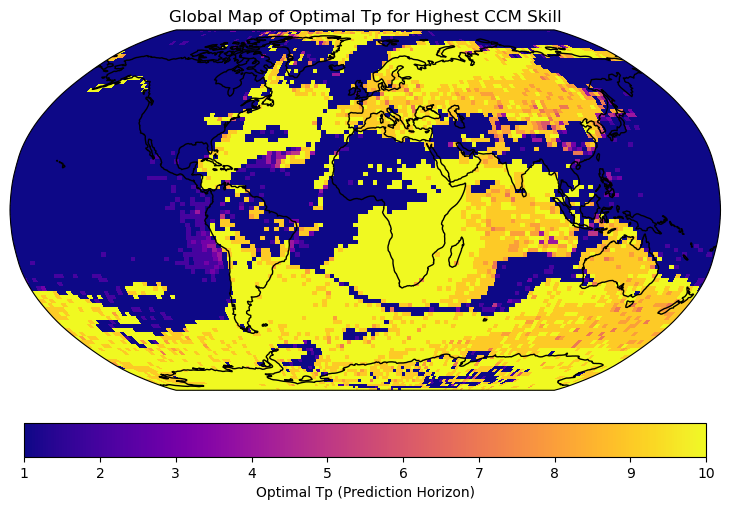

In [5]:
optimum_Tp = plot_optimal_Tp_map(ds_sat=ds_sat, df_pre=df_pre, E=4, tau=3, Tp_min=1, Tp_max=10)


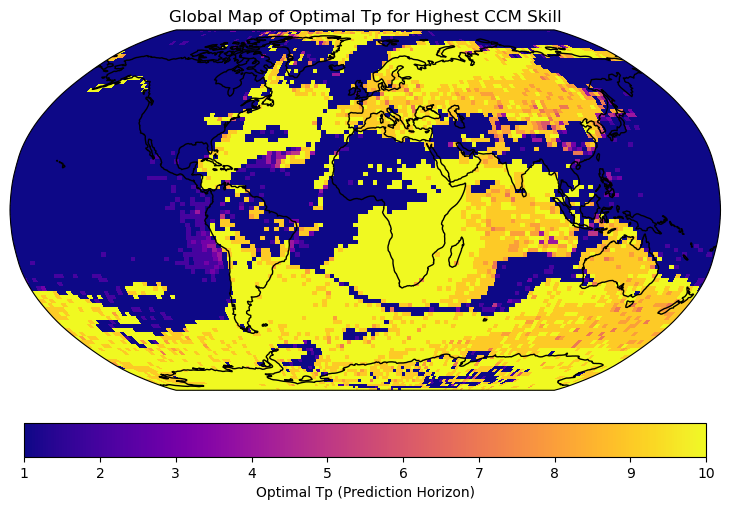

In [7]:
lats = ds_sat["lat"].values
lons = ds_sat["lon"].values
lon_grid, lat_grid = np.meshgrid(lons, lats)

fig = plt.figure(figsize=(11, 6))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
# Using "plasma" colormap to represent different Tp values
pcm = ax.pcolormesh(lon_grid, lat_grid, optimum_Tp,
                    transform=ccrs.PlateCarree(), shading="auto", cmap="plasma")
cb = plt.colorbar(pcm, orientation="horizontal", pad=0.07, shrink=0.8)
cb.set_label("Optimal Tp (Prediction Horizon)")
ax.set_title("Global Map of Optimal Tp for Highest CCM Skill")
plt.show()



d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


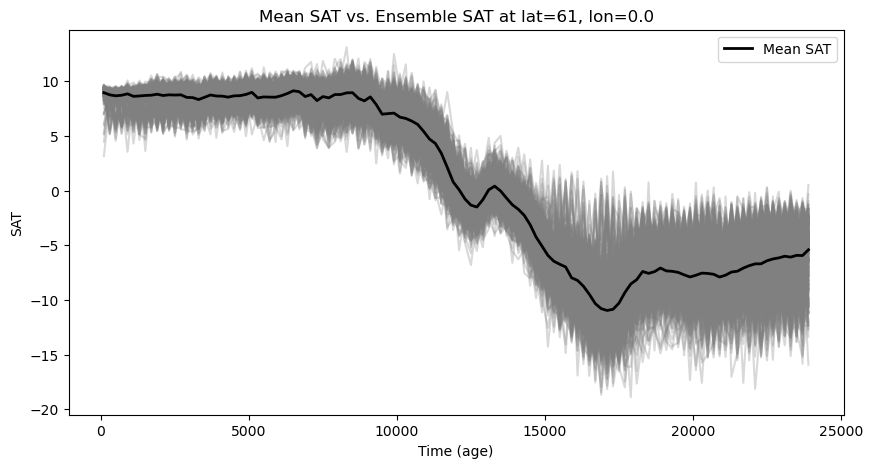

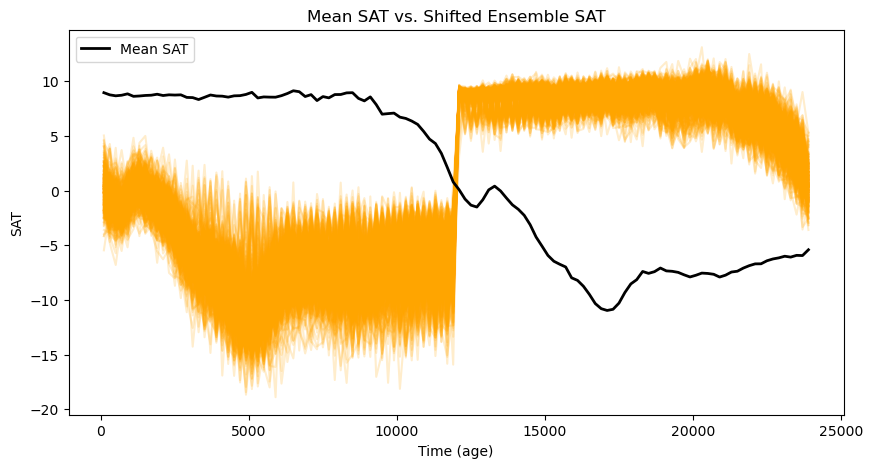

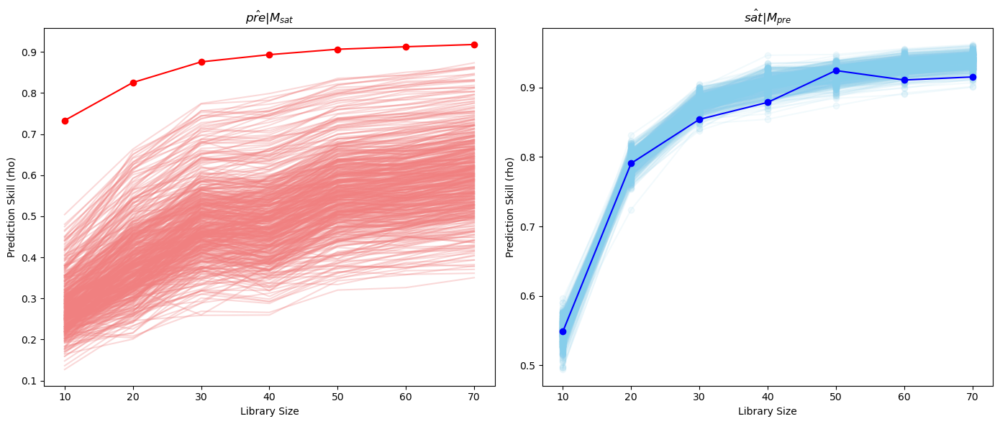

In [25]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pyEDM import CCM

# ---------------------------
# Load data
# ---------------------------
ds_sat = xr.open_dataset('LGMR_data/LGMR_SAT_climo.nc')
df_pre = pd.read_csv(r"D:\VScode\Inso_LGMR\inso_data\pre.csv")
ds_sat_ens = xr.open_dataset('LGMR_data/LGMR_SAT_ens.nc')

# ---------------------------
# Select a grid point for testing
# ---------------------------
lat_idx = 80
lon_idx = 0
time = ds_sat['age'].values

# Mean SAT time series at the selected grid point
sat_mean = ds_sat['sat'].isel(lat=lat_idx, lon=lon_idx).values

# Ensemble SAT data at the same grid point (shape: nEns x time)
sat_ens = ds_sat_ens['sat'].isel(lat=lat_idx, lon=lon_idx).values

# ---------------------------
# 1. (Already plotted earlier) Plot mean SAT and ensemble members
# ---------------------------
plt.figure(figsize=(10, 5))
for i in range(sat_ens.shape[0]):
    plt.plot(time, sat_ens[i, :], color='gray', alpha=0.3)
plt.plot(time, sat_mean, color='k', lw=2, label='Mean SAT')
plt.xlabel("Time (age)")
plt.ylabel("SAT")
plt.title(f"Mean SAT vs. Ensemble SAT at lat={int(ds_sat['lat'].values[lat_idx])}, lon={ds_sat['lon'].values[lon_idx]}")
plt.legend()
plt.show()

# ---------------------------
# 2. Create shifted ensemble data
# ---------------------------
nTime = len(time)
half = nTime // 2
sat_ens_shifted = np.empty_like(sat_ens)
for i in range(sat_ens.shape[0]):
    ts = sat_ens[i, :]
    shifted_ts = np.concatenate((ts[half:], ts[:half]))
    sat_ens_shifted[i, :] = shifted_ts

plt.figure(figsize=(10, 5))
for i in range(sat_ens_shifted.shape[0]):
    plt.plot(time, sat_ens_shifted[i, :], color='orange', alpha=0.2)
plt.plot(time, sat_mean, color='k', lw=2, label='Mean SAT')
plt.xlabel("Time (age)")
plt.ylabel("SAT")
plt.title("Mean SAT vs. Shifted Ensemble SAT")
plt.legend()
plt.show()

# ---------------------------
# 3. Set CCM parameters
# ---------------------------
E_val = 4
tau_val = 3
Tp_val = 0
libSizes = "10 20 30 40 50 60 70"

# ---------------------------
# 3a. CCM: Using SAT to predict pre (Manifold from SAT)
# ---------------------------
# Original (mean) CCM: SAT (X) -> pre (Y)
df_ccm_sat2pre = pd.DataFrame({
    'Time': time,
    'X': sat_mean,
    'Y': df_pre['pre'].values
})
ccm_out_sat2pre = CCM(
    dataFrame   = df_ccm_sat2pre,
    E           = E_val,
    tau         = tau_val,
    columns     = "X",   # SAT manifold
    target      = "Y",   # predict pre
    libSizes    = libSizes,
    sample      = 10,
    random      = True,
    replacement = False,
    Tp          = Tp_val
)

# For each ensemble member (shifted), compute CCM: SAT_ens (X) -> pre (Y)
# We store each result (the full curve: LibSize vs. "X:Y")
ensemble_ccm_sat2pre = []
for i in range(sat_ens_shifted.shape[0]):
    df_temp = pd.DataFrame({
        'Time': time,
        'X': sat_ens_shifted[i, :],
        'Y': df_pre['pre'].values
    })
    try:
        out = CCM(
            dataFrame   = df_temp,
            E           = E_val,
            tau         = tau_val,
            columns     = "X",
            target      = "Y",
            libSizes    = libSizes,
            sample      = 10,
            random      = True,
            replacement = False,
            Tp          = Tp_val
        )
        ensemble_ccm_sat2pre.append(out)
    except Exception as e:
        print(f"Error in ensemble member {i}: {e}")

# ---------------------------
# 3b. CCM: Using pre to predict SAT (Manifold from pre)
# ---------------------------
# Original (mean) CCM: pre (X) -> SAT (Y)
df_ccm_pre2sat = pd.DataFrame({
    'Time': time,
    'X': df_pre['pre'].values,
    'Y': sat_mean
})
ccm_out_pre2sat = CCM(
    dataFrame   = df_ccm_pre2sat,
    E           = E_val,
    tau         = tau_val,
    columns     = "X",   # pre manifold
    target      = "Y",   # predict SAT
    libSizes    = libSizes,
    sample      = 10,
    random      = True,
    replacement = False,
    Tp          = Tp_val
)

# For each shifted ensemble member, compute CCM: pre (X) -> shifted SAT (Y)
ensemble_ccm_pre2sat = []
for i in range(sat_ens_shifted.shape[0]):
    df_temp = pd.DataFrame({
        'Time': time,
        'X': df_pre['pre'].values,
        'Y': sat_ens_shifted[i, :]
    })
    try:
        out = CCM(
            dataFrame   = df_temp,
            E           = E_val,
            tau         = tau_val,
            columns     = "X",
            target      = "Y",
            libSizes    = libSizes,
            sample      = 10,
            random      = True,
            replacement = False,
            Tp          = Tp_val
        )
        ensemble_ccm_pre2sat.append(out)
    except Exception as e:
        print(f"Error in ensemble member {i}: {e}")

# ---------------------------
# 4. Plot the CCM curves in a subplot with two panels
# ---------------------------
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# --- Left subplot: SAT -> pre ---
ax = axes[0]
# Plot the mean CCM curve (red)

# Plot all ensemble curves (light red) for SAT -> pre
i=0
for out in ensemble_ccm_sat2pre:
    if i==0:
        ax.plot(out['LibSize'], out['X:Y'], color='lightcoral', marker='', linestyle='-', alpha=0.3,label='Ensemble SAT CCM')
        i+=1
    else:
        ax.plot(out['LibSize'], out['X:Y'], color='lightcoral', marker='', linestyle='-', alpha=0.3)

ax.plot(ccm_out_sat2pre['LibSize'], ccm_out_sat2pre['X:Y'], 'ro-', label='Mean SAT CCM')

ax.set_xlabel("Library Size")
ax.set_ylabel("Prediction Skill (rho)")
ax.set_title(r'$\hat{pre}|M_{sat}$')
# ax.legend()

# --- Right subplot: pre -> SAT ---
ax2 = axes[1]
# Plot the mean CCM curve (red) for pre -> SAT

# Plot all ensemble curves (light red) for pre -> SAT
i=0
for out in ensemble_ccm_pre2sat:
    if i==0:
        ax2.plot(out['LibSize'], out['X:Y'], color='skyblue', marker='o', linestyle='-', alpha=0.1,label='Ensemble pre CCM')
        i+=1
    else:
        ax2.plot(out['LibSize'], out['X:Y'], color='skyblue', marker='o', linestyle='-', alpha=0.1)

ax2.plot(ccm_out_pre2sat['LibSize'], ccm_out_pre2sat['X:Y'], 'bo-', label='Mean pre CCM')

ax2.set_xlabel("Library Size")
ax2.set_ylabel("Prediction Skill (rho)")
ax2.set_title(r'$\hat{sat}|M_{pre}$')
# ax2.legend()

plt.tight_layout()
plt.show()


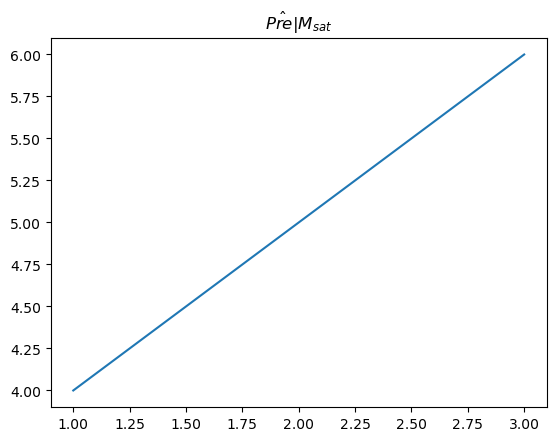

In [24]:
import matplotlib.pyplot as plt

plt.figure()
plt.plot([1, 2, 3], [4, 5, 6])
plt.title(r'$\hat{Pre}|M_{sat}$')
plt.show()


xarray.Dataset {
dimensions:
	lat = 96 ;
	lon = 144 ;
	age = 120 ;

variables:
	float32 lat(lat) ;
		lat:FillValue = 9.969209968386869e+36 ;
		lat:long_name = vector latitudes ;
		lat:units = degrees_north ;
	float32 lon(lon) ;
		lon:FillValue = 9.969209968386869e+36 ;
		lon:long_name = vector of longitudes ;
		lon:units = degrees_east ;
	float32 age(age) ;
		age:long_name = reconstruction bin mid-point (years BP) ;
	float32 sat(age, lat, lon) ;
		sat:FillValue = 9.969209968386869e+36 ;
		sat:long_name = ENSEMBLE MEAN (n = 500) mean annual temperature at reference height ;
		sat:units = degrees Celsius ;
	float32 sat_std(age, lat, lon) ;
		sat_std:FillValue = 9.969209968386869e+36 ;
		sat_std:long_name = ENSEMBLE STANDARD DEVIATION (n = 500) mean annual temperature at reference height ;
		sat_std:units = degrees Celsius ;

// global attributes:
}   LibSize       X:Y       Y:X
0     10.0  0.733150  0.548668
1     20.0  0.825465  0.790740
2     30.0  0.875702  0.854080
3     40.0  0.8932

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


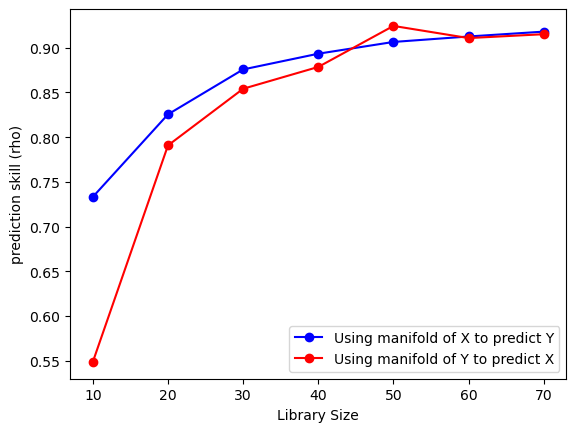

In [16]:
# read the LGMR_SAT_climo.nc under LGMR_data

import xarray as xr
import pandas as pd


ds_sat = xr.open_dataset('LGMR_data/LGMR_SAT_climo.nc')
ds_sat.info()

df_pre = pd.read_csv(r"D:\VScode\Inso_LGMR\inso_data\pre.csv")


# Prepare DataFrame
df = pd.DataFrame({
    'Time': ds_sat['age'].values,
    'X': df_pre['pre'].values,
    'Y': ds_sat['sat'].isel(lat=80).isel(lon=0).values
})

import pandas as pd
import numpy as np
from pyEDM import CCM
import matplotlib.pyplot as plt


# Prepare DataFrame
df = pd.DataFrame({
    'Time': ds_sat['age'].values,
    'X': ds_sat['sat'].isel(lat=80).isel(lon=0).values,
    'Y': df_pre['pre'].values
    
})

# # plot df
# plt.plot(df['Time'], df['X'], 'b-')
# plt.plot(df['Time'], df['Y'], 'r-')



# CCM call
ccm_out = CCM(
    dataFrame   = df,
    E           = 4,
    tau         = 3,
    columns     = "X",   # predictor
    target      = "Y",   # target
    libSizes    = "10 20 30 40 50 60 70",
    sample      = 10,
    random      = True,
    replacement = False,
    Tp          = 0
)

print(ccm_out)
print("Columns:", ccm_out.columns)

# plot the results
plt.plot(ccm_out['LibSize'], ccm_out['X:Y'], 'bo-', label='Using manifold of X to predict Y')
plt.plot(ccm_out['LibSize'], ccm_out['Y:X'], 'ro-', label='Using manifold of Y to predict X')
plt.xlabel("Library Size")
plt.ylabel('prediction skill (rho)')
plt.legend()
plt.show()

In [15]:
ds_sat_ens = xr.open_dataset('LGMR_data/LGMR_SAT_ens.nc')
ds_sat_ens.info()

xarray.Dataset {
dimensions:
	lat = 96 ;
	lon = 144 ;
	age = 120 ;
	nEns = 500 ;

variables:
	float32 lat(lat) ;
		lat:FillValue = 9.969209968386869e+36 ;
		lat:long_name = vector latitudes ;
		lat:units = degrees_north ;
	float32 lon(lon) ;
		lon:FillValue = 9.969209968386869e+36 ;
		lon:long_name = vector of longitudes ;
		lon:units = degrees_east ;
	float32 age(age) ;
		age:long_name = reconstruction bin mid-point (years BP) ;
	float32 nEns(nEns) ;
		nEns:long_name = number of ensemble members ;
	float32 sat(nEns, age, lat, lon) ;
		sat:FillValue = 9.969209968386869e+36 ;
		sat:long_name = Mean annual temperature at reference height ;
		sat:units = degrees Celsius ;

// global attributes:
}

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


xarray.Dataset {
dimensions:
	lat = 96 ;
	lon = 144 ;
	age = 120 ;

variables:
	float32 lat(lat) ;
		lat:FillValue = 9.969209968386869e+36 ;
		lat:long_name = vector latitudes ;
		lat:units = degrees_north ;
	float32 lon(lon) ;
		lon:FillValue = 9.969209968386869e+36 ;
		lon:long_name = vector of longitudes ;
		lon:units = degrees_east ;
	float32 age(age) ;
		age:long_name = reconstruction bin mid-point (years BP) ;
	float32 sat(age, lat, lon) ;
		sat:FillValue = 9.969209968386869e+36 ;
		sat:long_name = ENSEMBLE MEAN (n = 500) mean annual temperature at reference height ;
		sat:units = degrees Celsius ;
	float32 sat_std(age, lat, lon) ;
		sat_std:FillValue = 9.969209968386869e+36 ;
		sat_std:long_name = ENSEMBLE STANDARD DEVIATION (n = 500) mean annual temperature at reference height ;
		sat_std:units = degrees Celsius ;

// global attributes:
}   LibSize       X:Y       Y:X
0     10.0  0.498093  0.646912
1     20.0  0.692375  0.790202
2     30.0  0.807403  0.854837
3     40.0  0.8930

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


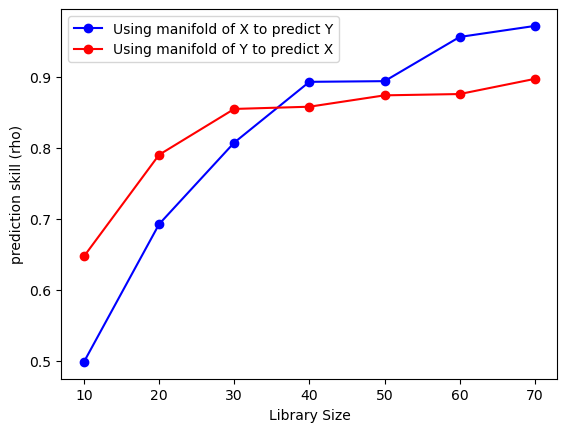

In [2]:
# read the LGMR_SAT_climo.nc under LGMR_data

import xarray as xr
import pandas as pd


ds_sat = xr.open_dataset('LGMR_data/LGMR_SAT_climo.nc')
ds_sat.info()

df_pre = pd.read_csv(r"D:\VScode\Inso_LGMR\inso_data\pre.csv")


# Prepare DataFrame
df = pd.DataFrame({
    'Time': ds_sat['age'].values,
    'X': df_pre['pre'].values,
    'Y': ds_sat['sat'].isel(lat=80).isel(lon=0).values
})

import pandas as pd
import numpy as np
from pyEDM import CCM
import matplotlib.pyplot as plt


# Prepare DataFrame
df = pd.DataFrame({
    'Time': ds_sat['age'].values,
    'X': df_pre['pre'].values,
    'Y': ds_sat['sat'].isel(lat=80).isel(lon=0).values
})

# # plot df
# plt.plot(df['Time'], df['X'], 'b-')
# plt.plot(df['Time'], df['Y'], 'r-')



# CCM call
ccm_out = CCM(
    dataFrame   = df,
    E           = 3,
    tau         = 2,
    columns     = "X",   # predictor
    target      = "Y",   # target
    libSizes    = "10 20 30 40 50 60 70",
    sample      = 10,
    random      = True,
    replacement = False,
    Tp          = -7
)

print(ccm_out)
print("Columns:", ccm_out.columns)

# plot the results
plt.plot(ccm_out['LibSize'], ccm_out['X:Y'], 'bo-', label='Using manifold of X to predict Y')
plt.plot(ccm_out['LibSize'], ccm_out['Y:X'], 'ro-', label='Using manifold of Y to predict X')
plt.xlabel("Library Size")
plt.ylabel('prediction skill (rho)')
plt.legend()
plt.show()

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

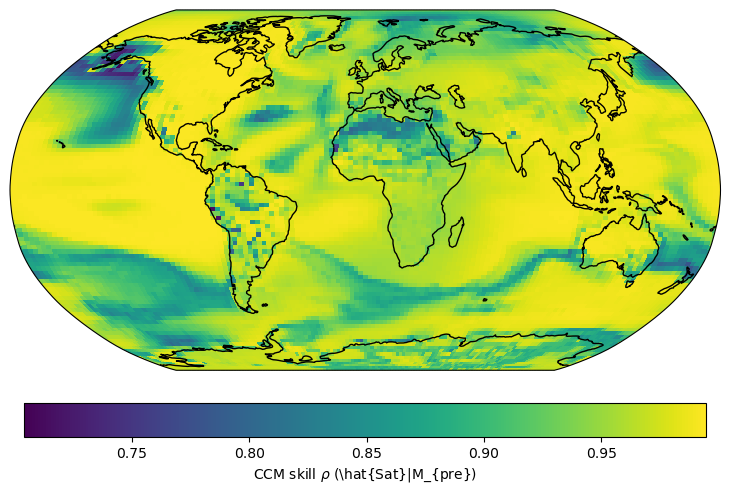

In [4]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pyEDM import CCM

# Cartopy imports
import cartopy.crs as ccrs
import cartopy.feature as cfeature


# Make sure these match in length
assert len(df_pre) == ds_sat.sizes["age"], "Timeseries length mismatch"

# ------------------------------------------------
# 2. Prepare for loop
# ------------------------------------------------
nlat = ds_sat.sizes["lat"]
nlon = ds_sat.sizes["lon"]
ages = ds_sat["age"].values

rho_map = np.full((nlat, nlon), np.nan)

# CCM parameters
E = 3
tau = 5
libSizes = "10 20 30 40 50 60 70"
Tp = 0  # or -7 if you want to match your original code

# ------------------------------------------------
# 3. Main loop over lat/lon
# ------------------------------------------------
for iLat in range(nlat):
    for iLon in range(nlon):
        # Extract the local "sat" time series
        sat_ts = ds_sat["sat"].isel(lat=iLat, lon=iLon).values

        # Build temp DataFrame for pyEDM
        # We want "Y->X", i.e. sat->pre:
        # columns="Y", target="X"
        temp_df = pd.DataFrame({
            "Time": ages,
            "X": df_pre["pre"],  # we want to predict X
            "Y": sat_ts,         # from Y
        })

        # Run CCM
        ccm_out = CCM(
            dataFrame   = temp_df,
            E           = E,
            tau         = tau,
            columns     = "Y",
            target      = "X",
            libSizes    = libSizes,
            sample      = 10,
            random      = True,
            replacement = False,
            Tp          = Tp
        )

        # Extract the mean rho at the largest library size
        largest_L = ccm_out["LibSize"].max()
        mask_last = ccm_out["LibSize"] == largest_L
        rho_at_largest = ccm_out.loc[mask_last, "Y:X"].mean()

        rho_map[iLat, iLon] = rho_at_largest

# ------------------------------------------------
# 4. Plot the global map with Robinson projection
# ------------------------------------------------
lats = ds_sat["lat"].values
lons = ds_sat["lon"].values

fig = plt.figure(figsize=(11, 6))
# Create a cartopy GeoAxes in Robinson projection
ax = plt.axes(projection=ccrs.Robinson())

# If your data is in lat, lon => ( -90..+90 , -180..+180 ), you can directly plot
# Set transform=ccrs.PlateCarree() to tell cartopy how the data is geographically referenced
pcm = ax.pcolormesh(
    lons, lats, rho_map,
    transform=ccrs.PlateCarree(),  # data is lat/lon
    shading="auto"
)

# Add coastlines
ax.coastlines()
# Optionally add other features:
# ax.add_feature(cfeature.BORDERS, linewidth=0.5)
# ax.add_feature(cfeature.LAND, facecolor='lightgray')  # if desired

# Add a colorbar
cb = plt.colorbar(pcm, orientation="horizontal", pad=0.07, shrink=0.8)
cb.set_label(r"CCM skill $\rho$ (\hat{Sat}$|$M_{pre})")

# plt.title("Global CCM skill at largest library size\n(Robinson Projection)")
plt.show()


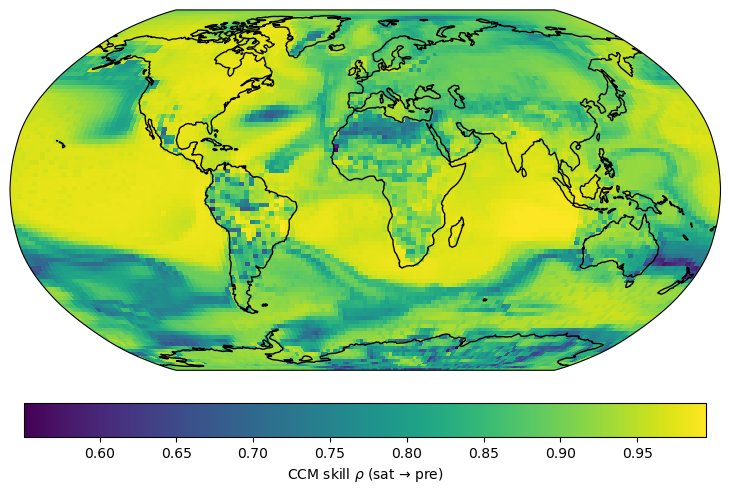

In [6]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

lats = ds_sat["lat"].values
lons = ds_sat["lon"].values

fig = plt.figure(figsize=(11, 6))
# Create a cartopy GeoAxes in Robinson projection
ax = plt.axes(projection=ccrs.Robinson())

# If your data is in lat, lon => ( -90..+90 , -180..+180 ), you can directly plot
# Set transform=ccrs.PlateCarree() to tell cartopy how the data is geographically referenced
pcm = ax.pcolormesh(
    lons, lats, rho_map,
    transform=ccrs.PlateCarree(),  # data is lat/lon
    shading="auto"
)

# Add coastlines
ax.coastlines()
# Optionally add other features:
# ax.add_feature(cfeature.BORDERS, linewidth=0.5)
# ax.add_feature(cfeature.LAND, facecolor='lightgray')  # if desired

# Add a colorbar
cb = plt.colorbar(pcm, orientation="horizontal", pad=0.07, shrink=0.8)
cb.set_label(r"CCM skill $\rho$ (sat $\to$ pre)")

# plt.title("Global CCM skill at largest library size\n(Robinson Projection)")
plt.show()

In [7]:
# save the rhomap to /output/
np.save("output/rho_map.npy", rho_map)

In [ ]:
# 

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv
d:\Users\User\an

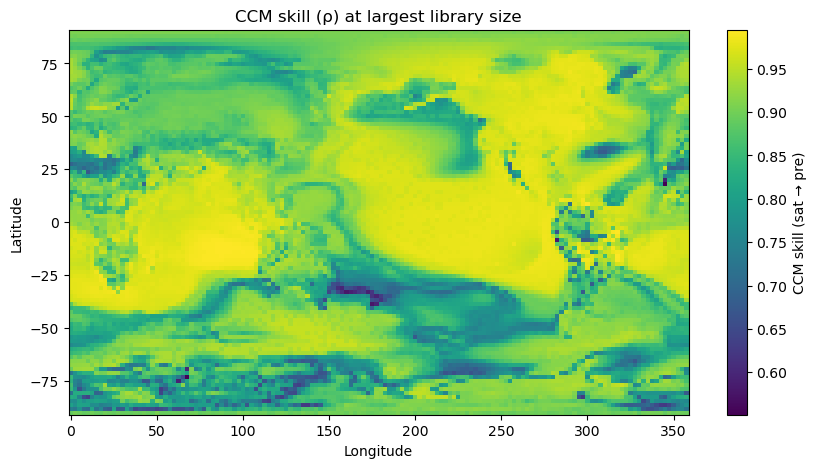

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyEDM import CCM



# Confirm that 'pre' aligns with ds_sat['age'] in length:
# e.g. ds_sat.sizes['age'] = 120, so df_pre.shape[0] should be 120
assert len(df_pre) == ds_sat.sizes["age"], "precession timeseries must match ds_sat age dimension"

# ------------------------------------------------
# 2. Prepare for loop
# ------------------------------------------------
nlat = ds_sat.sizes["lat"]
nlon = ds_sat.sizes["lon"]
ages = ds_sat["age"].values

# We'll store the CCM skill (rho) in a 2D array
rho_map = np.full((nlat, nlon), np.nan)

# We will use these fixed CCM parameters for all grid points
E = 3
tau = 2
# We'll test library sizes from 10 to 70, stepping by 10
libSizes = "10 20 30 40 50 60 70"

# ------------------------------------------------
# 3. Main loop over lat/lon
# ------------------------------------------------
for iLat in range(nlat):
    for iLon in range(nlon):
        # Extract the local "sat" time series
        sat_ts = ds_sat["sat"].isel(lat=iLat, lon=iLon).values

        # Build a temporary DataFrame for pyEDM
        # We want to test: "Y:X" (meaning does Y->X?), so
        #   columns="Y", target="X"
        #   Y = sat_ts, X = pre
        temp_df = pd.DataFrame({
            "Time": ages,
            "X": df_pre["pre"],   # target
            "Y": sat_ts          # predictor
        })

        # Run CCM: from sat_ts to pre
        ccm_out = CCM(
            dataFrame   = temp_df,
            E           = E,
            tau         = tau,
            columns     = "Y",    # manifold from 'Y'
            target      = "X",    # trying to predict 'X'
            libSizes    = libSizes,
            sample      = 10,
            random      = True,
            replacement = False,
            Tp          = 0  # or whatever prediction horizon you want; your example used -7
        )

        # ccm_out has multiple rows (one for each library size * each sample)
        # We'll keep the mean rho at the largest library size
        largest_L = ccm_out["LibSize"].max()
        mask_last = ccm_out["LibSize"] == largest_L

        # The column name for skill of Y->X is "Y:X"
        # Take the average of these final replicates
        rho_at_largest = ccm_out.loc[mask_last, "Y:X"].mean()

        # Store in our map
        rho_map[iLat, iLon] = rho_at_largest

# ------------------------------------------------
# 4. Plot the global map
# ------------------------------------------------
# Make sure we have lat, lon in increasing order if needed
lats = ds_sat["lat"].values
lons = ds_sat["lon"].values

# Simple plot using pcolormesh
plt.figure(figsize=(10, 5))
# If your lat is from -90..90 and lon from 0..360 or -180..180, adapt accordingly
# shading='auto' ensures no dimension mismatch messages
plt.pcolormesh(lons, lats, rho_map, shading='auto')
plt.xlabel("Longitude")
plt.ylabel("Latitude")
cb = plt.colorbar()
cb.set_label("CCM skill (sat → pre)")
plt.title("CCM skill (\u03C1) at largest library size")
plt.show()
